In [2]:
#importing necessary libraries and modules 
import os
import numpy as np
import pandas as pd
import cv2 as cv
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.model_selection import train_test_split
import scipy
import tensorflow as tf
import tensorflow.keras as keras

In [2]:
#Setting image paths
image_folder = r'Model/'
normal_folder = r'Model/NORMAL'
pneumonia_folder = r'Model/PNEUMONIA'

# Function to load Images and classes

In [3]:
labels = []
class_labels= os.listdir(image_folder )
for i in range(len(class_labels)):
        instances = os.listdir(image_folder + class_labels[i])
        print(f"{class_labels[i]} Instances = {len(instances)}")
        for img in instances:
            labels.append(class_labels[i])
print(f'Number of classes = {len(class_labels)}')

NORMAL Instances = 105
PNEUMONIA Instances = 1500
Number of classes = 2


# Building HOG Descriptor 

In [793]:
from skimage.io import imread, imshow
from skimage.transform import resize
from skimage.feature import hog
from skimage import exposure, color
def hog_des(img):
    size = (64, 128)
    img = resize(img, size)
    hog_fd, hog_image = hog(img, orientations= 9,
                         pixels_per_cell= (8, 8),
                         cells_per_block =(2, 2), block_norm= 'L2', visualize =True, feature_vector = True, 
                            channel_axis = None)
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 0.5))
    plt.figure(figsize=(8,4))
    plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    return(hog_fd)

array([0.1694126 , 0.        , 0.01293275, ..., 0.        , 0.        ,
       0.35971398])

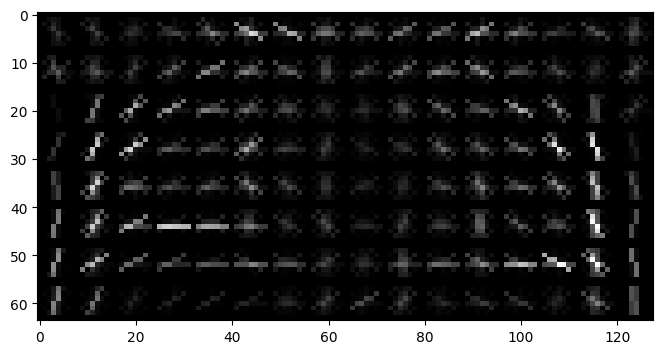

In [794]:
    image = imread(r'Model/NORMAL/NORMAL (1).jpeg')
    hog_des(image)

In [5]:
# A function to extract hog features from both normal chest-xray images 
# and also check for correlation between Pneumonia and Normal chest-xray images
hog_fv_ds = []
def p_corr_n():
    nim_names = [f'NORMAL ({n}).jpeg' for n in range(1, 106)]
    for nim in tqdm(nim_names):
        src_path = os.path.join(normal_folder, nim)
        img_n = imread(src_path)
        hog_fv_n = hog_des(img_n)
        hog_fv_ds.append(hog_fv_n)
    return(hog_fv_ds)   

In [6]:
p_corr_n()

100%|████████████████████████████████████████████████████████████████████████████████| 105/105 [01:11<00:00,  1.47it/s]


[array([0.1694126 , 0.        , 0.01293275, ..., 0.        , 0.        ,
        0.35971398]),
 array([0.25390144, 0.09741435, 0.02728283, ..., 0.01620561, 0.0598254 ,
        0.49548081]),
 array([0.01835446, 0.002728  , 0.0107354 , ..., 0.        , 0.        ,
        0.        ]),
 array([0.11489623, 0.01298557, 0.04513595, ..., 0.        , 0.        ,
        0.15310415]),
 array([0.02412346, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]),
 array([0.12451876, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]),
 array([1.69308076e-12, 0.00000000e+00, 1.11637924e-01, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00]),
 array([0.21371566, 0.17310506, 0.08027198, ..., 0.00299939, 0.12352711,
        0.48146252]),
 array([0.04178353, 0.02801817, 0.01177633, ..., 0.04022497, 0.03406937,
        0.16331854]),
 array([0.06591023, 0.02744788, 0.0286083 , ..., 0.        , 0.08602133,
        0.57930052]),
 array([0., 0., 0., ..., 0

In [11]:
# A function to extract hog features from both normal chest-xray images 
# and also check for correlation between Pneumonia and Normal chest-xray images
hog_fv = []
def p_corr_p():
    num = [*range(1, 106)]
    pim_names = [f'PNEUMONIA ({p}).jpeg' for p in range(1, 1501)]
    for pim in tqdm(pim_names):
        dst_path = os.path.join(pneumonia_folder, pim)
        img_p = imread(dst_path)
        hog_fv_p= hog_des(img_p)
        hog_fv.append(hog_fv_p)
        for q in num:
            nim = f'NORMAL ({q}).jpeg'
            src_path = os.path.join(normal_folder, nim)
            img_n = imread(src_path)
            hog_fv_n = hog_des(img_n)
            corr, pval = scipy.stats.pearsonr(hog_fv_n, hog_fv_p)
            print(f'correlation coefficient and probability value of {nim} & {pim} = ({corr} , {pval})')
#           Creating categories of PNEUMONIA for classification
            for i in range(len(labels)):
                if labels[i] == 'PNEUMONIA' and corr >= 0.5 and corr < 0.9:
                    labels[i] = 'MILD'
                    break
                elif labels[i] == 'PNEUMONIA' and corr >= 0.3 and corr < 0.5:
                    labels[i] = 'MODERATE'
                    break
                elif labels[i] == 'PNEUMONIA' and corr >= 0.1 and corr < 0.3:
                    labels[i] = 'SEVERE'
                    break              
    return(hog_fv)

In [12]:
p_corr_p()

  0%|                                                                                         | 0/1500 [00:00<?, ?it/s]

correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1).jpeg = (0.4693874372708245 , 1.847595651187242e-206)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1).jpeg = (0.39273818799508364 , 1.2167852283763204e-139)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1).jpeg = (0.509742094114743 , 3.6728644064234403e-249)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1).jpeg = (0.5730007145492022 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1).jpeg = (0.39829893055520316 , 6.327206179695488e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1).jpeg = (0.3911378208680147 , 2.008777106533316e-138)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (1).jpeg = (0.26436783173318273 , 1.7805959606706474e-61)
correlation coefficient and probability value of NORMAL (8).jpeg & PNEUMONIA 

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1).jpeg = (0.437415253672005 , 1.777516545954924e-176)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1).jpeg = (0.499906320047572 , 3.215357470144111e-238)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1).jpeg = (0.47785859603001934 , 5.914120612949174e-215)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1).jpeg = (0.48532924621514084 , 1.2001075885238864e-222)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1).jpeg = (0.4195573010222779 , 4.448881739194584e-161)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (1).jpeg = (0.48949435612710407 , 5.088781327706774e-227)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (1).jpeg = (0.4424589366287123 , 5.374732508775314e-181)
correlation coefficient and probability value of NORM

  0%|                                                                              | 1/1500 [01:10<29:11:36, 70.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1).jpeg = (0.4856809636498663 , 5.156058354681474e-223)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (2).jpeg = (0.3506270174880149 , 8.925351051999971e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (2).jpeg = (0.33512724039735275 , 7.12144064693502e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (2).jpeg = (0.4771930445622025 , 2.8053912712524083e-214)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (2).jpeg = (0.5516225155542573 , 5.2650054449583925e-300)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (2).jpeg = (0.5069427272512967 , 5.198464531138733e-246)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (2).jpeg = (0.4902038933050287 , 9.029678843734048e-228)
correlation coefficient and probability value of NORMAL (7

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (2).jpeg = (0.33470848371867296 , 1.2950821141680693e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (2).jpeg = (0.22401573275851824 , 3.331620497644365e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (2).jpeg = (0.3646007326203432 , 3.400399399773483e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (2).jpeg = (0.5367600278895027 , 3.8872335298205356e-281)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (2).jpeg = (0.41895168990630005 , 1.4266545388282254e-160)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (2).jpeg = (0.45886257375379885 , 3.1069926245501247e-196)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (2).jpeg = (0.5006315530864728 , 5.159388206578997e-239)
correlation coefficient and probability value of 

  0%|                                                                              | 2/1500 [02:21<29:27:19, 70.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (2).jpeg = (0.37986132016518254 , 4.9374872493410976e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (3).jpeg = (0.30865546474063893 , 3.0812901731631335e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (3).jpeg = (0.37455163090342347 , 3.3961056249424055e-126)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (3).jpeg = (0.5708051777658277 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (3).jpeg = (0.6159909406325752 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (3).jpeg = (0.4958620981856563 , 8.006498446868171e-234)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (3).jpeg = (0.44354922420891857 , 5.537243668228567e-182)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (3).jpeg = (0.2

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (3).jpeg = (0.3471870282008745 , 1.5745932775337853e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (3).jpeg = (0.23272560290070593 , 1.1561048414000306e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (3).jpeg = (0.409196487624877 , 1.4588054390352978e-152)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (3).jpeg = (0.48059262773106254 , 9.52260931454353e-218)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (3).jpeg = (0.5151546817331901 , 2.4473853897033928e-255)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (3).jpeg = (0.5397691020606739 , 7.009000271573368e-285)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (3).jpeg = (0.4639122314607844 , 4.2751191690271915e-201)
correlation coefficient and probability value of NO

  0%|▏                                                                             | 3/1500 [03:31<29:15:25, 70.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (3).jpeg = (0.37361819282308484 , 1.5783832379675956e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (4).jpeg = (0.3480398091400867 , 4.394121687005428e-108)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (4).jpeg = (0.2845107033657408 , 2.563232370323125e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (4).jpeg = (0.39763660884496727 , 2.0691604065708313e-143)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (4).jpeg = (0.4796037494557478 , 9.816223029991813e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (4).jpeg = (0.5455395323814667 , 3.619763080646442e-292)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (4).jpeg = (0.3564129439962436 , 1.2825653820788007e-113)
correlation coefficient and probability value of NORMAL 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (4).jpeg = (0.3656200717242623 , 6.69504565995101e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (4).jpeg = (0.4133638702017856 , 5.954514612486169e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (4).jpeg = (0.3156965981678407 , 3.040788217368142e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (4).jpeg = (0.2967068156064382 , 1.0929359050604511e-77)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (4).jpeg = (0.5016541367469147 , 3.880590009644371e-240)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (4).jpeg = (0.39814809248537414 , 8.289094064863645e-144)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (4).jpeg = (0.43298469283768065 , 1.4359762554614974e-172)
correlation coefficient and probability value of NORMA

  0%|▏                                                                             | 4/1500 [04:40<29:02:37, 69.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (4).jpeg = (0.36578416734722596 , 5.151050521418092e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (5).jpeg = (0.4602322050708809 , 1.520032093976851e-197)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (5).jpeg = (0.3990370986443022 , 1.6838954150397309e-144)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (5).jpeg = (0.42124928321269645 , 1.6937585437739253e-162)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (5).jpeg = (0.41674492192347684 , 9.762931688117759e-159)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (5).jpeg = (0.29689768885946577 , 8.63745531573803e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (5).jpeg = (0.2641963196338849 , 2.1419117151130636e-61)
correlation coefficient and probability value of NORMAL 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (5).jpeg = (0.4250993127510217 , 9.30195262761111e-166)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (5).jpeg = (0.4499420557927825 , 7.631147876001987e-188)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (5).jpeg = (0.43881900178849115 , 9.991848408726522e-178)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (5).jpeg = (0.36748258455506144 , 3.3847609181181945e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (5).jpeg = (0.4120067995446093 , 7.652275901036575e-155)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (5).jpeg = (0.3685956907537604 , 5.63301822313828e-122)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (5).jpeg = (0.37379397027123773 , 1.1823145639870495e-125)
correlation coefficient and probability value of NOR

  0%|▎                                                                             | 5/1500 [05:49<28:54:24, 69.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (5).jpeg = (0.48256371668286385 , 8.896982764260848e-220)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (6).jpeg = (0.522097497796662 , 1.9998541904388103e-263)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (6).jpeg = (0.3912262212168344 , 1.7212513527188853e-138)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (6).jpeg = (0.5435237640229076 , 1.3194087573503886e-289)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (6).jpeg = (0.4840881715265424 , 2.3466757736460723e-221)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (6).jpeg = (0.4504554470774741 , 2.5495857405304614e-188)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (6).jpeg = (0.38678537221540965 , 3.807683261051899e-135)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (6).jpeg = (0.4003370322849349 , 1.623094962589452e-145)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (6).jpeg = (0.4731579335181119 , 3.274772975180373e-210)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (6).jpeg = (0.6012782750050912 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (6).jpeg = (0.4270277760165825 , 2.0867777276338463e-167)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (6).jpeg = (0.4671213564376948 , 3.1526445442347013e-204)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (6).jpeg = (0.5242665001762736 , 5.4396279877735834e-266)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (6).jpeg = (0.3971162373956596 , 5.239208535656044e-143)
correlation coefficient and probability value of NORMAL (70).jpeg & PNE

  0%|▎                                                                             | 6/1500 [06:58<28:50:45, 69.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (6).jpeg = (0.4970886594526015 , 3.770273103964133e-235)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (7).jpeg = (0.39028262480656944 , 8.930629988884628e-138)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (7).jpeg = (0.42872961294308404 , 7.165061449220497e-169)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (7).jpeg = (0.5215023605945585 , 1.0038238041423833e-262)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (7).jpeg = (0.4308894006842968 , 9.655825716031302e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (7).jpeg = (0.35240563554268334 , 5.997669481906812e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (7).jpeg = (0.3733897831728341 , 2.2969267437815555e-125)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (7).jpeg = (0.38649111975563294 , 6.316381351283915e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (7).jpeg = (0.36437420986920965 , 4.875537638551236e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (7).jpeg = (0.2772545198823522 , 1.1233717953525172e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (7).jpeg = (0.3401169005613424 , 5.326995045142468e-103)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (7).jpeg = (0.44543782580357205 , 1.0590996434618226e-183)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (7).jpeg = (0.33526464857594057 , 5.85131582001916e-100)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (7).jpeg = (0.42835548841976595 , 1.5060448180083466e-168)
correlation coefficient and probability value of 

  0%|▎                                                                             | 7/1500 [08:08<28:49:30, 69.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (7).jpeg = (0.39194117569879383 , 4.92611813953709e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (8).jpeg = (0.27963757795359584 , 7.355098115020425e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (8).jpeg = (0.3076182784423278 , 1.1737610663600146e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (8).jpeg = (0.4510355029038165 , 7.371230344933076e-189)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (8).jpeg = (0.48708160018851715 , 1.7658176438149224e-224)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (8).jpeg = (0.5720568226162468 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (8).jpeg = (0.41842207864872855 , 3.9448146545013795e-160)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONI

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (8).jpeg = (0.37472380760503815 , 2.5566247484512802e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (8).jpeg = (0.30841602732036416 , 4.1978980739199e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (8).jpeg = (0.2965161324131128 , 1.3823686957607309e-77)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (8).jpeg = (0.4488357899853201 , 8.049485505725197e-187)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (8).jpeg = (0.517743015778235 , 2.48581970421177e-258)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (8).jpeg = (0.48112849017934395 , 2.6811825595825327e-218)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (8).jpeg = (0.4502887298679001 , 3.6406018903320585e-188)
correlation coefficient and probability value of NORMA

  1%|▍                                                                             | 8/1500 [09:16<28:41:27, 69.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (8).jpeg = (0.4033519236613073 , 6.862270848414817e-148)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (9).jpeg = (0.12257394121217773 , 3.966364065861546e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (9).jpeg = (0.26871648068251586 , 1.5713255039558924e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (9).jpeg = (0.35331871799310605 , 1.4894926728843534e-111)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (9).jpeg = (0.4382302079610071 , 3.347645497088497e-177)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (9).jpeg = (0.4815803863983007 , 9.191418916085593e-219)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (9).jpeg = (0.35663461695155635 , 9.10448735894572e-114)
correlation coefficient and probability value of NORMAL (

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (9).jpeg = (0.17762072634149947 , 3.6383923565167966e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (9).jpeg = (0.19709624231768438 , 2.0461924636563546e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (9).jpeg = (0.13129770080225958 , 5.281294306959499e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (9).jpeg = (0.23280671772774458 , 1.0717507769341649e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (9).jpeg = (0.3406722813859226 , 2.371056307350211e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (9).jpeg = (0.4094020179934764 , 9.953525622231499e-153)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (9).jpeg = (0.433562923045489 , 4.4720162859572454e-173)
correlation coefficient and probability value of NOR

  1%|▍                                                                             | 9/1500 [10:25<28:36:58, 69.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (9).jpeg = (0.21791592362181936 , 7.237149481019904e-42)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (10).jpeg = (0.5570429200310032 , 3.981918301522675e-307)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (10).jpeg = (0.34248756149011683 , 1.6629579503829993e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (10).jpeg = (0.4508424136001672 , 1.1144363457879743e-188)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (10).jpeg = (0.4106450301805662 , 9.804484684743674e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (10).jpeg = (0.30634866691504453 , 5.9894722583215215e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (10).jpeg = (0.29512100227018234 , 7.669236951076199e-77)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (10).jpeg = (0.4630508758325539 , 2.924087420239107e-200)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (10).jpeg = (0.5188272791561899 , 1.361060819091365e-259)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (10).jpeg = (0.47214218305917005 , 3.391811851033178e-209)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (10).jpeg = (0.40629043575791185 , 3.154674310818604e-150)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (10).jpeg = (0.4026431865108635 , 2.4930457370648288e-147)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (10).jpeg = (0.328323412417433 , 1.053416862800382e-95)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (10).jpeg = (0.29970210182648116 , 2.664801235296969e-79)
correlation coefficient and probability value o

  1%|▌                                                                            | 10/1500 [11:35<28:37:40, 69.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (10).jpeg = (0.4915112459408331 , 3.693014139254165e-229)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (11).jpeg = (0.4193793087124126 , 6.2675080581163616e-161)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (11).jpeg = (0.20265608939608168 , 2.51060808306564e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (11).jpeg = (0.39541657179638 , 1.0766271162994871e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (11).jpeg = (0.34862641482907397 , 1.8221428466409416e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (11).jpeg = (0.3229672065406287 , 1.7024889669710925e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (11).jpeg = (0.3320865200634623 , 5.362260917192036e-98)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (11).jpeg = (0.3265876594235414 , 1.1734953003644935e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (11).jpeg = (0.34760076738894286 , 8.481236526437095e-108)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (11).jpeg = (0.24790254858006794 , 4.834570821464064e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (11).jpeg = (0.45476305603384165 , 2.394560334306685e-192)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (11).jpeg = (0.3779113677385218 , 1.2916250562588838e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (11).jpeg = (0.30876737813449406 , 2.6663542290716137e-84)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (11).jpeg = (0.29936392571123677 , 4.0619511305039104e-79)
correlation coefficient and probability val

  1%|▌                                                                            | 11/1500 [12:44<28:38:39, 69.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (11).jpeg = (0.36951166365702587 , 1.281040856673189e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (12).jpeg = (0.28172269375182907 , 6.622222395891465e-70)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (12).jpeg = (0.2668573432014071 , 1.2001104451753257e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (12).jpeg = (0.43302180598924184 , 1.3324730531994317e-172)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (12).jpeg = (0.26169661304576713 , 3.115025980590502e-60)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (12).jpeg = (0.36331462497682715 , 2.6203125766457024e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (12).jpeg = (0.36611595501947286 , 3.0302693634781163e-120)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (12).jpeg = (0.2993624462875847 , 4.0694435780652626e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (12).jpeg = (0.27361701542799755 , 6.840023346123243e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (12).jpeg = (0.25524940187034256 , 2.7177648418710825e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (12).jpeg = (0.3577674706781309 , 1.5733776317662365e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (12).jpeg = (0.35708760764785136 , 4.51608119107204e-114)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (12).jpeg = (0.24972466353496872 , 7.731151740086863e-55)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (12).jpeg = (0.37503205668975365 , 1.537125948340756e-126)
correlation coefficient and probability value

  1%|▌                                                                            | 12/1500 [13:54<28:40:15, 69.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (12).jpeg = (0.30697554197882465 , 2.6813002948305236e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (13).jpeg = (0.20591951173583506 , 1.7841187826395611e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (13).jpeg = (0.21998297556857238 , 1.1899886272629259e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (13).jpeg = (0.37037611650570773 , 3.1523824169375134e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (13).jpeg = (0.4514615375275684 , 2.9583190945127135e-189)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (13).jpeg = (0.5803105125379501 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (13).jpeg = (0.3643984511185953 , 4.691174297783241e-119)
correlation coefficient and probability value of NORMAL (7).jpeg &

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (13).jpeg = (0.28749373621995794 , 7.581513750038142e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (13).jpeg = (0.35782010043791473 , 1.4498959066477363e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (13).jpeg = (0.30092507898157445 , 5.7750450043352255e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (13).jpeg = (0.2916145256021741 , 5.45373772853537e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (13).jpeg = (0.36717644026805546 , 5.5358203089699385e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (13).jpeg = (0.5038093566314024 , 1.6143334023941677e-242)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (13).jpeg = (0.450628538541349 , 1.761001927905617e-188)
correlation coefficient and probability value

  1%|▋                                                                            | 13/1500 [15:03<28:38:45, 69.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (13).jpeg = (0.26533185592776726 , 6.2874015115935105e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (14).jpeg = (0.5529987981550432 , 8.426702772203328e-302)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (14).jpeg = (0.34271993125717476 , 1.1819372705373046e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (14).jpeg = (0.3754932322561528 , 7.172702064564086e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (14).jpeg = (0.4525803911833837 , 2.67347144022698e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (14).jpeg = (0.23412722781126127 , 3.1092732498371645e-48)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (14).jpeg = (0.2333850215191629 , 6.239408301346238e-48)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (14).jpeg = (0.4042756007713556 , 1.2712877311486756e-148)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (14).jpeg = (0.5402196464901894 , 1.9133671049980386e-285)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (14).jpeg = (0.45546193371388916 , 5.252342166784505e-193)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (14).jpeg = (0.47219587631241716 , 2.9981323185845503e-209)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (14).jpeg = (0.31283487154783024 , 1.3311894246100768e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (14).jpeg = (0.30755838173750333 , 1.2678015622288713e-83)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (14).jpeg = (0.24536208953607141 , 6.073158401816776e-53)
correlation coefficient and probability v

  1%|▋                                                                            | 14/1500 [16:08<28:03:47, 67.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (14).jpeg = (0.4621577071886997 , 2.1347423530174015e-199)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (15).jpeg = (0.5135741512139975 , 1.598798621885838e-253)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (15).jpeg = (0.3532187730419199 , 1.7352120761784687e-111)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (15).jpeg = (0.46502245630212113 , 3.557113029350757e-202)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (15).jpeg = (0.422482073168751 , 1.5471274078417917e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (15).jpeg = (0.3494774748818322 , 5.063973945150875e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (15).jpeg = (0.272222958786113 , 3.2490454871231595e-65)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (15).jpeg = (0.45952435104913547 , 7.242484216110588e-197)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (15).jpeg = (0.462632322694242 , 7.428351576345955e-200)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (15).jpeg = (0.4383846033488552 , 2.4386429333669896e-177)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (15).jpeg = (0.4481449167600951 , 3.490067342755227e-186)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (15).jpeg = (0.5634009461194612 , 1.19546428e-315)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (15).jpeg = (0.41283193041963384 , 1.6223259924448117e-155)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (15).jpeg = (0.41534569954317746 , 1.4000105738032336e-157)
correlation coefficient and probability value of N

  1%|▊                                                                            | 15/1500 [17:16<28:03:30, 68.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (15).jpeg = (0.5360301687878611 , 3.1049119322875766e-280)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (16).jpeg = (0.4628191568677908 , 4.9002884091385624e-200)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (16).jpeg = (0.2433833743704264 , 4.2723988360358015e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (16).jpeg = (0.3362921715486538 , 1.3424479602336288e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (16).jpeg = (0.3376790403849105 , 1.8241628673773658e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (16).jpeg = (0.26705262871513524 , 9.700748059479532e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (16).jpeg = (0.16260313373155735 , 8.229761787227807e-24)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (16).jpeg = (0.41157184396366137 , 1.7303502131820396e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (16).jpeg = (0.4816147992230584 , 8.471249887634117e-219)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (16).jpeg = (0.3961909911807761 , 2.721885919504414e-142)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (16).jpeg = (0.34741969666316835 , 1.1120090892040486e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (16).jpeg = (0.35274447971748984 , 3.578673414016639e-111)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (16).jpeg = (0.33308773324572516 , 1.2993790368955133e-98)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (16).jpeg = (0.2752150349435362 , 1.1335460469305553e-66)
correlation coefficient and probability va

  1%|▊                                                                            | 16/1500 [18:26<28:14:23, 68.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (16).jpeg = (0.37101299088623607 , 1.1189882068840426e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (17).jpeg = (0.208053636146707 , 3.088682719127115e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (17).jpeg = (0.2442607300244654 , 1.8027997196995578e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (17).jpeg = (0.3308927654996173 , 2.886274912674951e-97)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (17).jpeg = (0.4277573631139805 , 4.9291490182036465e-168)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (17).jpeg = (0.4112319849684076 , 3.270691716652287e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (17).jpeg = (0.3003954098323922 , 1.120923249758818e-79)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (17).jpeg = (0.2826661167941328 , 2.2128264035181832e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (17).jpeg = (0.3733101604504931 , 2.617668361957596e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (17).jpeg = (0.25145947960129583 , 1.3309966469917483e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (17).jpeg = (0.226010492620561 , 5.534973822032612e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (17).jpeg = (0.31103238478432527 , 1.408339790034382e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (17).jpeg = (0.36210319073432146 , 1.7781209471687513e-117)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (17).jpeg = (0.41051590561792617 , 1.2479145789415283e-153)
correlation coefficient and probability value

  1%|▊                                                                            | 17/1500 [19:35<28:21:52, 68.86s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (17).jpeg = (0.3150290587697994 , 7.369799372188999e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (18).jpeg = (0.3367436437585526 , 7.017850780927686e-101)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (18).jpeg = (0.22741702912708447 , 1.544860955423038e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (18).jpeg = (0.39853323169598537 , 4.1580823321956975e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (18).jpeg = (0.4468680308162965 , 5.2047613729106116e-185)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (18).jpeg = (0.4657620181568444 , 6.753817365567577e-203)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (18).jpeg = (0.34178666699542654 , 4.6493180553071014e-104)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (18).jpeg = (0.3203577171673673 , 5.8986236918749e-91)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (18).jpeg = (0.36914445838621673 , 2.3209123648379797e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (18).jpeg = (0.2736356750018736 , 6.698427395158645e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (18).jpeg = (0.3334358064391063 , 7.928244778233962e-99)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (18).jpeg = (0.40178182111179955 , 1.190726169251752e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (18).jpeg = (0.40752937978631715 , 3.208679551257271e-151)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (18).jpeg = (0.449941367801864 , 7.642357776774187e-188)
correlation coefficient and probability value of N

  1%|▉                                                                            | 18/1500 [20:45<28:27:35, 69.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (18).jpeg = (0.40570661272496333 , 9.230994660019904e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (19).jpeg = (0.5099268142257386 , 2.2701476289818676e-249)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (19).jpeg = (0.30726919540591113 , 1.838842625953086e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (19).jpeg = (0.5098652100271918 , 2.6653456969520133e-249)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (19).jpeg = (0.4865517042507024 , 6.340677476450745e-224)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (19).jpeg = (0.43504030109234976 , 2.2466700510234194e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (19).jpeg = (0.4345484727690974 , 6.091020743691706e-174)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (19).jpeg = (0.43273386714930534 , 2.3801997352174618e-172)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (19).jpeg = (0.3403379103286814 , 3.860786057823465e-103)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (19).jpeg = (0.4353545986253696 , 1.1867610501475566e-174)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (19).jpeg = (0.4833221472920227 , 1.461438491712448e-220)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (19).jpeg = (0.43520805071876356 , 1.5982288688389696e-174)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (19).jpeg = (0.48561311524508183 , 6.0691644285728534e-223)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (19).jpeg = (0.5795361183247797 , 0.0)
correlation coefficient and probability value of NORMAL (69)

  1%|▉                                                                            | 19/1500 [21:55<28:29:47, 69.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (19).jpeg = (0.5521773633473372 , 9.964519125344705e-301)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (20).jpeg = (0.2434168557774243 , 4.134274557052973e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (20).jpeg = (0.20364988527328698 , 1.1276195656314713e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (20).jpeg = (0.3490960452947118 , 8.99362458318162e-109)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (20).jpeg = (0.4088019864832522 , 3.0362340945036903e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (20).jpeg = (0.4609289179183668 , 3.2578029596852147e-198)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (20).jpeg = (0.336674295478058 , 7.753616152392425e-101)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (20).jpeg = (0.23115822976791295 , 4.969360215525209e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (20).jpeg = (0.24406661286737338 , 2.1826597190088464e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (20).jpeg = (0.36273472881154817 , 6.559672906068956e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (20).jpeg = (0.4117203236057016 , 1.3098810663610397e-154)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (20).jpeg = (0.4387247418844261 , 1.212768308920211e-177)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (20).jpeg = (0.43260884014778217 , 3.061537803039191e-172)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (20).jpeg = (0.2857440532539503 , 6.009905441832327e-72)
correlation coefficient and probability value

  1%|█                                                                            | 20/1500 [22:57<27:40:48, 67.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (20).jpeg = (0.3101771286812445 , 4.2884515387947147e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (21).jpeg = (0.33580390147151745 , 2.704075446125731e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (21).jpeg = (0.2339455430330348 , 3.688096900576395e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (21).jpeg = (0.4035191907477455 , 5.058745336953021e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (21).jpeg = (0.38201059324058684 , 1.3172971593576961e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (21).jpeg = (0.4915426251629529 , 3.419674765097342e-229)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (21).jpeg = (0.27396634734565095 , 4.62232748015417e-66)
correlation coefficient and probability value of NOR

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (21).jpeg = (0.33014920603271936 , 8.20354534499769e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (21).jpeg = (0.3700877184337416 , 5.034952818543913e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (21).jpeg = (0.31824513967200124 , 1.0139983987794664e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (21).jpeg = (0.38793928973197794 , 5.205977541447569e-136)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (21).jpeg = (0.4700638239183343 , 3.954597185272995e-207)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (21).jpeg = (0.407834034797193 , 1.8263936120983166e-151)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (21).jpeg = (0.4111411047322821 , 3.877255683522837e-154)
correlation coefficient and probability value o

  1%|█                                                                            | 21/1500 [24:07<27:56:56, 68.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (21).jpeg = (0.3568469040641318 , 6.555731531787182e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (22).jpeg = (0.3510082689885879 , 5.0107684598437435e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (22).jpeg = (0.2828261058365032 , 1.836672898840795e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (22).jpeg = (0.46522351144939106 , 2.2652469223409024e-202)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (22).jpeg = (0.43644031686414386 , 1.3020284273842595e-175)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (22).jpeg = (0.5835132826151984 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (22).jpeg = (0.38992324405727535 , 1.6695432871217539e-137)
correlation coefficient and probability value of NORMAL (7).jpeg &

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (22).jpeg = (0.3646793480113528 , 3.00046871334426e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (22).jpeg = (0.40360657992500965 , 4.313469286193351e-148)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (22).jpeg = (0.3418561136710779 , 4.199517522512183e-104)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (22).jpeg = (0.2770146280621443 , 1.4758886241289408e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (22).jpeg = (0.46921432940453134 , 2.739752461622897e-206)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (22).jpeg = (0.4855104567687653 , 7.766756744630491e-223)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (22).jpeg = (0.5344485410846461 , 2.7542694374781083e-278)
correlation coefficient and probability value 

  1%|█▏                                                                           | 22/1500 [25:16<28:06:00, 68.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (22).jpeg = (0.42959408317231296 , 1.2829294466078769e-169)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (23).jpeg = (0.4206764412529777 , 5.132390506219113e-162)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (23).jpeg = (0.3159138172875021 , 2.2785856127476196e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (23).jpeg = (0.44384382861818833 , 2.9919987138669137e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (23).jpeg = (0.4365699915291203 , 9.994415637682351e-176)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (23).jpeg = (0.3995888379262828 , 6.2467706835946115e-145)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (23).jpeg = (0.26419011128715514 , 2.1562783236063102e-61)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (23).jpeg = (0.4273897563956636 , 1.0203135274819056e-167)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (23).jpeg = (0.5252044761077888 , 4.172293808884871e-267)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (23).jpeg = (0.4356095682558746 , 7.067934638419357e-175)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (23).jpeg = (0.3960425399172755 , 3.543825679910132e-142)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (23).jpeg = (0.46973256498510846 , 8.417422600074294e-207)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (23).jpeg = (0.5015269134959078 , 5.3568538459249e-240)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (23).jpeg = (0.4538547164757846 , 1.7110991491841025e-191)
correlation coefficient and probability value o

  2%|█▏                                                                           | 23/1500 [26:26<28:11:01, 68.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (23).jpeg = (0.46782982134047163 , 6.348231669667338e-205)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (24).jpeg = (0.3996420311301296 , 5.676653293992168e-145)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (24).jpeg = (0.33277868380257697 , 2.0137516580532097e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (24).jpeg = (0.39434917629907384 , 7.121524363710874e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (24).jpeg = (0.45683571631345243 , 2.6346175616980814e-194)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (24).jpeg = (0.37113410368236466 , 9.186934203651092e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (24).jpeg = (0.2937442331255162 , 4.1210940530015755e-76)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (24).jpeg = (0.39671275196166933 , 1.0755008054872954e-142)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (24).jpeg = (0.4236470428893845 , 1.5972749525003717e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (24).jpeg = (0.44048746950829076 , 3.206507364311238e-179)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (24).jpeg = (0.34784382407746844 , 5.8940349324413015e-108)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (24).jpeg = (0.4009799711181215 , 5.083555117674472e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (24).jpeg = (0.4192668655373564 , 7.781760779584642e-161)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (24).jpeg = (0.3035890512959882 , 2.0126125944894306e-81)
correlation coefficient and probability va

  2%|█▏                                                                           | 24/1500 [27:35<28:13:43, 68.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (24).jpeg = (0.36591181894674796 , 4.200283948302197e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (25).jpeg = (0.3439325283881619 , 1.9802253873147025e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (25).jpeg = (0.35452394326164516 , 2.3521699088717476e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (25).jpeg = (0.3124018349447813 , 2.3497197478965597e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (25).jpeg = (0.3075959318137493 , 1.2080040763645105e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (25).jpeg = (0.3395160761325937 , 1.2763668018223805e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (25).jpeg = (0.3019819620990219 , 1.5312248198022648e-80)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (25).jpeg = (0.4096063514963834 , 6.804678594123725e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (25).jpeg = (0.36846280110631774 , 6.98039234527464e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (25).jpeg = (0.3338683226623287 , 4.287232466098055e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (25).jpeg = (0.2581603332477466 , 1.3084795482290193e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (25).jpeg = (0.39770461270056023 , 1.8323718499653607e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (25).jpeg = (0.3248460597868173 , 1.29721298131999e-93)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (25).jpeg = (0.35113229618360725 , 4.152080943356288e-110)
correlation coefficient and probability value of

  2%|█▎                                                                           | 25/1500 [28:41<27:52:03, 68.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (25).jpeg = (0.4063515980583448 , 2.818712377130112e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (26).jpeg = (0.31775721110706 , 1.9495094992874396e-89)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (26).jpeg = (0.4650651299643903 , 3.2323004380237565e-202)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (26).jpeg = (0.48882612112030566 , 2.5835948482054137e-226)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (26).jpeg = (0.49420218597147736 , 4.9064893638855136e-232)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (26).jpeg = (0.30038401150539235 , 1.1370180079640577e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (26).jpeg = (0.3840017334967287 , 4.4775848587327184e-133)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (26).jpeg = (0.33347011276399596 , 7.551181054804472e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (26).jpeg = (0.298726468711183 , 8.97737846685874e-79)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (26).jpeg = (0.267179462498183 , 8.447758632073811e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (26).jpeg = (0.3614289403304779 , 5.143394283221446e-117)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (26).jpeg = (0.44905183129228377 , 5.084524528810427e-187)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (26).jpeg = (0.40674937904043496 , 1.354395078184771e-150)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (26).jpeg = (0.3649113136730654 , 2.073766919790026e-119)
correlation coefficient and probability value of NO

  2%|█▎                                                                           | 26/1500 [29:53<28:19:59, 69.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (26).jpeg = (0.28731141976849056 , 9.413337279007462e-73)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (27).jpeg = (0.4978495773348306 , 5.628284738251042e-236)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (27).jpeg = (0.43349226351010167 , 5.157841863726049e-173)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (27).jpeg = (0.5840702172144442 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (27).jpeg = (0.4925478552828845 , 2.8993157492604716e-230)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (27).jpeg = (0.30726880068611745 , 1.839775643566964e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (27).jpeg = (0.4367533433875567 , 6.874842017307939e-176)
correlation coefficient and probability value of NORMAL (7).jpeg & PNE

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (27).jpeg = (0.44963338354495935 , 1.4738723937859634e-187)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (27).jpeg = (0.36397716410226405 , 9.162520142862574e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (27).jpeg = (0.3510639343219872 , 4.605409490491411e-110)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (27).jpeg = (0.5218091285297062 , 4.371915437969765e-263)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (27).jpeg = (0.5230652976596575 , 1.4408414550053073e-264)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (27).jpeg = (0.39114930931605796 , 1.968857456808362e-138)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (27).jpeg = (0.3769742530652721 , 6.151415947668618e-128)
correlation coefficient and probability val

  2%|█▍                                                                           | 27/1500 [31:07<28:52:41, 70.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (27).jpeg = (0.4546038124951604 , 3.3817301522487567e-192)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (28).jpeg = (0.3634381992258218 , 2.154372012654986e-118)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (28).jpeg = (0.2844841547786759 , 2.644309793652473e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (28).jpeg = (0.4488708013901676 , 7.472127858681089e-187)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (28).jpeg = (0.4951989151431955 , 4.156390549381778e-233)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (28).jpeg = (0.4993744936411558 , 1.2266718227148194e-237)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (28).jpeg = (0.3851819293202527 , 5.966332724422857e-134)
correlation coefficient and probability value of NOR

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (28).jpeg = (0.39056889590987254 , 5.422497254881352e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (28).jpeg = (0.3832840910651091 , 1.5189641263968904e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (28).jpeg = (0.31117289182764885 , 1.1724807438318894e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (28).jpeg = (0.35570126795331625 , 3.846548367053803e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (28).jpeg = (0.4092240521714907 , 1.385920901993515e-152)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (28).jpeg = (0.4515786768424134 , 2.3010638911784938e-189)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (28).jpeg = (0.43089641471117407 , 9.521225807857799e-171)
correlation coefficient and probability va

  2%|█▍                                                                           | 28/1500 [32:19<29:01:24, 70.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (28).jpeg = (0.4109841138265319 , 5.201189379972925e-154)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (29).jpeg = (0.21789487798548252 , 7.370697755191931e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (29).jpeg = (0.117586373186579 , 4.1008537445846194e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (29).jpeg = (0.24402031702638366 , 2.2844378993738498e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (29).jpeg = (0.25105786763543747 , 2.002577117941813e-55)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (29).jpeg = (0.33355014024189594 , 6.739670561964304e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (29).jpeg = (0.16770849969151105 , 3.0195684548498958e-25)
correlation coefficient and probability value of NOR

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (29).jpeg = (0.24335686144460436 , 4.385026044704216e-52)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (29).jpeg = (0.2796510636369165 , 7.241942866792806e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (29).jpeg = (0.1696404730050271 , 8.408474566713786e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (29).jpeg = (0.2105390969354764 , 3.908870208013533e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (29).jpeg = (0.22255174764960256 , 1.2301450213118081e-43)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (29).jpeg = (0.2687253220576228 , 1.556145993545587e-63)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (29).jpeg = (0.2973534805640659 , 4.920423876312893e-78)
correlation coefficient and probability value of NOR

  2%|█▍                                                                           | 29/1500 [33:32<29:13:56, 71.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (29).jpeg = (0.22192252113238223 , 2.1504740041969936e-43)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (30).jpeg = (0.45707783839466987 , 1.552548197256724e-194)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (30).jpeg = (0.40268288152875575 , 2.31946097995626e-147)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (30).jpeg = (0.5576948940645957 , 5.428066747108657e-308)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (30).jpeg = (0.532746011167381 , 3.3521110653358938e-276)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (30).jpeg = (0.39892898297528717 , 2.0446019703714126e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (30).jpeg = (0.46319286944373794 , 2.1305879334786422e-200)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (30).jpeg = (0.4474912200633315 , 1.3940024022692582e-185)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (30).jpeg = (0.3964411522372655 , 1.744278427134372e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (30).jpeg = (0.2977722766365671 , 2.9313157708033837e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (30).jpeg = (0.5066968538721865 , 9.799849974015617e-246)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (30).jpeg = (0.5141283349728568 , 3.702165295926446e-254)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (30).jpeg = (0.4559929884517352 , 1.6545029706104556e-193)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (30).jpeg = (0.4596407704135963 , 5.603797979174355e-197)
correlation coefficient and probability value 

  2%|█▌                                                                           | 30/1500 [34:46<29:37:50, 72.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (30).jpeg = (0.49096187029253846 , 1.417438281050849e-228)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (31).jpeg = (0.29221836970051324 , 2.6280800351559607e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (31).jpeg = (0.3201220208615612 , 8.110815375106548e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (31).jpeg = (0.5495701898026506 , 2.4192919082006428e-297)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (31).jpeg = (0.4738743013183738 , 6.267574980562255e-211)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (31).jpeg = (0.5236706433538091 , 2.768136978852795e-265)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (31).jpeg = (0.4462511132540181 , 1.9125176138347926e-184)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (31).jpeg = (0.3868933016106054 , 3.162136943578948e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (31).jpeg = (0.3845876086922105 , 1.6480056747408567e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (31).jpeg = (0.2844363361337625 , 2.796844593293687e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (31).jpeg = (0.3470583880346541 , 1.908239534703158e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (31).jpeg = (0.5248072549698157 , 1.2390066769174416e-266)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (31).jpeg = (0.550059989272211 , 5.623421375131517e-298)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (31).jpeg = (0.5857709549069692 , 0.0)
correlation coefficient and probability value of NORMAL (68).jpeg &

  2%|█▌                                                                           | 31/1500 [35:58<29:29:37, 72.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (31).jpeg = (0.4039563522082405 , 2.2781562972632166e-148)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (32).jpeg = (0.40778421901006795 , 2.002761718638157e-151)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (32).jpeg = (0.6001343757413291 , 0.0)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (32).jpeg = (0.5560637668579514 , 7.874793097916207e-306)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (32).jpeg = (0.6048434390458068 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (32).jpeg = (0.35897649913169394 , 2.3971918140789767e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (32).jpeg = (0.3887697097926324 , 1.2372454534131431e-136)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (32).jpeg

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (32).jpeg = (0.425884945440207 , 1.986320695520218e-166)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (32).jpeg = (0.4577708500981841 , 3.409104125634329e-195)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (32).jpeg = (0.36401182826903533 , 8.671804252978363e-119)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (32).jpeg = (0.41659473238044065 , 1.3001273654747766e-158)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (32).jpeg = (0.4968294138383608 , 7.199684993621653e-235)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (32).jpeg = (0.4863646598734103 , 9.95118599496702e-224)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (32).jpeg = (0.4325751828112234 , 3.2761398918970366e-172)
correlation coefficient and probability value 

  2%|█▋                                                                           | 32/1500 [37:10<29:25:11, 72.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (32).jpeg = (0.40733400958132215 , 4.6039927109401314e-151)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (33).jpeg = (0.3828086229229171 , 3.406400241729182e-132)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (33).jpeg = (0.31400479876613946 , 2.854017800912751e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (33).jpeg = (0.44961029990601153 , 1.5481977371746762e-187)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (33).jpeg = (0.5098886668694541 , 2.507355935070547e-249)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (33).jpeg = (0.4357148833336053 , 5.705199018618718e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (33).jpeg = (0.4064972653221716 , 2.1554490921610875e-150)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (33).jpeg = (0.36113863567976845 , 8.119298414167891e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (33).jpeg = (0.4381384262498166 , 4.041084913228686e-177)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (33).jpeg = (0.3321898664801945 , 4.633513180069398e-98)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (33).jpeg = (0.4167566709349206 , 9.546530809837865e-159)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (33).jpeg = (0.46737664024720244 , 1.7703696373451516e-204)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (33).jpeg = (0.42803978502293816 , 2.8168309992960316e-168)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (33).jpeg = (0.4059672550389577 , 5.717303209160743e-150)
correlation coefficient and probability valu

  2%|█▋                                                                           | 33/1500 [38:22<29:22:06, 72.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (33).jpeg = (0.4251776970539199 , 7.975435185149416e-166)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (34).jpeg = (0.4220375477849581 , 3.67106320385139e-163)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (34).jpeg = (0.30876958226647716 , 2.658767948527794e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (34).jpeg = (0.46209533395739444 , 2.452114463168454e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (34).jpeg = (0.41363539732535254 , 3.5673724904183933e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (34).jpeg = (0.4782039102751976 , 2.633364825150061e-215)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (34).jpeg = (0.36290715898527903 , 4.994216016353178e-118)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (34).jpeg = (0.4174693137923805 , 2.4471229613234683e-159)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (34).jpeg = (0.4793614050599008 , 1.7367548450561227e-216)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (34).jpeg = (0.37763559992371176 , 2.0456836443658233e-128)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (34).jpeg = (0.3115346836565304 , 7.310363846134319e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (34).jpeg = (0.5219291153937836 , 3.1577496351687453e-263)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (34).jpeg = (0.4064397544056564 , 2.396322310907912e-150)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (34).jpeg = (0.4423924603970957 , 6.171954293203754e-181)
correlation coefficient and probability valu

  2%|█▋                                                                           | 34/1500 [39:34<29:20:36, 72.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (34).jpeg = (0.41381350537401984 , 2.5485269164512534e-156)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (35).jpeg = (0.1238436555021586 , 2.1548805041478803e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (35).jpeg = (0.2093157209794003 , 1.0848266787147074e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (35).jpeg = (0.3065446544320041 , 4.6596698745026525e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (35).jpeg = (0.4047648709167475 , 5.19331318215825e-149)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (35).jpeg = (0.38409909015034777 , 3.792906621917582e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (35).jpeg = (0.235948296943128 , 5.571605117203354e-49)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (35).jpeg = (0.2172545526420668 , 1.2844603625347674e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (35).jpeg = (0.24009661245819663 , 1.0497751915950398e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (35).jpeg = (0.16533663968399248 , 1.4208609791438485e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (35).jpeg = (0.14351374222172025 , 7.549209956290278e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (35).jpeg = (0.24690008782368175 , 1.3169214420669817e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (35).jpeg = (0.4492917720550953 , 3.0513492108107585e-187)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (35).jpeg = (0.36658548748634695 , 1.4287019236013526e-120)
correlation coefficient and probability va

  2%|█▊                                                                           | 35/1500 [40:45<29:16:13, 71.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (35).jpeg = (0.19522134216426396 , 8.762511870178291e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (36).jpeg = (0.4793929796796425 , 1.6123717562507265e-216)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (36).jpeg = (0.34150465945985375 , 7.026163411568435e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (36).jpeg = (0.40676113946448966 , 1.325342244719154e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (36).jpeg = (0.4536682531563784 , 2.56019751905455e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (36).jpeg = (0.40762974953182995 , 2.6651807246859105e-151)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (36).jpeg = (0.35275916804871826 , 3.499407442256397e-111)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (36).jpeg = (0.4420721485052619 , 1.2013203395782376e-180)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (36).jpeg = (0.5605715133086563 , 7.817804651757e-312)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (36).jpeg = (0.44350422573539505 , 6.082796115875603e-182)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (36).jpeg = (0.44030797095848145 , 4.646452401732797e-179)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (36).jpeg = (0.4436702803894014 , 4.3000731966087745e-182)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (36).jpeg = (0.3717572402059039 , 3.325726175685979e-124)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (36).jpeg = (0.34652527096172503 , 4.2277785847391595e-107)
correlation coefficient and probability value

  2%|█▊                                                                           | 36/1500 [41:58<29:18:44, 72.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (36).jpeg = (0.5119147303716439 , 1.2566238340384812e-251)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (37).jpeg = (0.2953333712983052 , 5.912187014868294e-77)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (37).jpeg = (0.1748509042582873 , 2.47870291179278e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (37).jpeg = (0.3690717362745191 , 2.61055376052495e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (37).jpeg = (0.33670017889634846 , 7.470408166060673e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (37).jpeg = (0.3586836008855954 , 3.784310104059618e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (37).jpeg = (0.2944541830280497 , 1.7335986270874882e-76)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (37).jpeg = (0.31228633549904933 , 2.7337968711518967e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (37).jpeg = (0.3315281301350544 , 1.1794575565301915e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (37).jpeg = (0.20706556425615347 , 6.973640117813784e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (37).jpeg = (0.3079415834646195 , 7.740594960783051e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (37).jpeg = (0.33600701614205913 , 2.021040213886344e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (37).jpeg = (0.3601471918936597 , 3.846687967550489e-116)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (37).jpeg = (0.3337610696041588 , 4.993746326216932e-99)
correlation coefficient and probability value of

  2%|█▉                                                                           | 37/1500 [43:10<29:16:20, 72.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (37).jpeg = (0.3409272796992572 , 1.6341555783044648e-103)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (38).jpeg = (0.09102301675352781 , 2.0700867744312837e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (38).jpeg = (0.15682096306612928 , 3.059804584853943e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (38).jpeg = (0.20954364459735905 , 8.973880435519141e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (38).jpeg = (0.3645980260003785 , 3.415077306452109e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (38).jpeg = (0.3331947523024297 , 1.1163413717186557e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (38).jpeg = (0.20471980015901337 , 4.7410949133788205e-37)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (38).jpeg = (0.10408568067411832 , 1.4112077781815336e-10)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (38).jpeg = (0.18642379013279706 , 6.622034349769121e-31)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (38).jpeg = (0.16370774998928034 , 4.061723732043919e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (38).jpeg = (0.11533824453913977 , 1.138818654779861e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (38).jpeg = (0.20690818386792506 , 7.93646746278454e-38)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (38).jpeg = (0.3885135073389184 , 1.9283241545330036e-136)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (38).jpeg = (0.2570132513503806 , 4.344511176907143e-58)
correlation coefficient and probability value of

  3%|█▉                                                                           | 38/1500 [44:22<29:13:25, 71.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (38).jpeg = (0.08623392445537692 , 1.0965624500178764e-07)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (39).jpeg = (0.3791325437154224 , 1.6767536717090702e-129)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (39).jpeg = (0.37761965306074763 , 2.1007808130252746e-128)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (39).jpeg = (0.46181461722410183 , 4.574045420501089e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (39).jpeg = (0.4745377169695409 , 1.3507294826975632e-211)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (39).jpeg = (0.36497521603744093 , 1.8730149304453656e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (39).jpeg = (0.4315709754480612 , 2.4643031265811973e-171)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (39).jpeg = (0.4018048341554964 , 1.142076127628876e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (39).jpeg = (0.3514771521874452 , 2.460805785705139e-110)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (39).jpeg = (0.2536976532745761 , 1.347733351111788e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (39).jpeg = (0.2999491186623264 , 1.957888217949501e-79)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (39).jpeg = (0.5060931872290078 , 4.637529627244295e-245)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (39).jpeg = (0.315072135109381 , 6.961065017743723e-88)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (39).jpeg = (0.41788962362930043 , 1.0947267625108418e-159)
correlation coefficient and probability value of N

  3%|██                                                                           | 39/1500 [45:34<29:14:28, 72.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (39).jpeg = (0.3961557790334413 , 2.8977342542829522e-142)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (40).jpeg = (0.428458688394354 , 1.227118185927111e-168)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (40).jpeg = (0.2728335627616726 , 1.6438016042172642e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (40).jpeg = (0.4229679790886626 , 6.0073085032037865e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (40).jpeg = (0.49917711170101453 , 2.0150417288466758e-237)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (40).jpeg = (0.4274042938793949 , 9.913933041577857e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (40).jpeg = (0.38841764456141376 , 2.2763923166627108e-136)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (40).jpeg = (0.3908494071474502 , 3.3240474812493154e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (40).jpeg = (0.35424798953246167 , 3.591771162002327e-112)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (40).jpeg = (0.30341029010506143 , 2.523853004068472e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (40).jpeg = (0.4359374277883634 , 3.627399206152177e-175)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (40).jpeg = (0.4937392614804634 , 1.5398273698610878e-231)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (40).jpeg = (0.3835827645556107 , 9.139458858476105e-133)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (40).jpeg = (0.3769846981846924 , 6.045499557756582e-128)
correlation coefficient and probability value

  3%|██                                                                           | 40/1500 [46:46<29:15:01, 72.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (40).jpeg = (0.38206957428911703 , 1.192139374787017e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (41).jpeg = (0.32079566321964326 , 3.2615172403832587e-91)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (41).jpeg = (0.322366686443694 , 3.861567682734899e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (41).jpeg = (0.504048198551125 , 8.771772665183791e-243)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (41).jpeg = (0.5317536019451826 , 5.4369781016678694e-275)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (41).jpeg = (0.5108702352153901 , 1.935840516359698e-250)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (41).jpeg = (0.492523323620162 , 3.0795817010023214e-230)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (41).jpeg = (0.3387915190169574 , 3.651743121470095e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (41).jpeg = (0.27470333549320364 , 2.018235487830991e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (41).jpeg = (0.18670179027569406 , 5.397438335788101e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (41).jpeg = (0.3172589921168884 , 3.7953571619892116e-89)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (41).jpeg = (0.4984996461024062 , 1.1042062324039327e-236)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (41).jpeg = (0.45634714370374485 , 7.648981524904633e-194)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (41).jpeg = (0.4683090060913649 , 2.1426538677475227e-205)
correlation coefficient and probability value

  3%|██                                                                           | 41/1500 [47:58<29:14:03, 72.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (41).jpeg = (0.3496934378538356 , 3.656826956512308e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (42).jpeg = (0.32915946088434506 , 3.280251039060939e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (42).jpeg = (0.24734227573182202 , 8.469057552520027e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (42).jpeg = (0.31480777676527716 , 9.8783600178688e-88)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (42).jpeg = (0.41142352519124364 , 2.284778004997189e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (42).jpeg = (0.3670472840599657 , 6.811590366633292e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (42).jpeg = (0.3031457323452649 , 3.5271323910127297e-81)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (42).jpeg = (0.3084074946765368 , 4.244392037065951e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (42).jpeg = (0.3412896759527166 , 9.622797031966102e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (42).jpeg = (0.22250237031615508 , 1.285343783049324e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (42).jpeg = (0.3161124820809334 , 1.7496747040478005e-88)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (42).jpeg = (0.3208889569129826 , 2.8743919978864414e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (42).jpeg = (0.35615651390482483 , 1.9058547845095065e-113)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (42).jpeg = (0.30098907313812717 , 5.329862405210513e-80)
correlation coefficient and probability value o

  3%|██▏                                                                          | 42/1500 [49:11<29:14:38, 72.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (42).jpeg = (0.346503201620961 , 4.369175089164596e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (43).jpeg = (0.32153612624027356 , 1.1949630622710202e-91)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (43).jpeg = (0.3301201428165181 , 8.544921207607049e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (43).jpeg = (0.38276332500935484 , 3.678587241999496e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (43).jpeg = (0.5421436864294036 , 7.314522250719797e-288)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (43).jpeg = (0.46150606355625257 , 9.070214622371563e-199)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (43).jpeg = (0.3537108130173784 , 8.17802350764955e-112)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (43).jpeg = (0.3150504935316179 , 7.163506816769379e-88)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (43).jpeg = (0.3723439014597852 , 1.2750925650466991e-124)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (43).jpeg = (0.28255444086779824 , 2.519976681638254e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (43).jpeg = (0.3138177049052854 , 3.6526777170453545e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (43).jpeg = (0.4415845888278898 , 3.3061353729064077e-180)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (43).jpeg = (0.5236171723940743 , 3.202794883366338e-265)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (43).jpeg = (0.3761065396222496 , 2.5979008059093245e-127)
correlation coefficient and probability value 

  3%|██▏                                                                          | 43/1500 [50:21<29:01:10, 71.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (43).jpeg = (0.3349578948534341 , 9.070922792720421e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (44).jpeg = (0.3231527605846239 , 1.3213533530284303e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (44).jpeg = (0.22099091345176874 , 4.9012522459808946e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (44).jpeg = (0.2857299889340065 , 6.110388529348968e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (44).jpeg = (0.3082504601072121 , 5.197856797949012e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (44).jpeg = (0.26773650714395797 , 4.597892001255945e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (44).jpeg = (0.16752109280422053 , 3.415478317581495e-25)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (44).jpeg = (0.3655145544251184 , 7.923763448631775e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (44).jpeg = (0.4078424165699727 , 1.798281274868355e-151)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (44).jpeg = (0.3962643405576065 , 2.3890401945203124e-142)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (44).jpeg = (0.23242956316397345 , 1.5239659743545518e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (44).jpeg = (0.2718983788773543 , 4.663802259086857e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (44).jpeg = (0.25243154820253505 , 4.936759421178777e-56)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (44).jpeg = (0.24255452979465353 , 9.622616973435585e-52)
correlation coefficient and probability value o

  3%|██▎                                                                          | 44/1500 [51:34<29:08:27, 72.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (44).jpeg = (0.34916508344424013 , 8.106093838776032e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (45).jpeg = (0.09643554232224878 , 2.834426973667189e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (45).jpeg = (0.13305015573681744 , 2.1396296082493398e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (45).jpeg = (0.23379834951695436 , 4.234709107432787e-48)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (45).jpeg = (0.3289609950040497 , 4.328457117391256e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (45).jpeg = (0.3719339329058144 , 2.4921909918931277e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (45).jpeg = (0.24619339996510764 , 2.661758460828928e-53)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (45).jpeg = (0.16377411882634105 , 3.892384758633479e-24)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (45).jpeg = (0.1989476792853382 , 4.795588661450699e-35)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (45).jpeg = (0.1248206954043491 , 1.3417539245095654e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (45).jpeg = (0.07342721726074418 , 6.212116063601922e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (45).jpeg = (0.24983055079209465 , 6.946702573723784e-55)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (45).jpeg = (0.32390437242545367 , 4.724869355861046e-93)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (45).jpeg = (0.3635751437761824 , 1.7339802933891276e-118)
correlation coefficient and probability value of

  3%|██▎                                                                          | 45/1500 [52:46<29:08:21, 72.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (45).jpeg = (0.15739050965145596 , 2.155866853229591e-22)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (46).jpeg = (0.10663798780175811 , 4.935596639628463e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (46).jpeg = (0.0892742968174813 , 3.843389022958148e-08)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (46).jpeg = (0.184951602159607 , 1.9450589186799336e-30)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (46).jpeg = (0.2897266441279333 , 5.28400393934605e-74)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (46).jpeg = (0.28112909619647014 , 1.316998793537641e-69)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (46).jpeg = (0.21114561585589833 , 2.3509001913270548e-39)
correlation coefficient and probability value of NORMAL 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (46).jpeg = (0.1819082072561308 , 1.7533947677447065e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (46).jpeg = (0.18100836394484016 , 3.3345144364860673e-29)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (46).jpeg = (0.1448351154794796 , 3.587583966703515e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (46).jpeg = (0.06635496699494359 , 4.450260458601688e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (46).jpeg = (0.25261465483830225 , 4.093506567598582e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (46).jpeg = (0.27759323956704307 , 7.637656923570489e-68)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (46).jpeg = (0.28901420989681875 , 1.2393498073506202e-73)
correlation coefficient and probability value o

  3%|██▎                                                                          | 46/1500 [53:58<29:07:08, 72.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (46).jpeg = (0.17618807034110193 , 9.854724773814198e-28)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (47).jpeg = (0.3276805449658608 , 2.5770983400401657e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (47).jpeg = (0.21332721915178418 , 3.726370204694996e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (47).jpeg = (0.42494382139985815 , 1.2620377544816349e-165)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (47).jpeg = (0.41270909856871496 , 2.044280703263395e-155)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (47).jpeg = (0.5390133108224232 , 6.160404594170185e-284)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (47).jpeg = (0.3566052882562317 , 9.526923256149727e-114)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (47).jpeg = (0.32271958833098063 , 2.386950561874663e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (47).jpeg = (0.3643819627475466 , 4.8158012316210406e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (47).jpeg = (0.2867611945640477 , 1.8070547971970753e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (47).jpeg = (0.30425210306036 , 8.680222242055172e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (47).jpeg = (0.4336985942735461 , 3.4000522825161585e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (47).jpeg = (0.42533544509638144 , 5.850948357030653e-166)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (47).jpeg = (0.4679846477435839 , 4.47019818034235e-205)
correlation coefficient and probability value of 

  3%|██▍                                                                          | 47/1500 [55:11<29:07:22, 72.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (47).jpeg = (0.4192965039637881 , 7.350362853086356e-161)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (48).jpeg = (0.40074424771499584 , 7.782971499839617e-146)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (48).jpeg = (0.25144104094283415 , 1.3562171925527546e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (48).jpeg = (0.40496250836019126 , 3.6158168235909077e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (48).jpeg = (0.4214296392949622 , 1.1941811903161985e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (48).jpeg = (0.46851522436567306 , 1.3419079576383353e-205)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (48).jpeg = (0.3220339069445954 , 6.074554038720236e-92)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (48).jpeg = (0.4018841273162139 , 9.891476649672718e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (48).jpeg = (0.4675576939205592 , 1.1754255409520287e-204)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (48).jpeg = (0.38988945598913427 , 1.7706235982103026e-137)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (48).jpeg = (0.36862038207123454 , 5.41291049710113e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (48).jpeg = (0.43996171052730115 , 9.497197274892276e-179)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (48).jpeg = (0.4557248691424832 , 2.9653097677036484e-193)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (48).jpeg = (0.44701799123974323 , 3.791702726619163e-185)
correlation coefficient and probability va

  3%|██▍                                                                          | 48/1500 [56:23<29:05:40, 72.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (48).jpeg = (0.4432313904285913 , 1.0750010338421212e-181)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (49).jpeg = (0.4800437575498553 , 3.479611969140595e-217)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (49).jpeg = (0.40116510538078115 , 3.6373318227527003e-146)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (49).jpeg = (0.5306952789322779 , 1.050333747311129e-273)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (49).jpeg = (0.5399801149496479 , 3.816624753343919e-285)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (49).jpeg = (0.5120753692230288 , 8.24479991805109e-252)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (49).jpeg = (0.3939727581353614 , 1.3842157260952957e-140)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (49).jpeg = (0.3719733648326046 , 2.3367200045852167e-124)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (49).jpeg = (0.4107174028290283 , 8.564221481251437e-154)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (49).jpeg = (0.6232541079045558 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (49).jpeg = (0.47714752881480904 , 3.1201548226316738e-214)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (49).jpeg = (0.44057253962745707 , 2.689384936684784e-179)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (49).jpeg = (0.5289783885169231 , 1.2526415192881027e-271)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (49).jpeg = (0.4228916202357069 , 6.970888554156303e-164)
correlation coefficient and probability value of NORMAL (70).j

  3%|██▌                                                                          | 49/1500 [57:35<29:03:29, 72.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (49).jpeg = (0.44851365209318844 , 1.5958795793431145e-186)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (50).jpeg = (0.30172750398815645 , 2.1089354965798612e-80)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (50).jpeg = (0.3526700746568198 , 4.00857404070651e-111)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (50).jpeg = (0.4299692308950147 , 6.072206442114008e-170)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (50).jpeg = (0.4929381539229475 , 1.109752544376144e-230)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (50).jpeg = (0.43873103085020493 , 1.1971964796135546e-177)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (50).jpeg = (0.3871849359353535 , 1.9134815093659167e-135)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (50).jpeg = (0.34186859796872227 , 4.123388643786454e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (50).jpeg = (0.2975906462465774 , 3.669986436989205e-78)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (50).jpeg = (0.19484953871147892 , 1.1671589382389544e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (50).jpeg = (0.27955826251661386 , 8.057176485622334e-69)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (50).jpeg = (0.3835933214007901 , 8.976727284257979e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (50).jpeg = (0.509988663776673 , 1.932247054822816e-249)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (50).jpeg = (0.4390324711535763 , 6.441907729342816e-178)
correlation coefficient and probability value of

  3%|██▌                                                                          | 50/1500 [58:47<29:01:35, 72.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (50).jpeg = (0.3351344222024144 , 7.048713911594506e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (51).jpeg = (0.30623100103126005 , 6.963204826893179e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (51).jpeg = (0.30239201095718665 , 9.135076610477277e-81)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (51).jpeg = (0.43977539127490717 , 1.39479074332794e-178)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (51).jpeg = (0.48732860319489163 , 9.723396070317876e-225)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (51).jpeg = (0.48708474484493414 , 1.7524602194951056e-224)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (51).jpeg = (0.34339168855557023 , 4.397423795302937e-105)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (51).jpeg = (0.3349932167501772 , 8.624595287579517e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (51).jpeg = (0.33948994044669434 , 1.3257578628411112e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (51).jpeg = (0.2965094423677479 , 1.3938053634896588e-77)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (51).jpeg = (0.2872491749921108 , 1.013481894618316e-72)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (51).jpeg = (0.4388168965773163 , 1.003517940229425e-177)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (51).jpeg = (0.418359858390628 , 4.4449570008912525e-160)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (51).jpeg = (0.44689432688719466 , 4.9236033168801574e-185)
correlation coefficient and probability value

  3%|██▌                                                                          | 51/1500 [59:59<28:58:09, 71.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (51).jpeg = (0.3414977066758438 , 7.098019303656795e-104)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (52).jpeg = (0.404301460192308 , 1.2125815578556077e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (52).jpeg = (0.450994446898483 , 8.048584127832744e-189)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (52).jpeg = (0.492539274083626 , 2.9611418977990845e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (52).jpeg = (0.6046474705881254 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (52).jpeg = (0.48170420042746365 , 6.852856611715697e-219)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (52).jpeg = (0.37324981278329944 , 2.89020864160371e-125)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUM

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (52).jpeg = (0.3687452654761376 , 4.4244135594974177e-122)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (52).jpeg = (0.3956606131606572 , 6.983042934672277e-142)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (52).jpeg = (0.5495095849510867 , 2.8975025590687383e-297)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (52).jpeg = (0.4855447593112102 , 7.152428401795988e-223)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (52).jpeg = (0.4468156512893372 , 5.813464531884361e-185)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (52).jpeg = (0.49390380356986097 , 1.025680188124853e-231)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (52).jpeg = (0.4761888604072639 , 2.919236418159254e-213)
correlation coefficient and probability value

  3%|██▌                                                                        | 52/1500 [1:01:11<28:59:57, 72.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (52).jpeg = (0.4131616245765421 , 8.718445374411846e-156)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (53).jpeg = (0.19182051424284818 , 1.1803544829113263e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (53).jpeg = (0.16419513051501344 , 2.9697092000102003e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (53).jpeg = (0.2592835710874945 , 4.016733736824036e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (53).jpeg = (0.3468665367724867 , 2.5411900948494387e-107)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (53).jpeg = (0.27190671269514594 , 4.6207465239767856e-65)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (53).jpeg = (0.2396910004744837 , 1.5531933892994069e-50)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (53).jpeg = (0.25744720058710596 , 2.761128722782627e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (53).jpeg = (0.26081416507485466 , 7.959691626097628e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (53).jpeg = (0.16539012249721827 , 1.3724441413665033e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (53).jpeg = (0.19742762872275507 , 1.5798915292401721e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (53).jpeg = (0.2590986768834376 , 4.880603419713324e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (53).jpeg = (0.34114340136999577 , 1.1917095474980314e-103)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (53).jpeg = (0.3252380687309106 , 7.563577823829943e-94)
correlation coefficient and probability value 

  4%|██▋                                                                        | 53/1500 [1:02:23<29:01:09, 72.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (53).jpeg = (0.24008869163593413 , 1.057844098749859e-50)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (54).jpeg = (0.22483670152879276 , 1.5949365310417046e-44)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (54).jpeg = (0.24255231802468719 , 9.64344864254901e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (54).jpeg = (0.2989124998966494 , 7.124069162311516e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (54).jpeg = (0.4169711451896837 , 6.339777833415148e-159)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (54).jpeg = (0.34623076149459464 , 6.556563023115076e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (54).jpeg = (0.2713550855241141 , 8.53145495791541e-65)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (54).jpeg = (0.23359874168795455 , 5.106826833361568e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (54).jpeg = (0.3241999836055488 , 3.150501660014326e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (54).jpeg = (0.22293321912131905 , 8.760453122133343e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (54).jpeg = (0.22404678838810588 , 3.240240264832991e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (54).jpeg = (0.35211430473522953 , 9.344936086984163e-111)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (54).jpeg = (0.4072091295013737 , 5.7984390595790426e-151)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (54).jpeg = (0.3111062349807049 , 1.279011270955521e-85)
correlation coefficient and probability value of

  4%|██▋                                                                        | 54/1500 [1:03:35<28:56:28, 72.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (54).jpeg = (0.23117055025593436 , 4.912932026589182e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (55).jpeg = (0.47749378382675584 , 1.3889018505393991e-214)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (55).jpeg = (0.3164526429806162 , 1.1126187250348138e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (55).jpeg = (0.4450691236897719 , 2.2975123411925765e-183)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (55).jpeg = (0.42707545508542644 , 1.8991871552044698e-167)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (55).jpeg = (0.40882661956458793 , 2.9004838870690084e-152)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (55).jpeg = (0.27885534015631874 , 1.8051461252711884e-68)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (55).jpeg = (0.4111339878637253 , 3.929247854895989e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (55).jpeg = (0.5187334136972571 , 1.7509565274659074e-259)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (55).jpeg = (0.4531963907233982 , 7.08983101824215e-191)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (55).jpeg = (0.30835952931007393 , 4.515470821250843e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (55).jpeg = (0.5008931584891314 , 2.663719000376535e-239)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (55).jpeg = (0.38548990403131134 , 3.521212820272702e-134)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (55).jpeg = (0.3834636425930802 , 1.1192891206612597e-132)
correlation coefficient and probability value 

  4%|██▊                                                                        | 55/1500 [1:04:47<28:56:21, 72.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (55).jpeg = (0.41777493867014637 , 1.3635725656504283e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (56).jpeg = (0.10537421384185476 , 8.329243487522824e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (56).jpeg = (0.21601649883527288 , 3.740320362423253e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (56).jpeg = (0.2647304918794247 , 1.2042343740099652e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (56).jpeg = (0.34441420640338843 , 9.717444064153051e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (56).jpeg = (0.32105603882086475 , 2.2920419887789774e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (56).jpeg = (0.2530961100685298 , 2.4996998712638395e-56)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (56).jpeg = (0.13356330533077113 , 1.6384909171419325e-16)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (56).jpeg = (0.1425691349031153 , 1.2794618256864393e-18)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (56).jpeg = (0.07036048724331162 , 1.4923219855382949e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (56).jpeg = (0.13122377433763913 , 5.485023373893029e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (56).jpeg = (0.2900840189439061 , 3.442247093787851e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (56).jpeg = (0.33635011378442 , 1.2352964462143808e-100)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (56).jpeg = (0.33681301543600334 , 6.35152759602277e-101)
correlation coefficient and probability value of

  4%|██▊                                                                        | 56/1500 [1:06:00<29:01:07, 72.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (56).jpeg = (0.14575332495630774 , 2.1306222063362415e-19)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (57).jpeg = (0.5747591640151963 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (57).jpeg = (0.31127364159872245 , 1.028018653893627e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (57).jpeg = (0.43157000399552237 , 2.46911001244433e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (57).jpeg = (0.38083323939138314 , 9.622313912394187e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (57).jpeg = (0.30703436989882604 , 2.4862576196074492e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (57).jpeg = (0.3274684704923131 , 3.4601610904070636e-95)
correlation coefficient and probability value of NORMAL (7).jpeg & PN

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (57).jpeg = (0.4684902113318822 , 1.4203018542116957e-205)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (57).jpeg = (0.4119850377338401 , 7.971347138802218e-155)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (57).jpeg = (0.3630388248535366 , 4.055064264682497e-118)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (57).jpeg = (0.5299874327615325 , 7.566321326851445e-273)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (57).jpeg = (0.45297268957677145 , 1.1484392731766305e-190)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (57).jpeg = (0.2767416699166646 , 2.0126904521977796e-67)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (57).jpeg = (0.31058113598799963 , 2.5354817297843343e-85)
correlation coefficient and probability valu

  4%|██▊                                                                        | 57/1500 [1:07:13<29:02:28, 72.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (57).jpeg = (0.4352747050539917 , 1.3958811981800478e-174)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (58).jpeg = (0.4512199814802889 , 4.9650290797112224e-189)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (58).jpeg = (0.38448137980171 , 1.9757478146748034e-133)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (58).jpeg = (0.4918813820435711 , 1.4901562561342497e-229)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (58).jpeg = (0.5161312148403606 , 1.8299853156851152e-256)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (58).jpeg = (0.46380975417363696 , 5.375521690110212e-201)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (58).jpeg = (0.3472883110697699 , 1.3534002791704622e-107)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (58).jpeg = (0.441182774068693 , 7.605378283045161e-180)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (58).jpeg = (0.3701155735954607 , 4.8124156589241107e-123)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (58).jpeg = (0.6060095237261848 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (58).jpeg = (0.5123602568488473 , 3.9025611147198014e-252)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (58).jpeg = (0.5184887370566688 , 3.3750367240660055e-259)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (58).jpeg = (0.4927183029315461 , 1.9064411383071713e-230)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (58).jpeg = (0.4374020029205644 , 1.826360878374252e-176)
correlation coefficient and probability value of NORMAL (70).jpe

  4%|██▉                                                                        | 58/1500 [1:08:26<29:06:19, 72.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (58).jpeg = (0.46330714871757034 , 1.6511890498528075e-200)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (59).jpeg = (0.5557359690034888 , 2.133999607187376e-305)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (59).jpeg = (0.4796121102301231 , 9.624807798494358e-217)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (59).jpeg = (0.6331711136374405 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (59).jpeg = (0.47599530059387035 , 4.5810200559828065e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (59).jpeg = (0.34219147840840036 , 2.5682837667838578e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (59).jpeg = (0.4190605861118322 , 1.1571732929560876e-160)
correlation coefficient and probability value of NORMAL (7).jpeg 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (59).jpeg = (0.43142748989738494 , 3.2859898299274613e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (59).jpeg = (0.37317923482538956 , 3.245069941587381e-125)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (59).jpeg = (0.5767552594516484 , 0.0)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (59).jpeg = (0.5503054003413932 , 2.7045756271950287e-298)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (59).jpeg = (0.36414769278460113 , 6.988509271401909e-119)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (59).jpeg = (0.44618087980536164 , 2.2175712460202482e-184)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (59).jpeg = (0.40655210918622253 , 1.9482982773804792e-150)
correlation coefficient and probability value of NORMAL (6

  4%|██▉                                                                        | 59/1500 [1:09:39<29:04:25, 72.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (59).jpeg = (0.5345931279503648 , 1.8296213676703218e-278)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (60).jpeg = (0.24775483264018577 , 5.60545271636132e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (60).jpeg = (0.3291893356025217 , 3.1460945899110498e-96)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (60).jpeg = (0.2385855123084479 , 4.500752835704191e-50)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (60).jpeg = (0.3087115689706312 , 2.8657997824199054e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (60).jpeg = (0.22960082319884967 , 2.093639419849073e-46)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (60).jpeg = (0.14510369713163715 , 3.08148550088242e-19)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (60).jpeg = (0.21157098613992203 , 1.6442144307977167e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (60).jpeg = (0.25432214046653157 , 7.084774922218962e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (60).jpeg = (0.23337193103508172 , 6.316389049519026e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (60).jpeg = (0.22168146767625957 , 2.6623529533669262e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (60).jpeg = (0.25328742242714136 , 2.0541962394815964e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (60).jpeg = (0.31333669299694433 , 6.8825090478230465e-87)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (60).jpeg = (0.20008110538247212 , 1.9588028582230835e-35)
correlation coefficient and probability val

  4%|███                                                                        | 60/1500 [1:10:52<29:05:30, 72.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (60).jpeg = (0.2157557077522131 , 4.680804067975883e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (61).jpeg = (0.47395200828087664 , 5.237254844541937e-211)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (61).jpeg = (0.36720833789906143 , 5.259348207002356e-121)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (61).jpeg = (0.42818304943388846 , 2.120311435568648e-168)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (61).jpeg = (0.45362519522197514 , 2.8097548063085854e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (61).jpeg = (0.3862040153296325 , 1.0344726006790132e-134)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (61).jpeg = (0.2333230015852456 , 6.612587120524691e-48)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (61).jpeg = (0.3997287494113465 , 4.8564351556865386e-145)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (61).jpeg = (0.4717106748011548 , 9.134610490356197e-209)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (61).jpeg = (0.3588025987477593 , 3.1437912350777464e-115)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (61).jpeg = (0.3872949144016753 , 1.5830605885961904e-135)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (61).jpeg = (0.4275845417813107 , 6.940048576927326e-168)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (61).jpeg = (0.3706747976629777 , 1.9400461768194854e-123)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (61).jpeg = (0.35118219168076165 , 3.8495739601452145e-110)
correlation coefficient and probability va

  4%|███                                                                        | 61/1500 [1:12:05<29:08:48, 72.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (61).jpeg = (0.442735626493568 , 3.0213747744549025e-181)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (62).jpeg = (0.2114155661271049 , 1.8738363363562774e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (62).jpeg = (0.18487609916806216 , 2.0550674093384667e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (62).jpeg = (0.2740588304784576 , 4.1663936608188214e-66)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (62).jpeg = (0.3518188067034859 , 1.4645930221219208e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (62).jpeg = (0.28467618682308543 , 2.110834970848808e-71)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (62).jpeg = (0.1979726797593946 , 1.0314562101064232e-34)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (62).jpeg = (0.2548729082046497 , 4.0121042538715835e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (62).jpeg = (0.3255777611024193 , 4.736186430683919e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (62).jpeg = (0.2532148172422641 , 2.2131063311762204e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (62).jpeg = (0.1805171018593249 , 4.729542752937307e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (62).jpeg = (0.21448944935295589 , 1.3851007334595782e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (62).jpeg = (0.3083079085875878 , 4.8265189288181185e-84)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (62).jpeg = (0.2585861348205611 , 8.368249870283404e-59)
correlation coefficient and probability value of N

  4%|███                                                                        | 62/1500 [1:13:18<29:07:54, 72.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (62).jpeg = (0.18671702909210408 , 5.337228426692651e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (63).jpeg = (0.18678192369239802 , 5.088198764709724e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (63).jpeg = (0.1386612402856138 , 1.0929493871314426e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (63).jpeg = (0.27534490338319073 , 9.789681938242522e-67)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (63).jpeg = (0.3128968270872582 , 1.2271542535334106e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (63).jpeg = (0.25232910151835247 , 5.48183086896817e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (63).jpeg = (0.25700666144181156 , 4.374489972285777e-58)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (63).jpeg = (0.22763332041968262 , 1.2686086056136868e-45)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (63).jpeg = (0.24990329549106352 , 6.454223561598512e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (63).jpeg = (0.14937621104535484 , 2.6386985990589408e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (63).jpeg = (0.12947848195398406 , 1.3321480949117958e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (63).jpeg = (0.2118342525463358 , 1.3173074331824347e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (63).jpeg = (0.24554943369543988 , 5.044274645254926e-53)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (63).jpeg = (0.2817555375496885 , 6.374729852438008e-70)
correlation coefficient and probability value 

  4%|███▏                                                                       | 63/1500 [1:14:30<29:02:43, 72.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (63).jpeg = (0.2626756381900852 , 1.0954714204402832e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (64).jpeg = (0.36939617564777677 , 1.5444425751489516e-122)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (64).jpeg = (0.3092799656738785 , 1.3736049523317808e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (64).jpeg = (0.36009364668452637 , 4.183157034974496e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (64).jpeg = (0.39100622398111684 , 2.5279189230175843e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (64).jpeg = (0.2778304253238689 , 5.827522070517858e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (64).jpeg = (0.3049290500376066 , 3.669967896002254e-82)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (64).jpeg = (0.3389814765806898 , 2.772881265358036e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (64).jpeg = (0.42345940449881064 , 2.303979006307701e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (64).jpeg = (0.2879485174691705 , 4.415726825085042e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (64).jpeg = (0.3928158350243309 , 1.0615985098009447e-139)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (64).jpeg = (0.3648891722861268 , 2.1482203571164547e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (64).jpeg = (0.27068361975711996 , 1.796174196894057e-64)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (64).jpeg = (0.2968105715469989 , 9.61712155294881e-78)
correlation coefficient and probability value of

  4%|███▏                                                                       | 64/1500 [1:15:43<28:58:24, 72.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (64).jpeg = (0.35084559410928595 , 6.411005305464228e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (65).jpeg = (0.16473002180494342 , 2.1036712449989735e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (65).jpeg = (0.15499715744976358 , 9.307657301570002e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (65).jpeg = (0.31399100012856757 , 2.9064459329463083e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (65).jpeg = (0.3176016859271306 , 2.4005007546736287e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (65).jpeg = (0.4028463481956724 , 1.7229345098036237e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (65).jpeg = (0.2427483052653545 , 7.96112021132277e-52)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (65).jpeg = (0.23358091937864908 , 5.192886829200552e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (65).jpeg = (0.266029851797447 , 2.950937135144746e-62)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (65).jpeg = (0.1859644564418566 , 9.277125154666969e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (65).jpeg = (0.17137828639344663 , 2.628021045716307e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (65).jpeg = (0.23283417616142582 , 1.0446064407606518e-47)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (65).jpeg = (0.3354620265201193 , 4.4119301329378296e-100)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (65).jpeg = (0.3755525923776235 , 6.501830197603619e-127)
correlation coefficient and probability value of 

  4%|███▎                                                                       | 65/1500 [1:16:56<29:01:26, 72.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (65).jpeg = (0.2337129704654201 , 4.587959152278523e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (66).jpeg = (0.21374115934664123 , 2.6211813157242387e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (66).jpeg = (0.22761093267467533 , 1.294756420772728e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (66).jpeg = (0.33780616036041183 , 1.5184005918902053e-101)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (66).jpeg = (0.36370721305688386 , 1.406306974066816e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (66).jpeg = (0.3191064029542627 , 3.188869681428107e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (66).jpeg = (0.4067430847584821 , 1.370204679121137e-150)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (66).jpeg = (0.24893835817475748 , 1.7084341104692134e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (66).jpeg = (0.24522765227372673 , 6.937799220305786e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (66).jpeg = (0.14955357737054967 , 2.3790048727213893e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (66).jpeg = (0.22785501310552136 , 1.0364214610255619e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (66).jpeg = (0.31450909325664844 , 1.4663745541365644e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (66).jpeg = (0.2468167238044749 , 1.4310734296405238e-53)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (66).jpeg = (0.33108588968114205 , 2.1993821288483718e-97)
correlation coefficient and probability val

  4%|███▎                                                                       | 66/1500 [1:18:09<29:05:06, 73.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (66).jpeg = (0.2510718588511154 , 1.9743038534389904e-55)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (67).jpeg = (0.4507722022837466 , 1.2950962768830719e-188)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (67).jpeg = (0.32737514754824487 , 3.938898363477673e-95)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (67).jpeg = (0.5236467734811115 , 2.9543718925657065e-265)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (67).jpeg = (0.47029576509967835 , 2.3290222658875195e-207)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (67).jpeg = (0.418840718068859 , 1.7657843367142507e-160)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (67).jpeg = (0.3774065185534926 , 2.9962937556712104e-128)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (67).jpeg = (0.40675206607465136 , 1.3477015247397683e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (67).jpeg = (0.39895766093483315 , 1.942015651648348e-144)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (67).jpeg = (0.3603658304872043 , 2.730948938807565e-116)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (67).jpeg = (0.3767587762720669 , 8.800733948216567e-128)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (67).jpeg = (0.4792892607423191 , 2.058100631423737e-216)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (67).jpeg = (0.3984896508860662 , 4.4958951520263323e-144)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (67).jpeg = (0.35349308589578854 , 1.1410021703505139e-111)
correlation coefficient and probability va

  4%|███▎                                                                       | 67/1500 [1:19:23<29:05:33, 73.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (67).jpeg = (0.4114167409364966 , 2.314003164534989e-154)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (68).jpeg = (0.24106344300030164 , 4.1141344343285977e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (68).jpeg = (0.2850674039130788 , 1.3330732199767734e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (68).jpeg = (0.41692883641218237 , 6.873102712412146e-159)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (68).jpeg = (0.39502785060932993 , 2.1440079323086892e-141)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (68).jpeg = (0.4439400680153119 , 2.4466613760523564e-182)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (68).jpeg = (0.36231046428904423 , 1.2821264437966155e-117)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (68).jpeg = (0.27256462919343966 , 2.219587325005079e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (68).jpeg = (0.3160573897206634 , 1.8826784544283576e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (68).jpeg = (0.27848394109708174 , 2.761850530027318e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (68).jpeg = (0.29361790842186125 , 4.80634344834701e-76)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (68).jpeg = (0.3662295968621522 , 2.5263781917836593e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (68).jpeg = (0.3568625539945343 , 6.3988473183781574e-114)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (68).jpeg = (0.3549517837402933 , 1.2192104936210665e-112)
correlation coefficient and probability value 

  5%|███▍                                                                       | 68/1500 [1:20:36<29:05:13, 73.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (68).jpeg = (0.296717978013104 , 1.0780020638980104e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (69).jpeg = (0.2997815128891669 , 2.4134613761401364e-79)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (69).jpeg = (0.3422970228319872 , 2.1997783410901347e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (69).jpeg = (0.49292295493681265 , 1.15206710001038e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (69).jpeg = (0.41695247672935337 , 6.569811982658493e-159)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (69).jpeg = (0.48170611283266285 , 6.821843098668415e-219)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (69).jpeg = (0.41540398244026244 , 1.2533328793232037e-157)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (69).jpeg = (0.32106021487649483 , 2.2791046363332046e-91)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (69).jpeg = (0.31169112516627073 , 5.958460328156726e-86)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (69).jpeg = (0.2344367204073062 , 2.3238704366289335e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (69).jpeg = (0.3467196252089079 , 3.1640376547274794e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (69).jpeg = (0.41036727937328255 , 1.6470609578679349e-153)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (69).jpeg = (0.40427064912117 , 1.2828484596897022e-148)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (69).jpeg = (0.5010210938091937 , 1.9274776785356005e-239)
correlation coefficient and probability valu

  5%|███▍                                                                       | 69/1500 [1:21:49<29:02:43, 73.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (69).jpeg = (0.40147116494936963 , 2.0904189645559734e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (70).jpeg = (0.40522140979821325 , 2.2493966548314496e-149)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (70).jpeg = (0.2508312119561026 , 2.5210039110529886e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (70).jpeg = (0.41568356794915623 , 7.368253135641361e-158)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (70).jpeg = (0.36743207814410017 , 3.6710625859658597e-121)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (70).jpeg = (0.34943743435124963 , 5.378894738420321e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (70).jpeg = (0.2935494358521999 , 5.2240804245395794e-76)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (70).jpeg = (0.3790409727515226 , 1.9547394389808217e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (70).jpeg = (0.42818739255323623 , 2.1021271431842367e-168)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (70).jpeg = (0.35799665519425766 , 1.1020727397838247e-114)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (70).jpeg = (0.39159043798866006 , 9.103768305380968e-139)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (70).jpeg = (0.3766772778249897 , 1.0076703777947188e-127)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (70).jpeg = (0.3561215056312386 , 2.0116878329004386e-113)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (70).jpeg = (0.35712526364869096 , 4.260175722435759e-114)
correlation coefficient and probability

  5%|███▌                                                                       | 70/1500 [1:23:02<29:01:55, 73.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (70).jpeg = (0.4406461928035644 , 2.309439828926254e-179)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (71).jpeg = (0.1775098624878362 , 3.931218971035953e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (71).jpeg = (0.2214501430142528 , 3.2670133874386614e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (71).jpeg = (0.3028003647928425 , 5.456962946006047e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (71).jpeg = (0.33211107592598815 , 5.1793700681268565e-98)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (71).jpeg = (0.30392412282455356 , 1.3161693123295636e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (71).jpeg = (0.23184107515387783 , 2.6361793558666814e-47)
correlation coefficient and probability value of NOR

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (71).jpeg = (0.21327782633367473 , 3.885938070294958e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (71).jpeg = (0.24517723790882998 , 7.29273482102531e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (71).jpeg = (0.2061539399951731 , 1.472895390393262e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (71).jpeg = (0.22538242840744713 , 9.758356117398495e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (71).jpeg = (0.3201285995127133 , 8.039067049060886e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (71).jpeg = (0.4235339590163366 , 1.9919376870377293e-164)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (71).jpeg = (0.34096405077461733 , 1.5487129607306232e-103)
correlation coefficient and probability value of

  5%|███▌                                                                       | 71/1500 [1:24:15<29:04:22, 73.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (71).jpeg = (0.23398083777692463 , 3.567828210161222e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (72).jpeg = (0.3198282287822297 , 1.2058586278452663e-90)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (72).jpeg = (0.3111101876127666 , 1.2724333132275154e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (72).jpeg = (0.49675696648427153 , 8.625421244985111e-235)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (72).jpeg = (0.5038037097160649 , 1.6377734458006325e-242)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (72).jpeg = (0.49357680088633216 , 2.2993500859874572e-231)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (72).jpeg = (0.39745381132883845 , 2.868199348249601e-143)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (72).jpeg = (0.3312203468165191 , 1.8199956476879484e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (72).jpeg = (0.3687334227984419 , 4.5098502597847177e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (72).jpeg = (0.2882688531555226 , 3.0156876894899596e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (72).jpeg = (0.3431382787488 , 6.3871319506719184e-105)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (72).jpeg = (0.45630789660986854 , 8.332101466362809e-194)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (72).jpeg = (0.47553962662407867 , 1.32178450360641e-212)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (72).jpeg = (0.5275910235723655 , 5.84873472108254e-270)
correlation coefficient and probability value of 

  5%|███▌                                                                       | 72/1500 [1:25:28<29:01:24, 73.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (72).jpeg = (0.4155972132194246 , 8.682487512315247e-158)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (73).jpeg = (0.2208079548299221 , 5.7593968831874615e-43)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (73).jpeg = (0.27382064174190357 , 5.443521722158323e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (73).jpeg = (0.40899522581897657 , 2.1205903937936597e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (73).jpeg = (0.5034637033908571 , 3.899359917794958e-242)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (73).jpeg = (0.4957514603938877 , 1.0540964306104548e-233)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (73).jpeg = (0.37675874679297083 , 8.801165017160062e-128)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (73).jpeg = (0.269406025513739 , 7.361952488216398e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (73).jpeg = (0.3241820400934246 , 3.22900786538413e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (73).jpeg = (0.2767320306763971 , 2.034847150705379e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (73).jpeg = (0.2231626384581531 , 7.140495592602819e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (73).jpeg = (0.412267202398949 , 4.692427080602586e-155)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (73).jpeg = (0.46963080815657826 , 1.0614165863492785e-206)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (73).jpeg = (0.4476095188446948 , 1.0852279068738687e-185)
correlation coefficient and probability value of NOR

  5%|███▋                                                                       | 73/1500 [1:26:41<28:58:00, 73.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (73).jpeg = (0.30988524611100077 , 6.265757036143832e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (74).jpeg = (0.3482194789327157 , 3.3563608429080403e-108)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (74).jpeg = (0.37154184387414396 , 4.7264281881797406e-124)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (74).jpeg = (0.48806352640392553 , 1.6427021405698933e-225)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (74).jpeg = (0.5585079570084017 , 4.494338105967804e-309)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (74).jpeg = (0.46103233564318435 , 2.5911875421849606e-198)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (74).jpeg = (0.38387785021815646 , 5.529900367758079e-133)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (74).jpeg = (0.39297819780841864 , 7.980079992685647e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (74).jpeg = (0.453717338471705 , 2.3025911162851337e-191)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (74).jpeg = (0.3954318613933552 , 1.0478284084613063e-141)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (74).jpeg = (0.3310843660106979 , 2.204105051526096e-97)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (74).jpeg = (0.42086922964392237 , 3.534982911332565e-162)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (74).jpeg = (0.5426990335824485 , 1.4569697999811268e-288)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (74).jpeg = (0.4592998645482748 , 1.1873619660644486e-196)
correlation coefficient and probability valu

  5%|███▋                                                                       | 74/1500 [1:27:54<28:53:56, 72.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (74).jpeg = (0.4007291053136817 , 7.998764723726246e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (75).jpeg = (0.2583261208631596 , 1.099572568835494e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (75).jpeg = (0.33604548390516153 , 1.9125688091290605e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (75).jpeg = (0.4101717928613657 , 2.372146594699316e-153)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (75).jpeg = (0.470845529789698 , 6.629330464391541e-208)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (75).jpeg = (0.5053774879137701 , 2.9166220090512555e-244)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (75).jpeg = (0.3673763939994222 , 4.0147947333784e-121)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (75).jpeg = (0.2990970272239842 , 5.662979532874085e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (75).jpeg = (0.2852808098069209 , 1.037142310559001e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (75).jpeg = (0.26441885097888806 , 1.6853350676323466e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (75).jpeg = (0.26681630157601277 , 1.2549710482526656e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (75).jpeg = (0.3871704694687346 , 1.961783624536113e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (75).jpeg = (0.5239740213624579 , 1.2094613843091293e-265)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (75).jpeg = (0.3951847685986342 , 1.6237165056000996e-141)
correlation coefficient and probability value 

  5%|███▊                                                                       | 75/1500 [1:29:07<28:55:32, 73.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (75).jpeg = (0.3129361832629544 , 1.1653199683642439e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (76).jpeg = (0.3711342142382264 , 9.18528001710449e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (76).jpeg = (0.3126383852345068 , 1.7229138910659877e-86)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (76).jpeg = (0.46349535335179454 , 1.0849019738117154e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (76).jpeg = (0.3853999156863291 , 4.1080393031620934e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (76).jpeg = (0.47659415441336644 , 1.1352731053841677e-213)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (76).jpeg = (0.35893238741643024 , 2.5679026534012274e-115)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (76).jpeg = (0.3504626508128646 , 1.1444843892983497e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (76).jpeg = (0.3798453597209872 , 5.07164466196162e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (76).jpeg = (0.3621102112724475 , 1.7585403102850075e-117)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (76).jpeg = (0.345393866744623 , 2.2754788932222844e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (76).jpeg = (0.5153460793338438 , 1.4731572763676e-255)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (76).jpeg = (0.3522657683899215 , 7.42115897202364e-111)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (76).jpeg = (0.38960723830358096 , 2.8922689133313363e-137)
correlation coefficient and probability value of

  5%|███▊                                                                       | 76/1500 [1:30:20<28:53:25, 73.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (76).jpeg = (0.3641102367489528 , 7.416991857766491e-119)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (77).jpeg = (0.11539282364492714 , 1.1111842284456242e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (77).jpeg = (0.23990642053202973 , 1.2615659711520266e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (77).jpeg = (0.34205774873854256 , 3.124871453533541e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (77).jpeg = (0.37346054169389725 , 2.0449657296828085e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (77).jpeg = (0.4302379379886625 , 3.551475597894931e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (77).jpeg = (0.3328889530233855 , 1.7224338224705672e-98)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (77).jpeg = (0.18090754700274334 , 3.58275963381456e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (77).jpeg = (0.20960866600176298 , 8.500830766729705e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (77).jpeg = (0.1864210446749805 , 6.6354095624222795e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (77).jpeg = (0.15906096690570218 , 7.66167170962234e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (77).jpeg = (0.2755956116888544 , 7.374889508745073e-67)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (77).jpeg = (0.3880337028583926 , 4.422250104635669e-136)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (77).jpeg = (0.3190748322858078 , 3.327224914898506e-90)
correlation coefficient and probability value of NOR

  5%|███▊                                                                       | 77/1500 [1:31:34<28:59:03, 73.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (77).jpeg = (0.17032253152067026 , 5.33481559782097e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (78).jpeg = (0.5091673113926645 , 1.6381813297372549e-248)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (78).jpeg = (0.26714272900960784 , 8.793068660521e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (78).jpeg = (0.4421814952138622 , 9.570961531514177e-181)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (78).jpeg = (0.29847278939637395 , 1.2301785584253984e-78)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (78).jpeg = (0.3286200865057297 , 6.965965494782359e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (78).jpeg = (0.3010502142784648 , 4.936527806353908e-80)
correlation coefficient and probability value of NORMAL (

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (78).jpeg = (0.43422008324015754 , 1.184410159629243e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (78).jpeg = (0.41182305316160583 , 1.0803056846667208e-154)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (78).jpeg = (0.3238297201704474 , 5.23368213984279e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (78).jpeg = (0.37136580048058865 , 6.298028182938915e-124)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (78).jpeg = (0.4859245372482706 , 2.870626163860835e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (78).jpeg = (0.2709423497250713 , 1.3485702737207767e-64)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (78).jpeg = (0.35287323410323584 , 2.9405935414597756e-111)
correlation coefficient and probability valu

  5%|███▉                                                                       | 78/1500 [1:32:48<29:00:42, 73.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (78).jpeg = (0.44493356140317375 , 3.053585010053643e-183)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (79).jpeg = (0.5091673113926645 , 1.6381813297372549e-248)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (79).jpeg = (0.26714272900960784 , 8.793068660521e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (79).jpeg = (0.4421814952138622 , 9.570961531514177e-181)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (79).jpeg = (0.29847278939637395 , 1.2301785584253984e-78)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (79).jpeg = (0.3286200865057297 , 6.965965494782359e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (79).jpeg = (0.3010502142784648 , 4.936527806353908e-80)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (79).jpeg = (0.43422008324015754 , 1.184410159629243e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (79).jpeg = (0.41182305316160583 , 1.0803056846667208e-154)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (79).jpeg = (0.3238297201704474 , 5.23368213984279e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (79).jpeg = (0.37136580048058865 , 6.298028182938915e-124)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (79).jpeg = (0.4859245372482706 , 2.870626163860835e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (79).jpeg = (0.2709423497250713 , 1.3485702737207767e-64)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (79).jpeg = (0.35287323410323584 , 2.9405935414597756e-111)
correlation coefficient and probability valu

  5%|███▉                                                                       | 79/1500 [1:34:01<28:57:17, 73.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (79).jpeg = (0.44493356140317375 , 3.053585010053643e-183)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (80).jpeg = (0.16109179597159554 , 2.1453678192513983e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (80).jpeg = (0.205448335165426 , 2.620855202849797e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (80).jpeg = (0.2451423428719527 , 7.548937059621725e-53)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (80).jpeg = (0.25877856174435665 , 6.835712483108032e-59)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (80).jpeg = (0.3549145420578869 , 1.2910356336851215e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (80).jpeg = (0.2907167798581417 , 1.6092991705985944e-74)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (80).jpeg = (0.1709613873740745 , 3.4776685467471224e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (80).jpeg = (0.16536356606925115 , 1.396277332217528e-24)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (80).jpeg = (0.1733288049187889 , 7.019723878165442e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (80).jpeg = (0.1464048167318743 , 1.469128169241147e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (80).jpeg = (0.205491946190409 , 2.529306135758272e-37)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (80).jpeg = (0.2709646384631098 , 1.3156612244945397e-64)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (80).jpeg = (0.27099634625812574 , 1.2702190040311494e-64)
correlation coefficient and probability value of NO

  5%|████                                                                       | 80/1500 [1:35:14<28:51:22, 73.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (80).jpeg = (0.15470026756045946 , 1.1141396273948749e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (81).jpeg = (0.26091441206034127 , 7.156326716678072e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (81).jpeg = (0.21305437122455642 , 4.697004569162899e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (81).jpeg = (0.43695959774640364 , 4.511812360500781e-176)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (81).jpeg = (0.38757628957357 , 9.743712975553642e-136)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (81).jpeg = (0.40740088582537376 , 4.068835558523377e-151)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (81).jpeg = (0.36752451437156103 , 3.1640810806522654e-121)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (81).jpeg = (0.3451935294160932 , 3.0632902116663344e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (81).jpeg = (0.3485947515007572 , 1.9109012867323303e-108)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (81).jpeg = (0.25071205829470844 , 2.8450821421753593e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (81).jpeg = (0.3018755071645634 , 1.750725791961676e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (81).jpeg = (0.3844256313155941 , 2.1729986680103865e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (81).jpeg = (0.3765639916411909 , 1.2162540758010772e-127)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (81).jpeg = (0.5056288385858995 , 1.5297989420409858e-244)
correlation coefficient and probability val

  5%|████                                                                       | 81/1500 [1:36:26<28:44:26, 72.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (81).jpeg = (0.3269392803409513 , 7.210451336740508e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (82).jpeg = (0.24410268935707247 , 2.1064879624415007e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (82).jpeg = (0.17009480087935885 , 6.211359588179216e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (82).jpeg = (0.30593359098212897 , 1.0186628770625135e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (82).jpeg = (0.29636841796993885 , 1.6580904283789884e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (82).jpeg = (0.3382195842621462 , 8.355980509103448e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (82).jpeg = (0.24431279422019728 , 1.712628405647301e-52)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (82).jpeg = (0.3087335565934254 , 2.78550597895658e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (82).jpeg = (0.3322646388568843 , 4.1686677000161465e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (82).jpeg = (0.2166637844868701 , 2.140816606875275e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (82).jpeg = (0.1779254541658012 , 2.9403038082231115e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (82).jpeg = (0.2631059746906116 , 6.91022568672496e-61)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (82).jpeg = (0.30632078874680635 , 6.2071346337149765e-83)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (82).jpeg = (0.36333990786149745 , 2.5174381594592e-118)
correlation coefficient and probability value of NORM

  5%|████                                                                       | 82/1500 [1:37:39<28:38:51, 72.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (82).jpeg = (0.3194355070388663 , 2.0474937487059292e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (83).jpeg = (0.32365678240747764 , 6.632170518052817e-93)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (83).jpeg = (0.3477648631871358 , 6.633947786173783e-108)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (83).jpeg = (0.5039022945335165 , 1.2733224810673897e-242)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (83).jpeg = (0.42891585960289164 , 4.948370896307889e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (83).jpeg = (0.36176612007920733 , 3.0248764559294597e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (83).jpeg = (0.5216304873780707 , 7.094647106698389e-263)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (83).jpeg = (0.39596252124175174 , 4.085275391918081e-142)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (83).jpeg = (0.29432899925486977 , 2.0199333437607684e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (83).jpeg = (0.23868157204748858 , 4.1042084810600315e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (83).jpeg = (0.31312280301807355 , 9.118554571924487e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (83).jpeg = (0.4450364481816467 , 2.4606146888540697e-183)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (83).jpeg = (0.3358199137512337 , 2.642738782896647e-100)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (83).jpeg = (0.48938020676184746 , 6.7182912362346935e-227)
correlation coefficient and probability va

  6%|████▏                                                                      | 83/1500 [1:38:53<28:46:47, 73.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (83).jpeg = (0.3666318936925197 , 1.3262897791534013e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (84).jpeg = (0.19505089064168785 , 9.993947896586258e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (84).jpeg = (0.27875348523648297 , 2.0285738355869932e-68)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (84).jpeg = (0.4186965590087006 , 2.3291794995737494e-160)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (84).jpeg = (0.44237062973296903 , 6.458702580176494e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (84).jpeg = (0.42801624830517004 , 2.951358176061314e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (84).jpeg = (0.388547872944306 , 1.8169335493517306e-136)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (84).jpeg = (0.2544236346211546 , 6.380627469701269e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (84).jpeg = (0.2152871324631891 , 6.998794636848154e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (84).jpeg = (0.13579414059173864 , 5.0743201057695164e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (84).jpeg = (0.2921081640157416 , 3.0030403336393318e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (84).jpeg = (0.39027164072331944 , 9.103152459721955e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (84).jpeg = (0.3670467700166329 , 6.8172136637019455e-121)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (84).jpeg = (0.4855883901707468 , 6.440649325100932e-223)
correlation coefficient and probability value o

  6%|████▏                                                                      | 84/1500 [1:39:57<27:41:07, 70.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (84).jpeg = (0.2906193543667445 , 1.809394777682696e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (85).jpeg = (0.19406034446791837 , 2.1407217188858567e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (85).jpeg = (0.214207739728434 , 1.7615422536027706e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (85).jpeg = (0.26633769541602914 , 2.112319326193174e-62)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (85).jpeg = (0.3540385634362381 , 4.951142851883558e-112)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (85).jpeg = (0.32527912769468686 , 7.147732205636782e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (85).jpeg = (0.2063009053578739 , 1.3059558299428933e-37)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (85).jpeg = (0.27813416860338674 , 4.119763065810514e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (85).jpeg = (0.20461920909617798 , 5.144537153663732e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (85).jpeg = (0.12497286125223504 , 1.2459007976440347e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (85).jpeg = (0.2591962723773965 , 4.40378513530611e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (85).jpeg = (0.3787334765127318 , 3.270705275946947e-129)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (85).jpeg = (0.35942349527963996 , 1.1931520026064352e-115)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (85).jpeg = (0.2602853347439449 , 1.3941564874540002e-59)
correlation coefficient and probability value o

  6%|████▎                                                                      | 85/1500 [1:41:06<27:31:52, 70.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (85).jpeg = (0.28415935584225777 , 3.869471019478704e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (86).jpeg = (0.47535537858418875 , 2.027870182504779e-212)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (86).jpeg = (0.3081167134143519 , 6.17645165192191e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (86).jpeg = (0.4026897090251333 , 2.2908447101288834e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (86).jpeg = (0.38301719267223155 , 2.3906041695174484e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (86).jpeg = (0.30008829242358054 , 1.645512947556447e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (86).jpeg = (0.32457518157235965 , 1.8823412350772015e-93)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (86).jpeg = (0.4077855317357473 , 1.9979029375353646e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (86).jpeg = (0.34771314116156904 , 7.168133842610693e-108)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (86).jpeg = (0.2783302802479566 , 3.292519850991318e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (86).jpeg = (0.5115334517189002 , 3.413702170985242e-251)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (86).jpeg = (0.4592454557955932 , 1.3384269086017738e-196)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (86).jpeg = (0.28927115504890455 , 9.115716826789106e-74)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (86).jpeg = (0.3235669828224127 , 7.49952976615807e-93)
correlation coefficient and probability value of

  6%|████▎                                                                      | 86/1500 [1:42:16<27:31:09, 70.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (86).jpeg = (0.3962460598144195 , 2.467986066296527e-142)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (87).jpeg = (0.37398632672368326 , 8.616467902537946e-126)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (87).jpeg = (0.37143175436179426 , 5.655956611503451e-124)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (87).jpeg = (0.47857099625644933 , 1.1131018968884852e-215)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (87).jpeg = (0.516076814420945 , 2.1148781578335608e-256)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (87).jpeg = (0.45606692290152845 , 1.4084822408018029e-193)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (87).jpeg = (0.3582411748399812 , 7.535301457157855e-115)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (87).jpeg = (0.3864292491009094 , 7.025176372678933e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (87).jpeg = (0.432036581797673 , 9.677135642417852e-172)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (87).jpeg = (0.3575889904027747 , 2.0756727778112043e-114)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (87).jpeg = (0.3424466269445241 , 1.7659992647445898e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (87).jpeg = (0.49504490003622786 , 6.089800781487741e-233)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (87).jpeg = (0.5081241973402016 , 2.452670084733981e-247)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (87).jpeg = (0.4724257157024817 , 1.7675994346093202e-209)
correlation coefficient and probability value

  6%|████▎                                                                      | 87/1500 [1:43:25<27:26:26, 69.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (87).jpeg = (0.4097305727966111 , 5.399321134525162e-153)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (88).jpeg = (0.36508476575034365 , 1.5729406164392668e-119)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (88).jpeg = (0.38555096909436953 , 3.171421795655087e-134)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (88).jpeg = (0.5380270827314783 , 1.0417355147766024e-282)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (88).jpeg = (0.44322063492429536 , 1.0993939430335032e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (88).jpeg = (0.4318834047277344 , 1.3163377968482594e-171)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (88).jpeg = (0.36935400648575495 , 1.6535447296205455e-122)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (88).jpeg = (0.4752029485827771 , 2.8889083400023697e-212)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (88).jpeg = (0.3404643933843737 , 3.210802484082817e-103)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (88).jpeg = (0.29722827316974393 , 5.74354102304836e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (88).jpeg = (0.4094357098463331 , 9.348688222935473e-153)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (88).jpeg = (0.5907144865233144 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (88).jpeg = (0.3984499986135145 , 4.826995356666784e-144)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (88).jpeg = (0.5144162889766146 , 1.72929730098734e-254)
correlation coefficient and probability value of NORMAL (68).jpeg & 

  6%|████▍                                                                      | 88/1500 [1:44:36<27:27:02, 69.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (88).jpeg = (0.44194856691994405 , 1.5529869728976828e-180)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (89).jpeg = (0.29127949140823767 , 8.170982455738084e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (89).jpeg = (0.22689618268323536 , 2.480630279808994e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (89).jpeg = (0.3712683266982277 , 7.382454127765834e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (89).jpeg = (0.25972018958440174 , 2.534083744211933e-59)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (89).jpeg = (0.4428713986925477 , 2.277034012225973e-181)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (89).jpeg = (0.3550346843079459 , 1.0733193162046613e-112)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (89).jpeg = (0.2851613699708226 , 1.1936154211022636e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (89).jpeg = (0.2676859327464 , 4.859259724575083e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (89).jpeg = (0.17405785761285505 , 4.268662376423112e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (89).jpeg = (0.28503926801108237 , 1.3779064788704054e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (89).jpeg = (0.40644134451715663 , 2.3893143920966242e-150)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (89).jpeg = (0.3449866905186772 , 4.162882561061482e-106)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (89).jpeg = (0.44903208242636355 , 5.3026717813203e-187)
correlation coefficient and probability value of N

  6%|████▍                                                                      | 89/1500 [1:45:45<27:23:21, 69.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (89).jpeg = (0.3993970071753642 , 8.820266976512263e-145)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (90).jpeg = (0.33470951702966395 , 1.2931738203769394e-99)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (90).jpeg = (0.3588479452763601 , 2.9292463292562973e-115)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (90).jpeg = (0.37720278104988286 , 4.2061151149463334e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (90).jpeg = (0.3889380837531147 , 9.240717189101924e-137)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (90).jpeg = (0.3255121786442983 , 5.184403909247819e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (90).jpeg = (0.28453095374287124 , 2.5030588460319403e-71)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (90).jpeg = (0.2824546091999081 , 2.8303276183381642e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (90).jpeg = (0.29224469222622035 , 2.5456577612979354e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (90).jpeg = (0.19493300329487834 , 1.0944683991469496e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (90).jpeg = (0.2827337681233637 , 2.04521398824095e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (90).jpeg = (0.3760490712641611 , 2.8575344012343335e-127)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (90).jpeg = (0.36091218306138617 , 1.1588707077111646e-116)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (90).jpeg = (0.3528135261598405 , 3.2209988555602707e-111)
correlation coefficient and probability valu

  6%|████▌                                                                      | 90/1500 [1:46:47<26:26:41, 67.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (90).jpeg = (0.36185228156773963 , 2.6408950171662158e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (91).jpeg = (0.2735090598229563 , 7.719755683755769e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (91).jpeg = (0.2992879075851926 , 4.4653223817430756e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (91).jpeg = (0.34747828681866566 , 1.0187049224302422e-107)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (91).jpeg = (0.4104640939415661 , 1.374697733520129e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (91).jpeg = (0.3531672185162362 , 1.877370386764863e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (91).jpeg = (0.27294501903717394 , 1.4512884174584758e-65)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (91).jpeg = (0.3791168783661723 , 1.721343817180244e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (91).jpeg = (0.4058459742148801 , 7.14540018581026e-150)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (91).jpeg = (0.43371904720473253 , 3.2624098102773384e-173)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (91).jpeg = (0.20716666695830252 , 6.417303319451579e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (91).jpeg = (0.27876817767561063 , 1.994719559492186e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (91).jpeg = (0.3800933715003236 , 3.3431463169235633e-130)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (91).jpeg = (0.36740540853401893 , 3.831863812454918e-121)
correlation coefficient and probability value

  6%|████▌                                                                      | 91/1500 [1:47:56<26:31:11, 67.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (91).jpeg = (0.37776144219379626 , 1.6585618189067335e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (92).jpeg = (0.40193600038839056 , 9.003431179965543e-147)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (92).jpeg = (0.23181222365369233 , 2.7078594092795133e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (92).jpeg = (0.48464701852894143 , 6.161404712919008e-222)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (92).jpeg = (0.35386220022182674 , 6.4865409908007355e-112)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (92).jpeg = (0.4759233570582044 , 5.4158479079131275e-213)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (92).jpeg = (0.42880567007203935 , 6.160044941038094e-169)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (92).jpeg = (0.4111442029335836 , 3.854836907112082e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (92).jpeg = (0.41255897880962983 , 2.7113831357559947e-155)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (92).jpeg = (0.27851029761217966 , 2.6798046474350717e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (92).jpeg = (0.4075032418611692 , 3.3675284928552796e-151)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (92).jpeg = (0.4405936725186682 , 2.5743977715654477e-179)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (92).jpeg = (0.37270766234468095 , 7.029935715023729e-125)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (92).jpeg = (0.4344180136731161 , 7.933493693633253e-174)
correlation coefficient and probability va

  6%|████▌                                                                      | 92/1500 [1:49:05<26:39:56, 68.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (92).jpeg = (0.4309675062034856 , 8.258333099166875e-171)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (93).jpeg = (0.3418028531850956 , 4.54036509743204e-104)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (93).jpeg = (0.42778875275130285 , 4.632058638994098e-168)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (93).jpeg = (0.46600139106982214 , 3.9411749852827623e-203)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (93).jpeg = (0.5444917338182506 , 7.806082596770247e-291)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (93).jpeg = (0.35839768238845354 , 5.9066875932079135e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (93).jpeg = (0.31750106007489376 , 2.7462957943605945e-89)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (93).jpeg = (0.3612113886504865 , 7.241857395325637e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (93).jpeg = (0.37711657843742363 , 4.854802147259483e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (93).jpeg = (0.3355025516827508 , 4.163326036730867e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (93).jpeg = (0.3761733205689471 , 2.3256235500144333e-127)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (93).jpeg = (0.4597264271522809 , 4.639673365685274e-197)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (93).jpeg = (0.4766671149998207 , 9.576425398106683e-214)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (93).jpeg = (0.4075660468523265 , 2.9983676840682404e-151)
correlation coefficient and probability value

  6%|████▋                                                                      | 93/1500 [1:50:20<27:30:49, 70.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (93).jpeg = (0.3485420988469559 , 2.0681467857584112e-108)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (94).jpeg = (0.4477373817175593 , 8.278248210777804e-186)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (94).jpeg = (0.4572971295309468 , 9.613230622547972e-195)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (94).jpeg = (0.5481222669606935 , 1.781660234202326e-295)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (94).jpeg = (0.5643012668415894 , 7.1724755e-317)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (94).jpeg = (0.34543872440959156 , 2.1288718109389106e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (94).jpeg = (0.3245842159465585 , 1.859124261750935e-93)
correlation coefficient and probability value of NORMAL (7)

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (94).jpeg = (0.41794796867474293 , 9.78974703422119e-160)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (94).jpeg = (0.44818418302897006 , 3.211184033619699e-186)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (94).jpeg = (0.3992447844486741 , 1.1595841305411475e-144)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (94).jpeg = (0.45614815698983224 , 1.180082550341948e-193)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (94).jpeg = (0.5024905557904281 , 4.64431285125023e-241)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (94).jpeg = (0.437082117727074 , 3.5126677504070364e-176)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (94).jpeg = (0.4110754500183192 , 4.384164921158031e-154)
correlation coefficient and probability value 

  6%|████▋                                                                      | 94/1500 [1:51:29<27:16:36, 69.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (94).jpeg = (0.4441181109360162 , 1.68590285918663e-182)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (95).jpeg = (0.29724929155491026 , 5.59635342054214e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (95).jpeg = (0.41058949977036807 , 1.0876341316864712e-153)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (95).jpeg = (0.5486901924829881 , 3.3079676391866825e-296)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (95).jpeg = (0.5167877764932006 , 3.185326777666006e-257)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (95).jpeg = (0.4656917795489286 , 7.909582300208644e-203)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (95).jpeg = (0.4847141306121023 , 5.24640593281755e-222)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (95).jpeg = (0.323951289869734 , 4.4306539531611545e-93)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (95).jpeg = (0.3261888824717936 , 2.0371703222521925e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (95).jpeg = (0.27593846649568277 , 5.0040292538828147e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (95).jpeg = (0.36052204915534153 , 2.1376788573006757e-116)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (95).jpeg = (0.515600395856046 , 7.500794047369713e-256)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (95).jpeg = (0.3781466977305464 , 8.720972358683289e-129)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (95).jpeg = (0.5291559744402299 , 7.648906013381897e-272)
correlation coefficient and probability value o

  6%|████▊                                                                      | 95/1500 [1:52:39<27:16:23, 69.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (95).jpeg = (0.37247478990800015 , 1.0292812672847738e-124)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (96).jpeg = (0.31555641166265347 , 3.6627620179525866e-88)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (96).jpeg = (0.32636558736819254 , 1.5956034099623573e-94)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (96).jpeg = (0.4040963629639045 , 1.764055218203522e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (96).jpeg = (0.5234781849543134 , 4.6786462407916713e-265)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (96).jpeg = (0.3976166836066098 , 2.1441570796036433e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (96).jpeg = (0.32264786120308664 , 2.632261721890041e-92)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (96).jpeg = (0.34402623944806165 , 1.7242868474633777e-105)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (96).jpeg = (0.38699804353387834 , 2.6403057946530267e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (96).jpeg = (0.3944554642002807 , 5.902080977211507e-141)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (96).jpeg = (0.26262167364109346 , 1.1605623917963436e-60)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (96).jpeg = (0.39641077744554903 , 1.8411527303545816e-142)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (96).jpeg = (0.5038150336744782 , 1.5911060235550171e-242)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (96).jpeg = (0.3592090451543698 , 1.6677337562522834e-115)
correlation coefficient and probability

  6%|████▊                                                                      | 96/1500 [1:53:48<27:13:19, 69.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (96).jpeg = (0.29007986994860546 , 3.4594287628639287e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (97).jpeg = (0.44783853855492817 , 6.6815788798776125e-186)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (97).jpeg = (0.4377462031748002 , 9.028249690666666e-177)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (97).jpeg = (0.48127240258674986 , 1.9069294170307594e-218)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (97).jpeg = (0.40079462177139363 , 7.106050623189259e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (97).jpeg = (0.28618184738502744 , 3.585101284838765e-72)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (97).jpeg = (0.2980173005005889 , 2.1641289206262237e-78)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (97).jpeg = (0.4676012371334045 , 1.0651281460677149e-204)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (97).jpeg = (0.3788657852280786 , 2.6210867452064296e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (97).jpeg = (0.38843975191117674 , 2.1909351874741052e-136)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (97).jpeg = (0.48061701972004783 , 8.989223931236583e-218)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (97).jpeg = (0.38977710710086777 , 2.1527314785525105e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (97).jpeg = (0.318993393203399 , 3.712386900856616e-90)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (97).jpeg = (0.3914192027866592 , 1.228338603298761e-138)
correlation coefficient and probability val

  6%|████▊                                                                      | 97/1500 [1:54:58<27:11:54, 69.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (97).jpeg = (0.4421513293433585 , 1.019034320875976e-180)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (98).jpeg = (0.4766357945881572 , 1.0302152785442803e-213)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (98).jpeg = (0.3066765696115809 , 3.934774124483398e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (98).jpeg = (0.41686563519104763 , 7.754332953619599e-159)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (98).jpeg = (0.4557054998574775 , 3.0929108938741404e-193)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (98).jpeg = (0.40615745315222934 , 4.0294758746630257e-150)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (98).jpeg = (0.2970830306150042 , 6.871700905718431e-78)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (98).jpeg = (0.44282888850320756 , 2.487912595242815e-181)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (98).jpeg = (0.5383493950674354 , 4.138390160955438e-283)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (98).jpeg = (0.4417283850282409 , 2.453159282282177e-180)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (98).jpeg = (0.4320624607821561 , 9.186817176446193e-172)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (98).jpeg = (0.36537859250367877 , 9.844250984717249e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (98).jpeg = (0.4072762984517835 , 5.121943014929196e-151)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (98).jpeg = (0.3306895623928204 , 3.840985178702917e-97)
correlation coefficient and probability value o

  7%|████▉                                                                      | 98/1500 [1:56:07<27:00:11, 69.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (98).jpeg = (0.4193843791427892 , 6.206632853015588e-161)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (99).jpeg = (0.49464934372805386 , 1.6227810884286692e-232)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (99).jpeg = (0.38032358262945515 , 2.269924478486736e-130)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (99).jpeg = (0.6105729476463455 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (99).jpeg = (0.5678456577921265 , 1.02e-321)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (99).jpeg = (0.3565698097939763 , 1.0064153141109796e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (99).jpeg = (0.4281377520846269 , 2.3195857893149336e-168)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (99

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (99).jpeg = (0.4267068463380535 , 3.932429760464057e-167)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (99).jpeg = (0.43047852441187046 , 2.19618658526963e-170)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (99).jpeg = (0.5461294142606183 , 6.393390094405638e-293)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (99).jpeg = (0.5047374718994205 , 1.504572831313659e-243)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (99).jpeg = (0.44013887157785375 , 6.588542151954636e-179)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (99).jpeg = (0.40436840947137626 , 1.072860921104822e-148)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (99).jpeg = (0.5278594808653514 , 2.783993614589152e-270)
correlation coefficient and probability value 

  7%|████▉                                                                      | 99/1500 [1:56:39<22:44:08, 58.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (99).jpeg = (0.44488689457850517 , 3.3676691096710125e-183)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (100).jpeg = (0.16906360542962123 , 1.233660723667112e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (100).jpeg = (0.19267922022540668 , 6.149453291090765e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (100).jpeg = (0.28475151278864086 , 1.932180312729847e-71)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (100).jpeg = (0.38376800316649734 , 6.667619242894734e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (100).jpeg = (0.476095400052379 , 3.6289027461718546e-213)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (100).jpeg = (0.24705458165895944 , 1.1288021569948e-53)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (100).jpeg = (0.18069218161106612 , 4.176130545172171e-29)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (100).jpeg = (0.24111727333352254 , 3.904581582543215e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (100).jpeg = (0.2718767030581215 , 4.777668719186075e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (100).jpeg = (0.18837973100570654 , 1.5603310821513706e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (100).jpeg = (0.17699662833198906 , 5.621736895334998e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (100).jpeg = (0.34336134859395845 , 4.5984865043328235e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (100).jpeg = (0.48389630375384574 , 3.711932053133937e-221)
correlation coefficient and probabilit

  7%|████▉                                                                     | 100/1500 [1:57:06<18:59:09, 48.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (100).jpeg = (0.2554508473784534 , 2.205898192652111e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (101).jpeg = (0.1153565122881789 , 1.1294951154103017e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (101).jpeg = (0.16658294914522526 , 6.3149039423086315e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (101).jpeg = (0.27082748158631753 , 1.531628679881403e-64)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (101).jpeg = (0.363493119324796 , 1.974775274645798e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (101).jpeg = (0.35188236177677745 , 1.3297323058674549e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (101).jpeg = (0.2562018542015564 , 1.0115999478209148e-57)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (101).jpeg = (0.19434110524087844 , 1.7257336073895634e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (101).jpeg = (0.18121444359091182 , 2.878925339907076e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (101).jpeg = (0.21578424798699958 , 4.5673704576514247e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (101).jpeg = (0.19473135336225803 , 1.2783575723684085e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (101).jpeg = (0.15606793829722979 , 4.851583124283875e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (101).jpeg = (0.2698290925418065 , 4.6183718252464946e-64)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (101).jpeg = (0.3882628064527631 , 2.9757708358731517e-136)
correlation coefficient and probabili

  7%|████▉                                                                     | 101/1500 [1:57:33<16:25:53, 42.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (101).jpeg = (0.18002234729329186 , 6.718097930473991e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (102).jpeg = (0.18584776809329073 , 1.0105304247191484e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (102).jpeg = (0.23786056167746042 , 9.01577255998622e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (102).jpeg = (0.32310076240880553 , 1.418634857535236e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (102).jpeg = (0.3646623456896516 , 3.082781934761843e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (102).jpeg = (0.36370006435718255 , 1.422345059143426e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (102).jpeg = (0.28177598028529194 , 6.225361031884464e-70)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (102).jpeg = (0.15055744329804935 , 1.320394058933858e-20)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (102).jpeg = (0.23409584458122512 , 3.202363078114471e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (102).jpeg = (0.24660644776042528 , 1.7646737243401633e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (102).jpeg = (0.21418369302215473 , 1.7980374824256905e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (102).jpeg = (0.18773635093545726 , 2.5146645281690397e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (102).jpeg = (0.35663839510236567 , 9.051445426033358e-114)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (102).jpeg = (0.3487124293989611 , 1.601245999495143e-108)
correlation coefficient and probabili

  7%|█████                                                                     | 102/1500 [1:58:01<14:42:53, 37.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (102).jpeg = (0.21012894530269566 , 5.507913235728012e-39)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (103).jpeg = (0.39901229628517343 , 1.7605782974982986e-144)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (103).jpeg = (0.34813602277365235 , 3.803872841685101e-108)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (103).jpeg = (0.4278466304765194 , 4.130346771459886e-168)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (103).jpeg = (0.4044804237139679 , 8.740985335880589e-149)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (103).jpeg = (0.31327878329528397 , 7.427389853667353e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (103).jpeg = (0.25448879183390205 , 5.965769371831783e-57)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (103).jpeg = (0.32757249964051094 , 2.9945951829227477e-95)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (103).jpeg = (0.3346690724413857 , 1.3700009698721844e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (103).jpeg = (0.3580422344846452 , 1.0267017306859571e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (103).jpeg = (0.3012664046090754 , 3.7638334744672874e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (103).jpeg = (0.4278453806565855 , 4.1405853123227577e-168)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (103).jpeg = (0.39886806610920283 , 2.2808120287251855e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (103).jpeg = (0.42943535389132415 , 1.7600677532711576e-169)
correlation coefficient and probab

  7%|█████                                                                     | 103/1500 [1:58:28<13:26:09, 34.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (103).jpeg = (0.41378454943095266 , 2.6917880595464867e-156)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (104).jpeg = (0.5728396596697344 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (104).jpeg = (0.3555264451789817 , 5.0356595902034637e-113)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (104).jpeg = (0.5160974389270035 , 2.0019968797559452e-256)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (104).jpeg = (0.4664787424391407 , 1.3445717810831487e-203)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (104).jpeg = (0.40883283156124534 , 2.867217691336175e-152)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (104).jpeg = (0.38003016795574496 , 3.717875785594547e-130)
correlation coefficient and probability value of NORMAL (7

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (104).jpeg = (0.4306953871114227 , 1.423533804481782e-170)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (104).jpeg = (0.3725662908389722 , 8.861129651880253e-125)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (104).jpeg = (0.5527222895635315 , 1.936929737788247e-301)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (104).jpeg = (0.5908769527652504 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (104).jpeg = (0.3852731215463886 , 5.104122024523485e-134)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (104).jpeg = (0.41120671437077116 , 3.4291515976671944e-154)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (104).jpeg = (0.5206880895501258 , 9.079178665149211e-262)
correlation coefficient and probability value of NORMAL (6

  7%|█████▏                                                                    | 104/1500 [1:58:58<12:59:46, 33.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (104).jpeg = (0.5437224390498194 , 7.39046832703813e-290)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (105).jpeg = (0.5027061848303374 , 2.684225975707137e-241)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (105).jpeg = (0.3960355607594788 , 3.588051950524985e-142)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (105).jpeg = (0.4436320114815981 , 4.657971586023643e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (105).jpeg = (0.47001121423004044 , 4.4589309411400715e-207)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (105).jpeg = (0.4558939819839263 , 2.0524192321245746e-193)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (105).jpeg = (0.3195700141201675 , 1.7080941919808356e-90)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (105).jpeg = (0.38511260671433356 , 6.717736829826837e-134)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (105).jpeg = (0.4890330997933028 , 1.5625598280631515e-226)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (105).jpeg = (0.556203282709712 , 5.1501520227620397e-306)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (105).jpeg = (0.5460100504403048 , 9.082665046378927e-293)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (105).jpeg = (0.4002039131558327 , 2.0634464925408223e-145)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (105).jpeg = (0.4960764797937629 , 4.6976895419632023e-234)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (105).jpeg = (0.40915532771285634 , 1.574820033701539e-152)
correlation coefficient and probabil

  7%|█████▏                                                                    | 105/1500 [1:59:29<12:39:58, 32.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (105).jpeg = (0.4402967071609191 , 4.7558357040268146e-179)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (106).jpeg = (0.25510827536256925 , 3.1452397777286306e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (106).jpeg = (0.35802423389833865 , 1.0558330974172837e-114)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (106).jpeg = (0.279988478182427 , 4.91203774279873e-69)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (106).jpeg = (0.3577889821040408 , 1.5216872488211813e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (106).jpeg = (0.33850109243160864 , 5.5609234922111964e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (106).jpeg = (0.1997194620635221 , 2.6080663799643664e-35)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (106).jpeg = (0.2043315664239464 , 6.496262429778678e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (106).jpeg = (0.2525185838791765 , 4.5163128691772825e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (106).jpeg = (0.25782739168786 , 1.8548524037102045e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (106).jpeg = (0.18359899924599074 , 5.192912788132561e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (106).jpeg = (0.2632927103544835 , 5.656435357630985e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (106).jpeg = (0.35874384623474886 , 3.4452391471960963e-115)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (106).jpeg = (0.41836256775340597 , 4.421915028573767e-160)
correlation coefficient and probability va

  7%|█████▏                                                                    | 106/1500 [2:00:02<12:40:40, 32.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (106).jpeg = (0.28345817184643146 , 8.786933729154256e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (107).jpeg = (0.4410528515960567 , 9.954069562697811e-180)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (107).jpeg = (0.31447250899642676 , 1.5390221202239275e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (107).jpeg = (0.47045865814800314 , 1.605417042701156e-207)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (107).jpeg = (0.47191265013358324 , 5.746146579559153e-209)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (107).jpeg = (0.41630019157452103 , 2.279170177878595e-158)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (107).jpeg = (0.40906955015624547 , 1.8470339469397525e-152)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (107).jpeg = (0.34415747481842507 , 1.4203716277269848e-105)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (107).jpeg = (0.2523528089562738 , 5.35059398465977e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (107).jpeg = (0.39836277945438553 , 5.64343150129209e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (107).jpeg = (0.4747354782644254 , 8.542668066591704e-212)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (107).jpeg = (0.37098863497765716 , 1.1642502978624138e-123)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (107).jpeg = (0.36440945711494566 , 4.609781893981762e-119)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (107).jpeg = (0.43340409755295345 , 6.162603005993782e-173)
correlation coefficient and probabili

  7%|█████▎                                                                    | 107/1500 [2:00:49<14:21:56, 37.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (107).jpeg = (0.4627642353374936 , 5.537874049018508e-200)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (108).jpeg = (0.16358135137080407 , 4.404652626334758e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (108).jpeg = (0.2556064008707332 , 1.8773688883718922e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (108).jpeg = (0.354886092743834 , 1.3487344034357112e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (108).jpeg = (0.3057069330202135 , 1.3608716595092832e-82)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (108).jpeg = (0.4023361533632939 , 4.355310673612745e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (108).jpeg = (0.41602890507107815 , 3.820357944789691e-158)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (108).jpeg = (0.2858059186922752 , 5.587100490199167e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (108).jpeg = (0.18574349629601117 , 1.0907192390941696e-30)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (108).jpeg = (0.10105628834585624 , 4.754388552106884e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (108).jpeg = (0.2507099230148277 , 2.8512530007222585e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (108).jpeg = (0.2982153484924375 , 1.6930670825543182e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (108).jpeg = (0.2563546264883518 , 8.629718770058019e-58)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (108).jpeg = (0.45792051128743133 , 2.4561373306098852e-195)
correlation coefficient and probability 

  7%|█████▎                                                                    | 108/1500 [2:01:24<14:01:53, 36.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (108).jpeg = (0.31498502262052863 , 7.81238292827723e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (109).jpeg = (0.46344637603291167 , 1.2102355510656946e-200)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (109).jpeg = (0.38086948278277116 , 9.052070484400657e-131)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (109).jpeg = (0.4540677826027128 , 1.0793847794043623e-191)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (109).jpeg = (0.491744224161829 , 2.0861454414248354e-229)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (109).jpeg = (0.27098352953935595 , 1.288395983923448e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (109).jpeg = (0.2883888932873031 , 2.6137799940892587e-73)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (109).jpeg = (0.44241892969258945 , 5.841272642602174e-181)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (109).jpeg = (0.4641664563012339 , 2.4212028742144824e-201)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (109).jpeg = (0.42224647899135787 , 2.446153726486392e-163)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (109).jpeg = (0.40552338341295746 , 1.292408298944116e-149)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (109).jpeg = (0.38378279807263166 , 6.5017290774611535e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (109).jpeg = (0.3553810769760464 , 6.299053556550177e-113)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (109).jpeg = (0.32361441785896966 , 7.028135661120999e-93)
correlation coefficient and probabi

  7%|█████▍                                                                    | 109/1500 [2:01:59<13:51:44, 35.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (109).jpeg = (0.40668792290131195 , 1.5168794507369094e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (110).jpeg = (0.040867406118785254 , 0.011977161401666426)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (110).jpeg = (0.12388406948130727 , 2.1132196592448193e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (110).jpeg = (0.23598427163973143 , 5.384747431035819e-49)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (110).jpeg = (0.2798977797601049 , 5.452598725742098e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (110).jpeg = (0.3732375143795228 , 2.9491313618526997e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (110).jpeg = (0.2392754561698768 , 2.3184023535862447e-50)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (110).jpeg = (0.1663623779870059 , 7.292832632976347e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (110).jpeg = (0.14832941021209775 , 4.850995097808361e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (110).jpeg = (0.11036872782894977 , 1.0160611296055736e-11)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (110).jpeg = (0.18386480871862712 , 4.284119317299851e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (110).jpeg = (0.0828257516200222 , 3.408264102046756e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (110).jpeg = (0.21089189728189764 , 2.9086389174346608e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (110).jpeg = (0.2800586047428075 , 4.5309826133507714e-69)
correlation coefficient and probability v

  7%|█████▍                                                                    | 110/1500 [2:02:32<13:31:49, 35.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (110).jpeg = (0.06652025116882952 , 4.2590209026299135e-05)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (111).jpeg = (0.4558631385560439 , 2.194918754976861e-193)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (111).jpeg = (0.4950557828513722 , 5.927672534271261e-233)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (111).jpeg = (0.5643920489522652 , 5.398278e-317)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (111).jpeg = (0.5398600196798993 , 5.394378179311022e-285)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (111).jpeg = (0.40742872344920017 , 3.864811900332825e-151)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (111).jpeg = (0.40110953390554294 , 4.021911716640086e-146)
correlation coefficient and probability value of NOR

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (111).jpeg = (0.4636981377242683 , 6.898037425315653e-201)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (111).jpeg = (0.3990787186039404 , 1.5626339125280923e-144)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (111).jpeg = (0.4194266627132618 , 5.7214280214365114e-161)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (111).jpeg = (0.5110033686050657 , 1.3668398127136184e-250)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (111).jpeg = (0.4655958529597068 , 9.813458912596689e-203)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (111).jpeg = (0.4497580736313453 , 1.1298386779185758e-187)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (111).jpeg = (0.4333238360830936 , 7.246202118925245e-173)
correlation coefficient and probabili

  7%|█████▍                                                                    | 111/1500 [2:03:07<13:31:43, 35.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (111).jpeg = (0.4866455241136129 , 5.057183339606406e-224)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (112).jpeg = (0.3060957283026312 , 8.279071621334233e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (112).jpeg = (0.24689539517944742 , 1.323099339273889e-53)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (112).jpeg = (0.4397754401311101 , 1.3946502289616475e-178)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (112).jpeg = (0.38158276882433617 , 2.7158618233796957e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (112).jpeg = (0.4458270316941804 , 4.671557538329943e-184)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (112).jpeg = (0.40556491898275887 , 1.1975049177269552e-149)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (112).jpeg = (0.24531867411680927 , 6.3399644731515225e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (112).jpeg = (0.28864692758904786 , 1.9215016958296466e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (112).jpeg = (0.28243786667421955 , 2.8859836973909616e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (112).jpeg = (0.16022220162240064 , 3.7077047485965896e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (112).jpeg = (0.35178823230240724 , 1.5342484371352823e-110)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (112).jpeg = (0.4594574856308762 , 8.391768018053617e-197)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (112).jpeg = (0.3579969595310488 , 1.101551610741102e-114)
correlation coefficient and probabi

  7%|█████▌                                                                    | 112/1500 [2:03:39<13:08:21, 34.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (112).jpeg = (0.3547752923623881 , 1.599043946643172e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (113).jpeg = (0.2922709529264652 , 2.4659966554781173e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (113).jpeg = (0.29786040269967373 , 2.6283380208305673e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (113).jpeg = (0.36127336923362713 , 6.569397260937047e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (113).jpeg = (0.45321216491083705 , 6.85265925188627e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (113).jpeg = (0.39819170856054875 , 7.66648865372756e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (113).jpeg = (0.27823215203152313 , 3.6833773511976497e-68)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (113).jpeg = (0.3181306341061958 , 1.182243586030093e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (113).jpeg = (0.31383996640717327 , 3.5470355214946932e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (113).jpeg = (0.38529190786084183 , 4.94258142403828e-134)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (113).jpeg = (0.3672701442105385 , 4.762247867181874e-121)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (113).jpeg = (0.26904828314728735 , 1.0912997193831094e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (113).jpeg = (0.38529343629342605 , 4.929665324147725e-134)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (113).jpeg = (0.38829600659113117 , 2.8096788071915497e-136)
correlation coefficient and probabili

  8%|█████▌                                                                    | 113/1500 [2:04:08<12:32:18, 32.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (113).jpeg = (0.3328515924365928 , 1.8160952953902888e-98)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (114).jpeg = (0.3634659407840022 , 2.0617041636996e-118)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (114).jpeg = (0.2859467154451542 , 4.732109863775372e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (114).jpeg = (0.38198084430788876 , 1.3853154364305882e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (114).jpeg = (0.4289463563851785 , 4.6572494369204623e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (114).jpeg = (0.2941910888519485 , 2.3902103955893707e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (114).jpeg = (0.2785953759759361 , 2.431175521693502e-68)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (114).jpeg = (0.45814369357541607 , 1.5058611511298477e-195)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (114).jpeg = (0.3203722489621014 , 5.783875170130908e-91)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (114).jpeg = (0.3704737807207296 , 2.6898390560971083e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (114).jpeg = (0.3374657067599019 , 2.4813846779252282e-101)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (114).jpeg = (0.4073575988755141 , 4.407648218138753e-151)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (114).jpeg = (0.3203452453789389 , 5.998914055661384e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (114).jpeg = (0.29727527522706954 , 5.4195817484038235e-78)
correlation coefficient and probabilit

  8%|█████▌                                                                    | 114/1500 [2:04:39<12:25:28, 32.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (114).jpeg = (0.3620688998828635 , 1.8769310214477897e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (115).jpeg = (0.424202369898671 , 5.394168344308607e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (115).jpeg = (0.3315338594170749 , 1.1699666367851855e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (115).jpeg = (0.43784687749211293 , 7.345821545072534e-177)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (115).jpeg = (0.35958364127067777 , 9.29005746086018e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (115).jpeg = (0.301737691160983 , 2.0820932649568664e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (115).jpeg = (0.4003296025905171 , 1.644991237053472e-145)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (115).jpeg = (0.3354239791944619 , 4.65879161201786e-100)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (115).jpeg = (0.44381163308044835 , 3.200290346383409e-182)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (115).jpeg = (0.3354526390498693 , 4.4715986618685884e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (115).jpeg = (0.2913183989351868 , 7.79644076073144e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (115).jpeg = (0.4694149067564675 , 1.7355866379654593e-206)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (115).jpeg = (0.38239675004211665 , 6.849498838271677e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (115).jpeg = (0.22415267659885507 , 2.9470048668766035e-44)
correlation coefficient and probability

  8%|█████▋                                                                    | 115/1500 [2:05:35<15:08:52, 39.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (115).jpeg = (0.39493849130312536 , 2.511543799622951e-141)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (116).jpeg = (0.38449449682281606 , 1.9319964174810953e-133)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (116).jpeg = (0.37612102674852643 , 2.5362531950330954e-127)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (116).jpeg = (0.4933861232132499 , 3.680124989848734e-231)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (116).jpeg = (0.41014247194903086 , 2.505506330374618e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (116).jpeg = (0.2572209512410114 , 3.49758359634838e-58)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (116).jpeg = (0.3474133377810326 , 1.1226349309355483e-107)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (116).jpeg = (0.3128089511213091 , 1.3772820335345265e-86)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (116).jpeg = (0.4153849826376433 , 1.2993803190761632e-157)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (116).jpeg = (0.3344139379260285 , 1.971258336752162e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (116).jpeg = (0.24662419225076648 , 1.7337576183898969e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (116).jpeg = (0.37839929478796425 , 5.71900792006e-129)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (116).jpeg = (0.36221761909871514 , 1.484445929731884e-117)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (116).jpeg = (0.2411457107953006 , 3.798203020409127e-51)
correlation coefficient and probability val

  8%|█████▋                                                                    | 116/1500 [2:06:08<14:20:43, 37.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (116).jpeg = (0.33394259939033355 , 3.857281056817254e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (117).jpeg = (0.4339659539443446 , 1.980544992367047e-173)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (117).jpeg = (0.41224760696573853 , 4.868405844785364e-155)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (117).jpeg = (0.41750611485509453 , 2.280802531187328e-159)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (117).jpeg = (0.44504688245009905 , 2.407312558984157e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (117).jpeg = (0.20831256072508786 , 2.493385544253145e-38)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (117).jpeg = (0.22509039202114123 , 1.2694826475731707e-44)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (117).jpeg = (0.45355879037330304 , 3.2430599032515707e-191)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (117).jpeg = (0.35414354575926366 , 4.215421841744157e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (117).jpeg = (0.42571115103666274 , 2.7959769807429697e-166)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (117).jpeg = (0.41414299123376686 , 1.3672796670793415e-156)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (117).jpeg = (0.4279986214994243 , 3.056289980259905e-168)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (117).jpeg = (0.3674265080116187 , 3.704081131278955e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (117).jpeg = (0.27939739021863264 , 9.692827899740816e-69)
correlation coefficient and probab

  8%|█████▊                                                                    | 117/1500 [2:06:38<13:31:53, 35.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (117).jpeg = (0.3689610520344817 , 3.122069887129987e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (118).jpeg = (0.40317440290230694 , 9.482601803464325e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (118).jpeg = (0.4903312635420368 , 6.617314779570432e-228)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (118).jpeg = (0.5293145322500029 , 4.922867380873626e-272)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (118).jpeg = (0.5378864359844536 , 1.558017343914994e-282)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (118).jpeg = (0.30518733675115345 , 2.6408965024925324e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (118).jpeg = (0.43930030207483106 , 3.7123084137819775e-178)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (118).jpeg = (0.41981915094107014 , 2.6860761122634017e-161)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (118).jpeg = (0.41528340473239744 , 1.5757750182168802e-157)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (118).jpeg = (0.32068821640071266 , 3.772191850833113e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (118).jpeg = (0.315847446870016 , 2.4886724594630117e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (118).jpeg = (0.4274869090658382 , 8.419146908997706e-168)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (118).jpeg = (0.4444830896298424 , 7.851802622960368e-183)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (118).jpeg = (0.31237720820487036 , 2.426821082355551e-86)
correlation coefficient and probabilit

  8%|█████▊                                                                    | 118/1500 [2:07:07<12:49:49, 33.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (118).jpeg = (0.3819446428429349 , 1.4728313202157281e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (119).jpeg = (0.46070145919424915 , 5.388692347398827e-198)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (119).jpeg = (0.2940961091898929 , 2.683838051687792e-76)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (119).jpeg = (0.49400395203510716 , 8.008705646472297e-232)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (119).jpeg = (0.4720481786663829 , 4.2093640619784646e-209)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (119).jpeg = (0.4245156180979882 , 2.921429327411108e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (119).jpeg = (0.39559697902281044 , 7.817837636174292e-142)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (119).jpeg = (0.4031184053402213 , 1.0500661740398203e-147)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (119).jpeg = (0.26022795899543355 , 1.481450690284674e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (119).jpeg = (0.4078339577041482 , 1.8266542064437174e-151)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (119).jpeg = (0.48606783937461306 , 2.0334959328192492e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (119).jpeg = (0.4186485915416278 , 2.5539180877165144e-160)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (119).jpeg = (0.4198363870845117 , 2.5982874048907813e-161)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (119).jpeg = (0.5083542506860024 , 1.3514162448202906e-247)
correlation coefficient and probab

  8%|█████▊                                                                    | 119/1500 [2:07:35<12:09:06, 31.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (119).jpeg = (0.45295335361191025 , 1.1973103678316414e-190)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (120).jpeg = (0.19724813348111717 , 1.8175648353416972e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (120).jpeg = (0.15806832866305157 , 1.4187323661515289e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (120).jpeg = (0.27017640328186093 , 3.1475522899026984e-64)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (120).jpeg = (0.37259267271598 , 8.486550049815995e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (120).jpeg = (0.3377782458195836 , 1.5808333045985347e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (120).jpeg = (0.2718626715842941 , 4.852850567046469e-65)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (120).jpeg = (0.18632306650487832 , 7.130694455461206e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (120).jpeg = (0.22870064410083094 , 4.784094696309584e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (120).jpeg = (0.2611737117616597 , 5.433495788747533e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (120).jpeg = (0.19034364715527527 , 3.596646268871177e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (120).jpeg = (0.1815485072219241 , 2.2679949158378675e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (120).jpeg = (0.347890003169527 , 5.500081135209357e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (120).jpeg = (0.3998469611039966 , 3.925513610788199e-145)
correlation coefficient and probability val

  8%|█████▉                                                                    | 120/1500 [2:08:02<11:38:18, 30.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (120).jpeg = (0.18652520241100368 , 6.146285522094657e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (121).jpeg = (0.3872518742803811 , 1.7049823895129622e-135)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (121).jpeg = (0.2263044532037785 , 4.242253175993603e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (121).jpeg = (0.4315069298660292 , 2.8020997501728285e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (121).jpeg = (0.40257802813710347 , 2.8065320836188086e-147)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (121).jpeg = (0.48965603477442204 , 3.432862553249901e-227)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (121).jpeg = (0.32122756063695856 , 1.8164404310557591e-91)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (121).jpeg = (0.30675469073174166 , 3.5596964216601905e-83)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (121).jpeg = (0.36956191616116707 , 1.1809079739277291e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (121).jpeg = (0.471185055566264 , 3.0475620783605793e-208)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (121).jpeg = (0.31904080799195356 , 3.4830411041043207e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (121).jpeg = (0.3981918097024979 , 7.665100538720006e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (121).jpeg = (0.4788836193482618 , 5.341752113891796e-216)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (121).jpeg = (0.41778401714624835 , 1.3400774793439155e-159)
correlation coefficient and probabi

  8%|█████▉                                                                    | 121/1500 [2:08:29<11:15:07, 29.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (121).jpeg = (0.404801613153107 , 4.855353746335289e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (122).jpeg = (0.6108221995050994 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (122).jpeg = (0.4355400013740096 , 8.141807698887234e-175)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (122).jpeg = (0.5858659786055515 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (122).jpeg = (0.4595072048338897 , 7.521277566210347e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (122).jpeg = (0.292092716591694 , 3.0596944298389366e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (122).jpeg = (0.40576168856734396 , 8.34256872618219e-150)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (122).jpe

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (122).jpeg = (0.3821094999733941 , 1.1142246035637916e-131)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (122).jpeg = (0.33464747036576126 , 1.4128835804098364e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (122).jpeg = (0.5473141538589987 , 1.9450583782296894e-294)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (122).jpeg = (0.573154556658179 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (122).jpeg = (0.3076639350117164 , 1.1067780721015321e-83)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (122).jpeg = (0.3679806459593623 , 1.5185869544452272e-121)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (122).jpeg = (0.4572243944736664 , 1.1270275187441551e-194)
correlation coefficient and probability value of NORMAL 

  8%|██████                                                                    | 122/1500 [2:08:57<11:02:19, 28.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (122).jpeg = (0.5488634012570704 , 1.9781378846212875e-296)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (123).jpeg = (0.44622826512715597 , 2.0068546300276103e-184)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (123).jpeg = (0.29601425651002844 , 2.5632533437004534e-77)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (123).jpeg = (0.44183625089884676 , 1.9609732076838354e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (123).jpeg = (0.4523951404144801 , 3.982881821925839e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (123).jpeg = (0.38291230978573093 , 2.8566474534637887e-132)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (123).jpeg = (0.37979138993040445 , 5.5528237285909425e-130)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (123).jpeg = (0.39837726425103054 , 5.498875165442731e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (123).jpeg = (0.42473617574063754 , 1.896286458084084e-165)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (123).jpeg = (0.45153307549223926 , 2.5375337695540894e-189)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (123).jpeg = (0.3261018007551675 , 2.2976795379653313e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (123).jpeg = (0.482617945191046 , 7.820213550127588e-220)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (123).jpeg = (0.4446463768451983 , 5.5765572254932465e-183)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (123).jpeg = (0.40142332609037185 , 2.2795510041093444e-146)
correlation coefficient and probabi

  8%|██████                                                                    | 123/1500 [2:09:24<10:48:12, 28.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (123).jpeg = (0.48345371985409263 , 1.0678014439802976e-220)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (124).jpeg = (0.4832420259359593 , 1.7690715718191708e-220)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (124).jpeg = (0.22167935498546915 , 2.6673369391085083e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (124).jpeg = (0.342976504839384 , 8.104280933157072e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (124).jpeg = (0.2741595956522475 , 3.720497716926757e-66)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (124).jpeg = (0.21548932795622205 , 5.884202997535629e-41)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (124).jpeg = (0.2590973816114897 , 4.887265634767709e-59)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (124).jpeg = (0.2934887301867289 , 5.624590671515022e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (124).jpeg = (0.36567125907462433 , 6.169420305979366e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (124).jpeg = (0.3347008165180967 , 1.3093297288003957e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (124).jpeg = (0.29346506545697754 , 5.788884374206224e-76)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (124).jpeg = (0.4536666492710454 , 2.5690837798323162e-191)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (124).jpeg = (0.39166479262677284 , 7.992925541751844e-139)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (124).jpeg = (0.18490480264250717 , 2.0125372305506334e-30)
correlation coefficient and probabilit

  8%|██████                                                                    | 124/1500 [2:09:59<11:37:13, 30.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (124).jpeg = (0.3479794010019386 , 4.810535711074852e-108)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (125).jpeg = (0.15333174374165773 , 2.5406875614811735e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (125).jpeg = (0.17213286597085067 , 1.5799429269206466e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (125).jpeg = (0.21970488326893375 , 1.518769878552837e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (125).jpeg = (0.18497496735432287 , 1.912214635480831e-30)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (125).jpeg = (0.17053496711265284 , 4.6281386555411167e-26)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (125).jpeg = (0.23453828613607247 , 2.1119114214332582e-48)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (125).jpeg = (0.10662347302351735 , 4.965522452715366e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (125).jpeg = (0.2656993459974114 , 4.2231391976870715e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (125).jpeg = (0.21960557749630458 , 1.6568783512854738e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (125).jpeg = (0.11405399183252261 , 2.023221070515554e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (125).jpeg = (0.18110518915027016 , 3.112182530214289e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (125).jpeg = (0.1611218186448045 , 2.105109955555533e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (125).jpeg = (0.15629565920134178 , 4.2213277846421263e-22)
correlation coefficient and probability 

  8%|██████▏                                                                   | 125/1500 [2:10:32<11:56:51, 31.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (125).jpeg = (0.18836724913018235 , 1.5748707174321243e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (126).jpeg = (0.15333174374165773 , 2.5406875614811735e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (126).jpeg = (0.17213286597085067 , 1.5799429269206466e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (126).jpeg = (0.21970488326893375 , 1.518769878552837e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (126).jpeg = (0.18497496735432287 , 1.912214635480831e-30)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (126).jpeg = (0.17053496711265284 , 4.6281386555411167e-26)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (126).jpeg = (0.23453828613607247 , 2.1119114214332582e-48)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (126).jpeg = (0.10662347302351735 , 4.965522452715366e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (126).jpeg = (0.2656993459974114 , 4.2231391976870715e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (126).jpeg = (0.21960557749630458 , 1.6568783512854738e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (126).jpeg = (0.11405399183252261 , 2.023221070515554e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (126).jpeg = (0.18110518915027016 , 3.112182530214289e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (126).jpeg = (0.1611218186448045 , 2.105109955555533e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (126).jpeg = (0.15629565920134178 , 4.2213277846421263e-22)
correlation coefficient and probability 

  8%|██████▏                                                                   | 126/1500 [2:11:08<12:25:55, 32.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (126).jpeg = (0.18836724913018235 , 1.5748707174321243e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (127).jpeg = (0.20712384970483697 , 6.647315279840224e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (127).jpeg = (0.2638911823966064 , 2.974422908049158e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (127).jpeg = (0.3842185187777796 , 3.094050668435745e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (127).jpeg = (0.4093407280507381 , 1.115570639575981e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (127).jpeg = (0.4219563024257779 , 4.2985070191765655e-163)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (127).jpeg = (0.36690934143848325 , 8.499560650930283e-121)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (127).jpeg = (0.2348403566317517 , 1.5886329109958235e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (127).jpeg = (0.23120021408016103 , 4.779672277099709e-47)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (127).jpeg = (0.10965359951107885 , 1.381321783421399e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (127).jpeg = (0.1917792654435893 , 1.2178148305371694e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (127).jpeg = (0.33952778479099993 , 1.2548393266063487e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (127).jpeg = (0.415066404315991 , 2.3786409199814803e-157)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (127).jpeg = (0.5148670821846444 , 5.244413308779633e-255)
correlation coefficient and probability

  8%|██████▎                                                                   | 127/1500 [2:11:43<12:43:09, 33.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (127).jpeg = (0.2686158326075557 , 1.7548775303965113e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (128).jpeg = (0.2865580763011384 , 2.2980805801947685e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (128).jpeg = (0.17018722922731036 , 5.839602150762782e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (128).jpeg = (0.36868170159203767 , 4.902697240116564e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (128).jpeg = (0.336123467282133 , 1.7101656173149975e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (128).jpeg = (0.5098408799406858 , 2.8397286302079376e-249)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (128).jpeg = (0.4508697663231969 , 1.051071994721131e-188)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (128).jpeg = (0.25682760721636433 , 5.2727902127953434e-58)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (128).jpeg = (0.34174659701026744 , 4.930388977151195e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (128).jpeg = (0.32054577285256763 , 4.5740878043635873e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (128).jpeg = (0.21403955197443358 , 2.0330989270495926e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (128).jpeg = (0.2723505295095105 , 2.8183608507926993e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (128).jpeg = (0.3511722950070141 , 3.907774533266305e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (128).jpeg = (0.38459545666746053 , 1.626065245456466e-133)
correlation coefficient and probabil

  9%|██████▎                                                                   | 128/1500 [2:12:18<12:48:59, 33.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (128).jpeg = (0.3708585322764692 , 1.4388327127316035e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (129).jpeg = (0.10631529444944775 , 5.644461537319453e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (129).jpeg = (0.1596912494039653 , 5.170427583163831e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (129).jpeg = (0.27169118558009253 , 5.872690232434021e-65)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (129).jpeg = (0.31729923424803813 , 3.5966953863239986e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (129).jpeg = (0.44954679018264765 , 1.7725700860454838e-187)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (129).jpeg = (0.28030007275824115 , 3.4305162277762384e-69)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (129).jpeg = (0.051635451709989844 , 0.0014947333602283715)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (129).jpeg = (0.20207066937138374 , 4.0151038865031045e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (129).jpeg = (0.16108308298049206 , 2.1571932192676628e-23)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (129).jpeg = (0.1045826563439067 , 1.1523914616234011e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (129).jpeg = (0.10073079914869308 , 5.405890957184205e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (129).jpeg = (0.32266243183290116 , 2.5804739782975368e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (129).jpeg = (0.3894468825838627 , 3.8215166036937908e-137)
correlation coefficient and probabil

  9%|██████▎                                                                   | 129/1500 [2:12:52<12:57:30, 34.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (129).jpeg = (0.1885583654151126 , 1.3662712360656966e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (130).jpeg = (0.4453919202357546 , 1.1663621122742143e-183)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (130).jpeg = (0.33406740784532746 , 3.2294846051613875e-99)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (130).jpeg = (0.42060422940993947 , 5.901286307560643e-162)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (130).jpeg = (0.2974074402788568 , 4.603003252688712e-78)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (130).jpeg = (0.3305437977857983 , 4.714212186628973e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (130).jpeg = (0.3644206673329867 , 4.5283275684896106e-119)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (130).jpeg = (0.2645902844773442 , 1.4009081981793314e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (130).jpeg = (0.4284502975905453 , 1.2477278364652925e-168)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (130).jpeg = (0.3373448612142834 , 2.953546813551389e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (130).jpeg = (0.25935091144041894 , 3.741481920665042e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (130).jpeg = (0.46519372021678396 , 2.421939966693982e-202)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (130).jpeg = (0.5229541600895605 , 1.9498004535324026e-264)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (130).jpeg = (0.23802084648571767 , 7.733600411776491e-50)
correlation coefficient and probabilit

  9%|██████▍                                                                   | 130/1500 [2:13:27<12:58:53, 34.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (130).jpeg = (0.4358811380960679 , 4.067763853776446e-175)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (131).jpeg = (0.3082715375139346 , 5.0584187281474375e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (131).jpeg = (0.42360283629203743 , 1.7412920461407606e-164)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (131).jpeg = (0.4686602025140915 , 9.655224292701544e-206)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (131).jpeg = (0.5408485599700775 , 3.1136987488365296e-286)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (131).jpeg = (0.3450643448702256 , 3.7101882341036315e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (131).jpeg = (0.345295880695001 , 2.6316956171176313e-106)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (131).jpeg = (0.3553310051632019 , 6.80378148517989e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (131).jpeg = (0.33754533790737257 , 2.2122089872144233e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (131).jpeg = (0.2705830633419462 , 2.0076553518931297e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (131).jpeg = (0.29858008483868553 , 1.0767543595087613e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (131).jpeg = (0.48372750338507287 , 5.555195649569163e-221)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (131).jpeg = (0.45202509820717873 , 8.824521162580493e-190)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (131).jpeg = (0.394133759717496 , 1.041829457897398e-140)
correlation coefficient and probabilit

  9%|██████▍                                                                   | 131/1500 [2:14:01<13:01:27, 34.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (131).jpeg = (0.2988970798303857 , 7.26197675299536e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (132).jpeg = (0.41982878030376963 , 2.636672213136472e-161)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (132).jpeg = (0.3076149689339064 , 1.1787706936443479e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (132).jpeg = (0.4860646348376079 , 2.0492381879866476e-223)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (132).jpeg = (0.4947333986621112 , 1.3178183888651749e-232)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (132).jpeg = (0.4232694398412642 , 3.337696511812524e-164)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (132).jpeg = (0.34805528861363455 , 4.2933338101304646e-108)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (132).jpeg = (0.35933637329024315 , 1.3670730703148878e-115)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (132).jpeg = (0.43672397277502667 , 7.299599342026058e-176)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (132).jpeg = (0.4545244153044441 , 4.016560641068093e-192)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (132).jpeg = (0.31709357165796204 , 4.733624343429183e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (132).jpeg = (0.38511157403417295 , 6.729616327117788e-134)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (132).jpeg = (0.44392956283246604 , 2.5010028071514354e-182)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (132).jpeg = (0.45101073430522576 , 7.772734802409384e-189)
correlation coefficient and probab

  9%|██████▌                                                                   | 132/1500 [2:14:35<12:58:08, 34.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (132).jpeg = (0.47538620148271504 , 1.8877838245720813e-212)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (133).jpeg = (0.41774348918613724 , 1.448189155560263e-159)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (133).jpeg = (0.2589434296942168 , 5.747191996282798e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (133).jpeg = (0.44403363697572296 , 2.0117967898206258e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (133).jpeg = (0.4309999340041593 , 7.739229019761761e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (133).jpeg = (0.4668147645090701 , 6.3004785916028404e-204)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (133).jpeg = (0.35574367282580593 , 3.603165644384315e-113)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (133).jpeg = (0.4034727335218959 , 5.505928230340247e-148)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (133).jpeg = (0.4340364767932578 , 1.717280410318635e-173)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (133).jpeg = (0.2859100475577492 , 4.941333581906075e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (133).jpeg = (0.34100811236971723 , 1.4521791641790066e-103)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (133).jpeg = (0.4557620691307557 , 2.734799561591758e-193)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (133).jpeg = (0.44437836156395344 , 9.777700081829852e-183)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (133).jpeg = (0.513570092678646 , 1.6160034910079894e-253)
correlation coefficient and probability

  9%|██████▌                                                                   | 133/1500 [2:15:10<12:59:25, 34.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (133).jpeg = (0.4239351644493022 , 9.096706258705748e-165)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (134).jpeg = (0.15122555714935457 , 8.903467514382174e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (134).jpeg = (0.3144925021588893 , 1.4988868064138275e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (134).jpeg = (0.42618986268410564 , 1.0897506694563332e-166)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (134).jpeg = (0.48106558214390405 , 3.111683200149661e-218)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (134).jpeg = (0.45073055014424 , 1.4157996462537573e-188)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (134).jpeg = (0.40305671745194727 , 1.1748881144756067e-147)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (134).jpeg = (0.3474995395394099 , 9.868262801977732e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (134).jpeg = (0.23425003912882453 , 2.7701606182709184e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (134).jpeg = (0.23602200311985408 , 5.19546212462478e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (134).jpeg = (0.14016101216134844 , 4.832684273206157e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (134).jpeg = (0.32009943976481786 , 8.361982593949605e-91)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (134).jpeg = (0.30987576912951315 , 6.343326942710711e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (134).jpeg = (0.407499664385246 , 3.3898721817509364e-151)
correlation coefficient and probability v

  9%|██████▌                                                                   | 134/1500 [2:15:44<12:59:00, 34.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (134).jpeg = (0.29237567771669903 , 2.172275910319077e-75)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (135).jpeg = (0.396229989839221 , 2.5395321374523812e-142)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (135).jpeg = (0.40889494984321656 , 2.554808057215766e-152)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (135).jpeg = (0.46560282245235945 , 9.660902077105903e-203)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (135).jpeg = (0.5842812740289539 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (135).jpeg = (0.44485405098182756 , 3.6078636041146742e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (135).jpeg = (0.37741265700581805 , 2.9658201584323867e-128)
correlation coefficient and probability value of NORMAL (7)

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (135).jpeg = (0.31631963708951755 , 1.3281698255203821e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (135).jpeg = (0.3669138844874392 , 8.437827846494347e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (135).jpeg = (0.4780417848821941 , 3.8506510523195333e-215)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (135).jpeg = (0.4295320790499922 , 1.4516274343076855e-169)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (135).jpeg = (0.4642004868519734 , 2.2436906296356355e-201)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (135).jpeg = (0.4260813112801965 , 1.3495090842092986e-166)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (135).jpeg = (0.447427898165658 , 1.593868778827227e-185)
correlation coefficient and probabili

  9%|██████▋                                                                   | 135/1500 [2:16:19<13:04:46, 34.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (135).jpeg = (0.41893459148047996 , 1.474319846866011e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (136).jpeg = (0.2692613297362164 , 8.633141916842347e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (136).jpeg = (0.20772159549012975 , 4.0628590174319456e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (136).jpeg = (0.35796677660889203 , 1.1544510620618844e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (136).jpeg = (0.3615095766134403 , 4.530448435334957e-117)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (136).jpeg = (0.513109133490911 , 5.445052579397257e-253)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (136).jpeg = (0.33297560364140655 , 1.523334308021542e-98)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (136).jpeg = (0.28637197602722997 , 2.8637595024756386e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (136).jpeg = (0.2894443425241067 , 7.409606164766678e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (136).jpeg = (0.32051570903634397 , 4.763942132677017e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (136).jpeg = (0.285431307773072 , 8.68762313157307e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (136).jpeg = (0.2669605285010296 , 1.0725065387336857e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (136).jpeg = (0.3386203645913651 , 4.679091058208582e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (136).jpeg = (0.330471016568167 , 5.221706569324986e-97)
correlation coefficient and probability value 

  9%|██████▋                                                                   | 136/1500 [2:16:53<13:02:05, 34.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (136).jpeg = (0.3093948766362673 , 1.1836052948121175e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (137).jpeg = (0.22507229057052466 , 1.2903366977677682e-44)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (137).jpeg = (0.1708414494139666 , 3.769043990483145e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (137).jpeg = (0.19144995199824946 , 1.5624202054183704e-32)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (137).jpeg = (0.30269507520804817 , 6.232753359376955e-81)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (137).jpeg = (0.1681568087489576 , 2.2474780259102293e-25)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (137).jpeg = (0.11342586047440402 , 2.6736885474111655e-12)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (137).jpeg = (0.2720712768105477 , 3.847195390666938e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (137).jpeg = (0.23275560504644688 , 1.1241612941086e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (137).jpeg = (0.35046401660912535 , 1.1421229209975156e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (137).jpeg = (0.2553156550036172 , 2.537551175694213e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (137).jpeg = (0.1780359479505385 , 2.7214757963720653e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (137).jpeg = (0.1906564767384099 , 2.8427109702598467e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (137).jpeg = (0.270591535735095 , 1.9889185855955116e-64)
correlation coefficient and probability valu

  9%|██████▊                                                                   | 137/1500 [2:17:27<12:57:44, 34.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (137).jpeg = (0.23040367251575417 , 9.988462324750717e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (138).jpeg = (0.1061248105075605 , 6.108649749819459e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (138).jpeg = (0.21930532782924297 , 2.1550679941779492e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (138).jpeg = (0.3517124703112779 , 1.721424634059069e-110)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (138).jpeg = (0.3606998411755014 , 1.6173691897424722e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (138).jpeg = (0.48450499887845905 , 8.657127949126197e-222)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (138).jpeg = (0.3413101614698482 , 9.338801803963934e-104)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (138).jpeg = (0.1977106092489933 , 1.2663539289169556e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (138).jpeg = (0.1644768596936248 , 2.4769106719225808e-24)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (138).jpeg = (0.19591515434374593 , 5.124168925508484e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (138).jpeg = (0.10622380274542884 , 5.862942775854368e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (138).jpeg = (0.17943783118793333 , 1.0156899801607881e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (138).jpeg = (0.3165470327764646 , 9.811694321135715e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (138).jpeg = (0.4377678606208706 , 8.636523178306477e-177)
correlation coefficient and probability v

  9%|██████▊                                                                   | 138/1500 [2:18:02<13:05:02, 34.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (138).jpeg = (0.15118085911520993 , 9.141833057134589e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (139).jpeg = (0.2741004507790075 , 3.976106139630881e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (139).jpeg = (0.2927985275684928 , 1.3010386604949274e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (139).jpeg = (0.4414424016977303 , 4.440213849385044e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (139).jpeg = (0.3368083509616465 , 6.394281145302149e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (139).jpeg = (0.27072289263016325 , 1.719741233508546e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (139).jpeg = (0.41748274625524784 , 2.385057283825332e-159)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (139).jpeg = (0.25287353630336656 , 3.140305720557211e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (139).jpeg = (0.38429831527962943 , 2.7003017807521896e-133)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (139).jpeg = (0.29541472372731853 , 5.350989314361409e-77)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (139).jpeg = (0.20201323968078114 , 4.2040419439668296e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (139).jpeg = (0.30993258330307244 , 5.892231117559315e-85)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (139).jpeg = (0.3726828033669395 , 7.322067110392226e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (139).jpeg = (0.25716807619284426 , 3.696155744079559e-58)
correlation coefficient and probabilit

  9%|██████▊                                                                   | 139/1500 [2:18:37<13:01:41, 34.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (139).jpeg = (0.3071361170373306 , 2.181722323363341e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (140).jpeg = (0.3402134425009616 , 4.628345288513576e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (140).jpeg = (0.12135982766928365 , 7.066593551028939e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (140).jpeg = (0.2603935419913859 , 1.2432273739131676e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (140).jpeg = (0.18919539595937418 , 8.499090934603704e-32)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (140).jpeg = (0.15215643213339708 , 5.1263789398130144e-21)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (140).jpeg = (0.23196776917359188 , 2.3431112648487423e-47)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (140).jpeg = (0.2874863732021354 , 7.648091280619955e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (140).jpeg = (0.31154812699303513 , 7.183067079227384e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (140).jpeg = (0.286342858951845 , 2.964032444657564e-72)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (140).jpeg = (0.2623720646114311 , 1.515443216722803e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (140).jpeg = (0.3672521689952664 , 4.901777608273921e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (140).jpeg = (0.28116790214717285 , 1.259181313323831e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (140).jpeg = (0.12428289774230386 , 1.742309056626855e-14)
correlation coefficient and probability value

  9%|██████▉                                                                   | 140/1500 [2:19:12<13:05:45, 34.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (140).jpeg = (0.24879795006466465 , 1.9677051991637702e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (141).jpeg = (0.164392506239999 , 2.6152901166031804e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (141).jpeg = (0.24859718814285225 , 2.4078551965849562e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (141).jpeg = (0.37466146546949974 , 2.8335151275043907e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (141).jpeg = (0.4335866462061192 , 4.26281143743979e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (141).jpeg = (0.5206623897267707 , 9.731717298016869e-262)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (141).jpeg = (0.36247065261830985 , 9.956172803451429e-118)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (141).jpeg = (0.2184310746675292 , 4.6230367046076077e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (141).jpeg = (0.2275684545879918 , 1.3458511659310273e-45)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (141).jpeg = (0.24507268579471692 , 8.087462371718635e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (141).jpeg = (0.18760651032255732 , 2.768323577508989e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (141).jpeg = (0.18469763478824386 , 2.3402437694910764e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (141).jpeg = (0.3948474096845505 , 2.950921594165283e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (141).jpeg = (0.4373501315128715 , 2.0308036309456414e-176)
correlation coefficient and probability

  9%|██████▉                                                                   | 141/1500 [2:19:46<13:03:23, 34.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (141).jpeg = (0.2740598411665334 , 4.1616670459198574e-66)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (142).jpeg = (0.33761208951518423 , 2.0091506083576554e-101)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (142).jpeg = (0.2749140747870696 , 1.5916856155894007e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (142).jpeg = (0.4487487397590006 , 9.685447916823623e-187)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (142).jpeg = (0.4800096720003289 , 3.770908496974062e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (142).jpeg = (0.4917069101332322 , 2.2860370858736922e-229)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (142).jpeg = (0.4374661849575692 , 1.6016132904751276e-176)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (142).jpeg = (0.3768026001115174 , 8.182647353835356e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (142).jpeg = (0.33169309497475596 , 9.345900602902747e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (142).jpeg = (0.21288810485250462 , 5.407742313866444e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (142).jpeg = (0.3422408689995088 , 2.3887425577656857e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (142).jpeg = (0.45000766862900443 , 6.634159887792637e-188)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (142).jpeg = (0.4222850300586736 , 2.2695434581625304e-163)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (142).jpeg = (0.48592357444765527 , 2.877281857670236e-223)
correlation coefficient and probabili

  9%|███████                                                                   | 142/1500 [2:20:26<13:35:21, 36.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (142).jpeg = (0.42479153286112287 , 1.7012722506972677e-165)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (143).jpeg = (0.4343011611129511 , 1.0051373992605659e-173)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (143).jpeg = (0.44337115179814 , 8.030701735601463e-182)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (143).jpeg = (0.50548889604961 , 2.191258241493706e-244)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (143).jpeg = (0.5742356048620021 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (143).jpeg = (0.4024236099966592 , 3.715613886278857e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (143).jpeg = (0.3528572735410229 , 3.0130716494502496e-111)
correlation coefficient and probability value of NORMAL (7).jpeg 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (143).jpeg = (0.43395947065373486 , 2.0066819771751444e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (143).jpeg = (0.5573801906492704 , 1.4211198927080264e-307)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (143).jpeg = (0.46131396853953943 , 1.3885535639212639e-198)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (143).jpeg = (0.43233777406679585 , 5.282108996997481e-172)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (143).jpeg = (0.4468574170238948 , 5.3227343595660176e-185)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (143).jpeg = (0.48551953113577656 , 7.59929409137759e-223)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (143).jpeg = (0.4669378156696231 , 4.772265431566692e-204)
correlation coefficient and probab

 10%|███████                                                                   | 143/1500 [2:21:12<14:46:03, 39.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (143).jpeg = (0.45358149794424846 , 3.08785738828442e-191)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (144).jpeg = (0.5052824487224122 , 3.722064112115799e-244)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (144).jpeg = (0.47453632770452636 , 1.3550824059122897e-211)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (144).jpeg = (0.5107599756484377 , 2.5822667399639705e-250)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (144).jpeg = (0.5124075672504403 , 3.4464837080396517e-252)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (144).jpeg = (0.34797458418432625 , 4.845387025861863e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (144).jpeg = (0.4156788330963013 , 7.4348696978326e-158)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (144).jpeg = (0.45077147547765145 , 1.2971117384383441e-188)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (144).jpeg = (0.4348924189791132 , 3.03286960636445e-174)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (144).jpeg = (0.4747956759966701 , 7.430198261243553e-212)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (144).jpeg = (0.46864963962987155 , 9.889641972736113e-206)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (144).jpeg = (0.43002472455393537 , 5.4357228245355075e-170)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (144).jpeg = (0.4450836007810726 , 2.2287432482556953e-183)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (144).jpeg = (0.4973301923521796 , 2.062571162145065e-235)
correlation coefficient and probabil

 10%|███████                                                                   | 144/1500 [2:21:51<14:45:47, 39.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (144).jpeg = (0.5737846583539683 , 0.0)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (145).jpeg = (0.17546516172688773 , 1.62407390567973e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (145).jpeg = (0.19334978454589702 , 3.687812866036347e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (145).jpeg = (0.3605794415543817 , 1.953656979927649e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (145).jpeg = (0.44769137851558133 , 9.125332908178468e-186)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (145).jpeg = (0.5300200046547016 , 6.9098491744144435e-273)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (145).jpeg = (0.4013163304891722 , 2.766675239834958e-146)
correlation coefficient and probability value of NORMAL (7).jpeg

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (145).jpeg = (0.2545975965153339 , 5.332026152552543e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (145).jpeg = (0.2512111147359631 , 1.7136809049674213e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (145).jpeg = (0.24219109593532598 , 1.372423216588022e-51)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (145).jpeg = (0.1863452482613823 , 7.015446524896493e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (145).jpeg = (0.2274221433050895 , 1.5376848420239717e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (145).jpeg = (0.3502356301326633 , 1.6130590099299065e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (145).jpeg = (0.4507035663258847 , 1.4999268123501867e-188)
correlation coefficient and probability v

 10%|███████▏                                                                  | 145/1500 [2:22:29<14:35:09, 38.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (145).jpeg = (0.24717433492903315 , 1.0016051232358146e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (146).jpeg = (0.4647957770433629 , 5.914253717810132e-202)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (146).jpeg = (0.30610584770875743 , 8.172587151989657e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (146).jpeg = (0.40062083058290404 , 9.72599476670445e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (146).jpeg = (0.44971146756205693 , 1.2478775678285772e-187)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (146).jpeg = (0.356169871828365 , 1.8669530692331122e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (146).jpeg = (0.297990537901482 , 2.237087340078105e-78)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (146).jpeg = (0.4520551365053979 , 8.272971264826385e-190)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (146).jpeg = (0.3613064381483405 , 6.236487139559582e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (146).jpeg = (0.45047419995486104 , 2.449416722819349e-188)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (146).jpeg = (0.375853519092887 , 3.9509175649963e-127)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (146).jpeg = (0.5288454045586453 , 1.812032362443696e-271)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (146).jpeg = (0.4031499280571382 , 9.914846970708554e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (146).jpeg = (0.3625051458228648 , 9.428286451298389e-118)
correlation coefficient and probability val

 10%|███████▏                                                                  | 146/1500 [2:23:12<15:05:57, 40.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (146).jpeg = (0.4053294218879356 , 1.845063935354922e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (147).jpeg = (0.38317874558293 , 1.816812748003992e-132)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (147).jpeg = (0.32474419838248064 , 1.4922163118993686e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (147).jpeg = (0.426572939302014 , 5.121448917805072e-167)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (147).jpeg = (0.40907218725973055 , 1.838003685353352e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (147).jpeg = (0.3101318389080843 , 4.548457729234908e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (147).jpeg = (0.31131280387189364 , 9.767825256382028e-86)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (147).jpeg = (0.35352845684135337 , 1.0809285628379913e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (147).jpeg = (0.4252024632681417 , 7.596935160002819e-166)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (147).jpeg = (0.43783154997376916 , 7.580156891080707e-177)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (147).jpeg = (0.3904745384208105 , 6.392102085139627e-138)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (147).jpeg = (0.3841013075952551 , 3.7785948114669235e-133)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (147).jpeg = (0.37983029410629254 , 5.201616013422114e-130)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (147).jpeg = (0.31459550803891895 , 1.3080660673784153e-87)
correlation coefficient and probabi

 10%|███████▎                                                                  | 147/1500 [2:23:53<15:09:01, 40.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (147).jpeg = (0.383916409709392 , 5.178304489551825e-133)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (148).jpeg = (0.4083544806436514 , 6.965062903428699e-152)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (148).jpeg = (0.2883838271171978 , 2.6296093897256356e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (148).jpeg = (0.5122853770711178 , 4.750703869520785e-252)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (148).jpeg = (0.4174517135289174 , 2.530892890453241e-159)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (148).jpeg = (0.510011819614201 , 1.819092818447175e-249)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (148).jpeg = (0.4545661820102961 , 3.6690442442928855e-192)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (148).jpeg = (0.4002525828073255 , 1.8900974640888978e-145)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (148).jpeg = (0.309923183534517 , 5.964592263286655e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (148).jpeg = (0.4241217786605953 , 6.315371743956355e-165)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (148).jpeg = (0.5721740604342006 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (148).jpeg = (0.42329635712213415 , 3.1669742517814048e-164)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (148).jpeg = (0.4790335359751311 , 3.755456999319826e-216)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (148).jpeg = (0.5415637925835074 , 3.9309105695043805e-287)
correlation coefficient and probability value of NORMAL (6

 10%|███████▎                                                                  | 148/1500 [2:24:31<14:49:11, 39.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (148).jpeg = (0.4489843539526943 , 5.869245739605562e-187)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (149).jpeg = (0.24939932628626157 , 1.0736685856791742e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (149).jpeg = (0.16955628977645668 , 8.893004301162327e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (149).jpeg = (0.35829543386888413 , 6.92537035369162e-115)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (149).jpeg = (0.3432537024984052 , 5.388742812997122e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (149).jpeg = (0.5152008085614517 , 2.16563873657325e-255)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (149).jpeg = (0.3223588447232542 , 3.9030383231541925e-92)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (149).jpeg = (0.21976075562915826 , 1.4461626665935455e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (149).jpeg = (0.24728418172899314 , 8.975229527552995e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (149).jpeg = (0.2947243503342716 , 1.2461126558903344e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (149).jpeg = (0.2641516764130685 , 2.2473806660104015e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (149).jpeg = (0.24244113138834283 , 1.075059938498247e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (149).jpeg = (0.4226549543054619 , 1.1051674151601803e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (149).jpeg = (0.361934651674243 , 2.3193798392321095e-117)
correlation coefficient and probability

 10%|███████▎                                                                  | 149/1500 [2:25:06<14:20:43, 38.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (149).jpeg = (0.25205803445081104 , 7.230560189056615e-56)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (150).jpeg = (0.4366227285331251 , 8.974902926720899e-176)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (150).jpeg = (0.44615195626212717 , 2.356903181173135e-184)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (150).jpeg = (0.526126887777916 , 3.3133080304455395e-268)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (150).jpeg = (0.5863318990068539 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (150).jpeg = (0.3361359785028213 , 1.679744121754551e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (150).jpeg = (0.3345367578063561 , 1.6545936626882356e-99)
correlation coefficient and probability value of NORMAL (7).jpeg

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (150).jpeg = (0.43402564858982956 , 1.7553070056643905e-173)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (150).jpeg = (0.395305725450243 , 1.3104305589889598e-141)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (150).jpeg = (0.4409919977307268 , 1.1290886236302896e-179)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (150).jpeg = (0.3790723958328843 , 1.8545152317182883e-129)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (150).jpeg = (0.39852096361186656 , 4.2505293258640964e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (150).jpeg = (0.43671413939156656 , 7.447585419767487e-176)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (150).jpeg = (0.4626414670536495 , 7.278675658563505e-200)
correlation coefficient and probab

 10%|███████▍                                                                  | 150/1500 [2:25:41<13:55:36, 37.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (150).jpeg = (0.45966656171064263 , 5.2941491341168287e-197)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (151).jpeg = (0.3092398851496517 , 1.446793150608976e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (151).jpeg = (0.32105901003649645 , 2.2828297190004e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (151).jpeg = (0.43752233744856256 , 1.4277536879261711e-176)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (151).jpeg = (0.4600542352547191 , 2.2515212681365385e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (151).jpeg = (0.45451390809012526 , 4.109041044080189e-192)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (151).jpeg = (0.3903169029970914 , 8.412939986469795e-138)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (151).jpeg = (0.225857406439329 , 6.356371399797048e-45)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (151).jpeg = (0.38971426961333316 , 2.401265609023101e-137)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (151).jpeg = (0.30240951681060535 , 8.935669768223519e-81)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (151).jpeg = (0.28229652162764457 , 3.401482864840554e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (151).jpeg = (0.26671393980168445 , 1.4029281347836287e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (151).jpeg = (0.4757986024922497 , 7.239339380989286e-213)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (151).jpeg = (0.48897895764987265 , 1.7822874219817123e-226)
correlation coefficient and probability

 10%|███████▍                                                                  | 151/1500 [2:26:11<13:08:15, 35.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (151).jpeg = (0.3542864558647332 , 3.386050738278156e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (152).jpeg = (0.32096606191754984 , 2.589282655084116e-91)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (152).jpeg = (0.25388364636356453 , 1.1130298796948145e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (152).jpeg = (0.44501108953643687 , 2.595119422633797e-183)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (152).jpeg = (0.38522617879914484 , 5.53118208070399e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (152).jpeg = (0.4097491247258746 , 5.215920403328514e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (152).jpeg = (0.3063949888072971 , 5.6445059964929115e-83)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (152).jpeg = (0.20886858318034277 , 1.572864688961284e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (152).jpeg = (0.3497121806950167 , 3.5549096024853784e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (152).jpeg = (0.3550064972971584 , 1.1208571528805175e-112)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (152).jpeg = (0.24553964036004974 , 5.093479842550373e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (152).jpeg = (0.26015274233465624 , 1.6041845859333194e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (152).jpeg = (0.5045556878679507 , 2.39616867011215e-243)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (152).jpeg = (0.39450069290485096 , 5.448619811540804e-141)
correlation coefficient and probabilit

 10%|███████▍                                                                  | 152/1500 [2:26:41<12:35:18, 33.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (152).jpeg = (0.3925395229891471 , 1.7248273546015158e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (153).jpeg = (0.12329808616588955 , 2.8029093466382053e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (153).jpeg = (0.19457898889691147 , 1.437364239810369e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (153).jpeg = (0.30976348107410034 , 7.338631915374148e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (153).jpeg = (0.28238035871306133 , 3.085591694044239e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (153).jpeg = (0.3036756659553384 , 1.8034510238768756e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (153).jpeg = (0.30021086251826823 , 1.411841100271556e-79)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (153).jpeg = (0.172510344742186 , 1.2238044365795766e-26)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (153).jpeg = (0.14593862114236064 , 1.9171795265811874e-19)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (153).jpeg = (0.12307945056594129 , 3.113346287937816e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (153).jpeg = (0.12384921984631025 , 2.1490969034725964e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (153).jpeg = (0.19258509230084286 , 6.606063460112443e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (153).jpeg = (0.27253895982512116 , 2.284089795764754e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (153).jpeg = (0.29975082788159213 , 2.507650042800649e-79)
correlation coefficient and probability 

 10%|███████▌                                                                  | 153/1500 [2:27:21<13:19:35, 35.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (153).jpeg = (0.1395443692733616 , 6.7666791585876034e-18)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (154).jpeg = (0.43886311826683044 , 9.125577705762526e-178)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (154).jpeg = (0.3629483386834985 , 4.679255089282265e-118)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (154).jpeg = (0.518724617077294 , 1.7927752317089628e-259)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (154).jpeg = (0.514247794246422 , 2.6999078235406653e-254)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (154).jpeg = (0.4293485182673259 , 2.092305904095339e-169)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (154).jpeg = (0.47419805584309543 , 2.964888866481652e-211)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (154).jpeg = (0.40461455791032674 , 6.838493951990682e-149)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (154).jpeg = (0.3679771623879527 , 1.527131476227821e-121)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (154).jpeg = (0.5017083356551162 , 3.382459691988487e-240)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (154).jpeg = (0.5295218383420488 , 2.7659447547346012e-272)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (154).jpeg = (0.42542722952190437 , 4.885613620239459e-166)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (154).jpeg = (0.3701085123932612 , 4.867881965281144e-123)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (154).jpeg = (0.5147132920055293 , 7.880642070991638e-255)
correlation coefficient and probabilit

 10%|███████▌                                                                  | 154/1500 [2:27:51<12:38:38, 33.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (154).jpeg = (0.4460096278864957 , 3.1807572548702824e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (155).jpeg = (0.0025079593798803253 , 0.8774970927967367)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (155).jpeg = (0.07541155822919215 , 3.458760004603227e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (155).jpeg = (0.11562099400663912 , 1.0026093914198205e-12)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (155).jpeg = (0.20006914473084986 , 1.9774544280315836e-35)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (155).jpeg = (0.2308761662058903 , 6.453093386637089e-47)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (155).jpeg = (0.08696974950566479 , 8.53534719630884e-08)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (155).jpeg = (0.07238714262405364 , 8.394881818812867e-06)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (155).jpeg = (0.09104766380125333 , 2.0519428937056427e-08)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (155).jpeg = (0.048248976889432416 , 0.0030054855465378163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (155).jpeg = (0.05967464168536144 , 0.00024164413965394)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (155).jpeg = (0.02440199738810614 , 0.13361348629978842)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (155).jpeg = (0.08098534463680683 , 6.175036640336797e-07)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (155).jpeg = (0.2315263338519062 , 3.531758837251181e-47)
correlation coefficient and probability valu

 10%|███████▋                                                                  | 155/1500 [2:28:21<12:12:09, 32.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (155).jpeg = (0.0093634897334357 , 0.5649494555978681)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (156).jpeg = (0.29841119013372047 , 1.3279142807403663e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (156).jpeg = (0.25777607426876153 , 1.9572548148895064e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (156).jpeg = (0.43502675622396664 , 2.3092864047779755e-174)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (156).jpeg = (0.5489101252875376 , 1.72185438358353e-296)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (156).jpeg = (0.4451912795515568 , 1.7777729414560853e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (156).jpeg = (0.44183834858132043 , 1.95245034411436e-180)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (156).jpeg = (0.3393336430805398 , 1.6635551355319301e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (156).jpeg = (0.29157320216471466 , 5.732754307673532e-75)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (156).jpeg = (0.29255770086725746 , 1.7423235959524418e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (156).jpeg = (0.21804035853983444 , 6.495281551086321e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (156).jpeg = (0.34555696321280616 , 1.7860300565415018e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (156).jpeg = (0.4679727640611681 , 4.592205600458863e-205)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (156).jpeg = (0.4440200325558319 , 2.0698687941713707e-182)
correlation coefficient and probabil

 10%|███████▋                                                                  | 156/1500 [2:28:52<11:58:56, 32.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (156).jpeg = (0.3732579118705997 , 2.8520482357142637e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (157).jpeg = (0.3027829755104585 , 5.578108817248e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (157).jpeg = (0.31752012775824695 , 2.6771589787575484e-89)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (157).jpeg = (0.3762325683562051 , 2.1080007678287947e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (157).jpeg = (0.3248261736095272 , 1.3331744502415257e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (157).jpeg = (0.39609206152880116 , 3.2452551658747347e-142)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (157).jpeg = (0.30218751949099426 , 1.1820326873433418e-80)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (157).jpeg = (0.26111700747071065 , 5.7709548862517e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (157).jpeg = (0.31737647856324763 , 3.243959442229816e-89)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (157).jpeg = (0.32407290569392944 , 3.750312607782425e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (157).jpeg = (0.18903523106275558 , 9.57803790132305e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (157).jpeg = (0.30224221096840553 , 1.1033313126664572e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (157).jpeg = (0.3099778484763714 , 5.555841133764016e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (157).jpeg = (0.35029675209278044 , 1.470738479246381e-109)
correlation coefficient and probability val

 10%|███████▋                                                                  | 157/1500 [2:29:21<11:41:49, 31.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (157).jpeg = (0.3566104616050066 , 9.451013730010426e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (158).jpeg = (0.4190668865601997 , 1.1432388018149854e-160)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (158).jpeg = (0.4591772823978207 , 1.5550739355351565e-196)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (158).jpeg = (0.5343588741114971 , 3.549207976458823e-278)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (158).jpeg = (0.6151512343886778 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (158).jpeg = (0.39082261383652567 , 3.483183711999336e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (158).jpeg = (0.4041007937898229 , 1.7498317966475127e-148)
correlation coefficient and probability value of NORMAL (7).j

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (158).jpeg = (0.3803441366572918 , 2.1927662542029047e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (158).jpeg = (0.32984351726349315 , 1.25933927535776e-96)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (158).jpeg = (0.33231738343123746 , 3.869032197988152e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (158).jpeg = (0.4686792221544508 , 9.247031097676944e-206)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (158).jpeg = (0.5585978303225532 , 3.411010339794816e-309)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (158).jpeg = (0.4818956166582591 , 4.351476798218606e-219)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (158).jpeg = (0.40993897388680733 , 3.661773045281732e-153)
correlation coefficient and probability 

 11%|███████▊                                                                  | 158/1500 [2:29:50<11:26:51, 30.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (158).jpeg = (0.43818307521496813 , 3.6874669468147565e-177)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (159).jpeg = (0.48218580967007496 , 2.184654163971616e-219)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (159).jpeg = (0.3310656957323478 , 2.2628052819764717e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (159).jpeg = (0.5064657625683132 , 1.777478105287172e-245)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (159).jpeg = (0.5150485947261462 , 3.242153076586804e-255)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (159).jpeg = (0.46052535755271923 , 7.953908452646909e-198)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (159).jpeg = (0.41288989075116617 , 1.4546111458231336e-155)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (159).jpeg = (0.4682199397815719 , 2.622311220394747e-205)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (159).jpeg = (0.31198284546470073 , 4.068115040227189e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (159).jpeg = (0.5393156593675315 , 2.583905399764427e-284)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (159).jpeg = (0.4293163798961424 , 2.2305552879028317e-169)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (159).jpeg = (0.39633437303643326 , 2.109236015712085e-142)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (159).jpeg = (0.4048376522625846 , 4.5451990433119285e-149)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (159).jpeg = (0.5168995792003476 , 2.364239699940109e-257)
correlation coefficient and probabilit

 11%|███████▊                                                                  | 159/1500 [2:30:19<11:15:06, 30.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (159).jpeg = (0.4976424997283845 , 9.448689042787131e-236)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (160).jpeg = (0.34498999647634837 , 4.1425321630968084e-106)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (160).jpeg = (0.18697285699129776 , 4.4204245988121075e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (160).jpeg = (0.2985075298970785 , 1.1782555441603687e-78)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (160).jpeg = (0.31875813156811306 , 5.0932323038660496e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (160).jpeg = (0.3063604404127025 , 5.8998503117103005e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (160).jpeg = (0.22073423787923985 , 6.145983636257208e-43)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (160).jpeg = (0.32823540002285145 , 1.1908253514822194e-95)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (160).jpeg = (0.3560804724972684 , 2.1432205902274728e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (160).jpeg = (0.42024948164552234 , 1.171027562154349e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (160).jpeg = (0.3667342558703307 , 1.1255519819797044e-120)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (160).jpeg = (0.2887907223150041 , 1.618500432725523e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (160).jpeg = (0.30246305411424723 , 8.352363690584515e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (160).jpeg = (0.27760723462029974 , 7.516778271738233e-68)
correlation coefficient and probabilit

 11%|███████▉                                                                  | 160/1500 [2:30:52<11:30:12, 30.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (160).jpeg = (0.42089717666423115 , 3.3489176146735533e-162)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (161).jpeg = (0.33607363185290473 , 1.8368945915706785e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (161).jpeg = (0.23235161442757846 , 1.638845565751471e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (161).jpeg = (0.37120749092402117 , 8.151750304865396e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (161).jpeg = (0.45387586546441977 , 1.634630825714747e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (161).jpeg = (0.4791077931637576 , 3.153840354211476e-216)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (161).jpeg = (0.33594755202334414 , 2.2009121882649553e-100)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (161).jpeg = (0.26721038355744875 , 8.167581639084127e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (161).jpeg = (0.3405107045161374 , 3.0011650656236704e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (161).jpeg = (0.3438293887564549 , 2.3059143849475117e-105)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (161).jpeg = (0.3021032276400263 , 1.314424701769537e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (161).jpeg = (0.3119956298564284 , 4.0006032592073765e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (161).jpeg = (0.46897859793764335 , 4.683343529046673e-206)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (161).jpeg = (0.4264914088291484 , 6.0148239280943874e-167)
correlation coefficient and probabilit

 11%|███████▉                                                                  | 161/1500 [2:31:22<11:21:57, 30.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (161).jpeg = (0.3903181734548004 , 8.394339397491902e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (162).jpeg = (0.521898973660984 , 3.426709700982583e-263)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (162).jpeg = (0.32127886562050795 , 1.6943266627043014e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (162).jpeg = (0.5274706244891015 , 8.157487390544426e-270)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (162).jpeg = (0.40179288031184324 , 1.1670939177656434e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (162).jpeg = (0.37277126628208324 , 6.334354727630486e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (162).jpeg = (0.43878971281948576 , 1.0611839192444142e-177)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (162).jpeg = (0.32481784665725133 , 1.3485263416894582e-93)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (162).jpeg = (0.4167891771109979 , 8.972438294997947e-159)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (162).jpeg = (0.3681694138023317 , 1.1203431879297323e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (162).jpeg = (0.23188196246080583 , 2.537818810476986e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (162).jpeg = (0.4989470079244431 , 3.5924905516315966e-237)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (162).jpeg = (0.5295815701457902 , 2.3424475539472183e-272)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (162).jpeg = (0.3010907888365038 , 4.691613801855657e-80)
correlation coefficient and probabilit

 11%|███████▉                                                                  | 162/1500 [2:31:52<11:20:07, 30.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (162).jpeg = (0.4992996710105964 , 1.4806652912134404e-237)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (163).jpeg = (0.29263367238272237 , 1.5890203124366026e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (163).jpeg = (0.2720092404194469 , 4.122358809857897e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (163).jpeg = (0.39521092810637753 , 1.550170477643095e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (163).jpeg = (0.3749513272180644 , 1.756308408889331e-126)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (163).jpeg = (0.4841069793160378 , 2.2434940578227124e-221)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (163).jpeg = (0.43354966205683027 , 4.593393809566404e-173)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (163).jpeg = (0.30092417947201167 , 5.7815597257929376e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (163).jpeg = (0.331675430362221 , 9.581773082762816e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (163).jpeg = (0.3140141431630338 , 2.8190501942821563e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (163).jpeg = (0.20016819886685172 , 1.8281559124676252e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (163).jpeg = (0.31278709000072324 , 1.41739088375075e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (163).jpeg = (0.3995114622511707 , 7.179603226933258e-145)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (163).jpeg = (0.3187085530109642 , 5.444029938527576e-90)
correlation coefficient and probability val

 11%|████████                                                                  | 163/1500 [2:32:21<11:10:33, 30.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (163).jpeg = (0.40936913783880685 , 1.058142717871241e-152)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (164).jpeg = (0.33203199839279873 , 5.791689984872887e-98)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (164).jpeg = (0.2648440995340501 , 1.065239687697904e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (164).jpeg = (0.42653734626489187 , 5.493894427940249e-167)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (164).jpeg = (0.3582346655545028 , 7.611983719130857e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (164).jpeg = (0.4155130501842669 , 1.0188131788766082e-157)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (164).jpeg = (0.37306256897790857 , 3.9294728882545735e-125)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (164).jpeg = (0.187090484599441 , 4.053119429391354e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (164).jpeg = (0.3454868281705568 , 1.982110713051893e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (164).jpeg = (0.2866208114950189 , 2.1336901731812668e-72)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (164).jpeg = (0.20490368617221083 , 4.083131448036731e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (164).jpeg = (0.3269234982969472 , 7.369910617955699e-95)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (164).jpeg = (0.41198949074977764 , 7.904994135361283e-155)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (164).jpeg = (0.3413047930777889 , 9.412406410558123e-104)
correlation coefficient and probability val

 11%|████████                                                                  | 164/1500 [2:32:50<11:03:27, 29.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (164).jpeg = (0.37745877425135854 , 2.746552415630223e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (165).jpeg = (0.21621132295233086 , 3.162670207295009e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (165).jpeg = (0.18136911303772174 , 2.57806935159121e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (165).jpeg = (0.3336100295763379 , 6.189817534100464e-99)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (165).jpeg = (0.4214338234831961 , 1.1845348982724814e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (165).jpeg = (0.41634416594137247 , 2.0960168297659605e-158)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (165).jpeg = (0.2730470332008041 , 1.294847043860272e-65)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (165).jpeg = (0.2797898320602154 , 6.173711689755742e-69)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (165).jpeg = (0.2739258063508429 , 4.837549534164535e-66)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (165).jpeg = (0.3379961439960964 , 1.1540825947813821e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (165).jpeg = (0.304011763637159 , 1.177680527828781e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (165).jpeg = (0.18866509162713643 , 1.2619673556650334e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (165).jpeg = (0.34631898484299084 , 5.749265772125108e-107)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (165).jpeg = (0.4383292694439628 , 2.731919361959761e-177)
correlation coefficient and probability va

 11%|████████▏                                                                 | 165/1500 [2:33:23<11:22:43, 30.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (165).jpeg = (0.2614819649694153 , 3.914812726563661e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (166).jpeg = (0.42448639410821426 , 3.093528189213933e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (166).jpeg = (0.34394987957029993 , 1.930133519178756e-105)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (166).jpeg = (0.5080701433086198 , 2.8211781723141834e-247)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (166).jpeg = (0.3849566469400632 , 8.771530288227065e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (166).jpeg = (0.38461008744129194 , 1.5859376080059131e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (166).jpeg = (0.44642117464624287 , 1.3363369223319905e-184)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (166).jpeg = (0.37290259004486365 , 5.107920083359062e-125)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (166).jpeg = (0.43433854461994853 , 9.31868249734149e-174)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (166).jpeg = (0.3586769393683526 , 3.823789247141048e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (166).jpeg = (0.23669389840667723 , 2.7442074973638064e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (166).jpeg = (0.5209742210972756 , 4.190561468973881e-262)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (166).jpeg = (0.4583999542940309 , 8.582851249736025e-196)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (166).jpeg = (0.29788312013735235 , 2.5554322976953236e-78)
correlation coefficient and probabilit

 11%|████████▏                                                                 | 166/1500 [2:33:52<11:13:08, 30.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (166).jpeg = (0.43575033882772 , 5.308191496213058e-175)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (167).jpeg = (0.28312430256043725 , 1.2974008098866456e-70)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (167).jpeg = (0.3075223692386664 , 1.3279204993497269e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (167).jpeg = (0.43897849359516294 , 7.198303955276766e-178)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (167).jpeg = (0.5060484404904617 , 5.20321720409538e-245)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (167).jpeg = (0.42428801971608454 , 4.56175090521706e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (167).jpeg = (0.35514628051890956 , 9.040530743610514e-113)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (167).jpeg = (0.3087814879012622 , 2.6181611062339425e-84)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (167).jpeg = (0.3046854293668614 , 5.004093182873774e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (167).jpeg = (0.37980680007699924 , 5.410963802851715e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (167).jpeg = (0.24441053362739384 , 1.5553019331738278e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (167).jpeg = (0.3008069343232827 , 6.696561559750435e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (167).jpeg = (0.40491562240394124 , 3.94019756441883e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (167).jpeg = (0.5115497741582042 , 3.2708199825837774e-251)
correlation coefficient and probability 

 11%|████████▏                                                                 | 167/1500 [2:34:21<11:02:28, 29.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (167).jpeg = (0.3523277474311758 , 6.752941384239281e-111)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (168).jpeg = (0.40843325564324123 , 6.018524154092599e-152)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (168).jpeg = (0.26135801754725013 , 4.46662759073189e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (168).jpeg = (0.4303501355900736 , 2.8384686116843995e-170)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (168).jpeg = (0.4229440338591012 , 6.294222626946709e-164)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (168).jpeg = (0.4619340577552194 , 3.5085482917988484e-199)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (168).jpeg = (0.3152858666971288 , 5.244017747451837e-88)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (168).jpeg = (0.3647127707822158 , 2.8449973379744e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (168).jpeg = (0.43800687361054064 , 5.292248045094988e-177)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (168).jpeg = (0.5846043781474465 , 0.0)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (168).jpeg = (0.43211535645926197 , 8.260430529721187e-172)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (168).jpeg = (0.3643363016153912 , 5.178439998175106e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (168).jpeg = (0.4298130557405269 , 8.291539071808296e-170)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (168).jpeg = (0.44577489703713813 , 5.213206954295074e-184)
correlation coefficient and probability value of NORMAL (67

 11%|████████▎                                                                 | 168/1500 [2:34:51<11:02:25, 29.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (168).jpeg = (0.4732225625286842 , 2.8214203511901722e-210)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (169).jpeg = (0.11998647504612257 , 1.3487280343412247e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (169).jpeg = (0.21795501600416103 , 6.995435641099085e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (169).jpeg = (0.3351499751871913 , 6.893745441822908e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (169).jpeg = (0.38422338425526087 , 3.068480965914885e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (169).jpeg = (0.558670744710215 , 2.7269433685042e-309)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (169).jpeg = (0.3860537383514759 , 1.3389894023683206e-134)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (169).jpeg = (0.20024110400710318 , 1.7254747504337187e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (169).jpeg = (0.1789928563398461 , 1.3899823331299625e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (169).jpeg = (0.21236422510599673 , 8.423519202994135e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (169).jpeg = (0.19711074608867005 , 2.0231814192435136e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (169).jpeg = (0.1866751949699797 , 5.5041376599793e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (169).jpeg = (0.3712819052382116 , 7.220889653603321e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (169).jpeg = (0.4280660406978293 , 2.6739741362822797e-168)
correlation coefficient and probability v

 11%|████████▎                                                                 | 169/1500 [2:35:19<10:49:57, 29.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (169).jpeg = (0.2016307089805669 , 5.708613600936923e-36)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (170).jpeg = (0.48449172393786866 , 8.936667868371434e-222)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (170).jpeg = (0.4405050243399331 , 3.09223587750179e-179)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (170).jpeg = (0.5357379331384543 , 7.124470342039894e-280)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (170).jpeg = (0.5760527715994532 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (170).jpeg = (0.35042705274219976 , 1.2077814517291771e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (170).jpeg = (0.34754658433160013 , 9.197553448869097e-108)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (170).jpeg = (0.5364846254658512 , 8.519475061535458e-281)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (170).jpeg = (0.49225195995970855 , 5.999647435138413e-230)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (170).jpeg = (0.47443250376293483 , 1.7233515406413681e-211)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (170).jpeg = (0.45037876622599243 , 3.0035548344623266e-188)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (170).jpeg = (0.4633942148690611 , 1.3596504242295714e-200)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (170).jpeg = (0.3451092650387135 , 3.471101577330024e-106)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (170).jpeg = (0.39740562555750536 , 3.125915123288582e-143)
correlation coefficient and probab

 11%|████████▍                                                                 | 170/1500 [2:35:49<10:51:56, 29.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (170).jpeg = (0.44664370678395693 , 8.357109191656576e-185)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (171).jpeg = (0.3949464076472179 , 2.4765905161197822e-141)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (171).jpeg = (0.39942038327295754 , 8.45725689880248e-145)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (171).jpeg = (0.4609759494695322 , 2.9357079961855435e-198)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (171).jpeg = (0.3943954727148199 , 6.56217351397232e-141)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (171).jpeg = (0.29285428775970646 , 1.2159195544162634e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (171).jpeg = (0.3843563721508194 , 2.445637307161526e-133)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (171).jpeg = (0.27206550234913446 , 3.872016290038775e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (171).jpeg = (0.4959652689463328 , 6.194784801605699e-234)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (171).jpeg = (0.3394973226701535 , 1.3116169212766675e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (171).jpeg = (0.30085563065563814 , 6.300196238649113e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (171).jpeg = (0.4511931010137574 , 5.2593849379585514e-189)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (171).jpeg = (0.4332695072829148 , 8.085685857235049e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (171).jpeg = (0.2774932348684919 , 8.559665436087682e-68)
correlation coefficient and probability 

 11%|████████▍                                                                 | 171/1500 [2:36:17<10:44:10, 29.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (171).jpeg = (0.38038557812056145 , 2.045065779379385e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (172).jpeg = (0.26150612539043383 , 3.8154370405583147e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (172).jpeg = (0.2858195875313141 , 5.497757963021447e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (172).jpeg = (0.43646488200776223 , 1.2384116544290436e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (172).jpeg = (0.4395571080727224 , 2.1873821812507278e-178)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (172).jpeg = (0.5065878544262222 , 1.2978115475222943e-245)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (172).jpeg = (0.36402444836695813 , 8.499737673792376e-119)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (172).jpeg = (0.36549785458618367 , 8.137866959180127e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (172).jpeg = (0.24120327326151383 , 3.591622268731849e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (172).jpeg = (0.28484436510773037 , 1.7325607070162072e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (172).jpeg = (0.5301543626231963 , 4.751518660914567e-273)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (172).jpeg = (0.4666599914515128 , 8.934184431708126e-204)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (172).jpeg = (0.5104597648135348 , 5.655507839308584e-250)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (172).jpeg = (0.46454142854795166 , 1.0458168720889883e-201)
correlation coefficient and probabili

 11%|████████▍                                                                 | 172/1500 [2:36:53<11:27:15, 31.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (172).jpeg = (0.3749492262696649 , 1.7624108439673447e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (173).jpeg = (0.4550443492863936 , 1.300825748489872e-192)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (173).jpeg = (0.43235589454869455 , 5.093071203425673e-172)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (173).jpeg = (0.49270435909722626 , 1.9729772474119613e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (173).jpeg = (0.4398821969076296 , 1.119026300568407e-178)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (173).jpeg = (0.40434238598095706 , 1.1251523726887875e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (173).jpeg = (0.36267872192987377 , 7.166855923430373e-118)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (173).jpeg = (0.3973358201583263 , 3.5407880571961067e-143)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (173).jpeg = (0.5011889320804661 , 1.2606018799385066e-239)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (173).jpeg = (0.4742442770977174 , 2.6642057977466543e-211)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (173).jpeg = (0.3765151493495586 , 1.3189883417440203e-127)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (173).jpeg = (0.4171170793570031 , 4.797768207005512e-159)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (173).jpeg = (0.49179293160869947 , 1.851248468300616e-229)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (173).jpeg = (0.4197767052644799 , 2.915095354951203e-161)
correlation coefficient and probabil

 12%|████████▌                                                                 | 173/1500 [2:37:27<11:47:02, 31.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (173).jpeg = (0.5415031250301919 , 4.686127863385031e-287)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (174).jpeg = (0.18490693088141963 , 2.0094188028817453e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (174).jpeg = (0.13652816148228059 , 3.4356985541310344e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (174).jpeg = (0.26309338361022283 , 7.004101980725468e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (174).jpeg = (0.25602560315799017 , 1.21498014465373e-57)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (174).jpeg = (0.3642219360187629 , 6.210824772255563e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (174).jpeg = (0.18902854914935918 , 9.625890634348465e-32)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (174).jpeg = (0.2717463085278195 , 5.5235117502780265e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (174).jpeg = (0.2351828587674116 , 1.1497609495532505e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (174).jpeg = (0.3207850727158017 , 3.308625319864816e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (174).jpeg = (0.26257984036677623 , 1.2136590842373607e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (174).jpeg = (0.18769941967027748 , 2.5843693868068365e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (174).jpeg = (0.2349222324653442 , 1.4705420160707288e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (174).jpeg = (0.3313625346546303 , 1.489590916499075e-97)
correlation coefficient and probability v

 12%|████████▌                                                                 | 174/1500 [2:37:54<11:16:54, 30.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (174).jpeg = (0.25701719245880195 , 4.326680148546629e-58)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (175).jpeg = (-0.022449073824521354 , 0.16760982308904995)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (175).jpeg = (0.059657304385533086 , 0.0002426563660817901)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (175).jpeg = (0.10172240665568376 , 3.6509730226686725e-10)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (175).jpeg = (0.1725034068764091 , 1.2295696565853903e-26)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (175).jpeg = (0.3798964122147142 , 4.6548397249989575e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (175).jpeg = (0.19616141536365125 , 4.2335903828548235e-34)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (175).jpeg = (0.052109467884899514 , 0.0013511095473743753)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (175).jpeg = (0.06948762666560601 , 1.9030358796876947e-05)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (175).jpeg = (0.07923838467302208 , 1.072916678803064e-06)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (175).jpeg = (0.06326496248868169 , 9.931859088762583e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (175).jpeg = (0.060575189684261566 , 0.00019419070313903117)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (175).jpeg = (0.16894448195597642 , 1.335057870867825e-25)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (175).jpeg = (0.2312066535703844 , 4.751222424704679e-47)
correlation coefficient and probabilit

 12%|████████▋                                                                 | 175/1500 [2:38:22<10:57:26, 29.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (175).jpeg = (0.057434484866657906 , 0.0004109990907777396)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (176).jpeg = (0.2933944861824885 , 6.307836410323188e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (176).jpeg = (0.20793349325152888 , 3.410956024365613e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (176).jpeg = (0.405957148567561 , 5.82454711795028e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (176).jpeg = (0.3803666454522479 , 2.1112694120225123e-130)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (176).jpeg = (0.4032016534430911 , 9.023429860711634e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (176).jpeg = (0.41386478712489405 , 2.3132293136153838e-156)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (176).jpeg = (0.41950927536037796 , 4.880009123276314e-161)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (176).jpeg = (0.3067234567863453 , 3.705179234939672e-83)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (176).jpeg = (0.3201321787239791 , 8.000297523777904e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (176).jpeg = (0.2687000396250289 , 1.599945917495001e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (176).jpeg = (0.3780059970065093 , 1.1029717341204209e-128)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (176).jpeg = (0.3231844422843767 , 1.2653729196942632e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (176).jpeg = (0.33339649680262656 , 8.383439243302534e-99)
correlation coefficient and probability va

 12%|████████▋                                                                 | 176/1500 [2:38:52<10:58:12, 29.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (176).jpeg = (0.3165826802809755 , 9.356589569246836e-89)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (177).jpeg = (0.2665869074905283 , 1.6109163997003355e-62)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (177).jpeg = (0.256214565604404 , 9.983169066357958e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (177).jpeg = (0.41805286994737373 , 8.007284277857784e-160)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (177).jpeg = (0.4267854785856178 , 3.3671655551228984e-167)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (177).jpeg = (0.3836154222638277 , 8.645350163416597e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (177).jpeg = (0.34808668922095237 , 4.095911184325674e-108)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (177).jpeg = (0.29729933638436473 , 5.260856833427581e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (177).jpeg = (0.3555661909482234 , 4.7365966696502124e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (177).jpeg = (0.3794627420953041 , 9.639747028888007e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (177).jpeg = (0.28130660633292204 , 1.072442677170733e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (177).jpeg = (0.2483739592721296 , 3.013133731826072e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (177).jpeg = (0.35561799182515924 , 4.373265387746674e-113)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (177).jpeg = (0.3840260053501791 , 4.296136091814115e-133)
correlation coefficient and probability 

 12%|████████▋                                                                 | 177/1500 [2:39:20<10:41:59, 29.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (177).jpeg = (0.42198200316054735 , 4.0892399225519117e-163)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (178).jpeg = (0.13447648367809306 , 1.016459719787691e-16)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (178).jpeg = (0.15561798258692822 , 6.383071476497685e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (178).jpeg = (0.3024600823619531 , 8.38372316124482e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (178).jpeg = (0.30861523831142185 , 3.245668686955331e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (178).jpeg = (0.4532596021597396 , 6.186097600294255e-191)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (178).jpeg = (0.31379524336531506 , 3.7624487495000905e-87)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (178).jpeg = (0.1731566256240378 , 7.892248604370479e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (178).jpeg = (0.21346643366303358 , 3.310827455519705e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (178).jpeg = (0.25088085357655865 , 2.3970874913438726e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (178).jpeg = (0.1481244462108921 , 5.462430106291547e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (178).jpeg = (0.11717723176366855 , 4.945778029356907e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (178).jpeg = (0.2857768705067591 , 5.781799082300564e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (178).jpeg = (0.3069700650275176 , 2.7002173843768923e-83)
correlation coefficient and probability val

 12%|████████▊                                                                 | 178/1500 [2:39:50<10:47:10, 29.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (178).jpeg = (0.21052106676497348 , 3.968304893260696e-39)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (179).jpeg = (0.4434233667211406 , 7.201446585257494e-182)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (179).jpeg = (0.33082590023721314 , 3.1709226600860453e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (179).jpeg = (0.356725372273083 , 7.912085233639433e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (179).jpeg = (0.3555531736096127 , 4.832539787855899e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (179).jpeg = (0.3016899315258166 , 2.210952021353253e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (179).jpeg = (0.307180273859646 , 2.061413863357691e-83)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (179).jpeg = (0.33747884767652325 , 2.4348139859700868e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (179).jpeg = (0.42704329562495064 , 2.023770036852974e-167)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (179).jpeg = (0.44349166596792555 , 6.244429346641295e-182)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (179).jpeg = (0.4441434696567198 , 1.59877671725527e-182)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (179).jpeg = (0.37258679613110873 , 8.568596049444213e-125)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (179).jpeg = (0.3894288465865168 , 3.943126122034201e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (179).jpeg = (0.2753157559290416 , 1.0117232397053896e-66)
correlation coefficient and probabili

 12%|████████▊                                                                 | 179/1500 [2:40:19<10:45:29, 29.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (179).jpeg = (0.45682860510655476 , 2.6758411924790007e-194)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (180).jpeg = (0.3924467337209965 , 2.029947859547958e-139)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (180).jpeg = (0.40870875128276846 , 3.610002760993394e-152)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (180).jpeg = (0.4930873973584211 , 7.684274651668151e-231)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (180).jpeg = (0.5624824182097689 , 2.09044967e-314)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (180).jpeg = (0.502357890075756 , 6.50622332604109e-241)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (180).jpeg = (0.358254255794735 , 7.383524813929632e-115)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (180).jpeg = (0.42554840173071606 , 3.8503670899622406e-166)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (180).jpeg = (0.4520507321057091 , 8.351636214637206e-190)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (180).jpeg = (0.4088516940585857 , 2.768521977466355e-152)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (180).jpeg = (0.3426966193865515 , 1.2231413023285559e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (180).jpeg = (0.5432560805988569 , 2.8790450731024685e-289)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (180).jpeg = (0.5368844587718578 , 2.7262836153196117e-281)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (180).jpeg = (0.47354468236490893 , 1.3418985984613936e-210)
correlation coefficient and probab

 12%|████████▉                                                                 | 180/1500 [2:40:54<11:26:07, 31.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (180).jpeg = (0.4059420008593481 , 5.98905724043334e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (181).jpeg = (0.5589890798925217 , 1.025650568036645e-309)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (181).jpeg = (0.45689129194634975 , 2.333543955234925e-194)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (181).jpeg = (0.525952136120968 , 5.357230887693055e-268)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (181).jpeg = (0.5744616086728808 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (181).jpeg = (0.3687923052271795 , 4.1007072362546684e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (181).jpeg = (0.37639651539636826 , 1.6060316368171691e-127)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (181).jpeg = (0.5461952158953272 , 5.268004444850347e-293)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (181).jpeg = (0.4824258405627807 , 1.2349198341096941e-219)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (181).jpeg = (0.48688098573971084 , 2.865836818517914e-224)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (181).jpeg = (0.4671438187719975 , 2.9966248436986376e-204)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (181).jpeg = (0.403733645811303 , 3.420958641382796e-148)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (181).jpeg = (0.47930866830528995 , 1.9662318746102696e-216)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (181).jpeg = (0.45751664120847924 , 5.9474611513508145e-195)
correlation coefficient and probabi

 12%|████████▉                                                                 | 181/1500 [2:41:30<11:52:13, 32.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (181).jpeg = (0.5768925851418572 , 0.0)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (182).jpeg = (0.35659508072608515 , 9.678489005281812e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (182).jpeg = (0.2527013469883486 , 3.745921340272091e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (182).jpeg = (0.4232068137012759 , 3.771299250032978e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (182).jpeg = (0.4530263657922643 , 1.0229638571798252e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (182).jpeg = (0.4986250966233147 , 8.06072156487597e-237)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (182).jpeg = (0.38173720036743164 , 2.0918799543928682e-131)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (182).jpeg = (0.4215083403135173 , 1.0252013029965161e-162)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (182).jpeg = (0.33425582634926787 , 2.4694354695736454e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (182).jpeg = (0.373671447156636 , 1.446121812308912e-125)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (182).jpeg = (0.42331365471192894 , 3.0618943935478853e-164)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (182).jpeg = (0.4352376777393296 , 1.5049045289136851e-174)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (182).jpeg = (0.4661015353700157 , 3.1456169962330997e-203)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (182).jpeg = (0.46440420404660304 , 1.4220937508771048e-201)
correlation coefficient and probab

 12%|████████▉                                                                 | 182/1500 [2:42:04<12:06:12, 33.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (182).jpeg = (0.40554627229136175 , 1.2392178052554135e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (183).jpeg = (0.3358161185968532 , 2.6571498428929253e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (183).jpeg = (0.23690116203776915 , 2.252831513088507e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (183).jpeg = (0.37673301243524654 , 9.185627752005581e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (183).jpeg = (0.40323781036316525 , 8.448264330167002e-148)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (183).jpeg = (0.3836864091256176 , 7.66135214423178e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (183).jpeg = (0.3099410083434573 , 5.82811775001018e-85)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (183).jpeg = (0.3606178775529448 , 1.8393409775389958e-116)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (183).jpeg = (0.3282894426714381 , 1.1044706335554776e-95)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (183).jpeg = (0.36527044899853545 , 1.1698144696156022e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (183).jpeg = (0.29836454858027683 , 1.4070331472788446e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (183).jpeg = (0.3360555602991069 , 1.885128161615133e-100)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (183).jpeg = (0.3608821615127799 , 1.2148154406017213e-116)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (183).jpeg = (0.376505177977469 , 1.3410033047522587e-127)
correlation coefficient and probabil

 12%|█████████                                                                 | 183/1500 [2:42:36<11:58:54, 32.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (183).jpeg = (0.3352669399890561 , 5.832173983094221e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (184).jpeg = (0.5584182088552335 , 5.91895441928421e-309)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (184).jpeg = (0.36532339244060225 , 1.0750663576288307e-119)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (184).jpeg = (0.4629745160279272 , 3.4665848091795717e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (184).jpeg = (0.47647775763154315 , 1.489202559570421e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (184).jpeg = (0.38549864707805676 , 3.468863434864972e-134)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (184).jpeg = (0.34375063627716984 , 2.5901141139903235e-105)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (184).jpeg = (0.5075747522208358 , 1.0163836714974498e-246)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (184).jpeg = (0.45061003974975794 , 1.8320604424061847e-188)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (184).jpeg = (0.5337812898870073 , 1.8142598166566836e-277)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (184).jpeg = (0.5212684405846338 , 1.8909120223769152e-262)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (184).jpeg = (0.44503078155060877 , 2.4900540106553952e-183)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (184).jpeg = (0.3704308038658425 , 2.8843903086317818e-123)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (184).jpeg = (0.4961826906625026 , 3.606636728090397e-234)
correlation coefficient and proba

 12%|█████████                                                                 | 184/1500 [2:43:06<11:39:58, 31.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (184).jpeg = (0.49842378349208877 , 1.3355912674457865e-236)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (185).jpeg = (0.490130948714669 , 1.0788355641800572e-227)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (185).jpeg = (0.4640054427449432 , 3.470888199792081e-201)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (185).jpeg = (0.5972289681597777 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (185).jpeg = (0.4914877592440623 , 3.911785456106024e-229)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (185).jpeg = (0.38916929963799646 , 6.187678212051091e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (185).jpeg = (0.42120936599718134 , 1.8299189956389394e-162)
correlation coefficient and probability value of NORMAL (7).

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (185).jpeg = (0.4237293019682969 , 1.3601920190513365e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (185).jpeg = (0.36824517879479657 , 9.91540047263484e-122)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (185).jpeg = (0.5059413858979325 , 6.852187383966186e-245)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (185).jpeg = (0.577705394434632 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (185).jpeg = (0.420732674312109 , 4.6036017067731015e-162)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (185).jpeg = (0.5121292546276319 , 7.157533203867877e-252)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (185).jpeg = (0.4981686184268273 , 2.5317774776202258e-236)
correlation coefficient and probability value of NORMAL (69

 12%|█████████▏                                                                | 185/1500 [2:43:34<11:12:04, 30.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (185).jpeg = (0.5141891727436595 , 3.152371318209773e-254)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (186).jpeg = (0.5304214229897488 , 2.256037250439473e-273)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (186).jpeg = (0.5425931883919018 , 1.98201575350094e-288)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (186).jpeg = (0.6533160317059574 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (186).jpeg = (0.562482662038292 , 2.088864894e-314)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (186).jpeg = (0.37635620133519454 , 1.7171369790774439e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (186).jpeg = (0.47884249082830044 , 5.883700515326959e-216)
correlation coefficient and probability value of NORMAL (7).jpeg & PNE

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (186).jpeg = (0.392057102853643 , 4.020474724916765e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (186).jpeg = (0.3135403880321987 , 5.263772871400364e-87)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (186).jpeg = (0.5542195785681142 , 2.11722966099757e-303)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (186).jpeg = (0.566134015489033 , 2.2735e-319)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (186).jpeg = (0.4408656644393876 , 1.4665840128271348e-179)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (186).jpeg = (0.5485616521982836 , 4.8438823698283586e-296)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (186).jpeg = (0.4853479055400159 , 1.1475352733052106e-222)
correlation coefficient and probability value of NORM

 12%|█████████▏                                                                | 186/1500 [2:44:02<10:55:05, 29.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (186).jpeg = (0.5786864699414197 , 0.0)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (187).jpeg = (0.16187571367347348 , 1.306678029791347e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (187).jpeg = (0.2122971708691933 , 8.914412946594167e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (187).jpeg = (0.28646121525821433 , 2.5770156879091266e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (187).jpeg = (0.32098549514008057 , 2.521990028231429e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (187).jpeg = (0.3608357605544193 , 1.3066292532523986e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (187).jpeg = (0.2467882911576075 , 1.4722175140227235e-53)
correlation coefficient and probability value of NORMAL (7).jpeg

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (187).jpeg = (0.18975922889254332 , 5.575480717982361e-32)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (187).jpeg = (0.21847929420713913 , 4.432848272645074e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (187).jpeg = (0.23912178160393913 , 2.688054091886302e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (187).jpeg = (0.17220854146722805 , 1.5011463539850674e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (187).jpeg = (0.22074854342109787 , 6.0689967840593316e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (187).jpeg = (0.3625847116491678 , 8.314682046569894e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (187).jpeg = (0.40690594828518645 , 1.0147036723094619e-150)
correlation coefficient and probabili

 12%|█████████▏                                                                | 187/1500 [2:44:29<10:38:14, 29.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (187).jpeg = (0.20085518764857044 , 1.0594063018682901e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (188).jpeg = (0.47516366517089326 , 3.164682860403102e-212)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (188).jpeg = (0.49973203038232383 , 4.987823167766061e-238)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (188).jpeg = (0.5191810856434611 , 5.262792180237742e-260)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (188).jpeg = (0.5184169802572485 , 4.0908893392113643e-259)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (188).jpeg = (0.44659069403217994 , 9.346185924130406e-185)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (188).jpeg = (0.37154847796595586 , 4.675557145477358e-124)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (188).jpeg = (0.35897934275509996 , 2.3865839065377463e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (188).jpeg = (0.3391761622317109 , 2.090734740953289e-102)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (188).jpeg = (0.45090456142327884 , 9.756387346328318e-189)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (188).jpeg = (0.6302408011690802 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (188).jpeg = (0.3867171037804385 , 4.282305485709932e-135)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (188).jpeg = (0.47665623531495205 , 9.822541583057662e-214)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (188).jpeg = (0.4150185089697492 , 2.604849682649172e-157)
correlation coefficient and probability value of NORMAL 

 13%|█████████▎                                                                | 188/1500 [2:44:57<10:27:51, 28.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (188).jpeg = (0.4881744130381829 , 1.2556682166845088e-225)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (189).jpeg = (0.34401442068216304 , 1.7546522820121995e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (189).jpeg = (0.18357783703021283 , 5.272993994472172e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (189).jpeg = (0.4018182640733373 , 1.114607060774919e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (189).jpeg = (0.35042327402446527 , 1.2147021279762508e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (189).jpeg = (0.4170421780329086 , 5.535646792658586e-159)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (189).jpeg = (0.2613444162506355 , 4.531711080421994e-60)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (189).jpeg = (0.2471446104651819 , 1.0317792115816915e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (189).jpeg = (0.34217556173941444 , 2.6289633066274243e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (189).jpeg = (0.43240049920696055 , 4.656021873799402e-172)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (189).jpeg = (0.28698462589027696 , 1.386874460969074e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (189).jpeg = (0.2897145914880232 , 5.360872141069933e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (189).jpeg = (0.39590125903841855 , 4.554961902157293e-142)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (189).jpeg = (0.3997263070271671 , 4.877830665815266e-145)
correlation coefficient and probabilit

 13%|█████████▎                                                                | 189/1500 [2:45:24<10:18:16, 28.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (189).jpeg = (0.3342733854607727 , 2.408426072417767e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (190).jpeg = (0.38680402702227995 , 3.68738098738756e-135)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (190).jpeg = (0.24112333602814173 , 3.881656400199675e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (190).jpeg = (0.40165360797307986 , 1.5021748253194891e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (190).jpeg = (0.3688165829886039 , 3.942997456115786e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (190).jpeg = (0.41233032126087876 , 4.167612252444762e-155)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (190).jpeg = (0.28092466599905797 , 1.6681865133734142e-69)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (190).jpeg = (0.29731484682569265 , 5.1610036450039405e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (190).jpeg = (0.3541213899314754 , 4.361015978108574e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (190).jpeg = (0.38996210273875515 , 1.5603941466016661e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (190).jpeg = (0.331205006679819 , 1.8597478124286552e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (190).jpeg = (0.3969773888263333 , 6.711195360362559e-143)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (190).jpeg = (0.4831403892021593 , 2.2540182128847364e-220)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (190).jpeg = (0.3663237190908122 , 2.1729898400548713e-120)
correlation coefficient and probabili

 13%|█████████▎                                                                | 190/1500 [2:45:52<10:15:14, 28.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (190).jpeg = (0.391853336297554 , 5.745558225063778e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (191).jpeg = (0.04053103074755657 , 0.012698431052195315)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (191).jpeg = (0.026372786307554387 , 0.10497699511219095)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (191).jpeg = (0.105842922085046 , 6.864787294107673e-11)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (191).jpeg = (0.20555194440416635 , 2.40852794166768e-37)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (191).jpeg = (0.2385773335796409 , 4.536226870731051e-50)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (191).jpeg = (0.12734361740043976 , 3.880600748789097e-15)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (191).jpeg = (0.09041185709799533 , 2.5732043131330035e-08)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (191).jpeg = (0.030109497184072246 , 0.06417090638955349)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (191).jpeg = (0.07780724877682882 , 1.6727919475012953e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (191).jpeg = (0.1813971763955836 , 2.5269256767874816e-29)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (191).jpeg = (0.25553031783841895 , 2.0314727337948563e-57)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (191).jpeg = (0.21309638119216678 , 4.532636082928408e-40)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (191).jpeg = (0.12915785327454368 , 1.565978731785579e-15)
correlation coefficient and probability

 13%|█████████▍                                                                | 191/1500 [2:46:20<10:08:57, 27.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (191).jpeg = (0.0936152981374091 , 8.098698200279476e-09)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (192).jpeg = (0.2653598331647981 , 6.09990019196781e-62)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (192).jpeg = (0.24221721770985075 , 1.3378700179542084e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (192).jpeg = (0.4549397099024269 , 1.6324093642567926e-192)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (192).jpeg = (0.4252671077224706 , 6.691345407615765e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (192).jpeg = (0.6070025332997572 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (192).jpeg = (0.4216933383690213 , 7.161159040330298e-163)
correlation coefficient and probability value of NORMAL (7).jpeg &

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (192).jpeg = (0.35425239279555365 , 3.567604094593754e-112)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (192).jpeg = (0.2856596919292273 , 6.63828574437819e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (192).jpeg = (0.288046150889671 , 3.931406404147874e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (192).jpeg = (0.5222167014869878 , 1.4470753858234287e-263)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (192).jpeg = (0.5279806268359409 , 1.991074210789536e-270)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (192).jpeg = (0.5552936903302759 , 8.176934185999542e-305)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (192).jpeg = (0.46576377349660303 , 6.727204217834497e-203)
correlation coefficient and probability va

 13%|█████████▍                                                                | 192/1500 [2:46:47<10:06:11, 27.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (192).jpeg = (0.40181360134956695 , 1.1240684783504271e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (193).jpeg = (0.1777558478571678 , 3.310596887812137e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (193).jpeg = (0.22624723965681423 , 4.4677921634905436e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (193).jpeg = (0.3233177248418219 , 1.0546338467431133e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (193).jpeg = (0.3881352872867243 , 3.71001857349683e-136)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (193).jpeg = (0.43678516466307454 , 6.442450183497888e-176)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (193).jpeg = (0.3608282345298984 , 1.3221602033568364e-116)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (193).jpeg = (0.22128785997530406 , 3.7709155063260146e-43)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (193).jpeg = (0.22113316631296376 , 4.3229767259796424e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (193).jpeg = (0.23625661481362345 , 4.158421919047107e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (193).jpeg = (0.0988874810389456 , 1.110235046933977e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (193).jpeg = (0.27370204742704035 , 6.218025742181667e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (193).jpeg = (0.26760009195599554 , 5.337195005995998e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (193).jpeg = (0.30002478020509127 , 1.7813732830855907e-79)
correlation coefficient and probability

 13%|█████████▌                                                                | 193/1500 [2:47:14<10:02:27, 27.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (193).jpeg = (0.3091778753217678 , 1.5677577208626083e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (194).jpeg = (0.2243823629248612 , 2.398539556514817e-44)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (194).jpeg = (0.21768780411066413 , 8.822636246572194e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (194).jpeg = (0.3824257195052599 , 6.521323836205665e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (194).jpeg = (0.40203794273477733 , 7.483439452506557e-147)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (194).jpeg = (0.49526977171778447 , 3.4863383016158907e-233)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (194).jpeg = (0.33290691440555126 , 1.6791359489885942e-98)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (194).jpeg = (0.32550546175000256 , 5.232633051796363e-94)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (194).jpeg = (0.25767274950129504 , 2.1808267798618017e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (194).jpeg = (0.2718574610015271 , 4.881068416876928e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (194).jpeg = (0.22817136683692169 , 7.764191290363647e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (194).jpeg = (0.25296308961793273 , 2.8649493516134743e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (194).jpeg = (0.3212755799003087 , 1.7018957591853427e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (194).jpeg = (0.3611191279089668 , 8.372097478249736e-117)
correlation coefficient and probability 

 13%|█████████▌                                                                | 194/1500 [2:47:42<10:00:28, 27.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (194).jpeg = (0.23298656956756048 , 9.059276650700409e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (195).jpeg = (0.2508997182686519 , 2.35160383263991e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (195).jpeg = (0.26237902851046274 , 1.5042106379755746e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (195).jpeg = (0.3424864519654029 , 1.665670165527092e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (195).jpeg = (0.4197621766814512 , 2.997882127531016e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (195).jpeg = (0.31420657177698547 , 2.186794205156293e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (195).jpeg = (0.24080204692973511 , 5.3020885502321766e-51)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (195).jpeg = (0.38700619664560043 , 2.6034911063601814e-135)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (195).jpeg = (0.28637629265406916 , 2.849184518552813e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (195).jpeg = (0.32998678240418416 , 1.0302243442102924e-96)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (195).jpeg = (0.2534480119498825 , 1.7419251359912092e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (195).jpeg = (0.26065697492556683 , 9.403900227582253e-60)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (195).jpeg = (0.2685175968126968 , 1.954598620941721e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (195).jpeg = (0.3633672473631061 , 2.410725847105518e-118)
correlation coefficient and probability

 13%|█████████▌                                                                | 195/1500 [2:48:11<10:09:35, 28.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (195).jpeg = (0.2765373599819829 , 2.5381488918248596e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (196).jpeg = (0.15846074821932224 , 1.112566127828948e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (196).jpeg = (0.2509954951952457 , 2.1336031828804674e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (196).jpeg = (0.3074221580317393 , 1.5105908560750427e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (196).jpeg = (0.425174112158288 , 8.031760842514083e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (196).jpeg = (0.3812588892212247 , 4.693255440940652e-131)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (196).jpeg = (0.23160303795508638 , 3.2889260382842563e-47)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (196).jpeg = (0.22371253827629528 , 4.3699764532330324e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (196).jpeg = (0.24070170854080555 , 5.84386828032559e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (196).jpeg = (0.2773944593904466 , 9.579100511572623e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (196).jpeg = (0.18918241836446734 , 8.581828161471953e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (196).jpeg = (0.1525730393378838 , 3.9996686819110295e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (196).jpeg = (0.32868038494023866 , 6.403974179930856e-96)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (196).jpeg = (0.49876441940977967 , 5.68220816766879e-237)
correlation coefficient and probability va

 13%|█████████▋                                                                | 196/1500 [2:48:38<10:02:09, 27.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (196).jpeg = (0.23388481007952275 , 3.904563855518851e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (197).jpeg = (0.11218267465562479 , 4.62143650569364e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (197).jpeg = (0.123563144902592 , 2.4671527362856705e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (197).jpeg = (0.15616804763382586 , 4.563802380715205e-22)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (197).jpeg = (0.28387631647582323 , 5.38955669720129e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (197).jpeg = (0.24132281051324414 , 3.19766726228431e-51)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (197).jpeg = (0.12605039811023416 , 7.352189054143427e-15)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (197).jpeg = (0.06674275714039271 , 4.0138536242970066e-05)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (197).jpeg = (0.12573684956928807 , 8.575807934374775e-15)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (197).jpeg = (0.16020597526165384 , 3.745640730720819e-23)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (197).jpeg = (0.12936423675261552 , 1.4112301689355654e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (197).jpeg = (0.11150012279842487 , 6.225353750154649e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (197).jpeg = (0.23672518639232693 , 2.663710383111528e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (197).jpeg = (0.3311596069593574 , 1.9825417161550424e-97)
correlation coefficient and probability

 13%|█████████▊                                                                 | 197/1500 [2:49:05<9:57:07, 27.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (197).jpeg = (0.10954954718703215 , 1.4442088191160894e-11)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (198).jpeg = (0.5207054541905739 , 8.663200771247134e-262)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (198).jpeg = (0.4201080115790246 , 1.5387053342493884e-161)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (198).jpeg = (0.47841045922612063 , 1.6223381582225973e-215)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (198).jpeg = (0.5386647786072208 , 1.6753377145422887e-283)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (198).jpeg = (0.5017385836264714 , 3.132775845023718e-240)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (198).jpeg = (0.3636360382482879 , 1.574373695733838e-118)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (198).jpeg = (0.485371951736557 , 1.0831629454791276e-222)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (198).jpeg = (0.4565163157076614 , 5.289458635303656e-194)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (198).jpeg = (0.38163589979473916 , 2.482619790159721e-131)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (198).jpeg = (0.606254606314415 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (198).jpeg = (0.4564840724104068 , 5.674793118014616e-194)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (198).jpeg = (0.4898404135441505 , 2.190705162341804e-227)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (198).jpeg = (0.4937498851689878 , 1.4999672492949185e-231)
correlation coefficient and probability value of NORMAL (69

 13%|█████████▉                                                                 | 198/1500 [2:49:32<9:54:08, 27.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (198).jpeg = (0.494048628157074 , 7.171625740734132e-232)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (199).jpeg = (0.2627228823517054 , 1.0414790071560279e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (199).jpeg = (0.2110471287609717 , 2.553508975976687e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (199).jpeg = (0.3625100181772688 , 9.356005680530438e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (199).jpeg = (0.42008559592123 , 1.606720474392714e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (199).jpeg = (0.4319412699910416 , 1.1719201377553465e-171)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (199).jpeg = (0.32821062084427843 , 1.2326403392941535e-95)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (199).jpeg = (0.26747086026864547 , 6.146424602101533e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (199).jpeg = (0.303735014572991 , 1.6727885125245567e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (199).jpeg = (0.35357069898300997 , 1.0133056847568086e-111)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (199).jpeg = (0.2767877864419951 , 1.9099682791940123e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (199).jpeg = (0.25719379352804517 , 3.59821021592613e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (199).jpeg = (0.4036434522417658 , 4.032886197932432e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (199).jpeg = (0.39831316534963507 , 6.167931447649522e-144)
correlation coefficient and probability 

 13%|█████████▉                                                                 | 199/1500 [2:49:59<9:51:15, 27.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (199).jpeg = (0.35266847867988016 , 4.018338806204173e-111)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (200).jpeg = (0.15277667532516775 , 3.541834555753645e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (200).jpeg = (0.26584448330847293 , 3.6082767503482193e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (200).jpeg = (0.3449332625973318 , 4.505943816297486e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (200).jpeg = (0.33765025369320334 , 1.9015228125464365e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (200).jpeg = (0.3920582309565544 , 4.012532917620543e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (200).jpeg = (0.2955728845489595 , 4.407423821482227e-77)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (200).jpeg = (0.1162648618757365 , 7.492928523006413e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (200).jpeg = (0.1934073512180177 , 3.529120904899783e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (200).jpeg = (0.20614737516757856 , 1.4808280765821613e-37)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (200).jpeg = (0.2027820861808819 , 2.2688615901113384e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (200).jpeg = (0.17620506107795886 , 9.739439289313469e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (200).jpeg = (0.3314203165831385 , 1.3730854712861813e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (200).jpeg = (0.33593494903353965 , 2.2410390775854886e-100)
correlation coefficient and probability 

 13%|██████████                                                                 | 200/1500 [2:50:26<9:50:18, 27.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (200).jpeg = (0.16036756146341344 , 3.3843891323827473e-23)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (201).jpeg = (0.3270676532052627 , 6.034888484015246e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (201).jpeg = (0.3142629988851157 , 2.029784195860647e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (201).jpeg = (0.4443288778142736 , 1.0845227309857832e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (201).jpeg = (0.420762626578771 , 4.344517211206801e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (201).jpeg = (0.33743112219794424 , 2.6082404566572508e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (201).jpeg = (0.3277870829911775 , 2.2223247385551728e-95)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (201).jpeg = (0.3564452291865937 , 1.220145705774065e-113)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (201).jpeg = (0.4025273665702417 , 3.0772104933448893e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (201).jpeg = (0.48935429444969736 , 7.155488714601856e-227)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (201).jpeg = (0.3048569550038789 , 4.022784554777282e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (201).jpeg = (0.3391031274815863 , 2.3244158406180386e-102)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (201).jpeg = (0.37453205679651547 , 3.507482887317553e-126)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (201).jpeg = (0.39454314920078015 , 5.054649778185245e-141)
correlation coefficient and probabili

 13%|██████████                                                                 | 201/1500 [2:50:53<9:48:17, 27.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (201).jpeg = (0.38840307128565393 , 2.3345372306880973e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (202).jpeg = (0.2121195836577567 , 1.0356210069044656e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (202).jpeg = (0.11180111901087215 , 5.460119332369386e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (202).jpeg = (0.17453863287710997 , 3.071232805500155e-27)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (202).jpeg = (0.25925762008363873 , 4.1281109608453935e-59)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (202).jpeg = (0.21435976302061419 , 1.5472705808975792e-40)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (202).jpeg = (0.11103846986771478 , 7.607378103044552e-12)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (202).jpeg = (0.1384913047693242 , 1.1981571512065458e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (202).jpeg = (0.1895639228263045 , 6.453098633500157e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (202).jpeg = (0.2131653712222608 , 4.275020151248727e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (202).jpeg = (0.11634324314569663 , 7.231143482867966e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (202).jpeg = (0.16362032213648625 , 4.29597291834248e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (202).jpeg = (0.22953942216224377 , 2.2152950520214542e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (202).jpeg = (0.24914774529198483 , 1.3836257588623066e-54)
correlation coefficient and probability va

 13%|██████████                                                                 | 202/1500 [2:51:21<9:50:54, 27.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (202).jpeg = (0.20044758237496213 , 1.4647226649963159e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (203).jpeg = (0.26873305834370925 , 1.5429836555898488e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (203).jpeg = (0.18403862174414692 , 3.777109220596037e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (203).jpeg = (0.38043176230386905 , 1.8921305469218077e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (203).jpeg = (0.36516584986310247 , 1.3821902770818152e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (203).jpeg = (0.49794585229655286 , 4.4230093612492795e-236)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (203).jpeg = (0.2982355699610949 , 1.651141290134191e-78)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (203).jpeg = (0.27763884274067957 , 7.250739413067624e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (203).jpeg = (0.30886124438237383 , 2.361627679386176e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (203).jpeg = (0.4006695921433552 , 8.906318104980358e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (203).jpeg = (0.33590452334847387 , 2.340944774859985e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (203).jpeg = (0.273202318856019 , 1.0883661658050603e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (203).jpeg = (0.40189967333656024 , 9.616532280649648e-147)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (203).jpeg = (0.44463121987829557 , 5.756566511548527e-183)
correlation coefficient and probability

 14%|██████████▏                                                                | 203/1500 [2:51:48<9:48:20, 27.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (203).jpeg = (0.3860499491164179 , 1.3477269953737157e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (204).jpeg = (0.2191729241999364 , 2.4196554519826293e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (204).jpeg = (0.34007252800791304 , 5.682477962593532e-103)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (204).jpeg = (0.40756213463116914 , 3.0201349133602305e-151)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (204).jpeg = (0.44964180534184606 , 1.447651880549171e-187)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (204).jpeg = (0.3813597201760658 , 3.958615644730079e-131)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (204).jpeg = (0.327417044333102 , 3.716304958915135e-95)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (204).jpeg = (0.29027020717836666 , 2.7527578725222345e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (204).jpeg = (0.27076446851440716 , 1.6423543226219317e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (204).jpeg = (0.24991651992961725 , 6.368503515845052e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (204).jpeg = (0.19545902804522353 , 7.292980322415155e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (204).jpeg = (0.21379043215691382 , 2.5135564832010193e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (204).jpeg = (0.34363726661577715 , 3.0616570956550192e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (204).jpeg = (0.47877676558868415 , 6.86599584182884e-216)
correlation coefficient and probabil

 14%|██████████▏                                                                | 204/1500 [2:52:15<9:50:15, 27.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (204).jpeg = (0.2867346400415868 , 1.864765038629808e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (205).jpeg = (0.39295383610435436 , 8.329332779252642e-140)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (205).jpeg = (0.3464697454310953 , 4.5925729334595834e-107)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (205).jpeg = (0.5547395274749547 , 4.388653129106008e-304)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (205).jpeg = (0.45938397623886207 , 9.866401584414155e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (205).jpeg = (0.4352257219562606 , 1.5418916469349553e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (205).jpeg = (0.5247844769227279 , 1.3187448505583089e-266)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (205).jpeg = (0.3455379647792151 , 1.837149314786633e-106)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (205).jpeg = (0.4042438418048673 , 1.3472823380275457e-148)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (205).jpeg = (0.32369703123065996 , 6.276610997293296e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (205).jpeg = (0.2094075588192701 , 1.0050285317102563e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (205).jpeg = (0.46093873459202633 , 3.1877813138347945e-198)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (205).jpeg = (0.4377578424624568 , 8.815570387253493e-177)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (205).jpeg = (0.33914909281881095 , 2.174479051188553e-102)
correlation coefficient and probabili

 14%|██████████▎                                                                | 205/1500 [2:52:43<9:49:34, 27.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (205).jpeg = (0.47876946814055793 , 6.984695832340464e-216)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (206).jpeg = (0.3941111115531076 , 1.0843276421120468e-140)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (206).jpeg = (0.5254662602167636 , 2.034716747487274e-267)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (206).jpeg = (0.5344964672833346 , 2.4050934416319184e-278)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (206).jpeg = (0.56600446948869 , 3.41854e-319)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (206).jpeg = (0.3618078944339599 , 2.8322107614227457e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (206).jpeg = (0.335767688602606 , 2.848079879394637e-100)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (206).jpeg = (0.33870978075589503 , 4.1107830499250596e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (206).jpeg = (0.4462297325338742 , 2.0006586716860872e-184)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (206).jpeg = (0.3873070508097656 , 1.5502817560029617e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (206).jpeg = (0.32816224423762047 , 1.3185425270873243e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (206).jpeg = (0.371749180115514 , 3.3697725869716825e-124)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (206).jpeg = (0.49950243189827687 , 8.89067414598948e-238)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (206).jpeg = (0.4464212382401511 , 1.3361577399500726e-184)
correlation coefficient and probabi

 14%|██████████▎                                                                | 206/1500 [2:53:10<9:48:55, 27.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (206).jpeg = (0.4518498030948911 , 1.2859027559787657e-189)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (207).jpeg = (0.3812433106857374 , 4.818305041451019e-131)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (207).jpeg = (0.39718293511687364 , 4.651487930351877e-143)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (207).jpeg = (0.4348790161783253 , 3.116457060269528e-174)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (207).jpeg = (0.5264624861766259 , 1.3157282974558732e-268)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (207).jpeg = (0.3373784557509364 , 2.8139537731752646e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (207).jpeg = (0.2767468983289729 , 2.0007731735638107e-67)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (207).jpeg = (0.4839491105519201 , 3.2719185790945037e-221)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (207).jpeg = (0.42482445460664353 , 1.5949262603808099e-165)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (207).jpeg = (0.4318368372175186 , 1.4453591762691135e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (207).jpeg = (0.44347197710667985 , 6.506480296091188e-182)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (207).jpeg = (0.33860721441104824 , 4.7690352464003846e-102)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (207).jpeg = (0.40182913751211397 , 1.0928507715607652e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (207).jpeg = (0.4588159154879108 , 3.44253447418604e-196)
correlation coefficient and proba

 14%|██████████▎                                                                | 207/1500 [2:53:37<9:47:56, 27.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (207).jpeg = (0.3992510282843026 , 1.146646993496416e-144)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (208).jpeg = (0.13347236401719118 , 1.7179712238567894e-16)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (208).jpeg = (0.15570128531923466 , 6.06733847366764e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (208).jpeg = (0.2782167828044676 , 3.748649034808819e-68)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (208).jpeg = (0.3153478998248487 , 4.829948376241742e-88)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (208).jpeg = (0.4013598001024373 , 2.5573525667500575e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (208).jpeg = (0.27235832783232766 , 2.793960181012682e-65)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (208).jpeg = (0.1656363827105561 , 1.1697695687343837e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (208).jpeg = (0.17904019103461738 , 1.344412760242069e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (208).jpeg = (0.22785133285969444 , 1.0399071335832979e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (208).jpeg = (0.13527221425424196 , 6.68716580392485e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (208).jpeg = (0.13702508784396014 , 2.635321535604746e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (208).jpeg = (0.2729983922063184 , 1.3672245794055383e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (208).jpeg = (0.31139690553698646 , 8.751951283048323e-86)
correlation coefficient and probability v

 14%|██████████▍                                                                | 208/1500 [2:54:05<9:47:44, 27.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (208).jpeg = (0.2198813934001584 , 1.3009514941194554e-42)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (209).jpeg = (0.35108922000774173 , 4.43224799931944e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (209).jpeg = (0.365808674011572 , 4.953203152804424e-120)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (209).jpeg = (0.48146294686125224 , 1.2141717967879622e-218)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (209).jpeg = (0.5005574784722593 , 6.220840594758e-239)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (209).jpeg = (0.525854985749909 , 6.996792448629096e-268)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (209).jpeg = (0.3791088139799751 , 1.744757827373543e-129)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (209).jpeg = (0.3705852404824005 , 2.2441416844585717e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (209).jpeg = (0.30160711009531416 , 2.4535349770958873e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (209).jpeg = (0.34803667625515256 , 4.414805514505464e-108)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (209).jpeg = (0.542476724897173 , 2.7804607440755147e-288)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (209).jpeg = (0.45687590466213984 , 2.413284431958051e-194)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (209).jpeg = (0.4052228067689262 , 2.243640463612881e-149)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (209).jpeg = (0.45714392849531904 , 1.3437578030399385e-194)
correlation coefficient and probabi

 14%|██████████▍                                                                | 209/1500 [2:54:32<9:46:49, 27.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (209).jpeg = (0.3632363693208781 , 2.9660740168649507e-118)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (210).jpeg = (0.42150453643021857 , 1.0327903597201796e-162)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (210).jpeg = (0.29810229700024776 , 1.9477801972779472e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (210).jpeg = (0.4299601181950149 , 6.183615454735824e-170)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (210).jpeg = (0.42183880279391556 , 5.3999337597269755e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (210).jpeg = (0.3191185311536361 , 3.137257684726912e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (210).jpeg = (0.37337714872504923 , 2.3450710955372395e-125)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (210).jpeg = (0.3867909364526591 , 3.771396025819348e-135)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (210).jpeg = (0.4688439280316086 , 6.360551075004478e-206)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (210).jpeg = (0.4189010423312121 , 1.57251361321129e-160)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (210).jpeg = (0.2651628014576305 , 7.548975290831204e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (210).jpeg = (0.49120248659913895 , 7.866842249461827e-229)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (210).jpeg = (0.42706092045784083 , 1.9545154529732057e-167)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (210).jpeg = (0.3470473385195178 , 1.939993255431768e-107)
correlation coefficient and probability 

 14%|██████████▌                                                                | 210/1500 [2:54:59<9:48:08, 27.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (210).jpeg = (0.48272676351653787 , 6.036241160571925e-220)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (211).jpeg = (0.23367000262432325 , 4.776674320234175e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (211).jpeg = (0.22192503700623487 , 2.145684078164107e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (211).jpeg = (0.4134850847090759 , 4.737451878649328e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (211).jpeg = (0.33617156043195556 , 1.5961438920943914e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (211).jpeg = (0.4049955878084755 , 3.403128701313415e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (211).jpeg = (0.4610023024225219 , 2.7693405604973086e-198)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (211).jpeg = (0.1546835110430311 , 1.1254934356574852e-21)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (211).jpeg = (0.2668406872905595 , 1.2220804422521675e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (211).jpeg = (0.24594834887229772 , 3.3955673135064544e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (211).jpeg = (0.1267263503433887 , 5.268841613250088e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (211).jpeg = (0.22935556486400216 , 2.6232476138558294e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (211).jpeg = (0.3718940922417489 , 2.6597570879436505e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (211).jpeg = (0.2956794616366753 , 3.867079257008062e-77)
correlation coefficient and probability 

 14%|██████████▍                                                               | 211/1500 [2:55:30<10:11:45, 28.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (211).jpeg = (0.2882767681346549 , 2.9873872538468274e-73)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (212).jpeg = (0.42862625417183764 , 8.798118548579899e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (212).jpeg = (0.2541094103259507 , 8.821624624575595e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (212).jpeg = (0.3568288206485598 , 6.741795089301874e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (212).jpeg = (0.32856158227780424 , 7.558195495557866e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (212).jpeg = (0.3383206714542994 , 7.219600029368767e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (212).jpeg = (0.2120218606540635 , 1.1246140064205622e-39)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (212).jpeg = (0.23254931421978525 , 1.3628977078516465e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (212).jpeg = (0.38573060184481145 , 2.3309547474907534e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (212).jpeg = (0.4035124243742587 , 5.121547663362375e-148)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (212).jpeg = (0.31378693979405264 , 3.803856342877059e-87)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (212).jpeg = (0.3134868542460071 , 5.648206421285176e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (212).jpeg = (0.42207871116210505 , 3.388954375191954e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (212).jpeg = (0.32406924416218413 , 3.7691874964358736e-93)
correlation coefficient and probabili

 14%|██████████▍                                                               | 212/1500 [2:56:03<10:38:29, 29.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (212).jpeg = (0.35727592059086427 , 3.373137218148781e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (213).jpeg = (0.43124424696273966 , 4.744364438548724e-171)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (213).jpeg = (0.23118919826102016 , 4.828733959796e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (213).jpeg = (0.4569828565027649 , 1.91058018466971e-194)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (213).jpeg = (0.36837697670370484 , 8.016935600543947e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (213).jpeg = (0.39211143733585846 , 3.65521846611858e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (213).jpeg = (0.3851440783011484 , 6.365567651041983e-134)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (213).jpeg = (0.32202636114978783 , 6.137236297276247e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (213).jpeg = (0.3177601213144355 , 1.9419305983691726e-89)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (213).jpeg = (0.32725662939625727 , 4.643213553829744e-95)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (213).jpeg = (0.24218221824539032 , 1.384367466019399e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (213).jpeg = (0.48109647878080986 , 2.892248166806718e-218)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (213).jpeg = (0.4512955732408497 , 4.2224947216684155e-189)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (213).jpeg = (0.30043809288430445 , 1.0626453570775886e-79)
correlation coefficient and probabilit

 14%|██████████▌                                                               | 213/1500 [2:56:36<11:01:06, 30.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (213).jpeg = (0.38852976013944246 , 1.8748185292785077e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (214).jpeg = (0.02127674917781902 , 0.1909254813931715)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (214).jpeg = (0.05689635251905263 , 0.00046567218531938634)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (214).jpeg = (0.11323101909954227 , 2.914275823862223e-12)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (214).jpeg = (0.18293696768662876 , 8.374277673884177e-30)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (214).jpeg = (0.38021147830518764 , 2.7409952884445708e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (214).jpeg = (0.18996356504577883 , 4.783951922509636e-32)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (214).jpeg = (0.08283072257915791 , 3.4027391215319493e-07)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (214).jpeg = (0.09912795170753093 , 1.0114859905452534e-09)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (214).jpeg = (0.0903098200637446 , 2.6680238468003284e-08)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (214).jpeg = (0.04368142394785166 , 0.007231261694330671)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (214).jpeg = (0.19053887926142354 , 3.105696420288668e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (214).jpeg = (0.26049963481394506 , 1.111064087993295e-59)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (214).jpeg = (0.2830630569393014 , 1.3934583936903388e-70)
correlation coefficient and probability 

 14%|██████████▌                                                               | 214/1500 [2:57:11<11:24:18, 31.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (214).jpeg = (0.07404397516911657 , 5.18646323505531e-06)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (215).jpeg = (0.06754740805822759 , 3.234379227278921e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (215).jpeg = (0.15223319629453472 , 4.8974794521576576e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (215).jpeg = (0.2571840187383796 , 3.63512964565682e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (215).jpeg = (0.2986963633813011 , 9.319522983799346e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (215).jpeg = (0.34679051277675793 , 2.8464928192097953e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (215).jpeg = (0.2119243745481635 , 1.2209602809433007e-39)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (215).jpeg = (0.16459341216400786 , 2.2975661786945376e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (215).jpeg = (0.13899264367135844 , 9.133110975242536e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (215).jpeg = (0.10204877249735136 , 3.2058989424818715e-10)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (215).jpeg = (0.08482742313968683 , 1.760231534880006e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (215).jpeg = (0.12060364149132978 , 1.0096452736270023e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (215).jpeg = (0.20841110943796073 , 2.2980859869520592e-38)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (215).jpeg = (0.39871453075544405 , 3.0041115087344806e-144)
correlation coefficient and probabi

 14%|██████████▌                                                               | 215/1500 [2:57:46<11:41:07, 32.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (215).jpeg = (0.14205257259796156 , 1.7048054440226751e-18)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (216).jpeg = (0.16567901698560963 , 1.1378248228793306e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (216).jpeg = (0.19617754959783276 , 4.180927710802202e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (216).jpeg = (0.3232924991465534 , 1.0916384143702605e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (216).jpeg = (0.30072781363532525 , 7.394247000732965e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (216).jpeg = (0.3195922648108686 , 1.6576287348500644e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (216).jpeg = (0.33733723892897705 , 2.9861684336092395e-101)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (216).jpeg = (0.2130654514617714 , 4.653085328483906e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (216).jpeg = (0.18508094406091988 , 1.7700189270308346e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (216).jpeg = (0.23094969431374046 , 6.02842780513784e-47)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (216).jpeg = (0.12646862585255142 , 5.98381053508218e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (216).jpeg = (0.17997966968529797 , 6.92427194796929e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (216).jpeg = (0.23904177577595603 , 2.9031478443588925e-50)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (216).jpeg = (0.21160532809516536 , 1.5973777511306773e-39)
correlation coefficient and probability va

 14%|██████████▋                                                               | 216/1500 [2:58:21<11:55:35, 33.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (216).jpeg = (0.20708854746229288 , 6.843104491851798e-38)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (217).jpeg = (0.3871328982774445 , 2.0929901142945376e-135)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (217).jpeg = (0.28665151209394374 , 2.0575675558794885e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (217).jpeg = (0.41422326125208475 , 1.1747032978021977e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (217).jpeg = (0.3277092652814904 , 2.4762434397469918e-95)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (217).jpeg = (0.3241646075435467 , 3.307146269139113e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (217).jpeg = (0.3854346974598457 , 3.870463063066198e-134)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (217).jpeg = (0.33758477955624044 , 2.0898777789366756e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (217).jpeg = (0.33564543721479084 , 3.393128753073918e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (217).jpeg = (0.362150826662185 , 1.64941135414335e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (217).jpeg = (0.2503275973281483 , 4.201151526208033e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (217).jpeg = (0.33273117092718135 , 2.1539632981506932e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (217).jpeg = (0.4067480860224425 , 1.357627874321549e-150)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (217).jpeg = (0.23409601811434994 , 3.201840790631861e-48)
correlation coefficient and probability 

 14%|██████████▋                                                               | 217/1500 [2:58:56<12:04:46, 33.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (217).jpeg = (0.4123067820453785 , 4.356107163750855e-155)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (218).jpeg = (0.4269974587256602 , 2.2155668841237805e-167)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (218).jpeg = (0.28954661697064155 , 6.555700949817563e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (218).jpeg = (0.4049025259368605 , 4.035887204279495e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (218).jpeg = (0.29373724838058635 , 4.1563015096721044e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (218).jpeg = (0.25875156835808144 , 7.032534324982352e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (218).jpeg = (0.3575625990145777 , 2.1624425762526334e-114)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (218).jpeg = (0.40175577676790974 , 1.2482839365490457e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (218).jpeg = (0.386429740961632 , 7.01923977210526e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (218).jpeg = (0.31468530738957107 , 1.1615920950474284e-87)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (218).jpeg = (0.43385424120449806 , 2.482430540794156e-173)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (218).jpeg = (0.35713817038537643 , 4.175834891192673e-114)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (218).jpeg = (0.19686345776594452 , 2.4531572616706954e-34)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (218).jpeg = (0.26131990066645244 , 4.6514148624502936e-60)
correlation coefficient and probabil

 15%|██████████▊                                                               | 218/1500 [2:59:30<12:08:33, 34.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (218).jpeg = (0.39232651837318117 , 2.5066804289366066e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (219).jpeg = (0.25277850700921806 , 3.461358140520154e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (219).jpeg = (0.2485737292862188 , 2.4652977559746356e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (219).jpeg = (0.3671403706934566 , 5.865960317294516e-121)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (219).jpeg = (0.43083225728255237 , 1.0825619852872488e-170)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (219).jpeg = (0.33718568117503767 , 3.714833735517251e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (219).jpeg = (0.33471379169272886 , 1.285309228909774e-99)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (219).jpeg = (0.38066250093412984 , 1.2829846415415224e-130)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (219).jpeg = (0.23745266031475065 , 1.331433176943054e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (219).jpeg = (0.34055103660201547 , 2.829749259352102e-103)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (219).jpeg = (0.23171213186547945 , 2.971898447333415e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (219).jpeg = (0.2766596938107731 , 2.209060995587248e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (219).jpeg = (0.36092971052641887 , 1.1274047785584494e-116)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (219).jpeg = (0.3586790383332597 , 3.8113057015934802e-115)
correlation coefficient and probabil

 15%|██████████▊                                                               | 219/1500 [3:00:05<12:09:47, 34.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (219).jpeg = (0.28983091794698207 , 4.663211913810711e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (220).jpeg = (0.36226956514266845 , 1.3676173768052134e-117)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (220).jpeg = (0.4425475731782919 , 4.4693750448414203e-181)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (220).jpeg = (0.5565145399648059 , 1.9955771805758787e-306)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (220).jpeg = (0.5348851994032882 , 8.00289063263626e-279)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (220).jpeg = (0.42117928220187356 , 1.939710252087353e-162)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (220).jpeg = (0.44002901958302204 , 8.265538294064128e-179)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (220).jpeg = (0.3986505888861105 , 3.36912765260673e-144)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (220).jpeg = (0.3539305117059862 , 5.842312527818153e-112)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (220).jpeg = (0.26045590972172233 , 1.1637481458478443e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (220).jpeg = (0.4551852550087919 , 9.580277308158458e-193)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (220).jpeg = (0.5174405663993132 , 5.579162913485767e-258)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (220).jpeg = (0.4861365793325834 , 1.7234276889836173e-223)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (220).jpeg = (0.40936172817712513 , 1.072829913118256e-152)
correlation coefficient and probability

 15%|██████████▊                                                               | 220/1500 [3:00:39<12:12:52, 34.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (220).jpeg = (0.4161423618641339 , 3.078304776460423e-158)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (221).jpeg = (0.3603287304662675 , 2.894453979684176e-116)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (221).jpeg = (0.33690795778707966 , 5.540692338911162e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (221).jpeg = (0.34398172163225765 , 1.8414726359517412e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (221).jpeg = (0.39793290742731907 , 1.2182438011009546e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (221).jpeg = (0.33675442362454155 , 6.909908857705478e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (221).jpeg = (0.31617248864374375 , 1.6154464848335536e-88)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (221).jpeg = (0.2598058784927592 , 2.314806345062775e-59)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (221).jpeg = (0.3888907774737481 , 1.0030552605489375e-136)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (221).jpeg = (0.3970576723246867 , 5.816060604522349e-143)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (221).jpeg = (0.2927614766361147 , 1.360856128719202e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (221).jpeg = (0.27202290155719827 , 4.060128476554038e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (221).jpeg = (0.38221653892181245 , 9.2951193683139e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (221).jpeg = (0.3116362129639972 , 6.401937485643227e-86)
correlation coefficient and probability valu

 15%|██████████▉                                                               | 221/1500 [3:01:14<12:11:36, 34.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (221).jpeg = (0.34133563736382605 , 8.997260116369884e-104)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (222).jpeg = (0.11857957044404221 , 2.595368963832225e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (222).jpeg = (0.10550760804663946 , 7.883925131689058e-11)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (222).jpeg = (0.2142005492753215 , 1.772377207550541e-40)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (222).jpeg = (0.24670708187094112 , 1.5963319453297302e-53)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (222).jpeg = (0.41447481895715205 , 7.297874073169439e-157)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (222).jpeg = (0.21792040670155602 , 7.209013748208224e-42)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (222).jpeg = (0.18485445826428026 , 2.087721424848468e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (222).jpeg = (0.18076122757512958 , 3.9759894674098117e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (222).jpeg = (0.24834065119570733 , 3.115597125866672e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (222).jpeg = (0.20632458380067126 , 1.280877210694837e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (222).jpeg = (0.0986517904294766 , 1.2161108828335689e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (222).jpeg = (0.24491206110933367 , 9.47947932487897e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (222).jpeg = (0.2841847155762405 , 3.756212436855913e-71)
correlation coefficient and probability va

 15%|██████████▉                                                               | 222/1500 [3:01:48<12:08:33, 34.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (222).jpeg = (0.22636246286624692 , 4.0251382009516394e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (223).jpeg = (0.4375673245039034 , 1.3021624628619005e-176)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (223).jpeg = (0.4586057204507463 , 5.463059722999761e-196)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (223).jpeg = (0.44658422576345297 , 9.474603332879685e-185)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (223).jpeg = (0.5391387156218982 , 4.296848568703422e-284)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (223).jpeg = (0.30605434479985333 , 8.729129069792128e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (223).jpeg = (0.27997283265818074 , 5.001317271553629e-69)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (223).jpeg = (0.5698789933239745 , 0.0)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (223).jpeg = (0.3995985047532401 , 6.1390734626408314e-145)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (223).jpeg = (0.5038213696768172 , 1.565576454132758e-242)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (223).jpeg = (0.5170545230850111 , 1.563844268856671e-257)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (223).jpeg = (0.47855647046790506 , 1.1517070785796309e-215)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (223).jpeg = (0.37614457008547386 , 2.4391669410805605e-127)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (223).jpeg = (0.4052521028077634 , 2.1262570682782244e-149)
correlation coefficient and probability value of NORMA

 15%|███████████                                                               | 223/1500 [3:02:23<12:14:25, 34.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (223).jpeg = (0.42307057131335674 , 4.918685161097472e-164)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (224).jpeg = (0.18541112055770612 , 1.3908926913854644e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (224).jpeg = (0.30052153499704 , 9.572979962601584e-80)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (224).jpeg = (0.4215855609783055 , 8.826270748324384e-163)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (224).jpeg = (0.39063707316065477 , 4.8146332915849595e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (224).jpeg = (0.3636374141088253 , 1.570942186679088e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (224).jpeg = (0.3441655145227075 , 1.4035955120173802e-105)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (224).jpeg = (0.28762658081556153 , 6.474822432841886e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (224).jpeg = (0.22955045519172804 , 2.192928233225035e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (224).jpeg = (0.2131167906785535 , 4.4548581972447815e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (224).jpeg = (0.16339896785607905 , 4.9505649928604706e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (224).jpeg = (0.29077761073070585 , 1.4957107935051978e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (224).jpeg = (0.36302637539087457 , 4.135745238159946e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (224).jpeg = (0.36535441399979296 , 1.0231489167180794e-119)
correlation coefficient and probabil

 15%|███████████                                                               | 224/1500 [3:02:57<12:12:50, 34.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (224).jpeg = (0.18957573423369836 , 6.396330104859568e-32)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (225).jpeg = (0.2080418097708941 , 3.119014225742006e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (225).jpeg = (0.32285623230966054 , 1.9809519498865916e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (225).jpeg = (0.38016441601897316 , 2.966741107518964e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (225).jpeg = (0.281821719044263 , 5.903672353092623e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (225).jpeg = (0.23191480129237302 , 2.4614709379266274e-47)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (225).jpeg = (0.25437802578823426 , 6.687990792003129e-57)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (225).jpeg = (0.2649222199357596 , 9.790532143312873e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (225).jpeg = (0.19160010264037902 , 1.394700445566403e-32)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (225).jpeg = (0.14373491047207113 , 6.66855940377234e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (225).jpeg = (0.26294178973308097 , 8.239165533732498e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (225).jpeg = (0.376859426174264 , 7.445237853210891e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (225).jpeg = (0.3128654786611678 , 1.2787392557169763e-86)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (225).jpeg = (0.34201574591609535 , 3.3233826210810484e-104)
correlation coefficient and probability va

 15%|███████████                                                               | 225/1500 [3:03:32<12:13:58, 34.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (225).jpeg = (0.22929893902066859 , 2.763343878056373e-46)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (226).jpeg = (0.37701075566956604 , 5.789135003782652e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (226).jpeg = (0.2517111974584514 , 1.0299533855957536e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (226).jpeg = (0.32922384186264547 , 2.9979361432922525e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (226).jpeg = (0.30322575129574597 , 3.1876632387911993e-81)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (226).jpeg = (0.2664579528877866 , 1.8534700485952651e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (226).jpeg = (0.15829348511541835 , 1.234123135739827e-22)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (226).jpeg = (0.3647909012406197 , 2.512202593335588e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (226).jpeg = (0.4139936256148927 , 1.8133836124881445e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (226).jpeg = (0.35756290047911166 , 2.1614312690943024e-114)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (226).jpeg = (0.2913353717421953 , 7.638460486497991e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (226).jpeg = (0.28339510776433174 , 9.4584961829015e-71)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (226).jpeg = (0.2386753850341026 , 4.128667069891903e-50)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (226).jpeg = (0.2463728797838636 , 2.2266153479766153e-53)
correlation coefficient and probability va

 15%|███████████▏                                                              | 226/1500 [3:04:06<12:13:03, 34.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (226).jpeg = (0.34147170088537254 , 7.373343740701516e-104)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (227).jpeg = (0.1949350593569762 , 1.0927356679861737e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (227).jpeg = (0.23176517936747762 , 2.828919992957775e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (227).jpeg = (0.37165924334595907 , 3.902555788445903e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (227).jpeg = (0.38489443306208376 , 9.756013921390555e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (227).jpeg = (0.4296273542762398 , 1.2006281917498287e-169)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (227).jpeg = (0.3032017533669418 , 3.2859006588471985e-81)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (227).jpeg = (0.1863643724180587 , 6.917569669265191e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (227).jpeg = (0.22593615969559694 , 5.919709606790655e-45)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (227).jpeg = (0.2214305596525728 , 3.3240768997547558e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (227).jpeg = (0.19210268714448675 , 9.530340881307937e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (227).jpeg = (0.19614926314049472 , 4.273690055191569e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (227).jpeg = (0.3874189973898945 , 1.2781289730948923e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (227).jpeg = (0.4583083864820691 , 1.049293853264392e-195)
correlation coefficient and probability v

 15%|███████████▏                                                              | 227/1500 [3:04:40<12:10:23, 34.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (227).jpeg = (0.17135878567632634 , 2.662725657916962e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (228).jpeg = (0.4633205409864135 , 1.6025843961416573e-200)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (228).jpeg = (0.36630892125032655 , 2.225090571387509e-120)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (228).jpeg = (0.469303391737988 , 2.2371344009053657e-206)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (228).jpeg = (0.47757969353686014 , 1.136047951310877e-214)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (228).jpeg = (0.37593491171897553 , 3.45258965821478e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (228).jpeg = (0.37607918814619623 , 2.7183959541289857e-127)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (228).jpeg = (0.30113852218969184 , 4.418951788737854e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (228).jpeg = (0.4077702359893547 , 2.0552546246431513e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (228).jpeg = (0.37461548804876577 , 3.056715259417782e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (228).jpeg = (0.29785749800343875 , 2.637808154751387e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (228).jpeg = (0.3999764905859601 , 3.1087343110640267e-145)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (228).jpeg = (0.5629790960937168 , 4.45404663e-315)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (228).jpeg = (0.357508348469269 , 2.352338499800307e-114)
correlation coefficient and probability value 

 15%|███████████▏                                                              | 228/1500 [3:05:16<12:15:11, 34.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (228).jpeg = (0.4124378311823905 , 3.4050598914574687e-155)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (229).jpeg = (0.023946715016097103 , 0.14101845074833785)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (229).jpeg = (0.0597239554696989 , 0.00023878659497384485)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (229).jpeg = (0.08660738784600663 , 9.658656324375686e-08)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (229).jpeg = (0.14226406610496156 , 1.51599107096466e-18)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (229).jpeg = (0.2446425079135579 , 1.2371343891047978e-52)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (229).jpeg = (0.18944791829951382 , 7.03791146102391e-32)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (229).jpeg = (0.05333542342886714 , 0.0010365886194457887)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (229).jpeg = (0.03852756934857322 , 0.017844131881325657)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (229).jpeg = (0.013308596007243679 , 0.41335674748419526)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (229).jpeg = (0.0023912534947336064 , 0.8831557576899237)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (229).jpeg = (0.13508039783301942 , 7.399066945480383e-17)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (229).jpeg = (0.11552157449077437 , 1.0485750130718665e-12)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (229).jpeg = (0.18861616770209694 , 1.3087616441894736e-31)
correlation coefficient and probability va

 15%|███████████▎                                                              | 229/1500 [3:05:51<12:15:19, 34.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (229).jpeg = (0.022591119008782197 , 0.16493666843516297)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (230).jpeg = (0.4485355280132407 , 1.523441074384079e-186)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (230).jpeg = (0.27459944178080675 , 2.2686802360629132e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (230).jpeg = (0.45606920670444906 , 1.4014945732124329e-193)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (230).jpeg = (0.48432260753497863 , 1.339523712694975e-221)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (230).jpeg = (0.3540445764821201 , 4.9057404570783935e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (230).jpeg = (0.3434758375732429 , 3.884492915413325e-105)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (230).jpeg = (0.385714406299194 , 2.396588021436254e-134)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (230).jpeg = (0.3820564107673149 , 1.2190015529274037e-131)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (230).jpeg = (0.43133896734510446 , 3.924070915580675e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (230).jpeg = (0.4208457345909112 , 3.6993687763394856e-162)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (230).jpeg = (0.4579236852869382 , 2.4391141934818992e-195)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (230).jpeg = (0.45141439869470606 , 3.2729789478175217e-189)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (230).jpeg = (0.36982567014562406 , 7.701789173285038e-123)
correlation coefficient and probabi

 15%|███████████▎                                                              | 230/1500 [3:06:25<12:11:38, 34.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (230).jpeg = (0.3578341479990898 , 1.418604411231743e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (231).jpeg = (0.3634019363080042 , 2.2817990379492073e-118)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (231).jpeg = (0.3507263510318179 , 7.679526928822208e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (231).jpeg = (0.49373682254363876 , 1.5491265607772917e-231)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (231).jpeg = (0.45754676855486387 , 5.5679904626662e-195)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (231).jpeg = (0.4016610228906408 , 1.4821285447572062e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (231).jpeg = (0.35062680093253096 , 8.928276275060565e-110)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (231).jpeg = (0.40989008121079873 , 4.011145423331059e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (231).jpeg = (0.40093879569971913 , 5.476331252200782e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (231).jpeg = (0.32802614135434494 , 1.5936003547621554e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (231).jpeg = (0.31944885159837033 , 2.0110155709822645e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (231).jpeg = (0.5304843134395486 , 1.8928918837466567e-273)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (231).jpeg = (0.4281406057453761 , 2.306497554209828e-168)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (231).jpeg = (0.4881952792458636 , 1.1937488670193602e-225)
correlation coefficient and probabi

 15%|███████████▍                                                              | 231/1500 [3:06:59<12:11:52, 34.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (231).jpeg = (0.41909508668708184 , 1.0828939156789156e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (232).jpeg = (0.06652089379700249 , 4.258292801003606e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (232).jpeg = (0.17405133547960705 , 4.287741608098776e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (232).jpeg = (0.1805205377668319 , 4.7180122148901537e-29)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (232).jpeg = (0.2333398521592754 , 6.509052749517885e-48)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (232).jpeg = (0.30435930807973904 , 7.575117151973058e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (232).jpeg = (0.19752320689060524 , 1.4662054362598196e-34)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (232).jpeg = (0.2053251129867593 , 2.8977040146843796e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (232).jpeg = (0.1906211613984707 , 2.9192751671469145e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (232).jpeg = (0.14775493435215145 , 6.763102575352986e-20)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (232).jpeg = (0.13582739665928584 , 4.9856817346898336e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (232).jpeg = (0.05762359529507847 , 0.00039325337581569967)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (232).jpeg = (0.16893682098366147 , 1.341854366694437e-25)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (232).jpeg = (0.25678221079652863 , 5.528346690231727e-58)
correlation coefficient and probability

 15%|███████████▍                                                              | 232/1500 [3:07:33<12:04:54, 34.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (232).jpeg = (0.1324208541086669 , 2.9638218100454366e-16)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (233).jpeg = (0.1042871370710988 , 1.3000856538791528e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (233).jpeg = (0.12294453591301155 , 3.32152152603073e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (233).jpeg = (0.29275658734077387 , 1.3689517736924759e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (233).jpeg = (0.3722782282633735 , 1.4196850439178653e-124)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (233).jpeg = (0.3689239137121535 , 3.3152028704221563e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (233).jpeg = (0.2750287132694212 , 1.398705803338546e-66)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (233).jpeg = (0.2388020410683004 , 3.655694959530619e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (233).jpeg = (0.21749193272995213 , 1.0456568382595577e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (233).jpeg = (0.29461053150021477 , 1.432140455945614e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (233).jpeg = (0.23855580170552423 , 4.63095431820309e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (233).jpeg = (0.10471197349438238 , 1.0930419401178489e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (233).jpeg = (0.25037373376660443 , 4.009317652665352e-55)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (233).jpeg = (0.3368880851517885 , 5.701392886294018e-101)
correlation coefficient and probability v

 16%|███████████▍                                                              | 233/1500 [3:08:07<12:03:58, 34.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (233).jpeg = (0.24246914283604482 , 1.0460289327830522e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (234).jpeg = (0.21029065882308606 , 4.8117443012892045e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (234).jpeg = (0.1805367876778073 , 4.6638558773192835e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (234).jpeg = (0.32959804216071137 , 1.776084746752283e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (234).jpeg = (0.396666349106145 , 1.168164745912999e-142)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (234).jpeg = (0.48916704057874716 , 1.128320925088956e-226)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (234).jpeg = (0.364967598805259 , 1.895888041274628e-119)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (234).jpeg = (0.2527279109351142 , 3.645417934492559e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (234).jpeg = (0.28792741896535284 , 4.527961057603223e-73)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (234).jpeg = (0.18706105728990038 , 4.142065237225216e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (234).jpeg = (0.25491766812301636 , 3.8306825669572156e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (234).jpeg = (0.3921463216666839 , 3.438367798761298e-139)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (234).jpeg = (0.39380192167245864 , 1.8710014464108452e-140)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (234).jpeg = (0.4412260466050072 , 6.953140418357713e-180)
correlation coefficient and probability

 16%|███████████▌                                                              | 234/1500 [3:08:42<12:05:38, 34.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (234).jpeg = (0.304786648955547 , 4.399377069323178e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (235).jpeg = (0.032474743018228544 , 0.045882923818182784)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (235).jpeg = (0.07185279217553793 , 9.784255209375573e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (235).jpeg = (0.16767809122655905 , 3.080569751324533e-25)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (235).jpeg = (0.19502607176709683 , 1.0187040171055844e-33)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (235).jpeg = (0.31663533339970046 , 8.722603940554808e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (235).jpeg = (0.18604186546624474 , 8.765253090476445e-31)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (235).jpeg = (0.08095778814236462 , 6.229633083067934e-07)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (235).jpeg = (0.0857265704092066 , 1.3018050012991114e-07)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (235).jpeg = (0.09387950626124761 , 7.349464650493189e-09)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (235).jpeg = (0.08711027241792126 , 8.134682396901571e-08)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (235).jpeg = (0.051654435587173 , 0.0014887210652303794)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (235).jpeg = (0.19152534675630292 , 1.4758411239571517e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (235).jpeg = (0.24843200377114608 , 2.842528267395908e-54)
correlation coefficient and probability va

 16%|███████████▌                                                              | 235/1500 [3:09:18<12:18:39, 35.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (235).jpeg = (0.05423281077849204 , 0.0008509173770707932)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (236).jpeg = (0.004147974970281095 , 0.7987684200790921)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (236).jpeg = (0.015076022966716028 , 0.3541105253662431)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (236).jpeg = (0.09614035166421023 , 3.168123002126387e-09)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (236).jpeg = (0.23773212295601728 , 1.0194163480920695e-49)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (236).jpeg = (0.2880020295449645 , 4.143345243671019e-73)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (236).jpeg = (0.17152991099458337 , 2.3730404302960755e-26)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (236).jpeg = (0.03517310694381309 , 0.03058301242406808)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (236).jpeg = (0.05750325895081431 , 0.00040446070544498356)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (236).jpeg = (0.08826103845096221 , 5.471845371502616e-08)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (236).jpeg = (0.10505172118952329 , 9.509868864169994e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (236).jpeg = (0.02137509527906443 , 0.18888230016872437)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (236).jpeg = (0.15984326914802002 , 4.7013979144250256e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (236).jpeg = (0.24791758348474902 , 4.762288548346212e-54)
correlation coefficient and probability val

 16%|███████████▋                                                              | 236/1500 [3:10:28<15:55:26, 45.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (236).jpeg = (-0.0017748479309306455 , 0.9131353325198484)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (237).jpeg = (0.3113925329437188 , 8.802072021608773e-86)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (237).jpeg = (0.2635463475600705 , 4.3085326523105625e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (237).jpeg = (0.4616335658024904 , 6.8358990206457835e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (237).jpeg = (0.470180460998845 , 3.030396330133691e-207)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (237).jpeg = (0.554646689209541 , 5.813656575652968e-304)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (237).jpeg = (0.42253824513754884 , 1.3869658967385826e-163)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (237).jpeg = (0.3660889249013113 , 3.1641923879684504e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (237).jpeg = (0.40062535973337016 , 9.646789889824817e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (237).jpeg = (0.3725470528123757 , 9.14463793581614e-125)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (237).jpeg = (0.3071589369119016 , 2.1186987817796116e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (237).jpeg = (0.414903652059264 , 3.238693199907357e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (237).jpeg = (0.5564045423047005 , 2.7901691093791773e-306)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (237).jpeg = (0.5098400164792432 , 2.84612248051024e-249)
correlation coefficient and probability v

 16%|███████████▋                                                              | 237/1500 [3:11:38<18:32:42, 52.86s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (237).jpeg = (0.3758278738071211 , 4.122336476188877e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (238).jpeg = (0.5020598704471412 , 1.38669933183827e-240)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (238).jpeg = (0.37894200410830214 , 2.307099562924364e-129)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (238).jpeg = (0.3449594873387743 , 4.3341677790604454e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (238).jpeg = (0.33379724524565363 , 4.7433372878134245e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (238).jpeg = (0.21899135265577324 , 2.835752459448149e-42)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (238).jpeg = (0.23717243956475192 , 1.739601147415667e-49)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (238).jpeg = (0.36424375758016614 , 5.999121079299127e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (238).jpeg = (0.43994475044196946 , 9.83543168952463e-179)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (238).jpeg = (0.3726187331499961 , 8.132051005536002e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (238).jpeg = (0.4275722779308188 , 7.110556410032006e-168)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (238).jpeg = (0.49830150020241665 , 1.8147243289464718e-236)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (238).jpeg = (0.37502087469149653 , 1.565774009711764e-126)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (238).jpeg = (0.20938887074790838 , 1.0207793113697321e-38)
correlation coefficient and probabil

 16%|███████████▋                                                              | 238/1500 [3:12:17<16:59:33, 48.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (238).jpeg = (0.40295215498262765 , 1.421202354285295e-147)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (239).jpeg = (0.35309881353682404 , 2.0840820910620926e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (239).jpeg = (0.2144568713695853 , 1.4241756122415035e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (239).jpeg = (0.3932594314120551 , 4.865631645852958e-140)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (239).jpeg = (0.42424175731777286 , 4.994041428637012e-165)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (239).jpeg = (0.4840819317952228 , 2.381943993799548e-221)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (239).jpeg = (0.2942714423778897 , 2.166954831743878e-76)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (239).jpeg = (0.2880947465227464 , 3.710458423044377e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (239).jpeg = (0.3835034442285882 , 1.0460105640042965e-132)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (239).jpeg = (0.41715803536645096 , 4.4367034548493666e-159)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (239).jpeg = (0.2914567857842282 , 6.597660766714989e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (239).jpeg = (0.30753391933030727 , 1.3083355807929934e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (239).jpeg = (0.4280255195682336 , 2.8976179533668917e-168)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (239).jpeg = (0.40667042307720336 , 1.566609109370437e-150)
correlation coefficient and probabili

 16%|███████████▊                                                              | 239/1500 [3:12:51<15:29:54, 44.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (239).jpeg = (0.39322374527328474 , 5.181025633827873e-140)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (240).jpeg = (0.4255531562224692 , 3.814551221874276e-166)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (240).jpeg = (0.44238839651236267 , 6.224353736343984e-181)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (240).jpeg = (0.5949432755339347 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (240).jpeg = (0.5830220441710389 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (240).jpeg = (0.3584242302964655 , 5.667596274272885e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (240).jpeg = (0.3655103200140841 , 7.97751371609175e-120)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (240).

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (240).jpeg = (0.38702569541262327 , 2.5175103677785893e-135)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (240).jpeg = (0.43932135535001976 , 3.554829899407741e-178)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (240).jpeg = (0.47541736121329137 , 1.7559874314340212e-212)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (240).jpeg = (0.5188361766289024 , 1.3289418248886688e-259)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (240).jpeg = (0.4599315157602841 , 2.9516900698853237e-197)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (240).jpeg = (0.4221778869217364 , 2.794984658255407e-163)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (240).jpeg = (0.5079847385033105 , 3.519313341849265e-247)
correlation coefficient and probab

 16%|███████████▊                                                              | 240/1500 [3:13:26<14:28:49, 41.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (240).jpeg = (0.44474659473186806 , 4.519811630814775e-183)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (241).jpeg = (0.3266177616636062 , 1.1256003802150554e-94)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (241).jpeg = (0.3309998679475585 , 2.4824900298143956e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (241).jpeg = (0.43322398082835745 , 8.863462055882816e-173)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (241).jpeg = (0.39492237122534346 , 2.5842486902543907e-141)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (241).jpeg = (0.35198963781373216 , 1.129611924511631e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (241).jpeg = (0.3448231946777799 , 5.304144735517008e-106)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (241).jpeg = (0.21728878329193924 , 1.2469397954712224e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (241).jpeg = (0.31841438337245487 , 8.080593015916903e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (241).jpeg = (0.2582901487957765 , 1.1418778838210209e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (241).jpeg = (0.22347551428468643 , 5.400906264155719e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (241).jpeg = (0.28287471367066824 , 1.7355514586752613e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (241).jpeg = (0.45079194401301603 , 1.2415316049549976e-188)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (241).jpeg = (0.3905053001027519 , 6.058352647884142e-138)
correlation coefficient and probabili

 16%|███████████▉                                                              | 241/1500 [3:14:00<13:46:07, 39.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (241).jpeg = (0.2660671558794812 , 2.833837912730419e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (242).jpeg = (0.5275469897971711 , 6.60564032012894e-270)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (242).jpeg = (0.44168740856836897 , 2.670925301451069e-180)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (242).jpeg = (0.5756852441946728 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (242).jpeg = (0.5265996130195865 , 9.01876451607342e-269)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (242).jpeg = (0.3355494429396821 , 3.893056108995777e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (242).jpeg = (0.38526605805753594 , 5.166213641029187e-134)
correlation coefficient and probability value of NORMAL (7).jpeg &

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (242).jpeg = (0.43035688154287366 , 2.800471837330236e-170)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (242).jpeg = (0.4280913981823161 , 2.5428747239710454e-168)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (242).jpeg = (0.3914208196068798 , 1.2248702147861112e-138)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (242).jpeg = (0.5884344718025954 , 0.0)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (242).jpeg = (0.48383057748800273 , 4.3430078819887205e-221)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (242).jpeg = (0.43770243407183584 , 9.874896349813566e-177)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (242).jpeg = (0.35937101990500525 , 1.2950683995662026e-115)
correlation coefficient and probability value of NOR

 16%|███████████▉                                                              | 242/1500 [3:14:35<13:16:52, 38.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (242).jpeg = (0.5276453512310941 , 5.033181510965668e-270)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (243).jpeg = (0.26862175108509917 , 1.743516032526314e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (243).jpeg = (0.2831914342103959 , 1.1996764929836968e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (243).jpeg = (0.47523672334444816 , 2.6710728755523156e-212)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (243).jpeg = (0.4338205504164042 , 2.6573757764068677e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (243).jpeg = (0.4772064681928186 , 2.7187656554781016e-214)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (243).jpeg = (0.4189511141373683 , 1.4282342985528022e-160)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (243).jpeg = (0.21522435254684225 , 7.385819049960461e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (243).jpeg = (0.31830767946318234 , 9.324203693756208e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (243).jpeg = (0.30722720810994386 , 1.9407820333655326e-83)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (243).jpeg = (0.20127367812827726 , 7.59091038157236e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (243).jpeg = (0.27274801310714214 , 1.8086474202613397e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (243).jpeg = (0.4080396766266418 , 1.248119654256641e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (243).jpeg = (0.447140773380945 , 2.9251514385772464e-185)
correlation coefficient and probability 

 16%|███████████▉                                                              | 243/1500 [3:15:09<12:51:19, 36.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (243).jpeg = (0.4013916953091194 , 2.4138894925646833e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (244).jpeg = (0.24239419665571563 , 1.1255113763756827e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (244).jpeg = (0.2231618418169143 , 7.145569923987363e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (244).jpeg = (0.36076164670042427 , 1.467850062285443e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (244).jpeg = (0.3979172699020594 , 1.252800129393286e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (244).jpeg = (0.37957816541065764 , 7.942641467373904e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (244).jpeg = (0.23426401145705691 , 2.7339908608785233e-48)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (244).jpeg = (0.31431771356565247 , 1.888282954408992e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (244).jpeg = (0.36315922681002416 , 3.3514321103618445e-118)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (244).jpeg = (0.3173616061032253 , 3.3090824339883164e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (244).jpeg = (0.18480320588501775 , 2.167123961864555e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (244).jpeg = (0.38673802925189815 , 4.1308686251129704e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (244).jpeg = (0.48489656419941135 , 3.388397435161897e-222)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (244).jpeg = (0.4398235025459316 , 1.263044656404551e-178)
correlation coefficient and probabil

 16%|████████████                                                              | 244/1500 [3:15:43<12:34:51, 36.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (244).jpeg = (0.3733384733935276 , 2.498794716286919e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (245).jpeg = (0.4928079464461694 , 1.5290609599874698e-230)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (245).jpeg = (0.4675637295102001 , 1.1594815860394024e-204)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (245).jpeg = (0.435237782943926 , 1.504583024841979e-174)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (245).jpeg = (0.42878912265469615 , 6.365982808965106e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (245).jpeg = (0.3015336182753825 , 2.690913009009105e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (245).jpeg = (0.36548081515949093 , 8.362274434944493e-120)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (245).jpeg = (0.4565328806581812 , 5.1017676471954474e-194)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (245).jpeg = (0.4815666566807815 , 9.495525212454493e-219)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (245).jpeg = (0.4081850180297919 , 9.535204950238602e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (245).jpeg = (0.4293286856585824 , 2.1765738772130652e-169)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (245).jpeg = (0.4427006262236772 , 3.249831055171324e-181)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (245).jpeg = (0.45237996457322993 , 4.1150480080172306e-190)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (245).jpeg = (0.32848208615496116 , 8.444180118292347e-96)
correlation coefficient and probabili

 16%|████████████                                                              | 245/1500 [3:16:17<12:20:09, 35.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (245).jpeg = (0.4369259088998327 , 4.833211916229851e-176)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (246).jpeg = (0.2635728962270107 , 4.187436747241703e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (246).jpeg = (0.30538327071087285 , 2.057044278563676e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (246).jpeg = (0.466531533675207 , 1.1936783015223069e-203)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (246).jpeg = (0.44010428896533266 , 7.076139749559684e-179)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (246).jpeg = (0.5475591236090771 , 9.430677063832919e-295)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (246).jpeg = (0.45240122630137813 , 3.9310783217917675e-190)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (246).jpeg = (0.2591983799717507 , 4.394017081380124e-59)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (246).jpeg = (0.27916739199172047 , 1.2621628192418624e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (246).jpeg = (0.2803665113445557 , 3.177544991370732e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (246).jpeg = (0.1924100472367213 , 7.546516105997629e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (246).jpeg = (0.2736745996843921 , 6.412382351542926e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (246).jpeg = (0.45508497532592457 , 1.1910355165161506e-192)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (246).jpeg = (0.4534798934342412 , 3.845394599502429e-191)
correlation coefficient and probability va

 16%|████████████▏                                                             | 246/1500 [3:16:51<12:09:36, 34.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (246).jpeg = (0.30971295888882194 , 7.835847672413617e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (247).jpeg = (0.5373236540748092 , 7.784765013722966e-282)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (247).jpeg = (0.5242980721216033 , 4.9898685955180704e-266)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (247).jpeg = (0.4897983489638413 , 2.4271618242272506e-227)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (247).jpeg = (0.5213058305678971 , 1.7089419854955996e-262)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (247).jpeg = (0.4012536735666016 , 3.098833198680076e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (247).jpeg = (0.3548838388416596 , 1.353414098485125e-112)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (247).jpeg = (0.5013040299079379 , 9.420094129056619e-240)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (247).jpeg = (0.48891065957127816 , 2.103992512749774e-226)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (247).jpeg = (0.46575987989425516 , 6.786378170705293e-203)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (247).jpeg = (0.4617315994691553 , 5.4995234104783135e-199)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (247).jpeg = (0.4909157704264981 , 1.5866139790484604e-228)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (247).jpeg = (0.3996173480261559 , 5.934440471988777e-145)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (247).jpeg = (0.35638333207327316 , 1.3426134065737642e-113)
correlation coefficient and probabi

 16%|████████████▏                                                             | 247/1500 [3:17:26<12:09:16, 34.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (247).jpeg = (0.446389374411995 , 1.4290107641573217e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (248).jpeg = (0.36478745460597534 , 2.526028958786842e-119)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (248).jpeg = (0.415445877627643 , 1.157471523783791e-157)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (248).jpeg = (0.4929843257319108 , 9.904933663770039e-231)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (248).jpeg = (0.4224153493361467 , 1.7615299130509256e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (248).jpeg = (0.3646308808020498 , 3.241101223492416e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (248).jpeg = (0.42060190786891305 , 5.927827242452947e-162)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (248).jpeg = (0.34075027871212055 , 2.1159917885995532e-103)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (248).jpeg = (0.38274126500488653 , 3.818895442268862e-132)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (248).jpeg = (0.4157578052829539 , 6.398382516985769e-158)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (248).jpeg = (0.3595592826126243 , 9.650561264781214e-116)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (248).jpeg = (0.38176707741189414 , 1.9888242698391875e-131)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (248).jpeg = (0.46697023114608793 , 4.435409287340959e-204)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (248).jpeg = (0.3471029274877656 , 1.7854150132009214e-107)
correlation coefficient and probab

 17%|████████████▏                                                             | 248/1500 [3:18:00<12:03:40, 34.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (248).jpeg = (0.4236718952888079 , 1.5215972585355921e-164)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (249).jpeg = (0.26722314594427315 , 8.05465759419829e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (249).jpeg = (0.2608181528326342 , 7.926082377539059e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (249).jpeg = (0.2688144061264116 , 1.411118927318129e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (249).jpeg = (0.23991888251109905 , 1.246471856048926e-50)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (249).jpeg = (0.24793169656771818 , 4.6954173164577986e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (249).jpeg = (0.3082387341813768 , 5.277082079685326e-84)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (249).jpeg = (0.4465088219126319 , 1.1108135054373543e-184)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (249).jpeg = (0.3149166386590758 , 8.552769227276982e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (249).jpeg = (0.24048954797218858 , 7.177589924466725e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (249).jpeg = (0.2001632296119631 , 1.835371654126746e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (249).jpeg = (0.27520789394061834 , 1.142718286572042e-66)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (249).jpeg = (0.2015693884913254 , 5.995202508079642e-36)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (249).jpeg = (0.2605501037855067 , 1.0532010342534958e-59)
correlation coefficient and probability val

 17%|████████████▎                                                             | 249/1500 [3:18:34<12:00:17, 34.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (249).jpeg = (0.2992292801108177 , 4.803478646900869e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (250).jpeg = (0.09517603611727246 , 4.5468088732203656e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (250).jpeg = (0.12157272171061852 , 6.388655076249328e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (250).jpeg = (0.21762568734989807 , 9.311239731192223e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (250).jpeg = (0.3431951154171737 , 5.8743568040945795e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (250).jpeg = (0.3165067748279602 , 1.0352249819870001e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (250).jpeg = (0.1972091956618264 , 1.8736350990826999e-34)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (250).jpeg = (0.19996454903568792 , 2.1482630771652145e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (250).jpeg = (0.15842526359464587 , 1.1373222787111821e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (250).jpeg = (0.24865355491541752 , 2.2752215758013078e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (250).jpeg = (0.1764980776608736 , 7.9490999870268005e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (250).jpeg = (0.08882439966929548 , 4.498225389821208e-08)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (250).jpeg = (0.20990259230190397 , 6.653449366526978e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (250).jpeg = (0.43998854607846777 , 8.985583796198758e-179)
correlation coefficient and probabili

 17%|████████████▎                                                             | 250/1500 [3:19:08<11:56:14, 34.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (250).jpeg = (0.135944671804805 , 4.6851185634442876e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (251).jpeg = (0.2936418571120086 , 4.668238204840898e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (251).jpeg = (0.3417432860139739 , 4.9543584158573697e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (251).jpeg = (0.37711534298453614 , 4.864790491338529e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (251).jpeg = (0.5179752307334671 , 1.3355529745710385e-258)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (251).jpeg = (0.43433278967239536 , 9.427901751707259e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (251).jpeg = (0.3731228564577148 , 3.559517050205344e-125)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (251).jpeg = (0.3325536195403897 , 2.7696900446985705e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (251).jpeg = (0.3575535994694055 , 2.1928512536142374e-114)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (251).jpeg = (0.3919563762388906 , 4.796653258560483e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (251).jpeg = (0.30345080309298345 , 2.397680652561525e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (251).jpeg = (0.26832973635317264 , 2.4017127710755793e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (251).jpeg = (0.4266365370624939 , 4.517608648624283e-167)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (251).jpeg = (0.4424979212621457 , 4.955931866170176e-181)
correlation coefficient and probability

 17%|████████████▍                                                             | 251/1500 [3:19:43<11:54:27, 34.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (251).jpeg = (0.36835980811229174 , 8.242035946604554e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (252).jpeg = (0.4080847460678045 , 1.148165194399365e-151)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (252).jpeg = (0.2573755719993434 , 2.97581404049753e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (252).jpeg = (0.439770267667563 , 1.409605387679433e-178)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (252).jpeg = (0.2788433768009675 , 1.8300624471635285e-68)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (252).jpeg = (0.24091595508227812 , 4.747395330718468e-51)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (252).jpeg = (0.32212789995618996 , 5.3452465155421255e-92)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (252).jpeg = (0.32088885229582303 , 2.8747993635575704e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (252).jpeg = (0.409657847917312 , 6.18248690219327e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (252).jpeg = (0.362468331032902 , 9.992743686334065e-118)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (252).jpeg = (0.306755996196352 , 3.553741350540705e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (252).jpeg = (0.42095407046846295 , 2.999796612076926e-162)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (252).jpeg = (0.386260005187382 , 9.396229132740886e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (252).jpeg = (0.19317005021548436 , 4.230299845377811e-33)
correlation coefficient and probability value

 17%|████████████▍                                                             | 252/1500 [3:20:17<11:51:43, 34.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (252).jpeg = (0.39525405228414323 , 1.4361168504202746e-141)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (253).jpeg = (0.44789232245640065 , 5.961941462722485e-186)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (253).jpeg = (0.3899079445008564 , 1.7145795130307538e-137)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (253).jpeg = (0.45928713033989743 , 1.2211165689954772e-196)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (253).jpeg = (0.5608429278255858 , 3.378118608185e-312)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (253).jpeg = (0.38792036077097225 , 5.379055941191227e-136)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (253).jpeg = (0.3022005754335596 , 1.1627510230189662e-80)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (253).jpeg = (0.3264189708817267 , 1.4820296937627356e-94)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (253).jpeg = (0.41328350680260995 , 6.928818573770628e-156)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (253).jpeg = (0.41945053986772174 , 5.4643618946654924e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (253).jpeg = (0.3851616253613418 , 6.177278550511614e-134)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (253).jpeg = (0.34752720419707434 , 9.468160795691567e-108)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (253).jpeg = (0.49721551994066815 , 2.746677085339211e-235)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (253).jpeg = (0.4319395152164486 , 1.1760577644015835e-171)
correlation coefficient and probabi

 17%|████████████▍                                                             | 253/1500 [3:20:51<11:55:50, 34.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (253).jpeg = (0.4127071306050353 , 2.051865053246708e-155)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (254).jpeg = (0.37460402816776217 , 3.115027064977969e-126)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (254).jpeg = (0.3814521712045292 , 3.386365331722544e-131)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (254).jpeg = (0.5462231363862917 , 4.852461323847939e-293)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (254).jpeg = (0.6105937986009211 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (254).jpeg = (0.5002857344045855 , 1.2352299656940357e-238)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (254).jpeg = (0.42193922615292373 , 4.44342743833743e-163)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (254).jpeg = (0.4172252731831063 , 3.901815834164012e-159)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (254).jpeg = (0.32210810097714476 , 5.49123351605367e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (254).jpeg = (0.3696278978870802 , 1.0611965484278632e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (254).jpeg = (0.47113111156544646 , 3.44828310722574e-208)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (254).jpeg = (0.5791565888672299 , 0.0)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (254).jpeg = (0.5349461450179985 , 6.733907258532984e-279)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (254).jpeg = (0.46360432213420016 , 8.506023670746119e-201)
correlation coefficient and probability value of NORMAL (69

 17%|████████████▌                                                             | 254/1500 [3:21:26<11:54:08, 34.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (254).jpeg = (0.488898157718045 , 2.1688727126171696e-226)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (255).jpeg = (0.3248238180371212 , 1.3374995099128818e-93)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (255).jpeg = (0.23387169995290016 , 3.952925412698617e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (255).jpeg = (0.3222055469194051 , 4.8091246971298364e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (255).jpeg = (0.296502819426464 , 1.4052202079417408e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (255).jpeg = (0.33658533069944746 , 8.811227511631791e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (255).jpeg = (0.35790695974776193 , 1.2668926740372597e-114)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (255).jpeg = (0.23795755840663274 , 8.216614587123468e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (255).jpeg = (0.39391501248332267 , 1.5326707157379688e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (255).jpeg = (0.3018218533390879 , 1.872972654080294e-80)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (255).jpeg = (0.23358252291270776 , 5.1850850039270966e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (255).jpeg = (0.27657612556869754 , 2.428898593969144e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (255).jpeg = (0.29980504664491503 , 2.343620493609594e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (255).jpeg = (0.29196329058461473 , 3.578206449781486e-75)
correlation coefficient and probability

 17%|████████████▌                                                             | 255/1500 [3:22:00<11:52:08, 34.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (255).jpeg = (0.40479065315773405 , 4.953800391491835e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (256).jpeg = (0.4878693466539877 , 2.6289776821000322e-225)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (256).jpeg = (0.3574372572754359 , 2.6265872577391554e-114)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (256).jpeg = (0.4918830744993384 , 1.483981338713242e-229)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (256).jpeg = (0.3765974015329717 , 1.1506185153889174e-127)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (256).jpeg = (0.3204869982546386 , 4.952582063985443e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (256).jpeg = (0.3614889844540342 , 4.679676654021791e-117)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (256).jpeg = (0.28315132395032294 , 1.2571462649573882e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (256).jpeg = (0.4182589219868836 , 5.394397150508918e-160)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (256).jpeg = (0.3470569987202778 , 1.9122034255611136e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (256).jpeg = (0.26484226851730047 , 1.0673478940981984e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (256).jpeg = (0.4138942196953704 , 2.1881115852646717e-156)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (256).jpeg = (0.4659030531824524 , 4.9175356985687986e-203)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (256).jpeg = (0.2771508869179913 , 1.2639880084807515e-67)
correlation coefficient and probabil

 17%|████████████▋                                                             | 256/1500 [3:22:34<11:50:28, 34.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (256).jpeg = (0.4462757641416822 , 1.8156966892813834e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (257).jpeg = (0.3711757637618241 , 8.584178555557615e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (257).jpeg = (0.3667882843849557 , 1.0321338721045876e-120)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (257).jpeg = (0.499108027026985 , 2.397155218486478e-237)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (257).jpeg = (0.46395555133991745 , 3.880506167985374e-201)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (257).jpeg = (0.4037054904093323 , 3.60130706541827e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (257).jpeg = (0.36151200362459635 , 4.513176013497301e-117)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (257).jpeg = (0.38252956233397806 , 5.468702248188233e-132)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (257).jpeg = (0.3439492954384512 , 1.931799132674224e-105)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (257).jpeg = (0.2672121184377469 , 8.152138962864439e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (257).jpeg = (0.24266894057526686 , 8.603962023103406e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (257).jpeg = (0.4791417457968508 , 2.911822226524486e-216)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (257).jpeg = (0.3924215438494409 , 2.121704128861315e-139)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (257).jpeg = (0.45783723604512816 , 2.9477419911549457e-195)
correlation coefficient and probability

 17%|████████████▋                                                             | 257/1500 [3:23:08<11:49:54, 34.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (257).jpeg = (0.376003729010201 , 3.0805298070520107e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (258).jpeg = (0.4720634324959658 , 4.0644360685037536e-209)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (258).jpeg = (0.3396311674015837 , 1.0798084844453636e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (258).jpeg = (0.49080693380233564 , 2.0703672032619256e-228)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (258).jpeg = (0.3768595998499279 , 7.443088973869141e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (258).jpeg = (0.4538066069877379 , 1.8986154187967873e-191)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (258).jpeg = (0.3943135525664989 , 7.584111857760679e-141)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (258).jpeg = (0.33374295539813137 , 5.1240442810283105e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (258).jpeg = (0.3866249458290838 , 5.017966935254738e-135)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (258).jpeg = (0.5867774708692853 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (258).jpeg = (0.3297680760339596 , 1.3997414669404525e-96)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (258).jpeg = (0.4244368762945288 , 3.408549600495775e-165)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (258).jpeg = (0.488504367783695 , 5.641766277863674e-226)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (258).jpeg = (0.3385110563891186 , 5.481304521226673e-102)
correlation coefficient and probability value of NORMAL (70)

 17%|████████████▋                                                             | 258/1500 [3:23:43<11:53:02, 34.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (258).jpeg = (0.41471266004404683 , 4.651295910670349e-157)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (259).jpeg = (0.4091548786215508 , 1.576135361704169e-152)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (259).jpeg = (0.4010636891060978 , 4.369541516013563e-146)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (259).jpeg = (0.6020204025628372 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (259).jpeg = (0.5542987742766314 , 1.6662828719922753e-303)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (259).jpeg = (0.4402073320378203 , 5.72000571481432e-179)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (259).jpeg = (0.46967442431609646 , 9.610013319809802e-207)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (259).jpeg = (0.4243682854522525 , 3.898480415019624e-165)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (259).jpeg = (0.38805305671068974 , 4.276760795921377e-136)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (259).jpeg = (0.25016020848050674 , 4.977099063015224e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (259).jpeg = (0.5459784583882636 , 9.966908354891126e-293)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (259).jpeg = (0.5531860822062813 , 4.793405172283209e-302)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (259).jpeg = (0.4065409428995358 , 1.988797735914073e-150)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (259).jpeg = (0.47068057262196233 , 9.667480391106747e-208)
correlation coefficient and probability

 17%|████████████▊                                                             | 259/1500 [3:24:17<11:50:48, 34.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (259).jpeg = (0.48313460190135343 , 2.285321113502144e-220)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (260).jpeg = (0.4287315034347195 , 7.138199158029604e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (260).jpeg = (0.3270724175548104 , 5.995148116431957e-95)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (260).jpeg = (0.4917136792523246 , 2.2484056212029834e-229)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (260).jpeg = (0.5563606334078979 , 3.189486563774372e-306)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (260).jpeg = (0.44427641908701837 , 1.2104252831823682e-182)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (260).jpeg = (0.4375156225224196 , 1.4475098885415613e-176)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (260).jpeg = (0.4864807910412665 , 7.522455386571485e-224)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (260).jpeg = (0.43072667549486576 , 1.3371766135066712e-170)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (260).jpeg = (0.413490032552342 , 4.693432317569729e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (260).jpeg = (0.2886234562373742 , 1.976067119131228e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (260).jpeg = (0.5477573330246339 , 5.24775421547966e-295)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (260).jpeg = (0.4752535201459628 , 2.5689261050964955e-212)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (260).jpeg = (0.43060778311702463 , 1.6960972143026054e-170)
correlation coefficient and probability

 17%|████████████▊                                                             | 260/1500 [3:24:51<11:46:12, 34.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (260).jpeg = (0.5057586544689374 , 1.0959808679468792e-244)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (261).jpeg = (0.386694258033125 , 4.4539722169724076e-135)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (261).jpeg = (0.4948596916363315 , 9.637735031915425e-233)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (261).jpeg = (0.4897090312645088 , 3.0171607677713656e-227)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (261).jpeg = (0.6038555044412116 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (261).jpeg = (0.338574717908528 , 4.9987694166267346e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (261).jpeg = (0.39399051061881546 , 1.3415286034213157e-140)
correlation coefficient and probability value of NORMAL (7).j

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (261).jpeg = (0.40496322929542006 , 3.6110429842685567e-149)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (261).jpeg = (0.3709966177073059 , 1.149217766839242e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (261).jpeg = (0.38182935017113045 , 1.790023515194231e-131)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (261).jpeg = (0.310301443775489 , 3.6484475978743296e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (261).jpeg = (0.3651590475362299 , 1.3972642417700718e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (261).jpeg = (0.46633748635007627 , 1.8487009398401992e-203)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (261).jpeg = (0.47938337874661535 , 1.649221293770854e-216)
correlation coefficient and probabi

 17%|████████████▉                                                             | 261/1500 [3:25:26<11:49:35, 34.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (261).jpeg = (0.38165921601656194 , 2.3866795393566926e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (262).jpeg = (0.357691168848031 , 1.7712619548854766e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (262).jpeg = (0.28610073347325404 , 3.9455003050222465e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (262).jpeg = (0.32424705424729333 , 2.953487377475532e-93)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (262).jpeg = (0.40868617034835797 , 3.7645246567962728e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (262).jpeg = (0.2708023978645113 , 1.5747853183971022e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (262).jpeg = (0.24493455092777447 , 9.271081659158395e-53)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (262).jpeg = (0.4482460021148927 , 2.81652293508375e-186)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (262).jpeg = (0.32862352013691964 , 6.932681997176454e-96)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (262).jpeg = (0.40357599813830436 , 4.560906877360115e-148)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (262).jpeg = (0.47421178065737746 , 2.8722299322593974e-211)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (262).jpeg = (0.40651721469042124 , 2.0776701431646962e-150)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (262).jpeg = (0.32069534814429457 , 3.7359531183474283e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (262).jpeg = (0.3461165934151029 , 7.771307173886512e-107)
correlation coefficient and probabil

 17%|████████████▉                                                             | 262/1500 [3:26:01<11:51:28, 34.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (262).jpeg = (0.37767052976698273 , 1.9299859278804839e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (263).jpeg = (0.2194724064080571 , 1.861873350553657e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (263).jpeg = (0.1995542329745338 , 2.971953243802723e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (263).jpeg = (0.26468432100822065 , 1.265756745017502e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (263).jpeg = (0.3759499229221508 , 3.3677839859663196e-127)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (263).jpeg = (0.3449019795240933 , 4.719756490264771e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (263).jpeg = (0.24005793859656158 , 1.0897613906287882e-50)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (263).jpeg = (0.1735232052061339 , 6.1490674193319015e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (263).jpeg = (0.256484638896804 , 7.537531683677925e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (263).jpeg = (0.2757495231199258 , 6.196876081380709e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (263).jpeg = (0.20969687065494827 , 7.898493124978067e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (263).jpeg = (0.15463091056031045 , 1.1618828654566333e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (263).jpeg = (0.3218486863431973 , 7.814753286232202e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (263).jpeg = (0.3637090974601965 , 1.4021094553285278e-118)
correlation coefficient and probability val

 18%|████████████▉                                                             | 263/1500 [3:26:35<11:48:14, 34.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (263).jpeg = (0.21366173090728144 , 2.8043982869833333e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (264).jpeg = (0.3394240934136616 , 1.4588119090152644e-102)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (264).jpeg = (0.278761711961198 , 2.0095479234238973e-68)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (264).jpeg = (0.4277773530024287 , 4.737826848457521e-168)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (264).jpeg = (0.4863964750117908 , 9.216995255853966e-224)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (264).jpeg = (0.43712717260026124 , 3.203670880214195e-176)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (264).jpeg = (0.38821294196938416 , 3.243818663381464e-136)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (264).jpeg = (0.35609965873510285 , 2.0806834641623132e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (264).jpeg = (0.43824838766082014 , 3.22509207643897e-177)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (264).jpeg = (0.37244544143452046 , 1.0799221870339134e-124)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (264).jpeg = (0.4217766272100788 , 6.092511119783631e-163)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (264).jpeg = (0.3985972125482359 , 3.707502590943575e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (264).jpeg = (0.42262645459218673 , 1.1682033244962894e-163)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (264).jpeg = (0.3744016515225285 , 4.348469484461319e-126)
correlation coefficient and probabi

 18%|█████████████                                                             | 264/1500 [3:27:09<11:46:45, 34.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (264).jpeg = (0.3927114108894363 , 1.2753936412629138e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (265).jpeg = (0.4312173201351357 , 5.00736642201414e-171)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (265).jpeg = (0.37939474703179327 , 1.0804204594731728e-129)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (265).jpeg = (0.4089243955593805 , 2.418826366433056e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (265).jpeg = (0.5083585706010265 , 1.3363695779880124e-247)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (265).jpeg = (0.3326584230473687 , 2.3877371072636792e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (265).jpeg = (0.2932445209968249 , 7.569525870591898e-76)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (265).jpeg = (0.3848548029378765 , 1.0439858420889335e-133)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (265).jpeg = (0.4109983943056037 , 5.064079354658296e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (265).jpeg = (0.3905779218720648 , 5.33782036736878e-138)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (265).jpeg = (0.39157467106667726 , 9.35843945885108e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (265).jpeg = (0.31349686961575624 , 5.574215184699308e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (265).jpeg = (0.3899324259505411 , 1.643084085119736e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (265).jpeg = (0.4614233865369148 , 1.0895114364646338e-198)
correlation coefficient and probability 

 18%|█████████████                                                             | 265/1500 [3:27:44<11:49:42, 34.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (265).jpeg = (0.3648816988526263 , 2.173948106898961e-119)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (266).jpeg = (0.3853243961057557 , 4.675169570827215e-134)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (266).jpeg = (0.23347699276378542 , 5.724247308408056e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (266).jpeg = (0.45591990631521784 , 1.9398170685679603e-193)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (266).jpeg = (0.3960289616174219 , 3.6303766576219724e-142)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (266).jpeg = (0.4634163640372012 , 1.2940772194956531e-200)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (266).jpeg = (0.3251320258308029 , 8.752620751565381e-94)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (266).jpeg = (0.3750006244596411 , 1.619017539857154e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (266).jpeg = (0.4043515575329389 , 1.106439021756642e-148)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (266).jpeg = (0.30249121295081033 , 8.0609600110204895e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (266).jpeg = (0.30387483606930676 , 1.4010646085768255e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (266).jpeg = (0.4802707697604834 , 2.0365366230593613e-217)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (266).jpeg = (0.3959130193867821 , 4.460797298024386e-142)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (266).jpeg = (0.43200066689293337 , 1.0401178943652539e-171)
correlation coefficient and probabil

 18%|█████████████                                                             | 266/1500 [3:28:18<11:44:31, 34.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (266).jpeg = (0.39558204540317726 , 8.027756927541811e-142)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (267).jpeg = (0.36225129889135244 , 1.4076141754183429e-117)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (267).jpeg = (0.3855555734745075 , 3.1464983848926976e-134)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (267).jpeg = (0.5459034701040201 , 1.2425475153925902e-292)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (267).jpeg = (0.5091927978260342 , 1.533187262949131e-248)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (267).jpeg = (0.5085280712772704 , 8.611504584012295e-248)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (267).jpeg = (0.4552083914788141 , 9.110869804445e-193)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (267).jpeg = (0.3074262031706626 , 1.5027536496321489e-83)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (267).jpeg = (0.2560833376441257 , 1.1442329392988064e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (267).jpeg = (0.3470639122932059 , 1.8925590503225005e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (267).jpeg = (0.5723953816695206 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (267).jpeg = (0.5520159538463358 , 1.6177313794945114e-300)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (267).jpeg = (0.49078734223914217 , 2.1719392099111206e-228)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (267).jpeg = (0.5080519405372375 , 2.957328935913172e-247)
correlation coefficient and probability value of NORMAL 

 18%|█████████████▏                                                            | 267/1500 [3:28:52<11:45:05, 34.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (267).jpeg = (0.3621432145716023 , 1.6693365747471387e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (268).jpeg = (0.3390297404169665 , 2.5854620081351637e-102)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (268).jpeg = (0.38034829532629055 , 2.1774762107695403e-130)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (268).jpeg = (0.3982493709529583 , 6.914445881468138e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (268).jpeg = (0.5074355813121387 , 1.4563521383836275e-246)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (268).jpeg = (0.3769187371040487 , 6.746228756763108e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (268).jpeg = (0.2909309146698164 , 1.2436520032449022e-74)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (268).jpeg = (0.3318317652943607 , 7.684582637993337e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (268).jpeg = (0.3418435868840096 , 4.277314638609136e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (268).jpeg = (0.41053670683425003 , 1.2003606211562744e-153)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (268).jpeg = (0.32309193076583437 , 1.435853159267258e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (268).jpeg = (0.219635766755112 , 1.613621569697315e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (268).jpeg = (0.4242623278416447 , 4.796992634620634e-165)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (268).jpeg = (0.44163128438693844 , 3.0008451343249e-180)
correlation coefficient and probability val

 18%|█████████████▏                                                            | 268/1500 [3:29:21<11:11:11, 32.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (268).jpeg = (0.3213938412777402 , 1.4495825432895758e-91)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (269).jpeg = (0.5090320034304535 , 2.3283290778959447e-248)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (269).jpeg = (0.4360320082659768 , 2.9920200685907184e-175)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (269).jpeg = (0.5885280017103758 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (269).jpeg = (0.5261308129770628 , 3.2777298659805093e-268)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (269).jpeg = (0.4413429255408443 , 5.457282586173455e-180)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (269).jpeg = (0.4097404465624165 , 5.300923834890386e-153)
correlation coefficient and probability value of NORMAL (7).jp

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (269).jpeg = (0.4803140234489057 , 1.8388512112071677e-217)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (269).jpeg = (0.41324670603243363 , 7.426613190246384e-156)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (269).jpeg = (0.4692884466495726 , 2.3145360659576267e-206)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (269).jpeg = (0.5429118190655492 , 7.845307234063919e-289)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (269).jpeg = (0.4710647617509142 , 4.014008986256285e-208)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (269).jpeg = (0.452693940818792 , 2.0936656818985103e-190)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (269).jpeg = (0.5253909175246766 , 2.5020150220696177e-267)
correlation coefficient and probabili

 18%|█████████████▎                                                            | 269/1500 [3:29:48<10:34:40, 30.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (269).jpeg = (0.5020146724875644 , 1.5552411061420828e-240)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (270).jpeg = (0.4128948640454699 , 1.4410533681022644e-155)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (270).jpeg = (0.33109931104721 , 2.158213526754546e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (270).jpeg = (0.4000584334917599 , 2.6820553343370556e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (270).jpeg = (0.43120986914813314 , 5.082679634971489e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (270).jpeg = (0.2677409417360527 , 4.575653132025053e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (270).jpeg = (0.26549802407863166 , 5.252352409585201e-62)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (270).jpeg = (0.42344246059837587 , 2.3814435792723992e-164)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (270).jpeg = (0.4109948099782467 , 5.098150357530642e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (270).jpeg = (0.5154400267058783 , 1.1481224920771853e-255)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (270).jpeg = (0.4505531283001969 , 2.0691273549722533e-188)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (270).jpeg = (0.33387211354163876 , 4.264174301989378e-99)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (270).jpeg = (0.35645897345144056 , 1.1945013115336544e-113)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (270).jpeg = (0.37528723095024336 , 1.0083581012088082e-126)
correlation coefficient and proba

 18%|█████████████▎                                                            | 270/1500 [3:30:15<10:09:08, 29.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (270).jpeg = (0.4813243391740435 , 1.6861974700777108e-218)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (271).jpeg = (0.3636846330778507 , 1.4575899348709758e-118)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (271).jpeg = (0.3626299446967754 , 7.741159503224681e-118)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (271).jpeg = (0.4824800922491376 , 1.0854663770816303e-219)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (271).jpeg = (0.4538832069715872 , 1.6088918985776366e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (271).jpeg = (0.4314695431463366 , 3.0202661792954785e-171)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (271).jpeg = (0.4050915878221996 , 2.854004895944627e-149)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (271).jpeg = (0.31637769384876124 , 1.2293870033041048e-88)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (271).jpeg = (0.36365447549462 , 1.529004640867435e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (271).jpeg = (0.354569593367525 , 2.1930015974850317e-112)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (271).jpeg = (0.2976062303360387 , 3.5999203132585366e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (271).jpeg = (0.3474402691106309 , 1.0783146003281772e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (271).jpeg = (0.5108424166476935 , 2.0818272572188898e-250)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (271).jpeg = (0.4678000965705517 , 6.79029282006817e-205)
correlation coefficient and probability v

 18%|█████████████▌                                                             | 271/1500 [3:30:41<9:51:01, 28.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (271).jpeg = (0.4124412016990112 , 3.383551670206402e-155)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (272).jpeg = (0.36641926235871836 , 1.8646896188548416e-120)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (272).jpeg = (0.27388021468616913 , 5.091531392466213e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (272).jpeg = (0.42565157343638954 , 3.143508582392257e-166)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (272).jpeg = (0.3903281138498724 , 8.250213303095e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (272).jpeg = (0.32409924680233354 , 3.6172762102548765e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (272).jpeg = (0.37923328407920504 , 1.4162958403987171e-129)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (272).jpeg = (0.3827850880851786 , 3.545209779148431e-132)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (272).jpeg = (0.3260655174190691 , 2.415793633999291e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (272).jpeg = (0.3907919924099991 , 3.674387179217186e-138)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (272).jpeg = (0.27482859135159554 , 1.7526503483950742e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (272).jpeg = (0.33165876205497274 , 9.809783466264627e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (272).jpeg = (0.37038519454708163 , 3.106235430841781e-123)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (272).jpeg = (0.25488255332255294 , 3.972300900481873e-57)
correlation coefficient and probability 

 18%|█████████████▌                                                             | 272/1500 [3:31:08<9:38:24, 28.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (272).jpeg = (0.38082761810998916 , 9.71391320923394e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (273).jpeg = (0.2658917539758847 , 3.427946128158524e-62)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (273).jpeg = (0.22016237584183732 , 1.0165208613262281e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (273).jpeg = (0.39078152297339913 , 3.7421339358183966e-138)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (273).jpeg = (0.4229751118693334 , 5.9243941565652795e-164)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (273).jpeg = (0.47897905150087855 , 4.268588593024089e-216)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (273).jpeg = (0.3500479688904313 , 2.1416966484343516e-109)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (273).jpeg = (0.19369575976397435 , 2.8305633626794048e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (273).jpeg = (0.2903158204964491 , 2.606004421934279e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (273).jpeg = (0.3092852409054624 , 1.364251247928654e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (273).jpeg = (0.2822085785108131 , 3.767519587662052e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (273).jpeg = (0.2175292311551526 , 1.0123793651567333e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (273).jpeg = (0.4811216461150897 , 2.7249760432260445e-218)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (273).jpeg = (0.5129320367005707 , 8.679016852803571e-253)
correlation coefficient and probability va

 18%|█████████████▋                                                             | 273/1500 [3:31:35<9:30:29, 27.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (273).jpeg = (0.294200854618518 , 2.3618980233143498e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (274).jpeg = (0.2656495895321238 , 4.4571021965617985e-62)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (274).jpeg = (0.25508321847861 , 3.227852339107773e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (274).jpeg = (0.41611046549628183 , 3.2710211939147e-158)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (274).jpeg = (0.5373030921763713 , 8.255574119176064e-282)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (274).jpeg = (0.5086771544753118 , 5.849667311212906e-248)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (274).jpeg = (0.3585834598850553 , 4.423147639122596e-115)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (274).jpeg = (0.3221235399738353 , 5.377058723930396e-92)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (274).jpeg = (0.26655504750069187 , 1.6677287769953274e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (274).jpeg = (0.23470549856300968 , 1.8040530118384852e-48)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (274).jpeg = (0.49129338928873606 , 6.297157990337834e-229)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (274).jpeg = (0.5057673502097684 , 1.07176402885531e-244)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (274).jpeg = (0.4893475594697368 , 7.273701779767202e-227)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (274).jpeg = (0.41423563500834243 , 1.1475285348782962e-156)
correlation coefficient and probabilit

 18%|█████████████▋                                                             | 274/1500 [3:32:02<9:23:54, 27.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (274).jpeg = (0.36229420737161006 , 1.3154502509683624e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (275).jpeg = (0.2502898970061145 , 4.36467189943322e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (275).jpeg = (0.3433759686132781 , 4.500480115847927e-105)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (275).jpeg = (0.4704965508917143 , 1.4722672951856756e-207)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (275).jpeg = (0.5266269118739899 , 8.365377388943334e-269)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (275).jpeg = (0.3724064870855421 , 1.150997950978277e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (275).jpeg = (0.3544527208601581 , 2.6238230042710964e-112)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (275).jpeg = (0.3976741099843136 , 1.9350381756256201e-143)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (275).jpeg = (0.32276638316986545 , 2.23933725527641e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (275).jpeg = (0.33315154428781985 , 1.1869226746021217e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (275).jpeg = (0.21545201817618218 , 6.075675928181262e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (275).jpeg = (0.27898897920375876 , 1.548769955106881e-68)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (275).jpeg = (0.34248575437984763 , 1.667377660827143e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (275).jpeg = (0.44139058225613254 , 4.94388140038143e-180)
correlation coefficient and probability

 18%|█████████████▋                                                             | 275/1500 [3:32:29<9:19:39, 27.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (275).jpeg = (0.3490458928680314 , 9.698556650869844e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (276).jpeg = (0.13524372207909466 , 6.788473152136299e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (276).jpeg = (0.13950146015884593 , 6.9266571498135896e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (276).jpeg = (0.25314521155653524 , 2.3769273737279524e-56)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (276).jpeg = (0.22534195558809933 , 1.0120922191496312e-44)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (276).jpeg = (0.3040643744925146 , 1.1016265561058668e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (276).jpeg = (0.18473880087561834 , 2.2711636468876683e-30)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (276).jpeg = (0.1663730536521913 , 7.24222135863697e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (276).jpeg = (0.2158816827194148 , 4.200314289463894e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (276).jpeg = (0.21595570661520552 , 3.941191791632833e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (276).jpeg = (0.16461427529097641 , 2.266848308281838e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (276).jpeg = (0.13477522673389083 , 8.688514438169101e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (276).jpeg = (0.2043983545189114 , 6.153925636412818e-37)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (276).jpeg = (0.23351874957184085 , 5.504543274361253e-48)
correlation coefficient and probability value

 18%|█████████████▊                                                             | 276/1500 [3:32:56<9:15:33, 27.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (276).jpeg = (0.21493914383027737 , 9.429741513158385e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (277).jpeg = (0.33576242589320004 , 2.8696347305441444e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (277).jpeg = (0.27230827725542456 , 2.954305072436938e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (277).jpeg = (0.47890387861404016 , 5.093419148419375e-216)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (277).jpeg = (0.3695301114214859 , 1.2433339945672754e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (277).jpeg = (0.47334944370849963 , 2.1056221619457848e-210)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (277).jpeg = (0.3991026155078127 , 1.4969897548938814e-144)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (277).jpeg = (0.24025238044314423 , 9.029758322430208e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (277).jpeg = (0.36278138914616354 , 6.093205662971282e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (277).jpeg = (0.3091913647282982 , 1.5406132205354305e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (277).jpeg = (0.2830487423135383 , 1.416912347589331e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (277).jpeg = (0.35112304395961164 , 4.210727936149592e-110)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (277).jpeg = (0.3897494855997286 , 2.258649823231409e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (277).jpeg = (0.3753281185722255 , 9.424568015925008e-127)
correlation coefficient and probability 

 18%|█████████████▊                                                             | 277/1500 [3:33:23<9:12:34, 27.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (277).jpeg = (0.3659748357246176 , 3.79766649923568e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (278).jpeg = (0.1229506159336686 , 3.31185224931054e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (278).jpeg = (0.2696210196803684 , 5.8093847006537215e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (278).jpeg = (0.33755877955323893 , 2.1697367610058868e-101)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (278).jpeg = (0.3127043351774326 , 1.5800568454788795e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (278).jpeg = (0.36646759932267226 , 1.7257551051693486e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (278).jpeg = (0.29833524826138436 , 1.4591211383183438e-78)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (278).jpeg = (0.1948026113122551 , 1.2101133277572923e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (278).jpeg = (0.19503294120409376 , 1.0133227827487709e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (278).jpeg = (0.09438814731843068 , 6.092131924859599e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (278).jpeg = (0.15527621520810977 , 7.857631283795781e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (278).jpeg = (0.2601906977225384 , 1.5410356803899218e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (278).jpeg = (0.32357782989493294 , 7.389028158336511e-93)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (278).jpeg = (0.37140510106733127 , 5.907166363611057e-124)
correlation coefficient and probability

 19%|█████████████▉                                                             | 278/1500 [3:33:51<9:17:03, 27.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (278).jpeg = (0.2202825632129972 , 9.146198127584032e-43)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (279).jpeg = (0.3492133881924673 , 7.537599042801322e-109)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (279).jpeg = (0.2801737226149769 , 3.968271892986472e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (279).jpeg = (0.47733268500101783 , 2.024245433731039e-214)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (279).jpeg = (0.3667332860268708 , 1.1273037790607244e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (279).jpeg = (0.3647954034401913 , 2.494255448078313e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (279).jpeg = (0.4084711351457778 , 5.610231028594639e-152)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (279).jpeg = (0.26134623810630486 , 4.52293884845815e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (279).jpeg = (0.34721581994994793 , 1.5082811742064072e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (279).jpeg = (0.3016802007700844 , 2.238165467493184e-80)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (279).jpeg = (0.22536235022202208 , 9.936577552006995e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (279).jpeg = (0.3865566168598007 , 5.643666030085186e-135)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (279).jpeg = (0.41868885487064944 , 2.3638967901319198e-160)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (279).jpeg = (0.2654940442843436 , 5.275036311255031e-62)
correlation coefficient and probability 

 19%|█████████████▉                                                             | 279/1500 [3:34:18<9:14:03, 27.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (279).jpeg = (0.38702006007285106 , 2.5420643045230058e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (280).jpeg = (0.4160919212602528 , 3.3885532514392976e-158)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (280).jpeg = (0.39872653251189816 , 2.940134527849775e-144)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (280).jpeg = (0.5190207460962205 , 8.096332586144241e-260)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (280).jpeg = (0.5408653886294026 , 2.9658835276595663e-286)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (280).jpeg = (0.3910430546822567 , 2.3704314982350134e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (280).jpeg = (0.3637654136164064 , 1.282272341597189e-118)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (280).jpeg = (0.3807114289747584 , 1.1814758416855176e-130)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (280).jpeg = (0.4203507386179614 , 9.630586586018585e-162)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (280).jpeg = (0.40975335879362573 , 5.174942531599075e-153)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (280).jpeg = (0.3150831159178321 , 6.86053907720546e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (280).jpeg = (0.4166439144166945 , 1.183734270150566e-158)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (280).jpeg = (0.501361228723051 , 8.150058013306854e-240)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (280).jpeg = (0.4309265483220056 , 8.963946530089442e-171)
correlation coefficient and probability va

 19%|██████████████                                                             | 280/1500 [3:34:44<9:10:49, 27.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (280).jpeg = (0.4500685751347426 , 5.825476411012233e-188)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (281).jpeg = (0.1481347955696072 , 5.429807615222407e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (281).jpeg = (0.14780927366444405 , 6.554201685120212e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (281).jpeg = (0.21093852935569118 , 2.797087140473901e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (281).jpeg = (0.28132414045046905 , 1.0508927693075528e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (281).jpeg = (0.2839170009730166 , 5.139001618137143e-71)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (281).jpeg = (0.2418485687814386 , 1.916799329306378e-51)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (281).jpeg = (0.16171141698361874 , 1.4500686096550752e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (281).jpeg = (0.1507835835883604 , 1.1557456569314387e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (281).jpeg = (0.19712756397906647 , 1.996820483418574e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (281).jpeg = (0.16695368281380482 , 4.955345158531268e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (281).jpeg = (0.17114684770810934 , 3.070473623107348e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (281).jpeg = (0.2804017009093257 , 3.051177917854086e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (281).jpeg = (0.28957025838306033 , 6.372707828643275e-74)
correlation coefficient and probability v

 19%|██████████████                                                             | 281/1500 [3:35:11<9:08:43, 27.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (281).jpeg = (0.15161041501604694 , 7.089592417682502e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (282).jpeg = (0.38527870064730513 , 5.055605807501452e-134)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (282).jpeg = (0.2110179089557352 , 2.6168926206455595e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (282).jpeg = (0.3839073218728502 , 5.259105895068756e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (282).jpeg = (0.33432211914315796 , 2.2468628570500443e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (282).jpeg = (0.3593756304043233 , 1.285776312066872e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (282).jpeg = (0.3091547138971752 , 1.615481872879704e-84)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (282).jpeg = (0.2683485053948972 , 2.3528056223735665e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (282).jpeg = (0.3618461194564287 , 2.666663415116022e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (282).jpeg = (0.34944379560889227 , 5.3275881394845645e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (282).jpeg = (0.22084819958103963 , 5.558651004239692e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (282).jpeg = (0.29681595517289633 , 9.553492176590423e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (282).jpeg = (0.29899594203063173 , 6.421863813893932e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (282).jpeg = (0.3853092045622349 , 4.798365231370314e-134)
correlation coefficient and probability

 19%|██████████████                                                             | 282/1500 [3:35:38<9:06:53, 26.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (282).jpeg = (0.4111037203364735 , 4.158253588348319e-154)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (283).jpeg = (0.30678303079476904 , 3.432627324062201e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (283).jpeg = (0.17737904325995082 , 4.306929602132394e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (283).jpeg = (0.30884008794245554 , 2.427127402941576e-84)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (283).jpeg = (0.2375564374137558 , 1.2057936184089729e-49)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (283).jpeg = (0.31658202539626396 , 9.364757494839465e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (283).jpeg = (0.3252464420015972 , 7.476859194558e-94)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (283).jpeg = (0.1743574695059374 , 3.477265421428321e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (283).jpeg = (0.2756552637865253 , 6.893938577888006e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (283).jpeg = (0.25518697076977614 , 2.899225480121878e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (283).jpeg = (0.18112339497027644 , 3.072051198507312e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (283).jpeg = (0.2661801952574226 , 2.506522385079745e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (283).jpeg = (0.29619386476600745 , 2.055338120095766e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (283).jpeg = (0.24108985492079643 , 4.0099545456523346e-51)
correlation coefficient and probability val

 19%|██████████████▏                                                            | 283/1500 [3:36:05<9:06:56, 26.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (283).jpeg = (0.2822917990700487 , 3.4202062632695985e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (284).jpeg = (0.09244284016296415 , 1.2419979027728116e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (284).jpeg = (0.13788675898683384 , 1.6599880440076337e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (284).jpeg = (0.19863502810630984 , 6.133229681002556e-35)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (284).jpeg = (0.3249383334761623 , 1.1426027227174323e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (284).jpeg = (0.23123367920345497 , 4.633648161744819e-47)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (284).jpeg = (0.1680121724003927 , 2.472356075294422e-25)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (284).jpeg = (0.20532933824913105 , 2.8877465708033147e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (284).jpeg = (0.1279538091617811 , 2.8639745204775293e-15)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (284).jpeg = (0.24609126378725704 , 2.946160989102571e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (284).jpeg = (0.14208151947853911 , 1.6776526644947847e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (284).jpeg = (0.10341435808496614 , 1.8526765467275863e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (284).jpeg = (0.2451566912587112 , 7.442523022570403e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (284).jpeg = (0.38592178615536504 , 1.6792775645352067e-134)
correlation coefficient and probabili

 19%|██████████████▏                                                            | 284/1500 [3:36:32<9:05:46, 26.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (284).jpeg = (0.16925485863260592 , 1.0865940179722987e-25)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (285).jpeg = (0.3785231426115073 , 4.6496145357241255e-129)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (285).jpeg = (0.3371164857524021 , 4.104073360209002e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (285).jpeg = (0.46664090992213225 , 9.327169390296535e-204)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (285).jpeg = (0.5045261934748247 , 2.5840277567628083e-243)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (285).jpeg = (0.505282232201227 , 3.7241321573692895e-244)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (285).jpeg = (0.4346493073958554 , 4.965282303172616e-174)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (285).jpeg = (0.37893849842327365 , 2.3206811594223144e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (285).jpeg = (0.3778976677305201 , 1.321484680115118e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (285).jpeg = (0.2837046234835217 , 6.588137487949172e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (285).jpeg = (0.3764780487362941 , 1.4027732614334714e-127)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (285).jpeg = (0.5048775643668778 , 1.0509388102643659e-243)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (285).jpeg = (0.4311975931737588 , 5.209237224193965e-171)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (285).jpeg = (0.4716809720473441 , 9.778765236049814e-209)
correlation coefficient and probabilit

 19%|██████████████▎                                                            | 285/1500 [3:36:59<9:03:25, 26.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (285).jpeg = (0.4675939277002289 , 1.0828937230321589e-204)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (286).jpeg = (0.19274683838090012 , 5.8409154342909505e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (286).jpeg = (0.2596950322902477 , 2.602304113762995e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (286).jpeg = (0.2877285414102055 , 5.735960340214753e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (286).jpeg = (0.4177802458549475 , 1.349788105478787e-159)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (286).jpeg = (0.28675523638619516 , 1.8198466811096996e-72)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (286).jpeg = (0.2469048541212125 , 1.31067597416181e-53)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (286).jpeg = (0.286124682408531 , 3.8354903968800083e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (286).jpeg = (0.21472737427104283 , 1.1302690418699847e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (286).jpeg = (0.32131994940483743 , 1.6024711689051904e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (286).jpeg = (0.25460039748670255 , 5.316629052529474e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (286).jpeg = (0.22018582144592352 , 9.957933470001201e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (286).jpeg = (0.32141007269789074 , 1.4179976700471586e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (286).jpeg = (0.3646999051474561 , 2.9038688879196095e-119)
correlation coefficient and probabilit

 19%|██████████████▎                                                            | 286/1500 [3:37:25<9:02:34, 26.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (286).jpeg = (0.200898431542677 , 1.0235713478472145e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (287).jpeg = (0.3923554826297456 , 2.3824801513621094e-139)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (287).jpeg = (0.23811587237559073 , 7.06092119974301e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (287).jpeg = (0.45163034991981565 , 2.059591781692203e-189)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (287).jpeg = (0.38207787811033156 , 1.1754988502632428e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (287).jpeg = (0.4671732650061587 , 2.8037148275760106e-204)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (287).jpeg = (0.33062677653499284 , 4.1953630030658177e-97)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (287).jpeg = (0.29508826526897236 , 7.982948387816715e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (287).jpeg = (0.34797918638484515 , 4.8120832027144236e-108)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (287).jpeg = (0.3322841423539953 , 4.055265233443669e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (287).jpeg = (0.26455103233325494 , 1.4614884728205625e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (287).jpeg = (0.3944388559816084 , 6.077887736672165e-141)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (287).jpeg = (0.47578852480513534 , 7.411012922520785e-213)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (287).jpeg = (0.4030050190974062 , 1.290830277058751e-147)
correlation coefficient and probabilit

 19%|██████████████▎                                                            | 287/1500 [3:37:52<9:01:50, 26.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (287).jpeg = (0.39141606115953176 , 1.2351060453838351e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (288).jpeg = (0.36143382604132346 , 5.1040070803180785e-117)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (288).jpeg = (0.2587978684994143 , 6.69831177699256e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (288).jpeg = (0.40969146011845564 , 5.80734396065127e-153)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (288).jpeg = (0.45632522163034495 , 8.023344594894328e-194)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (288).jpeg = (0.45429932289405367 , 6.539823572022266e-192)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (288).jpeg = (0.3808075227099373 , 1.0048543158704192e-130)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (288).jpeg = (0.41095403528496677 , 5.5022219511549294e-154)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (288).jpeg = (0.34769419245356376 , 7.37439803603585e-108)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (288).jpeg = (0.38300661517772766 , 2.4339387481548082e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (288).jpeg = (0.3362069122284702 , 1.517195132522373e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (288).jpeg = (0.43613548049545414 , 2.4234876937411504e-175)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (288).jpeg = (0.3728178354450502 , 5.869022721131653e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (288).jpeg = (0.3801903871970779 , 2.839962605994695e-130)
correlation coefficient and probabi

 19%|██████████████▍                                                            | 288/1500 [3:38:19<9:01:54, 26.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (288).jpeg = (0.38064389910955054 , 1.3238210011102747e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (289).jpeg = (0.24370128873413663 , 3.1265299530662124e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (289).jpeg = (0.30930733136521965 , 1.3257666781261646e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (289).jpeg = (0.48265610725724156 , 7.141457515195888e-220)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (289).jpeg = (0.48014284663969 , 2.754275986248484e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (289).jpeg = (0.46634208342174227 , 1.8296473131394512e-203)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (289).jpeg = (0.4079158275280504 , 1.5698064700608404e-151)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (289).jpeg = (0.2833282543231894 , 1.022632611885124e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (289).jpeg = (0.290572958426441 , 1.9132168857934458e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (289).jpeg = (0.279294994789906 , 1.0902170576665071e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (289).jpeg = (0.16505698542979683 , 1.7029417979353293e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (289).jpeg = (0.2841975189110835 , 3.700292846690925e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (289).jpeg = (0.4056035150603648 , 1.1155646275990002e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (289).jpeg = (0.5153653250280648 , 1.39982574258313e-255)
correlation coefficient and probability valu

 19%|██████████████▍                                                            | 289/1500 [3:38:46<9:01:28, 26.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (289).jpeg = (0.3220225109855101 , 6.169467366044579e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (290).jpeg = (0.5870115400006325 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (290).jpeg = (0.3607889775763292 , 1.40620819635699e-116)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (290).jpeg = (0.46978519346927927 , 7.46586900398385e-207)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (290).jpeg = (0.4041357998034948 , 1.641409964699783e-148)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (290).jpeg = (0.34298593392995425 , 7.992615917429046e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (290).jpeg = (0.36621343152997315 , 2.5925997635475293e-120)
correlation coefficient and probability value of NORMAL (7).jpeg

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (290).jpeg = (0.4150633396151307 , 2.3925092478893597e-157)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (290).jpeg = (0.3522364394954808 , 7.759968169997173e-111)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (290).jpeg = (0.5871865584340475 , 0.0)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (290).jpeg = (0.5769714043084297 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (290).jpeg = (0.28936828194896685 , 8.115724449345894e-74)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (290).jpeg = (0.32408954549938557 , 3.665716362374633e-93)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (290).jpeg = (0.49073647286540945 , 2.459513175157364e-228)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA

 19%|██████████████▌                                                            | 290/1500 [3:39:13<9:01:26, 26.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (290).jpeg = (0.484695259455379 , 5.489028071133315e-222)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (291).jpeg = (0.4209098013916914 , 3.2681022725032517e-162)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (291).jpeg = (0.3596881893138062 , 7.88927005955605e-116)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (291).jpeg = (0.5563070042469092 , 3.7554231861682325e-306)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (291).jpeg = (0.5249293570282073 , 8.868240023026594e-267)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (291).jpeg = (0.5170759645653219 , 1.4768855719128702e-257)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (291).jpeg = (0.453038336109472 , 9.969039696042046e-191)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (291).jpeg = (0.40275595041689893 , 2.0308634182512389e-147)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (291).jpeg = (0.3194954974146083 , 1.8885237809948875e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (291).jpeg = (0.42755831159390006 , 7.309833052341477e-168)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (291).jpeg = (0.588233732726438 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (291).jpeg = (0.4604183422180375 , 1.0076063276508899e-197)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (291).jpeg = (0.5721971940492164 , 0.0)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (291).jpeg = (0.531170466753067 , 2.782860374605681e-274)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA

 19%|██████████████▌                                                            | 291/1500 [3:39:40<9:00:58, 26.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (291).jpeg = (0.47821638118460813 , 2.55748759663758e-215)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (292).jpeg = (0.415947787258906 , 4.458002606037819e-158)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (292).jpeg = (0.28016896313592027 , 3.990093116452496e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (292).jpeg = (0.4223506004514808 , 1.9978987502620462e-163)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (292).jpeg = (0.3889556028387095 , 8.964234860115985e-137)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (292).jpeg = (0.4024792136338601 , 3.358596891285102e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (292).jpeg = (0.28749332419225393 , 7.585224064416203e-73)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (292).jpeg = (0.28125950301293645 , 1.1325390992988093e-69)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (292).jpeg = (0.40452559741639765 , 8.047577322775955e-149)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (292).jpeg = (0.4437800676645582 , 3.418552518202452e-182)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (292).jpeg = (0.3511932118879863 , 3.7857831114773095e-110)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (292).jpeg = (0.3391834622312803 , 2.0687068501820453e-102)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (292).jpeg = (0.39137778879947116 , 1.3205991133437855e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (292).jpeg = (0.38626613815154864 , 9.297758141441763e-135)
correlation coefficient and probab

 19%|██████████████▌                                                            | 292/1500 [3:40:06<9:01:01, 26.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (292).jpeg = (0.4281301958338589 , 2.3546015178790137e-168)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (293).jpeg = (0.441755943506153 , 2.3167640454168406e-180)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (293).jpeg = (0.49639659126752167 , 2.1174697604446663e-234)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (293).jpeg = (0.5788428945679179 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (293).jpeg = (0.5942895398315967 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (293).jpeg = (0.39511745353268823 , 1.8293775946325942e-141)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (293).jpeg = (0.4126360061436166 , 2.34566566450208e-155)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (29

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (293).jpeg = (0.40875929739345945 , 3.2866764123517377e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (293).jpeg = (0.4309606390684248 , 8.372645519076038e-171)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (293).jpeg = (0.4385597922084316 , 1.7019239534563921e-177)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (293).jpeg = (0.505477740290739 , 2.2549190611819362e-244)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (293).jpeg = (0.5385975743385811 , 2.0315288726328068e-283)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (293).jpeg = (0.4085824522648029 , 4.563518238302793e-152)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (293).jpeg = (0.4294525433970925 , 1.700831236039628e-169)
correlation coefficient and probabili

 20%|██████████████▋                                                            | 293/1500 [3:40:33<9:00:04, 26.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (293).jpeg = (0.3834680815433349 , 1.1108691438135511e-132)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (294).jpeg = (0.30551592259496374 , 1.7367364088568584e-82)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (294).jpeg = (0.3703305178196309 , 3.394732000626183e-123)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (294).jpeg = (0.42955327654544595 , 1.391599166545519e-169)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (294).jpeg = (0.5057005890918129 , 1.2723083612532264e-244)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (294).jpeg = (0.3639547970240764 , 9.49376320503503e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (294).jpeg = (0.276820970598364 , 1.8393000231942194e-67)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (294).jpeg = (0.5200438217437838 , 5.1631761755604025e-261)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (294).jpeg = (0.334958949803155 , 9.057264487688647e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (294).jpeg = (0.3736221804195972 , 1.5680747546896418e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (294).jpeg = (0.4033493655325665 , 6.89433735328627e-148)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (294).jpeg = (0.3272992858791958 , 4.3763152591431173e-95)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (294).jpeg = (0.3429697504225263 , 8.185226193963714e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (294).jpeg = (0.4492519563034161 , 3.3212595158290385e-187)
correlation coefficient and probability 

 20%|██████████████▋                                                            | 294/1500 [3:41:00<9:01:15, 26.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (294).jpeg = (0.36149765498298225 , 4.616254061604107e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (295).jpeg = (0.19389378020996784 , 2.432278376443689e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (295).jpeg = (0.18598354214304028 , 9.148229719212805e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (295).jpeg = (0.29891177394281093 , 7.130502697107541e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (295).jpeg = (0.2712994866889381 , 9.0746561974863e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (295).jpeg = (0.3432426753100728 , 5.476980191160408e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (295).jpeg = (0.26967176034864854 , 5.493381512546581e-64)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (295).jpeg = (0.202801263713057 , 2.2341522745417303e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (295).jpeg = (0.23161012651248644 , 3.267341437095505e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (295).jpeg = (0.21704530447127324 , 1.5394923188564524e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (295).jpeg = (0.2003882658293253 , 1.5353385037486956e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (295).jpeg = (0.17808820070310513 , 2.6236937714536716e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (295).jpeg = (0.3112586964396267 , 1.0482703129157034e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (295).jpeg = (0.2806414368533435 , 2.3138264470656187e-69)
correlation coefficient and probability 

 20%|██████████████▊                                                            | 295/1500 [3:41:28<9:02:08, 26.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (295).jpeg = (0.2707456351305035 , 1.676970253112597e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (296).jpeg = (0.28667680205458995 , 1.9968982020102277e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (296).jpeg = (0.25741112857491766 , 2.8672430393143685e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (296).jpeg = (0.4134291900446119 , 5.264292729423618e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (296).jpeg = (0.4194955887077157 , 5.010340797991176e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (296).jpeg = (0.4865687754781182 , 6.085059250042747e-224)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (296).jpeg = (0.3542984641118101 , 3.324270021988171e-112)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (296).jpeg = (0.23007670664180777 , 1.3506459745011497e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (296).jpeg = (0.3396517656142193 , 1.0479604582002256e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (296).jpeg = (0.3309726306686338 , 2.579494910663059e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (296).jpeg = (0.23950522186217443 , 1.8579812135397053e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (296).jpeg = (0.26721612490227187 , 8.116587295629879e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (296).jpeg = (0.4080180985760265 , 1.2990045213642501e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (296).jpeg = (0.47244318383575046 , 1.697996728823572e-209)
correlation coefficient and probabili

 20%|██████████████▊                                                            | 296/1500 [3:41:55<9:01:38, 26.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (296).jpeg = (0.38939722771889884 , 4.165713144407493e-137)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (297).jpeg = (0.35755256630693133 , 2.1963694060910174e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (297).jpeg = (0.3679153293686976 , 1.6870334791728713e-121)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (297).jpeg = (0.36314177924865376 , 3.445295892590863e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (297).jpeg = (0.5106026902658478 , 3.894231004321693e-250)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (297).jpeg = (0.3567484139287592 , 7.635010419706239e-114)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (297).jpeg = (0.28314307749887485 , 1.2692974737239367e-70)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (297).jpeg = (0.3366751757458185 , 7.743810902525092e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (297).jpeg = (0.35444431266361975 , 2.657892013110479e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (297).jpeg = (0.3424611729870349 , 1.7286739114771238e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (297).jpeg = (0.28959455019826835 , 6.1899821604576855e-74)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (297).jpeg = (0.3394884171812811 , 1.328694610669164e-102)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (297).jpeg = (0.3823923997274389 , 6.900183925807408e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (297).jpeg = (0.3376628873846936 , 1.8671767186461148e-101)
correlation coefficient and probabili

 20%|██████████████▊                                                            | 297/1500 [3:42:22<9:01:54, 27.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (297).jpeg = (0.3725528584034979 , 9.058141136395971e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (298).jpeg = (0.41788776776074277 , 1.0986247527041695e-159)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (298).jpeg = (0.36740041015764613 , 3.8627737989974237e-121)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (298).jpeg = (0.39600031161748406 , 3.8199819073670575e-142)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (298).jpeg = (0.3865177962423949 , 6.033234641802567e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (298).jpeg = (0.17584270086454493 , 1.2514522264478627e-27)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (298).jpeg = (0.22564035928282702 , 7.73275300029017e-45)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (298).jpeg = (0.44921888928241144 , 3.563449200400804e-187)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (298).jpeg = (0.4011805799625319 , 3.536931500362389e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (298).jpeg = (0.4780990079236086 , 3.367429493448711e-215)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (298).jpeg = (0.4117572817622657 , 1.222161264657001e-154)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (298).jpeg = (0.5508851888166074 , 4.786282691555367e-299)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (298).jpeg = (0.26724988156743024 , 7.823111984375504e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (298).jpeg = (0.26774771805855496 , 4.5418775829771104e-63)
correlation coefficient and probability

 20%|██████████████▉                                                            | 298/1500 [3:42:49<9:01:14, 27.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (298).jpeg = (0.3908212253715596 , 3.491634509079679e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (299).jpeg = (0.4198020001693248 , 2.776368605681759e-161)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (299).jpeg = (0.3532157184724833 , 1.7433272219678338e-111)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (299).jpeg = (0.4340288481550315 , 1.7439840671175935e-173)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (299).jpeg = (0.48340345677702706 , 1.2038233993131243e-220)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (299).jpeg = (0.3993372459455203 , 9.820576907940576e-145)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (299).jpeg = (0.3814024016827576 , 3.6833306466309805e-131)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (299).jpeg = (0.3620892777379415 , 1.817570010523742e-117)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (299).jpeg = (0.40490884474321287 , 3.989432539350511e-149)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (299).jpeg = (0.3547249999949024 , 1.7274651542443415e-112)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (299).jpeg = (0.24348490538431944 , 3.8670904462882824e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (299).jpeg = (0.4442055205813243 , 1.4040765580477739e-182)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (299).jpeg = (0.4538689826126445 , 1.6591350066196482e-191)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (299).jpeg = (0.3900504318716027 , 1.3380553708198148e-137)
correlation coefficient and probabi

 20%|██████████████▉                                                            | 299/1500 [3:43:15<8:59:41, 26.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (299).jpeg = (0.4670237575195586 , 3.930349487867895e-204)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (300).jpeg = (0.19406728667653156 , 2.1293541294038763e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (300).jpeg = (0.20681094588958038 , 8.596222376784672e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (300).jpeg = (0.3831063609968891 , 2.0545917275929556e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (300).jpeg = (0.4285464950192021 , 1.0308097528057788e-168)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (300).jpeg = (0.5296163757206731 , 2.1262180908453748e-272)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (300).jpeg = (0.3622054339214665 , 1.5132622394548902e-117)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (300).jpeg = (0.34872876084306415 , 1.5624273320443807e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (300).jpeg = (0.27712642056626696 , 1.2996665320901417e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (300).jpeg = (0.33533585375822567 , 5.284772754195786e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (300).jpeg = (0.2884422825115529 , 2.4526290580288977e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (300).jpeg = (0.2780466489252354 , 4.552905450142521e-68)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (300).jpeg = (0.36721594333716506 , 5.195488769448922e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (300).jpeg = (0.43815929382883895 , 3.8717873425207797e-177)
correlation coefficient and probabi

 20%|███████████████                                                            | 300/1500 [3:43:42<8:58:13, 26.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (300).jpeg = (0.2903824004022238 , 2.4056794889293223e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (301).jpeg = (0.4526390791116861 , 2.3561759874652053e-190)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (301).jpeg = (0.2672496035508592 , 7.825485315179722e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (301).jpeg = (0.3760369367298618 , 2.9155836413208153e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (301).jpeg = (0.43807380681993724 , 4.613657941159851e-177)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (301).jpeg = (0.3417724270801241 , 4.7473244051032136e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (301).jpeg = (0.29359086351594565 , 4.967205298078259e-76)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (301).jpeg = (0.36942099150645097 , 1.4836264783139546e-122)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (301).jpeg = (0.3897855599659842 , 2.1213194612762312e-137)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (301).jpeg = (0.4530847362902317 , 9.020027656716862e-191)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (301).jpeg = (0.29996382162140806 , 1.9222732073908976e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (301).jpeg = (0.4336579235728277 , 3.6912183309218015e-173)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (301).jpeg = (0.3652608799678181 , 1.1878076708904702e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (301).jpeg = (0.3577980145211137 , 1.5004913388288468e-114)
correlation coefficient and probab

 20%|███████████████                                                            | 301/1500 [3:44:10<9:00:04, 27.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (301).jpeg = (0.4653140625154529 , 1.84844436588876e-202)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (302).jpeg = (0.24730048047518954 , 8.830254660930138e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (302).jpeg = (0.22335481007844948 , 6.015478361691312e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (302).jpeg = (0.31428592894996393 , 1.9692399469863244e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (302).jpeg = (0.3195708743575063 , 1.7061149654693154e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (302).jpeg = (0.3582728703053661 , 7.172786629041947e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (302).jpeg = (0.35671400543066656 , 8.052443458278983e-114)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (302).jpeg = (0.2553848580783235 , 2.3620096958388345e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (302).jpeg = (0.2986821491038076 , 9.485554125086981e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (302).jpeg = (0.3019111240650002 , 1.6740009658255562e-80)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (302).jpeg = (0.19123536690296325 , 1.837413666002595e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (302).jpeg = (0.28530817293057914 , 1.0042766016802924e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (302).jpeg = (0.26983217523638825 , 4.602692911985033e-64)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (302).jpeg = (0.1891622997405688 , 8.711675105268958e-32)
correlation coefficient and probability va

 20%|███████████████                                                            | 302/1500 [3:44:37<9:00:05, 27.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (302).jpeg = (0.25742092155180724 , 2.8380395156707102e-58)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (303).jpeg = (0.33146006241575166 , 1.2982667287778577e-97)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (303).jpeg = (0.23951804216025807 , 1.8351582767118958e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (303).jpeg = (0.4001081193581319 , 2.4523498658532746e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (303).jpeg = (0.46778574551837104 , 7.014591982881212e-205)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (303).jpeg = (0.4330784660442682 , 1.1886402498961332e-172)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (303).jpeg = (0.35219589631814446 , 8.253878590276067e-111)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (303).jpeg = (0.3389560490999942 , 2.877010841137061e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (303).jpeg = (0.3835978770354946 , 8.907399310202676e-133)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (303).jpeg = (0.4697763221041472 , 7.618387837344421e-207)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (303).jpeg = (0.31664487543758185 , 8.612382747912806e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (303).jpeg = (0.25425822365506096 , 7.567388666117175e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (303).jpeg = (0.4040892201104774 , 1.7872278956928052e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (303).jpeg = (0.3701456478712839 , 4.5831561071252985e-123)
correlation coefficient and probability

 20%|███████████████▏                                                           | 303/1500 [3:45:03<8:57:59, 26.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (303).jpeg = (0.38502472840126895 , 7.807461187918469e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (304).jpeg = (0.37616910179994456 , 2.341948388644562e-127)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (304).jpeg = (0.29023188599782923 , 2.882396638081151e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (304).jpeg = (0.43062798439314526 , 1.6289516108165437e-170)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (304).jpeg = (0.3338011977977907 , 4.716748123959221e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (304).jpeg = (0.37552539524132905 , 6.801057763539546e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (304).jpeg = (0.38047451106285685 , 1.7607633962893047e-130)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (304).jpeg = (0.19090347574014774 , 2.3601579563540983e-32)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (304).jpeg = (0.4577842639588866 , 3.3104057181625645e-195)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (304).jpeg = (0.3609464087399928 , 1.0982208188158515e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (304).jpeg = (0.2814376423219897 , 9.214615480452572e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (304).jpeg = (0.27884647176467675 , 1.823583835049578e-68)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (304).jpeg = (0.41811050884941076 , 7.169879204846903e-160)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (304).jpeg = (0.29200306449211183 , 3.41016968990034e-75)
correlation coefficient and probability

 20%|███████████████▏                                                           | 304/1500 [3:45:30<8:56:39, 26.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (304).jpeg = (0.38296225356153907 , 2.6243857954913847e-132)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (305).jpeg = (0.5188736804105468 , 1.2016703757383165e-259)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (305).jpeg = (0.34973734201793144 , 3.422532127872128e-109)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (305).jpeg = (0.3859803142155065 , 1.5188206736088604e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (305).jpeg = (0.3640707994950719 , 7.896493553514512e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (305).jpeg = (0.26750524276019283 , 5.91989897322597e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (305).jpeg = (0.3053032474872371 , 2.2780874862450485e-82)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (305).jpeg = (0.29936324630275046 , 4.0653902428924154e-79)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (305).jpeg = (0.4636189540203065 , 8.232572098996701e-201)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (305).jpeg = (0.3764789005389495 , 1.4007913069892325e-127)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (305).jpeg = (0.38921642096095144 , 5.701818965190217e-137)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (305).jpeg = (0.41984237197680935 , 2.5684793716940535e-161)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (305).jpeg = (0.41101671315553273 , 4.893465582513425e-154)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (305).jpeg = (0.24809504997955617 , 3.9862091040794624e-54)
correlation coefficient and probab

 20%|███████████████▎                                                           | 305/1500 [3:45:57<8:56:38, 26.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (305).jpeg = (0.39846583293883797 , 4.691954525099616e-144)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (306).jpeg = (0.12406953815105001 , 1.9319649833930656e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (306).jpeg = (0.15751645162633668 , 1.99488613915637e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (306).jpeg = (0.33218954595175115 , 4.635613211069998e-98)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (306).jpeg = (0.3554021273626747 , 6.098182906222981e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (306).jpeg = (0.350953338938833 , 5.445643682920198e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (306).jpeg = (0.359790252021739 , 6.725380982937806e-116)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (306).jpeg = (0.18385025250446924 , 4.329524284723902e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (306).jpeg = (0.20825133784171146 , 2.62293055942786e-38)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (306).jpeg = (0.10627741763199014 , 5.733927945202147e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (306).jpeg = (0.14067109339393222 , 3.654007737489487e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (306).jpeg = (0.31276010422723277 , 1.4685115645017395e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (306).jpeg = (0.3199770146390821 , 9.864992191186301e-91)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (306).jpeg = (0.41277933233819525 , 1.7911699566992564e-155)
correlation coefficient and probability 

 20%|███████████████▎                                                           | 306/1500 [3:46:25<8:59:08, 27.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (306).jpeg = (0.20900613840108387 , 1.403136661672632e-38)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (307).jpeg = (0.3404183821448752 , 3.433542615122105e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (307).jpeg = (0.30392584217982643 , 1.3133021959558618e-81)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (307).jpeg = (0.4803231135463421 , 1.7998080941089558e-217)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (307).jpeg = (0.4029458726855242 , 1.4375444930239715e-147)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (307).jpeg = (0.4990573046561128 , 2.723034408487092e-237)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (307).jpeg = (0.48685720840788765 , 3.0350658002702296e-224)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (307).jpeg = (0.2616132276397338 , 3.4043058482355117e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (307).jpeg = (0.204427526418264 , 6.010080799374993e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (307).jpeg = (0.3003416936992997 , 1.1988132462213216e-79)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (307).jpeg = (0.5253632090325239 , 2.6996312478687408e-267)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (307).jpeg = (0.3379639666255627 , 1.2089909342113137e-101)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (307).jpeg = (0.5048937029550061 , 1.0083714630913108e-243)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (307).jpeg = (0.4577883905643388 , 3.2806201620163822e-195)
correlation coefficient and probability

 20%|███████████████▎                                                           | 307/1500 [3:46:55<9:15:06, 27.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (307).jpeg = (0.4122338677150732 , 4.995706597516564e-155)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (308).jpeg = (0.4284341069976595 , 1.288477180962208e-168)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (308).jpeg = (0.33464101398794616 , 1.4259582060672897e-99)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (308).jpeg = (0.5160324839664947 , 2.3794844513856152e-256)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (308).jpeg = (0.5518831831409139 , 2.4095169213133987e-300)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (308).jpeg = (0.46303083726146077 , 3.05765334489729e-200)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (308).jpeg = (0.443258665155723 , 1.0155386965857545e-181)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (308).jpeg = (0.44688623094962165 , 5.008510300888854e-185)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (308).jpeg = (0.3485513851880069 , 2.0395048853409162e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (308).jpeg = (0.4332966274377287 , 7.655146625371526e-173)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (308).jpeg = (0.4973863454070145 , 1.7925686440760072e-235)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (308).jpeg = (0.4679256703517858 , 5.1092947540193675e-205)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (308).jpeg = (0.4930956552973103 , 7.529537299475263e-231)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (308).jpeg = (0.5398141662219462 , 6.1559728514333715e-285)
correlation coefficient and probabil

 21%|███████████████▍                                                           | 308/1500 [3:47:22<9:12:18, 27.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (308).jpeg = (0.44775070207763085 , 8.047966602721607e-186)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (309).jpeg = (0.37660662753611207 , 1.1331246574935177e-127)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (309).jpeg = (0.3615414669093191 , 4.308660316087902e-117)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (309).jpeg = (0.5336115001534079 , 2.9290870180093643e-277)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (309).jpeg = (0.5371821193606003 , 1.1661310030001927e-281)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (309).jpeg = (0.4900204432554856 , 1.4125287134867293e-227)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (309).jpeg = (0.4254720767123421 , 4.4735085994038974e-166)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (309).jpeg = (0.3796132989498248 , 7.487880489385506e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (309).jpeg = (0.2833912758270419 , 9.500912117139098e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (309).jpeg = (0.3788668278141637 , 2.616516516264572e-129)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (309).jpeg = (0.5583103109245174 , 8.240590394904957e-309)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (309).jpeg = (0.42825093085253163 , 1.8532241234041348e-168)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (309).jpeg = (0.44262156990690293 , 3.83133411968597e-181)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (309).jpeg = (0.5468813010979522 , 6.979284459218782e-294)
correlation coefficient and probability 

 21%|███████████████▍                                                           | 309/1500 [3:47:55<9:40:37, 29.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (309).jpeg = (0.43761431568848763 , 1.1827396708886703e-176)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (310).jpeg = (0.2939198933649528 , 3.327089118473298e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (310).jpeg = (0.1683524281134077 , 1.975251011218596e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (310).jpeg = (0.32257884597884706 , 2.8919943978160315e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (310).jpeg = (0.36241076043733406 , 1.0943767586532155e-117)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (310).jpeg = (0.3563973367797735 , 1.3138724431524762e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (310).jpeg = (0.26518958260337794 , 7.333492808775916e-62)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (310).jpeg = (0.3984701634783455 , 4.6556832819957464e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (310).jpeg = (0.31597015222844677 , 2.1142033433467254e-88)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (310).jpeg = (0.34576031286298897 , 1.320251123851025e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (310).jpeg = (0.32128503731077346 , 1.6801999753105257e-91)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (310).jpeg = (0.32232076692855427 , 4.110812634204079e-92)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (310).jpeg = (0.27230973671939346 , 2.949502181884691e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (310).jpeg = (0.28548891818648603 , 8.117772481149412e-72)
correlation coefficient and probabili

 21%|███████████████▌                                                           | 310/1500 [3:48:22<9:26:25, 28.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (310).jpeg = (0.2980814668773559 , 1.9987187166360564e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (311).jpeg = (0.5064859183013181 , 1.6875570914222734e-245)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (311).jpeg = (0.497182795722263 , 2.9805657739200997e-235)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (311).jpeg = (0.4773732437816266 , 1.8411325346173288e-214)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (311).jpeg = (0.5379854120471131 , 1.173708028589725e-282)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (311).jpeg = (0.3589092037487138 , 2.66243110004468e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (311).jpeg = (0.36895976193681246 , 3.128586746626545e-122)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (311).jpeg = (0.41418313665259926 , 1.2673205452025337e-156)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (311).jpeg = (0.4847181671594353 , 5.1959157977227664e-222)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (311).jpeg = (0.45780014535750424 , 3.1972335455145637e-195)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (311).jpeg = (0.388407479533456 , 2.3167944125141906e-136)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (311).jpeg = (0.46473470804245753 , 6.78198997444324e-202)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (311).jpeg = (0.5091032689704732 , 1.9348016417694302e-248)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (311).jpeg = (0.3775049531889323 , 2.5432023846402465e-128)
correlation coefficient and probab

 21%|███████████████▌                                                           | 311/1500 [3:48:48<9:15:01, 28.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (311).jpeg = (0.5217893503505435 , 4.6127156429621994e-263)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (312).jpeg = (0.18139841611120347 , 2.524689733676923e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (312).jpeg = (0.2343241916775662 , 2.5834989333734e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (312).jpeg = (0.3123504358454762 , 2.5135040028016927e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (312).jpeg = (0.35009980318394407 , 1.9804438712296728e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (312).jpeg = (0.4278689339013687 , 3.9518284311625345e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (312).jpeg = (0.27379016795729544 , 5.632845681421989e-66)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (312).jpeg = (0.19551932472209987 , 6.960879977589042e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (312).jpeg = (0.2504624267289976 , 3.664695337448347e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (312).jpeg = (0.2790050172985151 , 1.5205498772549992e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (312).jpeg = (0.2172670250536559 , 1.2706609902172667e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (312).jpeg = (0.16621082550807148 , 8.050258637852726e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (312).jpeg = (0.36825171502922355 , 9.811462908824683e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (312).jpeg = (0.36673861189179713 , 1.1177172773273256e-120)
correlation coefficient and probability

 21%|███████████████▌                                                           | 312/1500 [3:49:18<9:24:50, 28.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (312).jpeg = (0.2718340609288204 , 5.0098200505789625e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (313).jpeg = (0.3674904349862904 , 3.3423061178932798e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (313).jpeg = (0.28626704840264133 , 3.241826380255505e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (313).jpeg = (0.41151861074843604 , 1.911899979631221e-154)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (313).jpeg = (0.3973538608944176 , 3.428573945840525e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (313).jpeg = (0.424353198570618 , 4.0153422031288347e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (313).jpeg = (0.3323637282474952 , 3.623537574276883e-98)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (313).jpeg = (0.2537609351927199 , 1.2628125433497744e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (313).jpeg = (0.3925217944872584 , 1.7793565109886594e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (313).jpeg = (0.3987852634100116 , 2.646139926553213e-144)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (313).jpeg = (0.3115367880641153 , 7.29028944584994e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (313).jpeg = (0.27783394908322073 , 5.804138394599869e-68)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (313).jpeg = (0.48012071452839666 , 2.9019249548524675e-217)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (313).jpeg = (0.3493493679464694 , 6.141976882063371e-109)
correlation coefficient and probability 

 21%|███████████████▋                                                           | 313/1500 [3:49:47<9:28:29, 28.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (313).jpeg = (0.3939276868664666 , 1.4987818508817958e-140)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (314).jpeg = (0.2326504899016052 , 1.2400944203645526e-47)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (314).jpeg = (0.22796131563236377 , 9.406039727028665e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (314).jpeg = (0.3621886459201087 , 1.553879956426838e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (314).jpeg = (0.43150236480111676 , 2.827871778094403e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (314).jpeg = (0.43033860057907514 , 2.90463609792322e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (314).jpeg = (0.3083211904448201 , 4.744502921963156e-84)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (314).jpeg = (0.25005784283788735 , 5.520310131980764e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (314).jpeg = (0.27555488617144114 , 7.722302340700287e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (314).jpeg = (0.2844291928769541 , 2.820371248604084e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (314).jpeg = (0.2012496622465475 , 7.737673987946627e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (314).jpeg = (0.1986528402288156 , 6.047931074200791e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (314).jpeg = (0.30427038673848894 , 8.480981299889412e-82)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (314).jpeg = (0.347355930712452 , 1.2232667789294586e-107)
correlation coefficient and probability valu

 21%|███████████████▋                                                           | 314/1500 [3:50:16<9:26:00, 28.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (314).jpeg = (0.27202486034174206 , 4.051282707868432e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (315).jpeg = (0.14864837014727256 , 4.0314118988144357e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (315).jpeg = (0.24969640009045443 , 7.955052102013235e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (315).jpeg = (0.30547088553825325 , 1.8394827692694975e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (315).jpeg = (0.3084607899188186 , 3.962180974467798e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (315).jpeg = (0.318136109776671 , 1.1735983215403193e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (315).jpeg = (0.275313966178614 , 1.0137697204582325e-66)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (315).jpeg = (0.23257195064068795 , 1.334412135132798e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (315).jpeg = (0.18801296525786487 , 2.048620181067704e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (315).jpeg = (0.2366337959651432 , 2.905690224422353e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (315).jpeg = (0.22976902745862982 , 1.7933593946400637e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (315).jpeg = (0.16616505166622722 , 8.293983441422947e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (315).jpeg = (0.23725190652906847 , 1.6126202233210883e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (315).jpeg = (0.2585006498082868 , 9.154576920954438e-59)
correlation coefficient and probability v

 21%|███████████████▊                                                           | 315/1500 [3:50:44<9:22:40, 28.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (315).jpeg = (0.1674508627605966 , 3.5767363805637277e-25)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (316).jpeg = (0.42489091076579777 , 1.400048178350742e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (316).jpeg = (0.3748736315470017 , 1.9966455983153458e-126)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (316).jpeg = (0.4948772783937574 , 9.226746443525106e-233)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (316).jpeg = (0.5171190155247625 , 1.3165988832315318e-257)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (316).jpeg = (0.41321538851042294 , 7.878252322243872e-156)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (316).jpeg = (0.3512400758556398 , 3.5260786675603297e-110)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (316).jpeg = (0.3897828412750363 , 2.1313722667080287e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (316).jpeg = (0.39453882794942124 , 5.09341297561419e-141)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (316).jpeg = (0.460176263513973 , 1.7198714411289586e-197)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (316).jpeg = (0.4989297971806882 , 3.7511975838195063e-237)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (316).jpeg = (0.4796247780125976 , 9.341864481703153e-217)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (316).jpeg = (0.38296018100065043 , 2.6336383077082378e-132)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (316).jpeg = (0.4732008127607944 , 2.9665216155017242e-210)
correlation coefficient and probabil

 21%|███████████████▊                                                           | 316/1500 [3:51:12<9:19:26, 28.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (316).jpeg = (0.4415800475464818 , 3.337431787407081e-180)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (317).jpeg = (0.49044634973258744 , 4.9964444975327804e-228)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (317).jpeg = (0.3933281449866973 , 4.311306178969987e-140)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (317).jpeg = (0.5124704900496418 , 2.9213146165285924e-252)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (317).jpeg = (0.5592482475501745 , 4.62290194133014e-310)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (317).jpeg = (0.489626047232742 , 3.69293687696208e-227)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (317).jpeg = (0.43324860432922324 , 8.433950896885222e-173)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (317).jpeg = (0.5201293753209483 , 4.099868081504959e-261)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (317).jpeg = (0.4392306231354804 , 4.2848876011284633e-178)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (317).jpeg = (0.5540128615722805 , 3.955009102752255e-303)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (317).jpeg = (0.5172543939458308 , 9.173004108238975e-258)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (317).jpeg = (0.49867577677564096 , 7.098107012744547e-237)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (317).jpeg = (0.4072287149742341 , 5.5924592525879834e-151)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (317).jpeg = (0.5420265143108858 , 1.0276981684934533e-287)
correlation coefficient and probabili

 21%|███████████████▊                                                           | 317/1500 [3:51:40<9:19:32, 28.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (317).jpeg = (0.5219284414738669 , 3.163526278064372e-263)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (318).jpeg = (0.5123323032296427 , 4.199873858049114e-252)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (318).jpeg = (0.3331792896370932 , 1.1411055905085769e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (318).jpeg = (0.5138096341907942 , 8.589551313495477e-254)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (318).jpeg = (0.4432700345446207 , 9.917324333313303e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (318).jpeg = (0.3386090527705705 , 4.756358352633501e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (318).jpeg = (0.32911273849205114 , 3.501592491250687e-96)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (318).jpeg = (0.3417495803762775 , 4.9088904540606684e-104)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (318).jpeg = (0.4392178012814739 , 4.399476755671732e-178)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (318).jpeg = (0.4356690453461811 , 6.262708567762345e-175)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (318).jpeg = (0.3003862971665508 , 1.133772230235878e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (318).jpeg = (0.49611708711822544 , 4.246242894613201e-234)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (318).jpeg = (0.5123950430375568 , 3.561764095713107e-252)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (318).jpeg = (0.4319954192010243 , 1.0511407177034466e-171)
correlation coefficient and probability

 21%|███████████████▉                                                           | 318/1500 [3:52:08<9:17:35, 28.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (318).jpeg = (0.4832703016677363 , 1.6537455578607395e-220)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (319).jpeg = (0.5316119569216066 , 8.086037647520655e-275)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (319).jpeg = (0.3834432219985014 , 1.158851589158261e-132)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (319).jpeg = (0.42473964878361203 , 1.883420584197915e-165)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (319).jpeg = (0.3721266084767062 , 1.8190815812973124e-124)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (319).jpeg = (0.28723962263074226 , 1.0250315729933089e-72)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (319).jpeg = (0.2937133147240997 , 4.279231202794699e-76)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (319).jpeg = (0.36446672430631233 , 4.208472434167195e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (319).jpeg = (0.45461876845343197 , 3.2738794300993312e-192)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (319).jpeg = (0.4281227490838997 , 2.3896260391000124e-168)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (319).jpeg = (0.46301513010464396 , 3.166593424209132e-200)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (319).jpeg = (0.48352192977196207 , 9.074265340505953e-221)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (319).jpeg = (0.41814133887582655 , 6.758461692732293e-160)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (319).jpeg = (0.2901513280846017 , 3.1750981473706137e-74)
correlation coefficient and probab

 21%|███████████████▉                                                           | 319/1500 [3:52:37<9:15:49, 28.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (319).jpeg = (0.44592938362936607 , 3.766198151071354e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (320).jpeg = (0.10646133313733719 , 5.312113974606697e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (320).jpeg = (0.11921767198176512 , 1.9305435375347196e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (320).jpeg = (0.21863634823712808 , 3.8657081449158824e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (320).jpeg = (0.3412010309084682 , 1.0954376424570053e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (320).jpeg = (0.299679848319487 , 2.739802198372174e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (320).jpeg = (0.20391913022783337 , 9.07130857723049e-37)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (320).jpeg = (0.10386495784784595 , 1.5436152750532715e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (320).jpeg = (0.13355687830185983 , 1.6439869334573778e-16)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (320).jpeg = (0.14135130569109366 , 2.512788698416098e-18)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (320).jpeg = (0.14631062390355268 , 1.5504120099406375e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (320).jpeg = (0.04179649354780642 , 0.01017006367298825)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (320).jpeg = (0.18602553450241036 , 8.870856363930492e-31)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (320).jpeg = (0.25287005506050336 , 3.1515260977550654e-56)
correlation coefficient and probability

 21%|████████████████                                                           | 320/1500 [3:53:04<9:13:41, 28.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (320).jpeg = (0.08000971474601866 , 8.418614648257329e-07)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (321).jpeg = (0.07324846763740223 , 6.543924525816203e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (321).jpeg = (0.12783794161531095 , 3.0343772573978318e-15)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (321).jpeg = (0.21197291400110868 , 1.1720045273328548e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (321).jpeg = (0.3308046140939053 , 3.2672863166442764e-97)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (321).jpeg = (0.3938975577542857 , 1.5805965923192638e-140)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (321).jpeg = (0.28871075441433736 , 1.780594770622377e-73)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (321).jpeg = (0.16670427440669627 , 5.833587019131728e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (321).jpeg = (0.14174539332116823 , 2.0210623289905313e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (321).jpeg = (0.1741672354273398 , 3.960954790425961e-27)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (321).jpeg = (0.1516743126327182 , 6.826054310056846e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (321).jpeg = (0.10289653320926398 , 2.282806671171341e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (321).jpeg = (0.203894678432241 , 9.252454105013911e-37)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (321).jpeg = (0.2791093861988444 , 1.349014609188597e-68)
correlation coefficient and probability value

 21%|████████████████                                                           | 321/1500 [3:53:33<9:16:45, 28.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (321).jpeg = (0.13752587849740844 , 2.0152460613408304e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (322).jpeg = (0.341235597268464 , 1.0414573420248032e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (322).jpeg = (0.396549958082624 , 1.4371732226974588e-142)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (322).jpeg = (0.4372353133245905 , 2.5682726498110453e-176)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (322).jpeg = (0.4859355918833119 , 2.7953000139382875e-223)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (322).jpeg = (0.39721086326113425 , 4.4253859044853045e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (322).jpeg = (0.3519923619528301 , 1.1249420346798348e-110)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (322).jpeg = (0.31286220743101334 , 1.2842452246088654e-86)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (322).jpeg = (0.3469939865067866 , 2.100889594843821e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (322).jpeg = (0.3581489351348257 , 8.697645923211045e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (322).jpeg = (0.32390262869250447 , 4.7361718956408084e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (322).jpeg = (0.3107197500063185 , 2.1167479259440114e-85)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (322).jpeg = (0.37089600509008935 , 1.353713467978922e-123)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (322).jpeg = (0.4353318477733465 , 1.2429020042625617e-174)
correlation coefficient and probabili

 21%|████████████████                                                           | 322/1500 [3:54:01<9:13:28, 28.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (322).jpeg = (0.37891033208255614 , 2.432737982140724e-129)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (323).jpeg = (0.4866920482664632 , 4.520513266767332e-224)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (323).jpeg = (0.44154613126129294 , 3.5807131561916015e-180)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (323).jpeg = (0.5994875801213938 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (323).jpeg = (0.5796728114414759 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (323).jpeg = (0.4015943663068442 , 1.6723642662934694e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (323).jpeg = (0.4541634024169743 , 8.77666659182541e-192)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (323

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (323).jpeg = (0.45116865943329104 , 5.542129949474573e-189)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (323).jpeg = (0.35287122607552157 , 2.949615623705795e-111)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (323).jpeg = (0.48161511127491025 , 8.464984220718228e-219)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (323).jpeg = (0.5312897660644547 , 1.9930949198670517e-274)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (323).jpeg = (0.4233710232113251 , 2.737676385138808e-164)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (323).jpeg = (0.4521214866899828 , 7.17361726639205e-190)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (323).jpeg = (0.44175967638039876 , 2.2988807580417117e-180)
correlation coefficient and probabil

 22%|████████████████▏                                                          | 323/1500 [3:54:29<9:12:44, 28.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (323).jpeg = (0.5071272687981042 , 3.228982285322644e-246)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (324).jpeg = (0.3798478187672261 , 5.050740251280674e-130)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (324).jpeg = (0.39079937222096295 , 3.627369940906223e-138)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (324).jpeg = (0.3980554806724072 , 9.78349137361092e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (324).jpeg = (0.470981615205208 , 4.855513334704653e-208)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (324).jpeg = (0.2800413159188246 , 4.622098972461456e-69)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (324).jpeg = (0.29218883625207 , 2.723726445555546e-75)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (324).jpeg = (0.4848585208290815 , 3.711910061616808e-222)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (324).jpeg = (0.4096072873567939 , 6.792831871461024e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (324).jpeg = (0.5231909010643954 , 1.0234898270917425e-264)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (324).jpeg = (0.4694946676433531 , 1.447331854368446e-206)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (324).jpeg = (0.3443873638369797 , 1.0111025579516244e-105)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (324).jpeg = (0.31567920867517607 , 3.11181814759068e-88)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (324).jpeg = (0.37557942283672346 , 6.219513281342846e-127)
correlation coefficient and probability

 22%|████████████████▏                                                          | 324/1500 [3:54:57<9:11:05, 28.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (324).jpeg = (0.4048198152685598 , 4.696151655946581e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (325).jpeg = (0.19971778558255956 , 2.6115264624208255e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (325).jpeg = (0.23659939487250756 , 3.002337923045701e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (325).jpeg = (0.3198072098473533 , 1.240540840246486e-90)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (325).jpeg = (0.40339227554688545 , 6.37570633825477e-148)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (325).jpeg = (0.4090539207751778 , 1.9014701435223008e-152)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (325).jpeg = (0.2405802367340175 , 6.573960509313482e-51)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (325).jpeg = (0.2713573290913597 , 8.510228664443161e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (325).jpeg = (0.30526152182863303 , 2.4025791250594354e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (325).jpeg = (0.3157750218382097 , 2.7400159030271104e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (325).jpeg = (0.24985624009936505 , 6.768654896775087e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (325).jpeg = (0.1545437027342179 , 1.2247945450452227e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (325).jpeg = (0.292720512067447 , 1.4301872751841285e-75)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (325).jpeg = (0.4273323143333921 , 1.1430631835019363e-167)
correlation coefficient and probability v

 22%|████████████████▎                                                          | 325/1500 [3:55:25<9:10:14, 28.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (325).jpeg = (0.23413966758896143 , 3.0731236375804216e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (326).jpeg = (0.42382076783273653 , 1.1375956587219228e-164)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (326).jpeg = (0.3257499021460368 , 3.735134845082557e-94)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (326).jpeg = (0.5317505612967213 , 5.4835124352786107e-275)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (326).jpeg = (0.5203039411507364 , 2.56057909228447e-261)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (326).jpeg = (0.49990336347864317 , 3.239401827124676e-238)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (326).jpeg = (0.5042951908073212 , 4.6657340066182565e-243)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (326).jpeg = (0.40861658573799714 , 4.2834512810042816e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (326).jpeg = (0.290639204486378 , 1.7667087561268482e-74)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (326).jpeg = (0.45823642358319616 , 1.228740510756227e-195)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (326).jpeg = (0.5725026477093339 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (326).jpeg = (0.42861137030273955 , 9.062079927582463e-169)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (326).jpeg = (0.468896860061458 , 5.639625479842569e-206)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (326).jpeg = (0.5726558590376039 , 0.0)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA

 22%|████████████████▎                                                          | 326/1500 [3:55:54<9:12:19, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (326).jpeg = (0.4993570596325403 , 1.2816614364466148e-237)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (327).jpeg = (0.2545895287510227 , 5.376623674423387e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (327).jpeg = (0.29790415014174026 , 2.48974008289588e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (327).jpeg = (0.4123903236101726 , 3.723146525225219e-155)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (327).jpeg = (0.44703215844937816 , 3.6798861852784144e-185)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (327).jpeg = (0.42641174938587517 , 7.037718419493292e-167)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (327).jpeg = (0.27367537014784893 , 6.406845039442314e-66)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (327).jpeg = (0.30409578995986647 , 1.0585683646226477e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (327).jpeg = (0.3539224560027783 , 5.914833984543739e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (327).jpeg = (0.41372693828283735 , 3.0011692056633853e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (327).jpeg = (0.2689289949808974 , 1.244197012369431e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (327).jpeg = (0.22432133987610378 , 2.533480033314366e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (327).jpeg = (0.3391061197998825 , 2.3143486644493865e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (327).jpeg = (0.46016147788937295 , 1.7769388299186268e-197)
correlation coefficient and probabil

 22%|████████████████▏                                                         | 327/1500 [3:56:41<11:02:23, 33.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (327).jpeg = (0.3689569759409376 , 3.1427063979855236e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (328).jpeg = (0.3132430586915311 , 7.784764034104015e-87)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (328).jpeg = (0.3610188782194785 , 9.800513270879474e-117)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (328).jpeg = (0.4040095537279817 , 2.0672106413248967e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (328).jpeg = (0.4888866008632318 , 2.230624390785894e-226)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (328).jpeg = (0.39180777872884 , 6.222773446029971e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (328).jpeg = (0.30330744179997926 , 2.874687943700965e-81)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (328).jpeg = (0.293390772043623 , 6.336394807864348e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (328).jpeg = (0.34322652495376654 , 5.608819731281035e-105)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (328).jpeg = (0.3456429567142963 , 1.5718263788915463e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (328).jpeg = (0.32035877235428983 , 5.890215642332834e-91)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (328).jpeg = (0.297273711144396 , 5.430063270205156e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (328).jpeg = (0.45367115885565606 , 2.5441767015592163e-191)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (328).jpeg = (0.47814488241038416 , 3.02415627315617e-215)
correlation coefficient and probability v

 22%|████████████████▏                                                         | 328/1500 [3:57:53<14:45:26, 45.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (328).jpeg = (0.3076572315800023 , 1.1163686415804659e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (329).jpeg = (0.2609905375417132 , 6.600680545313608e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (329).jpeg = (0.3233733828043613 , 9.773523238585431e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (329).jpeg = (0.4412493579954567 , 6.6252359137814315e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (329).jpeg = (0.48999712443368015 , 1.4951678683825435e-227)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (329).jpeg = (0.5279579464668098 , 2.120053825494622e-270)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (329).jpeg = (0.38206102919610946 , 1.209508847366935e-131)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (329).jpeg = (0.27824601176229025 , 3.625487974940558e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (329).jpeg = (0.31465250305464804 , 1.213100572966758e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (329).jpeg = (0.2512389675265656 , 1.6658190688089106e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (329).jpeg = (0.30797354667310234 , 7.428254804906471e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (329).jpeg = (0.489186621212434 , 1.075859826956077e-226)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (329).jpeg = (0.550331079608571 , 2.5050668906750395e-298)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (329).jpeg = (0.48647366404074904 , 7.652765292905555e-224)
correlation coefficient and probability v

 22%|████████████████▏                                                         | 329/1500 [3:59:05<17:18:49, 53.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (329).jpeg = (0.33192260160227954 , 6.759527455489587e-98)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (330).jpeg = (0.3033266074211313 , 2.8058134550813213e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (330).jpeg = (0.18120859209757728 , 2.8909666174805324e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (330).jpeg = (0.3745897147223868 , 3.189420189422744e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (330).jpeg = (0.34701281591908933 , 2.0426390703990355e-107)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (330).jpeg = (0.4662233132140373 , 2.3910515038562195e-203)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (330).jpeg = (0.3324747719180827 , 3.096696643186627e-98)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (330).jpeg = (0.34970585860144926 , 3.5889663475251907e-109)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (330).jpeg = (0.2833351646455051 , 1.0144163564032113e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (330).jpeg = (0.3443952768060229 , 9.99337635220747e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (330).jpeg = (0.2657669647080397 , 3.924673512294044e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (330).jpeg = (0.3329523128755695 , 1.574476253449203e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (330).jpeg = (0.30323121500805117 , 3.1657094860065104e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (330).jpeg = (0.304750495620026 , 4.6065116017903174e-82)
correlation coefficient and probability va

 22%|████████████████▎                                                         | 330/1500 [4:00:16<19:06:39, 58.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (330).jpeg = (0.3262562981462315 , 1.85590604872267e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (331).jpeg = (0.37138074626728756 , 6.146433935383284e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (331).jpeg = (0.29804345451760117 , 2.0951218393760933e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (331).jpeg = (0.453297462720522 , 5.700873724583295e-191)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (331).jpeg = (0.481995278649894 , 3.4347521362863435e-219)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (331).jpeg = (0.4696914591102997 , 9.244106012743931e-207)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (331).jpeg = (0.32831801873641436 , 1.0613630638276177e-95)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (331).jpeg = (0.42926403495027854 , 2.4755150442698335e-169)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (331).jpeg = (0.4791444147912827 , 2.893602849297075e-216)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (331).jpeg = (0.33124577046589226 , 1.75597073485508e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (331).jpeg = (0.3230523337296543 , 1.515650050404227e-92)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (331).jpeg = (0.4779640581105799 , 4.619751628677768e-215)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (331).jpeg = (0.5022473927927388 , 8.614348097094346e-241)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (331).jpeg = (0.49706830959935805 , 3.966746213212284e-235)
correlation coefficient and probability 

 22%|████████████████▎                                                         | 331/1500 [4:01:29<20:26:09, 62.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (331).jpeg = (0.47900741394530916 , 3.9932933927885615e-216)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (332).jpeg = (0.37683633248799114 , 7.736559334670855e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (332).jpeg = (0.40672836326660744 , 1.4079041856900383e-150)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (332).jpeg = (0.4724301132109768 , 1.7498134885911658e-209)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (332).jpeg = (0.5331612818103741 , 1.0417946582305333e-276)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (332).jpeg = (0.2941102539451976 , 2.637932269971385e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (332).jpeg = (0.29932034593835266 , 4.2885301622376284e-79)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (332).jpeg = (0.45741326001753174 , 7.456989948446358e-195)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (332).jpeg = (0.38069793888307774 , 1.208634666377697e-130)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (332).jpeg = (0.39024417969266567 , 9.549163990697288e-138)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (332).jpeg = (0.30530400041253847 , 2.2759011760925378e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (332).jpeg = (0.4261603586969144 , 1.1549589317297361e-166)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (332).jpeg = (0.33171290532593783 , 9.088258925475647e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (332).jpeg = (0.4070947389464457 , 7.162019216422863e-151)
correlation coefficient and probabil

 22%|████████████████▍                                                         | 332/1500 [4:02:42<21:21:22, 65.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (332).jpeg = (0.384368678949374 , 2.3948127869578184e-133)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (333).jpeg = (0.4659463745096764 , 4.4607341186440834e-203)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (333).jpeg = (0.4457012118421845 , 6.087346204314304e-184)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (333).jpeg = (0.4522453078166579 , 5.497201545954352e-190)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (333).jpeg = (0.4656280056466287 , 9.129134455858089e-203)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (333).jpeg = (0.4451830273041998 , 1.8088481768979148e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (333).jpeg = (0.3276522067092418 , 2.680625630186562e-95)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (333).jpeg = (0.4473827168761253 , 1.7537348378845932e-185)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (333).jpeg = (0.45930868386316676 , 1.1645322081666163e-196)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (333).jpeg = (0.5023240536114953 , 7.090223552265051e-241)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (333).jpeg = (0.38974012861809354 , 2.295697176714709e-137)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (333).jpeg = (0.5502143971994415 , 3.5482482116705405e-298)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (333).jpeg = (0.4308021173279767 , 1.1498562878465456e-170)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (333).jpeg = (0.3467118127787942 , 3.201127505784221e-107)
correlation coefficient and probabi

 22%|████████████████▍                                                         | 333/1500 [4:03:54<21:58:22, 67.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (333).jpeg = (0.41711479331699675 , 4.818764692124385e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (334).jpeg = (0.3997553136847971 , 4.6296931051449885e-145)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (334).jpeg = (0.375900885594793 , 3.6527928735771308e-127)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (334).jpeg = (0.5219187498871638 , 3.247776537058649e-263)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (334).jpeg = (0.4519969628803691 , 9.37437904852731e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (334).jpeg = (0.3470766903946512 , 1.8567794550597263e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (334).jpeg = (0.4175190796642909 , 2.22493742974695e-159)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (334).jpeg = (0.36642546923482006 , 1.8462428894352558e-120)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (334).jpeg = (0.4867973348936058 , 3.5067258500839857e-224)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (334).jpeg = (0.34722520029518 , 1.4872841990741074e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (334).jpeg = (0.24364388485120275 , 3.3079837195874322e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (334).jpeg = (0.4754964734379171 , 1.4611882380684814e-212)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (334).jpeg = (0.4559466781878568 , 1.8300042643673984e-193)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (334).jpeg = (0.3556053806311014 , 4.45907449589506e-113)
correlation coefficient and probabili

 22%|████████████████▍                                                         | 334/1500 [4:05:07<22:28:06, 69.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (334).jpeg = (0.45344089345312977 , 4.1831757193320015e-191)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (335).jpeg = (0.3024096962826037 , 8.933648061478979e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (335).jpeg = (0.4287842981771607 , 6.427308909843496e-169)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (335).jpeg = (0.4029848825998581 , 1.339019989846022e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (335).jpeg = (0.37841877951136904 , 5.535781261554178e-129)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (335).jpeg = (0.2098861583933762 , 6.745294578963552e-39)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (335).jpeg = (0.24790408347975143 , 4.8271418112129154e-54)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (335).jpeg = (0.27831858021697364 , 3.336861454607046e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (335).jpeg = (0.3164916005894256 , 1.0563617674269165e-88)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (335).jpeg = (0.271607386790826 , 6.446085725574849e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (335).jpeg = (0.25997246250047923 , 1.9411488420844467e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (335).jpeg = (0.32641634328113656 , 1.4874263969366354e-94)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (335).jpeg = (0.33810118696233 , 9.915679134510764e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (335).jpeg = (0.3404264655196719 , 3.393324304263166e-103)
correlation coefficient and probability val

 22%|████████████████▌                                                         | 335/1500 [4:06:19<22:44:09, 70.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (335).jpeg = (0.2958047459950188 , 3.315736304985756e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (336).jpeg = (0.3727492331152281 , 6.567170932717094e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (336).jpeg = (0.20323097313332636 , 1.5809385554157997e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (336).jpeg = (0.30978326211815316 , 7.152639270196805e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (336).jpeg = (0.3416667661338504 , 5.541880697270817e-104)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (336).jpeg = (0.29168809928500894 , 4.990050007618489e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (336).jpeg = (0.24334713123326948 , 4.427097239321192e-52)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (336).jpeg = (0.29295616148928155 , 1.074486074190031e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (336).jpeg = (0.33854137941542767 , 5.245930486928209e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (336).jpeg = (0.35905594035743754 , 2.1178112610916965e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (336).jpeg = (0.31115402914565254 , 1.2016958374881709e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (336).jpeg = (0.4087490323279918 , 3.34991106364393e-152)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (336).jpeg = (0.3973785769013383 , 3.2805795190570627e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (336).jpeg = (0.2665845067382067 , 1.615129400246109e-62)
correlation coefficient and probabilit

 22%|████████████████▌                                                         | 336/1500 [4:07:31<22:53:44, 70.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (336).jpeg = (0.2899722966458956 , 3.936009410676002e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (337).jpeg = (0.5505587420563793 , 1.2695407020817028e-298)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (337).jpeg = (0.42454053524860197 , 2.7822635114684523e-165)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (337).jpeg = (0.4976834890304908 , 8.528013206984828e-236)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (337).jpeg = (0.45379126625239086 , 1.9626203080999703e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (337).jpeg = (0.30958753627484986 , 9.220223449015667e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (337).jpeg = (0.35249520926882694 , 5.232700941598965e-111)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (337).jpeg = (0.37833283522908706 , 6.390707705427757e-129)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (337).jpeg = (0.5217398121144974 , 5.2755954147059246e-263)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (337).jpeg = (0.3964577539697473 , 1.6934982358825417e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (337).jpeg = (0.32828465864870343 , 1.111856160737513e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (337).jpeg = (0.560455761753658 , 1.117876591213e-311)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (337).jpeg = (0.47280609294254927 , 7.36609267783711e-210)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (337).jpeg = (0.3070394336877782 , 2.4701451482553305e-83)
correlation coefficient and probability va

 22%|████████████████▋                                                         | 337/1500 [4:08:43<22:56:40, 71.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (337).jpeg = (0.5229159630075852 , 2.1633712280531207e-264)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (338).jpeg = (0.32953861964966336 , 1.9301422252295684e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (338).jpeg = (0.25868682250611574 , 7.527933989609524e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (338).jpeg = (0.35421728886346887 , 3.764870542663227e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (338).jpeg = (0.37258545117494235 , 8.58748469385346e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (338).jpeg = (0.3341715997213062 , 2.7842061707840958e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (338).jpeg = (0.28290058839548865 , 1.684005604467516e-70)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (338).jpeg = (0.3211704200500593 , 1.9627997639365875e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (338).jpeg = (0.274623501514852 , 2.2080588859843375e-66)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (338).jpeg = (0.3339229822370398 , 3.966468427461206e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (338).jpeg = (0.3294750973540107 , 2.1095919515912825e-96)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (338).jpeg = (0.32472377048800716 , 1.5347097867036307e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (338).jpeg = (0.37364826078798746 , 1.5022902632714836e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (338).jpeg = (0.40294812014002174 , 1.4316767540753232e-147)
correlation coefficient and probabilit

 23%|████████████████▋                                                         | 338/1500 [4:09:54<22:53:25, 70.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (338).jpeg = (0.300232672264684 , 1.3738738762408417e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (339).jpeg = (0.252949107385136 , 2.906301579784596e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (339).jpeg = (0.17372089856814163 , 5.373474125321783e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (339).jpeg = (0.3620672334611718 , 1.8818700467206754e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (339).jpeg = (0.34039701361635 , 3.542164877550648e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (339).jpeg = (0.4392112601298047 , 4.459108534488809e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (339).jpeg = (0.33605438312767305 , 1.888313539135202e-100)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (339).jpeg = (0.24232705880977695 , 1.2018022331721504e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (339).jpeg = (0.2850297814454963 , 1.3933590912241317e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (339).jpeg = (0.31497873375161106 , 7.877715288337499e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (339).jpeg = (0.2501364428553306 , 5.098266595265646e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (339).jpeg = (0.20627707915633708 , 1.3316833706316956e-37)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (339).jpeg = (0.3491079761537409 , 8.833597224184807e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (339).jpeg = (0.3604174003618691 , 2.5188693874971705e-116)
correlation coefficient and probability

 23%|████████████████▋                                                         | 339/1500 [4:11:03<22:44:21, 70.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (339).jpeg = (0.31543640258040023 , 4.295003767745459e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (340).jpeg = (0.1435366813788397 , 7.452778039935088e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (340).jpeg = (0.16221619778216662 , 1.0527001532645528e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (340).jpeg = (0.29801523439186356 , 2.1696759170592e-78)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (340).jpeg = (0.31718587710474117 , 4.184712936709005e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (340).jpeg = (0.4107822589513587 , 7.58645708410325e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (340).jpeg = (0.25820007494346653 , 1.2550562552290368e-58)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (340).jpeg = (0.220525329713638 , 7.387422553205048e-43)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (340).jpeg = (0.21867342367770895 , 3.742718176534817e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (340).jpeg = (0.24099724811351994 , 4.387222888820441e-51)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (340).jpeg = (0.21107148566830142 , 2.5018417302843792e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (340).jpeg = (0.16085017249084285 , 2.4983601396984378e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (340).jpeg = (0.2953601569206002 , 5.721216538762038e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (340).jpeg = (0.43806469874749265 , 4.700625625977514e-177)
correlation coefficient and probability v

 23%|████████████████▊                                                         | 340/1500 [4:12:08<22:10:16, 68.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (340).jpeg = (0.23552069751210997 , 8.3537468881734e-49)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (341).jpeg = (0.4529126052162525 , 1.3072056842458903e-190)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (341).jpeg = (0.33544913967955003 , 4.4940466749496486e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (341).jpeg = (0.5199182120226333 , 7.242706652582498e-261)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (341).jpeg = (0.4573897452807251 , 7.850590655396722e-195)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (341).jpeg = (0.4684387037436987 , 1.596432367585427e-205)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (341).jpeg = (0.3759283441609183 , 3.4903599851997588e-127)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (341).jpeg = (0.4057417815021427 , 8.653383127388872e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (341).jpeg = (0.43049662661805665 , 2.118148445374868e-170)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (341).jpeg = (0.4086800862023683 , 3.8072760616596402e-152)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (341).jpeg = (0.4830796380966922 , 2.6051251630923732e-220)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (341).jpeg = (0.5369148669513205 , 2.4998271688363895e-281)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (341).jpeg = (0.40473964014523195 , 5.438888483558567e-149)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (341).jpeg = (0.4287651662837015 , 6.676365049556302e-169)
correlation coefficient and probabil

 23%|████████████████▊                                                         | 341/1500 [4:13:20<22:29:19, 69.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (341).jpeg = (0.44775999972867636 , 7.891030369966209e-186)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (342).jpeg = (0.07303251941914152 , 6.967412916226798e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (342).jpeg = (0.04872078242721137 , 0.0027334433493379634)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (342).jpeg = (0.16121944086147597 , 1.9793056119884888e-23)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (342).jpeg = (0.2561593688025182 , 1.05728613912913e-57)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (342).jpeg = (0.2710964989500555 , 1.136703950583667e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (342).jpeg = (0.16716848687759042 , 4.304826642831247e-25)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (342).jpeg = (0.0861509223880017 , 1.1278521088771137e-07)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (342).jpeg = (0.12931970049972788 , 1.443295546908333e-15)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (342).jpeg = (0.1542454718716971 , 1.4664887422414243e-21)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (342).jpeg = (0.12907128273588134 , 1.6357579818224836e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (342).jpeg = (0.010541604441125056 , 0.5170370470569784)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (342).jpeg = (0.19275653623694763 , 5.797943463079026e-33)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (342).jpeg = (0.2567892066632413 , 5.48817462514473e-58)
correlation coefficient and probability valu

 23%|████████████████▊                                                         | 342/1500 [4:14:33<22:44:29, 70.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (342).jpeg = (0.09646812392062545 , 2.7997633212148605e-09)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (343).jpeg = (0.2947156813246395 , 1.2593916231607733e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (343).jpeg = (0.1862821852914339 , 7.348041087656613e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (343).jpeg = (0.29499479427089825 , 8.950828848322748e-77)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (343).jpeg = (0.36302515197387025 , 4.143759727627888e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (343).jpeg = (0.35327419383933906 , 1.5943491487477659e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (343).jpeg = (0.2569259810007621 , 4.758655590150434e-58)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (343).jpeg = (0.24730242575061215 , 8.813108194631617e-54)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (343).jpeg = (0.34237352321030823 , 1.9661127870576943e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (343).jpeg = (0.3840669565911812 , 4.006478862641043e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (343).jpeg = (0.27919675359767593 , 1.2203470622700496e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (343).jpeg = (0.28821001502450805 , 3.234612906997409e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (343).jpeg = (0.36484003447870506 , 2.3231181963630155e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (343).jpeg = (0.35610147154746025 , 2.0748696163161575e-113)
correlation coefficient and probab

 23%|████████████████▉                                                         | 343/1500 [4:15:45<22:52:56, 71.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (343).jpeg = (0.3881372800813972 , 3.697257259497719e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (344).jpeg = (0.32104546589803795 , 2.3251250846643423e-91)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (344).jpeg = (0.27098058171615563 , 1.292613175060556e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (344).jpeg = (0.44139455880884887 , 4.903287833978163e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (344).jpeg = (0.48456065192799774 , 7.577142578545883e-222)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (344).jpeg = (0.5617290561891966 , 2.170574196e-313)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (344).jpeg = (0.380941924854968 , 8.011380540639268e-131)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (344).jpeg = (0.3231301840611429 , 1.3627458418265646e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (344).jpeg = (0.4214730020978536 , 1.0979025354285592e-162)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (344).jpeg = (0.3014106543868868 , 3.1403628577873222e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (344).jpeg = (0.34471230931981567 , 6.250892979025663e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (344).jpeg = (0.4528142294970843 , 1.615824539944098e-190)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (344).jpeg = (0.44979646366380466 , 1.0410308458175674e-187)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (344).jpeg = (0.43625695824958116 , 1.8921264422333762e-175)
correlation coefficient and probabi

 23%|████████████████▉                                                         | 344/1500 [4:16:57<22:52:07, 71.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (344).jpeg = (0.36102103194821966 , 9.767407027103469e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (345).jpeg = (0.4148905625855628 , 3.3200675912177975e-157)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (345).jpeg = (0.3514363866126113 , 2.617870947470628e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (345).jpeg = (0.5315140324707289 , 1.0637981386854492e-274)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (345).jpeg = (0.5505951866065155 , 1.1386067654866632e-298)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (345).jpeg = (0.40791353495233407 , 1.5764827731370817e-151)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (345).jpeg = (0.3996155123000703 , 5.954072943561123e-145)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (345).jpeg = (0.4046137208109463 , 6.8489797775522875e-149)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (345).jpeg = (0.40808249831267734 , 1.1529553894382083e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (345).jpeg = (0.383181841254843 , 1.807280037823675e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (345).jpeg = (0.29275942231999114 , 1.3642518154147857e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (345).jpeg = (0.4962425182719543 , 3.107627375755473e-234)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (345).jpeg = (0.460387379425888 , 1.078949861068284e-197)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (345).jpeg = (0.43374618241718604 , 3.08834595181013e-173)
correlation coefficient and probability

 23%|█████████████████                                                         | 345/1500 [4:18:08<22:52:28, 71.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (345).jpeg = (0.41012786237427035 , 2.5747222451465386e-153)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (346).jpeg = (0.38078627856900366 , 1.0414817933893216e-130)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (346).jpeg = (0.33588921134511623 , 2.3928912417176813e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (346).jpeg = (0.4637837290310613 , 5.6974067954667245e-201)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (346).jpeg = (0.4180689385283384 , 7.764476118505339e-160)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (346).jpeg = (0.3921516310976122 , 3.4065081821184825e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (346).jpeg = (0.37740203058525806 , 3.018771271151221e-128)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (346).jpeg = (0.24632801700451887 , 2.328246157899342e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (346).jpeg = (0.35816621227914647 , 8.467083980277075e-115)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (346).jpeg = (0.3527330076292403 , 3.641826565783249e-111)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (346).jpeg = (0.24962962089284094 , 8.510047506896236e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (346).jpeg = (0.32531124780345216 , 6.838380947331841e-94)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (346).jpeg = (0.5029645827410306 , 1.3908010785936782e-241)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (346).jpeg = (0.3549249749142805 , 1.2704993151627216e-112)
correlation coefficient and probabilit

 23%|█████████████████                                                         | 346/1500 [4:19:19<22:49:50, 71.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (346).jpeg = (0.39041500199972456 , 7.091051811363934e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (347).jpeg = (0.21723159648733417 , 1.3102494930363126e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (347).jpeg = (0.22062642177423752 , 6.758313969557383e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (347).jpeg = (0.408778979865574 , 3.1687422300848795e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (347).jpeg = (0.397281050453669 , 3.904413564242411e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (347).jpeg = (0.40497448329591024 , 3.537332410789498e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (347).jpeg = (0.39607498182678536 , 3.345281289334066e-142)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (347).jpeg = (0.24464268992780083 , 1.2369121264271775e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (347).jpeg = (0.25564617268757234 , 1.8015036637098375e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (347).jpeg = (0.21781289394192954 , 7.914715860191912e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (347).jpeg = (0.09750649937809895 , 1.8875279983551056e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (347).jpeg = (0.27142006821323456 , 7.93749678403613e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (347).jpeg = (0.3974973563262717 , 2.6535974229187644e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (347).jpeg = (0.33850844029461397 , 5.5020981955964115e-102)
correlation coefficient and probabil

 23%|█████████████████                                                         | 347/1500 [4:20:32<22:57:26, 71.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (347).jpeg = (0.31002397047806174 , 5.232773975700854e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (348).jpeg = (0.21723159648733417 , 1.3102494930363126e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (348).jpeg = (0.22062642177423752 , 6.758313969557383e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (348).jpeg = (0.408778979865574 , 3.1687422300848795e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (348).jpeg = (0.397281050453669 , 3.904413564242411e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (348).jpeg = (0.40497448329591024 , 3.537332410789498e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (348).jpeg = (0.39607498182678536 , 3.345281289334066e-142)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (348).jpeg = (0.24464268992780083 , 1.2369121264271775e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (348).jpeg = (0.25564617268757234 , 1.8015036637098375e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (348).jpeg = (0.21781289394192954 , 7.914715860191912e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (348).jpeg = (0.09750649937809895 , 1.8875279983551056e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (348).jpeg = (0.27142006821323456 , 7.93749678403613e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (348).jpeg = (0.3974973563262717 , 2.6535974229187644e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (348).jpeg = (0.33850844029461397 , 5.5020981955964115e-102)
correlation coefficient and probabil

 23%|█████████████████▏                                                        | 348/1500 [4:21:45<23:05:06, 72.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (348).jpeg = (0.31002397047806174 , 5.232773975700854e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (349).jpeg = (0.12610865592760342 , 7.144566850517482e-15)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (349).jpeg = (0.1286568888664412 , 2.0145193159665124e-15)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (349).jpeg = (0.3002219180252828 , 1.392466330724538e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (349).jpeg = (0.3402567891931483 , 4.3451490744245384e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (349).jpeg = (0.4389025624011907 , 8.414750465649997e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (349).jpeg = (0.2932313682629716 , 7.691510201136802e-76)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (349).jpeg = (0.12197065297926774 , 5.2885192726150474e-14)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (349).jpeg = (0.1826028193645411 , 1.0651173145228703e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (349).jpeg = (0.21342432524250662 , 3.4314061393042618e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (349).jpeg = (0.12604808954235888 , 7.360537579036798e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (349).jpeg = (0.11501012799032696 , 1.3197318573289856e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (349).jpeg = (0.26224928435197015 , 1.7277841030571947e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (349).jpeg = (0.38045406150376654 , 1.8224288168036537e-130)
correlation coefficient and probabi

 23%|█████████████████▏                                                        | 349/1500 [4:22:58<23:07:36, 72.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (349).jpeg = (0.16686467744857894 , 5.252604416715205e-25)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (350).jpeg = (0.16993011657732773 , 6.932758597453658e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (350).jpeg = (0.1491561313994995 , 3.0001560661056817e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (350).jpeg = (0.2564644982525328 , 7.697243460223133e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (350).jpeg = (0.31348651447679154 , 5.650733658679617e-87)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (350).jpeg = (0.32343999256389305 , 8.922530909781195e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (350).jpeg = (0.21983049277678618 , 1.3603625417633004e-42)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (350).jpeg = (0.134390689773681 , 1.063241540354941e-16)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (350).jpeg = (0.1863324557427544 , 7.081684032256975e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (350).jpeg = (0.2009132870684707 , 1.0115409792051605e-35)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (350).jpeg = (0.15224435505503003 , 4.865057987669408e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (350).jpeg = (0.11867299250834155 , 2.485569410225099e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (350).jpeg = (0.30160259282025875 , 2.4675038938751523e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (350).jpeg = (0.3875288725164476 , 1.0574460488958528e-135)
correlation coefficient and probability va

 23%|█████████████████▎                                                        | 350/1500 [4:24:10<23:06:00, 72.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (350).jpeg = (0.13818825183924363 , 1.4111412783400904e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (351).jpeg = (0.30984571380254583 , 6.595721771792486e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (351).jpeg = (0.29467122517804234 , 1.3297370602697366e-76)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (351).jpeg = (0.404106383710014 , 1.7320507471335094e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (351).jpeg = (0.4515613120875846 , 2.3883985716369768e-189)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (351).jpeg = (0.4330251097813385 , 1.3236284737496567e-172)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (351).jpeg = (0.3767126298865405 , 9.501993220868592e-128)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (351).jpeg = (0.33306486267532726 , 1.34222070454534e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (351).jpeg = (0.31183393926669867 , 4.943308252672963e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (351).jpeg = (0.3796567481564241 , 6.961259897753308e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (351).jpeg = (0.2758108872094994 , 5.781287404798077e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (351).jpeg = (0.32430219930868354 , 2.738252117155988e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (351).jpeg = (0.42996120343105726 , 6.170241387693791e-170)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (351).jpeg = (0.45871697521934596 , 4.278580454210083e-196)
correlation coefficient and probability v

 23%|█████████████████▎                                                        | 351/1500 [4:25:23<23:06:28, 72.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (351).jpeg = (0.3861824219542969 , 1.073554998804631e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (352).jpeg = (0.2195644284773359 , 1.7177013948908766e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (352).jpeg = (0.11747918334950691 , 4.307416528404185e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (352).jpeg = (0.2785343981081057 , 2.6069091597660985e-68)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (352).jpeg = (0.3592523111562033 , 1.5588150554760827e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (352).jpeg = (0.4036611065763979 , 3.905068508998554e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (352).jpeg = (0.2523749027101336 , 5.231107750597456e-56)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (352).jpeg = (0.24553150709549268 , 5.134707195115009e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (352).jpeg = (0.2581134596094749 , 1.374407358866968e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (352).jpeg = (0.2870066367659774 , 1.3511668018792777e-72)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (352).jpeg = (0.18017538801890715 , 6.027587798254609e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (352).jpeg = (0.21434072178899227 , 1.5726196258579323e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (352).jpeg = (0.2528547999254901 , 3.2011674327989555e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (352).jpeg = (0.3047797429571809 , 4.438213265878468e-82)
correlation coefficient and probability va

 23%|█████████████████▎                                                        | 352/1500 [4:26:34<22:58:07, 72.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (352).jpeg = (0.30436847158538877 , 7.487433702703681e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (353).jpeg = (0.10459536489486274 , 1.1464221532973271e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (353).jpeg = (0.09336438558087035 , 8.878651928023487e-09)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (353).jpeg = (0.257643005679382 , 2.2497767938502774e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (353).jpeg = (0.28378722873196544 , 5.981524738623413e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (353).jpeg = (0.44513342651643345 , 2.007392510133008e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (353).jpeg = (0.2412379048297271 , 3.472764488844607e-51)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (353).jpeg = (0.09815379406876014 , 1.4731778530535867e-09)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (353).jpeg = (0.15580575889003956 , 5.693121264201637e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (353).jpeg = (0.19401626797011617 , 2.2143140980626196e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (353).jpeg = (0.10711304315436158 , 4.0478348244049e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (353).jpeg = (0.06569410001774519 , 5.299360435655206e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (353).jpeg = (0.3061614781493484 , 7.61112309869993e-83)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (353).jpeg = (0.36066726338005944 , 1.7022010864861566e-116)
correlation coefficient and probability v

 24%|█████████████████▍                                                        | 353/1500 [4:27:46<22:57:27, 72.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (353).jpeg = (0.15829022701951004 , 1.2366169421103154e-22)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (354).jpeg = (0.5473348369173658 , 1.8297782309439074e-294)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (354).jpeg = (0.38348986748055736 , 1.0704522332710828e-132)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (354).jpeg = (0.4031458438884258 , 9.988867464793373e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (354).jpeg = (0.5126471205465448 , 1.8363437122457062e-252)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (354).jpeg = (0.3050079922607911 , 3.318934461888576e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (354).jpeg = (0.3075269642736839 , 1.3200941582679743e-83)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (354).jpeg = (0.4732162668094879 , 2.862676986421713e-210)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (354).jpeg = (0.480765239572884 , 6.332261708803191e-218)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (354).jpeg = (0.5025217086508675 , 4.290741497980004e-241)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (354).jpeg = (0.506516203795384 , 1.5609137276232836e-245)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (354).jpeg = (0.4161559599703644 , 2.9996315059144126e-158)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (354).jpeg = (0.3311080732800289 , 2.1317519008323525e-97)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (354).jpeg = (0.3008582580976675 , 6.2794878761191115e-80)
correlation coefficient and probability v

 24%|█████████████████▍                                                        | 354/1500 [4:28:58<22:57:28, 72.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (354).jpeg = (0.4579178498871838 , 2.4705026419088395e-195)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (355).jpeg = (0.4436372774506425 , 4.6070119601747583e-182)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (355).jpeg = (0.42637898707344746 , 7.50722652190843e-167)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (355).jpeg = (0.49994931960080874 , 2.8851509536684164e-238)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (355).jpeg = (0.5249631568512755 , 8.083942357616885e-267)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (355).jpeg = (0.4986983931665337 , 6.706441294266233e-237)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (355).jpeg = (0.3769002394305113 , 6.956900485347766e-128)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (355).jpeg = (0.40722875562858113 , 5.592039379481705e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (355).jpeg = (0.4293304074582895 , 2.1691256344557487e-169)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (355).jpeg = (0.37173794760915346 , 3.4321279615098072e-124)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (355).jpeg = (0.37955747785979477 , 8.223202758181942e-130)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (355).jpeg = (0.6218232296265456 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (355).jpeg = (0.44928644512337146 , 3.0861505706975846e-187)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (355).jpeg = (0.44623059229553463 , 1.9970373027587926e-184)
correlation coefficient and probability value of NO

 24%|█████████████████▌                                                        | 355/1500 [4:30:06<22:34:00, 70.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (355).jpeg = (0.4234183692419129 , 2.4960822697287813e-164)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (356).jpeg = (0.2984622601650496 , 1.2463613329327692e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (356).jpeg = (0.1799400480951471 , 7.121294252250875e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (356).jpeg = (0.3743925362835442 , 4.4142739481223815e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (356).jpeg = (0.3749399000985536 , 1.7897561644731255e-126)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (356).jpeg = (0.5322915964153945 , 1.2019453928148883e-275)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (356).jpeg = (0.3644130918545041 , 4.5832126955352367e-119)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (356).jpeg = (0.27249064085483865 , 2.410614806146502e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (356).jpeg = (0.31399729258817 , 2.8824195815017266e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (356).jpeg = (0.35099712830905017 , 5.096073361912675e-110)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (356).jpeg = (0.279415879007194 , 9.489169579965446e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (356).jpeg = (0.2643007345474199 , 1.914086839957006e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (356).jpeg = (0.38115725653421006 , 5.571427071800846e-131)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (356).jpeg = (0.404888671860438 , 4.13963806148269e-149)
correlation coefficient and probability value 

 24%|█████████████████▌                                                        | 356/1500 [4:31:19<22:39:52, 71.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (356).jpeg = (0.34750428900055474 , 9.798393545858137e-108)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (357).jpeg = (0.2500648770636537 , 5.481163665379995e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (357).jpeg = (0.23988409051980908 , 1.2890687862098803e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (357).jpeg = (0.3917461048148567 , 6.932427796683196e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (357).jpeg = (0.4310741925778621 , 6.669928417628779e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (357).jpeg = (0.48027229762568213 , 2.0292048736752213e-217)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (357).jpeg = (0.38919969137690436 , 5.869793284341363e-137)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (357).jpeg = (0.26797587729426164 , 3.5386835724352147e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (357).jpeg = (0.3287760352549847 , 5.6038036598155596e-96)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (357).jpeg = (0.2976793966388005 , 3.288379470320555e-78)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (357).jpeg = (0.18400560773045957 , 3.868600011382976e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (357).jpeg = (0.29107706291600677 , 1.0429051623001008e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (357).jpeg = (0.39038883483590103 , 7.42190385279162e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (357).jpeg = (0.40411976939203875 , 1.6902016133395406e-148)
correlation coefficient and probabilit

 24%|█████████████████▌                                                        | 357/1500 [4:32:29<22:34:02, 71.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (357).jpeg = (0.3583159088936853 , 6.708232847071368e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (358).jpeg = (0.33081721278365506 , 3.2099041077879715e-97)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (358).jpeg = (0.23689851584897825 , 2.2585163610523905e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (358).jpeg = (0.44874649810134376 , 9.731696580972049e-187)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (358).jpeg = (0.4800649128451838 , 3.3102334165774597e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (358).jpeg = (0.5561923537399527 , 5.3243877614890156e-306)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (358).jpeg = (0.4363548406209002 , 1.5499087010831608e-175)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (358).jpeg = (0.35549679120324107 , 5.270992701651009e-113)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (358).jpeg = (0.36642835283019143 , 1.8377349494795122e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (358).jpeg = (0.4231264533130165 , 4.411024996761453e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (358).jpeg = (0.317820802974959 , 1.7904254798588485e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (358).jpeg = (0.4028176862175751 , 1.8151537009778877e-147)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (358).jpeg = (0.40895486367580886 , 2.285724229600507e-152)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (358).jpeg = (0.42203373484225903 , 3.698352317976598e-163)
correlation coefficient and probabil

 24%|█████████████████▋                                                        | 358/1500 [4:33:38<22:21:05, 70.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (358).jpeg = (0.3889083207625016 , 9.730078743028885e-137)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (359).jpeg = (0.2537884807252217 , 1.2275327614835853e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (359).jpeg = (0.3420882584506102 , 2.988136288593618e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (359).jpeg = (0.4373818440204817 , 1.9032517678782198e-176)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (359).jpeg = (0.43207004450188097 , 9.047888064827456e-172)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (359).jpeg = (0.5182130420852762 , 7.065339969761426e-259)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (359).jpeg = (0.4615124047291912 , 8.943559376907912e-199)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (359).jpeg = (0.23565846438414056 , 7.33241367948146e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (359).jpeg = (0.23163565984865658 , 3.190754182016356e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (359).jpeg = (0.22580584907739498 , 6.65944370850023e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (359).jpeg = (0.13982230678189056 , 5.815218657923666e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (359).jpeg = (0.31513700777202847 , 6.387772698173765e-88)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (359).jpeg = (0.5319114766728271 , 3.4924612615595257e-275)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (359).jpeg = (0.37274876625045744 , 6.572195406407193e-125)
correlation coefficient and probability v

 24%|█████████████████▋                                                        | 359/1500 [4:34:48<22:14:28, 70.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (359).jpeg = (0.2853768674259709 , 9.262695402924894e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (360).jpeg = (0.3384592715757255 , 5.907877770947472e-102)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (360).jpeg = (0.29140457183360513 , 7.026705119076327e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (360).jpeg = (0.39411949210772923 , 1.0684039467313108e-140)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (360).jpeg = (0.37742543068446993 , 2.9033946031204886e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (360).jpeg = (0.3829588226387988 , 2.6397200807465804e-132)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (360).jpeg = (0.2949310535271711 , 9.677082992274214e-77)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (360).jpeg = (0.2679130271031711 , 3.7906275648100466e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (360).jpeg = (0.32030893540619293 , 6.300681792127502e-91)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (360).jpeg = (0.3652850088898153 , 1.1429570206580305e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (360).jpeg = (0.3088872969622694 , 2.283386028769732e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (360).jpeg = (0.3415291219283372 , 6.779066808124692e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (360).jpeg = (0.44610027268872077 , 2.6279933032035505e-184)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (360).jpeg = (0.3428612432783195 , 9.60183116145409e-105)
correlation coefficient and probability 

 24%|█████████████████▊                                                        | 360/1500 [4:35:53<21:44:03, 68.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (360).jpeg = (0.4074250898448371 , 3.890852094645874e-151)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (361).jpeg = (0.13242341801105492 , 2.959899099832595e-16)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (361).jpeg = (0.17456685625527316 , 3.0123573543440875e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (361).jpeg = (0.32943500900531486 , 2.2313083992532723e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (361).jpeg = (0.33531736530555734 , 5.426390698496428e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (361).jpeg = (0.5023619913243353 , 6.438784219391793e-241)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (361).jpeg = (0.3385146361597581 , 5.452978150583634e-102)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (361).jpeg = (0.1758537440081438 , 1.2419369577793604e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (361).jpeg = (0.20830388932367908 , 2.511339873277635e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (361).jpeg = (0.23844045765505748 , 5.172937540296817e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (361).jpeg = (0.19220435415228126 , 8.822659416317412e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (361).jpeg = (0.1706070580666489 , 4.4100706044737803e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (361).jpeg = (0.3331528161512308 , 1.1847828177852889e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (361).jpeg = (0.39729018385327836 , 3.841284067888561e-143)
correlation coefficient and probability 

 24%|█████████████████▊                                                        | 361/1500 [4:36:57<21:15:09, 67.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (361).jpeg = (0.21752779346922954 , 1.0136423313038774e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (362).jpeg = (0.4581277529129161 , 1.5594288260199824e-195)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (362).jpeg = (0.36136451782333834 , 5.692016313903706e-117)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (362).jpeg = (0.45231480613205355 , 4.734113578220354e-190)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (362).jpeg = (0.45216164152090926 , 6.580453458206197e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (362).jpeg = (0.3945476586190975 , 5.014512563143736e-141)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (362).jpeg = (0.3034828298497326 , 2.302404121807665e-81)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (362).jpeg = (0.40321138704473897 , 8.864854925470633e-148)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (362).jpeg = (0.48434983303206225 , 1.2550460846200562e-221)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (362).jpeg = (0.49167981473958944 , 2.4430717886600056e-229)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (362).jpeg = (0.475006296362411 , 4.5593305237552927e-212)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (362).jpeg = (0.3761212876462257 , 2.5351564738995066e-127)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (362).jpeg = (0.4613336752919949 , 1.3292137950410076e-198)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (362).jpeg = (0.4156121638979254 , 8.43927142790055e-158)
correlation coefficient and probabi

 24%|█████████████████▊                                                        | 362/1500 [4:38:21<22:53:03, 72.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (362).jpeg = (0.5153744978833062 , 1.3661688886662632e-255)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (363).jpeg = (0.30551307951732665 , 1.7430498868211068e-82)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (363).jpeg = (0.29591892502871253 , 2.8818352961459517e-77)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (363).jpeg = (0.4713988967551736 , 1.8671560641445334e-208)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (363).jpeg = (0.49943274954818856 , 1.0594526776342092e-237)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (363).jpeg = (0.5184070120125334 , 4.2016625702273935e-259)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (363).jpeg = (0.42388826099360793 , 9.970156492257364e-165)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (363).jpeg = (0.36228578740417927 , 1.3330479694363983e-117)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (363).jpeg = (0.33892186055536644 , 3.0231916997900987e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (363).jpeg = (0.3386976772857379 , 4.1834823504608046e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (363).jpeg = (0.21127440807868986 , 2.109871474400944e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (363).jpeg = (0.3933781009753342 , 3.948303332003095e-140)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (363).jpeg = (0.3645036238059665 , 3.9685584832025493e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (363).jpeg = (0.3836113103356078 , 8.706065682366863e-133)
correlation coefficient and probabi

 24%|█████████████████▉                                                        | 363/1500 [4:39:42<23:42:53, 75.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (363).jpeg = (0.42502738896538894 , 1.0712008682094486e-165)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (364).jpeg = (0.31541331890531926 , 4.428552271974774e-88)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (364).jpeg = (0.23381767930634145 , 4.158568286783709e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (364).jpeg = (0.2946369870849066 , 1.386571821648461e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (364).jpeg = (0.3002745794367206 , 1.3037537609655802e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (364).jpeg = (0.3641175737860997 , 7.331043474536623e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (364).jpeg = (0.25269476802228386 , 3.7712358377375242e-56)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (364).jpeg = (0.24986153445710588 , 6.732529254038228e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (364).jpeg = (0.25991235075895913 , 2.0684941844496857e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (364).jpeg = (0.31487799959696144 , 9.00162703423024e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (364).jpeg = (0.21422066455017422 , 1.74223173679407e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (364).jpeg = (0.302553890695382 , 7.448210186900282e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (364).jpeg = (0.26022601568924025 , 1.484500759890418e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (364).jpeg = (0.23685931019641285 , 2.344434316277444e-49)
correlation coefficient and probability valu

 24%|█████████████████▉                                                        | 364/1500 [4:40:58<23:46:25, 75.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (364).jpeg = (0.30405327832481766 , 1.1172486478574354e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (365).jpeg = (0.27037145959610254 , 2.5371514027458118e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (365).jpeg = (0.28094551746624313 , 1.6284617257368742e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (365).jpeg = (0.37905961524346565 , 1.8946449968324614e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (365).jpeg = (0.4436354250635919 , 4.624874029400047e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (365).jpeg = (0.40678748980673124 , 1.2624850815650198e-150)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (365).jpeg = (0.2761963628761496 , 3.736476184312535e-67)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (365).jpeg = (0.29074082520374844 , 1.5634069683985784e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (365).jpeg = (0.33177558429159265 , 8.31884295767967e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (365).jpeg = (0.37997343718418436 , 4.0897845869438795e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (365).jpeg = (0.3125268262324962 , 1.9944782948728973e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (365).jpeg = (0.16290819194232967 , 6.774983530185924e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (365).jpeg = (0.37896055664838435 , 2.2365336508110465e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (365).jpeg = (0.4541473188767211 , 9.087493049328243e-192)
correlation coefficient and probabili

 24%|██████████████████                                                        | 365/1500 [4:42:09<23:20:55, 74.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (365).jpeg = (0.28085627578272154 , 1.8053810354324807e-69)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (366).jpeg = (0.3683978930074592 , 7.750971277371615e-122)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (366).jpeg = (0.3796941607588406 , 6.537521503602351e-130)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (366).jpeg = (0.5263884539986369 , 1.613190701793081e-268)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (366).jpeg = (0.5680680168509824 , 5.04e-322)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (366).jpeg = (0.4884670406777099 , 6.176488523619141e-226)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (366).jpeg = (0.41943095501422145 , 5.674342319875824e-161)
correlation coefficient and probability value of NORMAL (

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (366).jpeg = (0.41032546153491994 , 1.7807780569322585e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (366).jpeg = (0.42337458557507623 , 2.7187133636680325e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (366).jpeg = (0.3599278055363568 , 5.423151395496929e-116)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (366).jpeg = (0.37319306925805523 , 3.172242910256786e-125)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (366).jpeg = (0.467611955981577 , 1.0396009632444045e-204)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (366).jpeg = (0.5095253471515119 , 6.456833436500459e-249)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (366).jpeg = (0.4652053907896471 , 2.359306536912597e-202)
correlation coefficient and probabil

 24%|██████████████████                                                        | 366/1500 [4:43:20<22:59:42, 73.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (366).jpeg = (0.4125224019399273 , 2.9044592880211835e-155)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (367).jpeg = (0.4160769325382575 , 3.486624181129111e-158)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (367).jpeg = (0.37113729690043556 , 9.139275323872476e-124)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (367).jpeg = (0.4957251128456086 , 1.1254262613080827e-233)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (367).jpeg = (0.5055987489178695 , 1.652705540465086e-244)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (367).jpeg = (0.47488220410611237 , 6.079707522573238e-212)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (367).jpeg = (0.4277009914184395 , 5.511241830338094e-168)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (367).jpeg = (0.3687788321247115 , 4.1909289555522914e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (367).jpeg = (0.4187331361059287 , 2.1711705393780452e-160)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (367).jpeg = (0.32525771151043453 , 7.361708638489491e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (367).jpeg = (0.4148039348557652 , 3.9125426209809416e-157)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (367).jpeg = (0.5351467805498537 , 3.813484404783874e-279)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (367).jpeg = (0.4933442679765872 , 4.0801989309965535e-231)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (367).jpeg = (0.4437309173930164 , 3.788361337642814e-182)
correlation coefficient and probabili

 24%|██████████████████                                                        | 367/1500 [4:44:29<22:38:14, 71.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (367).jpeg = (0.4245938997959527 , 2.506079256506294e-165)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (368).jpeg = (0.4539299775284207 , 1.454155307664816e-191)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (368).jpeg = (0.25530665688104276 , 2.561310268594576e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (368).jpeg = (0.4138071512492632 , 2.57929794186127e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (368).jpeg = (0.4259988098489574 , 1.587523021925359e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (368).jpeg = (0.4100269491844897 , 3.107861884817602e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (368).jpeg = (0.2679757551674405 , 3.539156588101405e-63)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (368).jpeg = (0.372318796174905 , 1.3285450338502754e-124)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (368).jpeg = (0.4340180602151168 , 1.782455809540887e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (368).jpeg = (0.5498883543072245 , 9.379432120562242e-298)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (368).jpeg = (0.46920903753059373 , 2.772939541414359e-206)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (368).jpeg = (0.35628916148345885 , 1.5528562585383068e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (368).jpeg = (0.4060383241510811 , 5.016815971128937e-150)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (368).jpeg = (0.39688649863701825 , 7.891576754519096e-143)
correlation coefficient and probabili

 25%|██████████████████▏                                                       | 368/1500 [4:45:39<22:21:11, 71.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (368).jpeg = (0.47456918709275325 , 1.2557809777725689e-211)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (369).jpeg = (0.49451287411361067 , 2.275016337663265e-232)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (369).jpeg = (0.4275906270401921 , 6.856964817396222e-168)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (369).jpeg = (0.5773854795868227 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (369).jpeg = (0.47321590345305065 , 2.865076409928067e-210)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (369).jpeg = (0.3141629157470972 , 2.3165280633446187e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (369).jpeg = (0.37415136142234157 , 6.567007064336598e-126)
correlation coefficient and probability value of NORMAL (7).

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (369).jpeg = (0.39346178359332645 , 3.4072861257932163e-140)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (369).jpeg = (0.5239701863070897 , 1.222193582320647e-265)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (369).jpeg = (0.4214766292229456 , 1.0902094122058726e-162)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (369).jpeg = (0.36131986572744146 , 6.106163979926925e-117)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (369).jpeg = (0.4545131710512764 , 4.11560740608874e-192)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (369).jpeg = (0.47044050280992356 , 1.6734080075283904e-207)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (369).jpeg = (0.35426615872518097 , 3.493091949413747e-112)
correlation coefficient and probabi

 25%|██████████████████▏                                                       | 369/1500 [4:46:49<22:15:17, 70.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (369).jpeg = (0.48193652377143725 , 3.9488420543722484e-219)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (370).jpeg = (0.4566622104914981 , 3.847581563681187e-194)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (370).jpeg = (0.4131833768048397 , 8.368246299117098e-156)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (370).jpeg = (0.43232352137924657 , 5.435705342871979e-172)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (370).jpeg = (0.4855968555055127 , 6.3109722352973315e-223)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (370).jpeg = (0.3081156321112859 , 6.185069021705162e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (370).jpeg = (0.2925126410501256 , 1.8401246114041046e-75)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (370).jpeg = (0.3748837419804592 , 1.9636028634163392e-126)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (370).jpeg = (0.4446219011323843 , 5.8701070193350905e-183)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (370).jpeg = (0.3893605731436128 , 4.439488953621081e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (370).jpeg = (0.4222961871586623 , 2.2208476189987836e-163)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (370).jpeg = (0.4038783795921134 , 2.626736463057895e-148)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (370).jpeg = (0.42428218779404897 , 4.614118342927057e-165)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (370).jpeg = (0.39882954151151995 , 2.4440593998030368e-144)
correlation coefficient and probabi

 25%|██████████████████▎                                                       | 370/1500 [4:47:59<22:12:31, 70.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (370).jpeg = (0.4149158520027541 , 3.1646424456676025e-157)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (371).jpeg = (0.4250255905306648 , 1.0749875500483592e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (371).jpeg = (0.30568272853201134 , 1.4035992923687623e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (371).jpeg = (0.4760521167072007 , 4.0135900132383374e-213)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (371).jpeg = (0.47618373995916025 , 2.9542535685315604e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (371).jpeg = (0.41416560476593833 , 1.3100435323377182e-156)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (371).jpeg = (0.349182320601106 , 7.89848322702428e-109)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (371).jpeg = (0.38512122788391095 , 6.61937581872578e-134)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (371).jpeg = (0.3516261195056251 , 1.962685409946888e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (371).jpeg = (0.4499769467624988 , 7.083661382964985e-188)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (371).jpeg = (0.3618332075737985 , 2.7214740604087933e-117)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (371).jpeg = (0.39180617594954925 , 6.24026435057656e-139)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (371).jpeg = (0.43570866803053243 , 5.777786760028044e-175)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (371).jpeg = (0.3909061442810029 , 3.01061061625086e-138)
correlation coefficient and probability 

 25%|██████████████████▎                                                       | 371/1500 [4:49:11<22:14:25, 70.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (371).jpeg = (0.44213982153781034 , 1.0437034962789275e-180)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (372).jpeg = (0.2948753731122391 , 1.035938888101179e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (372).jpeg = (0.22604709554786695 , 5.354766536763245e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (372).jpeg = (0.35695618606147694 , 5.5354467586760004e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (372).jpeg = (0.39412562324046085 , 1.0569023521734416e-140)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (372).jpeg = (0.36283997629436715 , 5.554092674595849e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (372).jpeg = (0.2548337311457497 , 4.1779036409568776e-57)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (372).jpeg = (0.27737639205007575 , 9.778250053599503e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (372).jpeg = (0.3352043696810137 , 6.378007422045026e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (372).jpeg = (0.4207127935013328 , 4.784028598845758e-162)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (372).jpeg = (0.32338401873934597 , 9.632401408414013e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (372).jpeg = (0.20372108053730045 , 1.0646071170693208e-36)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (372).jpeg = (0.3409687446620346 , 1.5381318109595475e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (372).jpeg = (0.40860744753982614 , 4.356703750049153e-152)
correlation coefficient and probabilit

 25%|██████████████████▎                                                       | 372/1500 [4:50:22<22:14:13, 70.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (372).jpeg = (0.3164107377131356 , 1.1764710834713628e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (373).jpeg = (0.43359360098005384 , 4.203353076804413e-173)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (373).jpeg = (0.27003167572653464 , 3.69310457991599e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (373).jpeg = (0.4444438852724597 , 8.523855475140183e-183)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (373).jpeg = (0.38588434578889647 , 1.7906839298960365e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (373).jpeg = (0.42561480613859853 , 3.379168986710363e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (373).jpeg = (0.40935699897094274 , 1.082310199144312e-152)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (373).jpeg = (0.2531860233502747 , 2.2794648780777464e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (373).jpeg = (0.4658223983625677 , 5.896051271307097e-203)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (373).jpeg = (0.3893509069272333 , 4.514631633742314e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (373).jpeg = (0.21414638878239542 , 1.8561462226936317e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (373).jpeg = (0.3767363638076623 , 9.134625510934637e-128)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (373).jpeg = (0.53893181860626 , 7.784776958202397e-284)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (373).jpeg = (0.3686660089103178 , 5.02850976429627e-122)
correlation coefficient and probability val

 25%|██████████████████▍                                                       | 373/1500 [4:51:32<22:10:39, 70.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (373).jpeg = (0.48619143940403 , 1.5102155895185618e-223)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (374).jpeg = (0.2254805462795935 , 8.932122038905572e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (374).jpeg = (0.2907221612890774 , 1.5989131007670185e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (374).jpeg = (0.388624488626999 , 1.5911724308221374e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (374).jpeg = (0.41475527138002893 , 4.2905181643683804e-157)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (374).jpeg = (0.4157911870944369 , 6.004866167438411e-158)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (374).jpeg = (0.35841726204098645 , 5.729401720930007e-115)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (374).jpeg = (0.33318314783548736 , 1.1348756646476147e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (374).jpeg = (0.27771293021368 , 6.663353789812805e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (374).jpeg = (0.2945525435377766 , 1.537311077505739e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (374).jpeg = (0.2729979581878364 , 1.3678882110138142e-65)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (374).jpeg = (0.2529640308997074 , 2.862186666204653e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (374).jpeg = (0.3623922622199923 , 1.1268115091104071e-117)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (374).jpeg = (0.47284172279647724 , 6.78585017482914e-210)
correlation coefficient and probability valu

 25%|██████████████████▍                                                       | 374/1500 [4:52:43<22:11:14, 70.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (374).jpeg = (0.26992795320492685 , 4.1411013012065044e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (375).jpeg = (0.4696742149372545 , 9.614599598017635e-207)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (375).jpeg = (0.3961650885934575 , 2.8501689967037456e-142)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (375).jpeg = (0.5970649288466982 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (375).jpeg = (0.49041516497966275 , 5.391746635452308e-228)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (375).jpeg = (0.44273180472841933 , 3.0455195806963056e-181)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (375).jpeg = (0.5064259208554994 , 1.9695450515294035e-245)
correlation coefficient and probability value of NORMAL (7)

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (375).jpeg = (0.4679766395099711 , 4.5520561034756425e-205)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (375).jpeg = (0.3707579387243811 , 1.6946750461708982e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (375).jpeg = (0.28307722894646875 , 1.3706192523611636e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (375).jpeg = (0.500198972470851 , 1.5374592765163323e-238)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (375).jpeg = (0.5532898966977225 , 3.5055978012061025e-302)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (375).jpeg = (0.4286887929668614 , 7.770338362585557e-169)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (375).jpeg = (0.497271575233021 , 2.3878319649306284e-235)
correlation coefficient and probabili

 25%|██████████████████▌                                                       | 375/1500 [4:53:54<22:08:02, 70.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (375).jpeg = (0.5001874520634746 , 1.5827897850229607e-238)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (376).jpeg = (0.4054314589572988 , 1.5299875147449668e-149)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (376).jpeg = (0.39394634489706726 , 1.4502499711704637e-140)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (376).jpeg = (0.5361524837662159 , 2.1926628565758537e-280)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (376).jpeg = (0.5485335347374106 , 5.265202855175781e-296)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (376).jpeg = (0.4794470433775951 , 1.4197021284623235e-216)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (376).jpeg = (0.4005990387136431 , 1.0116255875572271e-145)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (376).jpeg = (0.4416196535545354 , 3.074147230272274e-180)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (376).jpeg = (0.45124753454294114 , 4.680372601968741e-189)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (376).jpeg = (0.4064466444541504 , 2.3661039623762777e-150)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (376).jpeg = (0.3700566051396411 , 5.295679716715435e-123)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (376).jpeg = (0.4858365590128318 , 3.5470545827060374e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (376).jpeg = (0.5325645050673167 , 5.583795048032714e-276)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (376).jpeg = (0.4395801582049595 , 2.0859123682107292e-178)
correlation coefficient and probabili

 25%|██████████████████▌                                                       | 376/1500 [4:55:05<22:05:19, 70.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (376).jpeg = (0.46014773897970296 , 1.8316595347987954e-197)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (377).jpeg = (0.24159390949881318 , 2.4563909676566774e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (377).jpeg = (0.2727396439788338 , 1.8256326705936035e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (377).jpeg = (0.35904068451330495 , 2.1688181975134083e-115)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (377).jpeg = (0.46017285167948213 , 1.732875343071274e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (377).jpeg = (0.4273892337413737 , 1.0213688111913031e-167)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (377).jpeg = (0.306829780654371 , 3.232821164371102e-83)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (377).jpeg = (0.21783259155164847 , 7.780472698714727e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (377).jpeg = (0.2959207928763156 , 2.8752293171910605e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (377).jpeg = (0.32508850856250165 , 9.292935219426826e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (377).jpeg = (0.2208887495381316 , 5.363420659435754e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (377).jpeg = (0.1855606309414872 , 1.2468829868920712e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (377).jpeg = (0.4224191479604214 , 1.7485640069961958e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (377).jpeg = (0.4909524022136084 , 1.450646956355774e-228)
correlation coefficient and probability v

 25%|██████████████████▌                                                       | 377/1500 [4:56:14<21:58:27, 70.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (377).jpeg = (0.2730530751239336 , 1.2861274530679971e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (378).jpeg = (0.2513823091657913 , 1.439765745405924e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (378).jpeg = (0.36169064551752667 , 3.40672117748121e-117)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (378).jpeg = (0.5001984971428433 , 1.5393036948385838e-238)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (378).jpeg = (0.5307694840373525 , 8.537083765090856e-274)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (378).jpeg = (0.4355155148436875 , 8.557349959416818e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (378).jpeg = (0.4241187253915785 , 6.353203484151141e-165)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (378).jpeg = (0.29227077062561824 , 2.466541004521251e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (378).jpeg = (0.2472721978996754 , 9.083333107673638e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (378).jpeg = (0.276357463369882 , 3.112778592182293e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (378).jpeg = (0.180980489072086 , 3.4013928108413426e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (378).jpeg = (0.2767340580078075 , 2.030167047937428e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (378).jpeg = (0.41480154604027175 , 3.930296025435513e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (378).jpeg = (0.5326254416600793 , 4.704826468643516e-276)
correlation coefficient and probability value

 25%|██████████████████▋                                                       | 378/1500 [4:57:25<21:58:14, 70.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (378).jpeg = (0.3105398922218698 , 2.675329015175811e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (379).jpeg = (0.21982394229837263 , 1.3682016061844552e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (379).jpeg = (0.1744030049023628 , 3.370460825034633e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (379).jpeg = (0.28361420754780187 , 7.322572360233594e-71)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (379).jpeg = (0.35051993532333797 , 1.0495008538668435e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (379).jpeg = (0.44631551855977675 , 1.6697577709856056e-184)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (379).jpeg = (0.26259061521503957 , 1.1997561676556764e-60)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (379).jpeg = (0.23335447327644626 , 6.420524631691133e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (379).jpeg = (0.259444835966697 , 3.3886634685249757e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (379).jpeg = (0.32469383719609696 , 1.5991651103064594e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (379).jpeg = (0.25336438691548885 , 1.8981353943332118e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (379).jpeg = (0.14146341648554434 , 2.3619895070020195e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (379).jpeg = (0.2848979983367782 , 1.6267644642824406e-71)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (379).jpeg = (0.35641059690946797 , 1.2872254990548665e-113)
correlation coefficient and probabili

 25%|██████████████████▋                                                       | 379/1500 [4:58:36<22:01:56, 70.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (379).jpeg = (0.26000690994030556 , 1.8717239485068789e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (380).jpeg = (0.332788867273785 , 1.9849054988311373e-98)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (380).jpeg = (0.3383636030946122 , 6.784912073126298e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (380).jpeg = (0.45273840488962314 , 1.902491483874846e-190)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (380).jpeg = (0.462974328409901 , 3.4680344971728206e-200)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (380).jpeg = (0.35655288370180405 , 1.0331001050000303e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (380).jpeg = (0.3193470582919205 , 2.3065288744138276e-90)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (380).jpeg = (0.3666756869709246 , 1.23637201459688e-120)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (380).jpeg = (0.3193749258874922 , 2.2215709957989065e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (380).jpeg = (0.2949644387412155 , 9.28965811141053e-77)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (380).jpeg = (0.26229492755472783 , 1.6455917418408932e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (380).jpeg = (0.3780837663613363 , 9.687072891005758e-129)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (380).jpeg = (0.4266334451384107 , 4.5452495265277046e-167)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (380).jpeg = (0.458516746763616 , 6.641831514003494e-196)
correlation coefficient and probability val

 25%|██████████████████▋                                                       | 380/1500 [4:59:47<21:57:43, 70.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (380).jpeg = (0.3055346058586423 , 1.695810823273555e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (381).jpeg = (0.2927065771315508 , 1.4545652625197493e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (381).jpeg = (0.3061013815406479 , 8.219414364290881e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (381).jpeg = (0.4128685250453124 , 1.5143199786047495e-155)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (381).jpeg = (0.4094826453162703 , 8.566769235206485e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (381).jpeg = (0.2984252329707976 , 1.3049735095692889e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (381).jpeg = (0.3296233522376472 , 1.7142497523818437e-96)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (381).jpeg = (0.378884795741252 , 2.538990991582364e-129)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (381).jpeg = (0.32766470441879486 , 2.634466522133245e-95)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (381).jpeg = (0.3608236816827835 , 1.331644878651635e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (381).jpeg = (0.2485024993073536 , 2.6482090036260695e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (381).jpeg = (0.2695887770793246 , 6.019528272474738e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (381).jpeg = (0.3547512044000594 , 1.6593182663969662e-112)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (381).jpeg = (0.34356162784231425 , 3.422966233877081e-105)
correlation coefficient and probability v

 25%|██████████████████▊                                                       | 381/1500 [5:00:46<20:56:34, 67.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (381).jpeg = (0.3567391792828912 , 7.744874786142165e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (382).jpeg = (0.3510115029193567 , 4.986273886095584e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (382).jpeg = (0.3206115549031556 , 4.1845772504815304e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (382).jpeg = (0.4097046035582698 , 5.666909067927654e-153)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (382).jpeg = (0.3959322947296618 , 4.310643982575315e-142)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (382).jpeg = (0.29728399373421177 , 5.361524104759133e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (382).jpeg = (0.29911812955480604 , 5.516208554806139e-79)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (382).jpeg = (0.35990863190766315 , 5.588337664233276e-116)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (382).jpeg = (0.376775451543262 , 8.560239518650984e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (382).jpeg = (0.40247024400456927 , 3.4137814675199784e-147)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (382).jpeg = (0.31403873034927826 , 2.7290699388439323e-87)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (382).jpeg = (0.3131037867843638 , 9.3493979633713e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (382).jpeg = (0.3696421742261855 , 1.0369326329542394e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (382).jpeg = (0.3286983090273062 , 6.2458087647525615e-96)
correlation coefficient and probability 

 25%|██████████████████▊                                                       | 382/1500 [5:01:13<17:08:45, 55.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (382).jpeg = (0.37489425435062884 , 1.9298250486567408e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (383).jpeg = (0.4043332098403478 , 1.1441912214974429e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (383).jpeg = (0.2748049413489407 , 1.7999796741148692e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (383).jpeg = (0.3267041208217394 , 9.987451129371391e-95)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (383).jpeg = (0.23612547884665344 , 4.7096605521409275e-49)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (383).jpeg = (0.19572210501712606 , 5.9503747084267335e-34)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (383).jpeg = (0.20895555347436345 , 1.4633255003132569e-38)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (383).jpeg = (0.25485925647323704 , 4.0691217955680806e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (383).jpeg = (0.4299414193851455 , 6.4186516130624155e-170)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (383).jpeg = (0.33934141199224227 , 1.6448976493197906e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (383).jpeg = (0.2943013573312324 , 2.0892568064686046e-76)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (383).jpeg = (0.3649544891743848 , 1.935908257179759e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (383).jpeg = (0.2900444226021487 , 3.609750255668718e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (383).jpeg = (0.2202378427216683 , 9.51291622289022e-43)
correlation coefficient and probability 

 26%|██████████████████▉                                                       | 383/1500 [5:01:40<14:31:33, 46.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (383).jpeg = (0.32685372628466164 , 8.118086606151424e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (384).jpeg = (0.33557157904882384 , 3.771621238182081e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (384).jpeg = (0.28352312715437245 , 8.14488070961135e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (384).jpeg = (0.3515296353332234 , 2.2723585987213042e-110)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (384).jpeg = (0.35465133497767176 , 1.9343654867078203e-112)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (384).jpeg = (0.25356468969084794 , 1.5451358962454688e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (384).jpeg = (0.22738032334361322 , 1.597352652014964e-45)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (384).jpeg = (0.3043709777970488 , 7.463629054059435e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (384).jpeg = (0.3375109421894177 , 2.3247048403284316e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (384).jpeg = (0.34708646225383555 , 1.829873569570683e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (384).jpeg = (0.2620993548850019 , 2.027639875416337e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (384).jpeg = (0.2645613374311391 , 1.4453358826559359e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (384).jpeg = (0.30467471853731676 , 5.072743656118138e-82)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (384).jpeg = (0.24765774576755456 , 6.177569842098946e-54)
correlation coefficient and probability v

 26%|██████████████████▉                                                       | 384/1500 [5:02:08<12:44:39, 41.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (384).jpeg = (0.3313516581495646 , 1.512599245054431e-97)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (385).jpeg = (0.3567493190487344 , 7.624326254783547e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (385).jpeg = (0.19612798964654493 , 4.344798001433424e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (385).jpeg = (0.30109086726096657 , 4.691152347777951e-80)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (385).jpeg = (0.28112927501477164 , 1.3167263947278727e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (385).jpeg = (0.18298380295014596 , 8.096386419571195e-30)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (385).jpeg = (0.21721612824233213 , 1.3279162931820974e-41)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (385).jpeg = (0.30272895799358407 , 5.971797363775307e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (385).jpeg = (0.3219189660353099 , 7.102537496121516e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (385).jpeg = (0.38440854921005596 , 2.237284959798714e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (385).jpeg = (0.26688743187099834 , 1.161414505500312e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (385).jpeg = (0.3751386735563548 , 1.2889287909237199e-126)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (385).jpeg = (0.2524323357264663 , 4.932785636625782e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (385).jpeg = (0.2113056793346083 , 2.0551562007487096e-39)
correlation coefficient and probability v

 26%|██████████████████▉                                                       | 385/1500 [5:02:38<11:41:36, 37.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (385).jpeg = (0.32081759048368186 , 3.1660969538861865e-91)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (386).jpeg = (0.3668469692955481 , 9.39410112368185e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (386).jpeg = (0.33661008368320533 , 8.503297265763042e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (386).jpeg = (0.4754247083208151 , 1.7262746467259987e-212)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (386).jpeg = (0.48007189533297884 , 3.2561558841910994e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (386).jpeg = (0.4355580429106766 , 7.848584668222741e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (386).jpeg = (0.40565147103328214 , 1.0215072180885488e-149)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (386).jpeg = (0.37996075727037615 , 4.177859942006429e-130)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (386).jpeg = (0.40036999200280704 , 1.5294133600622203e-145)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (386).jpeg = (0.4377338728730523 , 9.259145763292669e-177)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (386).jpeg = (0.30492489640006365 , 3.6894302189407544e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (386).jpeg = (0.3998018395596343 , 4.257730568043982e-145)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (386).jpeg = (0.4812816113559666 , 1.865788469084958e-218)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (386).jpeg = (0.39342591404913935 , 3.6294809484841414e-140)
correlation coefficient and probabi

 26%|███████████████████                                                       | 386/1500 [5:03:06<10:46:33, 34.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (386).jpeg = (0.4378197751205436 , 7.765233458153393e-177)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (387).jpeg = (0.21850052547731572 , 4.351593854631678e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (387).jpeg = (0.17452851492153515 , 3.0926159692791196e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (387).jpeg = (0.34448063734872264 , 8.807867058358924e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (387).jpeg = (0.3294949393280383 , 2.0518206936417973e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (387).jpeg = (0.40974330474562953 , 5.27277604203795e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (387).jpeg = (0.28953965267367615 , 6.610598981526659e-74)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (387).jpeg = (0.2556879294198668 , 1.7251355309777553e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (387).jpeg = (0.28295592948743004 , 1.5788226767511127e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (387).jpeg = (0.3466907686004516 , 3.303207458778291e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (387).jpeg = (0.23576924617438427 , 6.6020564438357756e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (387).jpeg = (0.22986430915576958 , 1.6426963610378949e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (387).jpeg = (0.29681538813932046 , 9.560174158769723e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (387).jpeg = (0.3243791379501602 , 2.4638437912338733e-93)
correlation coefficient and probabilit

 26%|███████████████████                                                       | 387/1500 [5:03:34<10:04:56, 32.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (387).jpeg = (0.31020605560127507 , 4.130193964106589e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (388).jpeg = (0.39746583478545766 , 2.8072702763649477e-143)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (388).jpeg = (0.38559610205638356 , 2.9353813221356576e-134)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (388).jpeg = (0.4987084066292322 , 6.539996299342683e-237)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (388).jpeg = (0.5288753076326606 , 1.6677001262945106e-271)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (388).jpeg = (0.40849050238973317 , 5.412280196387505e-152)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (388).jpeg = (0.43967634858272087 , 1.7107780934181964e-178)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (388).jpeg = (0.35152057214652 , 2.3038405111460627e-110)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (388).jpeg = (0.43874988339163945 , 1.1517024905391033e-177)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (388).jpeg = (0.36813766320703895 , 1.179164715225382e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (388).jpeg = (0.25253871839866826 , 4.424242159165686e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (388).jpeg = (0.3526336988939876 , 4.237127569838886e-111)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (388).jpeg = (0.5340193713549471 , 9.263880564599843e-278)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (388).jpeg = (0.4165179273916264 , 1.505153468441386e-158)
correlation coefficient and probability

 26%|███████████████████▍                                                       | 388/1500 [5:04:05<9:58:14, 32.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (388).jpeg = (0.4447180022881804 , 4.799059672944412e-183)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (389).jpeg = (0.36646034641591557 , 1.7459238094464903e-120)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (389).jpeg = (0.18271876560078149 , 9.798894316068272e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (389).jpeg = (0.33812799064179194 , 9.538916635265415e-102)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (389).jpeg = (0.2654454502379125 , 5.560007871639471e-62)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (389).jpeg = (0.2502294319757304 , 4.640262101928334e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (389).jpeg = (0.3923617170325978 , 2.356560640193977e-139)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (389).jpeg = (0.27727242273432934 , 1.1007101749373752e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (389).jpeg = (0.32623649222592616 , 1.90742318713646e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (389).jpeg = (0.28510742489749247 , 1.2717948874151417e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (389).jpeg = (0.21936766470344957 , 2.04066306775256e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (389).jpeg = (0.4287428066420719 , 6.979674741112031e-169)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (389).jpeg = (0.34998971676959556 , 2.338594027699869e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (389).jpeg = (0.20719848598970425 , 6.25151183201425e-38)
correlation coefficient and probability v

 26%|███████████████████▍                                                       | 389/1500 [5:04:37<9:53:55, 32.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (389).jpeg = (0.35967921836315686 , 8.000711001597746e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (390).jpeg = (0.13044154335692892 , 8.176035176655846e-16)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (390).jpeg = (0.1845203798706296 , 2.6622982503815937e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (390).jpeg = (0.26107787844121516 , 6.015912074948838e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (390).jpeg = (0.31333152693090255 , 6.929453213053728e-87)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (390).jpeg = (0.3522267894463251 , 7.87478608192494e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (390).jpeg = (0.2629785419875104 , 7.921147232945051e-61)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (390).jpeg = (0.176234757896498 , 9.541142486352451e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (390).jpeg = (0.21441847814295056 , 1.4716341948789967e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (390).jpeg = (0.19325113518080553 , 3.97639581291968e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (390).jpeg = (0.11456649992391646 , 1.6097980421547773e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (390).jpeg = (0.1347696729474234 , 8.713923919591691e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (390).jpeg = (0.2371999651669184 , 1.69452955066088e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (390).jpeg = (0.24801733591565026 , 4.309219353607844e-54)
correlation coefficient and probability value

 26%|███████████████████▌                                                       | 390/1500 [5:05:09<9:57:04, 32.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (390).jpeg = (0.18579979818198625 , 1.0466672532699005e-30)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (391).jpeg = (0.09507710391304199 , 4.71756082608492e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (391).jpeg = (0.12285413757297664 , 3.4686019294474006e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (391).jpeg = (0.2520555005329634 , 7.249287320643238e-56)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (391).jpeg = (0.38093675120922366 , 8.081571933891892e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (391).jpeg = (0.3992393964181357 , 1.1708650900263471e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (391).jpeg = (0.2713283884557984 , 8.788119044888201e-65)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (391).jpeg = (0.25247288104019494 , 4.732442660091397e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (391).jpeg = (0.2184993189690722 , 4.35617134936104e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (391).jpeg = (0.2728082596596345 , 1.6909345310885926e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (391).jpeg = (0.15602468001905406 , 4.981423375702117e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (391).jpeg = (0.13864172371214367 , 1.1045529550684076e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (391).jpeg = (0.2423002436193037 , 1.2336922744901812e-51)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (391).jpeg = (0.3379398120323382 , 1.2519143141189868e-101)
correlation coefficient and probability v

 26%|███████████████████▌                                                       | 391/1500 [5:05:39<9:44:01, 31.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (391).jpeg = (0.23376093129913914 , 4.38606424296778e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (392).jpeg = (0.21427968845071185 , 1.6566869151682985e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (392).jpeg = (0.19842626111567493 , 7.226607796439598e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (392).jpeg = (0.26208059945647333 , 2.0686256578687893e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (392).jpeg = (0.3840553422570194 , 4.086590267609764e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (392).jpeg = (0.3522566128336219 , 7.52530909714186e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (392).jpeg = (0.23006038876377216 , 1.3711220331271511e-46)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (392).jpeg = (0.14539536872913073 , 2.6115557274963535e-19)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (392).jpeg = (0.23352898234184366 , 5.451996031500062e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (392).jpeg = (0.21435610053723286 , 1.5521145858259898e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (392).jpeg = (0.1602774206636327 , 3.5814335420593035e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (392).jpeg = (0.1750401348066131 , 2.1763564298691296e-27)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (392).jpeg = (0.3086948511469862 , 2.92839006737148e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (392).jpeg = (0.38184353909471136 , 1.7475755329587877e-131)
correlation coefficient and probability

 26%|███████████████████▌                                                       | 392/1500 [5:06:11<9:44:58, 31.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (392).jpeg = (0.22635657297089043 , 4.0466686466404153e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (393).jpeg = (0.30077831735884913 , 6.940986675391458e-80)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (393).jpeg = (0.2608236476282771 , 7.880003071807763e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (393).jpeg = (0.33675952204923704 , 6.859435249758799e-101)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (393).jpeg = (0.3596002836629707 , 9.051510156390617e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (393).jpeg = (0.3177048526539067 , 2.0910150045734703e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (393).jpeg = (0.35756745458079586 , 2.1462111444243545e-114)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (393).jpeg = (0.2605662167339108 , 1.0353671390556935e-59)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (393).jpeg = (0.2692748102122705 , 8.50601149132421e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (393).jpeg = (0.2764619009891999 , 2.7650451755480072e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (393).jpeg = (0.16117957798886642 , 2.02975115145081e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (393).jpeg = (0.253491625116575 , 1.6656049813293278e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (393).jpeg = (0.3515254321081578 , 2.286905210509238e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (393).jpeg = (0.24057884445638217 , 6.582834318630559e-51)
correlation coefficient and probability value

 26%|███████████████████▋                                                       | 393/1500 [5:06:42<9:38:55, 31.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (393).jpeg = (0.29899727127430015 , 6.411254939817895e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (394).jpeg = (0.22236235641691246 , 1.455623209735501e-43)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (394).jpeg = (0.24627181754033206 , 2.462097289088176e-53)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (394).jpeg = (0.39472903199602927 , 3.6385206922788786e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (394).jpeg = (0.40114878188384745 , 3.7463243163851497e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (394).jpeg = (0.5121032151933977 , 7.663790264378678e-252)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (394).jpeg = (0.3613106336477593 , 6.195471826250139e-117)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (394).jpeg = (0.2089063030522073 , 1.5243900536868045e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (394).jpeg = (0.2906143360263971 , 1.820348099683167e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (394).jpeg = (0.2819474117935774 , 5.10244377328472e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (394).jpeg = (0.20615555212036468 , 1.4709538264564641e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (394).jpeg = (0.18347043532913604 , 5.698697632978619e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (394).jpeg = (0.3937289874339545 , 2.127758220354004e-140)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (394).jpeg = (0.5428342404690784 , 9.832135214099049e-289)
correlation coefficient and probability val

 26%|███████████████████▋                                                       | 394/1500 [5:07:17<9:58:24, 32.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (394).jpeg = (0.2628063257861992 , 9.525112651892735e-61)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (395).jpeg = (0.3030476380575482 , 3.992820486596134e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (395).jpeg = (0.28730437087566923 , 9.492400566830799e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (395).jpeg = (0.46316371838350245 , 2.2736909346880236e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (395).jpeg = (0.41499220468760706 , 2.738092251322057e-157)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (395).jpeg = (0.34342549824839164 , 4.18368193400841e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (395).jpeg = (0.4070553442060813 , 7.702220493078048e-151)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (395).jpeg = (0.28287837710169994 , 1.728158980064645e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (395).jpeg = (0.34084290763614633 , 1.8483974719654477e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (395).jpeg = (0.27559678120636827 , 7.365146274079745e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (395).jpeg = (0.18047854820244466 , 4.8608567148611745e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (395).jpeg = (0.3525514072443979 , 4.803290588205568e-111)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (395).jpeg = (0.3522100557388139 , 8.077918427549851e-111)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (395).jpeg = (0.3085387558025984 , 3.582694403337214e-84)
correlation coefficient and probability

 26%|███████████████████▍                                                      | 395/1500 [5:07:55<10:26:56, 34.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (395).jpeg = (0.29165496894698056 , 5.193775352409578e-75)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (396).jpeg = (0.44962594020379154 , 1.4974410240412669e-187)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (396).jpeg = (0.47368780490564544 , 9.642884647783154e-211)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (396).jpeg = (0.46011738878926206 , 1.9585788647294676e-197)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (396).jpeg = (0.5123447629992289 , 4.064656279498249e-252)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (396).jpeg = (0.3394560933811162 , 1.3925653258683166e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (396).jpeg = (0.3354435959411912 , 4.5298393446716383e-100)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (396).jpeg = (0.3663370367266503 , 2.1271422125548887e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (396).jpeg = (0.46229124253942533 , 1.586466235449668e-199)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (396).jpeg = (0.4240926655852354 , 6.685444374940207e-165)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (396).jpeg = (0.4509072854467174 , 9.699666162191936e-189)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (396).jpeg = (0.3871320531203634 , 2.0960401657175476e-135)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (396).jpeg = (0.3246848077169667 , 1.6191331416932033e-93)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (396).jpeg = (0.4249917443088576 , 1.1487973398434202e-165)
correlation coefficient and probabili

 26%|███████████████████▌                                                      | 396/1500 [5:08:25<10:03:37, 32.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (396).jpeg = (0.3835016743124965 , 1.0491650275750276e-132)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (397).jpeg = (0.1501947597352947 , 1.634119120161057e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (397).jpeg = (0.20046602669485397 , 1.4434295779900886e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (397).jpeg = (0.27566905970025934 , 6.787233949372502e-67)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (397).jpeg = (0.3903003314741862 , 8.659362358086039e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (397).jpeg = (0.42275682298240536 , 9.063606397735019e-164)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (397).jpeg = (0.24622721711547116 , 2.573752045833736e-53)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (397).jpeg = (0.18789022885380208 , 2.2437629615906354e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (397).jpeg = (0.19383334017727677 , 2.5475494277212838e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (397).jpeg = (0.2715609920732591 , 6.787186377055747e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (397).jpeg = (0.19620474527452203 , 4.0936284470220654e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (397).jpeg = (0.15656256537110635 , 3.585088653981733e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (397).jpeg = (0.27326589068242835 , 1.0136201496604201e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (397).jpeg = (0.3814402933877963 , 3.454991584851203e-131)
correlation coefficient and probabilit

 26%|███████████████████▊                                                       | 397/1500 [5:08:54<9:41:53, 31.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (397).jpeg = (0.25098895355492346 , 2.147830334471875e-55)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (398).jpeg = (0.11073024114869928 , 8.693021898825343e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (398).jpeg = (0.1338662453813629 , 1.3989879366228282e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (398).jpeg = (0.1891703985539957 , 8.659171988436046e-32)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (398).jpeg = (0.20224312123636767 , 3.496977385608278e-36)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (398).jpeg = (0.3768311955079073 , 7.802892193254315e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (398).jpeg = (0.21022724307441298 , 5.073660772931884e-39)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (398).jpeg = (0.13751307998682932 , 2.029134915607794e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (398).jpeg = (0.20221316202894246 , 3.58196184610589e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (398).jpeg = (0.20673409781321395 , 9.155951007476665e-38)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (398).jpeg = (0.1642937227866855 , 2.7870978903189237e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (398).jpeg = (0.11662588732041272 , 6.359569650385716e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (398).jpeg = (0.22374443792072216 , 4.247084386798321e-44)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (398).jpeg = (0.2572980253951407 , 3.227008536093001e-58)
correlation coefficient and probability val

 27%|███████████████████▉                                                       | 398/1500 [5:09:22<9:21:57, 30.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (398).jpeg = (0.1934631884072972 , 3.381678469350707e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (399).jpeg = (0.17426254283560946 , 3.7108238061486895e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (399).jpeg = (0.20629890658476982 , 1.3080949936175627e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (399).jpeg = (0.24807049552047855 , 4.085572766288584e-54)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (399).jpeg = (0.3322311932408481 , 4.37054669612147e-98)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (399).jpeg = (0.3967290790503856 , 1.0446723638629153e-142)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (399).jpeg = (0.2688315393497978 , 1.3848107998675912e-63)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (399).jpeg = (0.17610531220273914 , 1.0435889134338695e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (399).jpeg = (0.20359882605479437 , 1.175078621601904e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (399).jpeg = (0.27795512174653964 , 5.0544753152650824e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (399).jpeg = (0.2119884833623515 , 1.1567187791077265e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (399).jpeg = (0.18254928584681862 , 1.1069106633951322e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (399).jpeg = (0.31735606263599486 , 3.3336880708058955e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (399).jpeg = (0.40007886960832384 , 2.5850846165245846e-145)
correlation coefficient and probabi

 27%|███████████████████▉                                                       | 399/1500 [5:09:50<9:06:44, 29.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (399).jpeg = (0.1980595302730066 , 9.635931130125315e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (400).jpeg = (0.22307395893666263 , 7.727947789638907e-44)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (400).jpeg = (0.30732088873310776 , 1.720641309136995e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (400).jpeg = (0.44536828899765646 , 1.225740077854324e-183)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (400).jpeg = (0.40853830235296296 , 4.953048565894852e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (400).jpeg = (0.424694213493751 , 2.0588467236352724e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (400).jpeg = (0.45230428103249304 , 4.842490826754563e-190)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (400).jpeg = (0.27149504276026093 , 7.3032212230779584e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (400).jpeg = (0.22983565416196314 , 1.6866319717151057e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (400).jpeg = (0.25645939744089497 , 7.73822396303334e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (400).jpeg = (0.14466496487265357 , 3.9498094570893924e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (400).jpeg = (0.3321554686614113 , 4.864382041382662e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (400).jpeg = (0.3633477316259287 , 2.4864277585864924e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (400).jpeg = (0.288140701266301 , 3.512915993492488e-73)
correlation coefficient and probability v

 27%|████████████████████                                                       | 400/1500 [5:10:19<9:02:14, 29.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (400).jpeg = (0.309611666046933 , 8.936158947723677e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (401).jpeg = (0.34016563894196084 , 4.962050018186138e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (401).jpeg = (0.2519836728966538 , 7.800699034053905e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (401).jpeg = (0.37071682711084797 , 1.8118709623113248e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (401).jpeg = (0.3837899727819813 , 6.422771019517216e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (401).jpeg = (0.3400475231305813 , 5.893124082997519e-103)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (401).jpeg = (0.3298256409104607 , 1.2912831093175287e-96)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (401).jpeg = (0.5065895028101034 , 1.2923111530225067e-245)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (401).jpeg = (0.28611305061826053 , 3.888534116350733e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (401).jpeg = (0.33238550192708877 , 3.513625857548267e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (401).jpeg = (0.3390838953483696 , 2.3901699978967853e-102)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (401).jpeg = (0.38041187684344857 , 1.9565282443037416e-130)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (401).jpeg = (0.28106511581462185 , 1.418155716354606e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (401).jpeg = (0.257004146268705 , 4.3859862273363616e-58)
correlation coefficient and probabilit

 27%|████████████████████                                                       | 401/1500 [5:10:48<8:58:43, 29.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (401).jpeg = (0.3276867383476447 , 2.555008670245236e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (402).jpeg = (0.2295351058127554 , 2.2241070442166833e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (402).jpeg = (0.2542052569740472 , 7.992023105968038e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (402).jpeg = (0.39257720922105466 , 1.6143900932190306e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (402).jpeg = (0.38318873411918597 , 1.786233300963671e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (402).jpeg = (0.4480895072186857 , 3.925220748260812e-186)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (402).jpeg = (0.43703665593534086 , 3.854617429764253e-176)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (402).jpeg = (0.31182456271349407 , 5.0043170824468254e-86)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (402).jpeg = (0.24783184059035845 , 5.189428233732935e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (402).jpeg = (0.2755257887318995 , 7.980461658751525e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (402).jpeg = (0.2029709542331924 , 1.949131079783957e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (402).jpeg = (0.31370818544889745 , 4.219886039834981e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (402).jpeg = (0.33165846418208406 , 9.81390698836678e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (402).jpeg = (0.3084070945700987 , 4.246584754526669e-84)
correlation coefficient and probability valu

 27%|████████████████████                                                       | 402/1500 [5:11:16<8:54:31, 29.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (402).jpeg = (0.30463689246961745 , 5.322787134695391e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (403).jpeg = (0.43392085270642855 , 2.1696591693645e-173)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (403).jpeg = (0.3170577604538755 , 4.9654163480285286e-89)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (403).jpeg = (0.28616144601988563 , 3.6725347880664253e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (403).jpeg = (0.2703032778998191 , 2.7357869576126964e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (403).jpeg = (0.1875802746988374 , 2.8225814707529556e-31)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (403).jpeg = (0.24773505198368023 , 5.717570451789368e-54)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (403).jpeg = (0.31581004331133655 , 2.615465739629285e-88)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (403).jpeg = (0.39343634646405323 , 3.5634061197860775e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (403).jpeg = (0.3678476094339391 , 1.8813841708883105e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (403).jpeg = (0.3519824565382864 , 1.1420154140656907e-110)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (403).jpeg = (0.4494413560414442 , 2.218978264234457e-187)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (403).jpeg = (0.3038493346010114 , 1.4471112409551202e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (403).jpeg = (0.15673264329568923 , 3.2301645613416714e-22)
correlation coefficient and probabil

 27%|████████████████████▏                                                      | 403/1500 [5:11:45<8:50:10, 29.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (403).jpeg = (0.3453251821561557 , 2.5197067741993668e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (404).jpeg = (0.13695470416388722 , 2.7363611823733383e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (404).jpeg = (0.19911127397263773 , 4.2156298061920117e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (404).jpeg = (0.28641972204468985 , 2.706597321332955e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (404).jpeg = (0.3449529400950067 , 4.376431438645666e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (404).jpeg = (0.4727370926596937 , 8.634384236335626e-210)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (404).jpeg = (0.27153736101826365 , 6.9677773639096924e-65)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (404).jpeg = (0.2200411376777969 , 1.1307468743107744e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (404).jpeg = (0.2169731382280243 , 1.6386486418362793e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (404).jpeg = (0.26884277510243787 , 1.3678240999716964e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (404).jpeg = (0.22554014776564446 , 8.464597725067417e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (404).jpeg = (0.1058451156454293 , 6.858564167553767e-11)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (404).jpeg = (0.2886718840002049 , 1.865130147058066e-73)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (404).jpeg = (0.3817319209648413 , 2.1106366418301095e-131)
correlation coefficient and probability v

 27%|████████████████████▏                                                      | 404/1500 [5:12:13<8:46:43, 28.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (404).jpeg = (0.2611640924873471 , 5.489325315718088e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (405).jpeg = (0.167905857333995 , 2.6517338112838635e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (405).jpeg = (0.1768209848161185 , 6.352214362904161e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (405).jpeg = (0.31227702445871053 , 2.7673586037181185e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (405).jpeg = (0.32509635758600575 , 9.193080196482912e-94)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (405).jpeg = (0.3738091926573482 , 1.1530889517118004e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (405).jpeg = (0.21791812751517067 , 7.223304266507708e-42)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (405).jpeg = (0.17856367852569024 , 1.87967973900282e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (405).jpeg = (0.20839294246981727 , 2.3329085701470714e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (405).jpeg = (0.2503568490561981 , 4.0784903507012025e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (405).jpeg = (0.18551285078026264 , 1.2912186108619461e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (405).jpeg = (0.1340119663000915 , 1.2964193393520622e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (405).jpeg = (0.23498326495193986 , 1.3882344542993762e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (405).jpeg = (0.3165039609259941 , 1.0391124705296743e-88)
correlation coefficient and probability

 27%|████████████████████▎                                                      | 405/1500 [5:12:41<8:41:30, 28.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (405).jpeg = (0.1423918447622434 , 1.4120810970565559e-18)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (406).jpeg = (0.2733357366431494 , 9.373812369535871e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (406).jpeg = (0.21614396474365027 , 3.3515887777017393e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (406).jpeg = (0.3811842705832401 , 5.323152871784689e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (406).jpeg = (0.4023222790391194 , 4.466442424175425e-147)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (406).jpeg = (0.3866562555469864 , 4.754875441711169e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (406).jpeg = (0.3835627061528183 , 9.456809454291832e-133)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (406).jpeg = (0.2518237487709673 , 9.182998294420972e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (406).jpeg = (0.2918758556087575 , 3.977175568598207e-75)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (406).jpeg = (0.2865257813586929 , 2.3875663702473947e-72)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (406).jpeg = (0.12530863348850282 , 1.0575839528604469e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (406).jpeg = (0.25253235477332675 , 4.453137800002e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (406).jpeg = (0.35361566919614185 , 9.459480912844999e-112)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (406).jpeg = (0.34641422651740517 , 4.9887104885373974e-107)
correlation coefficient and probability va

 27%|████████████████████▎                                                      | 406/1500 [5:13:11<8:45:15, 28.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (406).jpeg = (0.36390709330714377 , 1.0240681799092347e-118)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (407).jpeg = (0.11340938537766032 , 2.693254326042997e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (407).jpeg = (0.20889393209886226 , 1.540122347901848e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (407).jpeg = (0.25546258637400826 , 2.1792237566642955e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (407).jpeg = (0.26891708098878014 , 1.2605933012882457e-63)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (407).jpeg = (0.3637145710468518 , 1.389987766698442e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (407).jpeg = (0.31616211278919965 , 1.637898922114028e-88)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (407).jpeg = (0.08854379828247463 , 4.9600870701723254e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (407).jpeg = (0.2095578015680364 , 8.868705397838942e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (407).jpeg = (0.1390560629728592 , 8.824178041381644e-18)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (407).jpeg = (0.11204861070008615 , 4.900632665914563e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (407).jpeg = (0.1613892177073269 , 1.7779956815391503e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (407).jpeg = (0.2683159531710555 , 2.438271744935891e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (407).jpeg = (0.2985616068788406 , 1.1017456420957998e-78)
correlation coefficient and probability val

 27%|████████████████████▎                                                      | 407/1500 [5:13:42<8:56:31, 29.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (407).jpeg = (0.14552327369786797 , 2.428511706685977e-19)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (408).jpeg = (0.3029610970714594 , 4.454277074062142e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (408).jpeg = (0.3431824136670907 , 5.985265485294582e-105)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (408).jpeg = (0.3886161871699204 , 1.6142151562063089e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (408).jpeg = (0.40927826823398217 , 1.253001976081005e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (408).jpeg = (0.36940647227029866 , 1.5189124621678902e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (408).jpeg = (0.29212776452333034 , 2.932657167682093e-75)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (408).jpeg = (0.25766969850909593 , 2.1878014084700264e-58)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (408).jpeg = (0.2769705758443462 , 1.5516964597794737e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (408).jpeg = (0.2771648829752811 , 1.2440185473715996e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (408).jpeg = (0.2847748973860082 , 1.8798451423897442e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (408).jpeg = (0.2595183956145339 , 3.135649423853188e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (408).jpeg = (0.4875990833408152 , 5.0561068135586355e-225)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (408).jpeg = (0.33492122831700327 , 9.558623231099835e-100)
correlation coefficient and probability

 27%|████████████████████▍                                                      | 408/1500 [5:14:13<9:07:43, 30.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (408).jpeg = (0.2528143352080902 , 3.336646189999192e-56)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (409).jpeg = (0.3175308637814714 , 2.6389981686787085e-89)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (409).jpeg = (0.24784148682799997 , 5.139530940805097e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (409).jpeg = (0.3698156761256618 , 7.827595476111702e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (409).jpeg = (0.4072137861563646 , 5.748789203918247e-151)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (409).jpeg = (0.391696570059001 , 7.560455263836251e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (409).jpeg = (0.3060429366345476 , 8.857429378273879e-83)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (409).jpeg = (0.3325127292002638 , 2.934730150766605e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (409).jpeg = (0.2973019800577497 , 5.243702261182661e-78)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (409).jpeg = (0.3671858043426209 , 5.453186810005717e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (409).jpeg = (0.3367126175505731 , 7.338002764941807e-101)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (409).jpeg = (0.28949502575469693 , 6.9734218632172255e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (409).jpeg = (0.4204391557784167 , 8.118616033452635e-162)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (409).jpeg = (0.34007645412617543 , 5.650092735451629e-103)
correlation coefficient and probability v

 27%|████████████████████▍                                                      | 409/1500 [5:14:44<9:11:04, 30.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (409).jpeg = (0.31057021443792054 , 2.571788375944128e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (410).jpeg = (0.5123612868947319 , 3.892016642077232e-252)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (410).jpeg = (0.38894498508576075 , 9.130800259911273e-137)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (410).jpeg = (0.4853721204986613 , 1.0827241513331059e-222)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (410).jpeg = (0.47849739690339976 , 1.3229770888577573e-215)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (410).jpeg = (0.4036803083546275 , 3.770633873525165e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (410).jpeg = (0.39190913807568883 , 5.210520520149888e-139)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (410).jpeg = (0.42555468622930265 , 3.8030964734412273e-166)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (410).jpeg = (0.48506077505159534 , 2.285564875867095e-222)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (410).jpeg = (0.368629465196247 , 5.334117387491206e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (410).jpeg = (0.3886809760110901 , 1.4428589429172407e-136)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (410).jpeg = (0.47989005301405 , 4.9997137857189284e-217)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (410).jpeg = (0.5853834826035027 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (410).jpeg = (0.3669603330219973 , 7.831773671199694e-121)
correlation coefficient and probability value of NORMAL (6

 27%|████████████████████▌                                                      | 410/1500 [5:15:16<9:18:42, 30.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (410).jpeg = (0.4459970844489598 , 3.2658867646756215e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (411).jpeg = (0.42949062214229056 , 1.576600714046775e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (411).jpeg = (0.34928923525259087 , 6.724156083835905e-109)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (411).jpeg = (0.49363029537707603 , 2.0150114964654532e-231)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (411).jpeg = (0.4187147050560821 , 2.249405654314827e-160)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (411).jpeg = (0.2673807024697196 , 6.78226389443772e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (411).jpeg = (0.31282187018452967 , 1.3541133658483124e-86)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (411).jpeg = (0.4112109172810454 , 3.4022756447540964e-154)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (411).jpeg = (0.4031372674788737 , 1.0146104353285105e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (411).jpeg = (0.45471086060435817 , 2.6814627718410637e-192)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (411).jpeg = (0.3394781103179587 , 1.3487367252818708e-102)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (411).jpeg = (0.4244018250715074 , 3.650706087606184e-165)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (411).jpeg = (0.4157041807687657 , 7.085117182061601e-158)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (411).jpeg = (0.3228610656622501 , 1.9679276561622734e-92)
correlation coefficient and probabil

 27%|████████████████████▌                                                      | 411/1500 [5:15:45<9:10:52, 30.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (411).jpeg = (0.44276341592240037 , 2.851462413829806e-181)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (412).jpeg = (0.373534624887707 , 1.810674644491694e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (412).jpeg = (0.21010532847159505 , 5.617633051061757e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (412).jpeg = (0.381542920118262 , 2.905034868487055e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (412).jpeg = (0.34461292203247296 , 7.241824438336619e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (412).jpeg = (0.3344636342153556 , 1.836432371955007e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (412).jpeg = (0.24743092264101174 , 7.750916501315209e-54)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (412).jpeg = (0.23817014406954887 , 6.703203740890939e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (412).jpeg = (0.330008764397644 , 9.98956043477411e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (412).jpeg = (0.30558684461473734 , 1.586413448180019e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (412).jpeg = (0.26148370209651733 , 3.907582430986806e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (412).jpeg = (0.3113453087024464 , 9.361957182258376e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (412).jpeg = (0.3313797118507095 , 1.4539628805267196e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (412).jpeg = (0.36577561840647316 , 5.2219070533940034e-120)
correlation coefficient and probability val

 27%|████████████████████                                                     | 412/1500 [5:24:43<55:08:16, 182.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (412).jpeg = (0.3420116868320465 , 3.3432205388999445e-104)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (413).jpeg = (0.23311892556334005 , 8.00445162990283e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (413).jpeg = (0.1413602742462046 , 2.5003833609718518e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (413).jpeg = (0.3758660170817166 , 3.869974808663652e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (413).jpeg = (0.3567369603535945 , 7.771507500769973e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (413).jpeg = (0.4680753363772306 , 3.639705661973809e-205)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (413).jpeg = (0.3547814388781231 , 1.584016787275857e-112)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (413).jpeg = (0.21437923073329343 , 1.5217736896749976e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (413).jpeg = (0.29755922062851686 , 3.815437213731921e-78)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (413).jpeg = (0.34603477477066896 , 8.777618476310317e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (413).jpeg = (0.1977189964122996 , 1.2580717462725157e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (413).jpeg = (0.23047429283519485 , 9.357679353591252e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (413).jpeg = (0.33623657433182647 , 1.453966231898315e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (413).jpeg = (0.3886437363751843 , 1.5390006897960647e-136)
correlation coefficient and probabili

 28%|████████████████████                                                     | 413/1500 [5:25:10<41:00:05, 135.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (413).jpeg = (0.30778692970536714 , 9.446948735188747e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (414).jpeg = (0.1680525310049473 , 2.4074559839496385e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (414).jpeg = (0.13742003957846743 , 2.132979269064925e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (414).jpeg = (0.27069492424320774 , 1.7738329990946488e-64)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (414).jpeg = (0.293893129313765 , 3.4374033185609924e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (414).jpeg = (0.3585466869792278 , 4.683838700349293e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (414).jpeg = (0.24787102263588887 , 4.989701182600218e-54)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (414).jpeg = (0.18843795626858795 , 1.4942476462314899e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (414).jpeg = (0.18435160841159873 , 3.0096750970823785e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (414).jpeg = (0.23864929395154558 , 4.23341641097109e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (414).jpeg = (0.12128278560135665 , 7.328951309388352e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (414).jpeg = (0.18548534505526654 , 1.31744715553196e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (414).jpeg = (0.25418814813044177 , 8.134190928905225e-57)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (414).jpeg = (0.28287801894318143 , 1.7288803261778784e-70)
correlation coefficient and probability 

 28%|████████████████████▏                                                    | 414/1500 [5:25:41<31:29:33, 104.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (414).jpeg = (0.20506569397414648 , 3.579118014526881e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (415).jpeg = (0.0898490906266172 , 3.140058499685767e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (415).jpeg = (0.21178811665268954 , 1.3695171970565375e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (415).jpeg = (0.2750083486542234 , 1.431197486530009e-66)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (415).jpeg = (0.28151011027379813 , 8.472632089433329e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (415).jpeg = (0.3293714453325815 , 2.438814942215868e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (415).jpeg = (0.3036261809090763 , 1.9201416781205878e-81)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (415).jpeg = (0.14378844820940362 , 6.471117062890254e-19)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (415).jpeg = (0.15621116025382462 , 4.44513207289931e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (415).jpeg = (0.16375787966023297 , 3.933161278761204e-24)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (415).jpeg = (0.09676540055088467 , 2.50196933431272e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (415).jpeg = (0.1963579769793103 , 3.634527739506468e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (415).jpeg = (0.19292685403343604 , 5.092421537287237e-33)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (415).jpeg = (0.16254083255064464 , 8.562883193677195e-24)
correlation coefficient and probability valu

 28%|████████████████████▍                                                     | 415/1500 [5:26:08<24:28:47, 81.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (415).jpeg = (0.14969255316593533 , 2.1933181948934786e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (416).jpeg = (0.08228202541532846 , 4.067796483045253e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (416).jpeg = (0.1494696295969547 , 2.498607799295137e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (416).jpeg = (0.2581952327863042 , 1.2614473694426495e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (416).jpeg = (0.31614152405809803 , 1.6833765488143338e-88)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (416).jpeg = (0.4358100862555063 , 4.700591115706053e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (416).jpeg = (0.29905222544387844 , 5.987616874829917e-79)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (416).jpeg = (0.17615562182186498 , 1.0078666305795263e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (416).jpeg = (0.17314997354348785 , 7.928033088964551e-27)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (416).jpeg = (0.20994319995914484 , 6.431797976091167e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (416).jpeg = (0.1585538408323255 , 1.0501250780242737e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (416).jpeg = (0.0892484321081785 , 3.878389638829322e-08)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (416).jpeg = (0.2664416277088931 , 1.8866636074770993e-62)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (416).jpeg = (0.4269855476156985 , 2.2683103187985034e-167)
correlation coefficient and probability 

 28%|████████████████████▌                                                     | 416/1500 [5:26:35<19:33:02, 64.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (416).jpeg = (0.15128532688907056 , 8.594303579873808e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (417).jpeg = (0.38723430494558164 , 1.7574053486679732e-135)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (417).jpeg = (0.2700773741376074 , 3.511372953451832e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (417).jpeg = (0.3513184870790707 , 3.130690024038219e-110)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (417).jpeg = (0.34367896208393983 , 2.879023124402228e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (417).jpeg = (0.34810506364857247 , 3.984614649260866e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (417).jpeg = (0.2738989405257427 , 4.985644430373851e-66)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (417).jpeg = (0.2849426663473907 , 1.5435843419656005e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (417).jpeg = (0.32506982592181805 , 9.534988029374152e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (417).jpeg = (0.3950951721412918 , 1.9030242074940616e-141)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (417).jpeg = (0.29325707032127923 , 7.454935903848097e-76)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (417).jpeg = (0.27452368684765904 , 2.4705950378125105e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (417).jpeg = (0.37306422588559757 , 3.9188098537638133e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (417).jpeg = (0.2937691556235667 , 3.997874398268119e-76)
correlation coefficient and probabilit

 28%|████████████████████▌                                                     | 417/1500 [5:27:02<16:05:53, 53.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (417).jpeg = (0.35720557108685846 , 3.7617222637386825e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (418).jpeg = (0.26087876355009615 , 7.432307563200137e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (418).jpeg = (0.19366633115176266 , 2.8950390575203363e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (418).jpeg = (0.3315085586025043 , 1.2124619896961287e-97)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (418).jpeg = (0.3217154056721825 , 9.366772900409063e-92)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (418).jpeg = (0.36072847564368316 , 1.546296213928169e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (418).jpeg = (0.3083881329724858 , 4.35180601299474e-84)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (418).jpeg = (0.26902038340399387 , 1.1252920858324135e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (418).jpeg = (0.2716132256772446 , 6.404385475945004e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (418).jpeg = (0.2759435702819529 , 4.9752012215875874e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (418).jpeg = (0.17402037397408304 , 4.379472822750663e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (418).jpeg = (0.2654293699656815 , 5.6576442813825035e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (418).jpeg = (0.2780432691534411 , 4.570512870359412e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (418).jpeg = (0.2793938382949284 , 9.73244899879057e-69)
correlation coefficient and probability valu

 28%|████████████████████▌                                                     | 418/1500 [5:27:28<13:40:31, 45.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (418).jpeg = (0.27224429330972566 , 3.1727050729035306e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (419).jpeg = (0.46719009957852997 , 2.699051143579315e-204)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (419).jpeg = (0.3532945354658113 , 1.5455599491119784e-111)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (419).jpeg = (0.394852182660506 , 2.926099581119982e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (419).jpeg = (0.4533751140493915 , 4.821343577965855e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (419).jpeg = (0.37145388224837006 , 5.4555182413588315e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (419).jpeg = (0.2865296855777143 , 2.37656631594657e-72)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (419).jpeg = (0.38451681878687183 , 1.8597535212787773e-133)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (419).jpeg = (0.39250513167970863 , 1.8321752060393583e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (419).jpeg = (0.45507047711213494 , 1.2291119316563127e-192)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (419).jpeg = (0.3979872484896485 , 1.1053905849700754e-143)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (419).jpeg = (0.3872607330994623 , 1.6791444590710092e-135)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (419).jpeg = (0.4579660361765728 , 2.222931955601773e-195)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (419).jpeg = (0.3677878512575328 , 2.0713546341244207e-121)
correlation coefficient and prob

 28%|████████████████████▋                                                     | 419/1500 [5:27:55<11:58:54, 39.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (419).jpeg = (0.40744501042798503 , 3.750212309101581e-151)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (420).jpeg = (0.32876556516949573 , 5.686290997696033e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (420).jpeg = (0.21522751003341908 , 7.365855328915164e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (420).jpeg = (0.3360654244762838 , 1.8586458544165215e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (420).jpeg = (0.37784837638738134 , 1.4347287801636095e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (420).jpeg = (0.34258673610869844 , 1.4375020512111124e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (420).jpeg = (0.31008813628165033 , 4.8142394443632897e-85)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (420).jpeg = (0.3221316195756618 , 5.31825506045451e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (420).jpeg = (0.34737467243879 , 1.1894614057495003e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (420).jpeg = (0.3801282633737636 , 3.152676666017221e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (420).jpeg = (0.2791959993179612 , 1.2214038064507724e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (420).jpeg = (0.32426389983179854 , 2.8860067129779166e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (420).jpeg = (0.33930980068286143 , 1.7221422236613952e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (420).jpeg = (0.2971728809312491 , 6.150189014637029e-78)
correlation coefficient and probability va

 28%|████████████████████▋                                                     | 420/1500 [5:28:22<10:48:14, 36.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (420).jpeg = (0.31648640302696873 , 1.0637001516408691e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (421).jpeg = (0.26534608892357003 , 6.191306585805215e-62)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (421).jpeg = (0.26043623291760415 , 1.1882612514944704e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (421).jpeg = (0.36360620109302 , 1.6506575664989394e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (421).jpeg = (0.3269108104264016 , 7.500653244057403e-95)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (421).jpeg = (0.37387706577840746 , 1.0313067106364313e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (421).jpeg = (0.38763096667155167 , 8.866309300773077e-136)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (421).jpeg = (0.33166305930903583 , 9.750487523680554e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (421).jpeg = (0.26767158797046614 , 4.936051407748501e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (421).jpeg = (0.1598775690585432 , 4.6015387879970146e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (421).jpeg = (0.19641998588260087 , 3.4636190409189217e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (421).jpeg = (0.44147023154782983 , 4.191209357479236e-180)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (421).jpeg = (0.29815659760997326 , 1.8209938223018898e-78)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (421).jpeg = (0.46659994062360605 , 1.0230223883702083e-203)
correlation coefficient and probabil

 28%|████████████████████▊                                                     | 421/1500 [5:28:50<10:02:37, 33.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (421).jpeg = (0.3197122483238016 , 1.4100523311636357e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (422).jpeg = (0.3658860020768117 , 4.3772793582692425e-120)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (422).jpeg = (0.4078539941758734 , 1.760159123941614e-151)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (422).jpeg = (0.44426138139963894 , 1.2491362440051082e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (422).jpeg = (0.49757184007448574 , 1.1274822976141527e-235)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (422).jpeg = (0.36120331753147555 , 7.334335461623643e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (422).jpeg = (0.33602380746608246 , 1.972957221292999e-100)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (422).jpeg = (0.42388495920430935 , 1.0034707748949499e-164)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (422).jpeg = (0.44337195227009346 , 8.017295976118208e-182)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (422).jpeg = (0.5592173496905676 , 5.08382779375566e-310)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (422).jpeg = (0.4319438308381656 , 1.1659079182652414e-171)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (422).jpeg = (0.36119471848394863 , 7.434159166941965e-117)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (422).jpeg = (0.4485207423722298 , 1.5720323081670613e-186)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (422).jpeg = (0.34402315326125654 , 1.7321651112797305e-105)
correlation coefficient and probab

 28%|████████████████████▊                                                     | 422/1500 [5:29:24<10:06:16, 33.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (422).jpeg = (0.4588213656210353 , 3.4015446896102434e-196)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (423).jpeg = (0.2924764044676526 , 1.9227294518875168e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (423).jpeg = (0.47151031208866834 , 1.4463132384728443e-208)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (423).jpeg = (0.4756388205788355 , 1.0496419467118993e-212)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (423).jpeg = (0.4630414792853615 , 2.985978200603547e-200)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (423).jpeg = (0.32457934383698334 , 1.8716091432838782e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (423).jpeg = (0.33881519072199157 , 3.528617899309536e-102)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (423).jpeg = (0.32298264860244774 , 1.666968831291732e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (423).jpeg = (0.26767263600179747 , 4.930400295681793e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (423).jpeg = (0.2090705995792091 , 1.3299897921045718e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (423).jpeg = (0.3112050647872206 , 1.1242751027160889e-85)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (423).jpeg = (0.37686121846447385 , 7.423091684774463e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (423).jpeg = (0.43190855616947293 , 1.2515027226816264e-171)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (423).jpeg = (0.32514530977747413 , 8.594014058498273e-94)
correlation coefficient and probabilit

 28%|████████████████████▊                                                     | 423/1500 [5:29:59<10:10:35, 34.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (423).jpeg = (0.2860329298213149 , 4.27430722613789e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (424).jpeg = (0.40971862110942087 , 5.520868102146191e-153)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (424).jpeg = (0.4620071849386343 , 2.9825684071801414e-199)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (424).jpeg = (0.5712645862428739 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (424).jpeg = (0.500594343339002 , 5.667810098885923e-239)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (424).jpeg = (0.3219782039724613 , 6.552749607534869e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (424).jpeg = (0.39253647252177093 , 1.7340897103930942e-139)
correlation coefficient and probability value of NORMAL (7).jpeg 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (424).jpeg = (0.44503131319548 , 2.4872771217761703e-183)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (424).jpeg = (0.3907228830837954 , 4.145291380022426e-138)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (424).jpeg = (0.3621393969105003 , 1.679419832398485e-117)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (424).jpeg = (0.3775079349242981 , 2.530601000618771e-128)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (424).jpeg = (0.467717838242807 , 8.180473189328396e-205)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (424).jpeg = (0.40760223014968594 , 2.8043243607232995e-151)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (424).jpeg = (0.4104124109875806 , 1.5139717249930127e-153)
correlation coefficient and probability 

 28%|████████████████████▉                                                     | 424/1500 [5:30:33<10:11:14, 34.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (424).jpeg = (0.35975404549773987 , 7.11722831041901e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (425).jpeg = (0.29801110739946485 , 2.1807983440206606e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (425).jpeg = (0.3543289586466768 , 3.1723872334672744e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (425).jpeg = (0.46402471084828495 , 3.324511999894574e-201)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (425).jpeg = (0.5069232064608594 , 5.466935258562997e-246)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (425).jpeg = (0.4163533142092687 , 2.059801189254598e-158)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (425).jpeg = (0.43288229994525873 , 1.7650656203567903e-172)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (425).jpeg = (0.2697977211551648 , 4.7809871755109316e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (425).jpeg = (0.28518456766984757 , 1.1614866725544337e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (425).jpeg = (0.26459208123748185 , 1.3981958189636408e-61)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (425).jpeg = (0.2097711494265956 , 7.424291067957313e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (425).jpeg = (0.3194831120004777 , 1.920303058688925e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (425).jpeg = (0.40527019253678626 , 2.0568572658254323e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (425).jpeg = (0.40573792182630064 , 8.714969805301838e-150)
correlation coefficient and probabilit

 28%|████████████████████▉                                                     | 425/1500 [5:31:08<10:13:39, 34.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (425).jpeg = (0.27625990072530776 , 3.476860543381203e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (426).jpeg = (0.29041299877711824 , 2.318837045597041e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (426).jpeg = (0.1467921623379586 , 1.1768549396722398e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (426).jpeg = (0.20756848287752797 , 4.6096041897621866e-38)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (426).jpeg = (0.21368817424384076 , 2.7420303068020586e-40)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (426).jpeg = (0.1955796161680698 , 6.643827536809292e-34)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (426).jpeg = (0.1132832475531701 , 2.847778911228313e-12)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (426).jpeg = (0.19943334975401802 , 3.269711969007928e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (426).jpeg = (0.29655342571483606 , 1.3203085060092088e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (426).jpeg = (0.26640527535333913 , 1.9627204421459764e-62)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (426).jpeg = (0.31768100824455087 , 2.158807789523363e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (426).jpeg = (0.2714728438053142 , 7.4855694027461235e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (426).jpeg = (0.2443608327019046 , 1.6334173538361181e-52)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (426).jpeg = (0.18943763669572258 , 7.092214111761285e-32)
correlation coefficient and probability

 28%|█████████████████████                                                     | 426/1500 [5:31:41<10:09:48, 34.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (426).jpeg = (0.24758355406337046 , 6.653632522728634e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (427).jpeg = (0.22717974408406527 , 1.9171369648794777e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (427).jpeg = (0.2011222285400118 , 8.564898135659805e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (427).jpeg = (0.29632979621710676 , 1.7388092020194887e-77)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (427).jpeg = (0.3408925664024484 , 1.7191263407868405e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (427).jpeg = (0.32063745501799623 , 4.0404549115482726e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (427).jpeg = (0.20459056379901197 , 5.265540987460743e-37)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (427).jpeg = (0.2530516955704201 , 2.616181723783563e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (427).jpeg = (0.37056518494763624 , 2.3185109642429287e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (427).jpeg = (0.255336995135273 , 2.482077355944263e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (427).jpeg = (0.2253158217649262 , 1.0362122714580221e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (427).jpeg = (0.3165881299205712 , 9.288894895770767e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (427).jpeg = (0.42322382858665203 , 3.648216068103096e-164)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (427).jpeg = (0.3241128345353144 , 3.5505017874222277e-93)
correlation coefficient and probability va

 28%|█████████████████████                                                     | 427/1500 [5:32:17<10:15:10, 34.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (427).jpeg = (0.322418487367453 , 3.5984438457020064e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (428).jpeg = (0.32567917339501196 , 4.117987781220775e-94)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (428).jpeg = (0.25183808286288895 , 9.049741164393557e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (428).jpeg = (0.3896514068740109 , 2.67854680173266e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (428).jpeg = (0.4229614283707309 , 6.0844767699515134e-164)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (428).jpeg = (0.40331226979277107 , 7.376504210513567e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (428).jpeg = (0.33864991925838245 , 4.483070809109713e-102)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (428).jpeg = (0.3654881335121061 , 8.26514582206774e-120)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (428).jpeg = (0.3418023376078615 , 4.5437959755897375e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (428).jpeg = (0.4271093954188912 , 1.7760005386240576e-167)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (428).jpeg = (0.34196539393713404 , 3.5779970310636683e-104)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (428).jpeg = (0.34527306211311665 , 2.722334574484013e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (428).jpeg = (0.33381241072177553 , 4.642124103345021e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (428).jpeg = (0.3568636640514201 , 6.38786277905061e-114)
correlation coefficient and probabilit

 29%|█████████████████████                                                     | 428/1500 [5:32:51<10:15:44, 34.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (428).jpeg = (0.37946617943507827 , 9.584326213616996e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (429).jpeg = (0.1524034679527094 , 4.425199535187272e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (429).jpeg = (0.17834072647979118 , 2.198087291375089e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (429).jpeg = (0.2627414082703323 , 1.0210377493451638e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (429).jpeg = (0.3597061273042288 , 7.671059797530972e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (429).jpeg = (0.3450679908866266 , 3.6901845345485524e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (429).jpeg = (0.22489366359238203 , 1.5153014872438953e-44)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (429).jpeg = (0.15450502443973013 , 1.2537644930496922e-21)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (429).jpeg = (0.18615940588110047 , 8.041108884778e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (429).jpeg = (0.2501719833527203 , 4.918132086465083e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (429).jpeg = (0.21499568434236532 , 8.984174282682324e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (429).jpeg = (0.09541766197963118 , 4.1546573514591365e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (429).jpeg = (0.29764724948977506 , 3.421806420200009e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (429).jpeg = (0.4248149633746619 , 1.6248856831341049e-165)
correlation coefficient and probability va

 29%|█████████████████████▏                                                    | 429/1500 [5:33:26<10:19:47, 34.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (429).jpeg = (0.17444055064437852 , 3.28484722593462e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (430).jpeg = (0.25467625625094376 , 4.9160530765286453e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (430).jpeg = (0.30059580347405174 , 8.723246298174951e-80)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (430).jpeg = (0.39495081573783614 , 2.457338211488953e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (430).jpeg = (0.4516963309979049 , 1.7876798132622948e-189)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (430).jpeg = (0.38477795643835366 , 1.1905164074664801e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (430).jpeg = (0.35235550806362387 , 6.473444961670955e-111)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (430).jpeg = (0.24123499167955323 , 3.4826099689304453e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (430).jpeg = (0.27454349341968143 , 2.4161363808523175e-66)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (430).jpeg = (0.28093614682727686 , 1.6461960478851456e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (430).jpeg = (0.20230033898318103 , 3.340196352664668e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (430).jpeg = (0.27077012332217715 , 1.632100360890092e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (430).jpeg = (0.37138623587388636 , 6.091672154950948e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (430).jpeg = (0.3852849336708784 , 5.001947141489976e-134)
correlation coefficient and probabili

 29%|█████████████████████▏                                                    | 430/1500 [5:34:01<10:18:45, 34.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (430).jpeg = (0.24531420542157262 , 6.368080170515829e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (431).jpeg = (0.3034664061738185 , 2.3507818280216773e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (431).jpeg = (0.2266134004394307 , 3.2063471705902404e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (431).jpeg = (0.3683973093685206 , 7.758271836491148e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (431).jpeg = (0.3181684868326566 , 1.123752942201936e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (431).jpeg = (0.32054838594484286 , 4.5579468235622143e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (431).jpeg = (0.37680287485045294 , 8.178912400087127e-128)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (431).jpeg = (0.3041621737773584 , 9.730219152706338e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (431).jpeg = (0.2809924695551036 , 1.5424289366596075e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (431).jpeg = (0.14521463512175095 , 2.893643501421639e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (431).jpeg = (0.2944749267401089 , 1.6902243396126367e-76)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (431).jpeg = (0.36680096400936385 , 1.0113557217107672e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (431).jpeg = (0.26685015540664425 , 1.2095428404859923e-62)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (431).jpeg = (0.3176418178616149 , 2.2750247998578763e-89)
correlation coefficient and probability

 29%|█████████████████████▎                                                    | 431/1500 [5:34:34<10:10:30, 34.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (431).jpeg = (0.26308126450618724 , 7.095658690752514e-61)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (432).jpeg = (0.3284307150154161 , 9.071057798444879e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (432).jpeg = (0.27588423920215105 , 5.320794003781557e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (432).jpeg = (0.3220031337456344 , 6.334261521229893e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (432).jpeg = (0.2620422178320921 , 2.1550897908678512e-60)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (432).jpeg = (0.22887741427140376 , 4.0685968442659755e-46)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (432).jpeg = (0.22447656510343764 , 2.20413376966386e-44)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (432).jpeg = (0.24217477669627735 , 1.3944591672872177e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (432).jpeg = (0.23727983417756207 , 1.570220818081013e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (432).jpeg = (0.2541209238274642 , 8.717605094539702e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (432).jpeg = (0.22231904123126525 , 1.5127119755182207e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (432).jpeg = (0.26903329788111124 , 1.109428245359683e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (432).jpeg = (0.23438065953129847 , 2.449796318019376e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (432).jpeg = (0.15780323179038083 , 1.6713526212388408e-22)
correlation coefficient and probability

 29%|█████████████████████▌                                                     | 432/1500 [5:35:01<9:30:00, 32.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (432).jpeg = (0.29248469814617256 , 1.903502915584655e-75)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (433).jpeg = (0.5918423827282666 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (433).jpeg = (0.49291302155706107 , 1.1805888252930236e-230)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (433).jpeg = (0.4950023634787001 , 6.767112903277462e-233)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (433).jpeg = (0.4742767397598231 , 2.4714210900988696e-211)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (433).jpeg = (0.3029201024358066 , 4.6910622459613335e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (433).jpeg = (0.373823913328472 , 1.1255124374031119e-125)
correlation coefficient and probability value of NORMAL (7).jp

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (433).jpeg = (0.4113312175907292 , 2.716052617637913e-154)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (433).jpeg = (0.35810024607218505 , 9.381650166990359e-115)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (433).jpeg = (0.6162197301672251 , 0.0)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (433).jpeg = (0.4806230319845114 , 8.862401757690392e-218)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (433).jpeg = (0.3260753241743514 , 2.3832849622456124e-94)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (433).jpeg = (0.32826707519873166 , 1.139427018783761e-95)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (433).jpeg = (0.42588661767084873 , 1.9797950986143537e-166)
correlation coefficient and probability value of NORMAL (

 29%|█████████████████████▋                                                     | 433/1500 [5:35:29<9:05:11, 30.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (433).jpeg = (0.5681029003288846 , 4.55e-322)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (434).jpeg = (0.2044089020150407 , 6.10152603797755e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (434).jpeg = (0.2755128733019205 , 8.097788581363909e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (434).jpeg = (0.40516354073728666 , 2.5012549405131263e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (434).jpeg = (0.3469645164518696 , 2.195401728251147e-107)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (434).jpeg = (0.45497072645834685 , 1.526171437837242e-192)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (434).jpeg = (0.36596823708156784 , 3.837953371321914e-120)
correlation coefficient and probability value of NORMAL (7

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (434).jpeg = (0.18881651092165674 , 1.1274081585570317e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (434).jpeg = (0.2607960856887693 , 8.113855808253317e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (434).jpeg = (0.25573776038838064 , 1.6382085730042782e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (434).jpeg = (0.1926131385971599 , 6.466600596566916e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (434).jpeg = (0.20051540375365198 , 1.3879274670743943e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (434).jpeg = (0.44793560406474303 , 5.439436942696651e-186)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (434).jpeg = (0.46096320336672525 , 3.0197189741082577e-198)
correlation coefficient and probabili

 29%|█████████████████████▋                                                     | 434/1500 [5:35:59<9:01:38, 30.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (434).jpeg = (0.2682050523857932 , 2.753333147448056e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (435).jpeg = (0.15929053536986995 , 6.640406487273231e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (435).jpeg = (0.2914392246350861 , 6.738965290765521e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (435).jpeg = (0.36493143333922773 , 2.0083470725065856e-119)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (435).jpeg = (0.4133421460498204 , 6.203530568478858e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (435).jpeg = (0.39534773926588274 , 1.2163774400323128e-141)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (435).jpeg = (0.30035667713757935 , 1.1765597233811945e-79)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (435).jpeg = (0.33716987723727093 , 3.800356625588689e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (435).jpeg = (0.20519476699827785 , 3.2222234328760296e-37)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (435).jpeg = (0.23997723623011855 , 1.1781498379719278e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (435).jpeg = (0.21399687437496392 , 2.108384975317488e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (435).jpeg = (0.20781404404519618 , 3.7644666473433646e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (435).jpeg = (0.27226108806846083 , 3.1138683147068867e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (435).jpeg = (0.4158527260539908 , 5.34165631768616e-158)
correlation coefficient and probabili

 29%|█████████████████████▊                                                     | 435/1500 [5:36:34<9:24:23, 31.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (435).jpeg = (0.19222277237543192 , 8.700154140709882e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (436).jpeg = (0.41583493128566446 , 5.525536075697582e-158)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (436).jpeg = (0.39773312549255924 , 1.7413256291700167e-143)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (436).jpeg = (0.5674500475807254 , 3.567e-321)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (436).jpeg = (0.5065200061743383 , 1.545699400775387e-245)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (436).jpeg = (0.3246275828491685 , 1.751592231638999e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (436).jpeg = (0.3809349302073487 , 8.106423398931365e-131)
correlation coefficient and probability value of NORMAL 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (436).jpeg = (0.39056281704055035 , 5.480280209777935e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (436).jpeg = (0.4228553715524345 , 7.48088132886544e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (436).jpeg = (0.36269277996244587 , 7.0093721755584655e-118)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (436).jpeg = (0.42292222138690516 , 6.567470340689774e-164)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (436).jpeg = (0.4654244803684452 , 1.4424017645912483e-202)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (436).jpeg = (0.4371384678309477 , 3.130557461852538e-176)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (436).jpeg = (0.39939852965542544 , 8.796157829208969e-145)
correlation coefficient and probabil

 29%|█████████████████████▊                                                     | 436/1500 [5:37:08<9:37:28, 32.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (436).jpeg = (0.3811011246169455 , 6.124875741954467e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (437).jpeg = (0.23139384047162057 , 3.9939509595904875e-47)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (437).jpeg = (0.3379937656933638 , 1.1580544460328359e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (437).jpeg = (0.4318050641343364 , 1.540562496716958e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (437).jpeg = (0.4252530422002702 , 6.878737255252062e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (437).jpeg = (0.3130823620651254 , 9.616465978092879e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (437).jpeg = (0.3291923526202256 , 3.1328542910516512e-96)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (437).jpeg = (0.33210461564547933 , 5.2268740078772975e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (437).jpeg = (0.22264747464230855 , 1.1297596094667908e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (437).jpeg = (0.24672034858769398 , 1.575366579216341e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (437).jpeg = (0.1804221623927522 , 5.059444388778994e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (437).jpeg = (0.3096709178550068 , 8.275098848709435e-85)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (437).jpeg = (0.35553968358112276 , 4.934012942875126e-113)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (437).jpeg = (0.33695717970622024 , 5.1618450858009e-101)
correlation coefficient and probability v

 29%|█████████████████████▊                                                     | 437/1500 [5:37:43<9:48:54, 33.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (437).jpeg = (0.2649486597354808 , 9.514859108816892e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (438).jpeg = (0.20784496335638447 , 3.669612324622937e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (438).jpeg = (0.2591936016333589 , 4.416194284608346e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (438).jpeg = (0.42351204178399116 , 2.0790143941097656e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (438).jpeg = (0.3636632940582693 , 1.50776808290355e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (438).jpeg = (0.40539525527682596 , 1.6351043472784846e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (438).jpeg = (0.3641701779536147 , 6.743245356610741e-119)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (438).jpeg = (0.34299984915114784 , 7.830621123146063e-105)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (438).jpeg = (0.237327459502006 , 1.5004601228254953e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (438).jpeg = (0.27735569011969874 , 1.0011515638840002e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (438).jpeg = (0.2028068924089279 , 2.224065426699394e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (438).jpeg = (0.28548238859541736 , 8.180440676401157e-72)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (438).jpeg = (0.33030577600090416 , 6.58536135741084e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (438).jpeg = (0.3410309360745126 , 1.404559245212374e-103)
correlation coefficient and probability va

 29%|█████████████████████▉                                                     | 438/1500 [5:38:18<9:59:58, 33.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (438).jpeg = (0.26982999922113166 , 4.613754842800952e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (439).jpeg = (0.4879774179861161 , 2.0236687061294082e-225)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (439).jpeg = (0.35488337934499053 , 1.3543701206965197e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (439).jpeg = (0.44286069448687104 , 2.328390396550273e-181)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (439).jpeg = (0.35265315234392325 , 4.1133274460611804e-111)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (439).jpeg = (0.2139070315762483 , 2.276051246918102e-40)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (439).jpeg = (0.27295068654657756 , 1.442123001059472e-65)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (439).jpeg = (0.4376982399186219 , 9.960074715504447e-177)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (439).jpeg = (0.5187634006394576 , 1.6155859540227992e-259)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (439).jpeg = (0.43173944898426647 , 1.757441958190301e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (439).jpeg = (0.38786852940875355 , 5.882935615682544e-136)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (439).jpeg = (0.48637182238405846 , 9.780963171505719e-224)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (439).jpeg = (0.3744148041230144 , 4.2552401010104873e-126)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (439).jpeg = (0.23729280546810616 , 1.550907055266306e-49)
correlation coefficient and probabil

 29%|█████████████████████▋                                                    | 439/1500 [5:38:53<10:03:25, 34.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (439).jpeg = (0.4223805725912639 , 1.8847862157295613e-163)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (440).jpeg = (0.4011189593412982 , 3.9539369860510467e-146)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (440).jpeg = (0.3732751387962471 , 2.772544043538406e-125)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (440).jpeg = (0.5858255336776832 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (440).jpeg = (0.47570589234450605 , 8.981003738373893e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (440).jpeg = (0.38041924185672943 , 1.932426022204789e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (440).jpeg = (0.46631178957321284 , 1.9589147278640044e-203)
correlation coefficient and probability value of NORMAL (7)

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (440).jpeg = (0.4704293322323232 , 1.7166624245370262e-207)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (440).jpeg = (0.41388891372069875 , 2.21015717840421e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (440).jpeg = (0.27269955315828165 , 1.9092273654714947e-65)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (440).jpeg = (0.3576499688302564 , 1.8882426950545377e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (440).jpeg = (0.46613254651912284 , 2.933437873720061e-203)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (440).jpeg = (0.3983016877767341 , 6.296038007928489e-144)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (440).jpeg = (0.47094431264605985 , 5.288232783919003e-208)
correlation coefficient and probabil

 29%|█████████████████████▋                                                    | 440/1500 [5:39:27<10:04:35, 34.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (440).jpeg = (0.44605038256378193 , 2.919162510367225e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (441).jpeg = (0.29586893239329576 , 3.0643759412347145e-77)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (441).jpeg = (0.37128288702138096 , 7.209345600519009e-124)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (441).jpeg = (0.4632830294357675 , 1.742467668912631e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (441).jpeg = (0.4701949935224313 , 2.9315184197393275e-207)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (441).jpeg = (0.3872223171804218 , 1.7940943504806382e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (441).jpeg = (0.3732686218286732 , 2.80235713054307e-125)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (441).jpeg = (0.34555077281445323 , 1.8025288255615983e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (441).jpeg = (0.3720738507403179 , 1.982896920494292e-124)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (441).jpeg = (0.2739656490426257 , 4.625952606861578e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (441).jpeg = (0.3308416107796128 , 3.101622995912386e-97)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (441).jpeg = (0.4322553694514878 , 6.234085210177254e-172)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (441).jpeg = (0.41144100398312233 , 2.2111692219689826e-154)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (441).jpeg = (0.38151955180815955 , 3.022029492898142e-131)
correlation coefficient and probabilit

 29%|█████████████████████▊                                                    | 441/1500 [5:40:01<10:03:35, 34.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (441).jpeg = (0.3809002571731912 , 8.594432599952447e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (442).jpeg = (0.1772961281820382 , 4.563274952907349e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (442).jpeg = (0.1836306928897515 , 5.0752302366472575e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (442).jpeg = (0.310982489573963 , 1.5030181486121625e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (442).jpeg = (0.3260690490787075 , 2.4040358043069223e-94)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (442).jpeg = (0.43807063083323894 , 4.6437996449865215e-177)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (442).jpeg = (0.3294050098223973 , 2.32695128234401e-96)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (442).jpeg = (0.2159344819235256 , 4.013819605530646e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (442).jpeg = (0.20597892404827506 , 1.699552095597258e-37)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (442).jpeg = (0.198825009340132 , 5.281840886517991e-35)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (442).jpeg = (0.20177084453744676 , 5.103745300243322e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (442).jpeg = (0.19916119974962046 , 4.052927833598215e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (442).jpeg = (0.34864199264328705 , 1.7799968312636503e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (442).jpeg = (0.2867232764656017 , 1.8900189438482802e-72)
correlation coefficient and probability va

 29%|█████████████████████▊                                                    | 442/1500 [5:40:36<10:03:07, 34.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (442).jpeg = (0.25200377475005137 , 7.642302713032888e-56)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (443).jpeg = (0.30196253999839406 , 1.5691167140669957e-80)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (443).jpeg = (0.18572025727604238 , 1.1094339443036652e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (443).jpeg = (0.2298012081605846 , 1.740996469622641e-46)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (443).jpeg = (0.269093466155645 , 1.038406166570732e-63)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (443).jpeg = (0.12680248575192365 , 5.0742072776548054e-15)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (443).jpeg = (0.13664319673002626 , 3.231386797647366e-17)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (443).jpeg = (0.31212633332777756 , 3.3713339645748225e-86)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (443).jpeg = (0.22451082043838033 , 2.137396327217297e-44)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (443).jpeg = (0.3094884559097105 , 1.0484141561905773e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (443).jpeg = (0.2670846992797651 , 9.367439474609884e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (443).jpeg = (0.35183485558670063 , 1.429301988184677e-110)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (443).jpeg = (0.22457634179017374 , 2.015293523842764e-44)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (443).jpeg = (0.19116853841716885 , 1.9324906655210256e-32)
correlation coefficient and probability

 30%|█████████████████████▊                                                    | 443/1500 [5:41:10<10:01:51, 34.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (443).jpeg = (0.23742761011851357 , 1.3636627681160378e-49)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (444).jpeg = (0.20184493647280827 , 4.8101289488963824e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (444).jpeg = (0.18794601155602345 , 2.1528852083726434e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (444).jpeg = (0.25431659742906976 , 7.125385756646107e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (444).jpeg = (0.3338002146572792 , 4.723347874168033e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (444).jpeg = (0.21645405564676154 , 2.565568434866582e-41)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (444).jpeg = (0.13755333347634277 , 1.985767636574512e-17)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (444).jpeg = (0.1858225175632369 , 1.0293951403742672e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (444).jpeg = (0.212193744273656 , 9.727893565824177e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (444).jpeg = (0.24481689548478455 , 1.0414171253088607e-52)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (444).jpeg = (0.19015697140764368 , 4.137882570224891e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (444).jpeg = (0.09628801541723164 , 2.9966801191924754e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (444).jpeg = (0.2627410556579071 , 1.0214230618207361e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (444).jpeg = (0.4218083596836041 , 5.728624532312644e-163)
correlation coefficient and probability v

 30%|█████████████████████▉                                                    | 444/1500 [5:41:45<10:05:31, 34.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (444).jpeg = (0.2127511310722035 , 6.0728261517582785e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (445).jpeg = (0.39592451137873036 , 4.3706586627603274e-142)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (445).jpeg = (0.39193211198665895 , 5.004968562277499e-139)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (445).jpeg = (0.4769461612698601 , 4.993562698986511e-214)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (445).jpeg = (0.45114297985228474 , 5.855558856735293e-189)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (445).jpeg = (0.3209252737954379 , 2.7364011901921427e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (445).jpeg = (0.3084704535086062 , 3.9130512130213126e-84)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (445).jpeg = (0.3629050905633297 , 5.010582606059966e-118)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (445).jpeg = (0.3564562911778829 , 1.1994633767167589e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (445).jpeg = (0.42778658869396036 , 4.651954128786867e-168)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (445).jpeg = (0.35861341923793966 , 4.221499030827536e-115)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (445).jpeg = (0.33071184913012525 , 3.722509155520815e-97)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (445).jpeg = (0.4545035571751151 , 4.202224306234036e-192)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (445).jpeg = (0.4189168002226305 , 1.525604855553692e-160)
correlation coefficient and probabilit

 30%|█████████████████████▉                                                    | 445/1500 [5:42:19<10:03:50, 34.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (445).jpeg = (0.359924476312679 , 5.451479992255154e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (446).jpeg = (0.30686447190997307 , 3.0920864825138052e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (446).jpeg = (0.23617871207545146 , 4.477629122234801e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (446).jpeg = (0.2531096312442203 , 2.4652752813554663e-56)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (446).jpeg = (0.2504259681093569 , 3.802635616834314e-55)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (446).jpeg = (0.11964403032775377 , 1.5827955475138774e-13)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (446).jpeg = (0.18554019829571192 , 1.2656546740738477e-30)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (446).jpeg = (0.33393524745767905 , 3.897845552018332e-99)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (446).jpeg = (0.2762197646100872 , 3.63868330914722e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (446).jpeg = (0.33779538493983347 , 1.542203639953479e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (446).jpeg = (0.2941678380762786 , 2.4589865716692475e-76)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (446).jpeg = (0.3555858456304339 , 4.5953224587393695e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (446).jpeg = (0.20632440134695262 , 1.2810686120389127e-37)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (446).jpeg = (0.16163459770807814 , 1.5223534538451336e-23)
correlation coefficient and probability

 30%|██████████████████████                                                    | 446/1500 [5:42:54<10:05:30, 34.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (446).jpeg = (0.2584170308084786 , 9.99485177954012e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (447).jpeg = (0.19481556079188708 , 1.1981057950061113e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (447).jpeg = (0.15367194872000614 , 2.071368716369529e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (447).jpeg = (0.2941413025295991 , 2.5398922699503744e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (447).jpeg = (0.3116773948391939 , 6.066389788910897e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (447).jpeg = (0.2591217276109764 , 4.763543496701384e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (447).jpeg = (0.21948791978932072 , 1.836751599986135e-42)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (447).jpeg = (0.24055319582446535 , 6.748457497354564e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (447).jpeg = (0.21607497549537613 , 3.556713043818904e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (447).jpeg = (0.2833607358699754 , 9.845806035738697e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (447).jpeg = (0.18444639458467543 , 2.8093910679660042e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (447).jpeg = (0.2429041540520831 , 6.834610870808858e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (447).jpeg = (0.30186436358760677 , 1.7754434319918618e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (447).jpeg = (0.32619704053377185 , 2.0143289571476784e-94)
correlation coefficient and probability 

 30%|██████████████████████                                                    | 447/1500 [5:43:28<10:06:06, 34.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (447).jpeg = (0.23976796123275387 , 1.4420152400097124e-50)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (448).jpeg = (0.3990347325768591 , 1.6910645410110043e-144)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (448).jpeg = (0.33201788901367063 , 5.908298817496987e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (448).jpeg = (0.3721549300544613 , 1.7367861823269206e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (448).jpeg = (0.31516137646929443 , 6.184802754709923e-88)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (448).jpeg = (0.2527744463985133 , 3.475782047804321e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (448).jpeg = (0.2698272762656583 , 4.627634495271495e-64)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (448).jpeg = (0.27280203953987164 , 1.7027256355807944e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (448).jpeg = (0.3515296111938027 , 2.2724418768406673e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (448).jpeg = (0.2779750487021654 , 4.940785174576495e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (448).jpeg = (0.26764869033570593 , 5.061141365872817e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (448).jpeg = (0.4442104025982025 , 1.3898025653105724e-182)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (448).jpeg = (0.3686981607209998 , 4.774113438641872e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (448).jpeg = (0.20221684722965205 , 3.571398474688798e-36)
correlation coefficient and probability

 30%|██████████████████████                                                    | 448/1500 [5:44:03<10:07:23, 34.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (448).jpeg = (0.3211857108330934 , 1.9225192798663298e-91)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (449).jpeg = (0.33744727780883677 , 2.5481963022720468e-101)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (449).jpeg = (0.29234653993976506 , 2.2503063305566155e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (449).jpeg = (0.33627605740189304 , 1.373861797445428e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (449).jpeg = (0.3014350349014592 , 3.0456654002931e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (449).jpeg = (0.270753584868233 , 1.662270792725619e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (449).jpeg = (0.2815447665320729 , 8.139145302137634e-70)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (449).jpeg = (0.3389228582574278 , 3.018822642727285e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (449).jpeg = (0.30260336957738393 , 6.99747578477055e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (449).jpeg = (0.38538654974489944 , 4.203158023810841e-134)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (449).jpeg = (0.32659340050969576 , 1.1642065489078121e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (449).jpeg = (0.35383108566302585 , 6.803011244334364e-112)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (449).jpeg = (0.30881559647899354 , 2.5052172389310687e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (449).jpeg = (0.20814642470677336 , 2.8606572072407984e-38)
correlation coefficient and probabili

 30%|██████████████████████▍                                                    | 449/1500 [5:44:32<9:37:38, 32.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (449).jpeg = (0.33386683023467467 , 4.296344291564944e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (450).jpeg = (0.411187732304528 , 3.553198744882702e-154)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (450).jpeg = (0.37352973875291595 , 1.8252664157848117e-125)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (450).jpeg = (0.4373865523771921 , 1.8850085936080627e-176)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (450).jpeg = (0.39046248672718936 , 6.52780479133377e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (450).jpeg = (0.30943469778478755 , 1.1240733932966789e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (450).jpeg = (0.324147135788614 , 3.3873523083634935e-93)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (450).jpeg = (0.33084196905173074 , 3.1000603899693355e-97)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (450).jpeg = (0.369849686383479 , 7.407657143875275e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (450).jpeg = (0.3940469422090181 , 1.2143684994398169e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (450).jpeg = (0.2984118558866126 , 1.326817666379766e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (450).jpeg = (0.36750965686613385 , 3.2405847545192384e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (450).jpeg = (0.4400427779838285 , 8.034128771753512e-179)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (450).jpeg = (0.24940486495883402 , 1.0676867968964425e-54)
correlation coefficient and probabilit

 30%|██████████████████████▌                                                    | 450/1500 [5:45:03<9:23:10, 32.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (450).jpeg = (0.36041437608709115 , 2.5308400876578053e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (451).jpeg = (0.39171599458695716 , 7.307683573613425e-139)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (451).jpeg = (0.32978197865997305 , 1.3727429628186485e-96)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (451).jpeg = (0.4257238473688001 , 2.727025616469364e-166)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (451).jpeg = (0.3984389294451684 , 4.9236942662537966e-144)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (451).jpeg = (0.3846287881797869 , 1.5360829377241257e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (451).jpeg = (0.3798071321306948 , 5.407947183993873e-130)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (451).jpeg = (0.28299111797076154 , 1.515374007161344e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (451).jpeg = (0.3870965966621811 , 2.228074337208792e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (451).jpeg = (0.35994266467168246 , 5.29849397775755e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (451).jpeg = (0.2879674913334809 , 4.317164543834725e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (451).jpeg = (0.3058516164519463 , 1.1311916728764524e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (451).jpeg = (0.4760576456206357 , 3.962268071067227e-213)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (451).jpeg = (0.320463055265296 , 5.115578895920443e-91)
correlation coefficient and probability valu

 30%|██████████████████████▌                                                    | 451/1500 [5:45:31<9:04:15, 31.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (451).jpeg = (0.41003704274199615 , 3.049917087368417e-153)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (452).jpeg = (0.3531119608944089 , 2.0426625289929213e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (452).jpeg = (0.23992022929263546 , 1.2448514162885932e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (452).jpeg = (0.3214099889668917 , 1.4181588290008882e-91)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (452).jpeg = (0.29756539851999375 , 3.7863966434655213e-78)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (452).jpeg = (0.26417332641293567 , 2.195602164798304e-61)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (452).jpeg = (0.2510096443742458 , 2.103150829394587e-55)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (452).jpeg = (0.2668047723285371 , 1.2708268144131886e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (452).jpeg = (0.3618568534952415 , 2.6219370470994472e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (452).jpeg = (0.4134122130129078 , 5.435603936304791e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (452).jpeg = (0.29259470898299206 , 1.6658864630409535e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (452).jpeg = (0.3072136656838851 , 1.9748480079587266e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (452).jpeg = (0.3160205528072877 , 1.977186846340299e-88)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (452).jpeg = (0.2581882499498994 , 1.2707210535248555e-58)
correlation coefficient and probability 

 30%|██████████████████████▌                                                    | 452/1500 [5:45:59<8:45:40, 30.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (452).jpeg = (0.3950925470182766 , 1.9118935986291873e-141)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (453).jpeg = (0.21159177853146857 , 1.615696567064266e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (453).jpeg = (0.1927208022539602 , 5.957853840636173e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (453).jpeg = (0.27272936337444087 , 1.8467149235276744e-65)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (453).jpeg = (0.41183946925609644 , 1.047541215113196e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (453).jpeg = (0.3437945761813904 , 2.427491953586895e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (453).jpeg = (0.2558712008451194 , 1.4263168700787466e-57)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (453).jpeg = (0.25852310312227683 , 8.941185028208977e-59)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (453).jpeg = (0.27897900417380284 , 1.5665842609335193e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (453).jpeg = (0.3572204760725947 , 3.675827187236206e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (453).jpeg = (0.2539037999542717 , 1.0901808823481396e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (453).jpeg = (0.22951508524678071 , 2.265437922869966e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (453).jpeg = (0.2825201650299348 , 2.6225079614345656e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (453).jpeg = (0.3087601516618335 , 2.6913783172771055e-84)
correlation coefficient and probability 

 30%|██████████████████████▋                                                    | 453/1500 [5:46:27<8:33:22, 29.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (453).jpeg = (0.2343125232425457 , 2.612019335240118e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (454).jpeg = (0.06100466307125089 , 0.00017478263552002854)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (454).jpeg = (0.11468769822953154 , 1.524863928001306e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (454).jpeg = (0.15523959479138097 , 8.034356814932677e-22)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (454).jpeg = (0.2522380395596121 , 6.016408243557532e-56)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (454).jpeg = (0.27592390621128515 , 5.08718885081479e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (454).jpeg = (0.12349385256241532 , 2.5509017119448063e-14)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (454).jpeg = (0.08962181861502637 , 3.4018014424175735e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (454).jpeg = (0.14589392659828276 , 1.9666450563532384e-19)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (454).jpeg = (0.1519550766262773 , 5.778272738588884e-21)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (454).jpeg = (0.09527930061612301 , 4.374995337624957e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (454).jpeg = (0.05741349495445357 , 0.00041301418377979337)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (454).jpeg = (0.1792988599745797 , 1.120343820020161e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (454).jpeg = (0.21219330580410192 , 9.731494745158255e-40)
correlation coefficient and probability 

 30%|██████████████████████▋                                                    | 454/1500 [5:46:54<8:23:15, 28.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (454).jpeg = (0.06856638009168649 , 2.4522560646225137e-05)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (455).jpeg = (0.09264258398857153 , 1.155161883816775e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (455).jpeg = (0.07547231624026825 , 3.3965159600582813e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (455).jpeg = (0.17146108940473884 , 2.4855842896851207e-26)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (455).jpeg = (0.21254171380312115 , 7.250039178714101e-40)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (455).jpeg = (0.27824934511951704 , 3.611700967124301e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (455).jpeg = (0.1305852712739844 , 7.599181469338626e-16)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (455).jpeg = (0.07343709601715948 , 6.194255689553718e-06)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (455).jpeg = (0.1572199031238987 , 2.394607335240753e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (455).jpeg = (0.101419572650047 , 4.1175494531408963e-10)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (455).jpeg = (0.021532258576016355 , 0.18565069469530568)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (455).jpeg = (0.06291201796530277 , 0.00010861542174281884)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (455).jpeg = (0.160840574419643 , 2.5135107459393672e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (455).jpeg = (0.16861519808203976 , 1.6603285633518286e-25)
correlation coefficient and probability val

 30%|██████████████████████▊                                                    | 455/1500 [5:47:22<8:15:42, 28.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (455).jpeg = (0.14134364642317926 , 2.523431101857559e-18)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (456).jpeg = (0.22760038304995925 , 1.307263022619094e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (456).jpeg = (0.17467720889226446 , 2.7927023042380304e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (456).jpeg = (0.2890839842325658 , 1.140201562756441e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (456).jpeg = (0.2906537342686356 , 1.7361012464247164e-74)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (456).jpeg = (0.3353819106946859 , 4.947810053200759e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (456).jpeg = (0.21493237059951634 , 9.484570205547795e-41)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (456).jpeg = (0.2102101526752952 , 5.1466386866255825e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (456).jpeg = (0.27375866924644643 , 5.835433444434502e-66)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (456).jpeg = (0.30723345386332196 , 1.9252688636731566e-83)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (456).jpeg = (0.18579584670290827 , 1.0497005333330359e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (456).jpeg = (0.24861408841880303 , 2.3672999120731491e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (456).jpeg = (0.29881479147028606 , 8.044171940258137e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (456).jpeg = (0.3000424052247258 , 1.7425879955174798e-79)
correlation coefficient and probabilit

 30%|██████████████████████▊                                                    | 456/1500 [5:47:50<8:10:42, 28.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (456).jpeg = (0.2792137581505916 , 1.1967639993116358e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (457).jpeg = (0.1584587051551193 , 1.1139769093925284e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (457).jpeg = (0.2388629922469487 , 3.4477080505373666e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (457).jpeg = (0.3390753732559633 , 2.4198969161513018e-102)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (457).jpeg = (0.4650536464787842 , 3.3166762674136744e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (457).jpeg = (0.44652542360650427 , 1.0725887916782812e-184)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (457).jpeg = (0.32914001777624796 , 3.3706125495303227e-96)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (457).jpeg = (0.19507907413284722 , 9.779082025488183e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (457).jpeg = (0.25657618078378236 , 6.852209597540267e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (457).jpeg = (0.27277518173278376 , 1.754585963125088e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (457).jpeg = (0.19187073690368037 , 1.1362856154383604e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (457).jpeg = (0.149549497746045 , 2.384684168126165e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (457).jpeg = (0.3295928428153791 , 1.789060072550264e-96)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (457).jpeg = (0.43525731682404967 , 1.4460606565158654e-174)
correlation coefficient and probability v

 30%|██████████████████████▊                                                    | 457/1500 [5:48:17<8:07:55, 28.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (457).jpeg = (0.19547386518589244 , 7.209829637555711e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (458).jpeg = (0.43731066092600485 , 2.201543578719931e-176)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (458).jpeg = (0.4107522942903824 , 8.023524050635385e-154)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (458).jpeg = (0.4506613947623411 , 1.641509470635407e-188)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (458).jpeg = (0.44375102348292816 , 3.6324851920905995e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (458).jpeg = (0.29534661428761844 , 5.816988779450993e-77)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (458).jpeg = (0.33376220658811145 , 4.98567895582807e-99)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (458).jpeg = (0.3825406215194063 , 5.367111437421579e-132)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (458).jpeg = (0.4146383199303688 , 5.3547000122627466e-157)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (458).jpeg = (0.38716736015587916 , 1.9723231480526276e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (458).jpeg = (0.34852856105556485 , 2.1106218186219027e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (458).jpeg = (0.38287839185854006 , 3.025968105463196e-132)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (458).jpeg = (0.46960022628664844 , 1.1380084323438012e-206)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (458).jpeg = (0.3944576574624187 , 5.879246747057129e-141)
correlation coefficient and proba

 31%|██████████████████████▉                                                    | 458/1500 [5:48:46<8:08:24, 28.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (458).jpeg = (0.4258668436475356 , 2.0583490147913762e-166)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (459).jpeg = (0.11627652576852426 , 7.453391532436003e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (459).jpeg = (0.31322520086684646 , 7.969782219265405e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (459).jpeg = (0.2559394015369915 , 1.3287960831438136e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (459).jpeg = (0.2385294072252445 , 4.74976380790741e-50)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (459).jpeg = (0.26677548408132257 , 1.3120089322408833e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (459).jpeg = (0.32361270707408163 , 7.0446117213921095e-93)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (459).jpeg = (0.1593392753007917 , 6.441575684735232e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (459).jpeg = (0.1479752138305343 , 5.954932081092857e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (459).jpeg = (0.1626820793462246 , 7.826016735684595e-24)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (459).jpeg = (0.1356538823920229 , 5.465564464960803e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (459).jpeg = (0.19693286441332128 , 2.3240592846510246e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (459).jpeg = (0.24184589308444265 , 1.9218041469513684e-51)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (459).jpeg = (0.18718675627109838 , 3.7751671750504964e-31)
correlation coefficient and probability va

 31%|██████████████████████▉                                                    | 459/1500 [5:49:14<8:07:29, 28.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (459).jpeg = (0.18428255289941844 , 3.164449338424838e-30)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (460).jpeg = (0.2881050246182848 , 3.6653370062613616e-73)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (460).jpeg = (0.3092789677372506 , 1.3753816084423156e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (460).jpeg = (0.31736945845586556 , 3.27453803587916e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (460).jpeg = (0.4690004557543968 , 4.4562911383727243e-206)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (460).jpeg = (0.30550606935973185 , 1.7587149194855002e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (460).jpeg = (0.2339726026729522 , 3.595535960722899e-48)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (460).jpeg = (0.3315526039479916 , 1.1394441845606946e-97)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (460).jpeg = (0.290529390936318 , 2.016107725802415e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (460).jpeg = (0.43117522702745553 , 5.447960074321523e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (460).jpeg = (0.35752105914674115 , 2.306405784634507e-114)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (460).jpeg = (0.20056892521325984 , 1.3301590522481412e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (460).jpeg = (0.3231680628325152 , 1.2940130354390514e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (460).jpeg = (0.33364122067287266 , 5.921407179747272e-99)
correlation coefficient and probability 

 31%|███████████████████████                                                    | 460/1500 [5:49:42<8:10:32, 28.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (460).jpeg = (0.2451566561869253 , 7.442781301511475e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (461).jpeg = (0.4101841714438951 , 2.3179947705475563e-153)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (461).jpeg = (0.3079415577055089 , 7.740851882871942e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (461).jpeg = (0.38798255764249945 , 4.830940924444035e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (461).jpeg = (0.46105087436678527 , 2.486978689921419e-198)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (461).jpeg = (0.23954549023782973 , 1.787228517038153e-50)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (461).jpeg = (0.2617619117592366 , 2.905697114023837e-60)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (461).jpeg = (0.3897528785306105 , 2.245364015366133e-137)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (461).jpeg = (0.38348486631469886 , 1.079598566570294e-132)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (461).jpeg = (0.4018356640676375 , 1.079996110113731e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (461).jpeg = (0.3037329676554937 , 1.6771338072888715e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (461).jpeg = (0.3711797460434351 , 8.528669853009165e-124)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (461).jpeg = (0.34392451260122603 , 2.0038023853256805e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (461).jpeg = (0.3190163618466916 , 3.5994657258536005e-90)
correlation coefficient and probabilit

 31%|███████████████████████                                                    | 461/1500 [5:50:11<8:13:29, 28.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (461).jpeg = (0.385727426978122 , 2.3436781340199895e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (462).jpeg = (0.29062747670104555 , 1.791805522353349e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (462).jpeg = (0.2570127239750688 , 4.346902761738532e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (462).jpeg = (0.36655941906985756 , 1.4896540593519803e-120)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (462).jpeg = (0.4836275770909672 , 7.051933456242865e-221)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (462).jpeg = (0.39241371012968684 , 2.151074286502154e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (462).jpeg = (0.3149581282808511 , 8.095617309316246e-88)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (462).jpeg = (0.39438231625940084 , 6.716512223500375e-141)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (462).jpeg = (0.32963328346271253 , 1.6905775355741734e-96)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (462).jpeg = (0.4438088212887967 , 3.219154732873503e-182)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (462).jpeg = (0.3927703117731947 , 1.150010271513984e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (462).jpeg = (0.24792330490192072 , 4.7350655680138953e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (462).jpeg = (0.3682536317077472 , 9.781191012836138e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (462).jpeg = (0.38567637006537936 , 2.5580750363855053e-134)
correlation coefficient and probabil

 31%|███████████████████████                                                    | 462/1500 [5:50:40<8:12:08, 28.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (462).jpeg = (0.35867923537176866 , 3.810135909321811e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (463).jpeg = (0.4302265385730254 , 3.633248374786574e-170)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (463).jpeg = (0.25485206561583806 , 4.099478662928423e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (463).jpeg = (0.46216339557591124 , 2.107924659766837e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (463).jpeg = (0.3830376324536167 , 2.3090346402927775e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (463).jpeg = (0.32854625181219427 , 7.721518219288483e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (463).jpeg = (0.3182774561878688 , 9.709928020192972e-90)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (463).jpeg = (0.389318532123913 , 4.775672448201219e-137)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (463).jpeg = (0.432540014359047 , 3.516435717927601e-172)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (463).jpeg = (0.5051805381358773 , 4.834006178267017e-244)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (463).jpeg = (0.3557882501120912 , 3.363862960706199e-113)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (463).jpeg = (0.4214217578108883 , 1.212564761669732e-162)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (463).jpeg = (0.37803491506735404 , 1.0510047233516051e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (463).jpeg = (0.3102844614904107 , 3.7299144689565296e-85)
correlation coefficient and probability v

 31%|███████████████████████▏                                                   | 463/1500 [5:51:08<8:10:37, 28.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (463).jpeg = (0.4703673409410185 , 1.977802918481082e-207)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (464).jpeg = (0.08315384874412612 , 3.061558503628457e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (464).jpeg = (0.1323541314898799 , 3.067726379308142e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (464).jpeg = (0.2600675177460588 , 1.7555251708026894e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (464).jpeg = (0.3452093488272373 , 2.9922380836944065e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (464).jpeg = (0.39274849421354807 , 1.1949507733273886e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (464).jpeg = (0.24569386925773934 , 4.371190784813213e-53)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (464).jpeg = (0.14613140128072746 , 1.717530540583119e-19)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (464).jpeg = (0.18561411340523154 , 1.1990458235925182e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (464).jpeg = (0.23927252475522678 , 2.324956449509175e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (464).jpeg = (0.17120877649360805 , 2.9453197775798094e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (464).jpeg = (0.07492548805434483 , 3.997621437746481e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (464).jpeg = (0.23685208551885584 , 2.360618223168367e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (464).jpeg = (0.3184921147986195 , 7.28012503973019e-90)
correlation coefficient and probability v

 31%|███████████████████████▏                                                   | 464/1500 [5:51:36<8:09:36, 28.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (464).jpeg = (0.16554623796238313 , 1.2402661620488226e-24)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (465).jpeg = (0.2061606752452566 , 1.4648006536609792e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (465).jpeg = (0.17241262044319156 , 1.3075386129667718e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (465).jpeg = (0.22709000070802207 , 2.0801153314208814e-45)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (465).jpeg = (0.33197846442162954 , 6.246689561591456e-98)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (465).jpeg = (0.3211938398521204 , 1.901441715694477e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (465).jpeg = (0.21700668328509576 , 1.591791917997839e-41)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (465).jpeg = (0.19821942917861757 , 8.500420317255134e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (465).jpeg = (0.24211319743396317 , 1.480828086216579e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (465).jpeg = (0.3306323036529571 , 4.1628996327662026e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (465).jpeg = (0.1722725454198044 , 1.4375517424722714e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (465).jpeg = (0.1820803212003181 , 1.5499575293015095e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (465).jpeg = (0.3299937575968033 , 1.0201981804435454e-96)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (465).jpeg = (0.3858445157298613 , 1.91730816963539e-134)
correlation coefficient and probability va

 31%|███████████████████████▎                                                   | 465/1500 [5:52:04<8:08:28, 28.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (465).jpeg = (0.2722492307453404 , 3.155293841092366e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (466).jpeg = (0.10425266252295017 , 1.318475614590122e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (466).jpeg = (0.20528992681660788 , 2.9819612986904584e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (466).jpeg = (0.2819575438963397 , 5.042787023340887e-70)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (466).jpeg = (0.2924848036954733 , 1.9032594684536594e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (466).jpeg = (0.35784663491085655 , 1.3913554455522226e-114)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (466).jpeg = (0.2859611076799424 , 4.652422850848213e-72)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (466).jpeg = (0.16724418851254724 , 4.0963475898041017e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (466).jpeg = (0.16876140019433342 , 1.5072095617389146e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (466).jpeg = (0.19328080156559943 , 3.887330944113781e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (466).jpeg = (0.11467472400604758 , 1.5337417770117817e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (466).jpeg = (0.15579260427102584 , 5.738953564135584e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (466).jpeg = (0.2612907924897478 , 4.797638493995042e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (466).jpeg = (0.2979536468229227 , 2.341692866019615e-78)
correlation coefficient and probability 

 31%|███████████████████████▎                                                   | 466/1500 [5:52:33<8:07:35, 28.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (466).jpeg = (0.146684255944848 , 1.2519484544442188e-19)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (467).jpeg = (0.33374615251055484 , 5.1008030825441926e-99)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (467).jpeg = (0.33643302520096724 , 1.0966383067873429e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (467).jpeg = (0.3709419968377034 , 1.2560811853826873e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (467).jpeg = (0.4414902148987615 , 4.021056815451152e-180)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (467).jpeg = (0.3340321623129862 , 3.395652513614153e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (467).jpeg = (0.2908163705942798 , 1.427540066019638e-74)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (467).jpeg = (0.3571547795485381 , 4.069746715782697e-114)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (467).jpeg = (0.3466401606771255 , 3.562184977423138e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (467).jpeg = (0.44229333425617445 , 7.585166381884968e-181)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (467).jpeg = (0.33852346473671857 , 5.3837410286422866e-102)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (467).jpeg = (0.30225138330115237 , 1.0906535536944342e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (467).jpeg = (0.39646745525309746 , 1.6645104662458742e-142)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (467).jpeg = (0.349091607267512 , 9.053886538696346e-109)
correlation coefficient and probabil

 31%|███████████████████████▎                                                   | 467/1500 [5:53:01<8:05:40, 28.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (467).jpeg = (0.36582392273119424 , 4.8339427992096864e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (468).jpeg = (0.07610108316362278 , 2.812334922726544e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (468).jpeg = (0.21148074648150283 , 1.7738933068704693e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (468).jpeg = (0.2811824102717209 , 1.2382211276297708e-69)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (468).jpeg = (0.2961282585635136 , 2.2280455062648227e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (468).jpeg = (0.39219003833173505 , 3.1846508568279437e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (468).jpeg = (0.2645260147429007 , 1.5014539440800862e-61)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (468).jpeg = (0.25037866176179635 , 3.989349900959522e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (468).jpeg = (0.20169585544846916 , 5.419042230919517e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (468).jpeg = (0.2541161954938876 , 8.760174943641625e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (468).jpeg = (0.2012178477770853 , 7.936444068907112e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (468).jpeg = (0.1199546113977746 , 1.368987785444373e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (468).jpeg = (0.18795844085410354 , 2.133139178315586e-31)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (468).jpeg = (0.27717760908562517 , 1.2261340270168944e-67)
correlation coefficient and probability val

 31%|███████████████████████▍                                                   | 468/1500 [5:53:29<8:05:42, 28.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (468).jpeg = (0.17167782790676608 , 2.1479584520762244e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (469).jpeg = (0.13457138250798323 , 9.670743516937943e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (469).jpeg = (0.20987714513813843 , 6.796201425559185e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (469).jpeg = (0.21087729824817544 , 2.944462809350758e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (469).jpeg = (0.2802230710781808 , 3.7489100554522953e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (469).jpeg = (0.31111249563564736 , 1.2686079182114767e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (469).jpeg = (0.13167531157016826 , 4.351413631865822e-16)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (469).jpeg = (0.20078887179718394 , 1.1167953709719766e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (469).jpeg = (0.17270087349189658 , 1.0755364513019248e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (469).jpeg = (0.23326482499157714 , 6.982795189369647e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (469).jpeg = (0.2080620909981984 , 3.0671781324511933e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (469).jpeg = (0.14287274966012545 , 1.0803135085685718e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (469).jpeg = (0.1782232666375007 , 2.3867868447740764e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (469).jpeg = (0.2481487116274302 , 3.7773531579315705e-54)
correlation coefficient and probabilit

 31%|███████████████████████▍                                                   | 469/1500 [5:53:57<8:04:47, 28.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (469).jpeg = (0.15198977866171612 , 5.660352341122875e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (470).jpeg = (0.2948349132728362 , 1.0885067883215508e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (470).jpeg = (0.18133600586377602 , 2.639726494307529e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (470).jpeg = (0.30971141064906743 , 7.851603849724721e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (470).jpeg = (0.31266601118187803 , 1.6615683294406358e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (470).jpeg = (0.2780530938954939 , 4.519516527304919e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (470).jpeg = (0.2307287973113793 , 7.395885614231801e-47)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (470).jpeg = (0.18766619067031626 , 2.6487234417483074e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (470).jpeg = (0.33942795663731834 , 1.450650291205413e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (470).jpeg = (0.2250595281726995 , 1.3052442643436459e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (470).jpeg = (0.18018778518896775 , 5.974837646558386e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (470).jpeg = (0.20858467255920526 , 1.990377056946403e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (470).jpeg = (0.2630272764071457 , 7.518224488595094e-61)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (470).jpeg = (0.3000918851623186 , 1.6381440251671063e-79)
correlation coefficient and probability 

 31%|███████████████████████▌                                                   | 470/1500 [5:54:26<8:06:06, 28.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (470).jpeg = (0.28016458254494386 , 4.010282862047208e-69)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (471).jpeg = (0.0903751983483577 , 2.6068875737138413e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (471).jpeg = (0.14206772982374183 , 1.6905339855072435e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (471).jpeg = (0.19285791971362537 , 5.3670746575136415e-33)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (471).jpeg = (0.27358628310606875 , 7.079760659275671e-66)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (471).jpeg = (0.295238757464781 , 6.639038172029206e-77)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (471).jpeg = (0.21757003367496136 , 9.771805346830542e-42)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (471).jpeg = (0.19525418086694643 , 8.543191835787782e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (471).jpeg = (0.14056245597794662 , 3.8785274584521054e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (471).jpeg = (0.167205731401866 , 4.20097567084931e-25)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (471).jpeg = (0.16809823181123845 , 2.3360008707819823e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (471).jpeg = (0.1316669313440877 , 4.370183165181611e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (471).jpeg = (0.14206975624235024 , 1.6886349472126088e-18)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (471).jpeg = (0.19533338495074767 , 8.0363823596141e-34)
correlation coefficient and probability valu

 31%|███████████████████████▌                                                   | 471/1500 [5:54:54<8:05:48, 28.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (471).jpeg = (0.11938023700954628 , 1.78989633827745e-13)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (472).jpeg = (0.3495952184032374 , 4.240535524631598e-109)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (472).jpeg = (0.2900757079450471 , 3.4767501733032714e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (472).jpeg = (0.37464160201596 , 2.9278753183433938e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (472).jpeg = (0.4674240050571272 , 1.5905329730843723e-204)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (472).jpeg = (0.3910619512346804 , 2.2934705623069268e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (472).jpeg = (0.30844539021626877 , 4.04174713171175e-84)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (472).jpeg = (0.35940291968531224 , 1.2321231916291363e-115)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (472).jpeg = (0.3982293640601368 , 7.166647491564401e-144)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (472).jpeg = (0.5017461313477161 , 3.073397153168679e-240)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (472).jpeg = (0.4450468149791797 , 2.407653495277931e-183)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (472).jpeg = (0.25382424867819414 , 1.1831824785116107e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (472).jpeg = (0.3282798423832067 , 1.1193412158795793e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (472).jpeg = (0.37520558342841925 , 1.1540300235857385e-126)
correlation coefficient and probabil

 31%|███████████████████████▌                                                   | 472/1500 [5:55:26<8:25:34, 29.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (472).jpeg = (0.4189580072306634 , 1.4094355912328618e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (473).jpeg = (0.2672358879033406 , 7.94346579662646e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (473).jpeg = (0.2818920693017623 , 5.440923811768358e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (473).jpeg = (0.4235263164405193 , 2.0218800718805635e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (473).jpeg = (0.4924775773511839 , 3.4461670253501977e-230)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (473).jpeg = (0.38383016632360895 , 5.997810660902262e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (473).jpeg = (0.32652026860042255 , 1.2882154049274586e-94)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (473).jpeg = (0.30605787801831996 , 8.68977026197377e-83)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (473).jpeg = (0.3303401619976337 , 6.275025028361191e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (473).jpeg = (0.3578759051226284 , 1.3295111759315518e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (473).jpeg = (0.21295859880518947 , 5.094208641060584e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (473).jpeg = (0.25014573985012895 , 5.0505206450896915e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (473).jpeg = (0.3189789376821237 , 3.785258958854044e-90)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (473).jpeg = (0.41198513601137404 , 7.969876753602346e-155)
correlation coefficient and probability v

 32%|███████████████████████▎                                                  | 473/1500 [5:56:39<12:05:46, 42.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (473).jpeg = (0.30119172700343805 , 4.1336134921109575e-80)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (474).jpeg = (0.23295064021785772 , 9.368755611494726e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (474).jpeg = (0.1369175889079355 , 2.791170926677281e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (474).jpeg = (0.29454050199208537 , 1.5600973769710982e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (474).jpeg = (0.25098109983766614 , 2.1650358864544217e-55)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (474).jpeg = (0.3600288516271942 , 4.62981101931511e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (474).jpeg = (0.2841716986262264 , 3.813928326798558e-71)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (474).jpeg = (0.1861375034630327 , 8.171390681311167e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (474).jpeg = (0.2562322886050288 , 9.800862946589e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (474).jpeg = (0.3015249376446776 , 2.720421837174372e-80)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (474).jpeg = (0.1956475170171878 , 6.303900629216155e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (474).jpeg = (0.21743974618041706 , 1.0940502553592431e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (474).jpeg = (0.3267500936587843 , 9.37137530405401e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (474).jpeg = (0.3123147345826814 , 2.6339181374245476e-86)
correlation coefficient and probability value of 

 32%|███████████████████████▍                                                  | 474/1500 [5:57:50<14:33:52, 51.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (474).jpeg = (0.27885978732545463 , 1.7959703425652884e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (475).jpeg = (0.16937872486864433 , 1.0007565406384446e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (475).jpeg = (0.22113734615877803 , 4.30705307006318e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (475).jpeg = (0.21914248952998006 , 2.484901827503296e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (475).jpeg = (0.3592925391021416 , 1.4639222581171537e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (475).jpeg = (0.26591692535981776 , 3.33561323970806e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (475).jpeg = (0.18142595088171146 , 2.4755309284873976e-29)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (475).jpeg = (0.1726645417292434 , 1.1023646640709383e-26)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (475).jpeg = (0.17074763893594355 , 4.0136949175378477e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (475).jpeg = (0.23939670875367003 , 2.062824992830063e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (475).jpeg = (0.12100271545315171 , 8.365854366348748e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (475).jpeg = (0.1150636061295695 , 1.2884331728664766e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (475).jpeg = (0.24868416168995808 , 2.206275886063005e-54)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (475).jpeg = (0.3323112146128515 , 3.902936366953673e-98)
correlation coefficient and probability v

 32%|███████████████████████▍                                                  | 475/1500 [5:59:02<16:19:06, 57.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (475).jpeg = (0.19329694572001505 , 3.839697821629673e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (476).jpeg = (0.4605996670800253 , 6.748990757229605e-198)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (476).jpeg = (0.39529533364236763 , 1.3347924667145474e-141)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (476).jpeg = (0.4202077533504999 , 1.2692643801398456e-161)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (476).jpeg = (0.43455429948219404 , 6.0195318563730005e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (476).jpeg = (0.365180528059587 , 1.3502139079987913e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (476).jpeg = (0.289288858794307 , 8.924709771811335e-74)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (476).jpeg = (0.3626664739007578 , 7.306938122197426e-118)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (476).jpeg = (0.43421589263642973 , 1.1944985133559396e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (476).jpeg = (0.49426738273294935 , 4.175953259618324e-232)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (476).jpeg = (0.39738751522596183 , 3.228643214201743e-143)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (476).jpeg = (0.3486982347006661 , 1.6357664197779578e-108)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (476).jpeg = (0.4068703746434851 , 1.0835234104566878e-150)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (476).jpeg = (0.3242004735249398 , 3.1483850796376367e-93)
correlation coefficient and probabi

 32%|███████████████████████▍                                                  | 476/1500 [6:00:14<17:34:24, 61.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (476).jpeg = (0.4310014023242471 , 7.716510988556713e-171)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (477).jpeg = (0.3727011196030861 , 7.10567596565763e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (477).jpeg = (0.36469092114515456 , 2.94569778644627e-119)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (477).jpeg = (0.5486826740126408 , 3.3826048467750003e-296)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (477).jpeg = (0.6009112835921998 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (477).jpeg = (0.5108859869039509 , 1.8577596244878727e-250)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (477).jpeg = (0.4530511497529228 , 9.697422494231746e-191)
correlation coefficient and probability value of NORMAL (7).jpeg

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (477).jpeg = (0.3923544664244164 , 2.3867319075792866e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (477).jpeg = (0.4099859220138514 , 3.35492072868471e-153)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (477).jpeg = (0.2880698251681569 , 3.8221761687997525e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (477).jpeg = (0.3688794487378799 , 3.562178435701317e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (477).jpeg = (0.5430026199318317 , 6.023239567811418e-289)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (477).jpeg = (0.5628865396809304 , 5.942554326e-315)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (477).jpeg = (0.5738947915174868 , 0.0)
correlation coefficient and probability value of NORMAL (68).jpeg 

 32%|███████████████████████▌                                                  | 477/1500 [6:01:26<18:22:43, 64.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (477).jpeg = (0.4172116727999937 , 4.004546417769477e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (478).jpeg = (0.42151346479130103 , 1.0150654909483332e-162)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (478).jpeg = (0.37099585309730215 , 1.1506492013510038e-123)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (478).jpeg = (0.471876672433649 , 6.240887955054902e-209)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (478).jpeg = (0.41397037590534436 , 1.8948401439607554e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (478).jpeg = (0.39334786125658244 , 4.1642213267609208e-140)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (478).jpeg = (0.3887197632234204 , 1.3490897833717797e-136)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (478).jpeg = (0.48728376794438966 , 1.083602281469124e-224)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (478).jpeg = (0.38948396657050444 , 3.5831077572030266e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (478).jpeg = (0.30873490614336685 , 2.780651436637931e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (478).jpeg = (0.38075267780030403 , 1.1021525483604864e-130)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (478).jpeg = (0.5207858468819926 , 6.972119644810965e-262)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (478).jpeg = (0.390989108646388 , 2.6046162243644712e-138)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (478).jpeg = (0.5008405620102655 , 3.0425148198370596e-239)
correlation coefficient and probabi

 32%|███████████████████████▌                                                  | 478/1500 [6:02:38<19:01:17, 67.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (478).jpeg = (0.4347587835139853 , 3.9770237993757644e-174)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (479).jpeg = (0.4459993773332273 , 3.2501573353191313e-184)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (479).jpeg = (0.3601935655928285 , 3.577186479225052e-116)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (479).jpeg = (0.5509850509395159 , 3.550650179201644e-299)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (479).jpeg = (0.5580156776458992 , 2.0329293287817633e-308)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (479).jpeg = (0.4497126989765729 , 1.2446057953371108e-187)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (479).jpeg = (0.3699260701786837 , 6.544651577939224e-123)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (479).jpeg = (0.43386941550128777 , 2.4074377680844288e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (479).jpeg = (0.4793829469739275 , 1.650898107591763e-216)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (479).jpeg = (0.3899839024669124 , 1.5023105563984414e-137)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (479).jpeg = (0.3963642490394241 , 2.0000587615564357e-142)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (479).jpeg = (0.5117687001361889 , 1.842896349600134e-251)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (479).jpeg = (0.4987819259157082 , 5.437893568102417e-237)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (479).jpeg = (0.49284367208567154 , 1.4003552100186236e-230)
correlation coefficient and probabi

 32%|███████████████████████▋                                                  | 479/1500 [6:03:50<19:24:01, 68.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (479).jpeg = (0.48996905326056756 , 1.6010777636123053e-227)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (480).jpeg = (0.3110425969083415 , 1.389707558377596e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (480).jpeg = (0.14803754107187245 , 5.744117853907331e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (480).jpeg = (0.3466013629766755 , 3.7743577040501616e-107)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (480).jpeg = (0.293398442138413 , 6.277559732782168e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (480).jpeg = (0.3154723396838895 , 4.095041087720804e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (480).jpeg = (0.24270332875274284 , 8.319313425531618e-52)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (480).jpeg = (0.282394558892522 , 3.0350597933715897e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (480).jpeg = (0.29655419414883005 , 1.3190593865320349e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (480).jpeg = (0.3436602600037098 , 2.959557522895704e-105)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (480).jpeg = (0.2299447973293938 , 1.5252839236797083e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (480).jpeg = (0.2711605783157901 , 1.0587110651591168e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (480).jpeg = (0.2858325050934161 , 5.414634874852946e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (480).jpeg = (0.2818569555800285 , 5.667190247961683e-70)
correlation coefficient and probability val

 32%|███████████████████████▋                                                  | 480/1500 [6:05:01<19:37:57, 69.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (480).jpeg = (0.3226860019787484 , 2.4988422707314046e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (481).jpeg = (0.32001227044707503 , 9.406475622104806e-91)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (481).jpeg = (0.3199769404244862 , 9.865980516764898e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (481).jpeg = (0.45852385871721685 , 6.538924070022483e-196)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (481).jpeg = (0.5536108365280281 , 1.3316277315261424e-302)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (481).jpeg = (0.4121695737729823 , 5.637009226883723e-155)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (481).jpeg = (0.39367377452241686 , 2.3452613449997573e-140)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (481).jpeg = (0.36748953206166224 , 3.3471619277929076e-121)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (481).jpeg = (0.3147814629846181 , 1.0228385815845146e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (481).jpeg = (0.370916550228786 , 1.3091975238445109e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (481).jpeg = (0.22574464590326956 , 7.03792484385732e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (481).jpeg = (0.30200497268107607 , 1.4875107757717201e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (481).jpeg = (0.4384666733465949 , 2.0605422319830076e-177)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (481).jpeg = (0.4307687562005839 , 1.229222108605649e-170)
correlation coefficient and probabilit

 32%|███████████████████████▋                                                  | 481/1500 [6:06:15<19:58:22, 70.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (481).jpeg = (0.3981740847042059 , 7.912236955234333e-144)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (482).jpeg = (0.25580702575025377 , 1.5245782808015972e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (482).jpeg = (0.2377306028560713 , 1.0208990391550972e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (482).jpeg = (0.3600753476036971 , 4.304752103655198e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (482).jpeg = (0.4254757324698167 , 4.4414864336928484e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (482).jpeg = (0.35061281712907505 , 9.119207912553716e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (482).jpeg = (0.28749389394674824 , 7.580093897169494e-73)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (482).jpeg = (0.2845513937583828 , 2.443749325849111e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (482).jpeg = (0.3394271589943134 , 1.4523316876981878e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (482).jpeg = (0.37632564114336997 , 1.8064430259920442e-127)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (482).jpeg = (0.2490287004531666 , 1.559896795958962e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (482).jpeg = (0.21968233497459713 , 1.5490881923421067e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (482).jpeg = (0.2909756511962021 , 1.1784219067673812e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (482).jpeg = (0.3633119562147785 , 2.6314134034791994e-118)
correlation coefficient and probabilit

 32%|███████████████████████▊                                                  | 482/1500 [6:07:27<20:04:46, 71.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (482).jpeg = (0.3126552460256418 , 1.6852098564777297e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (483).jpeg = (0.35155847800079315 , 2.1749987046769046e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (483).jpeg = (0.269811119034785 , 4.7108521701177606e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (483).jpeg = (0.2985856503834239 , 1.0693383334684939e-78)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (483).jpeg = (0.33611408815127286 , 1.733331158241941e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (483).jpeg = (0.23800026683217615 , 7.887480565718634e-50)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (483).jpeg = (0.19177238340200062 , 1.2241786652324184e-32)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (483).jpeg = (0.3814239145952317 , 3.5519051079811787e-131)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (483).jpeg = (0.38663586966351626 , 4.9245650588671446e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (483).jpeg = (0.44366664670268174 , 4.332841938439133e-182)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (483).jpeg = (0.3770221197900586 , 5.680754953503617e-128)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (483).jpeg = (0.2480686311436147 , 4.0932172192331536e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (483).jpeg = (0.3020059729503013 , 1.485639003825997e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (483).jpeg = (0.3142457054659634 , 2.0766700702435864e-87)
correlation coefficient and probabilit

 32%|███████████████████████▊                                                  | 483/1500 [6:08:39<20:09:09, 71.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (483).jpeg = (0.3506257400068634 , 8.94262104393264e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (484).jpeg = (0.12325528478252461 , 2.8611849817544934e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (484).jpeg = (0.1361486725622156 , 4.204272965978171e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (484).jpeg = (0.2442048387642902 , 1.904863925499251e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (484).jpeg = (0.342871745712705 , 9.454649803753763e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (484).jpeg = (0.3427826655723913 , 1.0778014192877333e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (484).jpeg = (0.22579152627347357 , 6.746160172508734e-45)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (484).jpeg = (0.1730640906028576 , 8.404733836927936e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (484).jpeg = (0.17990959493705289 , 7.276495489219745e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (484).jpeg = (0.18870133448284537 , 1.228376392698853e-31)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (484).jpeg = (0.12092856767912132 , 8.663686851370745e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (484).jpeg = (0.10112944618702228 , 4.618861483160556e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (484).jpeg = (0.2569344378192215 , 4.7168606160516786e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (484).jpeg = (0.3173722066171933 , 3.262533348990816e-89)
correlation coefficient and probability val

 32%|███████████████████████▉                                                  | 484/1500 [6:09:51<20:11:23, 71.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (484).jpeg = (0.22412506979906827 , 3.0208104691877424e-44)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (485).jpeg = (0.060208936435880794 , 0.00021232328022660849)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (485).jpeg = (0.07178553836622509 , 9.973940848176253e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (485).jpeg = (0.09546070381882875 , 4.088343235781672e-09)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (485).jpeg = (0.2020646200222323 , 4.034601425896738e-36)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (485).jpeg = (0.2912755646359037 , 8.209765541633832e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (485).jpeg = (0.11615156371413367 , 7.887840968386299e-13)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (485).jpeg = (0.02373106409199788 , 0.14463416746569688)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (485).jpeg = (0.07720545067119461 , 2.0116845452117907e-06)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (485).jpeg = (0.062308190584189974 , 0.00012645022631395413)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (485).jpeg = (0.00032836713906038515 , 0.983898270756969)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (485).jpeg = (0.08087714347651445 , 6.392095967829958e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (485).jpeg = (0.17662269158026178 , 7.290460487986285e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (485).jpeg = (0.26144029488872883 , 4.09230237536362e-60)
correlation coefficient and probability va

 32%|███████████████████████▉                                                  | 485/1500 [6:11:03<20:14:18, 71.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (485).jpeg = (0.02339387307247385 , 0.15042943577019952)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (486).jpeg = (0.060208936435880794 , 0.00021232328022660849)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (486).jpeg = (0.07178553836622509 , 9.973940848176253e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (486).jpeg = (0.09546070381882875 , 4.088343235781672e-09)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (486).jpeg = (0.2020646200222323 , 4.034601425896738e-36)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (486).jpeg = (0.2912755646359037 , 8.209765541633832e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (486).jpeg = (0.11615156371413367 , 7.887840968386299e-13)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (486).jpeg = (0.02373106409199788 , 0.14463416746569688)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (486).jpeg = (0.07720545067119461 , 2.0116845452117907e-06)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (486).jpeg = (0.062308190584189974 , 0.00012645022631395413)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (486).jpeg = (0.00032836713906038515 , 0.983898270756969)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (486).jpeg = (0.08087714347651445 , 6.392095967829958e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (486).jpeg = (0.17662269158026178 , 7.290460487986285e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (486).jpeg = (0.26144029488872883 , 4.09230237536362e-60)
correlation coefficient and probability va

 32%|███████████████████████▉                                                  | 486/1500 [6:12:18<20:30:28, 72.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (486).jpeg = (0.02339387307247385 , 0.15042943577019952)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (487).jpeg = (0.4433020862459073 , 9.275768761045324e-182)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (487).jpeg = (0.3880677952653939 , 4.169178839536872e-136)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (487).jpeg = (0.440722212878843 , 1.9734108915862853e-179)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (487).jpeg = (0.4594402263464102 , 8.716899078609322e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (487).jpeg = (0.3353137091125624 , 5.454841511117637e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (487).jpeg = (0.32606946530878256 , 2.402653829001436e-94)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (487).jpeg = (0.4000628757411906 , 2.6606723579603582e-145)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (487).jpeg = (0.43647771003934416 , 1.2064338852713655e-175)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (487).jpeg = (0.5005118796058516 , 6.980001802749156e-239)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (487).jpeg = (0.3587362204766471 , 3.4864233857446295e-115)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (487).jpeg = (0.4221793454991235 , 2.787073645104577e-163)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (487).jpeg = (0.40377001823563435 , 3.201257080241858e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (487).jpeg = (0.3435881266229507 , 3.2917881543807037e-105)
correlation coefficient and probabi

 32%|████████████████████████                                                  | 487/1500 [6:13:31<20:26:27, 72.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (487).jpeg = (0.43928929271293304 , 3.7974124532000617e-178)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (488).jpeg = (0.22200086281293852 , 2.0061944684275773e-43)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (488).jpeg = (0.33393181645722925 , 3.9169215310339616e-99)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (488).jpeg = (0.3441119100573159 , 1.519299310629225e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (488).jpeg = (0.4291982206973176 , 2.821961693945535e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (488).jpeg = (0.30682616611383995 , 3.2478469824813333e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (488).jpeg = (0.24608815897436806 , 2.9552645817523478e-53)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (488).jpeg = (0.2959220204616419 , 2.870895962642739e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (488).jpeg = (0.26744782282871155 , 6.303014483774756e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (488).jpeg = (0.36635544445891066 , 2.0653561241192795e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (488).jpeg = (0.26563317897849287 , 4.537063865864386e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (488).jpeg = (0.2132020707965019 , 4.143965532265317e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (488).jpeg = (0.3519618096850353 , 1.1784386693324099e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (488).jpeg = (0.41701549175602 , 5.825058179441273e-159)
correlation coefficient and probability va

 33%|████████████████████████                                                  | 488/1500 [6:14:43<20:26:20, 72.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (488).jpeg = (0.334969356533577 , 8.923624175268649e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (489).jpeg = (0.3890892298717138 , 7.109862164546452e-137)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (489).jpeg = (0.2908850657395273 , 1.3142389934868053e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (489).jpeg = (0.3880062727886915 , 4.6369512710704216e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (489).jpeg = (0.43429199865351625 , 1.0239559027253164e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (489).jpeg = (0.3818388160504306 , 1.7615923981980058e-131)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (489).jpeg = (0.3019321826183019 , 1.6302237697554787e-80)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (489).jpeg = (0.3909746286951825 , 2.6713144536708572e-138)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (489).jpeg = (0.37937624054357233 , 1.1144760955927088e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (489).jpeg = (0.5259483758430825 , 5.412891628581428e-268)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (489).jpeg = (0.4771406163375094 , 3.170949317404428e-214)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (489).jpeg = (0.42668057361955414 , 4.1416710078059515e-167)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (489).jpeg = (0.42476751052702405 , 1.7833111115296547e-165)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (489).jpeg = (0.4234914386326339 , 2.1643320440077523e-164)
correlation coefficient and proba

 33%|████████████████████████                                                  | 489/1500 [6:15:53<20:09:39, 71.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (489).jpeg = (0.3740749354180364 , 7.447371552745991e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (490).jpeg = (0.1594733023053405 , 5.924691141889437e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (490).jpeg = (0.14680246274544106 , 1.1699237919832067e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (490).jpeg = (0.2885522035736151 , 2.1513537513137477e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (490).jpeg = (0.31793567317002064 , 1.535159982098717e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (490).jpeg = (0.445097092724911 , 2.16650525093348e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (490).jpeg = (0.334456288520672 , 1.8557661959313642e-99)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (490).jpeg = (0.18381373318681823 , 4.44555062516354e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (490).jpeg = (0.21841647510511686 , 4.682204802530905e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (490).jpeg = (0.2113994479927502 , 1.899401810370864e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (490).jpeg = (0.1382591543046996 , 1.3581888202485096e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (490).jpeg = (0.16232255503384882 , 9.838808838899197e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (490).jpeg = (0.3030675986924734 , 3.8933389989708944e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (490).jpeg = (0.34602754049661294 , 8.872616996462071e-107)
correlation coefficient and probability va

 33%|████████████████████████▏                                                 | 490/1500 [6:17:07<20:18:39, 72.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (490).jpeg = (0.2824020287343496 , 3.008809919072987e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (491).jpeg = (0.39491075173858714 , 2.6379541904353204e-141)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (491).jpeg = (0.26593585083444404 , 3.2678266198704867e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (491).jpeg = (0.4141719719601565 , 1.2943637346203636e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (491).jpeg = (0.3951680720087477 , 1.6724683931170853e-141)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (491).jpeg = (0.3062411926786509 , 6.872962100100458e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (491).jpeg = (0.3126891755113803 , 1.6118121757101066e-86)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (491).jpeg = (0.31378841120520884 , 3.7964858441113897e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (491).jpeg = (0.33747874740497597 , 2.4351660210977314e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (491).jpeg = (0.408549556823659 , 4.850707202427615e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (491).jpeg = (0.2800084008509422 , 4.800646085578245e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (491).jpeg = (0.33327090552703764 , 1.001981793349283e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (491).jpeg = (0.3865559125789215 , 5.650504897771644e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (491).jpeg = (0.29779673480561863 , 2.843899385074803e-78)
correlation coefficient and probability 

 33%|████████████████████████▏                                                 | 491/1500 [6:18:18<20:10:07, 71.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (491).jpeg = (0.32531035563776073 , 6.846790445113784e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (492).jpeg = (0.3233477427597029 , 1.0122259606836613e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (492).jpeg = (0.31596530185132254 , 2.127878607806677e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (492).jpeg = (0.3608418034490179 , 1.2942907924716788e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (492).jpeg = (0.4363794496471728 , 1.4740699058340132e-175)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (492).jpeg = (0.29551976232527516 , 4.704223824787149e-77)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (492).jpeg = (0.27525088854402624 , 1.0885908996695023e-66)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (492).jpeg = (0.4153248495915578 , 1.4565439355903926e-157)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (492).jpeg = (0.3367855624715779 , 6.607318128834259e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (492).jpeg = (0.38744617050727714 , 1.2196072666022309e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (492).jpeg = (0.3310593485308945 , 2.2831142354788144e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (492).jpeg = (0.30244344080557767 , 8.561514886809866e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (492).jpeg = (0.3089160881260759 , 2.1999227359754776e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (492).jpeg = (0.35890717536239525 , 2.6708649246586113e-115)
correlation coefficient and probabil

 33%|████████████████████████▎                                                 | 492/1500 [6:19:29<20:03:27, 71.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (492).jpeg = (0.3451798337394549 , 3.126161432177159e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (493).jpeg = (0.3848411513460546 , 1.0686337377711314e-133)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (493).jpeg = (0.3541654750253117 , 4.0760925500477987e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (493).jpeg = (0.37042996249801474 , 2.8883360085012252e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (493).jpeg = (0.4907845329031607 , 2.186906501125871e-228)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (493).jpeg = (0.2979255944934658 , 2.424486782476928e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (493).jpeg = (0.30356971562222723 , 2.0625123191630302e-81)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (493).jpeg = (0.36866921343665215 , 5.002559107346409e-122)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (493).jpeg = (0.3686170762923975 , 5.441874379476094e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (493).jpeg = (0.38988998048568824 , 1.7690087772159487e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (493).jpeg = (0.296501134300421 , 1.408139414984058e-77)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (493).jpeg = (0.30283526046978965 , 5.221711237464539e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (493).jpeg = (0.3687218914409285 , 4.59462250119462e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (493).jpeg = (0.3603039187216463 , 3.00921704627239e-116)
correlation coefficient and probability va

 33%|████████████████████████▎                                                 | 493/1500 [6:20:41<20:07:52, 71.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (493).jpeg = (0.37523051317328643 , 1.107453838203704e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (494).jpeg = (0.24602307787967823 , 3.1526663657949966e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (494).jpeg = (0.18290151939502444 , 8.590877759038291e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (494).jpeg = (0.2047852038704156 , 4.4958077723437756e-37)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (494).jpeg = (0.34247320921809415 , 1.6983844888850707e-104)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (494).jpeg = (0.15063170537704773 , 1.2639180031639244e-20)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (494).jpeg = (0.13877145564776772 , 1.0296428719956284e-17)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (494).jpeg = (0.3156835378214275 , 3.093981938333778e-88)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (494).jpeg = (0.16912019494573122 , 1.1882030458051288e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (494).jpeg = (0.2686809248321699 , 1.6338741351187352e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (494).jpeg = (0.23010268631697006 , 1.318671971336369e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (494).jpeg = (0.2108616993449387 , 2.983224933336687e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (494).jpeg = (0.1880524567506096 , 1.9894873223398847e-31)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (494).jpeg = (0.23194036317265235 , 2.403626849755911e-47)
correlation coefficient and probability va

 33%|████████████████████████▎                                                 | 494/1500 [6:21:52<20:01:30, 71.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (494).jpeg = (0.2047812297762681 , 4.510345458468163e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (495).jpeg = (0.28076929946017104 , 1.9962146631802818e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (495).jpeg = (0.32313878862427053 , 1.346819637407176e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (495).jpeg = (0.40860402174354077 , 4.3844862848964595e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (495).jpeg = (0.4854979020945229 , 8.00453978344137e-223)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (495).jpeg = (0.4393187473071363 , 3.5739702455034086e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (495).jpeg = (0.3188916870900584 , 4.256396449703177e-90)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (495).jpeg = (0.32577184747506044 , 3.6237224608341014e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (495).jpeg = (0.36536739880590874 , 1.002167481719189e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (495).jpeg = (0.2882756918776085 , 2.99121986549403e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (495).jpeg = (0.28878801590922426 , 1.623737933928979e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (495).jpeg = (0.4073069077163159 , 4.840373529716624e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (495).jpeg = (0.5192312987315446 , 4.598442297943852e-260)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (495).jpeg = (0.3935324067913349 , 3.0087100096263817e-140)
correlation coefficient and probability 

 33%|████████████████████████▍                                                 | 495/1500 [6:23:04<20:02:02, 71.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (495).jpeg = (0.3595069355316785 , 1.0473210395435192e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (496).jpeg = (0.3515920535258751 , 2.066892750317196e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (496).jpeg = (0.29217766658963973 , 2.760797678694253e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (496).jpeg = (0.4922048168321881 , 6.736219876167854e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (496).jpeg = (0.4798127682308777 , 5.998806624710191e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (496).jpeg = (0.5454219966216152 , 5.111260902445929e-292)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (496).jpeg = (0.4352509334595146 , 1.4649304704956207e-174)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (496).jpeg = (0.27481832320579325 , 1.7730451294274127e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (496).jpeg = (0.342366514015026 , 1.9864493653278116e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (496).jpeg = (0.36726720273008917 , 4.784806406606325e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (496).jpeg = (0.2413899608760748 , 2.995549344441912e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (496).jpeg = (0.33328274190300944 , 9.852881447576202e-99)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (496).jpeg = (0.4881941417962745 , 1.1970442111517056e-225)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (496).jpeg = (0.46500564887063467 , 3.6938143636257876e-202)
correlation coefficient and probabili

 33%|████████████████████████▍                                                 | 496/1500 [6:24:16<20:01:39, 71.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (496).jpeg = (0.40700847536051155 , 8.398126594541225e-151)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (497).jpeg = (0.45014195997128775 , 4.9807583057728917e-188)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (497).jpeg = (0.3624898339106198 , 9.659083294502417e-118)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (497).jpeg = (0.5624467236691764 , 2.3358939106e-314)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (497).jpeg = (0.46577820220181176 , 6.512377628663093e-203)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (497).jpeg = (0.40754279365420143 , 3.130085802457721e-151)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (497).jpeg = (0.44039266015006395 , 3.900588052567286e-179)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (497).jpeg = (0.5303644946859063 , 2.6443990137282035e-273)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (497).jpeg = (0.3848137416625774 , 1.119889122927663e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (497).jpeg = (0.2685474544678465 , 1.891612015138468e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (497).jpeg = (0.46019804572946865 , 1.6391166818982544e-197)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (497).jpeg = (0.5151839609830625 , 2.2645787322397766e-255)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (497).jpeg = (0.36986166467807263 , 7.265172966654471e-123)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (497).jpeg = (0.46820129588594017 , 2.735555779405608e-205)
correlation coefficient and probabil

 33%|████████████████████████▌                                                 | 497/1500 [6:25:28<19:58:37, 71.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (497).jpeg = (0.4550671856694902 , 1.2379240962453566e-192)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (498).jpeg = (0.1542143563900828 , 1.494274163910841e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (498).jpeg = (0.2220558033880052 , 1.910795589761329e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (498).jpeg = (0.26241123014975126 , 1.4533389683913187e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (498).jpeg = (0.34950469205193946 , 4.860478227285596e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (498).jpeg = (0.30998161294448384 , 5.528743262169518e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (498).jpeg = (0.30869397199746346 , 2.9317189987320695e-84)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (498).jpeg = (0.25291660990534637 , 3.0047224261698295e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (498).jpeg = (0.18096416663654774 , 3.4411699966745433e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (498).jpeg = (0.2477511764127494 , 5.626010217455437e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (498).jpeg = (0.17078424354947205 , 3.9164149164367795e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (498).jpeg = (0.23471201948915157 , 1.792997641038825e-48)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (498).jpeg = (0.19842770388821687 , 7.218424021820344e-35)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (498).jpeg = (0.19900192229386904 , 4.5950082691281026e-35)
correlation coefficient and probabilit

 33%|████████████████████████▌                                                 | 498/1500 [6:26:39<19:54:33, 71.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (498).jpeg = (0.1909057456065851 , 2.3561237518554556e-32)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (499).jpeg = (0.4787336720839927 , 7.597306217298477e-216)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (499).jpeg = (0.33898021272364426 , 2.777967031785556e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (499).jpeg = (0.3555800310287721 , 4.6366731328724274e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (499).jpeg = (0.37794744956657433 , 1.2161659681006188e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (499).jpeg = (0.29793427956347523 , 2.3985464590994763e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (499).jpeg = (0.2814557428381886 , 9.023433289296807e-70)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (499).jpeg = (0.3948470664906502 , 2.952714462345497e-141)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (499).jpeg = (0.4268781605953326 , 2.8041598613234232e-167)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (499).jpeg = (0.4879702671619947 , 2.0590195145322653e-225)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (499).jpeg = (0.3709624409147764 , 1.2149690461528006e-123)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (499).jpeg = (0.42987147782469226 , 7.379631200027977e-170)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (499).jpeg = (0.3859635373156154 , 1.5631829421670934e-134)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (499).jpeg = (0.2689981796993315 , 1.1530965637994027e-63)
correlation coefficient and probabil

 33%|████████████████████████▌                                                 | 499/1500 [6:27:50<19:52:15, 71.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (499).jpeg = (0.4631537889896312 , 2.3245941343210577e-200)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (500).jpeg = (0.1645310193212736 , 2.3919113994712983e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (500).jpeg = (0.21249414643399342 , 7.547573391971591e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (500).jpeg = (0.3229721304314153 , 1.6910817319295297e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (500).jpeg = (0.4292215532099385 , 2.693924743469987e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (500).jpeg = (0.38364033761516364 , 8.28638970724526e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (500).jpeg = (0.2835950111342302 , 7.48870670350284e-71)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (500).jpeg = (0.2602900847208213 , 1.3871635209799155e-59)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (500).jpeg = (0.21471162327166254 , 1.1455938740821396e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (500).jpeg = (0.32115751479025423 , 1.9974502032161466e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (500).jpeg = (0.16559847741841538 , 1.1989159445498364e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (500).jpeg = (0.17746782777255357 , 4.048254794418064e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (500).jpeg = (0.2926210830718289 , 1.613461585051964e-75)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (500).jpeg = (0.511878714961809 , 1.3811036665290353e-251)
correlation coefficient and probability

 33%|████████████████████████▋                                                 | 500/1500 [6:29:01<19:48:14, 71.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (500).jpeg = (0.2408164832548898 , 5.2283672959306725e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (501).jpeg = (0.29395027418075453 , 3.2061378690016716e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (501).jpeg = (0.23119901852423355 , 4.784972900532834e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (501).jpeg = (0.34236832533971323 , 1.9811739437300946e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (501).jpeg = (0.3623788154844189 , 1.1509893568184533e-117)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (501).jpeg = (0.3682402586180404 , 9.994364010203564e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (501).jpeg = (0.28127214502412107 , 1.1160880150189157e-69)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (501).jpeg = (0.2953960784578154 , 5.474727950219199e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (501).jpeg = (0.308992892880768 , 1.9918541542422008e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (501).jpeg = (0.40429715373033276 , 1.2221668565955882e-148)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (501).jpeg = (0.2598201503964833 , 2.2801665849750093e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (501).jpeg = (0.297544221134289 , 3.886872929877324e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (501).jpeg = (0.3609513499631447 , 1.0897303091155297e-116)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (501).jpeg = (0.34510286388519296 , 3.5042086851076203e-106)
correlation coefficient and probability 

 33%|████████████████████████▋                                                 | 501/1500 [6:30:13<19:47:35, 71.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (501).jpeg = (0.3402223924430784 , 4.568402782307083e-103)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (502).jpeg = (0.07632427062778745 , 2.629172661309645e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (502).jpeg = (0.09273429511158085 , 1.1172953567479067e-08)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (502).jpeg = (0.2091555150418303 , 1.239386618557433e-38)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (502).jpeg = (0.23696292853200085 , 2.1241086291137944e-49)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (502).jpeg = (0.30924977139358223 , 1.42838714028749e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (502).jpeg = (0.19410291672555738 , 2.0719477508097153e-33)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (502).jpeg = (0.09975788056903433 , 7.916483569966243e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (502).jpeg = (0.14702242533839216 , 1.0311718826402007e-19)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (502).jpeg = (0.15202432171738067 , 5.545335607331018e-21)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (502).jpeg = (0.0932547086479871 , 9.242069847021266e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (502).jpeg = (0.09380431804665701 , 7.555533038942508e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (502).jpeg = (0.16370115808915867 , 4.0789359217795855e-24)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (502).jpeg = (0.19330081269288568 , 3.828374661277335e-33)
correlation coefficient and probability 

 33%|████████████████████████▊                                                 | 502/1500 [6:31:27<20:02:21, 72.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (502).jpeg = (0.13073377569371727 , 7.045274218919893e-16)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (503).jpeg = (0.14986851118785047 , 1.9786454079520074e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (503).jpeg = (0.19525120138548727 , 8.562863997144066e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (503).jpeg = (0.2993119600221286 , 4.333554133519158e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (503).jpeg = (0.36947409993846786 , 1.3613840814429248e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (503).jpeg = (0.43293065442394724 , 1.6011985238902777e-172)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (503).jpeg = (0.30240302117734913 , 9.009149220445424e-81)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (503).jpeg = (0.2642689609070524 , 1.98073350163189e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (503).jpeg = (0.23143211878538045 , 3.8545631370611575e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (503).jpeg = (0.3051433414438539 , 2.793215131031496e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (503).jpeg = (0.19056062715328234 , 3.05530471321483e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (503).jpeg = (0.16222094569083442 , 1.0495287758055918e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (503).jpeg = (0.30233193788562146 , 9.853699505798856e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (503).jpeg = (0.3721693028162268 , 1.6964544032370274e-124)
correlation coefficient and probability va

 34%|████████████████████████▊                                                 | 503/1500 [6:32:40<20:04:54, 72.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (503).jpeg = (0.2183382002826382 , 5.012509191886338e-42)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (504).jpeg = (0.2104737638836016 , 4.128537762261404e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (504).jpeg = (0.14104743897496674 , 2.970965864436308e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (504).jpeg = (0.24506476081346976 , 8.151104207367269e-53)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (504).jpeg = (0.28499841542895943 , 1.445690935644832e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (504).jpeg = (0.3412796111048509 , 9.765467958267383e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (504).jpeg = (0.24922484275465373 , 1.2801968067639708e-54)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (504).jpeg = (0.17470289189881977 , 2.7439029228851855e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (504).jpeg = (0.2134171982665836 , 3.452242046956332e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (504).jpeg = (0.2793021477270013 , 1.0813011346737785e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (504).jpeg = (0.18271105856202133 , 9.853384320979336e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (504).jpeg = (0.1904025390697871 , 3.440948675235091e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (504).jpeg = (0.2592492639003629 , 4.164624742359518e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (504).jpeg = (0.2538272815014608 , 1.1794961477378666e-56)
correlation coefficient and probability val

 34%|████████████████████████▊                                                 | 504/1500 [6:33:43<19:17:39, 69.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (504).jpeg = (0.25928660264250214 , 4.003919613307107e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (505).jpeg = (0.3515904968631552 , 2.0717842544937287e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (505).jpeg = (0.27468428657022703 , 2.061996638409602e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (505).jpeg = (0.3672981658951639 , 4.552596893122001e-121)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (505).jpeg = (0.3869854355870066 , 2.6982613824640244e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (505).jpeg = (0.3103843827089579 , 3.2753609761515243e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (505).jpeg = (0.2769105576386002 , 1.6612598743374413e-67)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (505).jpeg = (0.4067545912089873 , 1.3414413707574353e-150)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (505).jpeg = (0.362761763784077 , 6.285227388083503e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (505).jpeg = (0.49502243350482306 , 6.438641652562634e-233)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (505).jpeg = (0.3746713179202217 , 2.7878437208104815e-126)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (505).jpeg = (0.3179152043293799 , 1.5778271459277946e-89)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (505).jpeg = (0.2827317021568283 , 2.0501402545085228e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (505).jpeg = (0.29399255784911044 , 3.045059929821521e-76)
correlation coefficient and probability

 34%|████████████████████████▉                                                 | 505/1500 [6:34:53<19:15:49, 69.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (505).jpeg = (0.36860222589179314 , 5.573907064150416e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (506).jpeg = (0.199225244440203 , 3.853315122885689e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (506).jpeg = (0.2138970500642861 , 2.29547825192107e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (506).jpeg = (0.3603512335619627 , 2.7941502034423464e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (506).jpeg = (0.3820857152357937 , 1.160006248585336e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (506).jpeg = (0.352418401046449 , 5.882186815628996e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (506).jpeg = (0.2864448265299168 , 2.6274413817114834e-72)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (506).jpeg = (0.23881071065566623 , 3.6253665697787514e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (506).jpeg = (0.29524485346460216 , 6.589632942163664e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (506).jpeg = (0.30618143743597415 , 7.41919540739394e-83)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (506).jpeg = (0.16735035870327736 , 3.8207074359822973e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (506).jpeg = (0.1591494617394919 , 7.250781912504774e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (506).jpeg = (0.3243409394313827 , 2.5964714929897967e-93)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (506).jpeg = (0.39084726427360705 , 3.3365034110487725e-138)
correlation coefficient and probability

 34%|████████████████████████▉                                                 | 506/1500 [6:36:03<19:17:36, 69.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (506).jpeg = (0.2705627089996745 , 2.0533909003818215e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (507).jpeg = (0.08488625492410883 , 1.7259851037414106e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (507).jpeg = (0.19774158311901752 , 1.2360342863325522e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (507).jpeg = (0.21893071476462989 , 2.989987211952177e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (507).jpeg = (0.34869493755674336 , 1.6438904882664354e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (507).jpeg = (0.338089276426989 , 1.008782668747626e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (507).jpeg = (0.2054608359462466 , 2.5942818548370124e-37)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (507).jpeg = (0.2542264681387081 , 7.819197102358041e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (507).jpeg = (0.142626087438592 , 1.2395282135057914e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (507).jpeg = (0.22342645803982156 , 5.642761962795302e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (507).jpeg = (0.18448824472593026 , 2.7252243676990517e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (507).jpeg = (0.11181353985600535 , 5.430606079802662e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (507).jpeg = (0.21110036345132258 , 2.4419292673835345e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (507).jpeg = (0.35221746548742683 , 7.987333669896522e-111)
correlation coefficient and probability 

 34%|█████████████████████████                                                 | 507/1500 [6:37:12<19:10:23, 69.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (507).jpeg = (0.11265485630778456 , 3.7567505919862694e-12)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (508).jpeg = (0.2733975847429318 , 8.746563592974049e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (508).jpeg = (0.28361807698242797 , 7.289531971793078e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (508).jpeg = (0.4049065931913147 , 4.005923995433998e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (508).jpeg = (0.3375800332924869 , 2.1042339377434583e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (508).jpeg = (0.41822840355673735 , 5.719494953299773e-160)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (508).jpeg = (0.5235677317598837 , 3.6651037345651763e-265)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (508).jpeg = (0.2216593334873505 , 2.7150320666648625e-43)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (508).jpeg = (0.3134151880131258 , 6.207019894783632e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (508).jpeg = (0.220924132044614 , 5.198649168985119e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (508).jpeg = (0.10579486712076683 , 7.002512590497647e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (508).jpeg = (0.28267940435282335 , 2.1788589066494872e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (508).jpeg = (0.3610658772069775 , 9.102859258564952e-117)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (508).jpeg = (0.24710494592025198 , 1.073457592011195e-53)
correlation coefficient and probability val

 34%|█████████████████████████                                                 | 508/1500 [6:38:22<19:12:38, 69.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (508).jpeg = (0.31223290259194064 , 2.9320673633014802e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (509).jpeg = (0.19288110355540566 , 5.2731009731678675e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (509).jpeg = (0.17244312687336016 , 1.2808074674953972e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (509).jpeg = (0.3294656820815408 , 2.1375698830488282e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (509).jpeg = (0.37045079347985654 , 2.7922121544162234e-123)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (509).jpeg = (0.30174276766230945 , 2.068844584518174e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (509).jpeg = (0.3090890355646277 , 1.758835084074026e-84)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (509).jpeg = (0.2890105643933508 , 1.2447599471731953e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (509).jpeg = (0.26736297919618246 , 6.914757884679218e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (509).jpeg = (0.32118896069803815 , 1.914064962770132e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (509).jpeg = (0.19835486609439126 , 7.643299245826954e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (509).jpeg = (0.23184405288814386 , 2.6288896667098394e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (509).jpeg = (0.28107577216554375 , 1.4007854656754212e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (509).jpeg = (0.3090776857590555 , 1.784862613505891e-84)
correlation coefficient and probability 

 34%|█████████████████████████                                                 | 509/1500 [6:39:25<18:36:40, 67.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (509).jpeg = (0.3252220721813293 , 7.732045868537189e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (510).jpeg = (0.292867807206327 , 1.1961321458563734e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (510).jpeg = (0.15921511473932196 , 6.960111563635028e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (510).jpeg = (0.3618000181687348 , 2.8675754127853606e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (510).jpeg = (0.2761333647665286 , 4.012945531420243e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (510).jpeg = (0.3230748524509467 , 1.469742645843057e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (510).jpeg = (0.33950522133995753 , 1.2966532726581653e-102)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (510).jpeg = (0.29647108461735083 , 1.4612224187042546e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (510).jpeg = (0.285041194471609 , 1.374789401445907e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (510).jpeg = (0.3196027146202206 , 1.634443971493079e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (510).jpeg = (0.21080606745360103 , 3.1256415957508136e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (510).jpeg = (0.3046337770818671 , 5.343920486508018e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (510).jpeg = (0.2692334051400626 , 8.902543392946686e-64)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (510).jpeg = (0.25031333340541556 , 4.262289597935959e-55)
correlation coefficient and probability valu

 34%|█████████████████████████▏                                                | 510/1500 [6:40:35<18:50:47, 68.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (510).jpeg = (0.31269894660058517 , 1.5912723310157576e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (511).jpeg = (0.34824499329979813 , 3.2303316573020856e-108)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (511).jpeg = (0.13081834178124646 , 6.747825625973249e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (511).jpeg = (0.30263514119883633 , 6.722491623538367e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (511).jpeg = (0.25997323270764156 , 1.9395688986014794e-59)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (511).jpeg = (0.2583269533727233 , 1.0986121946280718e-58)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (511).jpeg = (0.26402705867881654 , 2.569959606647868e-61)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (511).jpeg = (0.2683646760512371 , 2.3114655196325665e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (511).jpeg = (0.2771112229213305 , 1.322332178475633e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (511).jpeg = (0.33337840730678064 , 8.601578560327931e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (511).jpeg = (0.2122741791324078 , 9.089195474198973e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (511).jpeg = (0.3288353821158706 , 5.15830033054012e-96)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (511).jpeg = (0.2983542546435829 , 1.4251182938276575e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (511).jpeg = (0.2128784558551723 , 5.452124338291718e-40)
correlation coefficient and probability value 

 34%|█████████████████████████▏                                                | 511/1500 [6:41:45<18:52:32, 68.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (511).jpeg = (0.29138607703552194 , 7.185255166394153e-75)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (512).jpeg = (0.16084744305868118 , 2.502659341400387e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (512).jpeg = (0.1792953171297947 , 1.1231470902993372e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (512).jpeg = (0.2747044938083009 , 2.0156045300163441e-66)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (512).jpeg = (0.3821128404259759 , 1.1079408617089562e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (512).jpeg = (0.33609498156854506 , 1.7814952561829308e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (512).jpeg = (0.22604163636088123 , 5.381268772036064e-45)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (512).jpeg = (0.16257359086731005 , 8.386095253199438e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (512).jpeg = (0.1966356411411298 , 2.9290503821786965e-34)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (512).jpeg = (0.23700907400895146 , 2.0327413405693553e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (512).jpeg = (0.1650742924308475 , 1.6839783437296394e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (512).jpeg = (0.12837110798183518 , 2.3247727478730295e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (512).jpeg = (0.2520758870315429 , 7.099977306072236e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (512).jpeg = (0.35117391982629376 , 3.898159383867397e-110)
correlation coefficient and probability

 34%|█████████████████████████▎                                                | 512/1500 [6:42:54<18:57:05, 69.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (512).jpeg = (0.17262637956633275 , 1.1312588163639947e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (513).jpeg = (0.16758272357115062 , 3.279911759983677e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (513).jpeg = (0.17900423849651115 , 1.3788866726670667e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (513).jpeg = (0.3121610750797122 , 3.221363677557194e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (513).jpeg = (0.35525439210108845 , 7.65521856188692e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (513).jpeg = (0.41016334665572507 , 2.4098186375115876e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (513).jpeg = (0.2612620601001241 , 4.9464628289513777e-60)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (513).jpeg = (0.22053341762534587 , 7.335016200927862e-43)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (513).jpeg = (0.2375642492361138 , 1.1968282121300897e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (513).jpeg = (0.2557238172257801 , 1.6620823436285143e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (513).jpeg = (0.20369185725704064 , 1.0900368509926167e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (513).jpeg = (0.19034943865433018 , 3.581029804386146e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (513).jpeg = (0.2898181716796786 , 4.7350137027338065e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (513).jpeg = (0.3362396999738918 , 1.4474585049826448e-100)
correlation coefficient and probability

 34%|█████████████████████████▎                                                | 513/1500 [6:44:05<19:01:19, 69.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (513).jpeg = (0.20774353619734817 , 3.9899815791695745e-38)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (514).jpeg = (0.4646381713071017 , 8.420178255879328e-202)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (514).jpeg = (0.22556848128876775 , 8.250961423012685e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (514).jpeg = (0.4005782658815925 , 1.0502807775699681e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (514).jpeg = (0.35171356993919034 , 1.7185513418968745e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (514).jpeg = (0.2704548390486192 , 2.3136663180234327e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (514).jpeg = (0.2717567722964643 , 5.4596030462303854e-65)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (514).jpeg = (0.35998362592509775 , 4.9694644257300435e-116)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (514).jpeg = (0.4032495083077159 , 8.270130358366369e-148)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (514).jpeg = (0.411251938322716 , 3.150755047498374e-154)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (514).jpeg = (0.34326145858941154 , 5.327530936043985e-105)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (514).jpeg = (0.48038664913378387 , 1.5490773682275542e-217)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (514).jpeg = (0.369018421357059 , 2.8455627948095007e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (514).jpeg = (0.28577436950254476 , 5.798875143573578e-72)
correlation coefficient and probabili

 34%|█████████████████████████▎                                                | 514/1500 [6:45:15<19:04:23, 69.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (514).jpeg = (0.38049178945463535 , 1.7102864792981271e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (515).jpeg = (0.41144874534153414 , 2.179328868657264e-154)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (515).jpeg = (0.36340715299262427 , 2.26301477814363e-118)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (515).jpeg = (0.424618291821327 , 2.389125280086153e-165)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (515).jpeg = (0.3969909448508062 , 6.550936710042066e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (515).jpeg = (0.294257596696874 , 2.203884662106427e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (515).jpeg = (0.3180406692364847 , 1.3337288969804478e-89)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (515).jpeg = (0.4056619896039166 , 1.001959562908154e-149)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (515).jpeg = (0.47514359258570893 , 3.3155892739677336e-212)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (515).jpeg = (0.44249981228505536 , 4.936467003761422e-181)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (515).jpeg = (0.3361446550037865 , 1.6589644332523766e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (515).jpeg = (0.4156549940307567 , 7.779515940150302e-158)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (515).jpeg = (0.34874604405198817 , 1.5223684141795347e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (515).jpeg = (0.2718189730027191 , 5.094624990528447e-65)
correlation coefficient and probabil

 34%|█████████████████████████▍                                                | 515/1500 [6:46:25<19:06:52, 69.86s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (515).jpeg = (0.4299638060427649 , 6.13828526587491e-170)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (516).jpeg = (0.2466134655796115 , 1.752381563866012e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (516).jpeg = (0.215287289677732 , 6.997851206389186e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (516).jpeg = (0.41295579558319473 , 1.284838376786049e-155)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (516).jpeg = (0.412416922388532 , 3.541567739674048e-155)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (516).jpeg = (0.3242752352569533 , 2.841466456808768e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (516).jpeg = (0.3352231671681504 , 6.208879290382619e-100)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (516).jpeg = (0.3307703905984859 , 3.4283778236856417e-97)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (516).jpeg = (0.2839172181135272 , 5.137695993453884e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (516).jpeg = (0.33539194515664383 , 4.877287596065457e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (516).jpeg = (0.20194148822326216 , 4.452551015781495e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (516).jpeg = (0.26851851937290244 , 1.9526214966869054e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (516).jpeg = (0.33343066545266453 , 7.986345244386846e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (516).jpeg = (0.318535619227581 , 6.867159831974278e-90)
correlation coefficient and probability va

 34%|█████████████████████████▍                                                | 516/1500 [6:47:35<19:06:54, 69.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (516).jpeg = (0.3179765660890274 , 1.4533335913204228e-89)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (517).jpeg = (0.09801788624424766 , 1.5520743773150465e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (517).jpeg = (0.1271957840270959 , 4.176061682885982e-15)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (517).jpeg = (0.2627732426218376 , 9.868410969823706e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (517).jpeg = (0.3415590312017679 , 6.488699906447033e-104)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (517).jpeg = (0.3624543240511736 , 1.0216250519370635e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (517).jpeg = (0.2625338178347025 , 1.2748715419864243e-60)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (517).jpeg = (0.1527857519726375 , 3.5226810948765984e-21)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (517).jpeg = (0.1572654778084505 , 2.3283845789800447e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (517).jpeg = (0.18110633859623843 , 3.109633483997243e-29)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (517).jpeg = (0.11529740678706836 , 1.159935399559854e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (517).jpeg = (0.11032397454779007 , 1.035837424963253e-11)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (517).jpeg = (0.23492912933220858 , 1.4610028598862258e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (517).jpeg = (0.22932293309593257 , 2.7030944896469215e-46)
correlation coefficient and probability

 34%|█████████████████████████▌                                                | 517/1500 [6:48:45<19:06:15, 69.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (517).jpeg = (0.1473293029155909 , 8.643718555806943e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (518).jpeg = (0.1857903651887657 , 1.0539227637183239e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (518).jpeg = (0.12118752576118981 , 7.666609762693542e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (518).jpeg = (0.22781231065324178 , 1.0775912543506684e-45)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (518).jpeg = (0.27407108997608426 , 4.10941974838575e-66)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (518).jpeg = (0.2684707604288386 , 2.0576375657204294e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (518).jpeg = (0.1723702888046482 , 1.3455497232324535e-26)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (518).jpeg = (0.21993551109156256 , 1.2406133247381705e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (518).jpeg = (0.21165373019796085 , 1.5336086675476852e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (518).jpeg = (0.2807877617652659 , 1.9540943152336693e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (518).jpeg = (0.19497403822140674 , 1.0603970268120735e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (518).jpeg = (0.1460309682133485 , 1.8188347429969675e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (518).jpeg = (0.17812696309122905 , 2.5534149580941833e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (518).jpeg = (0.18025309925985378 , 5.704394001960262e-29)
correlation coefficient and probabili

 35%|█████████████████████████▏                                               | 518/1500 [6:57:43<57:19:57, 210.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (518).jpeg = (0.18103787180778141 , 3.2651389081013465e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (519).jpeg = (0.21554549568008283 , 5.607207085876087e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (519).jpeg = (0.13751050550766536 , 2.031940106292262e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (519).jpeg = (0.26531334810867846 , 6.414583249998269e-62)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (519).jpeg = (0.3448587300640199 , 5.0321222789646e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (519).jpeg = (0.3105703799478143 , 2.57123431995506e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (519).jpeg = (0.2343782798562535 , 2.4552892969080038e-48)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (519).jpeg = (0.2758986417310922 , 5.23476464690934e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (519).jpeg = (0.2851536872978715 , 1.2044499238172202e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (519).jpeg = (0.3276337135974923 , 2.7504120026508053e-95)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (519).jpeg = (0.20664764922302217 , 9.828985340634247e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (519).jpeg = (0.19854456755053473 , 6.585219453906178e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (519).jpeg = (0.2230449962793978 , 7.930033010615064e-44)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (519).jpeg = (0.25465888204146775 , 5.00505959583686e-57)
correlation coefficient and probability value

 35%|█████████████████████████▎                                               | 519/1500 [6:58:11<42:25:47, 155.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (519).jpeg = (0.27871930538912076 , 2.109562341022176e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (520).jpeg = (0.3363694594934149 , 1.2014553859915479e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (520).jpeg = (0.27489943689901103 , 1.6181640650506105e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (520).jpeg = (0.40988087840264226 , 4.080534303371194e-153)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (520).jpeg = (0.4210606646038508 , 2.440545700534162e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (520).jpeg = (0.4310211504221441 , 7.417357110114041e-171)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (520).jpeg = (0.4341913272088035 , 1.2553859954306295e-173)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (520).jpeg = (0.39901070403532835 , 1.7656185470801308e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (520).jpeg = (0.3337312590567854 , 5.20997366289928e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (520).jpeg = (0.3648987052948268 , 2.115842840634346e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (520).jpeg = (0.30732649055835626 , 1.7082961567523353e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (520).jpeg = (0.31151324184310525 , 7.518069942522692e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (520).jpeg = (0.45323140206334656 , 6.574115690735436e-191)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (520).jpeg = (0.40049402651782234 , 1.2227452100828469e-145)
correlation coefficient and probabili

 35%|█████████████████████████▎                                               | 520/1500 [6:58:44<32:19:07, 118.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (520).jpeg = (0.3614246819361064 , 5.17797150324183e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (521).jpeg = (0.35232493031896894 , 6.781968580753249e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (521).jpeg = (0.2596989582907978 , 2.5915385640723247e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (521).jpeg = (0.402078826479782 , 6.948426716438991e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (521).jpeg = (0.42119632894397335 , 1.8767149110721091e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (521).jpeg = (0.38811864250605627 , 3.818338657314472e-136)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (521).jpeg = (0.315331300661313 , 4.9374410581747784e-88)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (521).jpeg = (0.3677163114393402 , 2.3241079859249894e-121)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (521).jpeg = (0.3509761646814537 , 5.260540640794161e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (521).jpeg = (0.3945357021725968 , 5.121637120868386e-141)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (521).jpeg = (0.3056338895727231 , 1.4939281247400193e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (521).jpeg = (0.394000039799442 , 1.3191595314117139e-140)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (521).jpeg = (0.38313895888762534 , 1.9438912893546153e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (521).jpeg = (0.400956457360835 , 5.304275761066051e-146)
correlation coefficient and probability

 35%|█████████████████████████▎                                               | 521/1500 [6:59:42<27:21:45, 100.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (521).jpeg = (0.36119568375503674 , 7.422886428126024e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (522).jpeg = (0.3775742334703784 , 2.2659571474025963e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (522).jpeg = (0.26515747435166287 , 7.592583560519303e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (522).jpeg = (0.33830781181136815 , 7.355132625467714e-102)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (522).jpeg = (0.3376828756268456 , 1.8140960509126474e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (522).jpeg = (0.3026772558780165 , 6.374522772797059e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (522).jpeg = (0.2370934654924648 , 1.875646417093579e-49)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (522).jpeg = (0.23382261319950878 , 4.139352686536349e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (522).jpeg = (0.37353113873060395 , 1.821073622217471e-125)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (522).jpeg = (0.3770721991244053 , 5.226763471116059e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (522).jpeg = (0.2695800278410613 , 6.077846856229723e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (522).jpeg = (0.2691717499948791 , 9.527382055092297e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (522).jpeg = (0.3567628069913348 , 7.466868626382973e-114)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (522).jpeg = (0.29374768592486994 , 4.103799747012445e-76)
correlation coefficient and probability va

 35%|█████████████████████████▊                                                | 522/1500 [7:00:50<24:42:18, 90.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (522).jpeg = (0.37625557387763064 , 2.0290857899090617e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (523).jpeg = (0.24570286293450902 , 4.332368787814556e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (523).jpeg = (0.27163223496003047 , 6.2704773813462965e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (523).jpeg = (0.33501596403708644 , 8.348825789175509e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (523).jpeg = (0.3803592674759224 , 2.1376439994410264e-130)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (523).jpeg = (0.3773694370814531 , 3.1871401875554187e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (523).jpeg = (0.3159194453074998 , 2.261606107505556e-88)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (523).jpeg = (0.24638179258972726 , 2.206956656497452e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (523).jpeg = (0.3259178825592017 , 2.9621801792906507e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (523).jpeg = (0.3568469633487871 , 6.555130045011122e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (523).jpeg = (0.24966775497238924 , 8.188562811885247e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (523).jpeg = (0.23211216293655274 , 2.0484381442919721e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (523).jpeg = (0.43920523701954123 , 4.5147309853176476e-178)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (523).jpeg = (0.3869055996887084 , 3.0958905732062226e-135)
correlation coefficient and probabili

 35%|█████████████████████████▊                                                | 523/1500 [7:02:00<22:57:50, 84.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (523).jpeg = (0.32605334674569086 , 2.4567541201278577e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (524).jpeg = (0.2765659144861717 , 2.4572127925949987e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (524).jpeg = (0.21976454928551478 , 1.441359783307683e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (524).jpeg = (0.34056095605344633 , 2.789108937594827e-103)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (524).jpeg = (0.38588755571527855 , 1.7808502199276416e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (524).jpeg = (0.3029629450520014 , 4.443888423553471e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (524).jpeg = (0.25228333792418617 , 5.74429521568538e-56)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (524).jpeg = (0.36419773802599087 , 6.454309832142109e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (524).jpeg = (0.26648419615407454 , 1.8013252064529759e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (524).jpeg = (0.40352603685614696 , 4.995985223931797e-148)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (524).jpeg = (0.2535384053143873 , 1.5874403007078526e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (524).jpeg = (0.2623897841412535 , 1.4870248172733345e-60)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (524).jpeg = (0.25357868557646274 , 1.5230696242101767e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (524).jpeg = (0.3120842315906779 , 3.5624335999577825e-86)
correlation coefficient and probabili

 35%|█████████████████████████▊                                                | 524/1500 [7:03:10<21:42:29, 80.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (524).jpeg = (0.303077530963107 , 3.8447622686501225e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (525).jpeg = (0.5050034023859596 , 7.612651613478481e-244)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (525).jpeg = (0.2870707372883311 , 1.2523132865747658e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (525).jpeg = (0.4269988717289035 , 2.2093917788189396e-167)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (525).jpeg = (0.3177531752950096 , 1.9600685888185785e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (525).jpeg = (0.34507594193861074 , 3.646933799664742e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (525).jpeg = (0.3586398941688048 , 4.0509513088347564e-115)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (525).jpeg = (0.38955203417875645 , 3.1834701937860773e-137)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (525).jpeg = (0.438667328673088 , 1.364611871879716e-177)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (525).jpeg = (0.48356794802475456 , 8.130520737296944e-221)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (525).jpeg = (0.40284900487406694 , 1.714627267303593e-147)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (525).jpeg = (0.40312992212262927 , 1.0282733990298663e-147)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (525).jpeg = (0.4031782935046064 , 9.415644928667578e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (525).jpeg = (0.27220821480883245 , 3.302869808493123e-65)
correlation coefficient and probabil

 35%|█████████████████████████▉                                                | 525/1500 [7:04:19<20:50:10, 76.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (525).jpeg = (0.4810976183720773 , 2.884456960395427e-218)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (526).jpeg = (0.23513910065871058 , 1.1982839616627404e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (526).jpeg = (0.1961481666620799 , 4.277326690295631e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (526).jpeg = (0.39566990956491954 , 6.868773586780293e-142)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (526).jpeg = (0.3288694252099788 , 4.918876829492149e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (526).jpeg = (0.37269704958416416 , 7.153201666164457e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (526).jpeg = (0.3677216494581593 , 2.3042298714588e-121)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (526).jpeg = (0.27550145304240736 , 8.202963729005552e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (526).jpeg = (0.26562769515331386 , 4.564101457444062e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (526).jpeg = (0.31850613609108847 , 7.144393025052222e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (526).jpeg = (0.20238671458851518 , 3.116650997576999e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (526).jpeg = (0.20881090094814578 , 1.6499715865905593e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (526).jpeg = (0.333941427760606 , 3.863717239632165e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (526).jpeg = (0.3854525279013564 , 3.7540402497476023e-134)
correlation coefficient and probability v

 35%|█████████████████████████▉                                                | 526/1500 [7:05:22<19:40:25, 72.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (526).jpeg = (0.2721095601646109 , 3.6865999837263232e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (527).jpeg = (0.3098446541847211 , 6.60480051481153e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (527).jpeg = (0.26516936671591523 , 7.495574405591994e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (527).jpeg = (0.4321137978270843 , 8.286345340486007e-172)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (527).jpeg = (0.39984847426208525 , 3.9148327744570494e-145)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (527).jpeg = (0.32899961884476503 , 4.101132631324125e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (527).jpeg = (0.39021978006061175 , 9.96371640962292e-138)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (527).jpeg = (0.33758198078420265 , 2.0983314425278357e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (527).jpeg = (0.3452784821330915 , 2.7005273614516e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (527).jpeg = (0.3763749258355073 , 1.6646093590495582e-127)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (527).jpeg = (0.25266158096789726 , 3.9015529059556695e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (527).jpeg = (0.3017360374169217 , 2.0864274523470508e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (527).jpeg = (0.40462212532414243 , 6.7444258603578734e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (527).jpeg = (0.32590137176630446 , 3.0304812371049205e-94)
correlation coefficient and probabil

 35%|█████████████████████████▉                                                | 527/1500 [7:06:32<19:23:25, 71.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (527).jpeg = (0.35479553441339123 , 1.5500855359224846e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (528).jpeg = (0.3165384045178228 , 9.925127274705264e-89)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (528).jpeg = (0.31850330308563524 , 7.171612755295495e-90)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (528).jpeg = (0.4056340576493037 , 1.0547083721940481e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (528).jpeg = (0.40721499194583444 , 5.736002234320107e-151)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (528).jpeg = (0.3525339598563204 , 4.932701949970474e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (528).jpeg = (0.29777856398551755 , 2.9085915248772488e-78)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (528).jpeg = (0.37874828553355927 , 3.190660946283956e-129)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (528).jpeg = (0.38597803918237944 , 1.5247619826874722e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (528).jpeg = (0.43739199215023067 , 1.8641487064342876e-176)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (528).jpeg = (0.3956878371850396 , 6.653654479409182e-142)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (528).jpeg = (0.22853916231873267 , 5.5464840064532294e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (528).jpeg = (0.3681520951333537 , 1.1520553783647092e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (528).jpeg = (0.4304018350471869 , 2.5599147104228152e-170)
correlation coefficient and proba

 35%|██████████████████████████                                                | 528/1500 [7:07:40<19:06:52, 70.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (528).jpeg = (0.3553326566708399 , 6.786507810828838e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (529).jpeg = (0.3807330191678065 , 1.1392712256278482e-130)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (529).jpeg = (0.35775681491189487 , 1.599627769589463e-114)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (529).jpeg = (0.5162553000937071 , 1.3154501460267271e-256)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (529).jpeg = (0.5646465033513737 , 2.4329443e-317)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (529).jpeg = (0.490353549322107 , 6.266958623949273e-228)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (529).jpeg = (0.42662714108520255 , 4.602130005882949e-167)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (529).jpeg = (0.3908865456130525 , 3.11539679739323e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (529).jpeg = (0.4601208584582813 , 1.943635794424859e-197)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (529).jpeg = (0.34603590522686994 , 8.762865574925881e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (529).jpeg = (0.3946304439201 , 4.3316792903237426e-141)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (529).jpeg = (0.4862887592110823 , 1.1947280071734338e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (529).jpeg = (0.5415549429560291 , 4.032989970812243e-287)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (529).jpeg = (0.4574555144738343 , 6.7985738879981e-195)
correlation coefficient and probability valu

 35%|██████████████████████████                                                | 529/1500 [7:08:45<18:34:59, 68.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (529).jpeg = (0.4305908120638392 , 1.754637010539161e-170)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (530).jpeg = (0.3506769091113641 , 8.276277520887365e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (530).jpeg = (0.4116206260551141 , 1.5791344105700357e-154)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (530).jpeg = (0.401183658418135 , 3.517290572944107e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (530).jpeg = (0.44876216872307906 , 9.412947810246215e-187)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (530).jpeg = (0.30611145977912846 , 8.114122198233963e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (530).jpeg = (0.30225670060607046 , 1.083370715387612e-80)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (530).jpeg = (0.33919864750201834 , 2.023623843469491e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (530).jpeg = (0.38056977341582265 , 1.4998425883731363e-130)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (530).jpeg = (0.4314783363377737 , 2.9674761518159555e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (530).jpeg = (0.3208503142253581 , 3.0288467763301064e-91)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (530).jpeg = (0.3271790399821823 , 5.170981702394129e-95)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (530).jpeg = (0.42790874216343133 , 3.6521282262297315e-168)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (530).jpeg = (0.349911198734279 , 2.6328589118189627e-109)
correlation coefficient and probabil

 35%|██████████████████████████▏                                               | 530/1500 [7:09:55<18:39:00, 69.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (530).jpeg = (0.32281913263881756 , 2.083827713236088e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (531).jpeg = (0.22831006685706637 , 6.839726134554065e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (531).jpeg = (0.13184359602199977 , 3.9908730550305954e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (531).jpeg = (0.2730045692929613 , 1.3578142605453136e-65)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (531).jpeg = (0.3026468354302179 , 6.6240129876458935e-81)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (531).jpeg = (0.36094713088348696 , 1.0969758529002737e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (531).jpeg = (0.25138434253442865 , 1.4367893264310938e-55)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (531).jpeg = (0.24864967284208697 , 2.2841183381137373e-54)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (531).jpeg = (0.28244214171511833 , 2.8716696256109193e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (531).jpeg = (0.31591756822597444 , 2.267255116826546e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (531).jpeg = (0.16337473307510716 , 5.027973746052274e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (531).jpeg = (0.19446508371978038 , 1.5689241305854425e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (531).jpeg = (0.21311390022861454 , 4.465792154491748e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (531).jpeg = (0.2815402220213041 , 8.18211934591608e-70)
correlation coefficient and probability 

 35%|██████████████████████████▏                                               | 531/1500 [7:11:04<18:35:47, 69.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (531).jpeg = (0.24486382539486204 , 9.942303383751688e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (532).jpeg = (0.28532275904915677 , 9.871835033959473e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (532).jpeg = (0.32414482439740494 , 3.3981072815418484e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (532).jpeg = (0.4017296453813175 , 1.3088248668776044e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (532).jpeg = (0.5036184959487882 , 2.6274253793057883e-242)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (532).jpeg = (0.3743628731369089 , 4.635373606421602e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (532).jpeg = (0.3461109390817187 , 7.83698841128001e-107)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (532).jpeg = (0.5189766291792703 , 9.11471402547861e-260)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (532).jpeg = (0.30358789943362724 , 2.0155512104149642e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (532).jpeg = (0.36019483701193833 , 3.570069187371095e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (532).jpeg = (0.2915316252046265 , 6.0278397131487e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (532).jpeg = (0.3550030557808792 , 1.12680338001085e-112)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (532).jpeg = (0.35017448082586583 , 1.7691883461007152e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (532).jpeg = (0.3829514947652336 , 2.6727716181086054e-132)
correlation coefficient and probability v

 35%|██████████████████████████▏                                               | 532/1500 [7:12:07<18:04:47, 67.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (532).jpeg = (0.3707708517695142 , 1.6594490219066773e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (533).jpeg = (0.35626559066106656 , 1.6104300560061124e-113)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (533).jpeg = (0.1849257845763193 , 1.9820017221425153e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (533).jpeg = (0.38420030957012485 , 3.1916474945928302e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (533).jpeg = (0.3502218500530772 , 1.646997695390883e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (533).jpeg = (0.3788774071976905 , 2.570588628076208e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (533).jpeg = (0.3985332583523084 , 4.1578836625985353e-144)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (533).jpeg = (0.310701041805102 , 2.168961225342253e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (533).jpeg = (0.3167730823090936 , 7.25936913027831e-89)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (533).jpeg = (0.3261768067230891 , 2.071455615534603e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (533).jpeg = (0.20791958694720236 , 3.450352397390221e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (533).jpeg = (0.32854783974679747 , 7.704439082565354e-96)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (533).jpeg = (0.3145425783948901 , 1.402882554822495e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (533).jpeg = (0.2927642024933078 , 1.3563634177927937e-75)
correlation coefficient and probability value o

 36%|██████████████████████████▎                                               | 533/1500 [7:13:16<18:15:38, 67.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (533).jpeg = (0.3873341617754085 , 1.479484560191385e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (534).jpeg = (0.4038242507568151 , 2.899555484629223e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (534).jpeg = (0.3772641419988091 , 3.7977812615463393e-128)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (534).jpeg = (0.5959208280988205 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (534).jpeg = (0.593080683237627 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (534).jpeg = (0.46601653716164704 , 3.809062953526899e-203)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (534).jpeg = (0.5543804643168831 , 1.301439432511371e-303)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (534).

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (534).jpeg = (0.45859995894805666 , 5.532625923738936e-196)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (534).jpeg = (0.3612506884017881 , 6.807922290792923e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (534).jpeg = (0.2562156800880739 , 9.97160618577231e-58)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (534).jpeg = (0.41526751503278597 , 1.6240288316227954e-157)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (534).jpeg = (0.5508215001445028 , 5.790120008315246e-299)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (534).jpeg = (0.47248173675046445 , 1.5539139888071895e-209)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (534).jpeg = (0.5181909762499942 , 7.495499243981085e-259)
correlation coefficient and probabilit

 36%|██████████████████████████▎                                               | 534/1500 [7:14:26<18:22:24, 68.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (534).jpeg = (0.4234156121022704 , 2.5095485347480866e-164)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (535).jpeg = (0.2425722541709324 , 9.457288566904998e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (535).jpeg = (0.33920706849631693 , 1.999046858310506e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (535).jpeg = (0.42433442411593897 , 4.165662810881988e-165)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (535).jpeg = (0.41609031199534957 , 3.3989493006586084e-158)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (535).jpeg = (0.3394045530903805 , 1.5008007119160733e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (535).jpeg = (0.31720206431145265 , 4.0952151265731415e-89)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (535).jpeg = (0.2563072909645935 , 9.065350573969007e-58)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (535).jpeg = (0.2670351611146706 , 9.887230650873038e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (535).jpeg = (0.2744158797763388 , 2.789178138388708e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (535).jpeg = (0.19327291134536664 , 3.910823899800518e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (535).jpeg = (0.28845710569333893 , 2.4096697155954306e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (535).jpeg = (0.39068333084689966 , 4.441417281660366e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (535).jpeg = (0.37733195055224683 , 3.39240205283446e-128)
correlation coefficient and probability va

 36%|██████████████████████████▍                                               | 535/1500 [7:15:35<18:26:27, 68.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (535).jpeg = (0.256819021706875 , 5.32020283916316e-58)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (536).jpeg = (0.18015724355913484 , 6.105626521288964e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (536).jpeg = (0.12291802385380349 , 3.3640099725504637e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (536).jpeg = (0.19200154231561617 , 1.0290264802986664e-32)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (536).jpeg = (0.2226101660717298 , 1.1678763901802696e-43)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (536).jpeg = (0.24737110469994708 , 8.228525051492075e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (536).jpeg = (0.1284585445595862 , 2.2251637042912276e-15)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (536).jpeg = (0.20666350856770746 , 9.701935497698112e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (536).jpeg = (0.19607297109322458 , 4.534195839134129e-34)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (536).jpeg = (0.21101912667572345 , 2.6142201823516843e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (536).jpeg = (0.15620490630403516 , 4.462155281370736e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (536).jpeg = (0.18097153516228218 , 3.423156359188667e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (536).jpeg = (0.1602815196716743 , 3.572231739626867e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (536).jpeg = (0.1875107141264608 , 2.9716017097678877e-31)
correlation coefficient and probability v

 36%|██████████████████████████▍                                               | 536/1500 [7:16:45<18:27:47, 68.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (536).jpeg = (0.18245904213633785 , 1.1810771734841e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (537).jpeg = (0.2431337443757933 , 5.4577680474929696e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (537).jpeg = (0.18141611540405914 , 2.4929805877198715e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (537).jpeg = (0.35543942728689454 , 5.757819986526621e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (537).jpeg = (0.30154388435442453 , 2.6564261858401772e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (537).jpeg = (0.3735824577199623 , 1.6738347082157576e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (537).jpeg = (0.30496507386438254 , 3.5054104254734754e-82)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (537).jpeg = (0.251916741922901 , 8.352029822900163e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (537).jpeg = (0.2414780315243373 , 2.7496154948923435e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (537).jpeg = (0.2601910883346606 , 1.540398833906651e-59)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (537).jpeg = (0.13953745770267487 , 6.792199000964229e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (537).jpeg = (0.25013772884949903 , 5.091635517309366e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (537).jpeg = (0.30021080586891025 , 1.411941067066455e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (537).jpeg = (0.25693624915271324 , 4.707956351800768e-58)
correlation coefficient and probability valu

 36%|██████████████████████████▍                                               | 537/1500 [7:17:54<18:26:22, 68.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (537).jpeg = (0.24380977686287444 , 2.8102227614356652e-52)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (538).jpeg = (0.2338587709538079 , 4.001202434468823e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (538).jpeg = (0.23446420632893206 , 2.2645048924902657e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (538).jpeg = (0.2928914497848107 , 1.1622965765792472e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (538).jpeg = (0.4375913698151677 , 1.239622020151183e-176)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (538).jpeg = (0.33202644345531984 , 5.8373230073460484e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (538).jpeg = (0.30246409408527847 , 8.341417020433834e-81)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (538).jpeg = (0.30448703030323293 , 6.440159079436845e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (538).jpeg = (0.3070365328229671 , 2.4793626311195156e-83)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (538).jpeg = (0.41652326505674714 , 1.4899157447213992e-158)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (538).jpeg = (0.24614769349372073 , 2.7854842761416184e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (538).jpeg = (0.20268797927139354 , 2.447105111211396e-36)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (538).jpeg = (0.281219791807208 , 1.185803346333829e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (538).jpeg = (0.2714399868475427 , 7.763821964687029e-65)
correlation coefficient and probability v

 36%|██████████████████████████▌                                               | 538/1500 [7:19:04<18:31:03, 69.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (538).jpeg = (0.2880557809610669 , 3.886604033342698e-73)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (539).jpeg = (0.1299663835648577 , 1.0407406112031177e-15)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (539).jpeg = (0.1397334961615285 , 6.10392102436635e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (539).jpeg = (0.13176574142198066 , 4.153858480985902e-16)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (539).jpeg = (0.21739198779342084 , 1.1402856895028835e-41)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (539).jpeg = (0.2905805759872432 , 1.8957721962524472e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (539).jpeg = (0.1616788159118193 , 1.4803207006551624e-23)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (539).jpeg = (0.18916212109279845 , 8.71283680039508e-32)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (539).jpeg = (0.12196452835269235 , 5.3039491711506363e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (539).jpeg = (0.14723873417255237 , 9.106123247556088e-20)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (539).jpeg = (0.1458293659179987 , 2.0403305487660065e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (539).jpeg = (0.14055495032727774 , 3.894532625358309e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (539).jpeg = (0.1638226462299197 , 3.7730103617407084e-24)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (539).jpeg = (0.16041815145311417 , 3.2785426368213755e-23)
correlation coefficient and probability 

 36%|██████████████████████████▌                                               | 539/1500 [7:20:14<18:33:14, 69.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (539).jpeg = (0.10023060069094658 , 6.58013403944801e-10)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (540).jpeg = (0.4364988300773854 , 1.1555717300876128e-175)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (540).jpeg = (0.2910361737643735 , 1.095568625670554e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (540).jpeg = (0.34781710093681834 , 6.134740142623259e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (540).jpeg = (0.37235541127568095 , 1.251309421626227e-124)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (540).jpeg = (0.2409498685662702 , 4.5936948703535086e-51)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (540).jpeg = (0.2888068104552057 , 1.587711966269728e-73)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (540).jpeg = (0.29456031482413975 , 1.5227818516065263e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (540).jpeg = (0.4485783815208609 , 1.3909160805984972e-186)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (540).jpeg = (0.3767877303482637 , 8.387354618541151e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (540).jpeg = (0.32227154808714226 , 4.395802622820185e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (540).jpeg = (0.3615310215442552 , 4.380085282345232e-117)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (540).jpeg = (0.3150261744177759 , 7.398007418556718e-88)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (540).jpeg = (0.28564399305177884 , 6.762250361184388e-72)
correlation coefficient and probability 

 36%|██████████████████████████▋                                               | 540/1500 [7:21:24<18:35:17, 69.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (540).jpeg = (0.4024297722286548 , 3.67425108716e-147)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (541).jpeg = (0.30319238455100417 , 3.3250666503503654e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (541).jpeg = (0.33075392357965727 , 3.5086876176044503e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (541).jpeg = (0.34839545727062565 , 2.5774763763363625e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (541).jpeg = (0.4651086477085161 , 2.9315487465439274e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (541).jpeg = (0.36177612298847756 , 2.97758403114775e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (541).jpeg = (0.30601156896109427 , 9.21997480054956e-83)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (541).jpeg = (0.26154563543243897 , 3.658310982255598e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (541).jpeg = (0.3184858694036354 , 7.341407919065953e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (541).jpeg = (0.32097526323128805 , 2.557200392868738e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (541).jpeg = (0.20765426749564198 , 4.294852661309288e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (541).jpeg = (0.2715755836573438 , 6.67801233912599e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (541).jpeg = (0.37862995154946016 , 3.8891137377274465e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (541).jpeg = (0.35003412816974105 , 2.186926970698572e-109)
correlation coefficient and probability v

 36%|██████████████████████████▋                                               | 541/1500 [7:22:28<18:05:07, 67.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (541).jpeg = (0.33318775461920985 , 1.1274813994586604e-98)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (542).jpeg = (0.2427083368609644 , 8.278648182777432e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (542).jpeg = (0.2420215044750875 , 1.6193946665506195e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (542).jpeg = (0.29144527098852874 , 6.689976503446664e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (542).jpeg = (0.3406851048076302 , 2.3271076904032156e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (542).jpeg = (0.3256233359945324 , 4.447677756005997e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (542).jpeg = (0.3207403066714521 , 3.5153629911338563e-91)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (542).jpeg = (0.2375145225742903 , 1.2550517409486703e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (542).jpeg = (0.27217127192358215 , 3.4416666103938937e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (542).jpeg = (0.24843112769226003 , 2.845030363558869e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (542).jpeg = (0.13835427511542656 , 1.2902165536215972e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (542).jpeg = (0.2421948279854485 , 1.3674327041230874e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (542).jpeg = (0.31033514315726196 , 3.4920019771178606e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (542).jpeg = (0.2479221454317872 , 4.7405698789488166e-54)
correlation coefficient and probabilit

 36%|██████████████████████████▋                                               | 542/1500 [7:23:37<18:09:36, 68.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (542).jpeg = (0.2949703131826897 , 9.223104562023062e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (543).jpeg = (0.22906371489117902 , 3.42950655511252e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (543).jpeg = (0.21745073634645737 , 1.0836771887609929e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (543).jpeg = (0.20627974536645177 , 1.3287795534373097e-37)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (543).jpeg = (0.2674433115163856 , 6.334140840429599e-63)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (543).jpeg = (0.23181661129992504 , 2.696834800213176e-47)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (543).jpeg = (0.1611302035549711 , 2.0940007029765848e-23)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (543).jpeg = (0.14899948135724686 , 3.286833341630059e-20)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (543).jpeg = (0.2322030947541721 , 1.8821047445432703e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (543).jpeg = (0.1811638425148313 , 2.9847197357100864e-29)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (543).jpeg = (0.12235887707676273 , 4.3954474538797855e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (543).jpeg = (0.23650094194576424 , 3.2969733031062603e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (543).jpeg = (0.2663917549747113 , 1.991780543938535e-62)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (543).jpeg = (0.27642944263338737 , 2.8687561786667592e-67)
correlation coefficient and probability

 36%|██████████████████████████▊                                               | 543/1500 [7:24:46<18:13:34, 68.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (543).jpeg = (0.3169429409446203 , 5.787674389502739e-89)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (544).jpeg = (0.35346646723887404 , 1.1883973044916195e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (544).jpeg = (0.36049461615135836 , 2.2316507824846172e-116)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (544).jpeg = (0.3639141259535605 , 1.0126990369673613e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (544).jpeg = (0.4348315582391988 , 3.431355263028975e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (544).jpeg = (0.230751210895166 , 7.244120483388161e-47)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (544).jpeg = (0.26521851165701027 , 7.1076067364015845e-62)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (544).jpeg = (0.3139950230868299 , 2.891062247329732e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (544).jpeg = (0.38496599712182283 , 8.632398941631077e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (544).jpeg = (0.3886309329080541 , 1.5735113258269008e-136)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (544).jpeg = (0.3108181855323309 , 1.8619780440681395e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (544).jpeg = (0.3029388713846123 , 4.5811343558664705e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (544).jpeg = (0.2738688555051942 , 5.156851556283313e-66)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (544).jpeg = (0.31487801549869326 , 9.001437560291785e-88)
correlation coefficient and probability v

 36%|██████████████████████████▊                                               | 544/1500 [7:25:55<18:15:33, 68.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (544).jpeg = (0.33951049025422175 , 1.2867663696061513e-102)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (545).jpeg = (0.09013516905442033 , 2.8382417860236195e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (545).jpeg = (0.17215994290253006 , 1.5512892028709207e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (545).jpeg = (0.17941946644330703 , 1.0289430850113157e-28)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (545).jpeg = (0.24726090119068045 , 9.186424798049235e-54)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (545).jpeg = (0.3008946610051869 , 5.999461549243343e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (545).jpeg = (0.18941306707190095 , 7.223669498518979e-32)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (545).jpeg = (0.13046540623015965 , 8.077360932079652e-16)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (545).jpeg = (0.13412772076839904 , 1.2202574031744326e-16)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (545).jpeg = (0.127033443426442 , 4.5260502180251934e-15)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (545).jpeg = (0.11235726768966987 , 4.2810993890288306e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (545).jpeg = (0.0993270079137799 , 9.362672533621708e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (545).jpeg = (0.16095620170127173 , 2.336890160901731e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (545).jpeg = (0.2340718696667013 , 3.2753419517499175e-48)
correlation coefficient and probability v

 36%|██████████████████████████▉                                               | 545/1500 [7:27:05<18:18:56, 69.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (545).jpeg = (0.07027708199333917 , 1.527580531380685e-05)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (546).jpeg = (0.2106272437562884 , 3.6307976673892596e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (546).jpeg = (0.17752973417619888 , 3.877064983792976e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (546).jpeg = (0.23369083768523835 , 4.684221165111855e-48)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (546).jpeg = (0.357789567278879 , 1.5203050446709048e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (546).jpeg = (0.2665990922822365 , 1.5897018841556308e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (546).jpeg = (0.23833870648242764 , 5.703192527815057e-50)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (546).jpeg = (0.26131479150846576 , 4.6767554322858976e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (546).jpeg = (0.21988384105709893 , 1.298160538025811e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (546).jpeg = (0.29446724872782076 , 1.706151213601256e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (546).jpeg = (0.22267543890278277 , 1.1020031017330493e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (546).jpeg = (0.16390251238087666 , 3.584388112116066e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (546).jpeg = (0.22665299984657594 , 3.093235930059076e-45)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (546).jpeg = (0.33086774079277226 , 2.9896921764601226e-97)
correlation coefficient and probabilit

 36%|██████████████████████████▉                                               | 546/1500 [7:28:14<18:17:40, 69.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (546).jpeg = (0.20797647355547189 , 3.2919972493246253e-38)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (547).jpeg = (0.10994130256483589 , 1.221066890273699e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (547).jpeg = (0.10587583198077373 , 6.771999149881885e-11)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (547).jpeg = (0.19104960029530235 , 2.113939125348454e-32)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (547).jpeg = (0.269504121122139 , 6.608020195601953e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (547).jpeg = (0.34509105762628245 , 3.5660997272098706e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (547).jpeg = (0.20570108347321991 , 2.132562819057048e-37)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (547).jpeg = (0.12096335667057274 , 8.522673290120293e-14)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (547).jpeg = (0.17485080820023965 , 2.478866501820794e-27)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (547).jpeg = (0.18880180543724004 , 1.139825982476537e-31)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (547).jpeg = (0.11446307634979425 , 1.685931160135482e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (547).jpeg = (0.07078466596062931 , 1.3246860053450317e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (547).jpeg = (0.2558941798999057 , 1.3926878360629478e-57)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (547).jpeg = (0.35391187641623967 , 6.011442643528267e-112)
correlation coefficient and probability

 36%|██████████████████████████▉                                               | 547/1500 [7:29:19<17:58:31, 67.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (547).jpeg = (0.12512375254215322 , 1.1575104884848046e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (548).jpeg = (0.10073816924272032 , 5.390218302584168e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (548).jpeg = (0.12107390000460769 , 8.089399250130562e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (548).jpeg = (0.22754189770175642 , 1.3788089134092746e-45)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (548).jpeg = (0.30052387590513463 , 9.544977715278482e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (548).jpeg = (0.3243506015626175 , 2.562265979810562e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (548).jpeg = (0.22489720195115054 , 1.5104872890304964e-44)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (548).jpeg = (0.10667473466331479 , 4.86062014080045e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (548).jpeg = (0.15981702246854182 , 4.779257016764687e-23)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (548).jpeg = (0.21492863087417094 , 9.514978620576062e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (548).jpeg = (0.13216276894809226 , 3.3860488208437224e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (548).jpeg = (0.07832113229049695 , 1.4274658026145998e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (548).jpeg = (0.21168912497209072 , 1.4885843557037307e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (548).jpeg = (0.26956472754687577 , 6.181187803621866e-64)
correlation coefficient and probability

 37%|███████████████████████████                                               | 548/1500 [7:30:26<17:53:56, 67.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (548).jpeg = (0.12846776996984358 , 2.2149022702648594e-15)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (549).jpeg = (0.48598155151733446 , 2.502719597406088e-223)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (549).jpeg = (0.3618306324864594 , 2.732538951368511e-117)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (549).jpeg = (0.3720406964090893 , 2.0932920796186494e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (549).jpeg = (0.41129783140730847 , 2.8912970523860063e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (549).jpeg = (0.3288080578304072 , 5.358851289235533e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (549).jpeg = (0.25641420170559637 , 8.110954620354667e-58)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (549).jpeg = (0.41810447099107817 , 7.253333505580435e-160)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (549).jpeg = (0.4019634337541904 , 8.566427066173834e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (549).jpeg = (0.49194309841159906 , 1.2807498028248364e-229)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (549).jpeg = (0.44874805973707443 , 9.6994545243066e-187)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (549).jpeg = (0.35718693971334703 , 3.871913233846569e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (549).jpeg = (0.3515522554941052 , 2.1956447755919832e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (549).jpeg = (0.3109506734763096 , 1.56667723276368e-85)
correlation coefficient and probability

 37%|███████████████████████████                                               | 549/1500 [7:31:36<18:00:39, 68.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (549).jpeg = (0.38700194464508547 , 2.6226262835416653e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (550).jpeg = (0.36545184903736766 , 8.758014368879443e-120)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (550).jpeg = (0.3245995262257988 , 1.8204293698504628e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (550).jpeg = (0.4147005102864192 , 4.759604753289421e-157)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (550).jpeg = (0.4205576211804805 , 6.457579065228762e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (550).jpeg = (0.325507915511336 , 5.214962720729948e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (550).jpeg = (0.32207925839889073 , 5.711046822867997e-92)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (550).jpeg = (0.4074574151166603 , 3.6652105067886556e-151)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (550).jpeg = (0.3511970995249392 , 3.763531926852526e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (550).jpeg = (0.4231736136078369 , 4.023525977583753e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (550).jpeg = (0.3495215314850806 , 4.738680594053649e-109)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (550).jpeg = (0.31795262174054406 , 1.5007029271603483e-89)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (550).jpeg = (0.3995808125299246 , 6.337612019973584e-145)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (550).jpeg = (0.3582529866423457 , 7.398116025080464e-115)
correlation coefficient and probability

 37%|███████████████████████████▏                                              | 550/1500 [7:32:45<18:03:25, 68.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (550).jpeg = (0.37285032053978895 , 5.564774603107722e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (551).jpeg = (0.05867289160431758 , 0.00030711231684838435)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (551).jpeg = (0.10115106453011531 , 4.579539476705753e-10)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (551).jpeg = (0.19059417588719085 , 2.9791566664412227e-32)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (551).jpeg = (0.25337089550347663 , 1.8854923867334373e-56)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (551).jpeg = (0.3364710035795225 , 1.038419510888285e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (551).jpeg = (0.18700419836479046 , 4.3194475428506934e-31)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (551).jpeg = (0.10227253472844007 , 2.931829562919069e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (551).jpeg = (0.0762824293391642 , 2.662614970914404e-06)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (551).jpeg = (0.1453317643562908 , 2.707586997434121e-19)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (551).jpeg = (0.09123309402363136 , 1.920300533055636e-08)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (551).jpeg = (0.01784423290260134 , 0.27272081719142766)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (551).jpeg = (0.23433219281479292 , 2.5641215613330755e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (551).jpeg = (0.35664290044862246 , 8.988597175849671e-114)
correlation coefficient and probability val

 37%|███████████████████████████▏                                              | 551/1500 [7:33:55<18:11:10, 68.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (551).jpeg = (0.10424566370113905 , 1.3222399505943615e-10)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (552).jpeg = (0.29344411824080474 , 5.938297557378828e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (552).jpeg = (0.2709417817694538 , 1.3494194807426526e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (552).jpeg = (0.23735109754308945 , 1.4669896594537745e-49)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (552).jpeg = (0.3127692493978967 , 1.4509846667997884e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (552).jpeg = (0.21895129083451378 , 2.936738289564146e-42)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (552).jpeg = (0.17799900736614652 , 2.792775673738447e-28)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (552).jpeg = (0.36568661254270957 , 6.0199410346958584e-120)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (552).jpeg = (0.26836312569748555 , 2.315397419081928e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (552).jpeg = (0.33727518695036046 , 3.265463155445599e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (552).jpeg = (0.3653022532693382 , 1.1119424729521824e-119)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (552).jpeg = (0.2144811958385128 , 1.3948982378818438e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (552).jpeg = (0.24913458364197993 , 1.402095822599171e-54)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (552).jpeg = (0.28976832594015767 , 5.026539797713964e-74)
correlation coefficient and probabili

 37%|███████████████████████████▏                                              | 552/1500 [7:35:05<18:16:22, 69.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (552).jpeg = (0.25537244872212306 , 2.3925725151698195e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (553).jpeg = (0.461538202611258 , 8.446235433968918e-199)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (553).jpeg = (0.3936049265943262 , 2.647813290388057e-140)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (553).jpeg = (0.44525089011013763 , 1.5685808376792824e-183)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (553).jpeg = (0.4647693666241714 , 6.2750154413316235e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (553).jpeg = (0.26940373129187994 , 7.38057436740608e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (553).jpeg = (0.2547714228813107 , 4.455759170153906e-57)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (553).jpeg = (0.4470987863723045 , 3.1965981160504194e-185)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (553).jpeg = (0.44965303311808325 , 1.413418138850231e-187)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (553).jpeg = (0.5535010599307648 , 1.8544879920029493e-302)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (553).jpeg = (0.5006701329277886 , 4.680291079301162e-239)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (553).jpeg = (0.37525679306887016 , 1.0603847738078783e-126)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (553).jpeg = (0.392021288813537 , 4.280926252850553e-139)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (553).jpeg = (0.42569217179364144 , 2.9023083249896375e-166)
correlation coefficient and probabi

 37%|███████████████████████████▎                                              | 553/1500 [7:36:16<18:20:13, 69.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (553).jpeg = (0.5096948931624321 , 4.153142113718184e-249)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (554).jpeg = (0.3725061825212315 , 9.777334529596969e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (554).jpeg = (0.19685417956555493 , 2.4709460172990456e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (554).jpeg = (0.34275465249612874 , 1.1231200009707968e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (554).jpeg = (0.36149839013091983 , 4.610916255236112e-117)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (554).jpeg = (0.31894675968446606 , 3.952634214629049e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (554).jpeg = (0.320456298073773 , 5.162540181857689e-91)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (554).jpeg = (0.19398530353268234 , 2.2675106681811873e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (554).jpeg = (0.354989721728778 , 1.150140542811355e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (554).jpeg = (0.3189346204344927 , 4.017676813683219e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (554).jpeg = (0.1814012574664246 , 2.5195724840271574e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (554).jpeg = (0.25909582930495306 , 4.895261835356225e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (554).jpeg = (0.4119808028367329 , 8.034965705282311e-155)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (554).jpeg = (0.3450157955292835 , 3.9870932608167035e-106)
correlation coefficient and probability v

 37%|███████████████████████████▎                                              | 554/1500 [7:37:27<18:27:58, 70.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (554).jpeg = (0.3647435503488178 , 2.708941315971793e-119)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (555).jpeg = (0.27554618665909564 , 7.798602088174836e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (555).jpeg = (0.1890242776146196 , 9.656605612994493e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (555).jpeg = (0.345296658477322 , 2.628659777488997e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (555).jpeg = (0.30339515257277927 , 2.5726770021018497e-81)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (555).jpeg = (0.37833256166932827 , 6.393629228066784e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (555).jpeg = (0.2985831803217185 , 1.0726233583320955e-78)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (555).jpeg = (0.21419702406530342 , 1.7777133552146345e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (555).jpeg = (0.28062389820796824 , 2.361151313229331e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (555).jpeg = (0.34996721596730956 , 2.4193951997668625e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (555).jpeg = (0.28641910287200684 , 2.7085793477702887e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (555).jpeg = (0.23852213997450886 , 4.783005149380576e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (555).jpeg = (0.36003174863650195 , 4.6088607418487114e-116)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (555).jpeg = (0.36613134053547564 , 2.9565820256200026e-120)
correlation coefficient and proba

 37%|███████████████████████████▍                                              | 555/1500 [7:38:38<18:27:24, 70.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (555).jpeg = (0.3315449524490518 , 1.1518063013491177e-97)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (556).jpeg = (0.3677998845040816 , 2.03162114978524e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (556).jpeg = (0.32582154414260406 , 3.3835201072459316e-94)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (556).jpeg = (0.44333058695144273 , 8.740183056409766e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (556).jpeg = (0.40900406483182394 , 2.086047756903474e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (556).jpeg = (0.3340155602156028 , 3.47685233804693e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (556).jpeg = (0.27135701826256464 , 8.51316625995497e-65)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (556).jpeg = (0.27722187406633564 , 1.1658984972004621e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (556).jpeg = (0.36528484802695177 , 1.1432503638434198e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (556).jpeg = (0.43157798416625537 , 2.4298987227028763e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (556).jpeg = (0.3168810453755777 , 6.28587962623235e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (556).jpeg = (0.2981116971039235 , 1.9252187005311426e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (556).jpeg = (0.44098129203745623 , 1.154395873345583e-179)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (556).jpeg = (0.4211714219309009 , 1.9694642676760565e-162)
correlation coefficient and probabil

 37%|███████████████████████████                                              | 556/1500 [7:43:06<34:00:08, 129.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (556).jpeg = (0.4083149632319973 , 7.494466726638631e-152)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (557).jpeg = (0.30637288263201407 , 5.8065905821112466e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (557).jpeg = (0.2762527514432097 , 3.5051511160654804e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (557).jpeg = (0.43064282644770774 , 1.5813163127788685e-170)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (557).jpeg = (0.4931898290177576 , 5.97037017292457e-231)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (557).jpeg = (0.43844029856971006 , 2.175190256650397e-177)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (557).jpeg = (0.3936409926067662 , 2.484757711188037e-140)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (557).jpeg = (0.27682396754846617 , 1.8330475148864318e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (557).jpeg = (0.3194887355302378 , 1.905808291421101e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (557).jpeg = (0.31366740624196476 , 4.452830048037895e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (557).jpeg = (0.17138162005872032 , 2.622133287925596e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (557).jpeg = (0.35064796802214776 , 8.646825935342756e-110)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (557).jpeg = (0.4295060154186371 , 1.5289904454724698e-169)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (557).jpeg = (0.38722890763539763 , 1.7738304207756894e-135)
correlation coefficient and probabili

 37%|███████████████████████████                                              | 557/1500 [7:43:38<26:20:07, 100.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (557).jpeg = (0.35139733708192844 , 2.777693049034464e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (558).jpeg = (0.17771589149024405 , 3.4043534775534415e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (558).jpeg = (0.17925805083396928 , 1.1530586857924558e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (558).jpeg = (0.3645464968786313 , 3.7068931627669475e-119)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (558).jpeg = (0.39014826651098555 , 1.1285103847982946e-137)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (558).jpeg = (0.47372097489128356 , 8.93175495432056e-211)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (558).jpeg = (0.36778184852413903 , 2.0914644332273246e-121)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (558).jpeg = (0.18318305456856493 , 7.012862807375755e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (558).jpeg = (0.21245931691414222 , 7.773099811627226e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (558).jpeg = (0.2668012539735963 , 1.2757051041700918e-62)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (558).jpeg = (0.15070211604121947 , 1.2125788059375745e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (558).jpeg = (0.1863504965476205 , 6.988449961039499e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (558).jpeg = (0.379217410092754 , 1.454481594343261e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (558).jpeg = (0.34914760323328903 , 8.322191686616159e-109)
correlation coefficient and probability v

 37%|███████████████████████████▌                                              | 558/1500 [7:44:10<20:52:25, 79.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (558).jpeg = (0.24798463886492222 , 4.4527889046341765e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (559).jpeg = (0.09114686559724873 , 1.9804637752929583e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (559).jpeg = (0.16753059615578203 , 3.3942179215733684e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (559).jpeg = (0.23770054456146344 , 1.050662369469373e-49)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (559).jpeg = (0.27393859193810094 , 4.768617708734479e-66)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (559).jpeg = (0.36248490026490077 , 9.734642394378618e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (559).jpeg = (0.26168326009604154 , 3.159646800261987e-60)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (559).jpeg = (0.16645277688417703 , 6.875108573547568e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (559).jpeg = (0.13534014258420438 , 6.451612129019193e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (559).jpeg = (0.16374557981787732 , 3.9643274034024075e-24)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (559).jpeg = (0.14464488578406784 , 3.9948686863865563e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (559).jpeg = (0.15144125437491832 , 7.83682669550688e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (559).jpeg = (0.2211145155763369 , 4.394745484918357e-43)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (559).jpeg = (0.20167786107505192 , 5.497534934648308e-36)
correlation coefficient and probability v

 37%|███████████████████████████▌                                              | 559/1500 [7:44:54<18:02:57, 69.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (559).jpeg = (0.09997193036098091 , 7.281468525271272e-10)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (560).jpeg = (0.409799774580953 , 4.746256619826465e-153)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (560).jpeg = (0.36977397045199484 , 8.375108997768158e-123)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (560).jpeg = (0.592835702164351 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (560).jpeg = (0.49699126476591654 , 4.807800455846966e-235)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (560).jpeg = (0.37081719762462095 , 1.538930802479651e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (560).jpeg = (0.4235191654401763 , 2.0503032888888407e-164)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (560).jpeg = (0.3345749581963084 , 1.5668589938059235e-99)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (560).jpeg = (0.3895977348953402 , 2.9404336684804057e-137)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (560).jpeg = (0.3746684480048788 , 2.801070968071267e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (560).jpeg = (0.3081214712000989 , 6.138676789933275e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (560).jpeg = (0.36040029312901173 , 2.587335188130232e-116)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (560).jpeg = (0.5018403434305709 , 2.420283091752206e-240)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (560).jpeg = (0.4243918425674232 , 3.722761867700452e-165)
correlation coefficient and probability 

 37%|███████████████████████████▋                                              | 560/1500 [7:46:05<18:09:43, 69.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (560).jpeg = (0.3856970050035889 , 2.469164323984939e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (561).jpeg = (0.3883373814392956 , 2.615581677474143e-136)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (561).jpeg = (0.26184262333937736 , 2.666221157372353e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (561).jpeg = (0.4103397214472132 , 1.7340051140349173e-153)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (561).jpeg = (0.3115818171454896 , 6.873676171064252e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (561).jpeg = (0.28463330530633985 , 2.2197960322783845e-71)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (561).jpeg = (0.31155922110994955 , 7.07968165430015e-86)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (561).jpeg = (0.2589130703193317 , 5.933773741059707e-59)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (561).jpeg = (0.40621519437805215 , 3.6232766833580094e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (561).jpeg = (0.4013208131224523 , 2.744321716701537e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (561).jpeg = (0.29580727137872437 , 3.3054688993694714e-77)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (561).jpeg = (0.25762902158118284 , 2.2829397491930408e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (561).jpeg = (0.3493578536639961 , 6.063975318884389e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (561).jpeg = (0.2906614086017784 , 1.7201488609286204e-74)
correlation coefficient and probabilit

 37%|███████████████████████████▋                                              | 561/1500 [7:47:14<18:09:35, 69.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (561).jpeg = (0.3687670906674156 , 4.271168402839456e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (562).jpeg = (0.4017506334856917 , 1.259974724890195e-146)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (562).jpeg = (0.49274157337439284 , 1.8003540190482325e-230)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (562).jpeg = (0.4798252057773742 , 5.82550246335184e-217)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (562).jpeg = (0.4647570132722625 , 6.451222539620392e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (562).jpeg = (0.2912058417239035 , 8.929757362769036e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (562).jpeg = (0.359791725445233 , 6.709898818963556e-116)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (562).jpeg = (0.3950327734702461 , 2.1253979251593552e-141)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (562).jpeg = (0.4409590132068421 , 1.2088910005777252e-179)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (562).jpeg = (0.34861178594151593 , 1.862627420593279e-108)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (562).jpeg = (0.3656648343008587 , 6.233064848714859e-120)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (562).jpeg = (0.38179816919669596 , 1.8869551368541569e-131)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (562).jpeg = (0.4286555064936362 , 8.301495636607274e-169)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (562).jpeg = (0.42277322511923465 , 8.778710434849837e-164)
correlation coefficient and probabi

 37%|███████████████████████████▋                                              | 562/1500 [7:48:24<18:09:08, 69.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (562).jpeg = (0.39034038811755584 , 8.075651311937007e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (563).jpeg = (0.31847378947478366 , 7.461405576281002e-90)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (563).jpeg = (0.17627485726385572 , 9.279721638947189e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (563).jpeg = (0.364998609752983 , 1.804475122618256e-119)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (563).jpeg = (0.24416792753858196 , 1.9754012076093435e-52)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (563).jpeg = (0.2639269210476038 , 2.8622696575675626e-61)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (563).jpeg = (0.3138099700299143 , 3.690113289077598e-87)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (563).jpeg = (0.19561054196439753 , 6.4868061939664e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (563).jpeg = (0.2989901167301304 , 6.468563087811586e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (563).jpeg = (0.23535849048177557 , 9.739029674484759e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (563).jpeg = (0.13570970685343703 , 5.3064040611507187e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (563).jpeg = (0.3181090995640279 , 1.2168637779910666e-89)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (563).jpeg = (0.2710012511370925 , 1.2633305744722444e-64)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (563).jpeg = (0.1719822554917913 , 1.7491633764682725e-26)
correlation coefficient and probability val

 38%|███████████████████████████▊                                              | 563/1500 [7:49:33<18:06:17, 69.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (563).jpeg = (0.2939072391004249 , 3.378799750035491e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (564).jpeg = (0.38839948474815855 , 2.3490727336133434e-136)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (564).jpeg = (0.38178187470077385 , 1.9396755986350566e-131)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (564).jpeg = (0.48497046780791814 , 2.838222632377248e-222)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (564).jpeg = (0.4252508865819355 , 6.907915427706855e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (564).jpeg = (0.3167272771632771 , 7.716522727639342e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (564).jpeg = (0.29682359640420214 , 9.463899857685084e-78)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (564).jpeg = (0.4438413230742397 , 3.0077110834561954e-182)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (564).jpeg = (0.36805134570702885 , 1.355122473275017e-121)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (564).jpeg = (0.39796428478080564 , 1.151748361803997e-143)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (564).jpeg = (0.39199950933373495 , 4.447478714282614e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (564).jpeg = (0.3905555361590061 , 5.550298290774514e-138)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (564).jpeg = (0.4352833572567189 , 1.3715639679794839e-174)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (564).jpeg = (0.44110352917534534 , 8.96223983260485e-180)
correlation coefficient and probabil

 38%|███████████████████████████▊                                              | 564/1500 [7:50:43<18:04:16, 69.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (564).jpeg = (0.42688154865182637 , 2.785463796274935e-167)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (565).jpeg = (0.3894487256787311 , 3.8093021258064036e-137)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (565).jpeg = (0.39527266819046 , 1.3895074462109196e-141)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (565).jpeg = (0.4977833529047215 , 6.6427450644377155e-236)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (565).jpeg = (0.5420776086648448 , 8.860847052168013e-288)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (565).jpeg = (0.48329775468273667 , 1.5489635032653085e-220)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (565).jpeg = (0.38817801170233585 , 3.4458116225075744e-136)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (565).jpeg = (0.3971633010608982 , 4.817309380823615e-143)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (565).jpeg = (0.43745158069684376 , 1.650195343653156e-176)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (565).jpeg = (0.36182412271578523 , 2.760711348258742e-117)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (565).jpeg = (0.30910652593862714 , 1.719464878823234e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (565).jpeg = (0.5193281793036036 , 3.544134298539226e-260)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (565).jpeg = (0.5292974811150404 , 5.1618329959486286e-272)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (565).jpeg = (0.4915160145962748 , 3.6501106286466065e-229)
correlation coefficient and probabili

 38%|███████████████████████████▊                                              | 565/1500 [7:51:52<18:02:45, 69.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (565).jpeg = (0.413649817159559 , 3.4715756379983314e-156)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (566).jpeg = (0.07671432184051846 , 2.336208946103921e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (566).jpeg = (0.11499795859805295 , 1.3269576192403092e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (566).jpeg = (0.2233088649198485 , 6.267268641039061e-44)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (566).jpeg = (0.2854672840744804 , 8.327261006525941e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (566).jpeg = (0.33072525604229697 , 3.653001269416165e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (566).jpeg = (0.2425740221273435 , 9.440953403009787e-52)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (566).jpeg = (0.0935420800937769 , 8.319137085766153e-09)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (566).jpeg = (0.1490368637486639 , 3.2160550975280536e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (566).jpeg = (0.18349372011949291 , 5.60360112168118e-30)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (566).jpeg = (0.1033443676007471 , 1.905814873258883e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (566).jpeg = (0.1372481783210512 , 2.3387632624401033e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (566).jpeg = (0.2087972409586107 , 1.6687749500891386e-38)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (566).jpeg = (0.24313489378810424 , 5.4516215539456834e-52)
correlation coefficient and probability val

 38%|███████████████████████████▉                                              | 566/1500 [7:53:01<17:58:40, 69.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (566).jpeg = (0.11421344501572236 , 1.884537243339274e-12)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (567).jpeg = (0.1666646931538269 , 5.986477612876379e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (567).jpeg = (0.32325407616014906 , 1.1505055203471107e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (567).jpeg = (0.4213366944890105 , 1.429884195100132e-162)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (567).jpeg = (0.4727698852167612 , 8.00651799519093e-210)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (567).jpeg = (0.43455190806413413 , 6.048770642671463e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (567).jpeg = (0.3874323463431803 , 1.2490377556144301e-135)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (567).jpeg = (0.33990368710075053 , 7.265221622416739e-103)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (567).jpeg = (0.1922001586943523 , 8.850803284878113e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (567).jpeg = (0.24212294868646056 , 1.4668047583262905e-51)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (567).jpeg = (0.21942126773044493 , 1.9471295875678332e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (567).jpeg = (0.28096293592569466 , 1.596000849258814e-69)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (567).jpeg = (0.3340770967958689 , 3.1852437176022165e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (567).jpeg = (0.4329874187428147 , 1.4281082949848595e-172)
correlation coefficient and probabilit

 38%|███████████████████████████▉                                              | 567/1500 [7:54:11<18:01:05, 69.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (567).jpeg = (0.27311966119253284 , 1.1938212473282328e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (568).jpeg = (0.44256644367583914 , 4.297228980622592e-181)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (568).jpeg = (0.3982514084346592 , 6.889264250562991e-144)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (568).jpeg = (0.5250229379440652 , 6.862556366186e-267)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (568).jpeg = (0.5199010911151136 , 7.584559810726191e-261)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (568).jpeg = (0.4570051817004283 , 1.8196395630754884e-194)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (568).jpeg = (0.4862160825543431 , 1.4232200949248359e-223)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (568).jpeg = (0.3388077443685751 , 3.566895976280711e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (568).jpeg = (0.4595153147408872 , 7.388101532928038e-197)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (568).jpeg = (0.37452080850804964 , 3.5731273999442365e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (568).jpeg = (0.26384920644769283 , 3.111750702313201e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (568).jpeg = (0.37572709968543516 , 4.870902672202001e-127)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (568).jpeg = (0.5440610117043191 , 2.7500107044575627e-290)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (568).jpeg = (0.4200822712356725 , 1.6170608916932534e-161)
correlation coefficient and probabil

 38%|████████████████████████████                                              | 568/1500 [7:55:20<17:58:46, 69.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (568).jpeg = (0.47427891610428674 , 2.459006412994853e-211)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (569).jpeg = (0.20840406970376904 , 2.311518077488271e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (569).jpeg = (0.19363738685293405 , 2.9598755642901887e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (569).jpeg = (0.3407301864258463 , 2.178954063726705e-103)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (569).jpeg = (0.3200966021301481 , 8.394088969123548e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (569).jpeg = (0.42168948553314467 , 7.214888108265944e-163)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (569).jpeg = (0.3701964731768801 , 4.220211617916239e-123)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (569).jpeg = (0.18204306197685313 , 1.5919116831526904e-29)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (569).jpeg = (0.25401652450328965 , 9.707289761645538e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (569).jpeg = (0.29106431499171764 , 1.0590474024712195e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (569).jpeg = (0.1542322139899767 , 1.4782646984561208e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (569).jpeg = (0.1708036786652151 , 3.865717685923849e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (569).jpeg = (0.3314684454452717 , 1.2830131603652922e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (569).jpeg = (0.2573390315013955 , 3.09165551686729e-58)
correlation coefficient and probability va

 38%|████████████████████████████                                              | 569/1500 [7:56:29<17:52:02, 69.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (569).jpeg = (0.2631362915280364 , 6.689299523763231e-61)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (570).jpeg = (0.23244776109660592 , 1.4983212416805262e-47)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (570).jpeg = (0.16269674880095583 , 7.75318431162824e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (570).jpeg = (0.37581841134923855 , 4.187443155677388e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (570).jpeg = (0.35589496423064315 , 2.8534496375679294e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (570).jpeg = (0.419832013926085 , 2.620286243977532e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (570).jpeg = (0.33102224882856507 , 2.4055105250005624e-97)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (570).jpeg = (0.2781618207425563 , 3.991640181965176e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (570).jpeg = (0.29586308394663224 , 3.086469954436854e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (570).jpeg = (0.39393952467037513 , 1.467805628567276e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (570).jpeg = (0.19186691255437688 , 1.1395831264403926e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (570).jpeg = (0.2575934269772496 , 2.369564357477259e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (570).jpeg = (0.35069961367446373 , 7.996702848265683e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (570).jpeg = (0.3275976350448003 , 2.8918173797201565e-95)
correlation coefficient and probability 

 38%|████████████████████████████                                              | 570/1500 [7:57:38<17:50:54, 69.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (570).jpeg = (0.3054233982249757 , 1.9543881092296383e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (571).jpeg = (0.033709949736425396 , 0.03822361825831792)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (571).jpeg = (0.04732800855381667 , 0.0036087962638409314)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (571).jpeg = (0.09965947892567205 , 8.226226251496209e-10)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (571).jpeg = (0.14234831362105263 , 1.4466658597190194e-18)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (571).jpeg = (0.24689780233050357 , 1.3199267136985017e-53)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (571).jpeg = (0.09615616623190819 , 3.1493148061856575e-09)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (571).jpeg = (0.0779592488366015 , 1.5962967124304164e-06)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (571).jpeg = (0.06158622379793047 , 0.00015139478943963967)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (571).jpeg = (0.10777006277974 , 3.0725619791805896e-11)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (571).jpeg = (0.05207648409372153 , 0.0013606758496851816)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (571).jpeg = (0.006215875250814111 , 0.7024317689148443)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (571).jpeg = (0.11043543716980263 , 9.872670944999793e-12)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (571).jpeg = (0.24096210816598027 , 4.539448196822552e-51)
correlation coefficient and probability valu

 38%|████████████████████████████▏                                             | 571/1500 [7:58:42<17:26:00, 67.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (571).jpeg = (0.04286409990786374 , 0.008396450914069676)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (572).jpeg = (0.19514998659386285 , 9.258533866384945e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (572).jpeg = (0.18465947927595247 , 2.4061316490008113e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (572).jpeg = (0.27339326892640325 , 8.788942818323064e-66)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (572).jpeg = (0.2694558703586273 , 6.968726088620755e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (572).jpeg = (0.3222956465682653 , 4.253885637471156e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (572).jpeg = (0.2318612167397394 , 2.587260689795987e-47)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (572).jpeg = (0.21944202959401232 , 1.912058003055475e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (572).jpeg = (0.2807421759967023 , 2.0597409074245196e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (572).jpeg = (0.2942049711084035 , 2.3500640993133465e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (572).jpeg = (0.15454865410527008 , 1.2211341086896432e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (572).jpeg = (0.17718350328443494 , 4.935858449025051e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (572).jpeg = (0.21227070440646578 , 9.115904886121544e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (572).jpeg = (0.23363121601913484 , 4.9536478675920187e-48)
correlation coefficient and probability

 38%|████████████████████████████▏                                             | 572/1500 [7:59:51<17:32:56, 68.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (572).jpeg = (0.2395055772459599 , 1.8573447622419036e-50)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (573).jpeg = (0.28182583560776275 , 5.875545424699445e-70)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (573).jpeg = (0.3033176003134248 , 2.837974499839166e-81)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (573).jpeg = (0.41327447227888403 , 7.047852360273013e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (573).jpeg = (0.4292459852450987 , 2.566065954168472e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (573).jpeg = (0.4278294583727909 , 4.273259876487627e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (573).jpeg = (0.3587117035691278 , 3.6221885258031603e-115)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (573).jpeg = (0.29356173411618214 , 5.1464723768091745e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (573).jpeg = (0.3909427264393213 , 2.824340321999222e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (573).jpeg = (0.37733474772406916 , 3.3766405580754803e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (573).jpeg = (0.2467943319439737 , 1.463378679195968e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (573).jpeg = (0.22869009429172532 , 4.830551698902967e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (573).jpeg = (0.3893362701635856 , 4.630837146506642e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (573).jpeg = (0.3998547662366841 , 3.870730178945119e-145)
correlation coefficient and probability

 38%|████████████████████████████▎                                             | 573/1500 [8:00:59<17:33:31, 68.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (573).jpeg = (0.3295625006957572 , 1.8666887732906474e-96)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (574).jpeg = (0.37215347368672075 , 1.7409259426526739e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (574).jpeg = (0.26920397375347405 , 9.195549674682229e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (574).jpeg = (0.3893985048528553 , 4.1564841300396605e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (574).jpeg = (0.41280622238692 , 1.7027672114048806e-155)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (574).jpeg = (0.34732851531531117 , 1.274451062994254e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (574).jpeg = (0.30081435644106636 , 6.634580984452845e-80)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (574).jpeg = (0.4160492462891716 , 3.675285195050732e-158)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (574).jpeg = (0.35862567180717964 , 4.141697062038896e-115)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (574).jpeg = (0.46671749485858033 , 7.847102044901951e-204)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (574).jpeg = (0.3678969809115447 , 1.737621393943687e-121)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (574).jpeg = (0.42821033066676056 , 2.0086383608652853e-168)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (574).jpeg = (0.3874016908033129 , 1.316853886301355e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (574).jpeg = (0.33895230089085565 , 2.8926867283481586e-102)
correlation coefficient and probabi

 38%|████████████████████████████▎                                             | 574/1500 [8:02:08<17:33:37, 68.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (574).jpeg = (0.3656348519357503 , 6.538844754548647e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (575).jpeg = (0.227751014700291 , 1.1395461345785172e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (575).jpeg = (0.2543018972190089 , 7.234212156351885e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (575).jpeg = (0.3768724002155466 , 7.286402738169941e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (575).jpeg = (0.3078857563699943 , 8.317857260096403e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (575).jpeg = (0.31220466541475456 , 3.042570617550631e-86)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (575).jpeg = (0.3353950752616536 , 4.855494959585411e-100)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (575).jpeg = (0.20728636817588766 , 5.815391103595621e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (575).jpeg = (0.2217304888274513 , 2.5492738326902997e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (575).jpeg = (0.27060788937011054 , 1.9532436061400893e-64)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (575).jpeg = (0.14416039375025758 , 5.250013699377631e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (575).jpeg = (0.2512958803227363 , 1.5721196197077244e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (575).jpeg = (0.3939847768217285 , 1.355170296241002e-140)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (575).jpeg = (0.2723472765201732 , 2.8286019765880083e-65)
correlation coefficient and probability 

 38%|████████████████████████████▎                                             | 575/1500 [8:03:10<17:04:40, 66.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (575).jpeg = (0.22313293520124217 , 7.332141252039526e-44)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (576).jpeg = (0.0890361659004605 , 4.1775438358064136e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (576).jpeg = (0.07853098900872668 , 1.337568039668432e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (576).jpeg = (0.15500262255900868 , 9.27686637862043e-22)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (576).jpeg = (0.2940112478069838 , 2.9764566286543105e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (576).jpeg = (0.33734219964168277 , 2.9648971409430505e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (576).jpeg = (0.1876458018849806 , 2.6889946983819602e-31)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (576).jpeg = (0.12369229964363024 , 2.318205618761427e-14)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (576).jpeg = (0.11852790007234766 , 2.658128566428344e-13)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (576).jpeg = (0.15261899776986348 , 3.891480911424067e-21)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (576).jpeg = (0.07164564488225741 , 1.0379810855930407e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (576).jpeg = (0.10274129645653504 , 2.4297633843516495e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (576).jpeg = (0.18470343255053406 , 2.3303899595603162e-30)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (576).jpeg = (0.272358474882916 , 2.7935020924545706e-65)
correlation coefficient and probability

 38%|████████████████████████████▍                                             | 576/1500 [8:04:20<17:17:32, 67.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (576).jpeg = (0.08675882515480829 , 9.172811011178904e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (577).jpeg = (0.42631360669294077 , 8.53968824266619e-167)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (577).jpeg = (0.25843435853720437 , 9.814641592719281e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (577).jpeg = (0.27739457370775944 , 9.57785338807158e-68)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (577).jpeg = (0.23026609388391248 , 1.1341305027253002e-46)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (577).jpeg = (0.17685168652500213 , 6.218067236357141e-28)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (577).jpeg = (0.20212599675644904 , 3.841066426088576e-36)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (577).jpeg = (0.23223973509028642 , 1.8189444132918256e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (577).jpeg = (0.4585940455008613 , 5.604946637317691e-196)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (577).jpeg = (0.3786973369860211 , 3.474555956339281e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (577).jpeg = (0.3462558274999393 , 6.31633478152177e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (577).jpeg = (0.31707011090255705 , 4.884225475541968e-89)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (577).jpeg = (0.29418903585041745 , 2.3962052390845374e-76)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (577).jpeg = (0.15684438763828784 , 3.0161324736944087e-22)
correlation coefficient and probability

 38%|████████████████████████████▍                                             | 577/1500 [8:05:29<17:25:10, 67.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (577).jpeg = (0.3230232008867012 , 1.577169047605079e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (578).jpeg = (0.3821870833266954 , 9.770570552711591e-132)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (578).jpeg = (0.31102559877476477 , 1.4208585362424525e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (578).jpeg = (0.3434458275736278 , 4.0601840322245356e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (578).jpeg = (0.3668675890634987 , 9.088436094677063e-121)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (578).jpeg = (0.3013035882466011 , 3.592201920890929e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (578).jpeg = (0.2539998817299357 , 9.875083530300205e-57)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (578).jpeg = (0.3221536468762715 , 5.161176597685309e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (578).jpeg = (0.40786836947201544 , 1.7139456164117637e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (578).jpeg = (0.46056532297474306 , 7.281376733450275e-198)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (578).jpeg = (0.4309319417541922 , 8.867694880375743e-171)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (578).jpeg = (0.3703090070446394 , 3.5154262750828764e-123)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (578).jpeg = (0.3531437151658448 , 1.9459792246106466e-111)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (578).jpeg = (0.26363281839319097 , 3.926430972685247e-61)
correlation coefficient and probabili

 39%|████████████████████████████▌                                             | 578/1500 [8:06:38<17:28:13, 68.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (578).jpeg = (0.34621039042011054 , 6.758492877837313e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (579).jpeg = (0.40742609472389624 , 3.88363316864045e-151)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (579).jpeg = (0.34081453906762665 , 1.9265517670824394e-103)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (579).jpeg = (0.5131897281765838 , 4.403737347632102e-253)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (579).jpeg = (0.5179198209444965 , 1.5490316397551532e-258)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (579).jpeg = (0.5197015216190977 , 1.2981326194407364e-260)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (579).jpeg = (0.42879112109019624 , 6.340751220363162e-169)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (579).jpeg = (0.3974055702874287 , 3.126223617833105e-143)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (579).jpeg = (0.3923478010192728 , 2.414808004359921e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (579).jpeg = (0.3821345676948235 , 1.0679238270814259e-131)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (579).jpeg = (0.33058233866809 , 4.4657116537754763e-97)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (579).jpeg = (0.583086678467658 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (579).jpeg = (0.5027169613658949 , 2.6116495336612055e-241)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (579).jpeg = (0.5107672755715003 , 2.5334829018236794e-250)
correlation coefficient and probability value of NORMAL (68)

 39%|████████████████████████████▌                                             | 579/1500 [8:07:47<17:30:16, 68.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (579).jpeg = (0.37553796445198434 , 6.661098538083185e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (580).jpeg = (0.3504249808946021 , 1.2115711303847126e-109)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (580).jpeg = (0.4179702084804498 , 9.381424272651068e-160)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (580).jpeg = (0.4131103013746878 , 9.603793150722812e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (580).jpeg = (0.4880870679699712 , 1.5516368079587407e-225)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (580).jpeg = (0.3431331584594049 , 6.4354631312940215e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (580).jpeg = (0.3464027465671019 , 5.074780893011773e-107)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (580).jpeg = (0.4905334979424702 , 4.0385982053215554e-228)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (580).jpeg = (0.3602272608901523 , 3.393261249141819e-116)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (580).jpeg = (0.42050022039026475 , 7.215120315578775e-162)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (580).jpeg = (0.35490138025944634 , 1.3174167510404806e-112)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (580).jpeg = (0.3673276476925347 , 4.341956463388995e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (580).jpeg = (0.3834379183740374 , 1.1693530459354011e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (580).jpeg = (0.3848381053603887 , 1.0742120148095624e-133)
correlation coefficient and probabi

 39%|████████████████████████████▌                                             | 580/1500 [8:08:57<17:36:36, 68.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (580).jpeg = (0.41851157237767134 , 3.322328621505146e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (581).jpeg = (0.13808721217608436 , 1.4901369346344248e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (581).jpeg = (0.18167495731644356 , 2.071950253516013e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (581).jpeg = (0.2681070866760712 , 3.065200633309178e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (581).jpeg = (0.23250387571231237 , 1.421916112694681e-47)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (581).jpeg = (0.33498795142299653 , 8.689711813779682e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (581).jpeg = (0.31045506026476294 , 2.987612472777857e-85)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (581).jpeg = (0.11928775872259459 , 1.868622966125539e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (581).jpeg = (0.24273793112408892 , 8.042353294863403e-52)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (581).jpeg = (0.24832129545402873 , 3.1767257388744503e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (581).jpeg = (0.185825709265363 , 1.0269914556431565e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (581).jpeg = (0.141700289859535 , 2.0721326345887695e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (581).jpeg = (0.21972636219428648 , 1.4904383734217894e-42)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (581).jpeg = (0.265313792049895 , 6.411502793131153e-62)
correlation coefficient and probability val

 39%|████████████████████████████▋                                             | 581/1500 [8:10:00<17:09:49, 67.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (581).jpeg = (0.23868732384806174 , 4.0815997377099057e-50)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (582).jpeg = (0.4306850998695165 , 1.4531260508171949e-170)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (582).jpeg = (0.22811511947493357 , 8.173599397439995e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (582).jpeg = (0.3857748494690579 , 2.1606412391124823e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (582).jpeg = (0.361453969419806 , 4.944769916471145e-117)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (582).jpeg = (0.3335092875636157 , 7.142434029625289e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (582).jpeg = (0.3335033130656102 , 7.203314806684129e-99)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (582).jpeg = (0.2693113389548963 , 8.17081546151129e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (582).jpeg = (0.3632618025803095 , 2.8489782466055254e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (582).jpeg = (0.2894112901669659 , 7.708598963395574e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (582).jpeg = (0.21405390338432828 , 2.008387409223696e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (582).jpeg = (0.4526017214002528 , 2.5534949307858556e-190)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (582).jpeg = (0.3868124563507408 , 3.6342729711838676e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (582).jpeg = (0.34979632418323386 , 3.1311757488463683e-109)
correlation coefficient and probability

 39%|████████████████████████████▋                                             | 582/1500 [8:11:09<17:15:59, 67.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (582).jpeg = (0.3857505691527304 , 2.252500152686404e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (583).jpeg = (0.48844896155744655 , 6.453382691325398e-226)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (583).jpeg = (0.4860736831370568 , 2.0050987726015082e-223)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (583).jpeg = (0.5063720528868141 , 2.2625911395037503e-245)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (583).jpeg = (0.5334911370495656 , 4.1127637799556266e-277)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (583).jpeg = (0.33423457940357837 , 2.5453228041027973e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (583).jpeg = (0.33612583875169244 , 1.7043573928649267e-100)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (583).jpeg = (0.4438148127710233 , 3.179090658139368e-182)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (583).jpeg = (0.44205737447615534 , 1.2387738457196145e-180)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (583).jpeg = (0.46344835897479736 , 1.204891001236052e-200)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (583).jpeg = (0.43766653385200693 , 1.0628171079967066e-176)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (583).jpeg = (0.4174975806665965 , 2.3183381872199697e-159)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (583).jpeg = (0.4926620775855683 , 2.1892467051857215e-230)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (583).jpeg = (0.3991698620365508 , 1.3266659513852527e-144)
correlation coefficient and proba

 39%|████████████████████████████▊                                             | 583/1500 [8:12:18<17:20:30, 68.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (583).jpeg = (0.46776852581575934 , 7.2935117006762055e-205)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (584).jpeg = (0.15680487208322394 , 3.090166031649873e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (584).jpeg = (0.16265918842913488 , 7.941023273694627e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (584).jpeg = (0.28199426631191604 , 4.832334998243652e-70)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (584).jpeg = (0.2713707856763164 , 8.38401603067452e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (584).jpeg = (0.3630040326122115 , 4.28457900084428e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (584).jpeg = (0.29797385060374204 , 2.283814804269646e-78)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (584).jpeg = (0.15895182919931214 , 8.200255940181763e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (584).jpeg = (0.19532374095749525 , 8.096459229519403e-34)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (584).jpeg = (0.22027778436920803 , 9.184705129586529e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (584).jpeg = (0.12678388808196692 , 5.121087481388611e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (584).jpeg = (0.15003913506442343 , 1.7903544638417775e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (584).jpeg = (0.2462859734439644 , 2.4276770420389685e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (584).jpeg = (0.2821793269927426 , 3.8977677953579006e-70)
correlation coefficient and probability 

 39%|████████████████████████████▊                                             | 584/1500 [8:13:26<17:18:34, 68.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (584).jpeg = (0.18128322887509948 , 2.741053371428207e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (585).jpeg = (0.22617046380825226 , 4.78929324794074e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (585).jpeg = (0.22649363410294862 , 3.5740954587075045e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (585).jpeg = (0.3734341041996675 , 2.1357051140303176e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (585).jpeg = (0.49046968697337795 , 4.719673340494852e-228)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (585).jpeg = (0.39443474241715204 , 6.122233586329097e-141)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (585).jpeg = (0.3761380757236221 , 2.465571339201058e-127)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (585).jpeg = (0.32867670153009443 , 6.436968745640978e-96)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (585).jpeg = (0.29507658902497713 , 8.097906817501153e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (585).jpeg = (0.412390573981259 , 3.7213947518007667e-155)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (585).jpeg = (0.2631820112154355 , 6.369362611709987e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (585).jpeg = (0.24558095786851755 , 4.889076315080603e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (585).jpeg = (0.3454106955074949 , 2.2193332958150147e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (585).jpeg = (0.3944577231936389 , 5.878563776492605e-141)
correlation coefficient and probability v

 39%|████████████████████████████▊                                             | 585/1500 [8:14:34<17:20:36, 68.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (585).jpeg = (0.2796352993672272 , 7.374390427763964e-69)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (586).jpeg = (0.27036740877988225 , 2.5485406018994035e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (586).jpeg = (0.29869212792968053 , 9.368690250726408e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (586).jpeg = (0.41301490349516373 , 1.149472153611291e-155)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (586).jpeg = (0.41898594193130234 , 1.3357478824251547e-160)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (586).jpeg = (0.41431626691389584 , 9.85181270103335e-157)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (586).jpeg = (0.33454289887625505 , 1.6401659282509313e-99)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (586).jpeg = (0.3071287532342494 , 2.2024557511744866e-83)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (586).jpeg = (0.36936518005330954 , 1.623908509451372e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (586).jpeg = (0.39128084801527496 , 1.5645068130579113e-138)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (586).jpeg = (0.29457345419096664 , 1.4985271068157354e-76)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (586).jpeg = (0.2860001603991812 , 4.442868971770722e-72)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (586).jpeg = (0.3974623978413868 , 2.824553976958495e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (586).jpeg = (0.40830358739135686 , 7.654180375255185e-152)
correlation coefficient and probabili

 39%|████████████████████████████▉                                             | 586/1500 [8:15:44<17:23:36, 68.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (586).jpeg = (0.37368108040400383 , 1.4234062556685232e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (587).jpeg = (0.31055380112842346 , 2.627328451372653e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (587).jpeg = (0.2980121540003762 , 2.1779723409040105e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (587).jpeg = (0.3702338867346163 , 3.97150016665158e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (587).jpeg = (0.4663189126254166 , 1.9277227504339558e-203)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (587).jpeg = (0.33543962300054203 , 4.555665056504502e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (587).jpeg = (0.30890000242176324 , 2.2461716656026832e-84)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (587).jpeg = (0.2983317164995202 , 1.4655280625535123e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (587).jpeg = (0.3501319270440897 , 1.8866482924634748e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (587).jpeg = (0.37573026586702446 , 4.845438247329721e-127)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (587).jpeg = (0.24104165193918867 , 4.202112458234525e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (587).jpeg = (0.24098217384201454 , 4.4518918413726665e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (587).jpeg = (0.3307818559396032 , 3.3735464330404823e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (587).jpeg = (0.35198771620064984 , 1.1329177017943518e-110)
correlation coefficient and probabil

 39%|████████████████████████████▉                                             | 587/1500 [8:16:51<17:19:11, 68.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (587).jpeg = (0.303426493840309 , 2.4726132914920556e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (588).jpeg = (0.10171828133633277 , 3.6569678615612045e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (588).jpeg = (0.15287262516639788 , 3.3444657885788598e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (588).jpeg = (0.15229927226972367 , 4.708563765376903e-21)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (588).jpeg = (0.2842668963466327 , 3.4113984061741095e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (588).jpeg = (0.2987446146276353 , 8.777229837420814e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (588).jpeg = (0.21784615434635252 , 7.689357983580557e-42)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (588).jpeg = (0.16600981926737488 , 9.176225655877534e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (588).jpeg = (0.14729006769233746 , 8.84111721663846e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (588).jpeg = (0.18638955218465736 , 6.790764114497391e-31)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (588).jpeg = (0.2150476915827054 , 8.592839629711757e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (588).jpeg = (0.09715899036478602 , 2.154742675170847e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (588).jpeg = (0.17971119852468195 , 8.37301341356656e-29)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (588).jpeg = (0.20833558356490284 , 2.446332786454999e-38)
correlation coefficient and probability valu

 39%|█████████████████████████████                                             | 588/1500 [8:18:00<17:21:20, 68.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (588).jpeg = (0.09082900778405746 , 2.218445317185666e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (589).jpeg = (0.13002422961157914 , 1.0106591566309655e-15)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (589).jpeg = (0.17288637777967028 , 9.48320612293011e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (589).jpeg = (0.2567141910329911 , 5.9345231965309846e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (589).jpeg = (0.3533359894659794 , 1.4506952524904563e-111)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (589).jpeg = (0.3456059808159466 , 1.6605963336851598e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (589).jpeg = (0.16552864860412875 , 1.254504436830327e-24)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (589).jpeg = (0.18855216424221813 , 1.3725880454617295e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (589).jpeg = (0.18935343436165386 , 7.552867299611891e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (589).jpeg = (0.22527770939832076 , 1.0724162464998976e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (589).jpeg = (0.19779679765230315 , 1.183763245209954e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (589).jpeg = (0.08278449721336348 , 3.4544515984928206e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (589).jpeg = (0.23202321300460013 , 2.225281293854286e-47)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (589).jpeg = (0.4241452469562407 , 6.031995201075588e-165)
correlation coefficient and probabilit

 39%|█████████████████████████████                                             | 589/1500 [8:19:09<17:22:35, 68.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (589).jpeg = (0.15232994990944607 , 4.62332116971334e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (590).jpeg = (0.37032079902011666 , 3.448742241473285e-123)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (590).jpeg = (0.2683230725086089 , 2.419319487497575e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (590).jpeg = (0.46661463416913357 , 9.89672137165762e-204)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (590).jpeg = (0.45214458931771845 , 6.826117398693284e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (590).jpeg = (0.4044883461554132 , 8.615204390484408e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (590).jpeg = (0.38511863466899915 , 6.648810326360661e-134)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (590).jpeg = (0.24776337127875822 , 5.557734142954083e-54)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (590).jpeg = (0.401006177266074 , 4.84834663997446e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (590).jpeg = (0.37685535592383507 , 7.495776485216401e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (590).jpeg = (0.2826497585431474 , 2.2553691110746438e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (590).jpeg = (0.2778534774848785 , 5.676232381177122e-68)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (590).jpeg = (0.4165594437935052 , 1.3906155294608906e-158)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (590).jpeg = (0.4388930369278102 , 8.581176476012028e-178)
correlation coefficient and probability va

 39%|█████████████████████████████                                             | 590/1500 [8:20:19<17:25:38, 68.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (590).jpeg = (0.3514264968059239 , 2.6574589444175316e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (591).jpeg = (0.3565942961094436 , 9.690238405952718e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (591).jpeg = (0.26060180116100373 , 9.970404399223095e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (591).jpeg = (0.3605201017441227 , 2.1442175402956269e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (591).jpeg = (0.41426326868493224 , 1.0890846954264146e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (591).jpeg = (0.2905916556980426 , 1.870681556972998e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (591).jpeg = (0.2464678614370117 , 2.025786950286643e-53)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (591).jpeg = (0.29043040653772695 , 2.2708331971297655e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (591).jpeg = (0.35934903518936623 , 1.3403065842735352e-115)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (591).jpeg = (0.3513494463409581 , 2.9870478445143954e-110)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (591).jpeg = (0.31372189899502295 , 4.144312433710002e-87)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (591).jpeg = (0.27583107459493716 , 5.650732843453369e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (591).jpeg = (0.3905076133423295 , 6.03396982408404e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (591).jpeg = (0.3578210753975327 , 1.4477020807568821e-114)
correlation coefficient and probabili

 39%|█████████████████████████████▏                                            | 591/1500 [8:21:21<16:54:54, 66.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (591).jpeg = (0.32692106592811365 , 7.394797730951804e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (592).jpeg = (0.04379874334088376 , 0.007076488723162609)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (592).jpeg = (0.1340324332368372 , 1.2826200625150423e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (592).jpeg = (0.21508277354755267 , 8.338479699347323e-41)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (592).jpeg = (0.28612269466591067 , 3.844503617472402e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (592).jpeg = (0.2837263804322768 , 6.422658896661598e-71)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (592).jpeg = (0.16419141624446307 , 2.9768155265978206e-24)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (592).jpeg = (0.10727565478333674 , 3.78145235114064e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (592).jpeg = (0.10644504834987664 , 5.34820450655563e-11)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (592).jpeg = (0.12195283960810155 , 5.333519762270497e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (592).jpeg = (0.09846278860435113 , 1.3080638113817317e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (592).jpeg = (0.026812501572620898 , 0.09930560851899292)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (592).jpeg = (0.14940305108337126 , 2.5976730511551367e-20)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (592).jpeg = (0.3366073446822363 , 8.5368356686969e-101)
correlation coefficient and probability valu

 39%|█████████████████████████████▏                                            | 592/1500 [8:22:30<17:02:18, 67.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (592).jpeg = (0.053486745411579245 , 0.0010028587024904815)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (593).jpeg = (0.21843402225824146 , 4.611181418308078e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (593).jpeg = (0.22419303773521548 , 2.842317106632215e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (593).jpeg = (0.30385129143904394 , 1.443525064241003e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (593).jpeg = (0.4410283227338786 , 1.0472766438955855e-179)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (593).jpeg = (0.41285520462672115 , 1.5527770957235179e-155)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (593).jpeg = (0.2684739778257762 , 2.0503894680145692e-63)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (593).jpeg = (0.21092130325780195 , 2.837790738217296e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (593).jpeg = (0.20702707876798834 , 7.197785865211227e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (593).jpeg = (0.23683951142620063 , 2.389050838869266e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (593).jpeg = (0.23072984790976828 , 7.388701739827445e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (593).jpeg = (0.1598916604390518 , 4.5611247973699993e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (593).jpeg = (0.36800349709443797 , 1.4637082115282256e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (593).jpeg = (0.478530679817692 , 1.2235745008618354e-215)
correlation coefficient and probability

 40%|█████████████████████████████▎                                            | 593/1500 [8:23:40<17:12:42, 68.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (593).jpeg = (0.20245150812165397 , 2.958776358686982e-36)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (594).jpeg = (0.20151448830767293 , 6.263886199267427e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (594).jpeg = (0.22757853144858456 , 1.3335516545409585e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (594).jpeg = (0.3309897161572049 , 2.5182125742265603e-97)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (594).jpeg = (0.4439271544254199 , 2.5136299008995556e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (594).jpeg = (0.3883010943152969 , 2.78505697264387e-136)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (594).jpeg = (0.26548374918705125 , 5.334169680422041e-62)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (594).jpeg = (0.21834622271871865 , 4.9776172803292925e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (594).jpeg = (0.2123680762040535 , 8.39615641154033e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (594).jpeg = (0.2829687948328997 , 1.5553237765351164e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (594).jpeg = (0.2097261022705754 , 7.708386707519343e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (594).jpeg = (0.2217133825415868 , 2.588180437011023e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (594).jpeg = (0.39167205726406196 , 7.891931085533071e-139)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (594).jpeg = (0.46505333230781015 , 3.3190153125794014e-202)
correlation coefficient and probability v

 40%|█████████████████████████████▎                                            | 594/1500 [8:24:50<17:16:45, 68.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (594).jpeg = (0.19125867897554727 , 1.805352063009859e-32)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (595).jpeg = (0.17199171943273495 , 1.73802033281346e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (595).jpeg = (0.14336958958156515 , 8.184026069122219e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (595).jpeg = (0.25979721958146007 , 2.336077555621255e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (595).jpeg = (0.346435772946679 , 4.831079283330172e-107)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (595).jpeg = (0.2516142280885498 , 1.1369240690055507e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (595).jpeg = (0.20275579058687976 , 2.317326235525941e-36)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (595).jpeg = (0.2724374028749244 , 2.558118152472686e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (595).jpeg = (0.19312061433117667 , 4.392931213069672e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (595).jpeg = (0.2372273000355857 , 1.6509204710764402e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (595).jpeg = (0.1447389793904754 , 3.7880073925181618e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (595).jpeg = (0.1725175666732736 , 1.2178316219996845e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (595).jpeg = (0.20825119022388883 , 2.623250858338064e-38)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (595).jpeg = (0.25906089428755913 , 5.0787045018064275e-59)
correlation coefficient and probability v

 40%|█████████████████████████████▎                                            | 595/1500 [8:25:59<17:16:04, 68.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (595).jpeg = (0.22454201795287015 , 2.0783667168518218e-44)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (596).jpeg = (0.13021921954909516 , 9.154310942172405e-16)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (596).jpeg = (0.1713457434829644 , 2.686189352545606e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (596).jpeg = (0.24777834205891772 , 5.475043274361939e-54)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (596).jpeg = (0.4047550655425998 , 5.2874074866869056e-149)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (596).jpeg = (0.2995972681995679 , 3.036982520237977e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (596).jpeg = (0.21378743567960581 , 2.5199742651430114e-40)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (596).jpeg = (0.20752723065409465 , 4.769020733473564e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (596).jpeg = (0.16038270066630358 , 3.352364520363059e-23)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (596).jpeg = (0.2820900988603491 , 4.323444061281303e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (596).jpeg = (0.15177293573380224 , 6.438187081057221e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (596).jpeg = (0.1509245812913423 , 1.0635389702963215e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (596).jpeg = (0.23999401993212743 , 1.1591984722221752e-50)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (596).jpeg = (0.36206339696185114 , 1.893290205870268e-117)
correlation coefficient and probability 

 40%|█████████████████████████████▍                                            | 596/1500 [8:27:08<17:16:49, 68.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (596).jpeg = (0.16177004555954244 , 1.3971963771482676e-23)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (597).jpeg = (0.13194330636717524 , 3.7913070972747684e-16)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (597).jpeg = (0.14268312025972604 , 1.2007718048811182e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (597).jpeg = (0.21262319937966492 , 6.767193180274657e-40)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (597).jpeg = (0.36736165693758666 , 4.111020005482324e-121)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (597).jpeg = (0.3200248089615314 , 9.248582387732256e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (597).jpeg = (0.2184892363358589 , 4.394612537243466e-42)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (597).jpeg = (0.1450852367637645 , 3.113890720893862e-19)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (597).jpeg = (0.19304949753657297 , 4.637831559326296e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (597).jpeg = (0.23763046030874502 , 1.1234552277208287e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (597).jpeg = (0.13457140586951233 , 9.670624904382025e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (597).jpeg = (0.10039153245576382 , 6.177519417835124e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (597).jpeg = (0.2665145975203119 , 1.7427426479430876e-62)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (597).jpeg = (0.329782658322455 , 1.3714364756650946e-96)
correlation coefficient and probability va

 40%|█████████████████████████████▍                                            | 597/1500 [8:28:17<17:17:33, 68.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (597).jpeg = (0.21550148332293476 , 5.823126917983937e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (598).jpeg = (0.15639607534762368 , 3.969821816836198e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (598).jpeg = (0.23000891203586504 , 1.4377616417148316e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (598).jpeg = (0.27725687526831017 , 1.120363971556588e-67)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (598).jpeg = (0.3675946289072689 , 2.8266726340750337e-121)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (598).jpeg = (0.31664377183757764 , 8.625059202008194e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (598).jpeg = (0.24098868072969853 , 4.423861591816745e-51)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (598).jpeg = (0.2366752354168585 , 2.7933710848865947e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (598).jpeg = (0.19269907949034185 , 6.057195594400328e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (598).jpeg = (0.2621497443221099 , 1.9214864923181474e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (598).jpeg = (0.19972936112828582 , 2.5877283603383893e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (598).jpeg = (0.18075889929223476 , 3.982580746017366e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (598).jpeg = (0.2901723042005974 , 3.096145742032803e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (598).jpeg = (0.3399997094329921 , 6.317843208244946e-103)
correlation coefficient and probability v

 40%|█████████████████████████████▌                                            | 598/1500 [8:29:26<17:18:22, 69.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (598).jpeg = (0.2039616679370497 , 8.764535025677275e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (599).jpeg = (0.20642704327220687 , 1.1777601813990026e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (599).jpeg = (0.21233563545979356 , 8.629444740426967e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (599).jpeg = (0.3674715251777822 , 3.445484053912897e-121)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (599).jpeg = (0.4274402757758202 , 9.232833026140798e-168)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (599).jpeg = (0.4015283821065994 , 1.8846687009110077e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (599).jpeg = (0.27529786818124913 , 1.0323632580402398e-66)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (599).jpeg = (0.19489219096572263 , 1.129432787875116e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (599).jpeg = (0.25006800157092623 , 5.4638640996804444e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (599).jpeg = (0.2800152087424897 , 4.763161707472728e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (599).jpeg = (0.2344328762993828 , 2.3322956496140232e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (599).jpeg = (0.14717654507370714 , 9.437700616489382e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (599).jpeg = (0.3386616571601565 , 4.407511734409407e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (599).jpeg = (0.46297922434127514 , 3.4304020503837664e-200)
correlation coefficient and probability

 40%|█████████████████████████████▌                                            | 599/1500 [8:30:36<17:19:21, 69.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (599).jpeg = (0.23086613310826937 , 6.5133019574567e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (600).jpeg = (0.15066471880901142 , 1.2395844855571343e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (600).jpeg = (0.16977336930812859 , 7.696280566913574e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (600).jpeg = (0.3099851264343778 , 5.503570913467982e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (600).jpeg = (0.40067649761317464 , 8.79595173021921e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (600).jpeg = (0.4108140928118299 , 7.148133520090646e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (600).jpeg = (0.2983033273954883 , 1.5180575005057352e-78)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (600).jpeg = (0.3028229603872081 , 5.303456349114051e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (600).jpeg = (0.18240053428614728 , 1.23177433920571e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (600).jpeg = (0.266172126503015 , 2.528583190741275e-62)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (600).jpeg = (0.1600641825139902 , 4.093914612351465e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (600).jpeg = (0.21148495963455657 , 1.767618585391804e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (600).jpeg = (0.3226559335655688 , 2.603443753680433e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (600).jpeg = (0.38708230989740583 , 2.283593159886726e-135)
correlation coefficient and probability value 

 40%|█████████████████████████████▌                                            | 600/1500 [8:31:40<16:54:53, 67.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (600).jpeg = (0.2002907251363347 , 1.6588845123269964e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (601).jpeg = (0.3037187242461045 , 1.7076835719856553e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (601).jpeg = (0.33099441760676995 , 2.5016056252324444e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (601).jpeg = (0.48145054985376506 , 1.2503725381813788e-218)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (601).jpeg = (0.5052090095157727 , 4.4936099529905724e-244)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (601).jpeg = (0.33265222523759935 , 2.4087864695366783e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (601).jpeg = (0.373691932957037 , 1.398241760113179e-125)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (601).jpeg = (0.36221336086389305 , 1.4944533121095605e-117)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (601).jpeg = (0.3562456650130945 , 1.660757999509533e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (601).jpeg = (0.43154366762981794 , 2.603053938978806e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (601).jpeg = (0.2376567841962424 , 1.095543455271065e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (601).jpeg = (0.34487430608975556 , 4.917318267310017e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (601).jpeg = (0.41448945060085624 , 7.098499059326315e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (601).jpeg = (0.40453938155478697 , 7.847134741747731e-149)
correlation coefficient and probabil

 40%|█████████████████████████████▋                                            | 601/1500 [8:32:48<16:57:29, 67.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (601).jpeg = (0.3863067222300569 , 8.671594863635288e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (602).jpeg = (0.432161096827405 , 7.534911228883962e-172)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (602).jpeg = (0.2653131022170022 , 6.416290098286725e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (602).jpeg = (0.4412411376002682 , 6.739065527463974e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (602).jpeg = (0.339455892154026 , 1.3929723859003113e-102)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (602).jpeg = (0.3397471442955508 , 9.122792813617248e-103)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (602).jpeg = (0.3217593029542153 , 8.824337720427551e-92)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (602).jpeg = (0.2703396316155695 , 2.6280223072649356e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (602).jpeg = (0.4018367426964002 , 1.0778862296619903e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (602).jpeg = (0.4187960276769753 , 1.924097629217332e-160)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (602).jpeg = (0.27547184253290913 , 8.482044493388194e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (602).jpeg = (0.3769128511470167 , 6.812564549322439e-128)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (602).jpeg = (0.4537115913306831 , 2.3313621719667352e-191)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (602).jpeg = (0.2722772893821356 , 3.0581408870877575e-65)
correlation coefficient and probability

 40%|█████████████████████████████▋                                            | 602/1500 [8:33:58<17:02:39, 68.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (602).jpeg = (0.41832031174961926 , 4.795252949418486e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (603).jpeg = (0.3362625327250793 , 1.4007927672334826e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (603).jpeg = (0.31328342912559815 , 7.382133251241521e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (603).jpeg = (0.4235454590126259 , 1.9477146593911815e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (603).jpeg = (0.5095509919612763 , 6.040035117037331e-249)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (603).jpeg = (0.3898776285789124 , 1.8074310375534887e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (603).jpeg = (0.35287805476335776 , 2.9190465035692956e-111)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (603).jpeg = (0.47878136160886187 , 6.792273214954743e-216)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (603).jpeg = (0.35129808327900625 , 3.2291045664446095e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (603).jpeg = (0.48139726717612163 , 1.4186432579195826e-218)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (603).jpeg = (0.34626921190546833 , 6.191677793347357e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (603).jpeg = (0.36759949043778517 , 2.804655243774751e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (603).jpeg = (0.413126698962394 , 9.311583517492226e-156)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (603).jpeg = (0.5064298245622686 , 1.94984465277042e-245)
correlation coefficient and probabil

 40%|█████████████████████████████▋                                            | 603/1500 [8:35:08<17:07:54, 68.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (603).jpeg = (0.3955574659151709 , 8.385585919464569e-142)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (604).jpeg = (0.3503875136002322 , 1.2821874587004336e-109)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (604).jpeg = (0.22507265027388818 , 1.2899189964960366e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (604).jpeg = (0.3197228815439526 , 1.3899775174908056e-90)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (604).jpeg = (0.28751561472526654 , 7.387073612205293e-73)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (604).jpeg = (0.2286807533034818 , 4.8720599742541965e-46)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (604).jpeg = (0.18210853441131838 , 1.5189206197472805e-29)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (604).jpeg = (0.32350802583613086 , 8.12959923832895e-93)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (604).jpeg = (0.3358865973667857 , 2.401873437392661e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (604).jpeg = (0.42527936483297113 , 6.532207162646608e-166)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (604).jpeg = (0.3355537165673975 , 3.869311790541978e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (604).jpeg = (0.32741166780928316 , 3.744152846883012e-95)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (604).jpeg = (0.26252872007881906 , 1.2818382096973058e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (604).jpeg = (0.20972421803832852 , 7.720502419592042e-39)
correlation coefficient and probability 

 40%|█████████████████████████████▊                                            | 604/1500 [8:36:17<17:09:04, 68.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (604).jpeg = (0.35086063005478085 , 6.266670051345335e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (605).jpeg = (0.3135555403733105 , 5.1597788650088455e-87)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (605).jpeg = (0.29529038248166345 , 6.232047877753604e-77)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (605).jpeg = (0.3916713478778741 , 7.901736744014408e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (605).jpeg = (0.32945333899535584 , 2.1748092525726264e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (605).jpeg = (0.33098233907827435 , 2.544492551904735e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (605).jpeg = (0.31299268517011974 , 1.0819396656181377e-86)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (605).jpeg = (0.2502675650762867 , 4.4645062199271635e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (605).jpeg = (0.41589021492759654 , 4.974016524098399e-158)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (605).jpeg = (0.38061866679929385 , 1.3812937963004938e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (605).jpeg = (0.32284796693539486 , 2.003423901324642e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (605).jpeg = (0.27266087999206284 , 1.993476901431529e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (605).jpeg = (0.37589916305195986 , 3.6632305426123062e-127)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (605).jpeg = (0.263183009523594 , 6.362549405535873e-61)
correlation coefficient and probabilit

 40%|█████████████████████████████▊                                            | 605/1500 [8:37:27<17:11:48, 69.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (605).jpeg = (0.33799101317424357 , 1.1626682760670369e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (606).jpeg = (0.42535442520459804 , 5.636832346308307e-166)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (606).jpeg = (0.19763987908429168 , 1.3383874034688217e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (606).jpeg = (0.28881357317924056 , 1.5749447903281517e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (606).jpeg = (0.1731855851908663 , 7.738318622803524e-27)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (606).jpeg = (0.2055049923859303 , 2.5025419352560627e-37)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (606).jpeg = (0.2176195000379816 , 9.361357735239616e-42)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (606).jpeg = (0.24030011382637784 , 8.622225490180344e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (606).jpeg = (0.4165607504568772 , 1.3871554669979212e-158)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (606).jpeg = (0.3377249597706553 , 1.707207210146863e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (606).jpeg = (0.3151743000861718 , 6.079783126587322e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (606).jpeg = (0.36322976196357265 , 2.9972724834463722e-118)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (606).jpeg = (0.316999009823765 , 5.370450383528427e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (606).jpeg = (0.1520033421838042 , 5.614911838992756e-21)
correlation coefficient and probability va

 40%|█████████████████████████████▉                                            | 606/1500 [8:38:37<17:16:00, 69.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (606).jpeg = (0.3539929291111166 , 5.309654264717568e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (607).jpeg = (0.4322197420221046 , 6.697004589473163e-172)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (607).jpeg = (0.31129296343560964 , 1.0024134169843878e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (607).jpeg = (0.3927292616968387 , 1.2360177305639089e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (607).jpeg = (0.31488654569096025 , 8.900368821279929e-88)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (607).jpeg = (0.238441696683174 , 5.1667927088677285e-50)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (607).jpeg = (0.2376729745174816 , 1.078720378272298e-49)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (607).jpeg = (0.36715132169178055 , 5.7637026006826565e-121)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (607).jpeg = (0.3738165786446834 , 1.1391693836434902e-125)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (607).jpeg = (0.40264648744748466 , 2.478129458882592e-147)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (607).jpeg = (0.39746704907986113 , 2.8011891024059786e-143)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (607).jpeg = (0.38110384266546526 , 6.096854216447841e-131)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (607).jpeg = (0.3397068925243604 , 9.6726005774235e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (607).jpeg = (0.2252651878430139 , 1.0845832358445259e-44)
correlation coefficient and probabil

 40%|█████████████████████████████▉                                            | 607/1500 [8:39:40<16:47:49, 67.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (607).jpeg = (0.36927386213463503 , 1.8825381390637527e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (608).jpeg = (0.4703274144141961 , 2.166632140777706e-207)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (608).jpeg = (0.30123281841969457 , 3.925874758748798e-80)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (608).jpeg = (0.40135913789442496 , 2.560419620701244e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (608).jpeg = (0.34982194076564677 , 3.0124722563137445e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (608).jpeg = (0.2894867905124246 , 7.042512787095643e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (608).jpeg = (0.2901698246759887 , 3.1053755398423565e-74)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (608).jpeg = (0.3694977080834506 , 1.3103219672491028e-122)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (608).jpeg = (0.4075216978279614 , 3.254573102114549e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (608).jpeg = (0.4196028482219838 , 4.0751920525753665e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (608).jpeg = (0.39473179476853165 , 3.620780726106886e-141)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (608).jpeg = (0.4341735185772227 , 1.301454457367993e-173)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (608).jpeg = (0.3863596304245695 , 7.918053129332971e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (608).jpeg = (0.2896709439345361 , 5.648686998213265e-74)
correlation coefficient and probability

 41%|█████████████████████████████▉                                            | 608/1500 [8:40:49<16:50:00, 67.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (608).jpeg = (0.4174735421420252 , 2.427413639653848e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (609).jpeg = (0.4446672955272767 , 5.337314175625939e-183)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (609).jpeg = (0.3095822478727166 , 9.283673347867165e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (609).jpeg = (0.42774120153712225 , 5.089454487733221e-168)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (609).jpeg = (0.4691247233392915 , 3.3592444096332075e-206)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (609).jpeg = (0.33601839973690445 , 1.9883167035137055e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (609).jpeg = (0.306285756787226 , 6.4918649959095116e-83)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (609).jpeg = (0.40795404167069566 , 1.4625871428301199e-151)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (609).jpeg = (0.4058967524180521 , 6.508608684988479e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (609).jpeg = (0.4838922232164064 , 3.7482969067497056e-221)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (609).jpeg = (0.4231694585751139 , 4.056255621657541e-164)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (609).jpeg = (0.4094884954709842 , 8.474000820638325e-153)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (609).jpeg = (0.382035348574457 , 1.2632441722261135e-131)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (609).jpeg = (0.3984730380411656 , 4.631761516807714e-144)
correlation coefficient and probabilit

 41%|██████████████████████████████                                            | 609/1500 [8:41:58<16:55:53, 68.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (609).jpeg = (0.43823072007848496 , 3.3441303716606212e-177)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (610).jpeg = (0.2852640125104607 , 1.0578461192540633e-71)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (610).jpeg = (0.3305709434847379 , 4.537792259344646e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (610).jpeg = (0.38239655656776805 , 6.85174507417641e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (610).jpeg = (0.44585116996251767 , 4.44017537729474e-184)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (610).jpeg = (0.3973686467614435 , 3.3392570900138894e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (610).jpeg = (0.2798842851216859 , 5.537940687460752e-69)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (610).jpeg = (0.2879040813213471 , 4.6554205660571627e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (610).jpeg = (0.30432708394755 , 7.891671060630132e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (610).jpeg = (0.4085571835172 , 4.782557184893694e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (610).jpeg = (0.29013040375176397 , 3.2558545042315893e-74)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (610).jpeg = (0.22076350370784742 , 5.989512019620413e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (610).jpeg = (0.43419525796634373 , 1.2454390506432216e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (610).jpeg = (0.477695598404376 , 8.661845465483512e-215)
correlation coefficient and probability value

 41%|██████████████████████████████                                            | 610/1500 [8:43:07<16:57:43, 68.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (610).jpeg = (0.3770371484114657 , 5.540529618027057e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (611).jpeg = (0.3294110448271389 , 2.3073875743989088e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (611).jpeg = (0.43720439094130803 , 2.7358823639931452e-176)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (611).jpeg = (0.3737296985393176 , 1.3140827332856734e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (611).jpeg = (0.5147845034123694 , 6.526449852143133e-255)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (611).jpeg = (0.27679859059429035 , 1.8866679321541328e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (611).jpeg = (0.2511681671839627 , 1.7901778839759305e-55)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (611).jpeg = (0.46050458394359417 , 8.327629197871911e-198)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (611).jpeg = (0.30381893641540775 , 1.5039744821024093e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (611).jpeg = (0.38586426989277545 , 1.8534282953325035e-134)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (611).jpeg = (0.34208799476541885 , 2.989292091887582e-104)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (611).jpeg = (0.27414639197964114 , 3.776102461146555e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (611).jpeg = (0.3713859146329979 , 6.094863252365375e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (611).jpeg = (0.4007975593073962 , 7.068441445555462e-146)
correlation coefficient and probabil

 41%|██████████████████████████████▏                                           | 611/1500 [8:44:17<17:01:02, 68.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (611).jpeg = (0.31103514266530685 , 1.4032835689095735e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (612).jpeg = (0.25655755139493763 , 6.986455072234983e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (612).jpeg = (0.20115642717706736 , 8.334645322995889e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (612).jpeg = (0.3582485319468312 , 7.449558911280435e-115)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (612).jpeg = (0.3801047112840072 , 3.2800170190388417e-130)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (612).jpeg = (0.3928084653386237 , 1.0754368273833334e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (612).jpeg = (0.3067748611015757 , 3.4687868267134255e-83)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (612).jpeg = (0.3287659457247428 , 5.683271738317104e-96)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (612).jpeg = (0.308684513043546 , 2.9677752158933306e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (612).jpeg = (0.4096239515106472 , 6.58529999383137e-153)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (612).jpeg = (0.3125213741622129 , 2.0087929318718107e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (612).jpeg = (0.19875282372983888 , 5.59054486247856e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (612).jpeg = (0.302118929085268 , 1.288689976629898e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (612).jpeg = (0.33215957431273474 , 4.8362340002164444e-98)
correlation coefficient and probability value 

 41%|██████████████████████████████▏                                           | 612/1500 [8:45:27<17:02:28, 69.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (612).jpeg = (0.31872316487651337 , 5.338210090091575e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (613).jpeg = (0.436487990246236 , 1.1814034132973443e-175)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (613).jpeg = (0.2932577979367129 , 7.448345210082061e-76)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (613).jpeg = (0.348014298769137 , 4.5653971053247065e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (613).jpeg = (0.22550926242998343 , 8.703746025089274e-45)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (613).jpeg = (0.1858822551019401 , 9.853181749225275e-31)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (613).jpeg = (0.21753399778983504 , 1.0082031944247551e-41)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (613).jpeg = (0.2715786678622878 , 6.655161281598792e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (613).jpeg = (0.3854217847089994 , 3.957019237142261e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (613).jpeg = (0.4018904544386459 , 9.778641871905679e-147)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (613).jpeg = (0.3706393762030404 , 2.05506851285155e-123)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (613).jpeg = (0.34919319953722316 , 7.770192474557462e-109)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (613).jpeg = (0.29460467454102063 , 1.4424289231904946e-76)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (613).jpeg = (0.19326745798678666 , 3.927143477738075e-33)
correlation coefficient and probability v

 41%|██████████████████████████████▏                                           | 613/1500 [8:46:36<17:02:12, 69.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (613).jpeg = (0.3798230310645088 , 5.265456621538401e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (614).jpeg = (0.3079549077906489 , 7.608830864667492e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (614).jpeg = (0.21753459001325146 , 1.0076855299775342e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (614).jpeg = (0.28305985019376684 , 1.3986786666507031e-70)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (614).jpeg = (0.2856466065395889 , 6.741454314957255e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (614).jpeg = (0.2979297509786101 , 2.412037603068662e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (614).jpeg = (0.26427229491366255 , 1.973633105061989e-61)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (614).jpeg = (0.22936732363052234 , 2.595053802732138e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (614).jpeg = (0.29349128489573595 , 5.607134782128444e-76)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (614).jpeg = (0.29403434678399737 , 2.8937944527418246e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (614).jpeg = (0.20031022913980462 , 1.633415140849101e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (614).jpeg = (0.2943346423085378 , 2.0060653985317453e-76)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (614).jpeg = (0.24561530392516048 , 4.725391538148948e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (614).jpeg = (0.2157265773579521 , 4.799471501366091e-41)
correlation coefficient and probability v

 41%|██████████████████████████████▎                                           | 614/1500 [8:47:45<17:01:51, 69.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (614).jpeg = (0.3370394755297241 , 4.58527361842306e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (615).jpeg = (0.25442822149834005 , 6.350505366872327e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (615).jpeg = (0.3891443796270945 , 6.461108395495865e-137)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (615).jpeg = (0.5017143755214004 , 3.3310637696756726e-240)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (615).jpeg = (0.4465331692947262 , 1.0552067651673185e-184)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (615).jpeg = (0.4058117681157788 , 7.609055657628599e-150)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (615).jpeg = (0.3153797739172399 , 4.630037710975382e-88)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (615).jpeg = (0.2839870238086021 , 4.73464850812296e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (615).jpeg = (0.27911262637603435 , 1.3440097682231394e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (615).jpeg = (0.2969921304425702 , 7.687503688326755e-78)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (615).jpeg = (0.2253297251438643 , 1.0233099136968503e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (615).jpeg = (0.20695763737461123 , 7.620485944822176e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (615).jpeg = (0.4099147512244968 , 3.830890019103476e-153)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (615).jpeg = (0.5178914592155621 , 1.671162394325357e-258)
correlation coefficient and probability val

 41%|██████████████████████████████▎                                           | 615/1500 [8:48:56<17:07:02, 69.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (615).jpeg = (0.25343508001521553 , 1.7652173286459524e-56)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (616).jpeg = (0.19892040317768755 , 4.899712316906336e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (616).jpeg = (0.2218590906107611 , 2.2748151718370373e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (616).jpeg = (0.30578272037239157 , 1.2352944251326648e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (616).jpeg = (0.3452189769320326 , 2.9498011615146955e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (616).jpeg = (0.4035503472008068 , 4.779339768314297e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (616).jpeg = (0.3141817296393129 , 2.2597030308931406e-87)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (616).jpeg = (0.21732403940426862 , 1.2094342074048905e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (616).jpeg = (0.20781507318663728 , 3.7612705931918685e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (616).jpeg = (0.2473975348913001 , 8.013987269741439e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (616).jpeg = (0.17890494541866803 , 1.4787165698612575e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (616).jpeg = (0.18180556085925664 , 1.8871078021101318e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (616).jpeg = (0.2360666765382706 , 4.97989474726901e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (616).jpeg = (0.2902002725956437 , 2.9939104772600455e-74)
correlation coefficient and probability 

 41%|██████████████████████████████▍                                           | 616/1500 [8:50:05<17:04:46, 69.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (616).jpeg = (0.24594178926409027 , 3.417757974262259e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (617).jpeg = (0.44920072669806066 , 3.7038974935871347e-187)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (617).jpeg = (0.3231146684726794 , 1.3919397972586728e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (617).jpeg = (0.4630964288655328 , 2.641733044684889e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (617).jpeg = (0.526633670583614 , 8.21104947808987e-269)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (617).jpeg = (0.45725282129638306 , 1.059117121409653e-194)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (617).jpeg = (0.39488677235755437 , 2.752334548256405e-141)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (617).jpeg = (0.4522747547069645 , 5.159928468392762e-190)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (617).jpeg = (0.4369698524305031 , 4.4182837158463654e-176)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (617).jpeg = (0.3538359556273469 , 6.752480069587383e-112)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (617).jpeg = (0.35523965714002653 , 7.830773032728047e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (617).jpeg = (0.46453117384633313 , 1.0701190055793899e-201)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (617).jpeg = (0.4231709207719547 , 4.044707540919604e-164)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (617).jpeg = (0.44229422740242547 , 7.571090709971194e-181)
correlation coefficient and probabil

 41%|██████████████████████████████▍                                           | 617/1500 [8:51:15<17:03:16, 69.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (617).jpeg = (0.5308035024167279 , 7.763088666337848e-274)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (618).jpeg = (0.37198900984139616 , 2.277751679127375e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (618).jpeg = (0.4072358431911037 , 5.519318739117724e-151)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (618).jpeg = (0.4888280476216826 , 2.5715348176644534e-226)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (618).jpeg = (0.494636232394782 , 1.6763295904012623e-232)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (618).jpeg = (0.3780759792509463 , 9.813813925842045e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (618).jpeg = (0.34895931237840855 , 1.104763838332953e-108)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (618).jpeg = (0.4158232495123896 , 5.649669961015625e-158)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (618).jpeg = (0.460016116502612 , 2.4491089860971158e-197)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (618).jpeg = (0.5495138673932479 , 2.860810116404029e-297)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (618).jpeg = (0.3874302208733981 , 1.2536251414251892e-135)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (618).jpeg = (0.3645455774049291 , 3.712320109912309e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (618).jpeg = (0.4642684373958996 , 1.9271821809247023e-201)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (618).jpeg = (0.43142441435298345 , 3.306315326871373e-171)
correlation coefficient and probabilit

 41%|██████████████████████████████▍                                           | 618/1500 [8:52:24<17:03:26, 69.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (618).jpeg = (0.43062797087444543 , 1.628995645365416e-170)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (619).jpeg = (0.40946312028288745 , 8.883786032326387e-153)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (619).jpeg = (0.34948838090358175 , 4.981431414608205e-109)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (619).jpeg = (0.4681211749422621 , 3.280494285218594e-205)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (619).jpeg = (0.413399109318278 , 5.57162587739605e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (619).jpeg = (0.32095079410731636 , 2.643404927491817e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (619).jpeg = (0.40676814870991207 , 1.308323398041074e-150)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (619).jpeg = (0.3805354222507814 , 1.5891531466656673e-130)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (619).jpeg = (0.49408491133825366 , 6.556538919470352e-232)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (619).jpeg = (0.459205225866737 , 1.462332068963395e-196)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (619).jpeg = (0.345572289677236 , 1.7458269701182723e-106)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (619).jpeg = (0.3852326001773141 , 5.47072249721394e-134)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (619).jpeg = (0.3635526725979413 , 1.7968719390953533e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (619).jpeg = (0.3312254298286381 , 1.8070114467584932e-97)
correlation coefficient and probability 

 41%|██████████████████████████████▌                                           | 619/1500 [8:53:30<16:45:53, 68.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (619).jpeg = (0.4615546007474358 , 8.144571096676421e-199)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (620).jpeg = (0.24514402773012006 , 7.536363337408758e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (620).jpeg = (0.2835141112412587 , 8.231123886898676e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (620).jpeg = (0.4039057142584126 , 2.4988589949526925e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (620).jpeg = (0.44901655219289976 , 5.480763242247889e-187)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (620).jpeg = (0.36210613523269675 , 1.769882245968991e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (620).jpeg = (0.30719746552470134 , 2.01638345416129e-83)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (620).jpeg = (0.3542394631353189 , 3.6390331138191423e-112)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (620).jpeg = (0.2861719031713677 , 3.62745666117249e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (620).jpeg = (0.39685396466196327 , 8.362671684904148e-143)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (620).jpeg = (0.2823404063747613 , 3.232305887022089e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (620).jpeg = (0.25593193657278357 , 1.3391382017206447e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (620).jpeg = (0.3358977764152559 , 2.3636938864719824e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (620).jpeg = (0.369895295327812 , 6.879579585296329e-123)
correlation coefficient and probability v

 41%|██████████████████████████████▌                                           | 620/1500 [8:54:37<16:34:50, 67.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (620).jpeg = (0.3269660707462562 , 6.947604075050094e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (621).jpeg = (0.3431129574019956 , 6.629729084199868e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (621).jpeg = (0.1656776665257577 , 1.1388233102047622e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (621).jpeg = (0.37474172628630154 , 2.4821566815237696e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (621).jpeg = (0.29106709094377586 , 1.0555112378460722e-74)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (621).jpeg = (0.3316435553253418 , 1.0022517420778537e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (621).jpeg = (0.2925555465290154 , 1.7468793412284102e-75)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (621).jpeg = (0.24175999399183065 , 2.089575792580523e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (621).jpeg = (0.3927295250154949 , 1.235446067686082e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (621).jpeg = (0.3603237982339597 , 2.9169141301023906e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (621).jpeg = (0.2418918584992791 , 1.837606492534225e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (621).jpeg = (0.2907997843426757 , 1.4563244234513972e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (621).jpeg = (0.35085319460460995 , 6.3376357416019e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (621).jpeg = (0.3144912050360132 , 1.5014587631139729e-87)
correlation coefficient and probability va

 41%|██████████████████████████████▋                                           | 621/1500 [8:55:45<16:37:32, 68.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (621).jpeg = (0.3441890192913152 , 1.3556742287715154e-105)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (622).jpeg = (0.23692050931023584 , 2.2116978436165935e-49)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (622).jpeg = (0.25873029781591017 , 7.191595313635494e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (622).jpeg = (0.3902057487564259 , 1.0210194131708118e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (622).jpeg = (0.4165234131003262 , 1.489495318584288e-158)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (622).jpeg = (0.28539309188733253 , 9.087452421714145e-72)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (622).jpeg = (0.26097249392262784 , 6.728367093439938e-60)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (622).jpeg = (0.25234972522460936 , 5.367485946132439e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (622).jpeg = (0.2960570694163692 , 2.431847367606384e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (622).jpeg = (0.38063350591900147 , 1.3471992102150253e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (622).jpeg = (0.19108499065303042 , 2.058249559309313e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (622).jpeg = (0.2243340315924545 , 2.504806630875636e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (622).jpeg = (0.31467651371459643 , 1.1751818154935317e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (622).jpeg = (0.40767749423761157 , 2.439925820450359e-151)
correlation coefficient and probability

 41%|██████████████████████████████▋                                           | 622/1500 [8:56:55<16:41:22, 68.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (622).jpeg = (0.2982530522452011 , 1.6157298306471372e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (623).jpeg = (0.4258978230877756 , 1.9366166245812756e-166)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (623).jpeg = (0.49735669544596256 , 1.930417123200826e-235)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (623).jpeg = (0.5669991603762696 , 1.484e-320)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (623).jpeg = (0.5588771063356872 , 1.44687466961217e-309)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (623).jpeg = (0.3215173491426154 , 1.2258228193961671e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (623).jpeg = (0.42736245224821406 , 1.076926796069739e-167)
correlation coefficient and probability value of NORMAL 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (623).jpeg = (0.4108684623515902 , 6.457178329329431e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (623).jpeg = (0.4051554861662721 , 2.5384732413545904e-149)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (623).jpeg = (0.3276934606827976 , 2.5312460660040676e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (623).jpeg = (0.4346651979226747 , 4.807902992428347e-174)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (623).jpeg = (0.5210271864046649 , 3.6314690792848536e-262)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (623).jpeg = (0.3698772657697106 , 7.083687474794544e-123)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (623).jpeg = (0.3845059899795542 , 1.894456854882807e-133)
correlation coefficient and probability

 42%|██████████████████████████████▋                                           | 623/1500 [8:57:58<16:16:15, 66.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (623).jpeg = (0.4003023669166472 , 1.727809839782566e-145)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (624).jpeg = (0.19073855361412104 , 2.672380254317532e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (624).jpeg = (0.16083134336730795 , 2.5281677888043583e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (624).jpeg = (0.3348522733289184 , 1.0547729718265837e-99)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (624).jpeg = (0.35311017867158845 , 2.048228778141071e-111)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (624).jpeg = (0.3788167135436801 , 2.845451487636705e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (624).jpeg = (0.26857256770254717 , 1.8402023795698015e-63)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (624).jpeg = (0.276751366104748 , 1.9906453591404246e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (624).jpeg = (0.23921599144361935 , 2.455023357269306e-50)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (624).jpeg = (0.27772666957458053 , 6.559755465428033e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (624).jpeg = (0.1663390270765856 , 7.404759128351497e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (624).jpeg = (0.19627292579914868 , 3.882642451012317e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (624).jpeg = (0.253321431503347 , 1.9837200339259427e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (624).jpeg = (0.3380322917456856 , 1.0953605300610845e-101)
correlation coefficient and probability val

 42%|██████████████████████████████▊                                           | 624/1500 [8:59:07<16:25:04, 67.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (624).jpeg = (0.274843248366959 , 1.7239425850966712e-66)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (625).jpeg = (0.03297382707990791 , 0.04264525466302393)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (625).jpeg = (0.06831042498101048 , 2.6297872397865823e-05)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (625).jpeg = (0.1546720444497679 , 1.1333287898209586e-21)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (625).jpeg = (0.20799789400680127 , 3.2342594309237956e-38)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (625).jpeg = (0.28440803708973533 , 2.8912120586925955e-71)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (625).jpeg = (0.16197147233026032 , 1.2296759531858642e-23)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (625).jpeg = (0.03506037212728656 , 0.031121073639769143)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (625).jpeg = (0.101341013068253 , 4.247792572554629e-10)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (625).jpeg = (0.050167276646798126 , 0.002033522207263478)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (625).jpeg = (0.04498360265616073 , 0.005672173082433482)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (625).jpeg = (0.026804201746036514 , 0.09941034860442728)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (625).jpeg = (0.19586305631548126 , 5.33519496573204e-34)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (625).jpeg = (0.25080633575060485 , 2.5854784870088866e-55)
correlation coefficient and probability value 

 42%|██████████████████████████████▊                                           | 625/1500 [9:00:16<16:31:23, 67.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (625).jpeg = (0.05697028667887319 , 0.0004577782581683033)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (626).jpeg = (0.14351975901957664 , 7.52379792483663e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (626).jpeg = (0.15144878770271356 , 7.801951513532321e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (626).jpeg = (0.24363492508701592 , 3.3372360981434656e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (626).jpeg = (0.31926700467491465 , 2.5690322206517353e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (626).jpeg = (0.3577727586712513 , 1.5605108345631043e-114)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (626).jpeg = (0.24176426217164818 , 2.0809054532085747e-51)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (626).jpeg = (0.19361317396865244 , 3.015219397874952e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (626).jpeg = (0.15234661767108246 , 4.577648753085025e-21)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (626).jpeg = (0.26287723160521353 , 8.828878604096271e-61)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (626).jpeg = (0.21733973854537375 , 1.1930963783072445e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (626).jpeg = (0.09539057269543354 , 4.19692884826016e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (626).jpeg = (0.2815360596204469 , 8.22167840201346e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (626).jpeg = (0.35897492124690955 , 2.403098265598281e-115)
correlation coefficient and probability va

 42%|██████████████████████████████▉                                           | 626/1500 [9:01:25<16:36:41, 68.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (626).jpeg = (0.1494287531375809 , 2.5589780151285832e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (627).jpeg = (0.206054109668112 , 1.5982210223640904e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (627).jpeg = (0.20353809257582686 , 1.2341198135721256e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (627).jpeg = (0.3919391534942987 , 4.943602310645953e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (627).jpeg = (0.3436316018095272 , 3.087345837566238e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (627).jpeg = (0.3780163087514775 , 1.0841533316813181e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (627).jpeg = (0.3744327859734471 , 4.130998754426403e-126)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (627).jpeg = (0.20612332697097374 , 1.5102512749747945e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (627).jpeg = (0.28624426406395614 , 3.3302785681497925e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (627).jpeg = (0.236823429231472 , 2.4259131633687764e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (627).jpeg = (0.1674298687006787 , 3.6263897073233277e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (627).jpeg = (0.21622965989762086 , 3.1131001453413017e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (627).jpeg = (0.3115190174144 , 7.461550049621624e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (627).jpeg = (0.27339323182336106 , 8.78930803766092e-66)
correlation coefficient and probability valu

 42%|██████████████████████████████▉                                           | 627/1500 [9:02:34<16:38:11, 68.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (627).jpeg = (0.26926181617793093 , 8.628521679592743e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (628).jpeg = (0.24648141357972062 , 1.9986421226798798e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (628).jpeg = (0.13439905235545233 , 1.0585897807204787e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (628).jpeg = (0.31138750506108265 , 8.860057815328988e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (628).jpeg = (0.23150591816651564 , 3.5993440206289447e-47)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (628).jpeg = (0.3321814889744044 , 4.688713693264984e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (628).jpeg = (0.2927011852167283 , 1.464108698565837e-75)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (628).jpeg = (0.20090250047451252 , 1.0202621659372465e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (628).jpeg = (0.2874661648231137 , 7.833827645348687e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (628).jpeg = (0.30219145608371967 , 1.1761856070803076e-80)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (628).jpeg = (0.17243855442199982 , 1.2847792808347798e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (628).jpeg = (0.242803527091266 , 7.542261769291018e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (628).jpeg = (0.2774799488551665 , 8.690225678029436e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (628).jpeg = (0.2436428468682834 , 3.31135947534523e-52)
correlation coefficient and probability valu

 42%|██████████████████████████████▉                                           | 628/1500 [9:03:43<16:37:09, 68.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (628).jpeg = (0.26238595775898793 , 1.4931162532186245e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (629).jpeg = (0.022524573842120147 , 0.16618496304756697)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (629).jpeg = (0.05942314060767272 , 0.0002567232347759822)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (629).jpeg = (0.12781607458044644 , 3.067637787083227e-15)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (629).jpeg = (0.15916485112738926 , 7.181587626071351e-23)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (629).jpeg = (0.31308152148191215 , 9.627097863143046e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (629).jpeg = (0.1658526930321298 , 1.0163825762198755e-24)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (629).jpeg = (0.05789740097800139 , 0.0003688247526906893)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (629).jpeg = (0.08555272631503218 , 1.3803242927062107e-07)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (629).jpeg = (0.11341976031035328 , 2.6809167857919795e-12)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (629).jpeg = (0.0772602267125807 , 1.9782977175677355e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (629).jpeg = (0.04035528835541211 , 0.013090339428259946)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (629).jpeg = (0.22925030532386867 , 2.8895920637201146e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (629).jpeg = (0.2539321745690987 , 1.0588008807129944e-56)
correlation coefficient and probability

 42%|███████████████████████████████                                           | 629/1500 [9:04:53<16:42:20, 69.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (629).jpeg = (0.07898865856474518 , 1.160005657662379e-06)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (630).jpeg = (0.40902820101332144 , 1.994558256659311e-152)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (630).jpeg = (0.2993725740406636 , 4.0184265425668416e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (630).jpeg = (0.3954771145721462 , 9.670194142492293e-142)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (630).jpeg = (0.41966225660820733 , 3.6344674834027715e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (630).jpeg = (0.31445498869134475 , 1.5750732102459425e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (630).jpeg = (0.3195881387723683 , 1.666873134117598e-90)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (630).jpeg = (0.33816135222009586 , 9.089860557753587e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (630).jpeg = (0.4228348046041284 , 7.786633443029608e-164)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (630).jpeg = (0.4759308405078325 , 5.32236544598365e-213)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (630).jpeg = (0.3339587413393117 , 3.7696884304389015e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (630).jpeg = (0.35544958413081945 , 5.668467289110819e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (630).jpeg = (0.3960003190185569 , 3.819931672648729e-142)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (630).jpeg = (0.31099954328811197 , 1.469964818908788e-85)
correlation coefficient and probability 

 42%|███████████████████████████████                                           | 630/1500 [9:06:02<16:39:45, 68.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (630).jpeg = (0.43939232762890873 , 3.071479856641174e-178)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (631).jpeg = (0.2805798635040733 , 2.484264858784785e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (631).jpeg = (0.2439072537235935 , 2.5532938312497335e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (631).jpeg = (0.4174567173318717 , 2.506789834856469e-159)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (631).jpeg = (0.4710676881273833 , 3.987207004679874e-208)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (631).jpeg = (0.4094840704171914 , 8.544077827034343e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (631).jpeg = (0.37949378951982643 , 9.150544996514805e-130)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (631).jpeg = (0.3763485894879948 , 1.7389603325233687e-127)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (631).jpeg = (0.3326523121809923 , 2.408489911232999e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (631).jpeg = (0.3504691689016391 , 1.1332582546295413e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (631).jpeg = (0.1991095520659603 , 4.2213555364168143e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (631).jpeg = (0.36774011333623097 , 2.2367718284837686e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (631).jpeg = (0.3454015940814247 , 2.249524475246805e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (631).jpeg = (0.3726996167533347 , 7.12318797211082e-125)
correlation coefficient and probability

 42%|███████████████████████████████▏                                          | 631/1500 [9:07:10<16:37:47, 68.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (631).jpeg = (0.3564417730129247 , 1.2266802865424995e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (632).jpeg = (0.5117402411649449 , 1.9856369599992842e-251)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (632).jpeg = (0.3610482348303841 , 9.358736099998519e-117)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (632).jpeg = (0.5495994884365827 , 2.217237348684022e-297)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (632).jpeg = (0.4618403920239507 , 4.319668973021556e-199)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (632).jpeg = (0.33150369029330506 , 1.2208137173470511e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (632).jpeg = (0.3915155237418915 , 1.0378802017529775e-138)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (632).jpeg = (0.4663236466200076 , 1.9072673243473975e-203)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (632).jpeg = (0.5325532002915917 , 5.764048649885107e-276)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (632).jpeg = (0.4832931288894894 , 1.566142807538856e-220)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (632).jpeg = (0.3191005458086953 , 3.21409729203489e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (632).jpeg = (0.5490971952837539 , 9.877248610835813e-297)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (632).jpeg = (0.4469760015516903 , 4.1434354934762995e-185)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (632).jpeg = (0.38785498896871334 , 6.022156818847791e-136)
correlation coefficient and probability 

 42%|███████████████████████████████▏                                          | 632/1500 [9:08:20<16:38:31, 69.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (632).jpeg = (0.5436513493622575 , 9.094044062760054e-290)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (633).jpeg = (0.453311447624314 , 5.5314173951833825e-191)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (633).jpeg = (0.3711627460896097 , 8.76815841045948e-124)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (633).jpeg = (0.4022090401241589 , 5.485966057822965e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (633).jpeg = (0.38458399533990584 , 1.6582065367976848e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (633).jpeg = (0.2476176701155437 , 6.430348371090534e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (633).jpeg = (0.27929314200222966 , 1.0925384220050205e-68)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (633).jpeg = (0.43856946543869413 , 1.6684465000798783e-177)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (633).jpeg = (0.3337362229156835 , 5.173331572666839e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (633).jpeg = (0.42363927215786085 , 1.6216999433400311e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (633).jpeg = (0.382276893544816 , 8.39182501802041e-132)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (633).jpeg = (0.4584052068984932 , 8.484474792964216e-196)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (633).jpeg = (0.4009678741983091 , 5.195937734756827e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (633).jpeg = (0.3132069242854556 , 8.16367925578735e-87)
correlation coefficient and probability va

 42%|███████████████████████████████▏                                          | 633/1500 [9:09:23<16:13:57, 67.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (633).jpeg = (0.3897655608840077 , 2.1963902594938187e-137)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (634).jpeg = (0.4374149709644119 , 1.778544908946144e-176)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (634).jpeg = (0.3520855130172137 , 9.763352869443751e-111)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (634).jpeg = (0.3451376453765895 , 3.328035171540968e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (634).jpeg = (0.3980635819909393 , 9.642677927468097e-144)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (634).jpeg = (0.26092518992701635 , 7.074914501126682e-60)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (634).jpeg = (0.25391999728094444 , 1.0721562650135613e-56)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (634).jpeg = (0.39089646365948627 , 3.061921858629808e-138)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (634).jpeg = (0.35663479784475044 , 9.101940722932366e-114)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (634).jpeg = (0.4244743927228633 , 3.167102062933975e-165)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (634).jpeg = (0.4108482003156293 , 6.706519416174994e-154)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (634).jpeg = (0.36092447076778517 , 1.1367209885794678e-116)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (634).jpeg = (0.3672970242609554 , 4.560955534776855e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (634).jpeg = (0.2527575995274626 , 3.536266654231516e-56)
correlation coefficient and probabilit

 42%|███████████████████████████████▎                                          | 634/1500 [9:10:32<16:18:41, 67.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (634).jpeg = (0.3708025575102987 , 1.5760260116760323e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (635).jpeg = (0.35441172182193803 , 2.794168602244991e-112)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (635).jpeg = (0.15572411968156918 , 5.983523325803103e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (635).jpeg = (0.317974387586351 , 1.4575809703541268e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (635).jpeg = (0.28283128486917897 , 1.8256250841696337e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (635).jpeg = (0.2612190315126947 , 5.177977575756375e-60)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (635).jpeg = (0.256367510984115 , 8.514794500560754e-58)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (635).jpeg = (0.32814028283748853 , 1.3594851000191287e-95)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (635).jpeg = (0.3016451309422647 , 2.3390428903290723e-80)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (635).jpeg = (0.37840801005376035 , 5.636316640469199e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (635).jpeg = (0.3335005924080137 , 7.23120984308645e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (635).jpeg = (0.3673459945241759 , 4.215810917945838e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (635).jpeg = (0.30459101679190886 , 5.64258275505809e-82)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (635).jpeg = (0.24477275627639639 , 1.0878298782152101e-52)
correlation coefficient and probability v

 42%|███████████████████████████████▎                                          | 635/1500 [9:11:40<16:19:22, 67.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (635).jpeg = (0.2827514512359721 , 2.0035285314850635e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (636).jpeg = (0.07209795590916408 , 9.12153276674829e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (636).jpeg = (0.13002787036753424 , 1.008794775884101e-15)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (636).jpeg = (0.1499071543322989 , 1.9343566510079905e-20)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (636).jpeg = (0.20565157848440663 , 2.2204924721712545e-37)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (636).jpeg = (0.31898346341734835 , 3.762292098223948e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (636).jpeg = (0.15026302898654434 , 1.569909009859155e-20)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (636).jpeg = (0.14657469102960924 , 1.3330370587047748e-19)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (636).jpeg = (0.12333231396452535 , 2.7571480853766933e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (636).jpeg = (0.19279479697877888 , 5.6314472702190505e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (636).jpeg = (0.13190763888629128 , 3.861538207794783e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (636).jpeg = (0.07601180307353866 , 2.8889792798922252e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (636).jpeg = (0.1713528735561189 , 2.673336646627857e-26)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (636).jpeg = (0.18031254183329953 , 5.468833052546262e-29)
correlation coefficient and probabilit

 42%|███████████████████████████████▍                                          | 636/1500 [9:12:49<16:21:31, 68.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (636).jpeg = (0.09766130894235799 , 1.7791521614726225e-09)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (637).jpeg = (0.20457309549727587 , 5.340714396115115e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (637).jpeg = (0.24391310680113398 , 2.5386328706869727e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (637).jpeg = (0.2607379815382783 , 8.629734319085095e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (637).jpeg = (0.24448513503851868 , 1.4449756380537212e-52)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (637).jpeg = (0.21409754342254514 , 1.935063688990563e-40)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (637).jpeg = (0.12864232628162786 , 2.0292931619006433e-15)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (637).jpeg = (0.2869346118061213 , 1.47154573152359e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (637).jpeg = (0.20246570270539196 , 2.9252654442136705e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (637).jpeg = (0.2908509600596868 , 1.3693236688496081e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (637).jpeg = (0.3353956181649715 , 4.851725015685558e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (637).jpeg = (0.19755701364667622 , 1.4279703780929556e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (637).jpeg = (0.26135045844624405 , 4.5026828265238415e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (637).jpeg = (0.35128486252594787 , 3.294514465694141e-110)
correlation coefficient and probability

 42%|███████████████████████████████▍                                          | 637/1500 [9:13:58<16:24:56, 68.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (637).jpeg = (0.25548314104378617 , 2.1332887797719947e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (638).jpeg = (0.24879369154251652 , 1.976152719294331e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (638).jpeg = (0.2259738974579615 , 5.721171916220273e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (638).jpeg = (0.3838922893251043 , 5.395533935739806e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (638).jpeg = (0.42248530429901066 , 1.5374333877072594e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (638).jpeg = (0.45791780216477984 , 2.470760994980246e-195)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (638).jpeg = (0.3317675919900951 , 8.413217996983441e-98)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (638).jpeg = (0.2717442498973336 , 5.536172536305373e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (638).jpeg = (0.27492249976290933 , 1.5766418755210855e-66)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (638).jpeg = (0.32821760113310683 , 1.2207150978786243e-95)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (638).jpeg = (0.21531230868336393 , 6.849314070882494e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (638).jpeg = (0.25293515300313424 , 2.948163895616598e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (638).jpeg = (0.41879344683363734 , 1.9336611631201104e-160)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (638).jpeg = (0.4278785484588008 , 3.87726859920142e-168)
correlation coefficient and probability

 43%|███████████████████████████████▍                                          | 638/1500 [9:15:08<16:29:53, 68.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (638).jpeg = (0.3062144618235522 , 7.112173162251364e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (639).jpeg = (0.372156405329725 , 1.7326026916189769e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (639).jpeg = (0.3334084152757343 , 8.242739791203578e-99)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (639).jpeg = (0.4416950232755285 , 2.6290464780698306e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (639).jpeg = (0.32591184186718186 , 2.9869890883680834e-94)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (639).jpeg = (0.35266955403240374 , 4.011756805262306e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (639).jpeg = (0.41546705696729525 , 1.1118321591293502e-157)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (639).jpeg = (0.2250755034096607 , 1.2866105867654432e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (639).jpeg = (0.4147393362174418 , 4.4220448720678854e-157)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (639).jpeg = (0.32381352224348064 , 5.35110320979439e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (639).jpeg = (0.22863666626921214 , 5.072807837564132e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (639).jpeg = (0.3378097661629061 , 1.510517438382299e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (639).jpeg = (0.44170945747656565 , 2.55145308849378e-180)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (639).jpeg = (0.24942298318683565 , 1.048349857450121e-54)
correlation coefficient and probability v

 43%|███████████████████████████████▌                                          | 639/1500 [9:16:11<16:03:45, 67.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (639).jpeg = (0.3887465356990941 , 1.2879389397837767e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (640).jpeg = (0.3444710533341237 , 8.93365216003513e-106)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (640).jpeg = (0.241731225721437 , 2.1489606892863405e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (640).jpeg = (0.38092154832925396 , 8.291402306065094e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (640).jpeg = (0.3699091918206511 , 6.726274748511066e-123)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (640).jpeg = (0.3373710981946604 , 2.8439522142338942e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (640).jpeg = (0.3035170833256638 , 2.204676912410666e-81)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (640).jpeg = (0.3495543484968415 , 4.50999908005649e-109)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (640).jpeg = (0.366584296298117 , 1.4314320645298433e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (640).jpeg = (0.4352000854603739 , 1.6242901587951498e-174)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (640).jpeg = (0.2801271586976733 , 4.186968137101464e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (640).jpeg = (0.3245999781026897 , 1.8192995907489833e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (640).jpeg = (0.30321554696230557 , 3.2290725188027097e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (640).jpeg = (0.3310537994317807 , 2.3010184046100716e-97)
correlation coefficient and probability v

 43%|███████████████████████████████▌                                          | 640/1500 [9:17:20<16:10:31, 67.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (640).jpeg = (0.35788412028919114 , 1.312651835668376e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (641).jpeg = (0.17571197601613084 , 1.3697340396474507e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (641).jpeg = (0.19435430621432645 , 1.7083226841238776e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (641).jpeg = (0.3621257006242167 , 1.7160973114396224e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (641).jpeg = (0.33160385639728057 , 1.0599819404164843e-97)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (641).jpeg = (0.36944906563740443 , 1.4177013435603365e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (641).jpeg = (0.31731940513784 , 3.501054686237682e-89)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (641).jpeg = (0.2072305744515894 , 6.088627248914965e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (641).jpeg = (0.2835373218963969 , 8.010919858808079e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (641).jpeg = (0.32752518742058356 , 3.1980368217965e-95)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (641).jpeg = (0.1868222178965444 , 4.939410482086624e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (641).jpeg = (0.19355708214168527 , 3.14740779238573e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (641).jpeg = (0.2914257278354176 , 6.849612721396706e-75)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (641).jpeg = (0.32491530504712046 , 1.1793757090949288e-93)
correlation coefficient and probability value o

 43%|███████████████████████████████▌                                          | 641/1500 [9:18:30<16:16:12, 68.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (641).jpeg = (0.2594773599370701 , 3.274380200940659e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (642).jpeg = (0.1381371009993864 , 1.4506019648812106e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (642).jpeg = (0.06541566856820813 , 5.7012152314215936e-05)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (642).jpeg = (0.10883633609328841 , 1.9573724403795267e-11)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (642).jpeg = (0.1275883853123697 , 3.4360032485083327e-15)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (642).jpeg = (0.2639821030023751 , 2.6973175233936466e-61)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (642).jpeg = (0.15535635331809047 , 7.484197121783745e-22)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (642).jpeg = (0.048290913916315854 , 0.0029803410422914716)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (642).jpeg = (0.13356390147516034 , 1.6379820482248006e-16)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (642).jpeg = (0.13786864762366685 , 1.6762436992342106e-17)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (642).jpeg = (0.12604928497609313 , 7.356213341988712e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (642).jpeg = (0.09304608034329528 , 9.97367962297927e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (642).jpeg = (0.17592932220974267 , 1.1787129324782629e-27)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (642).jpeg = (0.14765501744755485 , 7.164532610294e-20)
correlation coefficient and probability v

 43%|███████████████████████████████▋                                          | 642/1500 [9:19:38<16:15:03, 68.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (642).jpeg = (0.09300077684346987 , 1.0139828559279892e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (643).jpeg = (0.3748196623293925 , 2.1826427171372064e-126)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (643).jpeg = (0.28807710299519895 , 3.7892089316404195e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (643).jpeg = (0.31472833740532047 , 1.0973195843771138e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (643).jpeg = (0.3159171884375761 , 2.268399786481127e-88)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (643).jpeg = (0.25060347304715613 , 3.1763856120586867e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (643).jpeg = (0.26168064355007625 , 3.168464669963542e-60)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (643).jpeg = (0.32796489100479326 , 1.7353875319447104e-95)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (643).jpeg = (0.39413560626912025 , 1.0384386853048493e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (643).jpeg = (0.4461034105284517 , 2.6106812338947235e-184)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (643).jpeg = (0.3218743082015193 , 7.54720724657377e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (643).jpeg = (0.38596099095515557 , 1.570028251951515e-134)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (643).jpeg = (0.27996843814940525 , 5.026683654445889e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (643).jpeg = (0.2409716412882574 , 4.497638873365188e-51)
correlation coefficient and probability

 43%|███████████████████████████████▋                                          | 643/1500 [9:20:47<16:19:05, 68.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (643).jpeg = (0.38671513794999746 , 4.2968137144556007e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (644).jpeg = (0.1016233656524133 , 3.7975812326416165e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (644).jpeg = (0.14754210231211853 , 7.646569374831273e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (644).jpeg = (0.17462019967079703 , 2.9041191653894926e-27)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (644).jpeg = (0.23981864869357636 , 1.3731547992157574e-50)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (644).jpeg = (0.31378123017916376 , 3.8325919234123078e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (644).jpeg = (0.21091719241140985 , 2.847590953591709e-39)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (644).jpeg = (0.11858232730643976 , 2.592061636838069e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (644).jpeg = (0.1374319389765719 , 2.1194113159902807e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (644).jpeg = (0.18376800978729596 , 4.5951770066616695e-30)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (644).jpeg = (0.1683700177032414 , 1.9524369349874983e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (644).jpeg = (0.16048601667887 , 3.141681413525491e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (644).jpeg = (0.11360891328460923 , 2.4654548947856693e-12)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (644).jpeg = (0.2113645928090808 , 1.9558782209822642e-39)
correlation coefficient and probability va

 43%|███████████████████████████████▊                                          | 644/1500 [9:21:56<16:19:40, 68.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (644).jpeg = (0.13017221356561118 , 9.37545796366285e-16)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (645).jpeg = (0.17112373841651046 , 3.118513997409068e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (645).jpeg = (0.17960413427608604 , 9.031275920750581e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (645).jpeg = (0.26857952432532606 , 1.8262091923580344e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (645).jpeg = (0.358409828179037 , 5.796078387552773e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (645).jpeg = (0.34416155397612397 , 1.4118349721509029e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (645).jpeg = (0.23934301350814166 , 2.172348494892552e-50)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (645).jpeg = (0.18614517541083267 , 8.1255191484882e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (645).jpeg = (0.24010609792120252 , 1.0401929505446823e-50)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (645).jpeg = (0.27440618408931255 , 2.8197616960154675e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (645).jpeg = (0.16924489100052137 , 1.0938104463684738e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (645).jpeg = (0.16712026721585407 , 4.443065607267893e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (645).jpeg = (0.276498171758629 , 2.6535664708258658e-67)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (645).jpeg = (0.3824497809866709 , 6.260710507866463e-132)
correlation coefficient and probability v

 43%|███████████████████████████████▊                                          | 645/1500 [9:23:05<16:20:28, 68.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (645).jpeg = (0.20243409953190103 , 3.000396032561985e-36)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (646).jpeg = (0.3140957753136742 , 2.531182593788121e-87)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (646).jpeg = (0.41313053742205236 , 9.244473109047705e-156)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (646).jpeg = (0.4455477751628995 , 8.405494395588694e-184)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (646).jpeg = (0.5623782824197815 , 2.889892905e-314)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (646).jpeg = (0.3344212952480149 , 1.9506921810847387e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (646).jpeg = (0.3146510003987212 , 1.21551379567386e-87)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (646).jpeg = (0.4175196915192382 , 2.2223349774717547e-159)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (646).jpeg = (0.33115694008468105 , 1.9900012730687967e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (646).jpeg = (0.4221030390922688 , 3.232510764674343e-163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (646).jpeg = (0.29766580177548224 , 3.3441602190645677e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (646).jpeg = (0.31774663481930215 , 1.9773019799230423e-89)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (646).jpeg = (0.37352273172004297 , 1.8463969831374175e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (646).jpeg = (0.44212429990615204 , 1.0779241239547314e-180)
correlation coefficient and proba

 43%|███████████████████████████████▊                                          | 646/1500 [9:24:16<16:29:34, 69.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (646).jpeg = (0.35501878654331764 , 1.0998782172807022e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (647).jpeg = (0.3082202615515773 , 5.404340071543801e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (647).jpeg = (0.23823280239954447 , 6.312584814075393e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (647).jpeg = (0.37866141076461013 , 3.6897668239783503e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (647).jpeg = (0.40092918726400834 , 5.572262268294713e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (647).jpeg = (0.38676233310680197 , 3.9616786070235943e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (647).jpeg = (0.369170767348944 , 2.2242227926307045e-122)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (647).jpeg = (0.2978354428008729 , 2.710832694001385e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (647).jpeg = (0.31931585339281804 , 2.405511260624852e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (647).jpeg = (0.3017674314690513 , 2.0056631654159967e-80)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (647).jpeg = (0.21789524187127768 , 7.36836797626741e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (647).jpeg = (0.39386678151458304 , 1.6687717936036174e-140)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (647).jpeg = (0.37385574021273593 , 1.0681194180723704e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (647).jpeg = (0.340180608871367 , 4.855045965337857e-103)
correlation coefficient and probability 

 43%|███████████████████████████████▉                                          | 647/1500 [9:25:26<16:27:14, 69.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (647).jpeg = (0.3493206897169846 , 6.413072700110014e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (648).jpeg = (0.038492201938555355 , 0.017949388951610565)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (648).jpeg = (0.15385912807800461 , 1.850854712295117e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (648).jpeg = (0.17659587675468877 , 7.427458505160348e-28)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (648).jpeg = (0.305013774494102 , 3.294579131765668e-82)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (648).jpeg = (0.35426666933244355 , 3.4903582021738465e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (648).jpeg = (0.22262308502630415 , 1.1545349737278107e-43)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (648).jpeg = (0.11932245477567306 , 1.838695530620237e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (648).jpeg = (0.04694402536072818 , 0.003891374480488643)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (648).jpeg = (0.0716816080546577 , 1.0273991528778468e-05)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (648).jpeg = (-0.010686068993375769 , 0.5113100423738157)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (648).jpeg = (0.12334022739384272 , 2.7466731301443527e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (648).jpeg = (0.15401020533818854 , 1.689940219046746e-21)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (648).jpeg = (0.3267905248712674 , 8.860967697779957e-95)
correlation coefficient and probability val

 43%|███████████████████████████████▉                                          | 648/1500 [9:26:31<16:07:41, 68.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (648).jpeg = (0.07428560260075658 , 4.830615613330817e-06)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (649).jpeg = (0.17581010683398363 , 1.2799602132360545e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (649).jpeg = (0.30026494926328606 , 1.3195446939535555e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (649).jpeg = (0.31942241906780616 , 2.083911316301531e-90)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (649).jpeg = (0.44330538171377126 , 9.212201953032556e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (649).jpeg = (0.365981414069842 , 3.7579235682331654e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (649).jpeg = (0.23682816965579867 , 2.4149891028244496e-49)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (649).jpeg = (0.27583628902252216 , 5.6174904832108324e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (649).jpeg = (0.23803675393736706 , 7.616705996052836e-50)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (649).jpeg = (0.26729994539925567 , 7.40721626796461e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (649).jpeg = (0.1690213122921718 , 1.268755404584365e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (649).jpeg = (0.13958347139311028 , 6.6240726176420946e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (649).jpeg = (0.2540248552148805 , 9.624368081836025e-57)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (649).jpeg = (0.46147044780618185 , 9.815594547295773e-199)
correlation coefficient and probability v

 43%|████████████████████████████████                                          | 649/1500 [9:27:35<15:49:09, 66.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (649).jpeg = (0.21555678048904145 , 5.553139167150143e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (650).jpeg = (0.24039529147318284 , 7.863467826751201e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (650).jpeg = (0.23892567638587509 , 3.246087278588105e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (650).jpeg = (0.3694948941475153 , 1.316306486650337e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (650).jpeg = (0.3833539094315331 , 1.348944397430987e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (650).jpeg = (0.3431393110960282 , 6.377431417243449e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (650).jpeg = (0.39768657009171204 , 1.8924238747265347e-143)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (650).jpeg = (0.15917405258078263 , 7.140528317865814e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (650).jpeg = (0.26143598810908036 , 4.111097535895867e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (650).jpeg = (0.17887734033570307 , 1.5077222981305265e-28)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (650).jpeg = (0.12236479284690341 , 4.3830561716535923e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (650).jpeg = (0.16433656866381724 , 2.711247783103977e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (650).jpeg = (0.28882239621577727 , 1.5584416997723457e-73)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (650).jpeg = (0.29558665611429275 , 4.333576157026506e-77)
correlation coefficient and probabilit

 43%|████████████████████████████████                                          | 650/1500 [9:28:44<15:58:27, 67.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (650).jpeg = (0.21018403021376109 , 5.260205294327326e-39)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (651).jpeg = (0.1921394256931368 , 9.268336076954098e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (651).jpeg = (0.11617353909879805 , 7.809679970847853e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (651).jpeg = (0.22222134163238919 , 1.6497847316447953e-43)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (651).jpeg = (0.2629395309625019 , 8.259120381294912e-61)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (651).jpeg = (0.22268163878295213 , 1.0959417248512636e-43)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (651).jpeg = (0.1513156610695101 , 8.441481795494416e-21)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (651).jpeg = (0.2423767038861585 , 1.1449117573118891e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (651).jpeg = (0.20652618474295492 , 1.085845618547607e-37)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (651).jpeg = (0.24915345479786769 , 1.375688989359343e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (651).jpeg = (0.17898816785423424 , 1.394578512219964e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (651).jpeg = (0.18724930377498333 , 3.60480619485222e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (651).jpeg = (0.17917287363878698 , 1.2244246819993294e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (651).jpeg = (0.23918467746755903 , 2.530158160481011e-50)
correlation coefficient and probability v

 43%|████████████████████████████████                                          | 651/1500 [9:29:53<16:02:23, 68.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (651).jpeg = (0.19613899198976842 , 4.30787654078813e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (652).jpeg = (0.15859771078227775 , 1.021914432902427e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (652).jpeg = (0.23525754839149227 , 1.071412863320053e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (652).jpeg = (0.31681620728843946 , 6.8536790125074e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (652).jpeg = (0.29127460206518646 , 8.219300414207735e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (652).jpeg = (0.3053274146943631 , 2.208945899827564e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (652).jpeg = (0.23925379121879128 , 2.367278770659724e-50)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (652).jpeg = (0.27195055701029636 , 4.4006672892412e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (652).jpeg = (0.202809676888483 , 2.2190922670320942e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (652).jpeg = (0.25561294790122213 , 1.8646651182234012e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (652).jpeg = (0.2544273847193504 , 6.355989930434253e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (652).jpeg = (0.14992739615217457 , 1.9115500778347474e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (652).jpeg = (0.2682231101381123 , 2.699398194084996e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (652).jpeg = (0.36279540700257573 , 5.959644070139624e-118)
correlation coefficient and probability val

 43%|████████████████████████████████▏                                         | 652/1500 [9:30:54<15:30:06, 65.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (652).jpeg = (0.21048728832344338 , 4.08208004871908e-39)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (653).jpeg = (0.44756592330791234 , 1.1901449005667237e-185)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (653).jpeg = (0.38298263429174473 , 2.535110559132503e-132)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (653).jpeg = (0.4610383362307908 , 2.556988765757486e-198)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (653).jpeg = (0.3863580732580414 , 7.939268453178581e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (653).jpeg = (0.26115308788033387 , 5.553896156707544e-60)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (653).jpeg = (0.3082570264362594 , 5.154011026346588e-84)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (653).jpeg = (0.39314750287927064 , 5.924884896138036e-140)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (653).jpeg = (0.44303404359016135 , 1.6223653507223858e-181)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (653).jpeg = (0.3923250404123915 , 2.5131884874442104e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (653).jpeg = (0.4262720813676091 , 9.267856413882043e-167)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (653).jpeg = (0.37264462114136454 , 7.794530118801611e-125)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (653).jpeg = (0.4072913590125082 , 4.9814174125027445e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (653).jpeg = (0.30279675873885636 , 5.4818677680532835e-81)
correlation coefficient and probab

 44%|████████████████████████████████▏                                         | 653/1500 [9:32:03<15:45:04, 66.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (653).jpeg = (0.387480130250865 , 1.1502147498941201e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (654).jpeg = (0.3431709120815873 , 6.087495489790994e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (654).jpeg = (0.2684609215976001 , 2.0799610553001892e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (654).jpeg = (0.37855586246297357 , 4.402084569761962e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (654).jpeg = (0.4163354010254474 , 2.131310930518416e-158)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (654).jpeg = (0.36240740849080627 , 1.1001841577871166e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (654).jpeg = (0.3245221235875771 , 2.024646468061165e-93)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (654).jpeg = (0.29480486961368413 , 1.1292538814544947e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (654).jpeg = (0.4064468255428154 , 2.3653148952853075e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (654).jpeg = (0.4770489591656817 , 3.927952233410515e-214)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (654).jpeg = (0.25680794172330845 , 5.382018930504824e-58)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (654).jpeg = (0.25614801300486056 , 1.0698416321452555e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (654).jpeg = (0.3677888630194686 , 2.0679841742814586e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (654).jpeg = (0.42194353792822187 , 4.40638097150108e-163)
correlation coefficient and probabili

 44%|████████████████████████████████▎                                         | 654/1500 [9:33:11<15:48:08, 67.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (654).jpeg = (0.4383398849459785 , 2.673048780696139e-177)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (655).jpeg = (0.4012589191536957 , 3.0695610302707573e-146)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (655).jpeg = (0.2869727113207013 , 1.4065938507137034e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (655).jpeg = (0.3783312209286376 , 6.407967154546724e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (655).jpeg = (0.421292546064869 , 1.5575840149561364e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (655).jpeg = (0.3815566803324942 , 2.838269524337311e-131)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (655).jpeg = (0.24296546376758188 , 6.436272906216862e-52)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (655).jpeg = (0.33747634379692903 , 2.4436198618444582e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (655).jpeg = (0.3927802665453668 , 1.130069429801471e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (655).jpeg = (0.4048860231978966 , 4.159774497343329e-149)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (655).jpeg = (0.44605987658607377 , 2.8613749403223167e-184)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (655).jpeg = (0.3550107927989052 , 1.113479317970062e-112)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (655).jpeg = (0.4225774105944743 , 1.2851952854409672e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (655).jpeg = (0.3990591816382909 , 1.618430234153288e-144)
correlation coefficient and probabil

 44%|████████████████████████████████▎                                         | 655/1500 [9:34:19<15:51:10, 67.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (655).jpeg = (0.37487330302183947 , 1.997728535389973e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (656).jpeg = (0.29940910088950645 , 3.839667302644978e-79)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (656).jpeg = (0.39150808944044735 , 1.0514669264520388e-138)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (656).jpeg = (0.4475352559878733 , 1.2699594822703177e-185)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (656).jpeg = (0.5587843383305598 , 1.92392830994185e-309)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (656).jpeg = (0.37164475163427063 , 3.9959418730228556e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (656).jpeg = (0.3493744738415499 , 5.914052699307047e-109)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (656).jpeg = (0.3435162065263577 , 3.660059562995226e-105)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (656).jpeg = (0.3385870858784203 , 4.91006093964085e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (656).jpeg = (0.3356532235331403 , 3.355504175177482e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (656).jpeg = (0.2801649848546949 , 4.0084244158619945e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (656).jpeg = (0.2672720260916125 , 7.636356716610368e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (656).jpeg = (0.40127531173143943 , 2.9798518807535722e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (656).jpeg = (0.5377146451633072 , 2.5467412004511614e-282)
correlation coefficient and probability 

 44%|████████████████████████████████▎                                         | 656/1500 [9:35:29<16:00:08, 68.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (656).jpeg = (0.290418272832752 , 2.3041874288949252e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (657).jpeg = (0.17510617093912534 , 2.079696666557351e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (657).jpeg = (0.13296296758702497 , 2.2386453126403514e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (657).jpeg = (0.2438384610198335 , 2.732055035735324e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (657).jpeg = (0.2230767200243266 , 7.70895195574799e-44)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (657).jpeg = (0.25141037065746547 , 1.3992264525333518e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (657).jpeg = (0.2519753010978063 , 7.867626373526197e-56)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (657).jpeg = (0.058149204459839135 , 0.00034761791825327516)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (657).jpeg = (0.23616514954228865 , 4.535642302489657e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (657).jpeg = (0.2540557834978675 , 9.322638990068658e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (657).jpeg = (0.14406644360657744 , 5.535068720106022e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (657).jpeg = (0.14566972076062157 , 2.2344534236449516e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (657).jpeg = (0.25385375537418187 , 1.1477994812840223e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (657).jpeg = (0.22852281185429696 , 5.630114499458401e-46)
correlation coefficient and probabilit

 44%|████████████████████████████████▍                                         | 657/1500 [9:36:39<16:03:35, 68.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (657).jpeg = (0.17788369633700454 , 3.027470985924138e-28)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (658).jpeg = (0.41097117148927015 , 5.3286496950945374e-154)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (658).jpeg = (0.27830956711700877 , 3.3714252203890635e-68)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (658).jpeg = (0.4803258176720009 , 1.7883540936372362e-217)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (658).jpeg = (0.41386519418739065 , 2.3114511080875504e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (658).jpeg = (0.3540586968846234 , 4.800748546074768e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (658).jpeg = (0.3144530049977377 , 1.5792077064339965e-87)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (658).jpeg = (0.30585231451723704 , 1.1301829497309817e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (658).jpeg = (0.40113086946594295 , 3.869680617298895e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (658).jpeg = (0.4103804864047597 , 1.606949507735129e-153)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (658).jpeg = (0.27051361880333036 , 2.1680101945395037e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (658).jpeg = (0.355188416660961 , 8.473120981695626e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (658).jpeg = (0.4022040357861768 , 5.536028852789123e-147)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (658).jpeg = (0.37522460036685623 , 1.118328140580636e-126)
correlation coefficient and probabilit

 44%|████████████████████████████████▍                                         | 658/1500 [9:37:49<16:09:24, 69.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (658).jpeg = (0.3968560358933131 , 8.33186069952913e-143)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (659).jpeg = (0.4152296115615253 , 1.745173575374889e-157)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (659).jpeg = (0.2865541816855614 , 2.3086923709837005e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (659).jpeg = (0.3917930741325229 , 6.3850948622372824e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (659).jpeg = (0.328239487328578 , 1.1840652304968223e-95)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (659).jpeg = (0.2852526812480002 , 1.0720447846625489e-71)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (659).jpeg = (0.2718583625063031 , 4.876174661444347e-65)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (659).jpeg = (0.21469204693835797 , 1.1649287206081006e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (659).jpeg = (0.39290188636208534 , 9.12587643690903e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (659).jpeg = (0.341017675461463 , 1.4320335650798117e-103)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (659).jpeg = (0.27364730628389694 , 6.611646199298091e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (659).jpeg = (0.3544569406412545 , 2.6068894982736945e-112)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (659).jpeg = (0.42499342741619633 , 1.145010165391044e-165)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (659).jpeg = (0.26418791514726425 , 2.1613833125621884e-61)
correlation coefficient and probabili

 44%|████████████████████████████████▌                                         | 659/1500 [9:38:58<16:07:08, 69.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (659).jpeg = (0.3770419376320983 , 5.496573414539927e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (660).jpeg = (0.5169364443402479 , 2.142854749122803e-257)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (660).jpeg = (0.4675497397972148 , 1.1967724454230739e-204)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (660).jpeg = (0.4794553199405615 , 1.3923083753293818e-216)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (660).jpeg = (0.5178974402530292 , 1.6446311783377954e-258)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (660).jpeg = (0.3772935422245822 , 3.616398679221146e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (660).jpeg = (0.3538926837173167 , 6.190738736288688e-112)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (660).jpeg = (0.4931886010175405 , 5.988463920035161e-231)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (660).jpeg = (0.49851653618263964 , 1.0584054185135923e-236)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (660).jpeg = (0.4885872337715855 , 4.614162653104601e-226)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (660).jpeg = (0.4632983915732346 , 1.6837645543795896e-200)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (660).jpeg = (0.5104967065131506 , 5.1356361773022994e-250)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (660).jpeg = (0.4711260839962808 , 3.4882100191961e-208)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (660).jpeg = (0.4213909751361601 , 1.2871122572790712e-162)
correlation coefficient and probabilit

 44%|████████████████████████████████▌                                         | 660/1500 [9:40:06<16:04:37, 68.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (660).jpeg = (0.5011749044111501 , 1.3061550217249936e-239)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (661).jpeg = (0.26940206850211845 , 7.39410032048521e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (661).jpeg = (0.31379877090463953 , 3.744994201234272e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (661).jpeg = (0.4472378507534279 , 2.3824331773262597e-185)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (661).jpeg = (0.5053753248512477 , 2.9328567896979054e-244)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (661).jpeg = (0.48674519646094716 , 3.9766809968135737e-224)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (661).jpeg = (0.3390966406439381 , 2.346389999292505e-102)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (661).jpeg = (0.3382211507081997 , 8.337077679627221e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (661).jpeg = (0.40809797790598284 , 1.1203667626674625e-151)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (661).jpeg = (0.34832431476277537 , 2.867890988571363e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (661).jpeg = (0.2736271425762345 , 6.762808644742889e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (661).jpeg = (0.41537772502489595 , 1.3174120852025524e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (661).jpeg = (0.5876730822717329 , 0.0)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (661).jpeg = (0.41732872225433976 , 3.2018448665140423e-159)
correlation coefficient and probability value of NORMA

 44%|████████████████████████████████▌                                         | 661/1500 [9:41:15<16:01:34, 68.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (661).jpeg = (0.33428542067520345 , 2.367480180818289e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (662).jpeg = (0.35468773341127074 , 1.8292162420069076e-112)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (662).jpeg = (0.1404588348262051 , 4.105344022134007e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (662).jpeg = (0.33482621690282327 , 1.094751334194374e-99)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (662).jpeg = (0.28612751601416536 , 3.8226780887165276e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (662).jpeg = (0.24820080280409185 , 3.5850374646273903e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (662).jpeg = (0.2847516121909831 , 1.9319548039858924e-71)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (662).jpeg = (0.2728156659770609 , 1.6770008697968266e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (662).jpeg = (0.3275582518176943 , 3.054463460113452e-95)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (662).jpeg = (0.31509194223210374 , 6.780787246123403e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (662).jpeg = (0.268481229775645 , 2.034145527144944e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (662).jpeg = (0.34675556550941117 , 2.9988561888846466e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (662).jpeg = (0.3126667479628787 , 1.6599624171582026e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (662).jpeg = (0.23291926278147246 , 9.647616946572428e-48)
correlation coefficient and probability va

 44%|████████████████████████████████▋                                         | 662/1500 [9:42:24<16:00:45, 68.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (662).jpeg = (0.2937213268102271 , 4.237680691513433e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (663).jpeg = (0.18714586864078986 , 3.890827135173126e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (663).jpeg = (0.28112539351981464 , 1.3226518179606888e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (663).jpeg = (0.29934156871828077 , 4.1766574625640944e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (663).jpeg = (0.4333797549320881 , 6.472940581574773e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (663).jpeg = (0.3264125753503743 , 1.495199388596731e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (663).jpeg = (0.24160654902537126 , 2.4263528531871168e-51)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (663).jpeg = (0.3181565419771657 , 1.14189175031167e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (663).jpeg = (0.19904574642419026 , 4.439058239255686e-35)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (663).jpeg = (0.3185477348694247 , 6.75636919783072e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (663).jpeg = (0.2156441126637359 , 5.151869032473743e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (663).jpeg = (0.21373681058036598 , 2.6308973315236074e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (663).jpeg = (0.2876828699458544 , 6.055915790403054e-73)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (663).jpeg = (0.42979593527051435 , 8.579493130538067e-170)
correlation coefficient and probability value

 44%|████████████████████████████████▋                                         | 663/1500 [9:43:33<16:01:20, 68.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (663).jpeg = (0.22080223056475262 , 5.78852986213375e-43)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (664).jpeg = (0.19569661330572521 , 6.068926303465517e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (664).jpeg = (0.23456832433379052 , 2.0529931177414018e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (664).jpeg = (0.3498157187302557 , 3.0408848553564005e-109)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (664).jpeg = (0.37819358686895854 , 8.06421167306019e-129)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (664).jpeg = (0.43551083126512496 , 8.639211114698592e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (664).jpeg = (0.4114113601385677 , 2.337447626161219e-154)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (664).jpeg = (0.2676803727061347 , 4.888881950310019e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (664).jpeg = (0.18844741199371084 , 1.4837811297623494e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (664).jpeg = (0.22346329329034256 , 5.460175951671815e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (664).jpeg = (0.1633273493665486 , 5.182801423661073e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (664).jpeg = (0.21656125258534137 , 2.338932419492937e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (664).jpeg = (0.33824717680931576 , 8.029180904446088e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (664).jpeg = (0.3381991228612136 , 8.60685708970515e-102)
correlation coefficient and probability va

 44%|████████████████████████████████▊                                         | 664/1500 [9:44:42<16:01:46, 69.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (664).jpeg = (0.21772582276946462 , 8.536251249118337e-42)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (665).jpeg = (0.050369975369864387 , 0.0019498001129944647)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (665).jpeg = (0.1810140585463945 , 3.3210130431587767e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (665).jpeg = (0.25123867880839834 , 1.666308306351508e-55)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (665).jpeg = (0.2774346106163471 , 9.150879673159591e-68)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (665).jpeg = (0.3744228117770937 , 4.199459160259861e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (665).jpeg = (0.31112737177816197 , 1.2442253378311894e-85)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (665).jpeg = (0.11501608986262322 , 1.31620600333786e-12)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (665).jpeg = (0.11476509515995915 , 1.4729412390424088e-12)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (665).jpeg = (0.11657880209982885 , 6.497244633713239e-13)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (665).jpeg = (0.06544425178486848 , 5.658669476616345e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (665).jpeg = (0.1482567142010689 , 5.059697659114526e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (665).jpeg = (0.21137844808844536 , 1.9332311498904657e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (665).jpeg = (0.25412202436213016 , 8.707726413791259e-57)
correlation coefficient and probability v

 44%|████████████████████████████████▊                                         | 665/1500 [9:45:52<16:01:58, 69.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (665).jpeg = (0.1295826701108303 , 1.2638413140578782e-15)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (666).jpeg = (0.2137620376896604 , 2.575029311227151e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (666).jpeg = (0.26080151752356184 , 8.067228283254086e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (666).jpeg = (0.34328776064024197 , 5.125070296905838e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (666).jpeg = (0.48729098624067396 , 1.0648666138518643e-224)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (666).jpeg = (0.4135257474946819 , 4.3875672300700903e-156)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (666).jpeg = (0.34799544311663444 , 4.696258818911971e-108)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (666).jpeg = (0.3634076870838942 , 2.2611003483224966e-118)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (666).jpeg = (0.21903595847600893 , 2.7273703626673893e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (666).jpeg = (0.2827477967743042 , 2.0120734323635404e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (666).jpeg = (0.23372490130842122 , 4.5368875033202623e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (666).jpeg = (0.30751620104873406 , 1.3384990366572375e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (666).jpeg = (0.3845680307843611 , 1.7040356329252462e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (666).jpeg = (0.42057581444519776 , 6.234462302910629e-162)
correlation coefficient and probabi

 44%|████████████████████████████████▊                                         | 666/1500 [9:47:00<15:57:46, 68.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (666).jpeg = (0.3198329804033379 , 1.1981532112161588e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (667).jpeg = (0.38416859397812453 , 3.3690270657188083e-133)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (667).jpeg = (0.275438265314346 , 8.809972691023748e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (667).jpeg = (0.4105420745438943 , 1.1883858513208196e-153)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (667).jpeg = (0.4649553368320281 , 4.135179351586757e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (667).jpeg = (0.3627474393837317 , 6.429183326254272e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (667).jpeg = (0.41353347702756493 , 4.324036124852278e-156)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (667).jpeg = (0.40454312528615954 , 7.793560895667822e-149)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (667).jpeg = (0.3637137817002255 , 1.3917293635126107e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (667).jpeg = (0.351784610920657 , 1.5427146671013146e-110)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (667).jpeg = (0.29177996686611124 , 4.465851562353645e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (667).jpeg = (0.4492897636043358 , 3.064424357948054e-187)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (667).jpeg = (0.4704509502751991 , 1.6339390733126795e-207)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (667).jpeg = (0.3544263867479204 , 2.7320062332219587e-112)
correlation coefficient and probabili

 44%|████████████████████████████████▉                                         | 667/1500 [9:48:09<15:57:37, 68.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (667).jpeg = (0.42557899108109615 , 3.6256702917712695e-166)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (668).jpeg = (0.38325633787560126 , 1.592343688769825e-132)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (668).jpeg = (0.2873313541465731 , 9.193279536750658e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (668).jpeg = (0.4331486761443882 , 1.031729194066162e-172)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (668).jpeg = (0.5204243758936148 , 1.8502443537991083e-261)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (668).jpeg = (0.3779355253147287 , 1.2406037917320667e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (668).jpeg = (0.43037659613648294 , 2.692314429497161e-170)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (668).jpeg = (0.4084472013658376 , 5.864867079502424e-152)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (668).jpeg = (0.3976182748072731 , 2.1380695550361277e-143)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (668).jpeg = (0.3868235445826366 , 3.565573616794838e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (668).jpeg = (0.2677365133796058 , 4.5978606548768474e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (668).jpeg = (0.4671173135831946 , 3.181574866857274e-204)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (668).jpeg = (0.45796001397271097 , 2.252464403764758e-195)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (668).jpeg = (0.34392874851236627 , 1.9913085348172367e-105)
correlation coefficient and probabili

 45%|████████████████████████████████▉                                         | 668/1500 [9:49:18<15:57:01, 69.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (668).jpeg = (0.42917212863973986 , 2.9723495933914227e-169)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (669).jpeg = (0.5673206742662963 , 5.375e-321)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (669).jpeg = (0.3199798880283971 , 9.826802698272483e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (669).jpeg = (0.4791974958361169 , 2.5539973861272743e-216)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (669).jpeg = (0.4399592637320094 , 9.545267218550326e-179)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (669).jpeg = (0.4261817038219967 , 1.1074062070332977e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (669).jpeg = (0.39855407408845017 , 4.0056008015684734e-144)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (669).jpeg = (0.4777077051056514 , 8.419854655979786e-215)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (669).jpeg = (0.44954190666097066 , 1.79111100019826e-187)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (669).jpeg = (0.35527642659365566 , 7.399995600021784e-113)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (669).jpeg = (0.47354790699383403 , 1.3319472692935648e-210)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (669).jpeg = (0.5394365029940443 , 1.8253891955083127e-284)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (669).jpeg = (0.4175640981438891 , 2.0413487447481503e-159)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (669).jpeg = (0.4226485473428992 , 1.1190357998570256e-163)
correlation coefficient and probabi

 45%|█████████████████████████████████                                         | 669/1500 [9:50:27<15:54:26, 68.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (669).jpeg = (0.5301561164641467 , 4.728343120538433e-273)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (670).jpeg = (0.4229711524154575 , 5.970278375151802e-164)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (670).jpeg = (0.3399112978410627 , 7.185221283793835e-103)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (670).jpeg = (0.48422986784068117 , 1.672243243787793e-221)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (670).jpeg = (0.4288095526920785 , 6.112695916562949e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (670).jpeg = (0.34423377036874153 , 1.268901992315161e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (670).jpeg = (0.3033523075502267 , 2.716031352612201e-81)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (670).jpeg = (0.2944805001898222 , 1.6787559703208496e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (670).jpeg = (0.44780116495206973 , 7.232103913500363e-186)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (670).jpeg = (0.4331127735781528 , 1.1091960065164542e-172)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (670).jpeg = (0.3090009804511083 , 1.971120082866196e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (670).jpeg = (0.3700077505244416 , 5.732523946106591e-123)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (670).jpeg = (0.48365909808774094 , 6.540776248832873e-221)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (670).jpeg = (0.38905176746197134 , 7.58723883544261e-137)
correlation coefficient and probability

 45%|█████████████████████████████████                                         | 670/1500 [9:51:36<15:55:12, 69.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (670).jpeg = (0.4296929664465349 , 1.0534537715701776e-169)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (671).jpeg = (0.23717316288032705 , 1.7384016350744413e-49)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (671).jpeg = (0.25566184193731445 , 1.7724596796973293e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (671).jpeg = (0.3569817537539486 , 5.3205895652459134e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (671).jpeg = (0.3970327669336793 , 6.080192385811969e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (671).jpeg = (0.4051809245504721 , 2.422774263280388e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (671).jpeg = (0.2620319289563067 , 2.1788736046182213e-60)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (671).jpeg = (0.18803411874786488 , 2.016732173416671e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (671).jpeg = (0.3137072400160232 , 4.2251465459283034e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (671).jpeg = (0.2992768054226016 , 4.527484022331036e-79)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (671).jpeg = (0.20858385156638193 , 1.991731542882232e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (671).jpeg = (0.1600275740214967 , 4.188921108403227e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (671).jpeg = (0.34107112723644545 , 1.3244587913362273e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (671).jpeg = (0.35458186810006215 , 2.152067653462811e-112)
correlation coefficient and probability 

 45%|█████████████████████████████████                                         | 671/1500 [9:52:45<15:54:20, 69.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (671).jpeg = (0.2764474229158452 , 2.8108358165324452e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (672).jpeg = (0.3424099882301879 , 1.863615973181729e-104)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (672).jpeg = (0.19428250953703802 , 1.8051672982618762e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (672).jpeg = (0.3563995836398507 , 1.309318841413326e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (672).jpeg = (0.32001055507770176 , 9.428284681170105e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (672).jpeg = (0.293646304024223 , 4.643032988649685e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (672).jpeg = (0.3706680474766202 , 1.9614589135689963e-123)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (672).jpeg = (0.2432463344327805 , 4.887270664764864e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (672).jpeg = (0.29096896330822797 , 1.1879522144860894e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (672).jpeg = (0.29174112752787035 , 4.680416428019507e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (672).jpeg = (0.1698880211023068 , 7.130107165991533e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (672).jpeg = (0.3323831883580287 , 3.5251448785004447e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (672).jpeg = (0.30089983680396015 , 5.960671122848956e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (672).jpeg = (0.22703365621914764 , 2.1894075522626884e-45)
correlation coefficient and probability v

 45%|███████████████████████████████▎                                      | 672/1500 [13:22:13<878:15:49, 3818.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (672).jpeg = (0.30001322252845736 , 1.8072728362496232e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (673).jpeg = (0.42637218318095405 , 7.60858515211654e-167)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (673).jpeg = (0.4200207324726715 , 1.8209139884883467e-161)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (673).jpeg = (0.5860448991401809 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (673).jpeg = (0.5930136865829679 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (673).jpeg = (0.4178653086596879 , 1.1469098347198158e-159)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (673).jpeg = (0.49149649212690566 , 3.828969458822481e-229)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (67

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (673).jpeg = (0.4116727305793054 , 1.4321614883431543e-154)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (673).jpeg = (0.2756533930126739 , 6.908536198739935e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (673).jpeg = (0.44380249016786233 , 3.262037800953888e-182)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (673).jpeg = (0.5282348747896448 , 9.848405481122047e-271)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (673).jpeg = (0.4775559389785288 , 1.2009673413846976e-214)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (673).jpeg = (0.4777863475705322 , 7.004167522979479e-215)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (673).jpeg = (0.5175659697312462 , 3.9905909798238524e-258)
correlation coefficient and probabilit

 45%|███████████████████████████████▍                                      | 673/1500 [13:22:40<615:57:19, 2681.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (673).jpeg = (0.49550287569429297 , 1.9546845854327453e-233)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (674).jpeg = (0.21698991784925775 , 1.6150414378238432e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (674).jpeg = (0.22032698150058877 , 8.795877373853764e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (674).jpeg = (0.3231090929154836 , 1.4025823356534353e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (674).jpeg = (0.43542747876236176 , 1.0234086956155102e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (674).jpeg = (0.3536666388386907 , 8.749896080475092e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (674).jpeg = (0.26299946161234544 , 7.745620247421175e-61)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (674).jpeg = (0.29512824058090437 , 7.601549948297638e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (674).jpeg = (0.22847792489260127 , 5.866209688892603e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (674).jpeg = (0.29097440482420434 , 1.180192203858027e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (674).jpeg = (0.24998650679805143 , 5.9333732705862355e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (674).jpeg = (0.24367846063627788 , 3.19747173098275e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (674).jpeg = (0.2823049070777649 , 3.368488625040791e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (674).jpeg = (0.35030658177966445 , 1.449049844455912e-109)
correlation coefficient and probability v

 45%|███████████████████████████████▍                                      | 674/1500 [13:23:08<432:33:07, 1885.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (674).jpeg = (0.2239390776765052 , 3.568295016741239e-44)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (675).jpeg = (0.4307183125430536 , 1.3597329664737167e-170)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (675).jpeg = (0.4822818278065276 , 1.7390132508665688e-219)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (675).jpeg = (0.5038572161751673 , 1.4286565485028739e-242)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (675).jpeg = (0.5453222375868488 , 6.849603494418771e-292)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (675).jpeg = (0.30467481042767824 , 5.072150715319544e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (675).jpeg = (0.2734529863060179 , 8.220290292978185e-66)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (675).jpeg = (0.3856519997707416 , 2.6672039016531706e-134)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (675).jpeg = (0.4020281451360319 , 7.617644398221667e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (675).jpeg = (0.38145822558548886 , 3.351910164876201e-131)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (675).jpeg = (0.3720613311190934 , 2.023884209049102e-124)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (675).jpeg = (0.34246928352599076 , 1.7082049435261725e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (675).jpeg = (0.47031182969923724 , 2.2451318945155877e-207)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (675).jpeg = (0.5470774698981768 , 3.9123791271553424e-294)
correlation coefficient and probab

 45%|███████████████████████████████▌                                      | 675/1500 [13:23:35<304:15:01, 1327.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (675).jpeg = (0.3847168911270479 , 1.3214518944831843e-133)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (676).jpeg = (0.4115519190868097 , 1.7961951864146254e-154)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (676).jpeg = (0.3121568806705395 , 3.2391106841649714e-86)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (676).jpeg = (0.34714748387626 , 1.6704357607016562e-107)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (676).jpeg = (0.2985126306193426 , 1.1708182028463894e-78)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (676).jpeg = (0.1245832839785198 , 1.5059721142662933e-14)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (676).jpeg = (0.21872307648463352 , 3.584079052787729e-42)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (676).jpeg = (0.322541765982344 , 3.041938860999699e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (676).jpeg = (0.38539871104413953 , 4.116523324672092e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (676).jpeg = (0.31043143263722983 , 3.080887167813817e-85)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (676).jpeg = (0.37078198376159427 , 1.6296686066303203e-123)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (676).jpeg = (0.3993014652859365 , 1.047288105631453e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (676).jpeg = (0.3227313053695767 , 2.349102939991314e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (676).jpeg = (0.18143485464491543 , 2.4598387797280385e-29)
correlation coefficient and probability 

 45%|███████████████████████████████▉                                       | 676/1500 [13:24:02<214:34:42, 937.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (676).jpeg = (0.3230834315108216 , 1.4526201797119907e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (677).jpeg = (0.47699267569710385 , 4.479669938078783e-214)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (677).jpeg = (0.40366392353828934 , 3.88505109670515e-148)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (677).jpeg = (0.44353502649509563 , 5.703879832677403e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (677).jpeg = (0.3693434596982675 , 1.6820134337673417e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (677).jpeg = (0.2196247568851897 , 1.629265441746062e-42)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (677).jpeg = (0.23927561497702626 , 2.3180478159481116e-50)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (677).jpeg = (0.34594644603402736 , 1.0010350048388184e-106)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (677).jpeg = (0.42884572520785935 , 5.688662751945619e-169)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (677).jpeg = (0.30837206275852436 , 4.443014747991455e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (677).jpeg = (0.39661434883398156 , 1.2815050081653882e-142)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (677).jpeg = (0.4000797785787341 , 2.5808537308864064e-145)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (677).jpeg = (0.3935389877961962 , 2.974027956104089e-140)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (677).jpeg = (0.2673201714230573 , 7.245506679054587e-63)
correlation coefficient and probabil

 45%|████████████████████████████████                                       | 677/1500 [13:24:30<151:56:34, 664.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (677).jpeg = (0.3881219526787689 , 3.796548341974813e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (678).jpeg = (0.4876898031839095 , 4.059793922897481e-225)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (678).jpeg = (0.2722990000741351 , 2.9850176638561226e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (678).jpeg = (0.3311011420718775 , 2.1526569574021178e-97)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (678).jpeg = (0.24771421362489418 , 5.838098551749529e-54)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (678).jpeg = (0.1290247007114609 , 1.674562551920318e-15)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (678).jpeg = (0.18805291046412237 , 1.9888178892961835e-31)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (678).jpeg = (0.2860203381704642 , 4.3383096331561183e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (678).jpeg = (0.4558306654070152 , 2.355634723451329e-193)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (678).jpeg = (0.34365453027566806 , 2.984677524286859e-105)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (678).jpeg = (0.3529818543331042 , 2.4914595035153064e-111)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (678).jpeg = (0.4147529221485055 , 4.3096601557893703e-157)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (678).jpeg = (0.30376529207494546 , 1.6098094022001528e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (678).jpeg = (0.14420442628603414 , 5.121451821879541e-19)
correlation coefficient and probabili

 45%|████████████████████████████████                                       | 678/1500 [13:24:57<108:06:11, 473.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (678).jpeg = (0.3256203753793939 , 4.46587551617688e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (679).jpeg = (0.31202126664328056 , 3.868568194599495e-86)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (679).jpeg = (0.336794668914543 , 6.521350733262987e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (679).jpeg = (0.4432524662123071 , 1.0287580801938141e-181)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (679).jpeg = (0.46227595273085703 , 1.6413246011620892e-199)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (679).jpeg = (0.30734169884056617 , 1.675224039113575e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (679).jpeg = (0.285434169771036 , 8.658395219666346e-72)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (679).jpeg = (0.27099302664012953 , 1.2749023054328248e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (679).jpeg = (0.31016783534748266 , 4.3405670019530614e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (679).jpeg = (0.3175760083101125 , 2.4843801761520043e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (679).jpeg = (0.27740365733386063 , 9.479272633797263e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (679).jpeg = (0.28348030214624487 , 8.562712640992844e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (679).jpeg = (0.44748004606254455 , 1.427357159604033e-185)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (679).jpeg = (0.5095948156993397 , 5.389027074012044e-249)
correlation coefficient and probabilit

 45%|████████████████████████████████▌                                       | 679/1500 [13:25:29<77:45:25, 340.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (679).jpeg = (0.27426452231763654 , 3.30665864154449e-66)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (680).jpeg = (0.35591648348290883 , 2.760292460008742e-113)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (680).jpeg = (0.30415682313752 , 9.796539522324007e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (680).jpeg = (0.2876403661927448 , 6.369634736887002e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (680).jpeg = (0.26674027268279105 , 1.3632828373665744e-62)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (680).jpeg = (0.1709214270720735 , 3.57217856711564e-26)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (680).jpeg = (0.17762758833769074 , 3.620995754472734e-28)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (680).jpeg = (0.2643013465096857 , 1.9128253902926325e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (680).jpeg = (0.40003164419666937 , 2.8146920911793078e-145)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (680).jpeg = (0.3131986948855161 , 8.25251416757454e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (680).jpeg = (0.39008815339380665 , 1.2530184276419145e-137)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (680).jpeg = (0.26417302198744963 , 2.1963219327127524e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (680).jpeg = (0.3262976925215379 , 1.7526725049924207e-94)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (680).jpeg = (0.22762168654356826 , 1.28213018100946e-45)
correlation coefficient and probability

 45%|████████████████████████████████▋                                       | 680/1500 [13:25:58<56:18:55, 247.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (680).jpeg = (0.2837784483621335 , 6.0432652613931415e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (681).jpeg = (0.36988100849475686 , 7.040825944557339e-123)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (681).jpeg = (0.42933031511465447 , 2.169524452417713e-169)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (681).jpeg = (0.416496098471446 , 1.5691056937948216e-158)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (681).jpeg = (0.4150432316627894 , 2.4855251226086174e-157)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (681).jpeg = (0.3543092913957491 , 3.2695299220798e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (681).jpeg = (0.2972502111923979 , 5.5899999436420375e-78)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (681).jpeg = (0.32147912546270296 , 1.2911196855810508e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (681).jpeg = (0.3428669454321526 , 9.521639719210032e-105)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (681).jpeg = (0.35688728425914756 , 6.158537588970138e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (681).jpeg = (0.35908825835099467 , 2.0136769996599252e-115)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (681).jpeg = (0.3436504906079163 , 3.0025157684572792e-105)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (681).jpeg = (0.4283337878715528 , 1.5723107321967369e-168)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (681).jpeg = (0.4112585733755577 , 3.111853447384189e-154)
correlation coefficient and probabi

 45%|████████████████████████████████▋                                       | 681/1500 [13:26:26<41:17:54, 181.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (681).jpeg = (0.43062206948870735 , 1.6483322002070694e-170)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (682).jpeg = (0.3567471218924691 , 7.650287684581875e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (682).jpeg = (0.24687339954013765 , 1.3524434703386256e-53)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (682).jpeg = (0.40032403031351915 , 1.661606720637701e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (682).jpeg = (0.36762996799882214 , 2.670471786514646e-121)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (682).jpeg = (0.3644806748943305 , 4.1161125189566064e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (682).jpeg = (0.3294146942014871 , 2.2956370559935173e-96)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (682).jpeg = (0.35921379074170945 , 1.655425640790679e-115)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (682).jpeg = (0.4223582626353631 , 1.9683531950191718e-163)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (682).jpeg = (0.45807127816886656 , 1.7649855256084762e-195)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (682).jpeg = (0.3014711368972302 , 2.91064370985237e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (682).jpeg = (0.35702344118505797 , 4.9879692404783024e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (682).jpeg = (0.40968488711197926 , 5.87887280213948e-153)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (682).jpeg = (0.333549247039226 , 6.748229558055718e-99)
correlation coefficient and probability

 45%|████████████████████████████████▋                                       | 682/1500 [13:26:54<30:47:52, 135.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (682).jpeg = (0.41861827806274265 , 2.7069765861490593e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (683).jpeg = (0.40436149432901447 , 1.0865147536744968e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (683).jpeg = (0.23562913832198842 , 7.538859260391163e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (683).jpeg = (0.3974761456594677 , 2.756049743224482e-143)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (683).jpeg = (0.3894243955906422 , 3.973726872231924e-137)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (683).jpeg = (0.34925115950688596 , 7.120928988575616e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (683).jpeg = (0.2976902274421596 , 3.2446044041733093e-78)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (683).jpeg = (0.3524387495123655 , 5.702674116727406e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (683).jpeg = (0.4215224158897861 , 9.976003131710231e-163)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (683).jpeg = (0.4767405276405939 , 8.06920128761151e-214)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (683).jpeg = (0.2799144932598826 , 5.34871466212871e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (683).jpeg = (0.4013659952078351 , 2.5288366152198384e-146)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (683).jpeg = (0.3873781624005373 , 1.3713852880334405e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (683).jpeg = (0.30320469869872213 , 3.27368308291125e-81)
correlation coefficient and probability val

 46%|████████████████████████████████▊                                       | 683/1500 [13:27:23<23:30:09, 103.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (683).jpeg = (0.4349509612108387 , 2.6932321674579237e-174)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (684).jpeg = (0.27661226143125356 , 2.3312834378922753e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (684).jpeg = (0.237478398622859 , 1.299107703406797e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (684).jpeg = (0.3597449398104296 , 7.219308723550892e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (684).jpeg = (0.28256879763396786 , 2.478226639841122e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (684).jpeg = (0.3222851015290319 , 4.315414732928875e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (684).jpeg = (0.33594419431998757 , 2.2115322768951028e-100)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (684).jpeg = (0.2411406408170697 , 3.8169551563890624e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (684).jpeg = (0.380225630453205 , 2.676525170861041e-130)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (684).jpeg = (0.3612318830531609 , 7.012228763512701e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (684).jpeg = (0.1980436576764108 , 9.756555281760868e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (684).jpeg = (0.26356311344898675 , 4.231659181672399e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (684).jpeg = (0.3547652866565806 , 1.623810948458421e-112)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (684).jpeg = (0.2810480311893949 , 1.4464532617542346e-69)
correlation coefficient and probability val

 46%|█████████████████████████████████▎                                       | 684/1500 [13:27:51<18:18:49, 80.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (684).jpeg = (0.37152746589379465 , 4.838583840229709e-124)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (685).jpeg = (0.3272659866994505 , 4.583309104826537e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (685).jpeg = (0.3771526046259168 , 4.572367774550964e-128)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (685).jpeg = (0.5246717285804601 , 1.795593723037827e-266)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (685).jpeg = (0.4348463495375941 , 3.329945366299102e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (685).jpeg = (0.3903728986212641 , 7.630900571955414e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (685).jpeg = (0.4024473473526691 , 3.558788843308715e-147)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (685).jpeg = (0.35875440650662693 , 3.3890068486678164e-115)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (685).jpeg = (0.31868219605541936 , 5.640225299941032e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (685).jpeg = (0.3168283480551401 , 6.743601353838595e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (685).jpeg = (0.26089180693541897 , 7.330120831895261e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (685).jpeg = (0.46153387866991846 , 8.527621837726991e-199)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (685).jpeg = (0.48189402477691207 , 4.367948025156686e-219)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (685).jpeg = (0.41066625977881066 , 9.42315984224852e-154)
correlation coefficient and probabilit

 46%|█████████████████████████████████▎                                       | 685/1500 [13:28:19<14:43:28, 65.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (685).jpeg = (0.36570440618609534 , 5.851219774884722e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (686).jpeg = (0.2645462992312351 , 1.4689674418997246e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (686).jpeg = (0.4049864601617213 , 3.4605362093676414e-149)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (686).jpeg = (0.45473933380562404 , 2.520943648838651e-192)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (686).jpeg = (0.3959082199744681 , 4.498989024864004e-142)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (686).jpeg = (0.28764521203024623 , 6.333065117500485e-73)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (686).jpeg = (0.3414227138038084 , 7.921230354563829e-104)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (686).jpeg = (0.28409478939043703 , 4.173427834047037e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (686).jpeg = (0.36929568304810495 , 1.8172261790754872e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (686).jpeg = (0.3141177085351101 , 2.4589637124102457e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (686).jpeg = (0.28456580377214 , 2.4027803630959324e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (686).jpeg = (0.3224093422986077 , 3.64356069752526e-92)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (686).jpeg = (0.3886461645231608 , 1.5325415505819389e-136)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (686).jpeg = (0.32316022917186915 , 1.307938109506034e-92)
correlation coefficient and probability va

 46%|█████████████████████████████████▍                                       | 686/1500 [13:28:47<12:12:26, 53.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (686).jpeg = (0.3109393662059335 , 1.589942942531018e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (687).jpeg = (0.29857021060416394 , 1.0900380504326378e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (687).jpeg = (0.4540157270196657 , 1.2080277482472043e-191)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (687).jpeg = (0.35464344520592006 , 1.9579412918153115e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (687).jpeg = (0.3869613807342926 , 2.812380483522538e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (687).jpeg = (0.209921309522855 , 6.550356330293514e-39)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (687).jpeg = (0.17563858902587104 , 1.4409253917535844e-27)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (687).jpeg = (0.36438778489802126 , 4.771421820118816e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (687).jpeg = (0.259436962695945 , 3.4169206403470813e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (687).jpeg = (0.3245849817274518 , 1.8571694994823185e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (687).jpeg = (0.37115764590912254 , 8.841307770971576e-124)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (687).jpeg = (0.2881012562124036 , 3.681816674516045e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (687).jpeg = (0.34548653647828415 , 1.9829695008192793e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (687).jpeg = (0.34837601886622854 , 2.653781073740554e-108)
correlation coefficient and probabilit

 46%|█████████████████████████████████▍                                       | 687/1500 [13:29:15<10:27:02, 46.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (687).jpeg = (0.22783985851921723 , 1.0508498596034296e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (688).jpeg = (0.032024259971303225 , 0.04898067736477737)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (688).jpeg = (0.08510854295787072 , 1.6023092643749032e-07)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (688).jpeg = (0.10465499552339702 , 1.1188142405274396e-10)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (688).jpeg = (0.2436444096507435 , 3.3062782564598147e-52)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (688).jpeg = (0.21144246057050886 , 1.8319374700573727e-39)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (688).jpeg = (0.07186803412453086 , 9.741747472566555e-06)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (688).jpeg = (0.18875206137736203 , 1.1828464482834585e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (688).jpeg = (0.05695319295030176 , 0.00045959217777290245)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (688).jpeg = (0.0836779483162652 , 2.5772492953775125e-07)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (688).jpeg = (0.13351917315458986 , 1.676598019327023e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (688).jpeg = (0.036714156801169205 , 0.023991623489323693)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (688).jpeg = (0.10254902713724019 , 2.6246238958312417e-10)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (688).jpeg = (0.2419987410150576 , 1.6557489245795524e-51)
correlation coefficient and probabilit

 46%|█████████████████████████████████▉                                        | 688/1500 [13:29:43<9:12:17, 40.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (688).jpeg = (0.07761827554194342 , 1.7728133660349816e-06)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (689).jpeg = (0.11910458316521187 , 2.0347297283887495e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (689).jpeg = (-0.012539667265772178 , 0.4408637651185876)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (689).jpeg = (0.06781897757441117 , 3.005459850322632e-05)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (689).jpeg = (0.10957971621877163 , 1.4256923059884036e-11)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (689).jpeg = (0.18304717663007788 , 7.734877612792135e-30)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (689).jpeg = (0.11462520018764759 , 1.5680977804672328e-12)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (689).jpeg = (0.027954578399227603 , 0.08571228808347833)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (689).jpeg = (0.10641804265980069 , 5.408583989902892e-11)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (689).jpeg = (0.10536878996355989 , 8.347861153286208e-11)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (689).jpeg = (0.06492303509584864 , 6.483826727573462e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (689).jpeg = (0.04120970746197927 , 0.011280689483348812)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (689).jpeg = (0.11988518710975293 , 1.414170389165437e-13)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (689).jpeg = (0.1141631578508509 , 1.927236358640023e-12)
correlation coefficient and probability valu

 46%|█████████████████████████████████▉                                        | 689/1500 [13:30:12<8:20:31, 37.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (689).jpeg = (0.06795736374120333 , 2.8948122001560707e-05)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (690).jpeg = (0.35204994595068495 , 1.0306123777748338e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (690).jpeg = (0.2776867203185743 , 6.8655253304119064e-68)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (690).jpeg = (0.35760892800527583 , 2.012432911466257e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (690).jpeg = (0.43087946245250247 , 9.849800340151886e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (690).jpeg = (0.332123620167373 , 5.088355691610756e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (690).jpeg = (0.2776900172124968 , 6.839762292149167e-68)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (690).jpeg = (0.3211685834316289 , 1.967694231948665e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (690).jpeg = (0.33018516813331256 , 7.799905671209869e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (690).jpeg = (0.41543293187030345 , 1.1862843495783682e-157)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (690).jpeg = (0.3254563831034681 , 5.598876650321722e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (690).jpeg = (0.2617848300603904 , 2.8355991949231515e-60)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (690).jpeg = (0.35107778793985567 , 4.509717672359725e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (690).jpeg = (0.3436517593225016 , 2.996901991407848e-105)
correlation coefficient and probability 

 46%|██████████████████████████████████                                        | 690/1500 [13:30:42<7:50:45, 34.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (690).jpeg = (0.3464705287809397 , 4.587214200709046e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (691).jpeg = (0.10864986201436515 , 2.1186403895637894e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (691).jpeg = (0.1423789557837163 , 1.4222352266069232e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (691).jpeg = (0.20875329602973394 , 1.7307228407164194e-38)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (691).jpeg = (0.2830099855495703 , 1.4824068187447127e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (691).jpeg = (0.37114463506710166 , 9.030685760251681e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (691).jpeg = (0.19493056833234215 , 1.0965239746621232e-33)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (691).jpeg = (0.15255336084341625 , 4.046896892305409e-21)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (691).jpeg = (0.1210553813216514 , 8.160442984796932e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (691).jpeg = (0.22353881662986155 , 5.103990310877945e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (691).jpeg = (0.20799461460364174 , 3.243033224760382e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (691).jpeg = (0.08343077133742562 , 2.7956500561564313e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (691).jpeg = (0.20297384885272265 , 1.9445965655883836e-36)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (691).jpeg = (0.306397402961064 , 5.627080684831035e-83)
correlation coefficient and probability va

 46%|██████████████████████████████████                                        | 691/1500 [13:31:10<7:25:11, 33.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (691).jpeg = (0.10577574366288324 , 7.058068482838301e-11)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (692).jpeg = (0.2021118600625868 , 3.884808676854311e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (692).jpeg = (0.2580090986118291 , 1.5333127254345898e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (692).jpeg = (0.32729211216617393 , 4.420105688591791e-95)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (692).jpeg = (0.44627334464852525 , 1.82497897802801e-184)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (692).jpeg = (0.45236453891914097 , 4.2538780342108457e-190)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (692).jpeg = (0.34804434113612176 , 4.364371645597172e-108)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (692).jpeg = (0.272908940101949 , 1.5110107360920014e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (692).jpeg = (0.24336432626161944 , 4.35301985370321e-52)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (692).jpeg = (0.3575223158472903 , 2.3019133293094654e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (692).jpeg = (0.3164588434147364 , 1.1034690652204224e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (692).jpeg = (0.16944035692968457 , 9.605848216409269e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (692).jpeg = (0.3024707717007648 , 8.271468796147456e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (692).jpeg = (0.43853108064787316 , 1.8052911975628194e-177)
correlation coefficient and probability v

 46%|██████████████████████████████████▏                                       | 692/1500 [13:31:40<7:10:33, 31.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (692).jpeg = (0.24124987108080173 , 3.432612290809234e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (693).jpeg = (0.41895175639108423 , 1.426472234299189e-160)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (693).jpeg = (0.3445607479567467 , 7.823237956671355e-106)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (693).jpeg = (0.36969416983934517 , 9.531482803989261e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (693).jpeg = (0.4226101497878555 , 1.2058674996378613e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (693).jpeg = (0.27624282085197566 , 3.544828583734582e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (693).jpeg = (0.27101261238309315 , 1.2475173937174883e-64)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (693).jpeg = (0.4311123200240446 , 6.179575042354483e-171)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (693).jpeg = (0.41957861320682577 , 4.2699497100961854e-161)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (693).jpeg = (0.49908803934147816 , 2.520642597395504e-237)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (693).jpeg = (0.38332555636500204 , 1.415569848385544e-132)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (693).jpeg = (0.33243168560302944 , 3.2913775654113026e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (693).jpeg = (0.3099324304581158 , 5.893400716908841e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (693).jpeg = (0.2821195716220727 , 4.177949996599353e-70)
correlation coefficient and probabilit

 46%|██████████████████████████████████▏                                       | 693/1500 [13:32:08<6:55:23, 30.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (693).jpeg = (0.3803888615634234 , 2.0337969051297376e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (694).jpeg = (0.4573717385839309 , 8.165961681611965e-195)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (694).jpeg = (0.26467058489748924 , 1.284657090444711e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (694).jpeg = (0.38249670877250685 , 5.781956697636558e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (694).jpeg = (0.41181993494473584 , 1.08664389514444e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (694).jpeg = (0.3322871946621118 , 4.0377982883586996e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (694).jpeg = (0.3008721048414576 , 6.171469666603826e-80)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (694).jpeg = (0.34850988391024895 , 2.170653736549489e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (694).jpeg = (0.3851605303315018 , 6.188864454075347e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (694).jpeg = (0.3951317058558243 , 1.7837682351776339e-141)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (694).jpeg = (0.37154868549166575 , 4.673974655887607e-124)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (694).jpeg = (0.3194750191692353 , 1.9413556420750185e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (694).jpeg = (0.3953367883723634 , 1.2402227652010763e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (694).jpeg = (0.33438829228677175 , 2.044651847372191e-99)
correlation coefficient and probabili

 46%|██████████████████████████████████▏                                       | 694/1500 [13:32:37<6:47:07, 30.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (694).jpeg = (0.39951317180758256 , 7.157562264982176e-145)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (695).jpeg = (0.32963391682680004 , 1.6890789463508298e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (695).jpeg = (0.2606660722558299 , 9.313620954245175e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (695).jpeg = (0.35761173815565267 , 2.0036753613214327e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (695).jpeg = (0.4413318792074167 , 5.583688550202876e-180)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (695).jpeg = (0.35467641263658145 , 1.8612941843638427e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (695).jpeg = (0.30240435969046076 , 8.993958675908757e-81)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (695).jpeg = (0.31045970515635657 , 2.96960973557544e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (695).jpeg = (0.3130777872307435 , 9.674471369005652e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (695).jpeg = (0.36976973012324793 , 8.432872769492317e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (695).jpeg = (0.3097358634439679 , 7.606401125232905e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (695).jpeg = (0.27187519262891935 , 4.785705678667277e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (695).jpeg = (0.3478639550672587 , 5.718950376419594e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (695).jpeg = (0.37557046547940653 , 6.312377707222969e-127)
correlation coefficient and probability va

 46%|██████████████████████████████████▎                                       | 695/1500 [13:33:05<6:36:18, 29.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (695).jpeg = (0.3134927707128587 , 5.604379381230266e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (696).jpeg = (0.24124401723349656 , 3.45219654175519e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (696).jpeg = (0.2390992648545897 , 2.746933125697452e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (696).jpeg = (0.3067688128326257 , 3.4958011961308214e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (696).jpeg = (0.4429231017005635 , 2.044458727289083e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (696).jpeg = (0.39357471606198524 , 2.7925855888141037e-140)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (696).jpeg = (0.2925723741015612 , 1.711607754535511e-75)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (696).jpeg = (0.2503181045185138 , 4.241741681814672e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (696).jpeg = (0.2614566586251002 , 4.0216666081626075e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (696).jpeg = (0.2727406010133246 , 1.8236823384157973e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (696).jpeg = (0.23783037282604735 , 9.279939516249165e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (696).jpeg = (0.19508360837389602 , 9.744944747543485e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (696).jpeg = (0.34148088753879424 , 7.274888191388211e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (696).jpeg = (0.3823178319054488 , 7.829529643158303e-132)
correlation coefficient and probability v

 46%|██████████████████████████████████▎                                       | 696/1500 [13:33:33<6:30:14, 29.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (696).jpeg = (0.2329706521244916 , 9.195106969910041e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (697).jpeg = (0.1828017367930161 , 9.230875282842003e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (697).jpeg = (0.1899691233859721 , 4.764056889499452e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (697).jpeg = (0.27190540845761063 , 4.627458491654815e-65)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (697).jpeg = (0.34522559368502775 , 2.9209856970227123e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (697).jpeg = (0.4855921125074952 , 6.383303747032531e-223)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (697).jpeg = (0.27589651196824594 , 5.2473983143657735e-67)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (697).jpeg = (0.16703003140343842 , 4.7136766358423e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (697).jpeg = (0.21799201201796364 , 6.774082266401148e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (697).jpeg = (0.2122383257591795 , 9.368572812817104e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (697).jpeg = (0.20994568707164168 , 6.418463451585687e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (697).jpeg = (0.12894887360150217 , 1.7396763765401187e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (697).jpeg = (0.2839195014553716 , 5.123986689177992e-71)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (697).jpeg = (0.34089157411924287 , 1.7216189605424498e-103)
correlation coefficient and probability va

 46%|██████████████████████████████████▍                                       | 697/1500 [13:34:01<6:25:37, 28.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (697).jpeg = (0.20536462645273468 , 2.805901480191401e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (698).jpeg = (0.1754517860222612 , 1.639122225993561e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (698).jpeg = (0.15446876573608898 , 1.2815371348402515e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (698).jpeg = (0.1883329247008301 , 1.6155508147545572e-31)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (698).jpeg = (0.27112955916843073 , 1.0957760955173332e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (698).jpeg = (0.3444867657548035 , 8.728362593091618e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (698).jpeg = (0.24237245698119217 , 1.1496717853174791e-51)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (698).jpeg = (0.13618415480194634 , 4.1257571849532184e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (698).jpeg = (0.19115935702945572 , 1.9459289965176342e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (698).jpeg = (0.19531688595972793 , 8.139433098193846e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (698).jpeg = (0.1856167285748443 , 1.196753978924097e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (698).jpeg = (0.15664634342882838 , 3.405683276556353e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (698).jpeg = (0.21262856794234986 , 6.7365280843356894e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (698).jpeg = (0.20892116322672163 , 1.505703196117008e-38)
correlation coefficient and probability

 47%|██████████████████████████████████▍                                       | 698/1500 [13:34:29<6:21:38, 28.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (698).jpeg = (0.17161368018238954 , 2.242847517198338e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (699).jpeg = (0.44506293365679944 , 2.327559027458989e-183)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (699).jpeg = (0.33296411661070885 , 1.5483470907516928e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (699).jpeg = (0.37819598254101705 , 8.032014402675314e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (699).jpeg = (0.45285717834324457 , 1.473026763086361e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (699).jpeg = (0.30245960139802114 , 8.38880956562035e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (699).jpeg = (0.28167029214139894 , 7.037063883524482e-70)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (699).jpeg = (0.4302312388287248 , 3.5993061793412444e-170)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (699).jpeg = (0.3760671206446554 , 2.7733164506796675e-127)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (699).jpeg = (0.4845879582352522 , 7.097547036936784e-222)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (699).jpeg = (0.42977681439354026 , 8.912908905442417e-170)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (699).jpeg = (0.44406201909660475 , 1.8958284501620075e-182)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (699).jpeg = (0.37922292103363336 , 1.44110968342808e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (699).jpeg = (0.2982238750569402 , 1.6752608400636908e-78)
correlation coefficient and probabil

 47%|██████████████████████████████████▍                                       | 699/1500 [13:34:57<6:18:21, 28.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (699).jpeg = (0.41948443062094803 , 5.119160868841932e-161)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (700).jpeg = (0.2957484857199017 , 3.5528982796791674e-77)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (700).jpeg = (0.20654564396884137 , 1.0686599937756777e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (700).jpeg = (0.33446156425358037 , 1.841860078326803e-99)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (700).jpeg = (0.30520935312860287 , 2.5678102810898695e-82)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (700).jpeg = (0.2788267639305477 , 1.8652316981240534e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (700).jpeg = (0.32764823116765757 , 2.6954773375882924e-95)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (700).jpeg = (0.147467692891104 , 7.981597954172658e-20)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (700).jpeg = (0.2963625498441791 , 1.6701096696733543e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (700).jpeg = (0.23443423911568365 , 2.329305264422982e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (700).jpeg = (0.15739912846668389 , 2.1444518831666887e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (700).jpeg = (0.26664032398766424 , 1.5199575983625014e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (700).jpeg = (0.3352121715571206 , 6.307260237784765e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (700).jpeg = (0.258312941458539 , 1.1148880465377146e-58)
correlation coefficient and probability va

 47%|██████████████████████████████████▌                                       | 700/1500 [13:35:25<6:17:07, 28.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (700).jpeg = (0.30518938956401953 , 2.6339951556247832e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (701).jpeg = (0.3996352783509848 , 5.746046854916807e-145)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (701).jpeg = (0.24141638402687643 , 2.919549795254712e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (701).jpeg = (0.32658189011741423 , 1.1829041643730917e-94)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (701).jpeg = (0.3334738295405806 , 7.51141908768131e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (701).jpeg = (0.21859261970575986 , 4.015942191707401e-42)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (701).jpeg = (0.20387104306675002 , 9.430965855789414e-37)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (701).jpeg = (0.33388160088776886 , 4.207007856329516e-99)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (701).jpeg = (0.3322559308613008 , 4.220316129868952e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (701).jpeg = (0.39905388087615773 , 1.6339088756300762e-144)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (701).jpeg = (0.39654607490956917 , 1.4471426580733084e-142)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (701).jpeg = (0.35492539576634125 , 1.2696777720758526e-112)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (701).jpeg = (0.3158069915998664 , 2.6260905096248224e-88)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (701).jpeg = (0.25716664248694815 , 3.701693536574707e-58)
correlation coefficient and probabil

 47%|██████████████████████████████████▌                                       | 701/1500 [13:35:53<6:15:28, 28.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (701).jpeg = (0.29894024155396387 , 6.882505067514063e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (702).jpeg = (0.2558162145153421 , 1.5101059720656593e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (702).jpeg = (0.27674549786078056 , 2.00395839229251e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (702).jpeg = (0.46994146505425494 , 5.2279073920506295e-207)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (702).jpeg = (0.4432704864766384 , 9.907977383157308e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (702).jpeg = (0.5892440952819812 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (702).jpeg = (0.45715081391193463 , 1.3236874919269759e-194)
correlation coefficient and probability value of NORMAL (7).jp

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (702).jpeg = (0.2750531980768889 , 1.3606119184768155e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (702).jpeg = (0.31318732642829783 , 8.376822194871813e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (702).jpeg = (0.28065335939594727 , 2.2821964330025322e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (702).jpeg = (0.1894067826305948 , 7.257679866856087e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (702).jpeg = (0.3058696910938347 , 1.1053602902328873e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (702).jpeg = (0.5127855618016245 , 1.275967642770168e-252)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (702).jpeg = (0.4949512221162062 , 7.681750896511073e-233)
correlation coefficient and probability v

 47%|██████████████████████████████████▋                                       | 702/1500 [13:36:21<6:15:36, 28.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (702).jpeg = (0.34517315680092375 , 3.157277604501934e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (703).jpeg = (0.23621667495806345 , 4.31914076815308e-49)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (703).jpeg = (0.204464719064045 , 5.831521052717337e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (703).jpeg = (0.38588658369828266 , 1.7838223219132608e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (703).jpeg = (0.42302810683486713 , 5.343100173590156e-164)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (703).jpeg = (0.371409228062199 , 5.867552764275507e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (703).jpeg = (0.3272864395156852 , 4.4550423701911226e-95)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (703).jpeg = (0.2904130655194469 , 2.318651078380094e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (703).jpeg = (0.2376803203163251 , 1.0711725094591542e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (703).jpeg = (0.3677100742173099 , 2.3475514882753883e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (703).jpeg = (0.19026465185554034 , 3.816525300234561e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (703).jpeg = (0.22531262073866265 , 1.0392056686748395e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (703).jpeg = (0.36513210451352 , 1.458598826681743e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (703).jpeg = (0.39714997637606375 , 4.933192189083768e-143)
correlation coefficient and probability v

 47%|██████████████████████████████████▋                                       | 703/1500 [13:36:50<6:15:28, 28.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (703).jpeg = (0.3366726519095318 , 7.771956921489757e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (704).jpeg = (0.13996523879811934 , 5.378623524207981e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (704).jpeg = (0.22140894327435454 , 3.3882157687413413e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (704).jpeg = (0.315357974781843 , 4.7658463521791834e-88)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (704).jpeg = (0.3917899234440266 , 6.420420745892393e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (704).jpeg = (0.3720863480454161 , 1.9428087920055026e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (704).jpeg = (0.27252273787730585 , 2.3258120669349124e-65)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (704).jpeg = (0.22000438686008367 , 1.167829266572218e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (704).jpeg = (0.18415743158425646 , 3.465266340506698e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (704).jpeg = (0.23241448068463375 , 1.545550975842622e-47)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (704).jpeg = (0.08333199458959568 , 2.8878336276906493e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (704).jpeg = (0.2289260699732638 , 3.891069856845964e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (704).jpeg = (0.2766336181065159 , 2.2754398954773144e-67)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (704).jpeg = (0.3236129507675699 , 7.042262431453728e-93)
correlation coefficient and probability va

 47%|██████████████████████████████████▋                                       | 704/1500 [13:37:19<6:20:09, 28.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (704).jpeg = (0.23876986657946442 , 3.770473126606819e-50)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (705).jpeg = (0.12540850496019257 , 1.0071861002764952e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (705).jpeg = (0.13194909663478285 , 3.7800251078194774e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (705).jpeg = (0.17805944641120977 , 2.6770632290102765e-28)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (705).jpeg = (0.2541636886345083 , 8.341823766026426e-57)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (705).jpeg = (0.1721432682785382 , 1.5688733314472273e-26)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (705).jpeg = (0.14699381907569406 , 1.04825278034483e-19)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (705).jpeg = (0.1380412110423713 , 1.5275318885943386e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (705).jpeg = (0.12085832734239574 , 8.955421337972712e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (705).jpeg = (0.1687704461852094 , 1.498209199153928e-25)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (705).jpeg = (0.11956898911256063 , 1.639186278212013e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (705).jpeg = (0.12266090942722255 , 3.8047896673888934e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (705).jpeg = (0.19347290462532882 , 3.356654133121179e-33)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (705).jpeg = (0.3100258221570787 , 5.220202251298914e-85)
correlation coefficient and probability va

 47%|██████████████████████████████████▊                                       | 705/1500 [13:37:48<6:19:12, 28.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (705).jpeg = (0.15079550366366573 , 1.147653886586707e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (706).jpeg = (0.5014858375431229 , 5.944319412221743e-240)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (706).jpeg = (0.27974536178819687 , 6.497729863827519e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (706).jpeg = (0.3349633154496584 , 9.000960732695449e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (706).jpeg = (0.32240744585059783 , 3.6529871361267656e-92)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (706).jpeg = (0.30324454861748934 , 3.112764361303599e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (706).jpeg = (0.25211980939005135 , 6.78861509646423e-56)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (706).jpeg = (0.3956650797460477 , 6.92790577883375e-142)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (706).jpeg = (0.4577821319469791 , 3.325900069371241e-195)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (706).jpeg = (0.41496352316265633 , 2.8911410514462988e-157)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (706).jpeg = (0.42878959853858567 , 6.359965378304503e-169)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (706).jpeg = (0.4521873139211826 , 6.227150714255566e-190)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (706).jpeg = (0.3447686379222734 , 5.750590925477178e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (706).jpeg = (0.25376276382677515 , 1.2604394946250703e-56)
correlation coefficient and probabilit

 47%|██████████████████████████████████▊                                       | 706/1500 [13:38:17<6:20:06, 28.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (706).jpeg = (0.4508290849824342 , 1.1466810046853652e-188)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (707).jpeg = (0.40240990555067757 , 3.8092760717856917e-147)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (707).jpeg = (0.2759714090869574 , 4.820845691369851e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (707).jpeg = (0.42809260288121304 , 2.5368085872681495e-168)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (707).jpeg = (0.3985462051728783 , 4.062502191956783e-144)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (707).jpeg = (0.4395135577683748 , 2.3927397122790664e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (707).jpeg = (0.3026894547854524 , 6.277126376942255e-81)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (707).jpeg = (0.30390777852175316 , 1.3437378201942838e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (707).jpeg = (0.3987688175342795 , 2.72537284564233e-144)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (707).jpeg = (0.47605935563670154 , 3.946527985381259e-213)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (707).jpeg = (0.33818318903976374 , 8.807412616295753e-102)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (707).jpeg = (0.3829060025353932 , 2.887401706793033e-132)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (707).jpeg = (0.4037760898747809 , 3.1659793111881894e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (707).jpeg = (0.4641100606085222 , 2.7467795996555455e-201)
correlation coefficient and probabili

 47%|██████████████████████████████████▉                                       | 707/1500 [13:38:45<6:19:23, 28.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (707).jpeg = (0.47005085930057516 , 4.073325700628532e-207)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (708).jpeg = (0.3295927261978547 , 1.7893521810545216e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (708).jpeg = (0.18450754013054418 , 2.6872658483691243e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (708).jpeg = (0.39003499082555565 , 1.3745042689989865e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (708).jpeg = (0.3193222155983512 , 2.384992288131604e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (708).jpeg = (0.34569791563987134 , 1.4485555560810385e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (708).jpeg = (0.33413033033949896 , 2.9527399716887847e-99)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (708).jpeg = (0.29000076818971493 , 3.8038487133002395e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (708).jpeg = (0.2831361293654079 , 1.279626398743518e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (708).jpeg = (0.30903924210786826 , 1.8759086702395055e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (708).jpeg = (0.23818179857546473 , 6.628770561047019e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (708).jpeg = (0.3074994417325288 , 1.3676676794130441e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (708).jpeg = (0.3040604718962181 , 1.107095966691173e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (708).jpeg = (0.3031088508923063 , 3.6955044318443626e-81)
correlation coefficient and probability v

 47%|██████████████████████████████████▉                                       | 708/1500 [13:39:14<6:18:14, 28.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (708).jpeg = (0.2658482349329682 , 3.593626042718544e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (709).jpeg = (0.31406054720880555 , 2.6516290204162525e-87)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (709).jpeg = (0.2530694892521794 , 2.568880751065397e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (709).jpeg = (0.3439123121019195 , 2.0402265022839582e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (709).jpeg = (0.3633981502076856 , 2.2955293932392867e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (709).jpeg = (0.34004349718505145 , 5.927759976944698e-103)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (709).jpeg = (0.2890263605787877 , 1.2214861439937621e-73)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (709).jpeg = (0.29244069702516623 , 2.0077420416841532e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (709).jpeg = (0.3558452293363703 , 3.0809302251863215e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (709).jpeg = (0.41255300702664566 , 2.7420075025471738e-155)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (709).jpeg = (0.2888635567792583 , 1.483701374737534e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (709).jpeg = (0.2627071168576524 , 1.0591951119040685e-60)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (709).jpeg = (0.31412151148007805 , 2.446652532690548e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (709).jpeg = (0.3109406241002845 , 1.5873377775005093e-85)
correlation coefficient and probabilit

 47%|██████████████████████████████████▉                                       | 709/1500 [13:39:43<6:17:34, 28.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (709).jpeg = (0.3598704188367598 , 5.932675396317886e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (710).jpeg = (0.26081576923980165 , 7.946154523032975e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (710).jpeg = (0.15641748896472354 , 3.9181374650005e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (710).jpeg = (0.32404857725848296 , 3.877513813494981e-93)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (710).jpeg = (0.27100096934510665 , 1.2637253146530767e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (710).jpeg = (0.3584306189520419 , 5.611516308150168e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (710).jpeg = (0.2369690487670681 , 2.1117595150169748e-49)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (710).jpeg = (0.176481632285341 , 8.040315608389654e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (710).jpeg = (0.291055253054031 , 1.0706733993864088e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (710).jpeg = (0.3284563327544916 , 8.752850860418086e-96)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (710).jpeg = (0.21798115614184396 , 6.838302833128586e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (710).jpeg = (0.2292573253847978 , 2.871020406654739e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (710).jpeg = (0.3666829802897705 , 1.2219995126958515e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (710).jpeg = (0.26798205661339153 , 3.514832155232254e-63)
correlation coefficient and probability value

 47%|███████████████████████████████████                                       | 710/1500 [13:40:12<6:21:22, 28.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (710).jpeg = (0.2671746667849267 , 8.492062106246699e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (711).jpeg = (0.14692436588310243 , 1.0908953903129397e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (711).jpeg = (0.13054692425695474 , 7.7490447332784455e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (711).jpeg = (0.3160661562283828 , 1.860859003928459e-88)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (711).jpeg = (0.32567168055196993 , 4.160771822392079e-94)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (711).jpeg = (0.39338777201393743 , 3.8816366686107665e-140)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (711).jpeg = (0.2449025469589808 , 9.56903781226715e-53)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (711).jpeg = (0.21055900545978237 , 3.8442710442052024e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (711).jpeg = (0.21039716569561828 , 4.401750180832007e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (711).jpeg = (0.2768496586396958 , 1.7803099425943153e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (711).jpeg = (0.18154993993903085 , 2.2656737825650753e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (711).jpeg = (0.17780206073762275 , 3.2053487590789206e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (711).jpeg = (0.3180429961051837 , 1.3295770923920883e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (711).jpeg = (0.3758884078492576 , 3.72907759228959e-127)
correlation coefficient and probability

 47%|███████████████████████████████████                                       | 711/1500 [13:40:41<6:20:41, 28.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (711).jpeg = (0.2164618369208791 , 2.548406730925775e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (712).jpeg = (0.37712332128697845 , 4.800647353248655e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (712).jpeg = (0.3511796357729816 , 3.8645214509099206e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (712).jpeg = (0.39193067192135417 , 5.017611962160641e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (712).jpeg = (0.4645007597590916 , 1.1455626694618402e-201)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (712).jpeg = (0.29337013265775896 , 6.497457029825469e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (712).jpeg = (0.274793620575326 , 1.823083773193734e-66)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (712).jpeg = (0.37164653799691677 , 3.984310943541625e-124)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (712).jpeg = (0.35019787135985303 , 1.707761268416931e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (712).jpeg = (0.4220259281828205 , 3.754857700479005e-163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (712).jpeg = (0.33564430247330945 , 3.398647000086459e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (712).jpeg = (0.318516423635401 , 7.046412928614852e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (712).jpeg = (0.3733227268267161 , 2.5642266864422213e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (712).jpeg = (0.3549208713412991 , 1.2785377264410375e-112)
correlation coefficient and probabilit

 47%|███████████████████████████████████▏                                      | 712/1500 [13:41:10<6:19:22, 28.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (712).jpeg = (0.360258189003977 , 3.232758031212618e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (713).jpeg = (0.014048566903052003 , 0.38786988474472295)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (713).jpeg = (0.10397592143637364 , 1.475600737081176e-10)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (713).jpeg = (0.0936411096299503 , 8.02234890264311e-09)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (713).jpeg = (0.18198798321844692 , 1.6560024064927183e-29)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (713).jpeg = (0.2791895505170203 , 1.2304758628810842e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (713).jpeg = (0.17024782595267776 , 5.607928969381165e-26)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (713).jpeg = (0.0816794074938135 , 4.942493902994988e-07)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (713).jpeg = (0.05507740106641482 , 0.0007048027185727207)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (713).jpeg = (0.06618740961408502 , 4.6524225489482335e-05)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (713).jpeg = (0.12516152753958792 , 1.1363659542897745e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (713).jpeg = (0.04816871851209453 , 0.003054146753424774)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (713).jpeg = (0.11182233768613725 , 5.4097961180125824e-12)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (713).jpeg = (0.20824145580721293 , 2.6444584636490195e-38)
correlation coefficient and probability

 48%|███████████████████████████████████▏                                      | 713/1500 [13:41:39<6:17:47, 28.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (713).jpeg = (0.027361410988601325 , 0.09257180870221268)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (714).jpeg = (0.08224422962248955 , 4.117956541023262e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (714).jpeg = (0.16482672247444094 , 1.9763043925857034e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (714).jpeg = (0.2544797612868221 , 6.021622840101281e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (714).jpeg = (0.34344798450867814 , 4.047296233560809e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (714).jpeg = (0.40948628399094994 , 8.508950736813025e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (714).jpeg = (0.26828390754308595 , 2.5254274495114907e-63)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (714).jpeg = (0.12716057827740318 , 4.249625096261204e-15)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (714).jpeg = (0.12122026736218675 , 7.548864460038756e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (714).jpeg = (0.16102083528733224 , 2.24357450126199e-23)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (714).jpeg = (0.10378566881955882 , 1.5940811968082424e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (714).jpeg = (0.16267522280429042 , 7.860290688670388e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (714).jpeg = (0.2924168180759614 , 2.0666732787737108e-75)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (714).jpeg = (0.40300375365514673 , 1.293807037100894e-147)
correlation coefficient and probability 

 48%|███████████████████████████████████▏                                      | 714/1500 [13:42:07<6:17:38, 28.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (714).jpeg = (0.10113883358091852 , 4.601746279462362e-10)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (715).jpeg = (0.21260810203236413 , 6.8541745814150186e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (715).jpeg = (0.29971875135981585 , 2.6100289388791216e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (715).jpeg = (0.35212806068330244 , 9.151390682984106e-111)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (715).jpeg = (0.4447202725706872 , 4.776270986214505e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (715).jpeg = (0.37287242328447057 , 5.366813559700431e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (715).jpeg = (0.2744806985230757 , 2.593036250654185e-66)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (715).jpeg = (0.23067613114605318 , 7.765057948022253e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (715).jpeg = (0.2545837267194386 , 5.408925942301403e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (715).jpeg = (0.2915995792995907 , 5.553057515335742e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (715).jpeg = (0.19938072405897242 , 3.408424704933352e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (715).jpeg = (0.21295065786314724 , 5.128604118253918e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (715).jpeg = (0.3342024280720845 , 2.6646027038036227e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (715).jpeg = (0.4411599698004919 , 7.973325752706082e-180)
correlation coefficient and probability val

 48%|███████████████████████████████████▎                                      | 715/1500 [13:42:36<6:16:51, 28.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (715).jpeg = (0.26218394390290634 , 1.852611190834459e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (716).jpeg = (0.36771496877709064 , 2.329134765693438e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (716).jpeg = (0.1928842083369711 , 5.26064067790067e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (716).jpeg = (0.3278671586713478 , 1.9881262625249192e-95)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (716).jpeg = (0.3355929021393744 , 3.658220544589242e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (716).jpeg = (0.402251541216234 , 5.078601593932437e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (716).jpeg = (0.25015565005361695 , 5.00011557133019e-55)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (716).jpeg = (0.23239087579087483 , 1.5799447605521091e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (716).jpeg = (0.34889103555714374 , 1.2242258787871838e-108)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (716).jpeg = (0.38032715271128176 , 2.2563308703215917e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (716).jpeg = (0.2746150987985118 , 2.229044897574762e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (716).jpeg = (0.29820611354970405 , 1.7125655175690834e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (716).jpeg = (0.36945036397410913 , 1.4147242601412995e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (716).jpeg = (0.36580405690373247 , 4.9898893149483885e-120)
correlation coefficient and prob

 48%|███████████████████████████████████▎                                      | 716/1500 [13:43:05<6:15:14, 28.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (716).jpeg = (0.3853391635886286 , 4.558439308820676e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (717).jpeg = (0.3436463008783442 , 3.0211290032400524e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (717).jpeg = (0.21027153114519334 , 4.889296414031142e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (717).jpeg = (0.3258399139237833 , 3.2988095452241784e-94)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (717).jpeg = (0.3067830438288861 , 3.432569935653872e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (717).jpeg = (0.26196577597665854 , 2.3381616769448157e-60)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (717).jpeg = (0.27455896283914644 , 2.3744360183314197e-66)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (717).jpeg = (0.21570227659992877 , 4.900749271238918e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (717).jpeg = (0.39168472968376944 , 7.718795621784251e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (717).jpeg = (0.3455739018514294 , 1.7416508810057774e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (717).jpeg = (0.23994430510348058 , 1.2162347203463306e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (717).jpeg = (0.22713108359380982 , 2.0038636066018295e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (717).jpeg = (0.329432266641472 , 2.2398862461075377e-96)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (717).jpeg = (0.2667435966905988 , 1.3583583861251992e-62)
correlation coefficient and probabilit

 48%|███████████████████████████████████▎                                      | 717/1500 [13:43:33<6:14:46, 28.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (717).jpeg = (0.3670874943713762 , 6.385758248640824e-121)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (718).jpeg = (0.18895122072616197 , 1.0197245118223846e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (718).jpeg = (0.21364538123697632 , 2.8436631931433557e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (718).jpeg = (0.345152114229128 , 3.257376587888862e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (718).jpeg = (0.3482014268098184 , 3.44848154107479e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (718).jpeg = (0.46859059793454705 , 1.1308547123674902e-205)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (718).jpeg = (0.32635776922791515 , 1.6129498094662512e-94)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (718).jpeg = (0.21168012642716547 , 1.4999049466491146e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (718).jpeg = (0.2072472179088365 , 6.005811343069053e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (718).jpeg = (0.2229734198722415 , 8.452279227123675e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (718).jpeg = (0.18920937103278337 , 8.410879536577315e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (718).jpeg = (0.21663168103530842 , 2.200983887258969e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (718).jpeg = (0.2969987908070201 , 7.624582813393493e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (718).jpeg = (0.2968207431580348 , 9.497255355876153e-78)
correlation coefficient and probability valu

 48%|███████████████████████████████████▍                                      | 718/1500 [13:44:02<6:14:32, 28.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (718).jpeg = (0.26053659519130845 , 1.068387929044981e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (719).jpeg = (0.17047919057813482 , 4.8041586605214815e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (719).jpeg = (0.16109960939303547 , 2.134817912049719e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (719).jpeg = (0.29334463661719196 , 6.7020630545513e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (719).jpeg = (0.29235560221971707 , 2.225743011032568e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (719).jpeg = (0.325662528083615 , 4.2136341845192983e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (719).jpeg = (0.2392231517468345 , 2.4381572585348067e-50)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (719).jpeg = (0.23952343386438782 , 1.8256434064478654e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (719).jpeg = (0.26376934659167683 , 3.39069092923138e-61)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (719).jpeg = (0.36098248630747526 , 1.0377149697858882e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (719).jpeg = (0.21427483716376994 , 1.6635576432155228e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (719).jpeg = (0.15932449045340127 , 6.501258537558424e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (719).jpeg = (0.22317710911422406 , 7.048943745270916e-44)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (719).jpeg = (0.3265528942112821 , 1.231343558996283e-94)
correlation coefficient and probability

 48%|███████████████████████████████████▍                                      | 719/1500 [13:44:31<6:13:52, 28.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (719).jpeg = (0.295054630706155 , 8.318585244415453e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (720).jpeg = (0.45119752467186913 , 5.209772426753027e-189)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (720).jpeg = (0.24443464769889772 , 1.5187527292870423e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (720).jpeg = (0.3283805322909077 , 9.728213552988942e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (720).jpeg = (0.22364475380376908 , 4.642979134611261e-44)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (720).jpeg = (0.25485532904835184 , 4.0856739353126714e-57)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (720).jpeg = (0.25066771665438964 , 2.975999264221596e-55)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (720).jpeg = (0.31748374413557295 , 2.8106221953727304e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (720).jpeg = (0.42486254633576737 , 1.4801345863347147e-165)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (720).jpeg = (0.3731881543392832 , 3.197927259188786e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (720).jpeg = (0.337375460088228 , 2.8261294946899663e-101)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (720).jpeg = (0.40993378723952967 , 3.6973465130804384e-153)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (720).jpeg = (0.4034958169006428 , 5.2790092222125256e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (720).jpeg = (0.20923115238607998 , 1.1638632830248354e-38)
correlation coefficient and probab

 48%|███████████████████████████████████▌                                      | 720/1500 [13:45:00<6:13:09, 28.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (720).jpeg = (0.3918814573845527 , 5.469406245707902e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (721).jpeg = (0.19074446998453726 , 2.6605012372151695e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (721).jpeg = (0.22438805609443815 , 2.3863208523933447e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (721).jpeg = (0.3070752761674852 , 2.3590356580472258e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (721).jpeg = (0.3802762615319134 , 2.4580197706299635e-130)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (721).jpeg = (0.3204959949952395 , 4.892682572373714e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (721).jpeg = (0.22806905704643865 , 8.524814017058186e-46)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (721).jpeg = (0.23614723649499095 , 4.613412383775536e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (721).jpeg = (0.24119137911577693 , 3.633370794346124e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (721).jpeg = (0.3447265095373179 , 6.12081754440922e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (721).jpeg = (0.19436797486978216 , 1.690478704472805e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (721).jpeg = (0.14477078879729732 , 3.7204969278408235e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (721).jpeg = (0.27501566401070204 , 1.419440212788707e-66)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (721).jpeg = (0.3675162249497068 , 3.2065396360629713e-121)
correlation coefficient and probability 

 48%|███████████████████████████████████▌                                      | 721/1500 [13:45:28<6:13:04, 28.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (721).jpeg = (0.25474196460054377 , 4.5934562296503874e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (722).jpeg = (0.15074965053699796 , 1.1790906791531703e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (722).jpeg = (0.1434071991213994 , 8.013492686479598e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (722).jpeg = (0.21295947026342626 , 5.090447988306804e-40)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (722).jpeg = (0.21150271427831005 , 1.741417750398492e-39)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (722).jpeg = (0.2668541791073857 , 1.2042535593896965e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (722).jpeg = (0.23649279804835 , 3.322596394455457e-49)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (722).jpeg = (0.08097329932822715 , 6.198844514904344e-07)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (722).jpeg = (0.16750587333436434 , 3.4498016197048464e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (722).jpeg = (0.11252989323489343 , 3.9687875388979145e-12)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (722).jpeg = (0.15792780853859603 , 1.547532187844584e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (722).jpeg = (0.06503293018621363 , 6.300902897876124e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (722).jpeg = (0.19925461385467969 , 3.765073172327073e-35)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (722).jpeg = (0.21572986931831692 , 4.785912663068256e-41)
correlation coefficient and probability

 48%|███████████████████████████████████▌                                      | 722/1500 [13:45:59<6:18:23, 29.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (722).jpeg = (0.08651848008369695 , 9.955396357994855e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (723).jpeg = (0.23197687364467728 , 2.3233448968227787e-47)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (723).jpeg = (0.14150967438718678 , 2.302404113813351e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (723).jpeg = (0.29319537221433717 , 8.035464695149542e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (723).jpeg = (0.28965857541159284 , 5.733010737477009e-74)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (723).jpeg = (0.3112620229582457 , 1.0437285239088968e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (723).jpeg = (0.27843003806414246 , 2.937521763655442e-68)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (723).jpeg = (0.2043050322992678 , 6.6374618537123515e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (723).jpeg = (0.25049540255995484 , 3.544228257194606e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (723).jpeg = (0.30387676267283964 , 1.3976457801772715e-81)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (723).jpeg = (0.16072019334914892 , 2.7114346207093316e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (723).jpeg = (0.24821003846821243 , 3.551972195398939e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (723).jpeg = (0.24549386803565043 , 5.3298663164726e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (723).jpeg = (0.29854232599304864 , 1.1284394472717308e-78)
correlation coefficient and probability 

 48%|███████████████████████████████████▋                                      | 723/1500 [13:46:29<6:22:17, 29.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (723).jpeg = (0.2811325000651416 , 1.3118232126267266e-69)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (724).jpeg = (0.3231428210637164 , 1.3394199947152546e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (724).jpeg = (0.30439361092977385 , 7.252042217561999e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (724).jpeg = (0.3440700548330817 , 1.6162173741858629e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (724).jpeg = (0.43127590753716866 , 4.452713503934423e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (724).jpeg = (0.38636753504861004 , 7.811227466112727e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (724).jpeg = (0.27287168159011926 , 1.5752560983239535e-65)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (724).jpeg = (0.2618914187478176 , 2.531085258528246e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (724).jpeg = (0.33191578354556767 , 6.824927794731259e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (724).jpeg = (0.39891278079865083 , 2.104933050173114e-144)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (724).jpeg = (0.3011397391285793 , 4.4122109214729244e-80)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (724).jpeg = (0.28488839238179114 , 1.6452280227361833e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (724).jpeg = (0.34310715560228694 , 6.686596371603871e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (724).jpeg = (0.31759490410859337 , 2.4223760802686514e-89)
correlation coefficient and probabilit

 48%|███████████████████████████████████▋                                      | 724/1500 [13:46:59<6:24:48, 29.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (724).jpeg = (0.36256503781867067 , 8.577180901013967e-118)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (725).jpeg = (0.19043348174028016 , 3.361843126659517e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (725).jpeg = (0.19977433702225278 , 2.4972895029739874e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (725).jpeg = (0.25433902916143736 , 6.962455963645399e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (725).jpeg = (0.3602060325457767 , 3.508004390087723e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (725).jpeg = (0.3039646778889179 , 1.2501746461622947e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (725).jpeg = (0.1835341747579126 , 5.442110854749003e-30)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (725).jpeg = (0.22293891540301003 , 8.7161159279524e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (725).jpeg = (0.18261434483092953 , 1.0563263075729029e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (725).jpeg = (0.2903647975348995 , 2.4570997814271125e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (725).jpeg = (0.20063539194445051 , 1.2617326032147443e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (725).jpeg = (0.14655823279731633 , 1.3456578157533778e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (725).jpeg = (0.19986866396959946 , 2.3176843487194987e-35)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (725).jpeg = (0.3310211117895612 , 2.409363357083217e-97)
correlation coefficient and probability 

 48%|███████████████████████████████████▊                                      | 725/1500 [13:47:28<6:20:32, 29.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (725).jpeg = (0.19896493695713363 , 4.730847516010663e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (726).jpeg = (0.1360355007618975 , 4.464676268439067e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (726).jpeg = (0.1631707090757335 , 5.728999153286122e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (726).jpeg = (0.3133627358164091 , 6.650642223339727e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (726).jpeg = (0.32477048928560925 , 1.4392491355501048e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (726).jpeg = (0.4605678346725536 , 7.241058954168943e-198)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (726).jpeg = (0.29247758988615236 , 1.9199695862823332e-75)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (726).jpeg = (0.17487777289493903 , 2.4333623669763264e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (726).jpeg = (0.2345363112577128 , 2.115843457554991e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (726).jpeg = (0.2854698765863285 , 8.30187566268257e-72)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (726).jpeg = (0.15442569386830557 , 1.3153199065618741e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (726).jpeg = (0.13411788032685984 , 1.226556714715833e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (726).jpeg = (0.2967249296076006 , 1.0688046953733058e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (726).jpeg = (0.33931086488241585 , 1.7194838527831603e-102)
correlation coefficient and probability 

 48%|███████████████████████████████████▊                                      | 726/1500 [13:47:57<6:17:54, 29.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (726).jpeg = (0.2200728167143486 , 1.0997231766464067e-42)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (727).jpeg = (0.3934324503971825 , 3.58794064294214e-140)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (727).jpeg = (0.4013976603176825 , 2.3879647462514985e-146)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (727).jpeg = (0.495833360901924 , 8.599433563916615e-234)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (727).jpeg = (0.5000578751486703 , 2.194473271522982e-238)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (727).jpeg = (0.4239524106520363 , 8.795119461271541e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (727).jpeg = (0.33266538288122327 , 2.364318317694135e-98)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (727).jpeg = (0.3649565375532918 , 1.9295999871171486e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (727).jpeg = (0.38908622795120973 , 7.14698441628155e-137)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (727).jpeg = (0.5042654160851738 , 5.034804351542252e-243)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (727).jpeg = (0.3929708684506601 , 8.0835889088767685e-140)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (727).jpeg = (0.37411654980345843 , 6.954333213796339e-126)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (727).jpeg = (0.49681723282225276 , 7.421777387005831e-235)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (727).jpeg = (0.4676235579179735 , 1.012658714536575e-204)
correlation coefficient and probabili

 48%|███████████████████████████████████▊                                      | 727/1500 [13:48:26<6:16:05, 29.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (727).jpeg = (0.4098037002677032 , 4.7116685156658087e-153)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (728).jpeg = (0.0867994693248793 , 9.046494652949056e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (728).jpeg = (0.1194081527489147 , 1.7667784256924004e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (728).jpeg = (0.19745134964099098 , 1.550885154854472e-34)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (728).jpeg = (0.2409820396934318 , 4.452471579902519e-51)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (728).jpeg = (0.33501331809817686 , 8.38044551057192e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (728).jpeg = (0.18625732078742058 , 7.483435969090402e-31)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (728).jpeg = (0.08907023148191512 , 4.128071275819188e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (728).jpeg = (0.15476399603018393 , 1.0719840390564899e-21)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (728).jpeg = (0.1674462252770379 , 3.5876462776696644e-25)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (728).jpeg = (0.14107280757302054 , 2.9297518449645522e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (728).jpeg = (0.0748201278409443 , 4.1245984074400354e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (728).jpeg = (0.20733340421406304 , 5.594534244463818e-38)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (728).jpeg = (0.2648150641275716 , 1.0991646447553379e-61)
correlation coefficient and probability

 49%|███████████████████████████████████▉                                      | 728/1500 [13:48:55<6:16:59, 29.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (728).jpeg = (0.13459539412824495 , 9.549583935192325e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (729).jpeg = (0.37328395356170774 , 2.7327221745470627e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (729).jpeg = (0.3217595915833369 , 8.820876865349181e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (729).jpeg = (0.3819178572837512 , 1.5411164590008362e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (729).jpeg = (0.40011762896873915 , 2.4106781413708954e-145)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (729).jpeg = (0.2397651094306687 , 1.4459900318841532e-50)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (729).jpeg = (0.2737415093974481 , 5.948836698915492e-66)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (729).jpeg = (0.4035197048012527 , 5.0540056677127024e-148)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (729).jpeg = (0.31778164441486756 , 1.88678376032108e-89)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (729).jpeg = (0.36807616788491093 , 1.3019975006304344e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (729).jpeg = (0.3201552676425862 , 7.754643356251373e-91)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (729).jpeg = (0.4537487183272085 , 2.1516380440596218e-191)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (729).jpeg = (0.3093749144073895 , 1.2146209787632155e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (729).jpeg = (0.28954468846446585 , 6.570857292631424e-74)
correlation coefficient and probability

 49%|███████████████████████████████████▉                                      | 729/1500 [13:49:24<6:13:40, 29.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (729).jpeg = (0.33364218842241855 , 5.913267693522006e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (730).jpeg = (0.27927369532491936 , 1.1172023463951034e-68)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (730).jpeg = (0.40100613739632246 , 4.848696102787069e-146)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (730).jpeg = (0.479800960770025 , 6.1680924056469076e-217)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (730).jpeg = (0.5801388367213903 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (730).jpeg = (0.4349145826218228 , 2.8995270184646845e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (730).jpeg = (0.35868161522230685 , 3.796035302308184e-115)
correlation coefficient and probability value of NORMAL (7).j

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (730).jpeg = (0.4030933045811392 , 1.0991738809551614e-147)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (730).jpeg = (0.2908763061515318 , 1.3281723494382224e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (730).jpeg = (0.40163923047904937 , 1.5418187956062175e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (730).jpeg = (0.29602726907116267 , 2.5225822096868262e-77)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (730).jpeg = (0.2997701303686405 , 2.4479817323569336e-79)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (730).jpeg = (0.42926436636015247 , 2.4738826167320066e-169)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (730).jpeg = (0.5422231367299436 , 5.807862852155013e-288)
correlation coefficient and probabi

 49%|████████████████████████████████████                                      | 730/1500 [13:49:53<6:11:30, 28.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (730).jpeg = (0.3262805509722576 , 1.7947083052883745e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (731).jpeg = (0.24248529408973518 , 1.0296458564138884e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (731).jpeg = (0.22202189470457365 , 1.969127650063187e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (731).jpeg = (0.4093277036556336 , 1.1429283255780563e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (731).jpeg = (0.3167572282648027 , 7.414458647964828e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (731).jpeg = (0.40676371755882074 , 1.3190569452975492e-150)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (731).jpeg = (0.3589163229764477 , 2.633039804773482e-115)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (731).jpeg = (0.17843365794780203 , 2.059339984503292e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (731).jpeg = (0.23277490509390936 , 1.1040780905945107e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (731).jpeg = (0.27263330940904695 , 2.0557910899380173e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (731).jpeg = (0.20024211413876164 , 1.7240930632677186e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (731).jpeg = (0.2120212378267659 , 1.1252049010564118e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (731).jpeg = (0.4331755203668457 , 9.773581306626803e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (731).jpeg = (0.32939706288091236 , 2.3529654901330383e-96)
correlation coefficient and probabili

 49%|████████████████████████████████████                                      | 731/1500 [13:50:21<6:10:54, 28.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (731).jpeg = (0.3142829191675715 , 1.977083099108712e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (732).jpeg = (0.22711093596031262 , 2.0409046530511266e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (732).jpeg = (0.2846553487451123 , 2.1631017140112134e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (732).jpeg = (0.3533131497474584 , 1.5022201192882869e-111)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (732).jpeg = (0.4117438518719669 , 1.2533372235444854e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (732).jpeg = (0.3513402669616364 , 3.028937871466616e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (732).jpeg = (0.3008914255672441 , 6.023837500939746e-80)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (732).jpeg = (0.3231337110622343 , 1.356195120084715e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (732).jpeg = (0.2531647922343218 , 2.3296596837237805e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (732).jpeg = (0.330689022446986 , 3.843901706150268e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (732).jpeg = (0.28430020666486466 , 3.2807901479633307e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (732).jpeg = (0.23019452994569034 , 1.2115557401953156e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (732).jpeg = (0.337833196650719 , 1.460277865453666e-101)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (732).jpeg = (0.4391477693689223 , 5.08153120731827e-178)
correlation coefficient and probability valu

 49%|████████████████████████████████████                                      | 732/1500 [13:50:50<6:09:39, 28.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (732).jpeg = (0.2956613623353503 , 3.95394896102058e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (733).jpeg = (0.32898920927318726 , 4.161200272911779e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (733).jpeg = (0.3288072610831522 , 5.364814377728908e-96)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (733).jpeg = (0.4352615579983154 , 1.4336577237940592e-174)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (733).jpeg = (0.48452514052599993 , 8.249576728727508e-222)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (733).jpeg = (0.40216507165700316 , 5.941742854285235e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (733).jpeg = (0.3460605136219484 , 8.447775650852646e-107)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (733).jpeg = (0.38140598783488294 , 3.6610900249854326e-131)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (733).jpeg = (0.33448442958869873 , 1.78278162607139e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (733).jpeg = (0.4172934283872058 , 3.4253020126186063e-159)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (733).jpeg = (0.3441117409521116 , 1.5196789770009782e-105)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (733).jpeg = (0.3195454138475471 , 1.7656735620949132e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (733).jpeg = (0.3643783877822965 , 4.843255283708219e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (733).jpeg = (0.40866542228373753 , 3.91231696185579e-152)
correlation coefficient and probabilit

 49%|████████████████████████████████████▏                                     | 733/1500 [13:51:19<6:08:23, 28.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (733).jpeg = (0.3883155746705997 , 2.7161521649297462e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (734).jpeg = (0.277963683901146 , 5.005309363461407e-68)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (734).jpeg = (0.33183653012951136 , 7.633062093560266e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (734).jpeg = (0.4566050367161305 , 4.3587638332986974e-194)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (734).jpeg = (0.4838112461916365 , 4.54824533875361e-221)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (734).jpeg = (0.4179691397959011 , 9.400650683009216e-160)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (734).jpeg = (0.3978743658400007 , 1.3527179680329664e-143)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (734).jpeg = (0.29389587944284595 , 3.425901994053052e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (734).jpeg = (0.2805516546755986 , 2.566471991017379e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (734).jpeg = (0.324239293254079 , 2.985103873830181e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (734).jpeg = (0.27390967147407347 , 4.92595712033719e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (734).jpeg = (0.30635191708803855 , 5.964596614389317e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (734).jpeg = (0.434723926290255 , 4.268264191911764e-174)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (734).jpeg = (0.41069907705468534 , 8.862622867655485e-154)
correlation coefficient and probability value

 49%|████████████████████████████████████▏                                     | 734/1500 [13:51:48<6:07:32, 28.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (734).jpeg = (0.3261072548327178 , 2.2804297370603158e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (735).jpeg = (0.22178769617072083 , 2.4233375430746093e-43)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (735).jpeg = (0.1787852820341934 , 1.6085905393573633e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (735).jpeg = (0.3476399984855651 , 7.997584531739928e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (735).jpeg = (0.3354410761566634 , 4.5462019676384084e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (735).jpeg = (0.4115363681763014 , 1.849318541769739e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (735).jpeg = (0.30929147738036294 , 1.3532750107932405e-84)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (735).jpeg = (0.26485080415020834 , 1.0575554254184407e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (735).jpeg = (0.24904803308417486 , 1.5298207122078768e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (735).jpeg = (0.3531598379294725 , 1.8986511080989066e-111)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (735).jpeg = (0.26357490792004223 , 4.178400231308354e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (735).jpeg = (0.20029424895810954 , 1.6542538997137297e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (735).jpeg = (0.3179766535217543 , 1.4531633834818304e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (735).jpeg = (0.3570920018348529 , 4.485445607677631e-114)
correlation coefficient and probabili

 49%|████████████████████████████████████▎                                     | 735/1500 [13:52:18<6:12:59, 29.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (735).jpeg = (0.3105019545465725 , 2.8107456586044083e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (736).jpeg = (0.4434718981234126 , 6.507553340635467e-182)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (736).jpeg = (0.20822199668976613 , 2.687364549034335e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (736).jpeg = (0.3085793697140866 , 3.399597841585389e-84)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (736).jpeg = (0.22595474671209978 , 5.821081725257542e-45)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (736).jpeg = (0.2196371617142364 , 1.6116501697779047e-42)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (736).jpeg = (0.23247318380221554 , 1.4632126063086915e-47)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (736).jpeg = (0.2288810652446937 , 4.055000647624172e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (736).jpeg = (0.3561809429383767 , 1.8353122446863286e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (736).jpeg = (0.267551367847833 , 5.629016498287797e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (736).jpeg = (0.24364818021582033 , 3.294050597941524e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (736).jpeg = (0.36622184636052657 , 2.557914958168536e-120)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (736).jpeg = (0.33569150860634145 , 3.1764721576405177e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (736).jpeg = (0.18824921794524127 , 1.7191822968811486e-31)
correlation coefficient and probability

 49%|████████████████████████████████████▎                                     | 736/1500 [13:52:47<6:10:37, 29.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (736).jpeg = (0.3491760366356493 , 7.973547936186774e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (737).jpeg = (0.3411272086417589 , 1.2202477900218987e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (737).jpeg = (0.18022667561407063 , 5.812311269971636e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (737).jpeg = (0.2475269517386692 , 7.041236527032632e-54)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (737).jpeg = (0.1844526891300807 , 2.7965689774400767e-30)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (737).jpeg = (0.24927555000544255 , 1.2164049702190596e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (737).jpeg = (0.21295725031755897 , 5.100033289071771e-40)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (737).jpeg = (0.2139132207164151 , 2.2640875100483783e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (737).jpeg = (0.2718728736081894 , 4.798071356151373e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (737).jpeg = (0.21431236515807614 , 1.611137120050999e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (737).jpeg = (0.19311894216137773 , 4.398539422219985e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (737).jpeg = (0.2715517002755824 , 6.857632213353126e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (737).jpeg = (0.19708087546882877 , 2.07085643153903e-34)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (737).jpeg = (0.15778800212610775 , 1.687146847747359e-22)
correlation coefficient and probability valu

 49%|████████████████████████████████████▎                                     | 737/1500 [13:53:16<6:09:57, 29.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (737).jpeg = (0.2739040934013175 , 4.956893895547224e-66)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (738).jpeg = (0.29857181705067315 , 1.0878658437706318e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (738).jpeg = (0.22446738944824887 , 2.2223593396171942e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (738).jpeg = (0.3992074654789572 , 1.2400032632482775e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (738).jpeg = (0.4106622816954331 , 9.493469115447341e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (738).jpeg = (0.3541124680021388 , 4.421052437584867e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (738).jpeg = (0.26798946532097667 , 3.4864464525577545e-63)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (738).jpeg = (0.3556326945167243 , 4.2753030795283835e-113)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (738).jpeg = (0.29446357032400994 , 1.713834415726432e-76)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (738).jpeg = (0.3688806633980439 , 3.555193851049262e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (738).jpeg = (0.36508616456535065 , 1.5694370223625658e-119)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (738).jpeg = (0.27097653291418694 , 1.2984278619761792e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (738).jpeg = (0.3414604549173143 , 7.495680607277957e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (738).jpeg = (0.40919988183636685 , 1.4496280791928848e-152)
correlation coefficient and probabi

 49%|████████████████████████████████████▍                                     | 738/1500 [13:53:45<6:08:16, 29.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (738).jpeg = (0.29846462284547737 , 1.2427116729341785e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (739).jpeg = (0.20596626498675794 , 1.7172303384189067e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (739).jpeg = (0.18850583670068646 , 1.4207056262241492e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (739).jpeg = (0.3078741321420109 , 8.443349151106011e-84)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (739).jpeg = (0.32535984840684196 , 6.395505198725081e-94)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (739).jpeg = (0.38000552880474064 , 3.8750653918654625e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (739).jpeg = (0.2298530334982095 , 1.6598473660451926e-46)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (739).jpeg = (0.19594829231762 , 4.994276132457768e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (739).jpeg = (0.22264357507406804 , 1.133685044876812e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (739).jpeg = (0.29488537869331743 , 1.023334134937194e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (739).jpeg = (0.2716255588422882 , 6.317185507814916e-65)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (739).jpeg = (0.18322333513999706 , 6.811970122647562e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (739).jpeg = (0.26865948603017686 , 1.672780730974935e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (739).jpeg = (0.2640783608084823 , 2.4319246500671725e-61)
correlation coefficient and probability value

 49%|████████████████████████████████████▍                                     | 739/1500 [13:54:13<6:07:31, 28.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (739).jpeg = (0.23380545650769352 , 4.2065544782468963e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (740).jpeg = (0.4993668349942173 , 1.2505320846070187e-237)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (740).jpeg = (0.5265134603604995 , 1.1434156920162504e-268)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (740).jpeg = (0.5085165743428206 , 8.87211785609281e-248)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (740).jpeg = (0.5171187017172519 , 1.3177019590099422e-257)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (740).jpeg = (0.27508333141543606 , 1.3151459346316406e-66)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (740).jpeg = (0.27586406603303054 , 5.443665828712936e-67)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (740).jpeg = (0.4612154697622503 , 1.7272264134781954e-198)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (740).jpeg = (0.4975303792226444 , 1.2506300732508983e-235)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (740).jpeg = (0.4564169672057108 , 6.568970209723096e-194)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (740).jpeg = (0.4030516203442462 , 1.185841371329475e-147)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (740).jpeg = (0.4123728503047582 , 3.847457438326806e-155)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (740).jpeg = (0.3060435231153503 , 8.850788001135754e-83)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (740).jpeg = (0.348861118187403 , 1.2805522847396704e-108)
correlation coefficient and probability 

 49%|████████████████████████████████████▌                                     | 740/1500 [13:54:42<6:06:04, 28.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (740).jpeg = (0.431158156393261 , 5.637483995402554e-171)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (741).jpeg = (0.2116141530352562 , 1.5855577239271925e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (741).jpeg = (0.2295297174560356 , 2.235156530091498e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (741).jpeg = (0.34128788893142903 , 9.647975679501603e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (741).jpeg = (0.4336603328579209 , 3.673296484435184e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (741).jpeg = (0.3727075683003624 , 7.03101866610083e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (741).jpeg = (0.2709081856834171 , 1.4006116450935837e-64)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (741).jpeg = (0.25017120390161945 , 4.922013884959891e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (741).jpeg = (0.23508348412956384 , 1.2629077600961938e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (741).jpeg = (0.3144372837152598 , 1.6123596814794432e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (741).jpeg = (0.16028012167343492 , 3.575367452768979e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (741).jpeg = (0.328551354580321 , 7.666768926662543e-96)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (741).jpeg = (0.29857271398792096 , 1.0866548998226937e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (741).jpeg = (0.32854480967020816 , 7.737061989084614e-96)
correlation coefficient and probability v

 49%|████████████████████████████████████▌                                     | 741/1500 [13:55:11<6:05:21, 28.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (741).jpeg = (0.24021850264925995 , 9.33057275771246e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (742).jpeg = (0.08850437024873126 , 5.0285582606019255e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (742).jpeg = (0.12313393781245516 , 3.032956725121796e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (742).jpeg = (0.2283830627290163 , 6.398054484808694e-46)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (742).jpeg = (0.307164833161383 , 2.102711837795496e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (742).jpeg = (0.32330975503727905 , 1.0661878419390018e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (742).jpeg = (0.26673280085632356 , 1.3744172056062803e-62)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (742).jpeg = (0.1556866103880134 , 6.121815758493227e-22)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (742).jpeg = (0.13737028722217354 , 2.190641917617941e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (742).jpeg = (0.16977799742641378 , 7.672586268185795e-26)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (742).jpeg = (0.11282811265929354 , 3.4810342184998554e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (742).jpeg = (0.10505989755092184 , 9.478008215269718e-11)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (742).jpeg = (0.18912040832527702 , 8.988335102270228e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (742).jpeg = (0.2437743517615788 , 2.9098389638268776e-52)
correlation coefficient and probability v

 49%|████████████████████████████████████▌                                     | 742/1500 [13:55:40<6:05:21, 28.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (742).jpeg = (0.12530724616827477 , 1.0583012157952713e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (743).jpeg = (0.30719860361801105 , 2.0134372755292207e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (743).jpeg = (0.23131016957821765 , 4.3163371675704436e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (743).jpeg = (0.3234078690021101 , 9.323290311468637e-93)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (743).jpeg = (0.36333499754612475 , 2.537097551398126e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (743).jpeg = (0.2935960855868898 , 4.9357321074465243e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (743).jpeg = (0.26190233002383206 , 2.501812977237415e-60)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (743).jpeg = (0.3483390476247164 , 2.8051837623010896e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (743).jpeg = (0.3331834842699787 , 1.1343340264743925e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (743).jpeg = (0.43355135178402937 , 4.577746779054768e-173)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (743).jpeg = (0.29734015064104474 , 5.00214165435689e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (743).jpeg = (0.26433213166977504 , 1.850424478334477e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (743).jpeg = (0.24564029769558188 , 4.6097175224118765e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (743).jpeg = (0.2777108745393449 , 6.678993673890196e-68)
correlation coefficient and probability 

 50%|████████████████████████████████████▋                                     | 743/1500 [13:56:10<6:07:11, 29.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (743).jpeg = (0.3134134700244309 , 6.221071544228429e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (744).jpeg = (0.09411243640571623 , 6.7451574555160025e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (744).jpeg = (0.0658967286539633 , 5.0239398676896303e-05)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (744).jpeg = (0.1387108981506922 , 1.0639647940137267e-17)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (744).jpeg = (0.27019077614303105 , 3.0979661440757175e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (744).jpeg = (0.2995379969692874 , 3.2698880187566814e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (744).jpeg = (0.15487399113811096 , 1.002903033906522e-21)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (744).jpeg = (0.15118275471664164 , 9.131597293315697e-21)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (744).jpeg = (0.11029948787430936 , 1.046817020487252e-11)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (744).jpeg = (0.18639842412280186 , 6.746636698787566e-31)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (744).jpeg = (0.15544002579703 , 7.113022487051373e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (744).jpeg = (0.06396278782183548 , 8.31030369410188e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (744).jpeg = (0.17875653631070837 , 1.6414373841652354e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (744).jpeg = (0.24560584165350152 , 4.769934064578675e-53)
correlation coefficient and probability valu

 50%|████████████████████████████████████▋                                     | 744/1500 [13:56:38<6:05:53, 29.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (744).jpeg = (0.10611727930716848 , 6.127749567800857e-11)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (745).jpeg = (0.17382755589821025 , 4.996153374379064e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (745).jpeg = (0.16224092355756228 , 1.0362878135907128e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (745).jpeg = (0.2833888473868257 , 9.527890727585091e-71)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (745).jpeg = (0.38810815008649424 , 3.8882367491733994e-136)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (745).jpeg = (0.35292806205850324 , 2.7046109073734698e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (745).jpeg = (0.24879009408621378 , 1.9833170249593507e-54)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (745).jpeg = (0.22914791662593054 , 3.174446324443658e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (745).jpeg = (0.2209703291191018 , 4.991069965500403e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (745).jpeg = (0.34552552764509986 , 1.8714018682426528e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (745).jpeg = (0.1817823699969738 , 1.918691183912319e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (745).jpeg = (0.13928634180486965 , 7.78667382926441e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (745).jpeg = (0.2518481329244534 , 8.957460454752933e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (745).jpeg = (0.39392288699307776 , 1.5115269041432797e-140)
correlation coefficient and probability v

 50%|████████████████████████████████████▊                                     | 745/1500 [13:57:07<6:04:54, 29.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (745).jpeg = (0.23005307479119466 , 1.380399722384658e-46)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (746).jpeg = (0.050439106692324105 , 0.0019219776984779602)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (746).jpeg = (0.013692028308874197 , 0.40002853798840554)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (746).jpeg = (0.05819602354976696 , 0.0003438027470301686)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (746).jpeg = (0.13205121080843202 , 3.586410868692244e-16)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (746).jpeg = (0.2593828599238793 , 3.6175453838325127e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (746).jpeg = (0.11054667363528078 , 9.410210868802344e-12)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (746).jpeg = (0.0902517400522344 , 2.7235001646093673e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (746).jpeg = (0.08607738493582173 , 1.1562940041258306e-07)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (746).jpeg = (0.13144408443551014 , 4.899630842597986e-16)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (746).jpeg = (0.07301424738357444 , 7.004423682202607e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (746).jpeg = (0.09172139277182167 , 1.6116480574521035e-08)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (746).jpeg = (0.07972725141742038 , 9.202857923914266e-07)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (746).jpeg = (0.18087134711823313 , 3.67629788914425e-29)
correlation coefficient and probability 

 50%|████████████████████████████████████▊                                     | 746/1500 [13:57:36<6:03:47, 28.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (746).jpeg = (0.057069697515584064 , 0.0004473608315265883)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (747).jpeg = (0.2653110823893078 , 6.430327790395421e-62)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (747).jpeg = (0.2286781636384765 , 4.883630278614181e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (747).jpeg = (0.3750460801004285 , 1.501936411099657e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (747).jpeg = (0.3661812107358051 , 2.729803566279977e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (747).jpeg = (0.39536944322221457 , 1.1704612583210283e-141)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (747).jpeg = (0.3373071369521388 , 3.118548040389e-101)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (747).jpeg = (0.2316469143237568 , 3.157566034670468e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (747).jpeg = (0.339270774256243 , 1.8225144441123638e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (747).jpeg = (0.2896516246759004 , 5.780947509449859e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (747).jpeg = (0.17399146127523382 , 4.4668892048356364e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (747).jpeg = (0.24166549241231688 , 2.291029685654467e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (747).jpeg = (0.3151404126789168 , 6.359018535676177e-88)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (747).jpeg = (0.3129403656995578 , 1.1589341815747769e-86)
correlation coefficient and probability val

 50%|████████████████████████████████████▊                                     | 747/1500 [13:58:05<6:02:27, 28.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (747).jpeg = (0.26625119440085987 , 2.3204855739144087e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (748).jpeg = (0.16527562758251896 , 1.4781619959908467e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (748).jpeg = (0.18218655059188008 , 1.436269016360232e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (748).jpeg = (0.28014727033448117 , 4.0910742375159e-69)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (748).jpeg = (0.4082220867665916 , 8.9022374182195e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (748).jpeg = (0.47242716187805134 , 1.761730471588395e-209)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (748).jpeg = (0.2713094348308155 , 8.974993250960007e-65)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (748).jpeg = (0.21751949370823997 , 1.0209641201875382e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (748).jpeg = (0.24868521915963368 , 2.2039313408677123e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (748).jpeg = (0.31718102907405593 , 4.211894911962959e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (748).jpeg = (0.17937719928150395 , 1.0601007404198384e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (748).jpeg = (0.12656483104913016 , 5.706399547141348e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (748).jpeg = (0.2948487133906892 , 1.0702846467371675e-76)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (748).jpeg = (0.4572005599579409 , 1.1873063808958443e-194)
correlation coefficient and probabili

 50%|████████████████████████████████████▉                                     | 748/1500 [13:58:34<6:02:17, 28.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (748).jpeg = (0.19818901771699352 , 8.705637636654331e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (749).jpeg = (0.14036215659062792 , 4.3287426796660556e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (749).jpeg = (0.18464215020102048 , 2.436660512484022e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (749).jpeg = (0.309080459822625 , 1.7784658513604806e-84)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (749).jpeg = (0.31659724734587197 , 9.176729732531462e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (749).jpeg = (0.4689061987366292 , 5.521180379912269e-206)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (749).jpeg = (0.3522197598580366 , 7.95949081869551e-111)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (749).jpeg = (0.2228457559885356 , 9.470075007092233e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (749).jpeg = (0.22427686239903913 , 2.6365653926178496e-44)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (749).jpeg = (0.22823665448203928 , 7.314499693145836e-46)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (749).jpeg = (0.17791015383579306 , 2.9719496839352352e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (749).jpeg = (0.16827364170023915 , 2.080722295343812e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (749).jpeg = (0.2984366717478065 , 1.286579086032879e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (749).jpeg = (0.38581893195150085 , 2.003315729618089e-134)
correlation coefficient and probability 

 50%|████████████████████████████████████▉                                     | 749/1500 [13:59:05<6:08:22, 29.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (749).jpeg = (0.2745977563349484 , 2.272988538052854e-66)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (750).jpeg = (0.23418296297344177 , 2.950538303419064e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (750).jpeg = (0.3015930322510182 , 2.497330355841509e-80)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (750).jpeg = (0.5029718696798504 , 1.3652390467107283e-241)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (750).jpeg = (0.4957283468883349 , 1.116417671633762e-233)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (750).jpeg = (0.41623060567214226 , 2.6021792367203505e-158)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (750).jpeg = (0.41243183279743545 , 3.443675393753269e-155)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (750).jpeg = (0.2832111920848002 , 1.1723375786495998e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (750).jpeg = (0.30919370122502604 , 1.5359593679337804e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (750).jpeg = (0.36830738138849595 , 8.969193357662698e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (750).jpeg = (0.20270366958145603 , 2.4164489472295136e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (750).jpeg = (0.2559046254432309 , 1.3776633112750674e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (750).jpeg = (0.4325947582434007 , 3.149562655777535e-172)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (750).jpeg = (0.45187051352638663 , 1.2299691745745543e-189)
correlation coefficient and probabil

 50%|█████████████████████████████████████                                     | 750/1500 [13:59:34<6:07:42, 29.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (750).jpeg = (0.2516071530837295 , 1.1451484292276196e-55)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (751).jpeg = (0.21558982120322467 , 5.397796344212509e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (751).jpeg = (0.2272672004499199 , 1.7705454063683867e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (751).jpeg = (0.34413390052459814 , 1.4707250481671605e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (751).jpeg = (0.428088952471625 , 2.5552344240569094e-168)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (751).jpeg = (0.43227926080010154 , 5.941691013503672e-172)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (751).jpeg = (0.3415624127690104 , 6.456661511348211e-104)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (751).jpeg = (0.16622535612116265 , 7.974383302846997e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (751).jpeg = (0.26461377807143965 , 1.36585242401608e-61)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (751).jpeg = (0.27068844010766224 , 1.7866136023987717e-64)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (751).jpeg = (0.21125131612102413 , 2.151202492143926e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (751).jpeg = (0.21909764958610767 , 2.5842306763007093e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (751).jpeg = (0.43621281151734137 , 2.0702312571684955e-175)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (751).jpeg = (0.4544807500831261 , 4.415056838694573e-192)
correlation coefficient and probabilit

 50%|█████████████████████████████████████                                     | 751/1500 [14:00:02<6:01:56, 28.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (751).jpeg = (0.26134838104977215 , 4.512642221576205e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (752).jpeg = (0.20110897121964008 , 8.655846898028621e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (752).jpeg = (0.25011236856042224 , 5.224002022881177e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (752).jpeg = (0.3731113242518842 , 3.627490315296203e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (752).jpeg = (0.4107732509103781 , 7.715289874351705e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (752).jpeg = (0.41931633741225893 , 7.0750969740444116e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (752).jpeg = (0.3526860683904827 , 3.9120164021771654e-111)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (752).jpeg = (0.2054033680208178 , 2.718699047248153e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (752).jpeg = (0.2926859501746642 , 1.491412620278e-75)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (752).jpeg = (0.31473790727794276 , 1.083514508081139e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (752).jpeg = (0.2316223546147195 , 3.2304376955822665e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (752).jpeg = (0.19235956982863617 , 7.841603563554324e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (752).jpeg = (0.32695906919727974 , 7.015361216159806e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (752).jpeg = (0.3587336688960353 , 3.5003130209699124e-115)
correlation coefficient and probability value

 50%|█████████████████████████████████████                                     | 752/1500 [14:00:30<5:56:37, 28.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (752).jpeg = (0.27374426192903434 , 5.930499469788835e-66)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (753).jpeg = (0.18538908161213719 , 1.4134724016241323e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (753).jpeg = (0.2985954409363225 , 1.0564158785409082e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (753).jpeg = (0.4465612169414335 , 9.945853906927713e-185)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (753).jpeg = (0.45229997537441985 , 4.887537078398672e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (753).jpeg = (0.4368132465768777 , 6.08348018665513e-176)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (753).jpeg = (0.4520017864187399 , 9.27773866786809e-190)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (753).jpeg = (0.2705041810708014 , 2.1907657425938515e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (753).jpeg = (0.2809064109483013 , 1.7037566347947937e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (753).jpeg = (0.2535324481755168 , 1.5971874254171982e-56)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (753).jpeg = (0.13960284804431838 , 6.55450835067414e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (753).jpeg = (0.294327775536023 , 2.0229532478500273e-76)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (753).jpeg = (0.4024973199756235 , 3.249897800000968e-147)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (753).jpeg = (0.3838213583353198 , 6.088468379822066e-133)
correlation coefficient and probability val

 50%|█████████████████████████████████████▏                                    | 753/1500 [14:00:58<5:55:57, 28.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (753).jpeg = (0.29406214000770065 , 2.79736085291022e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (754).jpeg = (0.3868134565747333 , 3.6280220545643197e-135)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (754).jpeg = (0.21760110413738595 , 9.511956486023245e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (754).jpeg = (0.3496188435171771 , 4.0921595190676476e-109)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (754).jpeg = (0.26920686944314237 , 9.166300418160634e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (754).jpeg = (0.29246645552709677 , 1.9460487558254586e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (754).jpeg = (0.2673362004351217 , 7.119854348652782e-63)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (754).jpeg = (0.3324950191768859 , 3.0092209277436805e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (754).jpeg = (0.37008114391882657 , 5.0889575693909384e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (754).jpeg = (0.38914073911048147 , 6.502050283180644e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (754).jpeg = (0.34879175686603964 , 1.4212857447125698e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (754).jpeg = (0.34626829023132394 , 6.200182657366936e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (754).jpeg = (0.3553066210142067 , 7.063988187765159e-113)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (754).jpeg = (0.2434468343317452 , 4.0143772079069304e-52)
correlation coefficient and probabi

 50%|█████████████████████████████████████▏                                    | 754/1500 [14:01:27<5:56:08, 28.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (754).jpeg = (0.38301306128045204 , 2.4074375287110978e-132)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (755).jpeg = (0.08556319860691261 , 1.3754674550112934e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (755).jpeg = (0.09192226843290839 , 1.4991713575896232e-08)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (755).jpeg = (0.16682959220081756 , 5.374576163043209e-25)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (755).jpeg = (0.17314082847870824 , 7.977491079543195e-27)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (755).jpeg = (0.22611224040363115 , 5.048355700264407e-45)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (755).jpeg = (0.21205546069090628 , 1.0931896361390129e-39)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (755).jpeg = (0.055518682343690985 , 0.0006380820378679375)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (755).jpeg = (0.14112204119971272 , 2.8513701416608916e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (755).jpeg = (0.14953755703996263 , 2.40138408837347e-20)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (755).jpeg = (0.11371327252118385 , 2.3539455477483396e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (755).jpeg = (0.028247558342059668 , 0.08247897557387754)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (755).jpeg = (0.0970357048798494 , 2.2581225869545268e-09)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (755).jpeg = (0.17616923167555948 , 9.984130953770333e-28)
correlation coefficient and probability 

 50%|█████████████████████████████████████▏                                    | 755/1500 [14:01:56<5:57:45, 28.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (755).jpeg = (0.07241240501603913 , 8.3341005060954e-06)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (756).jpeg = (-0.002792861516106139 , 0.8637099994007883)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (756).jpeg = (0.0909326692540124 , 2.1379367851432996e-08)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (756).jpeg = (0.15849718909485638 , 1.0876978214206794e-22)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (756).jpeg = (0.2568470347899261 , 5.1670508727529465e-58)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (756).jpeg = (0.3302254411488691 , 7.37134778482072e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (756).jpeg = (0.17343865223550067 , 6.513755026100185e-27)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (756).jpeg = (0.08672422133667818 , 9.281698543078526e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (756).jpeg = (0.0789388328142951 , 1.178177317649216e-06)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (756).jpeg = (0.12194988893190323 , 5.3410100618872094e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (756).jpeg = (0.0943009003530913 , 6.2918278543207696e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (756).jpeg = (0.02680944237882943 , 0.09934420392398512)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (756).jpeg = (0.17108071420719675 , 3.209946814094917e-26)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (756).jpeg = (0.2797382880216208 , 6.550809990600269e-69)
correlation coefficient and probability valu

 50%|█████████████████████████████████████▎                                    | 756/1500 [14:02:41<6:58:31, 33.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (756).jpeg = (0.08976882522530454 , 3.230185783472891e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (757).jpeg = (0.34295609771993724 , 8.351311611860029e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (757).jpeg = (0.19944363669134998 , 3.2432597656110445e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (757).jpeg = (0.3554684315006662 , 5.506310720784098e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (757).jpeg = (0.3703546082617965 , 3.2644653719483984e-123)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (757).jpeg = (0.3959542447353469 , 4.1457890124296904e-142)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (757).jpeg = (0.2906858246155343 , 1.6703614240474348e-74)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (757).jpeg = (0.26794200131324086 , 3.672334213428796e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (757).jpeg = (0.3528840101660211 , 2.8926448422487493e-111)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (757).jpeg = (0.38620134439682585 , 1.0392287654472123e-134)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (757).jpeg = (0.22709758243556308 , 2.065829337210891e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (757).jpeg = (0.30498149770156735 , 3.4328477716450025e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (757).jpeg = (0.32818529779940453 , 1.2768862381637103e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (757).jpeg = (0.38897349776085427 , 8.690343168197693e-137)
correlation coefficient and probabi

 50%|█████████████████████████████████████▎                                    | 757/1500 [14:03:30<7:53:56, 38.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (757).jpeg = (0.365552430775432 , 7.458763017969661e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (758).jpeg = (0.2869772918083221 , 1.3989799989046753e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (758).jpeg = (0.2675005197708186 , 5.950516181442769e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (758).jpeg = (0.3913147510446411 , 1.4744767961667275e-138)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (758).jpeg = (0.35679802073212274 , 7.070908867435423e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (758).jpeg = (0.4001323141485719 , 2.3477109158823684e-145)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (758).jpeg = (0.35939214070365566 , 1.2530434055328784e-115)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (758).jpeg = (0.2659114631320137 , 3.3554368269197367e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (758).jpeg = (0.4101729104864861 , 2.367205966186327e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (758).jpeg = (0.3611394471956709 , 8.108948688421521e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (758).jpeg = (0.24475083468266626 , 1.1116400851107069e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (758).jpeg = (0.24523244198713093 , 6.904985833876657e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (758).jpeg = (0.3424264745423059 , 1.8190425763227687e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (758).jpeg = (0.3970538503535075 , 5.855837557187241e-143)
correlation coefficient and probability

 51%|█████████████████████████████████████▍                                    | 758/1500 [14:04:17<8:24:08, 40.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (758).jpeg = (0.4028367880368156 , 1.753162212107185e-147)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (759).jpeg = (0.2461157212280682 , 2.8754187944806923e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (759).jpeg = (0.1764737397920144 , 8.084459739741452e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (759).jpeg = (0.26879182094988496 , 1.446560691557654e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (759).jpeg = (0.3659046798388466 , 4.2485013840330186e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (759).jpeg = (0.3691785416557129 , 2.196428021871985e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (759).jpeg = (0.268250025238644 , 2.62095532061596e-63)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (759).jpeg = (0.19988974317743932 , 2.2793361037594783e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (759).jpeg = (0.2895762973967465 , 6.326785702133653e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (759).jpeg = (0.3184128082197357 , 8.097689953214012e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (759).jpeg = (0.24904615074572997 , 1.5327235470280307e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (759).jpeg = (0.18525208065933174 , 1.5622218428800697e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (759).jpeg = (0.3040891940165182 , 1.0674674019249433e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (759).jpeg = (0.3441588677145201 , 1.417450871568312e-105)
correlation coefficient and probability 

 51%|█████████████████████████████████████▍                                    | 759/1500 [14:05:03<8:43:44, 42.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (759).jpeg = (0.2938020595825074 , 3.840800458358875e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (760).jpeg = (0.3253846774849991 , 6.180408761761978e-94)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (760).jpeg = (0.29578437066318974 , 3.399747281995354e-77)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (760).jpeg = (0.4704783428150927 , 1.5348122045386917e-207)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (760).jpeg = (0.44265467630605176 , 3.57614234548654e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (760).jpeg = (0.37271853749164163 , 6.905820763095845e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (760).jpeg = (0.334235063341804 , 2.5435687126733934e-99)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (760).jpeg = (0.2496795481263272 , 8.091611633180628e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (760).jpeg = (0.35758215672078736 , 2.0978015861867463e-114)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (760).jpeg = (0.34163736056025235 , 5.78570996390294e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (760).jpeg = (0.2848193314088762 , 1.7842620637300728e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (760).jpeg = (0.25746109017780244 , 2.7213201596962364e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (760).jpeg = (0.42228878616936605 , 2.253031818623161e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (760).jpeg = (0.4509995855180083 , 7.960515303244522e-189)
correlation coefficient and probabilit

 51%|█████████████████████████████████████▍                                    | 760/1500 [14:05:49<8:55:25, 43.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (760).jpeg = (0.3056325259902169 , 1.4965315771146103e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (761).jpeg = (0.1538223679834176 , 1.8922463606623654e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (761).jpeg = (0.2624776437045724 , 1.3537674288834038e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (761).jpeg = (0.32255227932045205 , 2.9986544611294185e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (761).jpeg = (0.35594419577490866 , 2.644781513239404e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (761).jpeg = (0.31854626623256316 , 6.769703535122811e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (761).jpeg = (0.2527402617916054 , 3.5996078850330444e-56)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (761).jpeg = (0.15735496218447298 , 2.203585490639214e-22)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (761).jpeg = (0.21168313177632908 , 1.4961145917833898e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (761).jpeg = (0.15661515947553092 , 3.471399515444473e-22)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (761).jpeg = (0.10931285620825747 , 1.5978827455883005e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (761).jpeg = (0.16498366164301878 , 1.7856571320807498e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (761).jpeg = (0.3304324220651994 , 5.512565868732598e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (761).jpeg = (0.3907617178517384 , 3.873719140541451e-138)
correlation coefficient and probability

 51%|█████████████████████████████████████▌                                    | 761/1500 [14:06:41<9:27:50, 46.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (761).jpeg = (0.20981547164676267 , 7.154927587492478e-39)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (762).jpeg = (0.3134181884752623 , 6.1825545865880585e-87)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (762).jpeg = (0.39062584753803575 , 4.909826256504574e-138)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (762).jpeg = (0.4790506994398436 , 3.6069411635607855e-216)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (762).jpeg = (0.6010092120298208 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (762).jpeg = (0.4588762525230034 , 3.014961101967346e-196)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (762).jpeg = (0.3706219526889556 , 2.114119063846549e-123)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (762).jpeg = (0.3410299304351179 , 1.406624250403232e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (762).jpeg = (0.332081304106057 , 5.4019308851903673e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (762).jpeg = (0.2698560376293207 , 4.4831065104181906e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (762).jpeg = (0.2790561237458655 , 1.4339975725787502e-68)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (762).jpeg = (0.40884309427237386 , 2.8130915417677444e-152)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (762).jpeg = (0.539960394268579 , 4.0397821565357186e-285)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (762).jpeg = (0.47040015123115264 , 1.8349968807238203e-207)
correlation coefficient and probabilit

 51%|█████████████████████████████████████                                    | 762/1500 [14:07:57<11:17:22, 55.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (762).jpeg = (0.35005385542618933 , 2.1227439279986782e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (763).jpeg = (0.34202355341474105 , 3.2855546522952674e-104)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (763).jpeg = (0.29977161153432286 , 2.44346201837445e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (763).jpeg = (0.48765290355312096 , 4.4388964878788424e-225)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (763).jpeg = (0.3874441520787794 , 1.2238607922593495e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (763).jpeg = (0.4051204119008561 , 2.7070952572043554e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (763).jpeg = (0.4617769895187395 , 4.9724940317885835e-199)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (763).jpeg = (0.29326077108995996 , 7.42147487139674e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (763).jpeg = (0.3515006360733963 , 2.3746301359080198e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (763).jpeg = (0.3731602716294564 , 3.3476139418223313e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (763).jpeg = (0.2429923334768471 , 6.2690618301731105e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (763).jpeg = (0.3196676021621352 , 1.4975452464918465e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (763).jpeg = (0.4446410783849342 , 5.638835472488677e-183)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (763).jpeg = (0.35074448065418745 , 7.471632807150637e-110)
correlation coefficient and probability

 51%|█████████████████████████████████████▏                                   | 763/1500 [14:09:14<12:34:41, 61.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (763).jpeg = (0.37506118606412175 , 1.4649292459094472e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (764).jpeg = (0.4558463355200269 , 2.276664110717151e-193)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (764).jpeg = (0.23321947875627058 , 7.285596713380364e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (764).jpeg = (0.3520206749899449 , 1.0775318167663567e-110)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (764).jpeg = (0.24903886134101533 , 1.544016676897508e-54)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (764).jpeg = (0.25799703348184305 , 1.5528251395500346e-58)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (764).jpeg = (0.32254126837954805 , 3.044002910435941e-92)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (764).jpeg = (0.29119622127033234 , 9.033923176544015e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (764).jpeg = (0.4257760243631092 , 2.461037110534196e-166)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (764).jpeg = (0.33755447258273097 , 2.183256397880195e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (764).jpeg = (0.24232293036504243 , 1.2066580234459967e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (764).jpeg = (0.43666603823905115 , 8.215783326963903e-176)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (764).jpeg = (0.37255761505752155 , 8.987881137473051e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (764).jpeg = (0.17248217795232298 , 1.247378156815104e-26)
correlation coefficient and probabili

 51%|█████████████████████████████████████▏                                   | 764/1500 [14:10:29<13:26:35, 65.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (764).jpeg = (0.3924225896303536 , 2.1178136912489377e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (765).jpeg = (0.2989366291579925 , 6.913492079305968e-79)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (765).jpeg = (0.3410044228813076 , 1.4600267884372002e-103)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (765).jpeg = (0.3919825286368297 , 4.5818074959197524e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (765).jpeg = (0.5208419587922901 , 5.991306099381066e-262)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (765).jpeg = (0.32862496785076806 , 6.91869633073422e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (765).jpeg = (0.3473689927546444 , 1.1996065121972388e-107)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (765).jpeg = (0.4358253296767241 , 4.557024493529132e-175)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (765).jpeg = (0.31911488606384913 , 3.152681324871955e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (765).jpeg = (0.39343897559471835 , 3.546944506079432e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (765).jpeg = (0.3071293270837683 , 2.2008329945605135e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (765).jpeg = (0.31587510651862094 , 2.3988690362478432e-88)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (765).jpeg = (0.3645852652188046 , 3.4851347138331003e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (765).jpeg = (0.3642088769580533 , 6.341066711616319e-119)
correlation coefficient and probabilit

 51%|█████████████████████████████████████▏                                   | 765/1500 [14:11:45<14:01:46, 68.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (765).jpeg = (0.33655145109170725 , 9.25080134579099e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (766).jpeg = (0.06924602267551842 , 2.0344986912233587e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (766).jpeg = (0.11541634852262199 , 1.099477004537042e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (766).jpeg = (0.17743834354526686 , 4.132401749525875e-28)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (766).jpeg = (0.2926804674401 , 1.501362347115396e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (766).jpeg = (0.30881280326329436 , 2.514280903496147e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (766).jpeg = (0.13817694361714083 , 1.4197728889382407e-17)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (766).jpeg = (0.2014381384731073 , 6.657537144150798e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (766).jpeg = (0.10875115043443583 , 2.029494908690117e-11)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (766).jpeg = (0.21846904501637468 , 4.472611180943885e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (766).jpeg = (0.2116213087103207 , 1.576037346546105e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (766).jpeg = (0.08205205266909649 , 4.3823694634911694e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (766).jpeg = (0.18602154699943185 , 8.896832500105227e-31)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (766).jpeg = (0.37406123523977647 , 7.617201891488743e-126)
correlation coefficient and probability v

 51%|█████████████████████████████████████▎                                   | 766/1500 [14:13:01<14:28:49, 71.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (766).jpeg = (0.14232782846189437 , 1.4632290076802808e-18)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (767).jpeg = (0.32070583013056103 , 3.683319860384026e-91)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (767).jpeg = (0.28824690411130843 , 3.095573209434914e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (767).jpeg = (0.5096038575504596 , 5.263691959316676e-249)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (767).jpeg = (0.46534814334113145 , 1.7122313487217365e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (767).jpeg = (0.5738159044280736 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (767).jpeg = (0.5924189741889332 , 0.0)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONIA (767

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (767).jpeg = (0.3266604994042935 , 1.0609312778097374e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (767).jpeg = (0.310144665526779 , 4.473265544692476e-85)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (767).jpeg = (0.17964305134269598 , 8.786268317137523e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (767).jpeg = (0.3195861434120005 , 1.6713621681485702e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (767).jpeg = (0.5331767718946072 , 9.973250199008052e-277)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (767).jpeg = (0.44925127766883804 , 3.3260608318166986e-187)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (767).jpeg = (0.4647109906614069 , 7.152292783979257e-202)
correlation coefficient and probability v

 51%|█████████████████████████████████████▎                                   | 767/1500 [14:14:18<14:49:32, 72.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (767).jpeg = (0.3352912743246622 , 5.632705305469291e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (768).jpeg = (0.35913797940445336 , 1.8633555946404297e-115)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (768).jpeg = (0.29776647280002944 , 2.952449508725168e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (768).jpeg = (0.3055904984073664 , 1.57903046078808e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (768).jpeg = (0.343633302518069 , 3.079610967751595e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (768).jpeg = (0.2823646937455145 , 3.142309105320284e-70)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (768).jpeg = (0.16504376599974563 , 1.7175687745039765e-24)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (768).jpeg = (0.29115810577570883 , 9.458660074182223e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (768).jpeg = (0.35359493999347735 , 9.764231581453352e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (768).jpeg = (0.4567811243930869 , 2.968088321111956e-194)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (768).jpeg = (0.3921298561408618 , 3.5390738065150194e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (768).jpeg = (0.24034432619633275 , 8.261104907999845e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (768).jpeg = (0.30005282619918794 , 1.7200529895751373e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (768).jpeg = (0.29207452724212035 , 3.127771723454789e-75)
correlation coefficient and probabilit

 51%|█████████████████████████████████████▍                                   | 768/1500 [14:15:35<15:00:54, 73.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (768).jpeg = (0.29635472702117216 , 1.6862677265886897e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (769).jpeg = (0.15527500336581174 , 7.863417494203168e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (769).jpeg = (0.17811998008010801 , 2.56593629624367e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (769).jpeg = (0.3335335602661049 , 6.900325419736287e-99)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (769).jpeg = (0.3480038906271122 , 4.637175152305916e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (769).jpeg = (0.5404676358527305 , 9.355628679325599e-286)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (769).jpeg = (0.33807663953078565 , 1.0273732856584704e-101)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (769).jpeg = (0.16129776140086036 , 1.883779762565813e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (769).jpeg = (0.218452016666235 , 4.539460164833914e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (769).jpeg = (0.23066933218403698 , 7.814033423475282e-47)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (769).jpeg = (0.19255167588936864 , 6.776132620767228e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (769).jpeg = (0.15287671983705772 , 3.336289478293477e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (769).jpeg = (0.4059203299345289 , 6.232507790522948e-150)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (769).jpeg = (0.507666804157795 , 8.011181699073041e-247)
correlation coefficient and probability valu

 51%|█████████████████████████████████████▍                                   | 769/1500 [14:16:51<15:09:18, 74.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (769).jpeg = (0.16386127286897764 , 3.680588418441616e-24)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (770).jpeg = (0.3611865783144095 , 7.529904530069542e-117)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (770).jpeg = (0.3722890046080728 , 1.3948833265448448e-124)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (770).jpeg = (0.47759191865455863 , 1.1040157005282547e-214)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (770).jpeg = (0.4802449686699763 , 2.164420455880434e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (770).jpeg = (0.39862007054414683 , 3.558630902046275e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (770).jpeg = (0.39480261387092025 , 3.194370865429448e-141)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (770).jpeg = (0.34448207081082466 , 8.789206119633356e-106)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (770).jpeg = (0.4434973160932086 , 6.17119326189554e-182)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (770).jpeg = (0.43485237338200994 , 3.289508075297952e-174)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (770).jpeg = (0.30587529687652765 , 1.0974688970701479e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (770).jpeg = (0.32423521280254236 , 3.001861836277335e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (770).jpeg = (0.4202876682481872 , 1.0877952375715504e-161)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (770).jpeg = (0.40050850369092444 , 1.1912131577810563e-145)
correlation coefficient and probabil

 51%|█████████████████████████████████████▍                                   | 770/1500 [14:18:06<15:10:10, 74.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (770).jpeg = (0.45904897626534497 , 2.062238080192671e-196)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (771).jpeg = (0.17097544136358747 , 3.4450219222735975e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (771).jpeg = (0.23432657831298384 , 2.577703715867467e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (771).jpeg = (0.3889753892177153 , 8.661885925372077e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (771).jpeg = (0.31986472428999 , 1.147920697000631e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (771).jpeg = (0.3485253678133825 , 2.1207668459715157e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (771).jpeg = (0.2839070282985559 , 5.199323057154851e-71)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (771).jpeg = (0.23839255291197797 , 5.416175646226318e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (771).jpeg = (0.2641608304060636 , 2.225341060959847e-61)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (771).jpeg = (0.2503527763838808 , 4.095352212248947e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (771).jpeg = (0.14421902121763797 , 5.079528847387672e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (771).jpeg = (0.2293418577510077 , 2.6564977757117754e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (771).jpeg = (0.2495979330330502 , 8.786724462909145e-55)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (771).jpeg = (0.24877050167394255 , 2.022791452647715e-54)
correlation coefficient and probability valu

 51%|█████████████████████████████████████▌                                   | 771/1500 [14:19:20<15:04:17, 74.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (771).jpeg = (0.26678998660463954 , 1.2914534637295967e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (772).jpeg = (0.31113100789883047 , 1.2383370022915146e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (772).jpeg = (0.3492546789493659 , 7.08329503005555e-109)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (772).jpeg = (0.41284114525006915 , 1.5944255839159496e-155)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (772).jpeg = (0.44248169941238596 , 5.12608774926154e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (772).jpeg = (0.3655945313770642 , 6.97378760140192e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (772).jpeg = (0.3080250151878998 , 6.951504397998443e-84)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (772).jpeg = (0.32191414801608237 , 7.14922620302196e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (772).jpeg = (0.40928707331632014 , 1.2326498110161862e-152)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (772).jpeg = (0.4267406281819686 , 3.678818863999988e-167)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (772).jpeg = (0.2990589758368574 , 5.937541380812914e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (772).jpeg = (0.25886030599974436 , 6.2725147421104805e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (772).jpeg = (0.3847366489904954 , 1.277586451798124e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (772).jpeg = (0.41458576103622025 , 5.915168355496526e-157)
correlation coefficient and probability

 51%|█████████████████████████████████████▌                                   | 772/1500 [14:20:37<15:12:16, 75.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (772).jpeg = (0.43387303766960095 , 2.3898736612498056e-173)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (773).jpeg = (0.14072109466347182 , 3.555028940353421e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (773).jpeg = (0.18913214061716685 , 8.909985129800705e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (773).jpeg = (0.3317917131168048 , 8.13159311357199e-98)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (773).jpeg = (0.407457095873091 , 3.6673737909144284e-151)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (773).jpeg = (0.4108072004433956 , 7.240839202366873e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (773).jpeg = (0.3524825503113242 , 5.334595475282607e-111)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (773).jpeg = (0.20880927200409713 , 1.652202770367782e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (773).jpeg = (0.20158868594452062 , 5.903505372205729e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (773).jpeg = (0.1899669557173454 , 4.771805864448688e-32)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (773).jpeg = (0.09556109456647974 , 3.93764917204338e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (773).jpeg = (0.1488068749103354 , 3.676634180365497e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (773).jpeg = (0.2563354271251768 , 8.803840644041748e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (773).jpeg = (0.37154116408924587 , 4.731671957510812e-124)
correlation coefficient and probability valu

 52%|█████████████████████████████████████▌                                   | 773/1500 [14:21:52<15:11:30, 75.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (773).jpeg = (0.17347224659962754 , 6.3663601878443964e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (774).jpeg = (0.14072109466347182 , 3.555028940353421e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (774).jpeg = (0.18913214061716685 , 8.909985129800705e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (774).jpeg = (0.3317917131168048 , 8.13159311357199e-98)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (774).jpeg = (0.407457095873091 , 3.6673737909144284e-151)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (774).jpeg = (0.4108072004433956 , 7.240839202366873e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (774).jpeg = (0.3524825503113242 , 5.334595475282607e-111)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (774).jpeg = (0.20880927200409713 , 1.652202770367782e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (774).jpeg = (0.20158868594452062 , 5.903505372205729e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (774).jpeg = (0.1899669557173454 , 4.771805864448688e-32)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (774).jpeg = (0.09556109456647974 , 3.93764917204338e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (774).jpeg = (0.1488068749103354 , 3.676634180365497e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (774).jpeg = (0.2563354271251768 , 8.803840644041748e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (774).jpeg = (0.37154116408924587 , 4.731671957510812e-124)
correlation coefficient and probability valu

 52%|█████████████████████████████████████▋                                   | 774/1500 [14:23:09<15:14:45, 75.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (774).jpeg = (0.17347224659962754 , 6.3663601878443964e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (775).jpeg = (0.3634276157558802 , 2.190810122573432e-118)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (775).jpeg = (0.26157952242230154 , 3.5286917621769423e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (775).jpeg = (0.45110465164160246 , 6.3565892979063955e-189)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (775).jpeg = (0.4297394154355467 , 9.602896087898365e-170)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (775).jpeg = (0.4026191016988689 , 2.60462690850038e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (775).jpeg = (0.3492285238795405 , 7.367788157607644e-109)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (775).jpeg = (0.322822395513936 , 2.07457015203179e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (775).jpeg = (0.4168505623269401 , 7.980638906537465e-159)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (775).jpeg = (0.35535380924889387 , 6.569096535387688e-113)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (775).jpeg = (0.2663817987056723 , 2.013453731813967e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (775).jpeg = (0.2962008355534622 , 2.0377907402345922e-77)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (775).jpeg = (0.38369119066626917 , 7.59924058106279e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (775).jpeg = (0.39007430136471943 , 1.283600024373354e-137)
correlation coefficient and probability val

 52%|█████████████████████████████████████▋                                   | 775/1500 [14:24:25<15:15:40, 75.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (775).jpeg = (0.4174097267251201 , 2.7424742148813623e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (776).jpeg = (0.19764425163383575 , 1.3338186026720265e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (776).jpeg = (0.22056322026399613 , 7.145078341385917e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (776).jpeg = (0.29364623863828077 , 4.643402613551423e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (776).jpeg = (0.3456731482595082 , 1.5028665700259784e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (776).jpeg = (0.34620447191204035 , 6.818315177478815e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (776).jpeg = (0.3593555173504596 , 1.3268067006179393e-115)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (776).jpeg = (0.23702413894326085 , 2.0037682241761945e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (776).jpeg = (0.20305405733622295 , 1.8230320159054446e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (776).jpeg = (0.21951598994322646 , 1.7921495418658013e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (776).jpeg = (0.09349264184702308 , 8.471268180122767e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (776).jpeg = (0.25120272442836994 , 1.7283652261873026e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (776).jpeg = (0.3290136454779499 , 4.021558457991545e-96)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (776).jpeg = (0.251695430446753 , 1.0466381120751731e-55)
correlation coefficient and probability

 52%|█████████████████████████████████████▊                                   | 776/1500 [14:25:40<15:12:32, 75.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (776).jpeg = (0.2287608155696236 , 4.527495644329305e-46)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (777).jpeg = (0.17125296578712385 , 2.8591197893642095e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (777).jpeg = (0.1356859059877482 , 5.3736957037531365e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (777).jpeg = (0.2620076083078167 , 2.2361377280195397e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (777).jpeg = (0.3462977837195026 , 5.933721975104707e-107)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (777).jpeg = (0.3009807836015821 , 5.385542327523517e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (777).jpeg = (0.2549023780575769 , 3.891718846439897e-57)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (777).jpeg = (0.22371456867036627 , 4.3620501294177145e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (777).jpeg = (0.19251107895018243 , 6.988603638225806e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (777).jpeg = (0.23509843572133562 , 1.2452014508532118e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (777).jpeg = (0.12159254034803546 , 6.328897681769714e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (777).jpeg = (0.20360196671700845 , 1.1721029690989299e-36)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (777).jpeg = (0.21949710352353133 , 1.822038947529426e-42)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (777).jpeg = (0.27335674262443477 , 9.155903917639669e-66)
correlation coefficient and probabilit

 52%|█████████████████████████████████████▊                                   | 777/1500 [14:26:55<15:09:19, 75.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (777).jpeg = (0.20389766021262598 , 9.230173297054897e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (778).jpeg = (0.23515116868676053 , 1.1847019123105934e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (778).jpeg = (0.19316062235008782 , 4.260846888281269e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (778).jpeg = (0.2773859279725301 , 9.672630469004656e-68)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (778).jpeg = (0.350761372301403 , 7.282990556272231e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (778).jpeg = (0.30078860705896354 , 6.852092232205475e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (778).jpeg = (0.22238837237245357 , 1.4223698652438476e-43)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (778).jpeg = (0.19947821564662044 , 3.155890555285237e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (778).jpeg = (0.2845195786501883 , 2.53668424348871e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (778).jpeg = (0.3169195706153534 , 5.970981691207827e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (778).jpeg = (0.20895505891047755 , 1.4639264493734775e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (778).jpeg = (0.14419738007675215 , 5.141813702580519e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (778).jpeg = (0.29881808159139484 , 8.011343028589944e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (778).jpeg = (0.30271455092743704 , 6.081398505067038e-81)
correlation coefficient and probability val

 52%|█████████████████████████████████████▊                                   | 778/1500 [14:28:11<15:09:02, 75.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (778).jpeg = (0.2685939605053003 , 1.7975082289862611e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (779).jpeg = (0.17831804475152924 , 2.2333349857039495e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (779).jpeg = (0.1703625023844722 , 5.194143025021958e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (779).jpeg = (0.32331342394204216 , 1.0608533565028557e-92)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (779).jpeg = (0.20729772453361225 , 5.761286879308692e-38)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (779).jpeg = (0.3240177263985606 , 4.0450226931365995e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (779).jpeg = (0.3314921833074882 , 1.2407830798050413e-97)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (779).jpeg = (0.16807439734288523 , 2.373000904431583e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (779).jpeg = (0.25766820201085294 , 2.191230548060691e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (779).jpeg = (0.24530180035556134 , 6.446781290760739e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (779).jpeg = (0.12259020708553979 , 3.9356401507657186e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (779).jpeg = (0.17843457357091463 , 2.0580170951575346e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (779).jpeg = (0.22807953989565327 , 8.443588157793176e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (779).jpeg = (0.16417878345227488 , 3.0011114696454793e-24)
correlation coefficient and probabilit

 52%|█████████████████████████████████████▉                                   | 779/1500 [14:29:28<15:12:01, 75.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (779).jpeg = (0.1822993763623208 , 1.3245707378059826e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (780).jpeg = (0.09842067425330824 , 1.3294579179788747e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (780).jpeg = (0.21359974538147453 , 2.956176139413364e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (780).jpeg = (0.26900556549971916 , 1.1437725962938322e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (780).jpeg = (0.3572323210608105 , 3.608964065633525e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (780).jpeg = (0.35304685560253424 , 2.2561335186491387e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (780).jpeg = (0.2683379831211796 , 2.380100386894656e-63)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (780).jpeg = (0.18430228755073239 , 3.1194294458966e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (780).jpeg = (0.17856707090663126 , 1.8752064730543117e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (780).jpeg = (0.19558255304379654 , 6.628755202925775e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (780).jpeg = (0.0931268876194891 , 9.683865311419373e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (780).jpeg = (0.12138468431822316 , 6.983933077097826e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (780).jpeg = (0.21891019237790438 , 3.044053345122503e-42)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (780).jpeg = (0.29464229565401223 , 1.3776036271611303e-76)
correlation coefficient and probability va

 52%|█████████████████████████████████████▉                                   | 780/1500 [14:30:41<15:01:19, 75.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (780).jpeg = (0.19270693620354118 , 6.0210771610291724e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (781).jpeg = (0.21314361395246553 , 4.3546523041778445e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (781).jpeg = (0.320982478958059 , 2.5323188557315e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (781).jpeg = (0.4138566115422434 , 2.3492339401125536e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (781).jpeg = (0.4970379769917249 , 4.2787382007402496e-235)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (781).jpeg = (0.43333058868875896 , 7.148135290238488e-173)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (781).jpeg = (0.3209989807792765 , 2.4763202777878185e-91)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (781).jpeg = (0.2967028873218926 , 1.098240343506579e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (781).jpeg = (0.27920214155594686 , 1.2128249930467487e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (781).jpeg = (0.3257932957843083 , 3.5180367224684065e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (781).jpeg = (0.19503731678747582 , 1.00990985525842e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (781).jpeg = (0.21268837203627863 , 6.404128101688362e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (781).jpeg = (0.3111743288765009 , 1.1702842499249796e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (781).jpeg = (0.4226405522662773 , 1.1365856879435626e-163)
correlation coefficient and probability v

 52%|██████████████████████████████████████                                   | 781/1500 [14:31:51<14:41:08, 73.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (781).jpeg = (0.2505856514198571 , 3.234316399829951e-55)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (782).jpeg = (0.2606590022053739 , 9.383706921777817e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (782).jpeg = (0.2012900734795932 , 7.492308238186992e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (782).jpeg = (0.36196511338810666 , 2.2106386356772874e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (782).jpeg = (0.40838219574699103 , 6.616204027094695e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (782).jpeg = (0.3767943143745207 , 8.296091483328718e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (782).jpeg = (0.3045315053601421 , 6.086133745517465e-82)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (782).jpeg = (0.2523738907948955 , 5.23652182484422e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (782).jpeg = (0.29030185662721114 , 2.6500829231428974e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (782).jpeg = (0.34068802916911556 , 2.3171996046723857e-103)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (782).jpeg = (0.22183681316840922 , 2.3201604513351425e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (782).jpeg = (0.2374834564080759 , 1.2928479089592238e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (782).jpeg = (0.3361195733060063 , 1.7197456323170615e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (782).jpeg = (0.37170808959365503 , 3.6035345421791226e-124)
correlation coefficient and probabil

 52%|██████████████████████████████████████                                   | 782/1500 [14:33:06<14:47:53, 74.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (782).jpeg = (0.34327725478989674 , 5.205002071079037e-105)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (783).jpeg = (0.21347367349652566 , 3.2905245297997565e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (783).jpeg = (0.2423482802208953 , 1.1771472995585562e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (783).jpeg = (0.318064727491134 , 1.2914189300468117e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (783).jpeg = (0.45492402821148786 , 1.6889010425252567e-192)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (783).jpeg = (0.34859508335007805 , 1.9099490433822302e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (783).jpeg = (0.27925736336928764 , 1.1383439712339761e-68)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (783).jpeg = (0.3356262525753687 , 3.4876369489637923e-100)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (783).jpeg = (0.2645859291606399 , 1.4075047280956383e-61)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (783).jpeg = (0.3222900700086873 , 4.28631443454657e-92)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (783).jpeg = (0.27629213242018236 , 3.3521143461487875e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (783).jpeg = (0.1684053615607076 , 1.9073814974818244e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (783).jpeg = (0.2610543361776249 , 6.168253243120684e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (783).jpeg = (0.37951108924295673 , 8.888790961824802e-130)
correlation coefficient and probability v

 52%|██████████████████████████████████████                                   | 783/1500 [14:34:24<15:00:21, 75.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (783).jpeg = (0.18753893382260353 , 2.910227769202961e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (784).jpeg = (0.25089511044969276 , 2.362633564913861e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (784).jpeg = (0.3075330185329364 , 1.3098526091718064e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (784).jpeg = (0.37052742986724746 , 2.465249580682731e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (784).jpeg = (0.5113247043521262 , 5.8967795408775824e-251)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (784).jpeg = (0.3763633315405555 , 1.6969424786530774e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (784).jpeg = (0.3080603474903395 , 6.642005439106507e-84)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (784).jpeg = (0.30156373344092796 , 2.5909917380655326e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (784).jpeg = (0.2854481928243636 , 8.516596155069519e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (784).jpeg = (0.393660438534498 , 2.4010409889541095e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (784).jpeg = (0.2670126667282376 , 1.0132647925538905e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (784).jpeg = (0.2485696083237099 , 2.475528508413019e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (784).jpeg = (0.31343541652124873 , 6.043929223630622e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (784).jpeg = (0.4518220094718187 , 1.364977486279903e-189)
correlation coefficient and probability va

 52%|██████████████████████████████████████▏                                  | 784/1500 [14:35:39<14:56:01, 75.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (784).jpeg = (0.3294046204718137 , 2.3282191079094592e-96)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (785).jpeg = (0.44367577673075476 , 4.2509765417050195e-182)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (785).jpeg = (0.2105019702086327 , 4.032234429228074e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (785).jpeg = (0.35467932540737396 , 1.852987481602105e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (785).jpeg = (0.37351380988413496 , 1.8736555007933677e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (785).jpeg = (0.31654776017781733 , 9.802190698990307e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (785).jpeg = (0.2270647545697375 , 2.1283979287671695e-45)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (785).jpeg = (0.2668383225855644 , 1.2252319149515249e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (785).jpeg = (0.37243568713147945 , 1.0972978085351094e-124)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (785).jpeg = (0.3495907866665685 , 4.268960766072022e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (785).jpeg = (0.28126545542064213 , 1.124763330373012e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (785).jpeg = (0.34218024121741036 , 2.6109766894107086e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (785).jpeg = (0.39171171144955147 , 7.362685209766241e-139)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (785).jpeg = (0.3153561041361492 , 4.7776838875632776e-88)
correlation coefficient and probabil

 52%|██████████████████████████████████████▏                                  | 785/1500 [14:36:53<14:52:00, 74.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (785).jpeg = (0.3768148207457558 , 8.018147843305897e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (786).jpeg = (0.22284727823485107 , 9.457248610611883e-44)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (786).jpeg = (0.21791005742670616 , 7.274130583795187e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (786).jpeg = (0.299634066574796 , 2.9007822933908097e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (786).jpeg = (0.40048831799884305 , 1.2354064603016076e-145)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (786).jpeg = (0.34653520276211114 , 4.1656447003706196e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (786).jpeg = (0.25528350890221024 , 2.6234541323113365e-57)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (786).jpeg = (0.2752265536493466 , 1.1189052119366999e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (786).jpeg = (0.28296105160338064 , 1.5694249028564527e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (786).jpeg = (0.39138273982113636 , 1.3092152655499174e-138)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (786).jpeg = (0.27535726054777976 , 9.654025138794311e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (786).jpeg = (0.22236283047621083 , 1.4550104107180832e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (786).jpeg = (0.2602266774587251 , 1.4834613939227933e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (786).jpeg = (0.286944247411592 , 1.4548419399829268e-72)
correlation coefficient and probabilit

 52%|██████████████████████████████████████▎                                  | 786/1500 [14:38:09<14:53:29, 75.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (786).jpeg = (0.26462715770694023 , 1.3462800283743716e-61)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (787).jpeg = (0.21419670387578277 , 1.7781988199037699e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (787).jpeg = (0.19984409857463015 , 2.3631840206794773e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (787).jpeg = (0.38638482266227014 , 7.582583091719698e-135)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (787).jpeg = (0.3597997184234456 , 6.62652927270248e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (787).jpeg = (0.4677210839462509 , 8.120581620792624e-205)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (787).jpeg = (0.373346849663203 , 2.4646702533073504e-125)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (787).jpeg = (0.1743030384071611 , 3.6093447258313266e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (787).jpeg = (0.22535076613111382 , 1.0040871084768606e-44)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (787).jpeg = (0.3146496987143078 , 1.2176081326328702e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (787).jpeg = (0.21854652868955668 , 4.180579848387554e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (787).jpeg = (0.1914205670837055 , 1.597513375383952e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (787).jpeg = (0.39644429016703553 , 1.734565240041001e-142)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (787).jpeg = (0.38996739614343184 , 1.546087505362563e-137)
correlation coefficient and probability

 52%|██████████████████████████████████████▎                                  | 787/1500 [14:39:25<14:56:58, 75.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (787).jpeg = (0.24684188668297696 , 1.3956168157017972e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (788).jpeg = (0.0782791330772372 , 1.4461418441572315e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (788).jpeg = (0.1818241116448075 , 1.8622153801482992e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (788).jpeg = (0.22222779628335237 , 1.6403595550158955e-43)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (788).jpeg = (0.31380900507951276 , 3.694810254702489e-87)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (788).jpeg = (0.3676412808899697 , 2.622311443224359e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (788).jpeg = (0.21409987353472026 , 1.9312243678223335e-40)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (788).jpeg = (0.24637929971955055 , 2.212437630859025e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (788).jpeg = (0.13347584531561915 , 1.7148598812122566e-16)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (788).jpeg = (0.20496850190872568 , 3.873537861206558e-37)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (788).jpeg = (0.18553861333313523 , 1.26712246068022e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (788).jpeg = (0.12630618511701144 , 6.482631770061296e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (788).jpeg = (0.2030724832094473 , 1.7961898287425518e-36)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (788).jpeg = (0.3405020439818029 , 3.0393031523832005e-103)
correlation coefficient and probability 

 53%|██████████████████████████████████████▎                                  | 788/1500 [14:40:41<14:54:56, 75.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (788).jpeg = (0.09682878221717457 , 2.442588058503721e-09)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (789).jpeg = (0.42436524285555416 , 3.921771569053383e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (789).jpeg = (0.1767675076175246 , 6.592762426069908e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (789).jpeg = (0.4057653792132427 , 8.28618227864562e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (789).jpeg = (0.26705366718354745 , 9.689772453573539e-63)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (789).jpeg = (0.35335758406394113 , 1.4036019552957237e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (789).jpeg = (0.3402017650080489 , 4.707736746983841e-103)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (789).jpeg = (0.22739810736343033 , 1.5717024264718347e-45)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (789).jpeg = (0.3638438702899525 , 1.1321679566016027e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (789).jpeg = (0.29598702838342933 , 2.6504825032787693e-77)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (789).jpeg = (0.19580988325066132 , 5.559473819934451e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (789).jpeg = (0.3257279989325609 , 3.8497392497732143e-94)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (789).jpeg = (0.391703357346851 , 7.471155490516315e-139)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (789).jpeg = (0.250776878397901 , 2.6639525657584617e-55)
correlation coefficient and probability 

 53%|██████████████████████████████████████▍                                  | 789/1500 [14:41:57<14:57:12, 75.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (789).jpeg = (0.3995762703741832 , 6.389608797827646e-145)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (790).jpeg = (0.15765046416093925 , 1.8366397736531183e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (790).jpeg = (0.2293223143460021 , 2.7046316386627208e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (790).jpeg = (0.3639219868680619 , 1.0001398917104808e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (790).jpeg = (0.4351463655312329 , 1.8114854289973594e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (790).jpeg = (0.589196781716096 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (790).jpeg = (0.3889657202363111 , 8.808341099827869e-137)
correlation coefficient and probability value of NORMAL (7).jpe

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (790).jpeg = (0.23192586856517525 , 2.4362586837789804e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (790).jpeg = (0.23014792664140316 , 1.2647803820466688e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (790).jpeg = (0.21486905433432524 , 1.0012684990258022e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (790).jpeg = (0.15632244687974303 , 4.152732764410524e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (790).jpeg = (0.1804826535765122 , 4.846703512879321e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (790).jpeg = (0.3986357465037358 , 3.459998842505529e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (790).jpeg = (0.49078120701386896 , 2.204759038893248e-228)
correlation coefficient and probabilit

 53%|██████████████████████████████████████▍                                  | 790/1500 [14:43:14<15:00:29, 76.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (790).jpeg = (0.22571070948997218 , 7.256930342480976e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (791).jpeg = (0.30652819600660186 , 4.7589885596047905e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (791).jpeg = (0.2214257875612092 , 3.338131713103654e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (791).jpeg = (0.3055382834583793 , 1.6878690365158455e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (791).jpeg = (0.3274231110905663 , 3.6851299496428687e-95)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (791).jpeg = (0.3489212228920987 , 1.169896253205459e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (791).jpeg = (0.23043696163892377 , 9.686020003173054e-47)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (791).jpeg = (0.2154185727480138 , 6.252575173730031e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (791).jpeg = (0.33104677774235197 , 2.323874722578381e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (791).jpeg = (0.3338820028298099 , 4.204602886561016e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (791).jpeg = (0.25951334996037945 , 3.1523866972715575e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (791).jpeg = (0.21037800625194478 , 4.4728522922515847e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (791).jpeg = (0.3711613777138484 , 8.787724860827406e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (791).jpeg = (0.2943172073245256 , 2.0492215260418906e-76)
correlation coefficient and probability v

 53%|██████████████████████████████████████▍                                  | 791/1500 [14:44:30<14:59:05, 76.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (791).jpeg = (0.30932692335286854 , 1.2925414800225016e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (792).jpeg = (0.2702140329706221 , 3.0193735331714347e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (792).jpeg = (0.16719246017220263 , 4.237692836153397e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (792).jpeg = (0.36809691342339135 , 1.2591951832490251e-121)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (792).jpeg = (0.2369822787614608 , 2.0853082729687304e-49)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (792).jpeg = (0.32551469651471143 , 5.166439365713409e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (792).jpeg = (0.29110308017420633 , 1.0107174107480079e-74)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (792).jpeg = (0.26651998862996834 , 1.7325540369488169e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (792).jpeg = (0.3340691972441997 , 3.221268109546272e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (792).jpeg = (0.3440552781552383 , 1.6518866719439287e-105)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (792).jpeg = (0.26128402246669713 , 4.832298344431371e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (792).jpeg = (0.2396343899060931 , 1.6403809533218117e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (792).jpeg = (0.33203452460028837 , 5.7710554101334705e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (792).jpeg = (0.3213890332402356 , 1.4590725324889018e-91)
correlation coefficient and probability

 53%|██████████████████████████████████████▌                                  | 792/1500 [14:45:45<14:52:31, 75.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (792).jpeg = (0.2778756299565603 , 5.534536061883217e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (793).jpeg = (0.38182316455036913 , 1.808849172500914e-131)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (793).jpeg = (0.24284485558939722 , 7.2432023250486e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (793).jpeg = (0.4236239105160611 , 1.671087206983343e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (793).jpeg = (0.35799928055286984 , 1.0975853036100177e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (793).jpeg = (0.3113848012114868 , 8.891398212873903e-86)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (793).jpeg = (0.3975600247602019 , 2.372571686072489e-143)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (793).jpeg = (0.3430684974454868 , 7.078134622542168e-105)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (793).jpeg = (0.4075342496253152 , 3.1799212894254406e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (793).jpeg = (0.37072530624617794 , 1.7870554799197757e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (793).jpeg = (0.20421002339413807 , 7.168511544298863e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (793).jpeg = (0.4071740757620167 , 6.186184292284035e-151)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (793).jpeg = (0.36955904088675395 , 1.186420532477202e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (793).jpeg = (0.3048898837436854 , 3.857628760654926e-82)
correlation coefficient and probabilit

 53%|██████████████████████████████████████▌                                  | 793/1500 [14:47:01<14:54:18, 75.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (793).jpeg = (0.39108874960352114 , 2.1885843384524243e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (794).jpeg = (0.09860445243837282 , 1.238532222129305e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (794).jpeg = (0.11958891413087822 , 1.6240238000744194e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (794).jpeg = (0.23938468282655825 , 2.0868668901188204e-50)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (794).jpeg = (0.2749542880440558 , 1.521144915727134e-66)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (794).jpeg = (0.39090555394876564 , 3.013714900815765e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (794).jpeg = (0.31936108623647225 , 2.263365546188714e-90)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (794).jpeg = (0.1288026301318539 , 1.8723751109120656e-15)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (794).jpeg = (0.13693108046227104 , 2.7711232323942998e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (794).jpeg = (0.14061508174342335 , 3.768116080689557e-18)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (794).jpeg = (0.07842132733374878 , 1.3838430646161755e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (794).jpeg = (0.124678413665153 , 1.437923882641541e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (794).jpeg = (0.256855040452791 , 5.124094877319272e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (794).jpeg = (0.27548727125941713 , 8.33546743737294e-67)
correlation coefficient and probability valu

 53%|██████████████████████████████████████▋                                  | 794/1500 [14:48:17<14:54:27, 76.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (794).jpeg = (0.13276261636816877 , 2.483605336047284e-16)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (795).jpeg = (0.42970986048814686 , 1.0185683574316084e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (795).jpeg = (0.3613123223400318 , 6.179039189033074e-117)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (795).jpeg = (0.4617564684305068 , 5.204212939482091e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (795).jpeg = (0.4762851365922329 , 2.332841009305688e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (795).jpeg = (0.33357367139731164 , 6.518045010168955e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (795).jpeg = (0.28562915784118215 , 6.881514271192911e-72)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (795).jpeg = (0.4654966628168576 , 1.2264389248132363e-202)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (795).jpeg = (0.4333627088471001 , 6.69949794170705e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (795).jpeg = (0.5629936194551214 , 4.25699056e-315)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (795).jpeg = (0.4235471828581646 , 1.9411706500101706e-164)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (795).jpeg = (0.4397532537662628 , 1.4599364216459066e-178)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (795).jpeg = (0.3855919717402577 , 2.9562330479206845e-134)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (795).jpeg = (0.4025787801308907 , 2.8026986860702485e-147)
correlation coefficient and probability valu

 53%|██████████████████████████████████████▋                                  | 795/1500 [14:49:33<14:52:42, 75.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (795).jpeg = (0.4682105074178918 , 2.679006633149175e-205)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (796).jpeg = (0.4665138980293635 , 1.2421049973962035e-203)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (796).jpeg = (0.33248644005178396 , 3.045980954441484e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (796).jpeg = (0.3842872958017554 , 2.7515459601625933e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (796).jpeg = (0.3641695540508989 , 6.749933502561298e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (796).jpeg = (0.24685199088752974 , 1.3816264629854543e-53)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (796).jpeg = (0.25602739837947547 , 1.2127160448199138e-57)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (796).jpeg = (0.4486852152584418 , 1.1085138884019576e-186)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (796).jpeg = (0.4465015146756249 , 1.1280663396507398e-184)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (796).jpeg = (0.5140116592719738 , 5.0386606171429946e-254)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (796).jpeg = (0.46458906005309486 , 9.399660823253758e-202)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (796).jpeg = (0.4144646066478484 , 7.440332778192897e-157)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (796).jpeg = (0.32459666630286754 , 1.8275959715162356e-93)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (796).jpeg = (0.2791372413543896 , 1.30658825075565e-68)
correlation coefficient and probabilit

 53%|██████████████████████████████████████▋                                  | 796/1500 [14:50:50<14:53:02, 76.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (796).jpeg = (0.42408306686819147 , 6.812143538894227e-165)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (797).jpeg = (0.41611005506768406 , 3.2735778955416874e-158)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (797).jpeg = (0.33586087381342633 , 2.492078797005069e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (797).jpeg = (0.4559200379123753 , 1.9392615071044203e-193)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (797).jpeg = (0.5305673776859204 , 1.501173624034406e-273)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (797).jpeg = (0.4356900391770737 , 6.000920673103924e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (797).jpeg = (0.3717264209863145 , 3.497313173458154e-124)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (797).jpeg = (0.4223329868639796 , 2.0675065565829515e-163)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (797).jpeg = (0.4358820593963542 , 4.0601434168662543e-175)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (797).jpeg = (0.46964746315126166 , 1.0218921974327469e-206)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (797).jpeg = (0.31897375383259885 , 3.811737389782036e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (797).jpeg = (0.4034382110530262 , 5.863592612595201e-148)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (797).jpeg = (0.45408660402950257 , 1.0363190716038388e-191)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (797).jpeg = (0.4977528335282784 , 7.16985145319659e-236)
correlation coefficient and probabil

 53%|██████████████████████████████████████▊                                  | 797/1500 [14:52:04<14:44:35, 75.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (797).jpeg = (0.40474573999523955 , 5.378475535366728e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (798).jpeg = (0.3315495504321546 , 1.1443616394717479e-97)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (798).jpeg = (0.2581354119441315 , 1.343129412232929e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (798).jpeg = (0.4237276170015246 , 1.3646766345511605e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (798).jpeg = (0.4337732910691397 , 2.923711444538398e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (798).jpeg = (0.42945361577628566 , 1.6972023871259733e-169)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (798).jpeg = (0.36012809958020237 , 3.9634450534878495e-116)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (798).jpeg = (0.24540409193056628 , 5.825679522380191e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (798).jpeg = (0.372252644989103 , 1.480341427321461e-124)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (798).jpeg = (0.35920082223747024 , 1.6892771922172204e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (798).jpeg = (0.25547194594828304 , 2.1581863857484733e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (798).jpeg = (0.23445504385012764 , 2.2841248975190585e-48)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (798).jpeg = (0.4718301528766165 , 6.944163082919033e-209)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (798).jpeg = (0.38493402144467076 , 9.11752866260249e-134)
correlation coefficient and probabilit

 53%|██████████████████████████████████████▊                                  | 798/1500 [14:53:20<14:45:13, 75.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (798).jpeg = (0.3668152261622346 , 9.88482627408659e-121)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (799).jpeg = (0.485627959353188 , 5.856497696010842e-223)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (799).jpeg = (0.3421205187654515 , 2.8500422920304104e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (799).jpeg = (0.4044134286465672 , 9.880632320537647e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (799).jpeg = (0.401779821943531 , 1.1950488571194016e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (799).jpeg = (0.34609307222333663 , 8.048192861781518e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (799).jpeg = (0.2949932434134634 , 8.967837080035137e-77)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (799).jpeg = (0.310895266907303 , 1.68401987512263e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (799).jpeg = (0.46641494481240914 , 1.5525541120294668e-203)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (799).jpeg = (0.45100589146105696 , 7.853753942301988e-189)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (799).jpeg = (0.3734342622235048 , 2.135150979599315e-125)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (799).jpeg = (0.3379326804961882 , 1.2648754880385988e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (799).jpeg = (0.4890390787871331 , 1.5400181967185014e-226)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (799).jpeg = (0.3149900162273958 , 7.760891515759174e-88)
correlation coefficient and probability 

 53%|██████████████████████████████████████▉                                  | 799/1500 [14:54:36<14:47:07, 75.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (799).jpeg = (0.4357091344805044 , 5.772307293349358e-175)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (800).jpeg = (0.38902259721080723 , 7.98099108656209e-137)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (800).jpeg = (0.21766181978409807 , 9.02384513199867e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (800).jpeg = (0.380074461111774 , 3.4511299420300327e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (800).jpeg = (0.3076094726984997 , 1.187137524958262e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (800).jpeg = (0.2899085689337515 , 4.248643600715065e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (800).jpeg = (0.3279267682784663 , 1.8299190614198226e-95)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (800).jpeg = (0.32232134754299235 , 4.107563116165164e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (800).jpeg = (0.37829068950126626 , 6.856892690181497e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (800).jpeg = (0.39243179295344865 , 2.0838817338605048e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (800).jpeg = (0.34442314307071903 , 9.589830371879774e-106)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (800).jpeg = (0.38164818426800595 , 2.431602225636446e-131)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (800).jpeg = (0.3463084967542102 , 5.839789122373874e-107)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (800).jpeg = (0.27703367717576427 , 1.4442614016180827e-67)
correlation coefficient and probabi

 53%|██████████████████████████████████████▉                                  | 800/1500 [14:55:53<14:47:45, 76.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (800).jpeg = (0.3531657809068932 , 1.8814967548229826e-111)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (801).jpeg = (0.23252130610107416 , 1.3989816677697455e-47)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (801).jpeg = (0.23299079260939545 , 9.023575947741514e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (801).jpeg = (0.47577345272320104 , 7.67538183935602e-213)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (801).jpeg = (0.44331591090700156 , 9.012002876740574e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (801).jpeg = (0.4606785376489326 , 5.668900736721103e-198)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (801).jpeg = (0.42432065908896677 , 4.2794320418080312e-165)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (801).jpeg = (0.23372218623853133 , 4.5484597982215246e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (801).jpeg = (0.3147806189497933 , 1.0239815550238527e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (801).jpeg = (0.31649555927069994 , 1.050806431816139e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (801).jpeg = (0.19537956013264768 , 7.754813080392405e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (801).jpeg = (0.25322250608664437 , 2.1957143248493697e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (801).jpeg = (0.37943372963024213 , 1.0120444205533506e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (801).jpeg = (0.40521109732262195 , 2.292347535973292e-149)
correlation coefficient and probabil

 53%|██████████████████████████████████████▉                                  | 801/1500 [14:57:09<14:45:33, 76.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (801).jpeg = (0.31057184965884815 , 2.5663195765420964e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (802).jpeg = (0.20930205694228377 , 1.0972257024420359e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (802).jpeg = (0.3089186544284276 , 2.1926325424927497e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (802).jpeg = (0.3525171979658771 , 5.060303480826964e-111)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (802).jpeg = (0.41692263951714353 , 6.954891227265066e-159)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (802).jpeg = (0.4193581751642234 , 6.5277214922529216e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (802).jpeg = (0.3767841589865009 , 8.437276708441907e-128)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (802).jpeg = (0.22673221873468621 , 2.8787314993961656e-45)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (802).jpeg = (0.3139833190200403 , 2.9360453361154433e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (802).jpeg = (0.28040654452119296 , 3.0341809635982575e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (802).jpeg = (0.18569713651247696 , 1.128369550655316e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (802).jpeg = (0.2715605895597103 , 6.790223044806393e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (802).jpeg = (0.37741440146694205 , 2.95721656678182e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (802).jpeg = (0.397995263334812 , 1.089653024683656e-143)
correlation coefficient and probability v

 53%|███████████████████████████████████████                                  | 802/1500 [14:58:24<14:43:32, 75.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (802).jpeg = (0.32131239083797 , 1.6189896864063601e-91)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (803).jpeg = (0.332362991066689 , 3.627318218537891e-98)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (803).jpeg = (0.1733507131556132 , 6.915795353897455e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (803).jpeg = (0.34064468292439787 , 2.4684705552135164e-103)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (803).jpeg = (0.26197903438539943 , 2.305334032112111e-60)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (803).jpeg = (0.3444413356511046 , 9.335186611294394e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (803).jpeg = (0.34769473829408304 , 7.3683743317587e-108)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (803).jpeg = (0.17331196591560363 , 7.100655733648272e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (803).jpeg = (0.3497894059204994 , 3.164026635698042e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (803).jpeg = (0.3097334987379546 , 7.629776107585223e-85)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (803).jpeg = (0.17211945019519156 , 1.594333653926074e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (803).jpeg = (0.27455087032948666 , 2.3961604803808536e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (803).jpeg = (0.3398752198271234 , 7.572412060228923e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (803).jpeg = (0.2672832987947921 , 7.543001154828314e-63)
correlation coefficient and probability va

 54%|███████████████████████████████████████                                  | 803/1500 [14:59:40<14:41:39, 75.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (803).jpeg = (0.34490309920909434 , 4.711931863467505e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (804).jpeg = (0.2634172446503469 , 4.948994827847546e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (804).jpeg = (0.190444917835633 , 3.333065658119582e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (804).jpeg = (0.31790489792232485 , 1.599756312528887e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (804).jpeg = (0.3956549113131124 , 7.054065467956818e-142)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (804).jpeg = (0.36051543538801495 , 2.1599667380652263e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (804).jpeg = (0.2795998284559044 , 7.681299790301556e-69)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (804).jpeg = (0.2509180453160252 , 2.30823951249869e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (804).jpeg = (0.2910136420831598 , 1.1257125570685357e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (804).jpeg = (0.3036143619817728 , 1.9491075300902834e-81)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (804).jpeg = (0.21792058288559135 , 7.20791024394909e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (804).jpeg = (0.22536568435597953 , 9.906759961366993e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (804).jpeg = (0.37133163415709736 , 6.658734730712843e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (804).jpeg = (0.3137883309875458 , 3.7968872980637404e-87)
correlation coefficient and probability val

 54%|███████████████████████████████████████▏                                 | 804/1500 [15:00:56<14:40:48, 75.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (804).jpeg = (0.2968905262306189 , 8.714102623008416e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (805).jpeg = (0.3626522774599264 , 7.472726153655849e-118)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (805).jpeg = (0.26372829062324366 , 3.5436481616396286e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (805).jpeg = (0.3666864023820317 , 1.2153133828146185e-120)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (805).jpeg = (0.45771375653325685 , 3.863138988519537e-195)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (805).jpeg = (0.36333140141757253 , 2.551592445059635e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (805).jpeg = (0.317923587364485 , 1.5602116301585201e-89)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (805).jpeg = (0.33619837382535683 , 1.5358990941917913e-100)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (805).jpeg = (0.37182779674356503 , 2.963871101611517e-124)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (805).jpeg = (0.41202871634819266 , 7.343816723764397e-155)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (805).jpeg = (0.3399976767355625 , 6.336560747211325e-103)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (805).jpeg = (0.32032164996292367 , 6.193328337791866e-91)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (805).jpeg = (0.41802198741128466 , 8.49542697863344e-160)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (805).jpeg = (0.33991698209447774 , 7.126044972266522e-103)
correlation coefficient and probabil

 54%|███████████████████████████████████████▏                                 | 805/1500 [15:02:13<14:40:45, 76.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (805).jpeg = (0.3758363068199936 , 4.065164691574029e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (806).jpeg = (0.11848658235933406 , 2.709383718921523e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (806).jpeg = (0.19618783691737018 , 4.147689702566059e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (806).jpeg = (0.24388657194800645 , 2.6057763992873238e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (806).jpeg = (0.19967549327831782 , 2.7003377016915925e-35)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (806).jpeg = (0.3219114214381323 , 7.175783407668932e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (806).jpeg = (0.19657030676626067 , 3.0817126481113876e-34)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (806).jpeg = (0.1934194821723808 , 3.4965549118975765e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (806).jpeg = (0.2018920445008537 , 4.632236672292834e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (806).jpeg = (0.19401346311123469 , 2.219081336065113e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (806).jpeg = (0.18195073579402818 , 1.7007883378683848e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (806).jpeg = (0.12899002592124073 , 1.7040350068715016e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (806).jpeg = (0.1850314358319185 , 1.8350917359058104e-30)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (806).jpeg = (0.24545808043436457 , 5.522267803352411e-53)
correlation coefficient and probability 

 54%|███████████████████████████████████████▏                                 | 806/1500 [15:03:29<14:40:33, 76.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (806).jpeg = (0.1579774775339596 , 1.5007354462143107e-22)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (807).jpeg = (0.11848658235933406 , 2.709383718921523e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (807).jpeg = (0.19618783691737018 , 4.147689702566059e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (807).jpeg = (0.24388657194800645 , 2.6057763992873238e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (807).jpeg = (0.19967549327831782 , 2.7003377016915925e-35)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (807).jpeg = (0.3219114214381323 , 7.175783407668932e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (807).jpeg = (0.19657030676626067 , 3.0817126481113876e-34)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (807).jpeg = (0.1934194821723808 , 3.4965549118975765e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (807).jpeg = (0.2018920445008537 , 4.632236672292834e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (807).jpeg = (0.19401346311123469 , 2.219081336065113e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (807).jpeg = (0.18195073579402818 , 1.7007883378683848e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (807).jpeg = (0.12899002592124073 , 1.7040350068715016e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (807).jpeg = (0.1850314358319185 , 1.8350917359058104e-30)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (807).jpeg = (0.24545808043436457 , 5.522267803352411e-53)
correlation coefficient and probability 

 54%|███████████████████████████████████████▎                                 | 807/1500 [15:04:44<14:34:17, 75.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (807).jpeg = (0.1579774775339596 , 1.5007354462143107e-22)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (808).jpeg = (0.1960773531445225 , 4.518815063106421e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (808).jpeg = (0.20032755738931812 , 1.6111130321618001e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (808).jpeg = (0.3043275918761415 , 7.886580549844041e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (808).jpeg = (0.37032604223643445 , 3.419498490141212e-123)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (808).jpeg = (0.34812185517306354 , 3.885546427868655e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (808).jpeg = (0.26216873566243 , 1.8829304624576518e-60)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (808).jpeg = (0.24580339278237565 , 3.921099177698907e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (808).jpeg = (0.2447751075218903 , 1.0853064043532047e-52)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (808).jpeg = (0.30787600732627196 , 8.422978243860244e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (808).jpeg = (0.20780084989888997 , 3.805681656681817e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (808).jpeg = (0.17811396058482143 , 2.5767787907684555e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (808).jpeg = (0.30053858469679645 , 9.370888049919632e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (808).jpeg = (0.31179765650867286 , 5.18358278541378e-86)
correlation coefficient and probability v

 54%|███████████████████████████████████████▎                                 | 808/1500 [15:05:23<12:28:49, 64.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (808).jpeg = (0.23992250126157055 , 1.2421225465061753e-50)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (809).jpeg = (0.29088873188084047 , 1.3084508137257494e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (809).jpeg = (0.32391546240640556 , 4.653613110873754e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (809).jpeg = (0.34708459271311476 , 1.8349909108185397e-107)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (809).jpeg = (0.40844932135479184 , 5.841853954760335e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (809).jpeg = (0.3068318564256452 , 3.2242234325969797e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (809).jpeg = (0.24743703027306327 , 7.703731501311606e-54)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (809).jpeg = (0.3257345580293939 , 3.815057001964805e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (809).jpeg = (0.3773835574676968 , 3.113077429482918e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (809).jpeg = (0.30887968596970977 , 2.305972414698939e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (809).jpeg = (0.21376931380024677 , 2.559135868856434e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (809).jpeg = (0.347781283215443 , 6.472812420954435e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (809).jpeg = (0.3185901096358214 , 6.382708857794842e-90)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (809).jpeg = (0.34669075474131256 , 3.303275744688782e-107)
correlation coefficient and probability val

 54%|███████████████████████████████████████▎                                 | 809/1500 [15:06:02<10:56:01, 56.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (809).jpeg = (0.2977972058118999 , 2.8422417083740195e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (810).jpeg = (0.15095195854456572 , 1.0464975372830453e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (810).jpeg = (0.1772388242231679 , 4.74922326834633e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (810).jpeg = (0.2797681142230437 , 6.329888973141558e-69)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (810).jpeg = (0.34045732998884315 , 3.2440356266247214e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (810).jpeg = (0.36064514624097604 , 1.762309434396658e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (810).jpeg = (0.2371570668005307 , 1.7652902773589056e-49)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (810).jpeg = (0.18270907752990567 , 9.867439029913157e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (810).jpeg = (0.21416835381019322 , 1.8217091411957163e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (810).jpeg = (0.20873119110728788 , 1.762742015172047e-38)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (810).jpeg = (0.12142535979662826 , 6.850712333460567e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (810).jpeg = (0.14460367369362542 , 4.0889483750169967e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (810).jpeg = (0.30108015287976575 , 4.754617423796298e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (810).jpeg = (0.33646448679114094 , 1.048185605866356e-100)
correlation coefficient and probabilit

 54%|███████████████████████████████████████▉                                  | 810/1500 [15:06:39<9:45:17, 50.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (810).jpeg = (0.19354735072690385 , 3.170919924434937e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (811).jpeg = (0.39415730274523947 , 9.994135189467499e-141)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (811).jpeg = (0.2599962800590069 , 1.8928792701953873e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (811).jpeg = (0.3577721969430389 , 1.561872638628243e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (811).jpeg = (0.3727343029421775 , 6.729766529307792e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (811).jpeg = (0.2774890371788601 , 8.600703092902993e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (811).jpeg = (0.2785632989133832 , 2.522095110428283e-68)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (811).jpeg = (0.4013030339922177 , 2.83405549907945e-146)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (811).jpeg = (0.3708357248840952 , 1.4932326847587107e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (811).jpeg = (0.4047470524798706 , 5.365564499057029e-149)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (811).jpeg = (0.4155220967331775 , 1.0014525998883579e-157)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (811).jpeg = (0.3455048559626009 , 1.9297478620233178e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (811).jpeg = (0.32606944090402046 , 2.4027348363044664e-94)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (811).jpeg = (0.261437332106577 , 4.1052230046238807e-60)
correlation coefficient and probability

 54%|████████████████████████████████████████                                  | 811/1500 [15:07:15<8:54:23, 46.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (811).jpeg = (0.36974920828890817 , 8.718097977894977e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (812).jpeg = (0.2924513092818961 , 1.9820923460288056e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (812).jpeg = (0.26224589802547865 , 1.7340425123065555e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (812).jpeg = (0.4106626603923785 , 9.486753475604816e-154)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (812).jpeg = (0.37723880120139236 , 3.96138667231006e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (812).jpeg = (0.4015317232649454 , 1.8732989824768598e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (812).jpeg = (0.315315532069155 , 5.041763478521927e-88)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (812).jpeg = (0.280290952716493 , 3.466773251189359e-69)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (812).jpeg = (0.32404673801850914 , 3.887303400022677e-93)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (812).jpeg = (0.3596505997717259 , 8.366827999339239e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (812).jpeg = (0.303039881614339 , 4.032157795099952e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (812).jpeg = (0.24724314520532484 , 9.350821663071136e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (812).jpeg = (0.3680019294761115 , 1.4674089167973188e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (812).jpeg = (0.35460829937285193 , 2.0664938172263586e-112)
correlation coefficient and probability va

 54%|████████████████████████████████████████                                  | 812/1500 [15:07:51<8:19:15, 43.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (812).jpeg = (0.36073983507595564 , 1.518972310578239e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (813).jpeg = (0.4960586764865281 , 4.9104393048109074e-234)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (813).jpeg = (0.30817661144758635 , 5.717333949876813e-84)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (813).jpeg = (0.4567510156391954 , 3.169707927920689e-194)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (813).jpeg = (0.46952386549166886 , 1.3542167015095428e-206)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (813).jpeg = (0.3073822040337618 , 1.5902219979259521e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (813).jpeg = (0.29426714440476515 , 2.178352078779254e-76)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (813).jpeg = (0.39620002455346465 , 2.6785168067769793e-142)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (813).jpeg = (0.4085468535643914 , 4.875094741613135e-152)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (813).jpeg = (0.4664553162522765 , 1.4174950868173428e-203)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (813).jpeg = (0.3922363265856066 , 2.936348100866366e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (813).jpeg = (0.4257118142980211 , 2.7923322274983184e-166)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (813).jpeg = (0.40511524691699685 , 2.732853328291053e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (813).jpeg = (0.3748491574138421 , 2.0789468363292712e-126)
correlation coefficient and probabi

 54%|████████████████████████████████████████                                  | 813/1500 [15:08:27<7:52:05, 41.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (813).jpeg = (0.41784961866847536 , 1.1818932697892957e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (814).jpeg = (0.5073049155661229 , 2.0410929110597023e-246)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (814).jpeg = (0.34839484531682324 , 2.5798448746961868e-108)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (814).jpeg = (0.4482286310315398 , 2.9222535434497954e-186)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (814).jpeg = (0.4447950211767613 , 4.083366016242809e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (814).jpeg = (0.33516890307458336 , 6.709726970965208e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (814).jpeg = (0.31586122602946926 , 2.4435238893378153e-88)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (814).jpeg = (0.46197090279713604 , 3.2328801456378307e-199)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (814).jpeg = (0.43907717362876014 , 5.875938030167585e-178)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (814).jpeg = (0.5085938600254771 , 7.260655177578746e-248)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (814).jpeg = (0.4128559496583397 , 1.5506006188849072e-155)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (814).jpeg = (0.4512125652891034 , 5.044556979288037e-189)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (814).jpeg = (0.4073922764845887 , 4.134084482612308e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (814).jpeg = (0.3565516398771254 , 1.0350886703235242e-113)
correlation coefficient and probabil

 54%|████████████████████████████████████████▏                                 | 814/1500 [15:09:04<7:36:20, 39.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (814).jpeg = (0.48161693677435746 , 8.428422760926125e-219)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (815).jpeg = (0.39711790894009436 , 5.223610763929509e-143)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (815).jpeg = (0.5018401040755663 , 2.4217527494092803e-240)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (815).jpeg = (0.5442957526762895 , 1.384762289986985e-290)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (815).jpeg = (0.5443313854570809 , 1.2477440131242675e-290)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (815).jpeg = (0.33242713650790184 , 3.3126315852802463e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (815).jpeg = (0.31572984268715487 , 2.909464864126406e-88)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (815).jpeg = (0.42400993827883376 , 7.859470042674578e-165)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (815).jpeg = (0.40528033502687166 , 2.018940438082522e-149)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (815).jpeg = (0.42060194903709297 , 5.92735555250522e-162)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (815).jpeg = (0.31241602537067803 , 2.3064066213652713e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (815).jpeg = (0.41146076355644157 , 2.130802113382237e-154)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (815).jpeg = (0.41370419159020105 , 3.1328785739906513e-156)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (815).jpeg = (0.3947477039345197 , 3.520293691415737e-141)
correlation coefficient and probabi

 54%|████████████████████████████████████████▏                                 | 815/1500 [15:09:41<7:25:19, 39.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (815).jpeg = (0.4438464784936286 , 2.9754703946550667e-182)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (816).jpeg = (0.3509057958087062 , 5.852313212331238e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (816).jpeg = (0.33478235139903306 , 1.1654968060043186e-99)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (816).jpeg = (0.46592076417980116 , 4.725393431110641e-203)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (816).jpeg = (0.4328567447349039 , 1.8583255187847674e-172)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (816).jpeg = (0.3036582325460993 , 1.843731234675226e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (816).jpeg = (0.2896719006585647 , 5.6422161682194685e-74)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (816).jpeg = (0.38815978889717295 , 3.556123285974581e-136)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (816).jpeg = (0.37507141160301016 , 1.4403961643059476e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (816).jpeg = (0.4403593778120987 , 4.178273115764148e-179)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (816).jpeg = (0.37937255241598394 , 1.1213899332899072e-129)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (816).jpeg = (0.3263532193054549 , 1.623131330997618e-94)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (816).jpeg = (0.3401100258169873 , 5.380582487560154e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (816).jpeg = (0.4279936834056712 , 3.086348491810256e-168)
correlation coefficient and probabili

 54%|████████████████████████████████████████▎                                 | 816/1500 [15:10:17<7:13:54, 38.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (816).jpeg = (0.4147429955790518 , 4.3914893915189235e-157)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (817).jpeg = (0.38197010460365594 , 1.41072251867631e-131)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (817).jpeg = (0.36533899393601443 , 1.048635355283975e-119)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (817).jpeg = (0.4363314609856113 , 1.6255638004258204e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (817).jpeg = (0.43779827264251925 , 8.114927278222523e-177)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (817).jpeg = (0.22743016704234592 , 1.5264928548973555e-45)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (817).jpeg = (0.24446332871580076 , 1.4763930883658097e-52)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (817).jpeg = (0.452469307886584 , 3.395461193345364e-190)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (817).jpeg = (0.34882929298139365 , 1.3433108833234847e-108)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (817).jpeg = (0.44787339083333233 , 6.205966235322347e-186)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (817).jpeg = (0.3684668120407328 , 6.935365037286937e-122)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (817).jpeg = (0.40002842858211074 , 2.831046778934713e-145)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (817).jpeg = (0.34262979497250995 , 1.3493667014391378e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (817).jpeg = (0.3627556604358125 , 6.346166752271282e-118)
correlation coefficient and probabil

 54%|████████████████████████████████████████▎                                 | 817/1500 [15:10:53<7:07:27, 37.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (817).jpeg = (0.4042927736010075 , 1.2319937059750058e-148)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (818).jpeg = (0.24418524453965035 , 1.9419904470144113e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (818).jpeg = (0.3244556635734055 , 2.2181239772703457e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (818).jpeg = (0.2669854064573784 , 1.043820720855459e-62)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (818).jpeg = (0.32282117973678015 , 2.0780148005445692e-92)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (818).jpeg = (0.22054459265491988 , 7.26321433834632e-43)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (818).jpeg = (0.19054377675926443 , 3.094277014298951e-32)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (818).jpeg = (0.22854006675634317 , 5.541894165069879e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (818).jpeg = (0.2146644708450168 , 1.1927161612835867e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (818).jpeg = (0.29117119783046824 , 9.310571848321809e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (818).jpeg = (0.2526206303419569 , 4.0685504794358523e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (818).jpeg = (0.2506676051725983 , 2.976335855005355e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (818).jpeg = (0.2641763001278758 , 2.1885836108280367e-61)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (818).jpeg = (0.3071194926668754 , 2.228808747812682e-83)
correlation coefficient and probability val

 55%|████████████████████████████████████████▎                                 | 818/1500 [15:11:30<7:03:02, 37.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (818).jpeg = (0.32167752435843183 , 9.861518530763721e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (819).jpeg = (0.24418524453965035 , 1.9419904470144113e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (819).jpeg = (0.3244556635734055 , 2.2181239772703457e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (819).jpeg = (0.2669854064573784 , 1.043820720855459e-62)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (819).jpeg = (0.32282117973678015 , 2.0780148005445692e-92)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (819).jpeg = (0.22054459265491988 , 7.26321433834632e-43)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (819).jpeg = (0.19054377675926443 , 3.094277014298951e-32)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (819).jpeg = (0.22854006675634317 , 5.541894165069879e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (819).jpeg = (0.2146644708450168 , 1.1927161612835867e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (819).jpeg = (0.29117119783046824 , 9.310571848321809e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (819).jpeg = (0.2526206303419569 , 4.0685504794358523e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (819).jpeg = (0.2506676051725983 , 2.976335855005355e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (819).jpeg = (0.2641763001278758 , 2.1885836108280367e-61)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (819).jpeg = (0.3071194926668754 , 2.228808747812682e-83)
correlation coefficient and probability val

 55%|████████████████████████████████████████▍                                 | 819/1500 [15:12:05<6:56:17, 36.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (819).jpeg = (0.32167752435843183 , 9.861518530763721e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (820).jpeg = (0.24418524453965035 , 1.9419904470144113e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (820).jpeg = (0.3244556635734055 , 2.2181239772703457e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (820).jpeg = (0.2669854064573784 , 1.043820720855459e-62)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (820).jpeg = (0.32282117973678015 , 2.0780148005445692e-92)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (820).jpeg = (0.22054459265491988 , 7.26321433834632e-43)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (820).jpeg = (0.19054377675926443 , 3.094277014298951e-32)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (820).jpeg = (0.22854006675634317 , 5.541894165069879e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (820).jpeg = (0.2146644708450168 , 1.1927161612835867e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (820).jpeg = (0.29117119783046824 , 9.310571848321809e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (820).jpeg = (0.2526206303419569 , 4.0685504794358523e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (820).jpeg = (0.2506676051725983 , 2.976335855005355e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (820).jpeg = (0.2641763001278758 , 2.1885836108280367e-61)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (820).jpeg = (0.3071194926668754 , 2.228808747812682e-83)
correlation coefficient and probability val

 55%|████████████████████████████████████████▍                                 | 820/1500 [15:12:42<6:55:58, 36.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (820).jpeg = (0.32167752435843183 , 9.861518530763721e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (821).jpeg = (0.19984018143624924 , 2.3705208494464215e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (821).jpeg = (0.23034246107625408 , 1.056931509445138e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (821).jpeg = (0.3479724166578436 , 4.8611518800433264e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (821).jpeg = (0.4253804608468417 , 5.3557894468606274e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (821).jpeg = (0.3719171032565994 , 2.5616499558173703e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (821).jpeg = (0.2754895974557453 , 8.313587953218932e-67)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (821).jpeg = (0.29277902282118834 , 1.3321942395765322e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (821).jpeg = (0.27515200184624217 , 1.2171101047714702e-66)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (821).jpeg = (0.4011801025299223 , 3.539987369149767e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (821).jpeg = (0.2256866262897111 , 7.416448184178937e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (821).jpeg = (0.2002235629297026 , 1.7496440718534897e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (821).jpeg = (0.29578185438890636 , 3.4102684154457203e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (821).jpeg = (0.3989855151510462 , 1.847296953374777e-144)
correlation coefficient and probability

 55%|████████████████████████████████████████▌                                 | 821/1500 [15:13:18<6:53:30, 36.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (821).jpeg = (0.2976105774806694 , 3.5806144874158804e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (822).jpeg = (0.2203264898053058 , 8.799681307394764e-43)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (822).jpeg = (0.19084825331146094 , 2.4604445087527867e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (822).jpeg = (0.2953130901109711 , 6.0609984903471685e-77)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (822).jpeg = (0.3260393623808377 , 2.504674375210337e-94)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (822).jpeg = (0.3018391042386153 , 1.832766908337086e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (822).jpeg = (0.23495197719005673 , 1.429839333226281e-48)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (822).jpeg = (0.1951906399061418 , 8.972616347430025e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (822).jpeg = (0.21166493392607794 , 1.5192123407717287e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (822).jpeg = (0.2507598918173105 , 2.7102779301936675e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (822).jpeg = (0.18787756778828663 , 2.26491394783545e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (822).jpeg = (0.2256551011007118 , 7.630540627865738e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (822).jpeg = (0.3077761912540281 , 9.57848838043089e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (822).jpeg = (0.303531239608457 , 2.1655061295577356e-81)
correlation coefficient and probability value 

 55%|████████████████████████████████████████▌                                 | 822/1500 [15:13:54<6:51:09, 36.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (822).jpeg = (0.1714725080864473 , 2.4665519572924366e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (823).jpeg = (0.27063897853055147 , 1.887171982733149e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (823).jpeg = (0.2906284405767604 , 1.789729552861631e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (823).jpeg = (0.4800782497248317 , 3.2077099097121024e-217)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (823).jpeg = (0.3455744969874231 , 1.7401117922954271e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (823).jpeg = (0.5011825657646867 , 1.2810756799689988e-239)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (823).jpeg = (0.44762969298992916 , 1.039853559873972e-185)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (823).jpeg = (0.2554270501221297 , 2.2609741716117486e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (823).jpeg = (0.34522750731138396 , 2.9127044663574706e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (823).jpeg = (0.29157135667766076 , 5.745541642920337e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (823).jpeg = (0.22170390357221392 , 2.609993106845293e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (823).jpeg = (0.2476444213221621 , 6.26049691122376e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (823).jpeg = (0.4250816320859492 , 9.630388127564396e-166)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (823).jpeg = (0.36429861178939305 , 5.498206397955567e-119)
correlation coefficient and probability 

 55%|████████████████████████████████████████▌                                 | 823/1500 [15:14:30<6:50:07, 36.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (823).jpeg = (0.3627799962945684 , 6.106638724254289e-118)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (824).jpeg = (0.27260063404787593 , 2.1321601191141025e-65)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (824).jpeg = (0.17784173950418847 , 3.117633731321469e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (824).jpeg = (0.31389880078166155 , 3.2822726226976606e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (824).jpeg = (0.3593430696379784 , 1.3528516241650322e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (824).jpeg = (0.39347300701295296 , 3.3405911741934927e-140)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (824).jpeg = (0.29740441175857063 , 4.620265293959542e-78)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (824).jpeg = (0.2632290839636098 , 6.055876120067357e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (824).jpeg = (0.3233066976027338 , 1.0706536947714818e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (824).jpeg = (0.3689117120104444 , 3.381222625529571e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (824).jpeg = (0.23646430251007905 , 3.4138213475662373e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (824).jpeg = (0.2922292865324381 , 2.59357879993489e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (824).jpeg = (0.29052025023788597 , 2.0383849290936917e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (824).jpeg = (0.3517665759082341 , 1.5855768170923387e-110)
correlation coefficient and probability v

 55%|████████████████████████████████████████▋                                 | 824/1500 [15:15:06<6:47:07, 36.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (824).jpeg = (0.2875901403234523 , 6.761288059294948e-73)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (825).jpeg = (0.11544203398748809 , 1.086832715571155e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (825).jpeg = (0.14878260466572715 , 3.72888577616101e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (825).jpeg = (0.27650792954522 , 2.6243478638316604e-67)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (825).jpeg = (0.3129113372954165 , 1.2039848251266285e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (825).jpeg = (0.3774180470426103 , 2.9393171014081114e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (825).jpeg = (0.27269105611994926 , 1.927428754742601e-65)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (825).jpeg = (0.14927417239895172 , 2.800594872781061e-20)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (825).jpeg = (0.1710899426612542 , 3.1901138217781465e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (825).jpeg = (0.20768380516700113 , 4.1914961936230197e-38)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (825).jpeg = (0.13466030976413532 , 9.229468203462266e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (825).jpeg = (0.19744874900640827 , 1.5540392683159265e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (825).jpeg = (0.3285949503961476 , 7.2145219128497985e-96)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (825).jpeg = (0.300495594888132 , 9.888814419504803e-80)
correlation coefficient and probability v

 55%|████████████████████████████████████████▋                                 | 825/1500 [15:15:42<6:46:03, 36.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (825).jpeg = (0.13313578744159804 , 2.046585977654117e-16)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (826).jpeg = (0.429032545466708 , 3.923684088717959e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (826).jpeg = (0.3913800094105811 , 1.3154811119618582e-138)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (826).jpeg = (0.45860761490787083 , 5.440376795931593e-196)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (826).jpeg = (0.44824616609648643 , 2.8155432663281143e-186)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (826).jpeg = (0.29006189523396314 , 3.5348576716605834e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (826).jpeg = (0.2775300850878012 , 8.207680318549389e-68)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (826).jpeg = (0.32144821631503134 , 1.346448816041791e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (826).jpeg = (0.3844394113872012 , 2.122485085891538e-133)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (826).jpeg = (0.41556765351968195 , 9.18414569611075e-158)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (826).jpeg = (0.2716292002163771 , 6.291666557391845e-65)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (826).jpeg = (0.3330884146991912 , 1.2981236669341802e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (826).jpeg = (0.37209023853155976 , 1.9304949569139215e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (826).jpeg = (0.31105290221909276 , 1.3711544481517233e-85)
correlation coefficient and probability

 55%|████████████████████████████████████████▋                                 | 826/1500 [15:16:17<6:43:43, 35.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (826).jpeg = (0.40278349642011707 , 1.9316232509597455e-147)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (827).jpeg = (0.4243886085967085 , 3.7464084640259093e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (827).jpeg = (0.274777972988897 , 1.8555054628100792e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (827).jpeg = (0.3282603829546683 , 1.1500986809648892e-95)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (827).jpeg = (0.3237107073013567 , 6.1601755990358115e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (827).jpeg = (0.2622686371188294 , 1.6924466876677633e-60)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (827).jpeg = (0.28375150395107435 , 6.236721402070679e-71)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (827).jpeg = (0.3436247927433083 , 3.1185082528532763e-105)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (827).jpeg = (0.3810323427266426 , 6.878383484041619e-131)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (827).jpeg = (0.4618511427645207 , 4.21778880224724e-199)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (827).jpeg = (0.3705850452036767 , 2.2448542089820188e-123)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (827).jpeg = (0.40492536583683464 , 3.8704790737651786e-149)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (827).jpeg = (0.338150747605793 , 9.230266978683646e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (827).jpeg = (0.2685979954424018 , 1.7895669102808386e-63)
correlation coefficient and probability

 55%|████████████████████████████████████████▊                                 | 827/1500 [15:16:51<6:35:50, 35.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (827).jpeg = (0.4473501893349925 , 1.8786482856162594e-185)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (828).jpeg = (0.40334923397986544 , 6.895990422344056e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (828).jpeg = (0.3744423201308639 , 4.0666000010411314e-126)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (828).jpeg = (0.49930777543592303 , 1.4507929705311616e-237)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (828).jpeg = (0.44740082776520934 , 1.6878151496067855e-185)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (828).jpeg = (0.32863036061591167 , 6.866846598215199e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (828).jpeg = (0.3903304172495464 , 8.217170243435977e-138)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (828).jpeg = (0.40857793665599157 , 4.6019128216174746e-152)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (828).jpeg = (0.4023305369111483 , 4.3999613973346734e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (828).jpeg = (0.43311209918871224 , 1.110705377386504e-172)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (828).jpeg = (0.28372014573201465 , 6.469650647725958e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (828).jpeg = (0.4798078150815328 , 6.069248484857254e-217)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (828).jpeg = (0.38780137283884336 , 6.606476416358073e-136)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (828).jpeg = (0.34872543510037707 , 1.5702555096878753e-108)
correlation coefficient and probab

 55%|████████████████████████████████████████▊                                 | 828/1500 [15:17:21<6:16:10, 33.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (828).jpeg = (0.49973457294643603 , 4.955986884881749e-238)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (829).jpeg = (0.30706744449485285 , 2.3828799704068636e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (829).jpeg = (0.28382043672815654 , 5.7536485534886105e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (829).jpeg = (0.388265033649092 , 2.9643283763414703e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (829).jpeg = (0.2864377760839017 , 2.6494359290407965e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (829).jpeg = (0.3341653463333685 , 2.809112728489355e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (829).jpeg = (0.36011780682291833 , 4.027849395949927e-116)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (829).jpeg = (0.23699562886248537 , 2.05895109979283e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (829).jpeg = (0.37790935081813115 , 1.295978367883153e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (829).jpeg = (0.33787146182736716 , 1.3817885617919694e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (829).jpeg = (0.24083905283384122 , 5.115151355716301e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (829).jpeg = (0.3090014427914914 , 1.969941306305949e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (829).jpeg = (0.37803236521595296 , 1.0554869726720346e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (829).jpeg = (0.24714550360265022 , 1.0308595128860012e-53)
correlation coefficient and probabili

 55%|████████████████████████████████████████▉                                 | 829/1500 [15:17:50<5:59:16, 32.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (829).jpeg = (0.35618862602136525 , 1.8136692940756392e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (830).jpeg = (0.36009498864321715 , 4.1743759518287564e-116)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (830).jpeg = (0.19610839920654638 , 4.411318761175376e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (830).jpeg = (0.22523310305353306 , 1.1163897391724058e-44)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (830).jpeg = (0.19459293465474045 , 1.4220289953489465e-33)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (830).jpeg = (0.16498508194949865 , 1.7840177354620698e-24)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (830).jpeg = (0.2021316183563364 , 3.823808156459876e-36)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (830).jpeg = (0.292505095733536 , 1.8570281512338317e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (830).jpeg = (0.3243169313404428 , 2.683448419935804e-93)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (830).jpeg = (0.33207821114288566 , 5.425592522164753e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (830).jpeg = (0.327750103776892 , 2.3395753896739668e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (830).jpeg = (0.3717204450800046 , 3.531592809899075e-124)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (830).jpeg = (0.23711317719376193 , 1.840729433613341e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (830).jpeg = (0.1253705754242325 , 1.0260418442197423e-14)
correlation coefficient and probability valu

 55%|████████████████████████████████████████▉                                 | 830/1500 [15:18:18<5:47:50, 31.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (830).jpeg = (0.2928854329317408 , 1.1708158838403983e-75)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (831).jpeg = (0.09565144253491684 , 3.80666049992393e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (831).jpeg = (0.1729869889030999 , 8.85683299820892e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (831).jpeg = (0.2746011246531842 , 2.2643866293541465e-66)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (831).jpeg = (0.421922420884408 , 4.590808662894218e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (831).jpeg = (0.3691535486977478 , 2.2870388573794554e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (831).jpeg = (0.27199953626562434 , 4.167140298350661e-65)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (831).jpeg = (0.24977888834595902 , 7.319004426387002e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (831).jpeg = (0.17192213353531846 , 1.8216243665631028e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (831).jpeg = (0.289236494811471 , 9.501543778109835e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (831).jpeg = (0.14957672251336063 , 2.347036372018828e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (831).jpeg = (0.1170067005829858 , 5.346415435651453e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (831).jpeg = (0.30528373211232157 , 2.3354916145423e-82)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (831).jpeg = (0.40113254287210776 , 3.8579868293539997e-146)
correlation coefficient and probability val

 55%|████████████████████████████████████████▉                                 | 831/1500 [15:18:47<5:38:51, 30.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (831).jpeg = (0.1896294940849061 , 6.144145743358688e-32)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (832).jpeg = (0.3527755913848331 , 3.4128508558984406e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (832).jpeg = (0.3382403089555012 , 8.109310637515512e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (832).jpeg = (0.42292208648167495 , 6.569196642360591e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (832).jpeg = (0.4965681361769161 , 1.381055584155707e-234)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (832).jpeg = (0.37014362382614274 , 4.598237633401912e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (832).jpeg = (0.3074616517030092 , 1.4357855238881779e-83)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (832).jpeg = (0.3468861477243846 , 2.467883252924992e-107)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (832).jpeg = (0.37007007748272364 , 5.181168491920082e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (832).jpeg = (0.3744113536222638 , 4.279503481827218e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (832).jpeg = (0.33093045844500446 , 2.7372002907570513e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (832).jpeg = (0.29739682061132633 , 4.663817618918502e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (832).jpeg = (0.4221150219378853 , 3.158124879681871e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (832).jpeg = (0.4066455707750007 , 1.6400415474178098e-150)
correlation coefficient and probabilit

 55%|█████████████████████████████████████████                                 | 832/1500 [15:19:16<5:32:38, 29.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (832).jpeg = (0.35081839916054397 , 6.680534019839107e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (833).jpeg = (0.3520453528738274 , 1.0378376412042688e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (833).jpeg = (0.2847023578402353 , 2.046971283229672e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (833).jpeg = (0.466742458524653 , 7.417283892296886e-204)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (833).jpeg = (0.42207036119741925 , 3.44437389441211e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (833).jpeg = (0.40070354714814105 , 8.376623136029276e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (833).jpeg = (0.4371484596898451 , 3.0672705626462944e-176)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (833).jpeg = (0.387927859634342 , 5.309813073525825e-136)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (833).jpeg = (0.3400695871240074 , 5.706857553158329e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (833).jpeg = (0.3831051748136831 , 2.0587364447456055e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (833).jpeg = (0.32517749527095824 , 8.221512378252145e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (833).jpeg = (0.3077391200929739 , 1.0046779607893848e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (833).jpeg = (0.45035599846426444 , 3.153278642372001e-188)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (833).jpeg = (0.4040561624946166 , 1.8984925764740795e-148)
correlation coefficient and probability

 56%|█████████████████████████████████████████                                 | 833/1500 [15:19:44<5:27:46, 29.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (833).jpeg = (0.3926190183580226 , 1.5001098934210346e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (834).jpeg = (0.44671455266415655 , 7.196525175355738e-185)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (834).jpeg = (0.3148930132487128 , 8.824493788656911e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (834).jpeg = (0.48949515321981113 , 5.078917714125892e-227)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (834).jpeg = (0.4111540208086684 , 3.7846452937875064e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (834).jpeg = (0.34880577221194825 , 1.3916566302412293e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (834).jpeg = (0.493995845513221 , 8.170736007818041e-232)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (834).jpeg = (0.33107850251402626 , 2.222374687968251e-97)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (834).jpeg = (0.427923632098567 , 3.5459543973744334e-168)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (834).jpeg = (0.33107890898582476 , 2.2211033348041617e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (834).jpeg = (0.22104174048784153 , 4.686298401240392e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (834).jpeg = (0.4341237190038359 , 1.4394347083490545e-173)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (834).jpeg = (0.4779408891470801 , 4.877399604232158e-215)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (834).jpeg = (0.26874999193503274 , 1.5145589901507792e-63)
correlation coefficient and probabilit

 56%|█████████████████████████████████████████▏                                | 834/1500 [15:20:15<5:29:59, 29.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (834).jpeg = (0.4393547653198741 , 3.318500366923734e-178)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (835).jpeg = (0.5542602418188544 , 1.8722442674557145e-303)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (835).jpeg = (0.4558288414455814 , 2.3650026164850433e-193)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (835).jpeg = (0.39466135192820007 , 4.1012549737702824e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (835).jpeg = (0.4102357008687567 , 2.1055181210147607e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (835).jpeg = (0.2572056971729079 , 3.553753956938779e-58)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (835).jpeg = (0.2734175946666219 , 8.552720528303126e-66)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (835).jpeg = (0.4308147870032419 , 1.1210740227133053e-170)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (835).jpeg = (0.45366547480710673 , 2.5756103746956392e-191)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (835).jpeg = (0.4839338391902666 , 3.393521026959416e-221)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (835).jpeg = (0.5082095701542974 , 1.9660884282031754e-247)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (835).jpeg = (0.45618004840259885 , 1.100881912740315e-193)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (835).jpeg = (0.4176849050893892 , 1.6200355202055654e-159)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (835).jpeg = (0.3392437870115132 , 1.8953152445399933e-102)
correlation coefficient and probab

 56%|█████████████████████████████████████████▏                                | 835/1500 [15:20:46<5:36:27, 30.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (835).jpeg = (0.43932143668854495 , 3.5542346069587397e-178)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (836).jpeg = (0.09484241469891697 , 5.147950079801938e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (836).jpeg = (0.11994609465743225 , 1.3744533916210132e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (836).jpeg = (0.22178287125197998 , 2.433715831836688e-43)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (836).jpeg = (0.3571197033040979 , 4.297032335870171e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (836).jpeg = (0.33398568719390614 , 3.6278674177689533e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (836).jpeg = (0.23650870990151898 , 3.2727162820313763e-49)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (836).jpeg = (0.1834810034511258 , 5.65533996827049e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (836).jpeg = (0.22996668749337293 , 1.4948217083829653e-46)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (836).jpeg = (0.12700179729854577 , 4.597562816980983e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (836).jpeg = (0.08514741814714773 , 1.581578946651271e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (836).jpeg = (0.2180301377420949 , 6.553254788292863e-42)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (836).jpeg = (0.3024789455131571 , 8.186643310025025e-81)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (836).jpeg = (0.3363433477659707 , 1.2473551434083723e-100)
correlation coefficient and probability val

 56%|█████████████████████████████████████████▏                                | 836/1500 [15:21:21<5:51:23, 31.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (836).jpeg = (0.1256758852307437 , 8.8359895861362e-15)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (837).jpeg = (0.2145718141688749 , 1.2909988789861331e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (837).jpeg = (0.2139373009563212 , 2.2181317001557653e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (837).jpeg = (0.37360553593539303 , 1.6115531020628995e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (837).jpeg = (0.48370392166394155 , 5.876966754834532e-221)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (837).jpeg = (0.4151828564716202 , 1.9071050029129237e-157)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (837).jpeg = (0.32635957372645924 , 1.6089294812471658e-94)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (837).jpeg = (0.3056925901896705 , 1.3860316217295758e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (837).jpeg = (0.4159190265277964 , 4.708731440121764e-158)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (837).jpeg = (0.22628030235996774 , 4.3360418172641666e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (837).jpeg = (0.21736728860943552 , 1.1649541585707766e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (837).jpeg = (0.3485723995010558 , 1.9761428085732208e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (837).jpeg = (0.4242053518141583 , 5.362787028703826e-165)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (837).jpeg = (0.41034866977241446 , 1.7052826079864024e-153)
correlation coefficient and probabil

 56%|█████████████████████████████████████████▎                                | 837/1500 [15:21:56<5:59:11, 32.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (837).jpeg = (0.31801951368972803 , 1.3720745535317375e-89)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (838).jpeg = (0.1730449524217911 , 8.514772954311532e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (838).jpeg = (0.07754665461452401 , 1.8122026793475248e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (838).jpeg = (0.23631948059762156 , 3.917420641473998e-49)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (838).jpeg = (0.23079206997914095 , 6.975386791512573e-47)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (838).jpeg = (0.40578388736432075 , 8.009096721683037e-150)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (838).jpeg = (0.2733650813968531 , 9.0708064718127e-66)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (838).jpeg = (0.16971770558522667 , 7.987001985472819e-26)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (838).jpeg = (0.24235452191193316 , 1.1699920110484274e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (838).jpeg = (0.24425122943407848 , 1.819756666644635e-52)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (838).jpeg = (0.1449932808477252 , 3.2803912864857463e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (838).jpeg = (0.18264996070554088 , 1.0296127543917837e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (838).jpeg = (0.20707233751375093 , 6.934915617416468e-38)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (838).jpeg = (0.20999133805350995 , 6.178531196332792e-39)
correlation coefficient and probability

 56%|█████████████████████████████████████████▎                                | 838/1500 [15:22:31<6:06:20, 33.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (838).jpeg = (0.2126333607083157 , 6.7092686404508885e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (839).jpeg = (0.15272204683458157 , 3.659305225666424e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (839).jpeg = (0.19829786568730642 , 7.993036907223628e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (839).jpeg = (0.26460430783149436 , 1.3798770037822375e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (839).jpeg = (0.3486194441935096 , 1.8413229947641825e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (839).jpeg = (0.35050813879660137 , 1.0683952145880956e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (839).jpeg = (0.2555388803612935 , 2.0135190180838254e-57)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (839).jpeg = (0.2381380235206747 , 6.912679078334195e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (839).jpeg = (0.1815875833486162 , 2.2055251397326925e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (839).jpeg = (0.2541959669525469 , 8.068909803313312e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (839).jpeg = (0.20068389669249193 , 1.2140155102724262e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (839).jpeg = (0.17400898625539568 , 4.413698857043094e-27)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (839).jpeg = (0.2612711801419911 , 4.898732613774399e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (839).jpeg = (0.2553980007189424 , 2.3300646748207052e-57)
correlation coefficient and probability val

 56%|█████████████████████████████████████████▍                                | 839/1500 [15:23:01<5:56:53, 32.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (839).jpeg = (0.19204363636862112 , 9.966957698831623e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (840).jpeg = (0.19666019628808895 , 2.8736365504834825e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (840).jpeg = (0.2027966096511696 , 2.242526852933106e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (840).jpeg = (0.3130951491001764 , 9.456168800034741e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (840).jpeg = (0.4141024733202642 , 1.4761469307255142e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (840).jpeg = (0.36044594777849603 , 2.4086197047686367e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (840).jpeg = (0.33744740905758003 , 2.5477141909265742e-101)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (840).jpeg = (0.24963798811420332 , 8.438449469799978e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (840).jpeg = (0.2598184542216269 , 2.284256238937549e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (840).jpeg = (0.3056023342488821 , 1.5553489149871123e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (840).jpeg = (0.19816659719719926 , 8.860075699200299e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (840).jpeg = (0.22542964386892794 , 9.351684192887337e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (840).jpeg = (0.327741528565895 , 2.3676344680679197e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (840).jpeg = (0.34733979823784483 , 1.2531322268059978e-107)
correlation coefficient and probability v

 56%|█████████████████████████████████████████▍                                | 840/1500 [15:23:30<5:44:37, 31.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (840).jpeg = (0.25536812955465216 , 2.4033022463312242e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (841).jpeg = (0.28900019909533786 , 1.2602715951751265e-73)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (841).jpeg = (0.21214153280974876 , 1.0166159405214162e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (841).jpeg = (0.37723427771169027 , 3.991322441994006e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (841).jpeg = (0.4194256962444647 , 5.732083676712074e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (841).jpeg = (0.42706622884276524 , 1.934124177114939e-167)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (841).jpeg = (0.3883850616847229 , 2.4084441007589096e-136)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (841).jpeg = (0.2978125031649037 , 2.7889240819918164e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (841).jpeg = (0.30405746340288053 , 1.111330780618639e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (841).jpeg = (0.3473346462504579 , 1.2628222989071155e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (841).jpeg = (0.2206955368342599 , 6.359159271973014e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (841).jpeg = (0.31677779190946836 , 7.213924528299866e-89)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (841).jpeg = (0.33540700966431475 , 4.773291810152749e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (841).jpeg = (0.35725057825233764 , 3.508273876655214e-114)
correlation coefficient and probability

 56%|█████████████████████████████████████████▍                                | 841/1500 [15:23:58<5:33:50, 30.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (841).jpeg = (0.3642712471043529 , 5.742647674666142e-119)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (842).jpeg = (0.5210425344265447 , 3.4838481965823277e-262)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (842).jpeg = (0.35142840893355576 , 2.6497585775293698e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (842).jpeg = (0.42211103320340193 , 3.182694040113579e-163)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (842).jpeg = (0.41213796481227083 , 5.981794960300153e-155)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (842).jpeg = (0.2652788170263423 , 6.6587627562033185e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (842).jpeg = (0.2520802352398436 , 7.068529520972105e-56)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (842).jpeg = (0.4009731951974486 , 5.146202388106378e-146)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (842).jpeg = (0.4717611847233089 , 8.135014903865982e-209)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (842).jpeg = (0.5599111184751049 , 6.002644734624e-311)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (842).jpeg = (0.3925618754532566 , 1.6584466393908038e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (842).jpeg = (0.433826873349465 , 2.6236298553083814e-173)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (842).jpeg = (0.37852046045151766 , 4.6705110250829865e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (842).jpeg = (0.33556726260433295 , 3.7950002302097275e-100)
correlation coefficient and probability

 56%|█████████████████████████████████████████▌                                | 842/1500 [15:24:26<5:26:27, 29.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (842).jpeg = (0.47409679399091736 , 3.7473647208108714e-211)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (843).jpeg = (0.2137738710142724 , 2.5492311024855714e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (843).jpeg = (0.17750786590732978 , 3.9367013074672665e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (843).jpeg = (0.3432278214803248 , 5.5981199853058114e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (843).jpeg = (0.36588901627291176 , 4.356236813272112e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (843).jpeg = (0.3402889185436516 , 4.146454023553424e-103)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (843).jpeg = (0.3642552840881727 , 5.890217640428814e-119)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (843).jpeg = (0.22321810281262702 , 6.795877155449914e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (843).jpeg = (0.21750124821949518 , 1.037245086949446e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (843).jpeg = (0.2299500139033073 , 1.5179689917354237e-46)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (843).jpeg = (0.18598595166430862 , 9.13208384892476e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (843).jpeg = (0.2874371385309564 , 8.108502070414161e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (843).jpeg = (0.3093832473057291 , 1.2015766761077223e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (843).jpeg = (0.2593470365646655 , 3.7567982435367126e-59)
correlation coefficient and probability val

 56%|█████████████████████████████████████████▌                                | 843/1500 [15:24:53<5:15:56, 28.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (843).jpeg = (0.22170733419084032 , 2.60207766035994e-43)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (844).jpeg = (0.4378109930464505 , 7.906200690594851e-177)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (844).jpeg = (0.28537261090855603 , 9.30922572622286e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (844).jpeg = (0.42988161811836884 , 7.231875459435258e-170)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (844).jpeg = (0.3406615757522249 , 2.4083802200245696e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (844).jpeg = (0.2617428743201351 , 2.9652352700447936e-60)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (844).jpeg = (0.28757965081083287 , 6.846064946096161e-73)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (844).jpeg = (0.2837160067273734 , 6.50103592724032e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (844).jpeg = (0.39024905255857995 , 9.468459013507581e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (844).jpeg = (0.37959672519726406 , 7.699075769458908e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (844).jpeg = (0.2625247449359612 , 1.2872969973181003e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (844).jpeg = (0.3837233264757731 , 7.194639845878493e-133)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (844).jpeg = (0.4271764071825099 , 1.5557132800910204e-167)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (844).jpeg = (0.24794228389186923 , 4.645866382290321e-54)
correlation coefficient and probability 

 56%|█████████████████████████████████████████▋                                | 844/1500 [15:25:20<5:08:57, 28.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (844).jpeg = (0.38875071099749053 , 1.2786547703797598e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (845).jpeg = (0.41140985424784304 , 2.3440512422434128e-154)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (845).jpeg = (0.32332627163438504 , 1.0423820937190463e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (845).jpeg = (0.3746039357394447 , 3.115501856135601e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (845).jpeg = (0.3616770507347558 , 3.480444557214896e-117)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (845).jpeg = (0.20928065961515355 , 1.1169256032958625e-38)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (845).jpeg = (0.2555281795104906 , 2.0359811529644216e-57)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (845).jpeg = (0.3349971646549453 , 8.576090843153345e-100)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (845).jpeg = (0.37456592815116707 , 3.316990675658261e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (845).jpeg = (0.37640007498354316 , 1.5965731165662914e-127)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (845).jpeg = (0.25491151997929473 , 3.855109862546546e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (845).jpeg = (0.3370382394931547 , 4.5934391557056146e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (845).jpeg = (0.27855745343920557 , 2.539024839827185e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (845).jpeg = (0.25207182862661287 , 7.129454796677238e-56)
correlation coefficient and probabili

 56%|█████████████████████████████████████████▋                                | 845/1500 [15:25:53<5:24:00, 29.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (845).jpeg = (0.42086855581482846 , 3.53959428360383e-162)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (846).jpeg = (0.12109824947726587 , 7.996910878771404e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (846).jpeg = (0.07670129646709371 , 2.34546522464552e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (846).jpeg = (0.15156139918859116 , 7.29854701920189e-21)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (846).jpeg = (0.1936847004481155 , 2.854624481950067e-33)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (846).jpeg = (0.30777072639702957 , 9.646129104075983e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (846).jpeg = (0.23084508743699708 , 6.641418609352732e-47)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (846).jpeg = (0.0673963931142552 , 3.368744461612134e-05)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (846).jpeg = (0.1404009914003965 , 4.237599373676174e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (846).jpeg = (0.10125842051776944 , 4.3890553803853574e-10)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (846).jpeg = (0.06611599381099602 , 4.741206967212739e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (846).jpeg = (0.12415974616300852 , 1.8494218858587405e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (846).jpeg = (0.16934998309639254 , 1.0200551856604732e-25)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (846).jpeg = (0.16400666739470218 , 3.352366621451029e-24)
correlation coefficient and probability 

 56%|█████████████████████████████████████████▋                                | 846/1500 [15:26:28<5:40:26, 31.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (846).jpeg = (0.17602197206755985 , 1.1055465653421458e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (847).jpeg = (0.06098133720581664 , 0.00017578809912470233)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (847).jpeg = (0.14078405944554964 , 3.43414505199258e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (847).jpeg = (0.27180209436971325 , 5.1911907482843465e-65)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (847).jpeg = (0.35472966335185013 , 1.7151366727526173e-112)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (847).jpeg = (0.4346016377103688 , 5.468932156727157e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (847).jpeg = (0.30406407058859003 , 1.1020515025078763e-81)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (847).jpeg = (0.17338970188455305 , 6.734598481210101e-27)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (847).jpeg = (0.24352440041830312 , 3.71997726029867e-52)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (847).jpeg = (0.15357246429442686 , 2.1989461429460062e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (847).jpeg = (0.12020449463095141 , 1.2177930341274567e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (847).jpeg = (0.2346977535226548 , 1.817271855781469e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (847).jpeg = (0.35076191588111477 , 7.276999538950307e-110)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (847).jpeg = (0.3617068198087854 , 3.321036276051895e-117)
correlation coefficient and probability 

 56%|█████████████████████████████████████████▊                                | 847/1500 [15:27:03<5:54:08, 32.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (847).jpeg = (0.14804741533899807 , 5.711402983429793e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (848).jpeg = (0.3718047383189274 , 3.0775842986137855e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (848).jpeg = (0.21953965077835647 , 1.755391313056163e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (848).jpeg = (0.4029163483862412 , 1.516893737682249e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (848).jpeg = (0.37217712917210544 , 1.6748870737349601e-124)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (848).jpeg = (0.4176985578097719 , 1.5782518109010418e-159)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (848).jpeg = (0.3163346727550924 , 1.3018519392027136e-88)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (848).jpeg = (0.3885366967042403 , 1.852436311682348e-136)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (848).jpeg = (0.4359159876957477 , 3.789218224630665e-175)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (848).jpeg = (0.2970076422101868 , 7.541756776958959e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (848).jpeg = (0.3525138296001871 , 5.0863401359639076e-111)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (848).jpeg = (0.4271556512131934 , 1.6208580231525377e-167)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (848).jpeg = (0.3616591023068027 , 3.5802209033892456e-117)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (848).jpeg = (0.38573896319904244 , 2.2977751923827247e-134)
correlation coefficient and probabili

 57%|█████████████████████████████████████████▊                                | 848/1500 [15:27:39<6:02:24, 33.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (848).jpeg = (0.39372227339184884 , 2.1530927158598508e-140)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (849).jpeg = (0.2428969286687641 , 6.88314270415763e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (849).jpeg = (0.3038661856495255 , 1.4165181371923962e-81)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (849).jpeg = (0.39220640257862677 , 3.094561050351556e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (849).jpeg = (0.44467688973475916 , 5.231041927391467e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (849).jpeg = (0.41766060654511883 , 1.6971505177929947e-159)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (849).jpeg = (0.37825327654410823 , 7.29908029443389e-129)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (849).jpeg = (0.26477189284418157 , 1.151605327642224e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (849).jpeg = (0.29305069270313916 , 9.579607115262275e-76)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (849).jpeg = (0.3957700945837695 , 5.749679913354448e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (849).jpeg = (0.31708197445629793 , 4.807482239480802e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (849).jpeg = (0.27017990985456863 , 3.1353822347585445e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (849).jpeg = (0.4051387887957503 , 2.6173978956052845e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (849).jpeg = (0.357972133730443 , 1.1448804207177331e-114)
correlation coefficient and probability

 57%|█████████████████████████████████████████▉                                | 849/1500 [15:28:13<6:05:28, 33.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (849).jpeg = (0.2760771367237454 , 4.2768683146554425e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (850).jpeg = (0.10233587440364676 , 2.8584955217945864e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (850).jpeg = (0.11208881491114939 , 4.815214133946071e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (850).jpeg = (0.2624398900946065 , 1.4095055428984007e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (850).jpeg = (0.2722682344462656 , 3.0891634003162083e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (850).jpeg = (0.3502157368414041 , 1.6622810182693755e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (850).jpeg = (0.25236167470557214 , 5.302323738434178e-56)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (850).jpeg = (0.11266846412014993 , 3.734342427430097e-12)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (850).jpeg = (0.1664440665735168 , 6.914303914567002e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (850).jpeg = (0.22057620990971816 , 7.063830909839691e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (850).jpeg = (0.17531489891599844 , 1.8012990141263363e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (850).jpeg = (0.09929910218572485 , 9.46473735254911e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (850).jpeg = (0.32636470634591674 , 1.5975488283816871e-94)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (850).jpeg = (0.31981645156958 , 1.2251707084887432e-90)
correlation coefficient and probability val

 57%|█████████████████████████████████████████▉                                | 850/1500 [15:28:48<6:09:11, 34.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (850).jpeg = (0.15201914578566972 , 5.562421378850951e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (851).jpeg = (0.02278854132882489 , 0.16127482422023248)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (851).jpeg = (0.12117934688592896 , 7.696303194766533e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (851).jpeg = (0.2313683984767355 , 4.089358894082939e-47)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (851).jpeg = (0.27657678650710354 , 2.427077126776897e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (851).jpeg = (0.3806928775545757 , 1.2189843022061642e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (851).jpeg = (0.2786338980733984 , 2.326293975597849e-68)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (851).jpeg = (0.10494364000771747 , 9.940991608322292e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (851).jpeg = (0.10732502037749285 , 3.704032968289419e-11)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (851).jpeg = (0.14126333079651884 , 2.6377422490188038e-18)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (851).jpeg = (0.07086578504474418 , 1.2947434017863446e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (851).jpeg = (0.06171389821267322 , 0.0001466706479450468)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (851).jpeg = (0.24360697778238324 , 3.430144403095386e-52)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (851).jpeg = (0.3243778361799199 , 2.4682504111252618e-93)
correlation coefficient and probability

 57%|█████████████████████████████████████████▉                                | 851/1500 [15:29:22<6:09:14, 34.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (851).jpeg = (0.02839897928274599 , 0.08084705513694568)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (852).jpeg = (0.2788337309001404 , 1.8504014556956255e-68)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (852).jpeg = (0.35817297219060923 , 8.378542295291479e-115)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (852).jpeg = (0.44869600448733465 , 1.0833917986636317e-186)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (852).jpeg = (0.46366418672974014 , 7.441513375437467e-201)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (852).jpeg = (0.3988468618495695 , 2.3692696503042894e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (852).jpeg = (0.361319108202213 , 6.1134433825381636e-117)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (852).jpeg = (0.3118964802200425 , 4.554924392449944e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (852).jpeg = (0.41440935873973594 , 8.260551954040228e-157)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (852).jpeg = (0.2816114909088584 , 7.533469807275759e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (852).jpeg = (0.31483345786552364 , 9.548270476493537e-88)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (852).jpeg = (0.4147016924358419 , 4.748956872143678e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (852).jpeg = (0.45860371997778054 , 5.48711452236518e-196)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (852).jpeg = (0.42334852554297314 , 2.8605228345425552e-164)
correlation coefficient and probability 

 57%|██████████████████████████████████████████                                | 852/1500 [15:29:57<6:10:03, 34.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (852).jpeg = (0.2975330555366961 , 3.940913708529911e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (853).jpeg = (0.25257896791531675 , 4.245754617628416e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (853).jpeg = (0.22602872785105244 , 5.44445467935286e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (853).jpeg = (0.35907497640022434 , 2.0558407140543817e-115)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (853).jpeg = (0.38742357857608306 , 1.2680698220024825e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (853).jpeg = (0.35949602009658044 , 1.0653373263808282e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (853).jpeg = (0.20504206573214262 , 3.6485809567929122e-37)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (853).jpeg = (0.3398174755756973 , 8.23589368256229e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (853).jpeg = (0.3738457644791114 , 1.0857870786272267e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (853).jpeg = (0.2823970880508672 , 3.026146590202255e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (853).jpeg = (0.2660855124436393 , 2.7779266893905006e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (853).jpeg = (0.29681233956759956 , 9.596178771965086e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (853).jpeg = (0.3835988311785918 , 8.892946905735218e-133)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (853).jpeg = (0.3545857877604374 , 2.139157575468805e-112)
correlation coefficient and probability va

 57%|██████████████████████████████████████████                                | 853/1500 [15:30:32<6:11:59, 34.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (853).jpeg = (0.25708488189178474 , 4.031556894715195e-58)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (854).jpeg = (0.08676839297927003 , 9.14292283874563e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (854).jpeg = (0.15060595755522876 , 1.2832233820977383e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (854).jpeg = (0.17211685655334077 , 1.597130728008319e-26)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (854).jpeg = (0.232483419926503 , 1.4493087907525648e-47)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (854).jpeg = (0.3222160118170241 , 4.7410941753711984e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (854).jpeg = (0.20453664638139665 , 5.501020983876691e-37)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (854).jpeg = (0.09703562553820572 , 2.258190648330795e-09)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (854).jpeg = (0.10473275652174542 , 1.0837864967726644e-10)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (854).jpeg = (0.14850970774717867 , 4.3693812682176506e-20)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (854).jpeg = (0.14005570236815756 , 5.119180668898722e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (854).jpeg = (0.13192812956959418 , 3.82103584394833e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (854).jpeg = (0.2526563882982084 , 3.922344929073551e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (854).jpeg = (0.2520830857709931 , 7.047988764990372e-56)
correlation coefficient and probability va

 57%|██████████████████████████████████████████▏                               | 854/1500 [15:31:06<6:10:09, 34.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (854).jpeg = (0.10087460372417832 , 5.107965625932774e-10)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (855).jpeg = (0.28396527444388053 , 4.856725388133903e-71)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (855).jpeg = (0.13097019426475157 , 6.244435080135052e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (855).jpeg = (0.25806710342495465 , 1.4428593695333684e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (855).jpeg = (0.2855493434269105 , 7.560067759402651e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (855).jpeg = (0.29835860744684534 , 1.417442865390129e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (855).jpeg = (0.2223167094227172 , 1.5158476516395143e-43)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (855).jpeg = (0.23875487515523006 , 3.8251709115811453e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (855).jpeg = (0.2671484011675921 , 8.738844318300727e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (855).jpeg = (0.2731689494487274 , 1.1297732419881796e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (855).jpeg = (0.17012708773312923 , 6.078906891413574e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (855).jpeg = (0.26000971486486857 , 1.8661810303459736e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (855).jpeg = (0.22997911033524607 , 1.4778041507543023e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (855).jpeg = (0.22490979668323985 , 1.4934743396631378e-44)
correlation coefficient and probabilit

 57%|██████████████████████████████████████████▏                               | 855/1500 [15:31:41<6:12:05, 34.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (855).jpeg = (0.23112603481264615 , 5.119876331173794e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (856).jpeg = (0.23448440470879617 , 2.2218435245915292e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (856).jpeg = (0.16292599371416158 , 6.698435502627674e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (856).jpeg = (0.257253173724852 , 3.3818196194351755e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (856).jpeg = (0.3222604721352683 , 4.46260356200887e-92)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (856).jpeg = (0.36650192137089715 , 1.633421448136389e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (856).jpeg = (0.24852401178750932 , 2.5915872552674147e-54)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (856).jpeg = (0.22296092506302506 , 8.546890012058792e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (856).jpeg = (0.25506809046170875 , 3.278771743052111e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (856).jpeg = (0.3002009533260251 , 1.4294352085809793e-79)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (856).jpeg = (0.18161005400603414 , 2.1703780869058062e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (856).jpeg = (0.24732472644586329 , 8.618892708742538e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (856).jpeg = (0.22877791602183511 , 4.457102778058918e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (856).jpeg = (0.23767351045261056 , 1.078167915228393e-49)
correlation coefficient and probability 

 57%|██████████████████████████████████████████▏                               | 856/1500 [15:32:16<6:10:52, 34.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (856).jpeg = (0.21643848202036928 , 2.600262134243456e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (857).jpeg = (0.27499876398942297 , 1.4467489601555372e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (857).jpeg = (0.09399600961134175 , 7.0409120146034155e-09)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (857).jpeg = (0.26776339365567414 , 4.4646936436992725e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (857).jpeg = (0.2520067949022755 , 7.618783169551521e-56)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (857).jpeg = (0.3480221466215817 , 4.512009542872406e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (857).jpeg = (0.20838823635412695 , 2.3420144778921957e-38)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (857).jpeg = (0.1960524941118813 , 4.606760849561251e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (857).jpeg = (0.2575205732356699 , 2.5572022658824392e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (857).jpeg = (0.29224284006700557 , 2.551372102159192e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (857).jpeg = (0.180728751167806 , 4.0689139967542606e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (857).jpeg = (0.23368028976662175 , 4.73080161913083e-48)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (857).jpeg = (0.23619082504413516 , 4.4264409099499894e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (857).jpeg = (0.287745169713153 , 5.6237009539850864e-73)
correlation coefficient and probability valu

 57%|██████████████████████████████████████████▎                               | 857/1500 [15:32:48<6:02:36, 33.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (857).jpeg = (0.2948962382653381 , 1.0098264870057317e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (858).jpeg = (0.3951870855594294 , 1.6170642983166545e-141)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (858).jpeg = (0.4966211201350592 , 1.210215762436692e-234)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (858).jpeg = (0.6273312341170144 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (858).jpeg = (0.5502743590876819 , 2.9670446843564396e-298)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (858).jpeg = (0.3534432690925858 , 1.2313008645561432e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (858).jpeg = (0.4511350174526298 , 5.956291629069547e-189)
correlation coefficient and probability value of NORMAL (7).jp

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (858).jpeg = (0.4049224534142912 , 3.8911887040411135e-149)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (858).jpeg = (0.4078038611244686 , 1.9312768563263463e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (858).jpeg = (0.30925614157005543 , 1.4166511410974107e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (858).jpeg = (0.2753427293064259 , 9.813744623897092e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (858).jpeg = (0.46357303904635616 , 9.121469908738111e-201)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (858).jpeg = (0.5414189255388421 , 5.980160605761328e-287)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (858).jpeg = (0.48318915938515844 , 2.0066705794405826e-220)
correlation coefficient and probabil

 57%|██████████████████████████████████████████▎                               | 858/1500 [15:33:23<6:06:35, 34.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (858).jpeg = (0.4158097594367804 , 5.7964866916493726e-158)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (859).jpeg = (0.3780522273022048 , 1.0210706591883303e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (859).jpeg = (0.25687331717009904 , 5.027355428827309e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (859).jpeg = (0.3095258979646348 , 9.987391198371378e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (859).jpeg = (0.2901244761884589 , 3.2791014543294364e-74)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (859).jpeg = (0.19749284767926034 , 1.5014068862187702e-34)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (859).jpeg = (0.15398718983196708 , 1.713529546993129e-21)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (859).jpeg = (0.37750804760515666 , 2.5301260135002934e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (859).jpeg = (0.43733735467021245 , 2.0845741290712394e-176)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (859).jpeg = (0.3559446073770937 , 2.64310272142088e-113)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (859).jpeg = (0.3757312250655717 , 4.837750019257414e-127)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (859).jpeg = (0.24029566130418792 , 8.659452566575101e-51)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (859).jpeg = (0.23105154803384964 , 5.485724282861723e-47)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (859).jpeg = (0.20615543458936572 , 1.4710952890033433e-37)
correlation coefficient and probabili

 57%|██████████████████████████████████████████▍                               | 859/1500 [15:33:57<6:05:34, 34.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (859).jpeg = (0.3615631561040729 , 4.164040676204592e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (860).jpeg = (0.11280502072484766 , 3.516603211575646e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (860).jpeg = (0.10267347112211522 , 2.49683360856234e-10)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (860).jpeg = (0.2144809740217089 , 1.395162498533978e-40)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (860).jpeg = (0.3357952016456443 , 2.7379942086929923e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (860).jpeg = (0.32472376554417465 , 1.5347202154003005e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (860).jpeg = (0.19920902724365117 , 3.90291763489301e-35)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (860).jpeg = (0.1203269116279942 , 1.1498349848554547e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (860).jpeg = (0.1429297568423401 , 1.0464917807266382e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (860).jpeg = (0.2173952471440371 , 1.1370694232423256e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (860).jpeg = (0.16322013069672275 , 5.550783061958452e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (860).jpeg = (0.08507346627267656 , 1.621239232594176e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (860).jpeg = (0.2272153998929378 , 1.855968202682638e-45)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (860).jpeg = (0.37599162122210933 , 3.142959676406477e-127)
correlation coefficient and probability v

 57%|██████████████████████████████████████████▍                               | 860/1500 [15:34:32<6:05:54, 34.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (860).jpeg = (0.1578238368071992 , 1.6502164083001146e-22)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (861).jpeg = (0.1284385244853604 , 2.247593299836457e-15)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (861).jpeg = (0.18264309244173263 , 1.034711580529568e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (861).jpeg = (0.17543350583742995 , 1.6599121023135265e-27)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (861).jpeg = (0.27652957823077173 , 2.5606627090463845e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (861).jpeg = (0.31078878355117506 , 1.934694333294454e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (861).jpeg = (0.13796780614989385 , 1.5891293664093327e-17)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (861).jpeg = (0.10129670479412584 , 4.3230147349857775e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (861).jpeg = (0.13392118858109456 , 1.3594084484953313e-16)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (861).jpeg = (0.1938574587211987 , 2.500914266509114e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (861).jpeg = (0.1056247085500468 , 7.51224680065398e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (861).jpeg = (0.05911807466747563 , 0.00027619753160790326)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (861).jpeg = (0.11081631568507756 , 8.375444657126497e-12)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (861).jpeg = (0.250117375592 , 5.197599486503221e-55)
correlation coefficient and probability value 

 57%|██████████████████████████████████████████▍                               | 861/1500 [15:35:06<6:05:59, 34.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (861).jpeg = (0.142916338814062 , 1.0543572382540907e-18)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (862).jpeg = (0.26418437566076963 , 2.169636294622876e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (862).jpeg = (0.18242680717988516 , 1.2087471936977249e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (862).jpeg = (0.31985420902455136 , 1.1643233369572798e-90)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (862).jpeg = (0.2765095012385639 , 2.619671668966961e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (862).jpeg = (0.3276603619923791 , 2.6504142981258894e-95)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (862).jpeg = (0.2207865250348167 , 5.869216066498547e-43)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (862).jpeg = (0.1880911007160796 , 1.9332639684624739e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (862).jpeg = (0.2962482055819385 , 1.9224384962875102e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (862).jpeg = (0.3146214577205646 , 1.2639426876931468e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (862).jpeg = (0.23529096274484373 , 1.0381042652393626e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (862).jpeg = (0.18378087798685253 , 4.552568754707825e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (862).jpeg = (0.23004300901355745 , 1.3932702428770056e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (862).jpeg = (0.2906337260609896 , 1.7783883586669035e-74)
correlation coefficient and probability

 57%|██████████████████████████████████████████▌                               | 862/1500 [15:35:41<6:06:54, 34.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (862).jpeg = (0.18968018504937348 , 5.915406278368218e-32)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (863).jpeg = (0.2755924936276615 , 7.400928836936466e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (863).jpeg = (0.2860183523813856 , 4.3484900663766123e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (863).jpeg = (0.41164173917504265 , 1.517847866256105e-154)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (863).jpeg = (0.452094586356769 , 7.600556746947272e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (863).jpeg = (0.3970264717117858 , 6.1488301800973735e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (863).jpeg = (0.3360948406341445 , 1.7818554396280217e-100)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (863).jpeg = (0.3001805989629222 , 1.4662635763219286e-79)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (863).jpeg = (0.2978952648349906 , 2.517287547473542e-78)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (863).jpeg = (0.3933691868695354 , 4.010763725374459e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (863).jpeg = (0.2563897901298387 , 8.319658455237969e-58)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (863).jpeg = (0.23866074832008513 , 4.1871081432888523e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (863).jpeg = (0.3354096901999098 , 4.755020251866887e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (863).jpeg = (0.39932763125189186 , 9.991765741933977e-145)
correlation coefficient and probability v

 58%|██████████████████████████████████████████▌                               | 863/1500 [15:36:15<6:04:54, 34.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (863).jpeg = (0.3269844076621233 , 6.773226443097762e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (864).jpeg = (0.4249551063597781 , 1.2344073108886083e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (864).jpeg = (0.30430625230705205 , 8.103294135036563e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (864).jpeg = (0.4319710375017959 , 1.103904094754624e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (864).jpeg = (0.4986708618268816 , 7.186199604010739e-237)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (864).jpeg = (0.3425997644690356 , 1.4102455639182934e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (864).jpeg = (0.283038631237397 , 1.4337156075322526e-70)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (864).jpeg = (0.4038295237055674 , 2.8717803962315758e-148)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (864).jpeg = (0.523666550905771 , 2.799212574060991e-265)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (864).jpeg = (0.3557381503900463 , 3.6339700387914797e-113)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (864).jpeg = (0.3641607557403432 , 6.844957931509551e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (864).jpeg = (0.3516028951158367 , 2.0331432616582893e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (864).jpeg = (0.443766796415179 , 3.514698385896624e-182)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (864).jpeg = (0.3743267799021888 , 4.9193560339727735e-126)
correlation coefficient and probability

 58%|██████████████████████████████████████████▌                               | 864/1500 [15:36:50<6:04:35, 34.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (864).jpeg = (0.4110664988770466 , 4.458217073757767e-154)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (865).jpeg = (0.10860701125545516 , 2.1574973201174116e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (865).jpeg = (0.1847280348777616 , 2.2890320514602224e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (865).jpeg = (0.23342052517397566 , 6.035290247812523e-48)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (865).jpeg = (0.2582513202994941 , 1.1893630811413329e-58)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (865).jpeg = (0.27675934406188757 , 1.9726873328215162e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (865).jpeg = (0.18892819940673175 , 1.0373754247577463e-31)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (865).jpeg = (0.117243917924964 , 4.797255638527579e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (865).jpeg = (0.13528961783930368 , 6.626020057870046e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (865).jpeg = (0.15486365959528076 , 1.0091996754034018e-21)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (865).jpeg = (0.09237150717184356 , 1.2745195644932157e-08)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (865).jpeg = (0.15548006654274693 , 6.941900387963955e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (865).jpeg = (0.19094180702663138 , 2.2929428081017607e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (865).jpeg = (0.31141571934354945 , 8.53952447255526e-86)
correlation coefficient and probability v

 58%|██████████████████████████████████████████▋                               | 865/1500 [15:37:24<6:03:18, 34.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (865).jpeg = (0.1803334990225192 , 5.388104786151976e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (866).jpeg = (0.10969568692676988 , 1.356653663599178e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (866).jpeg = (0.16832678447558974 , 2.0089852882818026e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (866).jpeg = (0.20859949053014076 , 1.9660869111095577e-38)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (866).jpeg = (0.2758401371849875 , 5.5930831778120186e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (866).jpeg = (0.33130141204248265 , 1.6235774862882258e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (866).jpeg = (0.24166999316746363 , 2.281010936843568e-51)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (866).jpeg = (0.12677343657654924 , 5.147619972911041e-15)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (866).jpeg = (0.135783046146976 , 5.1042346791710404e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (866).jpeg = (0.12200798449779257 , 5.195418684009966e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (866).jpeg = (0.09652274209078014 , 2.7425784620252206e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (866).jpeg = (0.11544587759938377 , 1.0849529160016767e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (866).jpeg = (0.1825950015526758 , 1.0711215920819642e-29)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (866).jpeg = (0.16077310485526883 , 2.622608963170541e-23)
correlation coefficient and probability 

 58%|██████████████████████████████████████████▋                               | 866/1500 [15:39:05<9:33:30, 54.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (866).jpeg = (0.12418965182004629 , 1.822830448728649e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (867).jpeg = (0.5066738595147481 , 1.0398205742830492e-245)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (867).jpeg = (0.47230365110511197 , 2.3403052396136995e-209)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (867).jpeg = (0.5044825971809456 , 2.8889749974970715e-243)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (867).jpeg = (0.5248364577610067 , 1.1437822025561491e-266)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (867).jpeg = (0.3876155699540274 , 9.105081177509156e-136)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (867).jpeg = (0.3894734189113414 , 3.6493650737072074e-137)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (867).jpeg = (0.4227740592652753 , 8.764463075865413e-164)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (867).jpeg = (0.4890077767570785 , 1.6617420884804875e-226)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (867).jpeg = (0.4889617608072253 , 1.85833911573359e-226)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (867).jpeg = (0.385904149639049 , 1.730867149117683e-134)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (867).jpeg = (0.3901682393560487 , 1.0899381836092972e-137)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (867).jpeg = (0.5238845583710675 , 1.5440841187393917e-265)
correlation coefficient and probability value of NORMAL (69).jpeg & PNEUMONIA (867).jpeg = (0.39694216731806975 , 7.14611041762291e-143)
correlation coefficient and probability 

 58%|██████████████████████████████████████████▊                               | 867/1500 [15:39:40<8:32:51, 48.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (867).jpeg = (0.49008017760799105 , 1.2210540647382408e-227)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (868).jpeg = (0.27344480790027853 , 8.295946987915046e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (868).jpeg = (0.07544254329248541 , 3.4268817274586506e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (868).jpeg = (0.25136734157101454 , 1.4618648460727988e-55)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (868).jpeg = (0.19218266133686002 , 8.969142738084831e-33)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (868).jpeg = (0.29393395263311894 , 3.2705615966758005e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (868).jpeg = (0.21664872189589557 , 2.1688400439368108e-41)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (868).jpeg = (0.17582014234602233 , 1.2711148477147477e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (868).jpeg = (0.1764226285333377 , 8.376208234793342e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (868).jpeg = (0.1961835998261921 , 4.161347712716889e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (868).jpeg = (0.12013903347788157 , 1.255736218259833e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (868).jpeg = (0.28407569193926036 , 4.267809557455247e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (868).jpeg = (0.21198326609592755 , 1.1618188027495837e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (868).jpeg = (0.24769565404952248 , 5.947573969008555e-54)
correlation coefficient and probability v

 58%|██████████████████████████████████████████▊                               | 868/1500 [15:40:15<7:50:00, 44.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (868).jpeg = (0.2258043851282783 , 6.66825598013925e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (869).jpeg = (0.14590824241145253 , 1.9506653969384362e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (869).jpeg = (0.24295983452383552 , 6.4718623388716676e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (869).jpeg = (0.31812797935663856 , 1.1864578665517647e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (869).jpeg = (0.3926427632775975 , 1.438838804392661e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (869).jpeg = (0.2695391761495612 , 6.357683144428708e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (869).jpeg = (0.2423788958661615 , 1.142462616109526e-51)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (869).jpeg = (0.3087586528135745 , 2.6965978283870047e-84)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (869).jpeg = (0.2374373392599469 , 1.3510540623771542e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (869).jpeg = (0.257639594922494 , 2.257820820535465e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (869).jpeg = (0.1959939937058589 , 4.820485597175256e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (869).jpeg = (0.1869243726262472 , 4.581266970812797e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (869).jpeg = (0.19174472401390677 , 1.2500900170707766e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (869).jpeg = (0.3313705099334099 , 1.4729420052530016e-97)
correlation coefficient and probability valu

 58%|██████████████████████████████████████████▊                               | 869/1500 [15:40:50<7:18:58, 41.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (869).jpeg = (0.20465914815604322 , 4.980424225035636e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (870).jpeg = (0.33215689936329584 , 4.854554755225724e-98)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (870).jpeg = (0.19122084631696692 , 1.8576691520457308e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (870).jpeg = (0.32979086785750705 , 1.355753237012586e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (870).jpeg = (0.324641572024812 , 1.7182457773005982e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (870).jpeg = (0.3077392722719635 , 1.0044811339362258e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (870).jpeg = (0.346365432123333 , 5.364908912828434e-107)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (870).jpeg = (0.20158733298134446 , 5.909888681942742e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (870).jpeg = (0.35278587590956334 , 3.359738860696222e-111)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (870).jpeg = (0.25924709725016026 , 4.174144686519497e-59)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (870).jpeg = (0.17324889972281574 , 7.412068022572293e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (870).jpeg = (0.2600350884361846 , 1.8167763216450967e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (870).jpeg = (0.29696447504553236 , 7.954349880660492e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (870).jpeg = (0.23563850947404807 , 7.472268393154643e-49)
correlation coefficient and probability 

 58%|██████████████████████████████████████████▉                               | 870/1500 [15:41:25<6:55:27, 39.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (870).jpeg = (0.274294925983649 , 3.1955526615132475e-66)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (871).jpeg = (0.37209257787348043 , 1.9231281960095646e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (871).jpeg = (0.23637278716890534 , 3.72398967316728e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (871).jpeg = (0.4131784837896598 , 8.445776638070595e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (871).jpeg = (0.33792818835418914 , 1.2731083263141342e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (871).jpeg = (0.35636696054997163 , 1.377007770449328e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (871).jpeg = (0.33485064205135157 , 1.0572325484590977e-99)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (871).jpeg = (0.4155329462969922 , 9.810209954881034e-158)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (871).jpeg = (0.4770818939978828 , 3.6371433373723974e-214)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (871).jpeg = (0.29758211415946423 , 3.7089208523249783e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (871).jpeg = (0.3277541020079718 , 2.3266063181572937e-95)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (871).jpeg = (0.39207509899214277 , 3.895632846073497e-139)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (871).jpeg = (0.3792045580403087 , 1.486149237867665e-129)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (871).jpeg = (0.40991539012777717 , 3.8263307878146873e-153)
correlation coefficient and probabil

 58%|██████████████████████████████████████████▉                               | 871/1500 [15:42:00<6:41:41, 38.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (871).jpeg = (0.43451529419872614 , 6.514550749485999e-174)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (872).jpeg = (0.25187780799737297 , 8.690412412635818e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (872).jpeg = (0.3379573615231953 , 1.2205803991078089e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (872).jpeg = (0.42710227435913034 , 1.801167285457572e-167)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (872).jpeg = (0.4763968499754446 , 1.798237559703716e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (872).jpeg = (0.4488222903571606 , 8.283816476231513e-187)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (872).jpeg = (0.35898296358573406 , 2.3731444464268488e-115)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (872).jpeg = (0.27341860923707695 , 8.543006845702929e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (872).jpeg = (0.32575545191450866 , 3.7066410670349256e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (872).jpeg = (0.32938881199669656 , 2.3802815812952694e-96)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (872).jpeg = (0.20483784237202485 , 4.307585861048159e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (872).jpeg = (0.24566271115128271 , 4.508384917313628e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (872).jpeg = (0.4300825673878787 , 4.8430925175215245e-170)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (872).jpeg = (0.47818042387432824 , 2.7824202595006625e-215)
correlation coefficient and probabil

 58%|███████████████████████████████████████████                               | 872/1500 [15:42:35<6:28:45, 37.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (872).jpeg = (0.3413340765139972 , 9.017822563828538e-104)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (873).jpeg = (0.18191624764484476 , 1.7433268385106854e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (873).jpeg = (0.2176209551287709 , 9.349547249713134e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (873).jpeg = (0.3079672175883068 , 7.489087621241264e-84)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (873).jpeg = (0.3915505269367539 , 9.762268568533359e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (873).jpeg = (0.3453955012260274 , 2.26996423684578e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (873).jpeg = (0.2905565877110672 , 1.951250074274039e-74)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (873).jpeg = (0.2582505438119242 , 1.1903324714309106e-58)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (873).jpeg = (0.1851079032565297 , 1.735552423678935e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (873).jpeg = (0.2971834763182007 , 6.070246212082634e-78)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (873).jpeg = (0.19998658432702557 , 2.1111008749159922e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (873).jpeg = (0.2069097583772321 , 7.926209354449751e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (873).jpeg = (0.2897988418632868 , 4.846009549172764e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (873).jpeg = (0.3425838658128737 , 1.4435772487534317e-104)
correlation coefficient and probability val

 58%|███████████████████████████████████████████                               | 873/1500 [15:43:09<6:18:44, 36.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (873).jpeg = (0.23563457526201398 , 7.500153099437676e-49)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (874).jpeg = (0.2377478340734391 , 1.0042168418738826e-49)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (874).jpeg = (0.3547497949359776 , 1.6629144868018943e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (874).jpeg = (0.4869671362842384 , 2.3278575244978264e-224)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (874).jpeg = (0.48269290375801016 , 6.542765589260722e-220)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (874).jpeg = (0.43174790738998436 , 1.7278572978442203e-171)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (874).jpeg = (0.3396994474413915 , 9.777858605440626e-103)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (874).jpeg = (0.34184096344260173 , 4.2937885924613686e-104)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (874).jpeg = (0.28300675890314997 , 1.4879936203229417e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (874).jpeg = (0.4180131640706865 , 8.640270959052872e-160)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (874).jpeg = (0.28567226981663757 , 6.540601833535802e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (874).jpeg = (0.29698953926435384 , 7.712122318503781e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (874).jpeg = (0.4614434762829014 , 1.0420493696596726e-198)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (874).jpeg = (0.4995710924064756 , 7.479751749576177e-238)
correlation coefficient and probabili

 58%|███████████████████████████████████████████                               | 874/1500 [15:43:44<6:14:08, 35.86s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (874).jpeg = (0.3121303494818165 , 3.3536475477041046e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (875).jpeg = (0.30532122477709167 , 2.226453176110635e-82)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (875).jpeg = (0.2544668591017334 , 6.102326704203458e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (875).jpeg = (0.41989213907271355 , 2.3334715949782863e-161)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (875).jpeg = (0.4427911081486473 , 2.691635810940587e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (875).jpeg = (0.4149421787507446 , 3.01055365120582e-157)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (875).jpeg = (0.3395034545441778 , 1.2999855283000714e-102)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (875).jpeg = (0.33375648820698756 , 5.026385369988223e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (875).jpeg = (0.4218687903810081 , 5.094574283085434e-163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (875).jpeg = (0.2666796432081244 , 1.4562897524858737e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (875).jpeg = (0.29341941177337316 , 6.119472215880143e-76)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (875).jpeg = (0.41153027864148733 , 1.8705457137042783e-154)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (875).jpeg = (0.3586813814483221 , 3.797418103392707e-115)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (875).jpeg = (0.4003204731741568 , 1.6723009299835455e-145)
correlation coefficient and probabilit

 58%|███████████████████████████████████████████▏                              | 875/1500 [15:44:17<6:06:00, 35.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (875).jpeg = (0.3697664588864806 , 8.477706596644666e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (876).jpeg = (0.3078539866041837 , 8.665321133828148e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (876).jpeg = (0.32612214703789183 , 2.2339845746381757e-94)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (876).jpeg = (0.4401283287976991 , 6.733524724311172e-179)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (876).jpeg = (0.5105255487679572 , 4.763156903690129e-250)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (876).jpeg = (0.49936460614052863 , 1.2575626790896966e-237)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (876).jpeg = (0.43588932836152533 , 4.000516643533249e-175)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (876).jpeg = (0.33369516571597874 , 5.484306023401707e-99)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (876).jpeg = (0.35064434659517546 , 8.6943431288227e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (876).jpeg = (0.4340843185750653 , 1.5588745970506518e-173)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (876).jpeg = (0.27876052209458074 , 2.0122886854643427e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (876).jpeg = (0.3480897152566315 , 4.0773710324365194e-108)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (876).jpeg = (0.486234329005007 , 1.3620473783240087e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (876).jpeg = (0.4994882423586841 , 9.2138692794703e-238)
correlation coefficient and probability v

 58%|███████████████████████████████████████████▏                              | 876/1500 [15:44:52<6:04:37, 35.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (876).jpeg = (0.4094010871497441 , 9.970779351213877e-153)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (877).jpeg = (0.19040180904278217 , 3.442837142608198e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (877).jpeg = (0.1389221095922125 , 9.489244913562013e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (877).jpeg = (0.27974746419484137 , 6.482036596309499e-69)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (877).jpeg = (0.280192153505087 , 3.884886083581579e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (877).jpeg = (0.2590663188713006 , 5.049777596847351e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (877).jpeg = (0.2643993133923793 , 1.7211997794556623e-61)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (877).jpeg = (0.12366276391532688 , 2.351467683642624e-14)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (877).jpeg = (0.1893797972932926 , 7.405535657923615e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (877).jpeg = (0.14153900131346756 , 2.2653987602017477e-18)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (877).jpeg = (0.10382323774128335 , 1.5699715773895622e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (877).jpeg = (0.25031936215597267 , 4.236341814981837e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (877).jpeg = (0.30767471499753335 , 1.0915271591213425e-83)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (877).jpeg = (0.21511313356545017 , 8.124406681522277e-41)
correlation coefficient and probability

 58%|███████████████████████████████████████████▎                              | 877/1500 [15:45:26<6:01:28, 34.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (877).jpeg = (0.14716401057772013 , 9.505961825985048e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (878).jpeg = (0.10396120861800007 , 1.4844476260434064e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (878).jpeg = (0.12444920502892155 , 1.607288294957637e-14)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (878).jpeg = (0.2559175906691371 , 1.3592388651098026e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (878).jpeg = (0.32361491491249994 , 7.023355894778833e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (878).jpeg = (0.36943401312476615 , 1.4526764686113237e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (878).jpeg = (0.2533967232277699 , 1.8361429025923645e-56)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (878).jpeg = (0.11151542035917987 , 6.184045963661727e-12)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (878).jpeg = (0.15182642456721515 , 6.237022816499118e-21)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (878).jpeg = (0.16314088173142507 , 5.839286723024667e-24)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (878).jpeg = (0.11490848197807634 , 1.3812904701802144e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (878).jpeg = (0.07384174863455396 , 5.503442818899778e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (878).jpeg = (0.2782921374096497 , 3.439280394902615e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (878).jpeg = (0.30100525351738033 , 5.222828397946348e-80)
correlation coefficient and probability v

 59%|███████████████████████████████████████████▎                              | 878/1500 [15:46:01<5:59:34, 34.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (878).jpeg = (0.14577582874027967 , 2.103497564064804e-19)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (879).jpeg = (0.25672431936233364 , 5.872210543376306e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (879).jpeg = (0.16347432055498423 , 4.717339129029885e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (879).jpeg = (0.31400602253451804 , 2.8494138498112613e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (879).jpeg = (0.3503402693932768 , 1.3771120658395366e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (879).jpeg = (0.32146723592985893 , 1.3121290812574636e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (879).jpeg = (0.22281216322569947 , 9.75757155569513e-44)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (879).jpeg = (0.22964401197769088 , 2.012072645640469e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (879).jpeg = (0.3079323776392335 , 7.832957651615505e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (879).jpeg = (0.3612253913113951 , 7.084167939019996e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (879).jpeg = (0.3251363233136648 , 8.70099313047928e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (879).jpeg = (0.12743676384367678 , 3.705106007395172e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (879).jpeg = (0.2745602653900841 , 2.3709576817866772e-66)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (879).jpeg = (0.349413130000328 , 5.579501219013285e-109)
correlation coefficient and probability value

 59%|███████████████████████████████████████████▎                              | 879/1500 [15:46:35<5:58:03, 34.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (879).jpeg = (0.26685140862466084 , 1.2078929695779434e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (880).jpeg = (0.3351688439129755 , 6.710294442946508e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (880).jpeg = (0.2860239562740605 , 4.3198219267121885e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (880).jpeg = (0.48945824252472164 , 5.556321794821989e-227)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (880).jpeg = (0.3657248725490638 , 5.662982145079146e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (880).jpeg = (0.43760297358956135 , 1.210523146326272e-176)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (880).jpeg = (0.4162433443329042 , 2.5398086029572702e-158)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (880).jpeg = (0.3651720069284755 , 1.368686163260908e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (880).jpeg = (0.3702435527264453 , 3.909657329595405e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (880).jpeg = (0.21928583117953465 , 2.1921421677689063e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (880).jpeg = (0.2967726766270731 , 1.0077115307396819e-77)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (880).jpeg = (0.45398366194529255 , 1.2947751805534407e-191)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (880).jpeg = (0.3559063699558597 , 2.803689998018562e-113)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (880).jpeg = (0.4489947075665789 , 5.741417045189925e-187)
correlation coefficient and probabilit

 59%|███████████████████████████████████████████▍                              | 880/1500 [15:47:10<5:59:02, 34.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (880).jpeg = (0.47384007925614546 , 6.7833218209531605e-211)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (881).jpeg = (0.28871001229447246 , 1.782172412642344e-73)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (881).jpeg = (0.40657139397899056 , 1.8802825246300354e-150)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (881).jpeg = (0.4018399599309154 , 1.0716174771661591e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (881).jpeg = (0.5112462559931336 , 7.240762321093795e-251)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (881).jpeg = (0.32012150111313126 , 8.116511016765369e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (881).jpeg = (0.32970574494547006 , 1.5274455210500833e-96)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (881).jpeg = (0.3244078597754221 , 2.3685891072699805e-93)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (881).jpeg = (0.28644956191241355 , 2.6127711403081205e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (881).jpeg = (0.2989526456426537 , 6.777153277144509e-79)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (881).jpeg = (0.23531083986800536 , 1.0187809504441279e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (881).jpeg = (0.30159833127616786 , 2.480754671004623e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (881).jpeg = (0.4421450544266732 , 1.032412737818569e-180)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (881).jpeg = (0.37498075863745545 , 1.673005386667071e-126)
correlation coefficient and probability

 59%|███████████████████████████████████████████▍                              | 881/1500 [15:47:44<5:56:19, 34.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (881).jpeg = (0.2996568898166442 , 2.819384880858401e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (882).jpeg = (0.3824250149032232 , 6.529116476843889e-132)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (882).jpeg = (0.21624917831260326 , 3.0611846790112806e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (882).jpeg = (0.3567839454379313 , 7.226600606123161e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (882).jpeg = (0.30476558657484304 , 4.518893929711338e-82)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (882).jpeg = (0.3007608211114015 , 7.094786780646234e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (882).jpeg = (0.23597334983951315 , 5.440807809541943e-49)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (882).jpeg = (0.36563449015976873 , 6.542624329334596e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (882).jpeg = (0.41744427503227777 , 2.567151965494928e-159)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (882).jpeg = (0.31515969176040687 , 6.198625600971738e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (882).jpeg = (0.32210717512371906 , 5.498156735068421e-92)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (882).jpeg = (0.37157154235271217 , 4.502910733190079e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (882).jpeg = (0.27796972689995914 , 4.970896122602851e-68)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (882).jpeg = (0.32645155154087035 , 1.4167139604505493e-94)
correlation coefficient and probabili

 59%|███████████████████████████████████████████▌                              | 882/1500 [15:48:19<5:56:34, 34.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (882).jpeg = (0.3512027460336869 , 3.7314458680121805e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (883).jpeg = (0.40218070458640165 , 5.775517107448946e-147)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (883).jpeg = (0.1398450643226 , 5.743434559011969e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (883).jpeg = (0.2964508828795618 , 1.498025470438468e-77)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (883).jpeg = (0.2286431036085169 , 5.042990696652124e-46)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (883).jpeg = (0.29366037434977227 , 4.564172131293648e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (883).jpeg = (0.2524483448528317 , 4.8526916901283875e-56)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (883).jpeg = (0.2346666652869806 , 1.8713085421190623e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (883).jpeg = (0.33565220987985855 , 3.3603786306839157e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (883).jpeg = (0.312452441849125 , 2.198861540687053e-86)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (883).jpeg = (0.24306205267066247 , 5.855088616505235e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (883).jpeg = (0.2582021320669065 , 1.2523508477083092e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (883).jpeg = (0.3073950145561974 , 1.5642441916568221e-83)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (883).jpeg = (0.21814491486018045 , 5.930745349568488e-42)
correlation coefficient and probability v

 59%|███████████████████████████████████████████▌                              | 883/1500 [15:48:54<5:56:42, 34.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (883).jpeg = (0.32870529884675914 , 6.1851905745459645e-96)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (884).jpeg = (0.33031645926474984 , 6.487339457320514e-97)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (884).jpeg = (0.2782504806168297 , 3.607016405938286e-68)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (884).jpeg = (0.41687404021523794 , 7.630932668876684e-159)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (884).jpeg = (0.5184540725420517 , 3.703713760053614e-259)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (884).jpeg = (0.4140256378503092 , 1.7069162731070125e-156)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (884).jpeg = (0.3864534429727709 , 6.739019869144049e-135)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (884).jpeg = (0.35009965392620285 , 1.9808903575221192e-109)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (884).jpeg = (0.3890843123413404 , 7.170774206821243e-137)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (884).jpeg = (0.4069839206028979 , 8.787416663159806e-151)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (884).jpeg = (0.2646162236766141 , 1.3622538249411457e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (884).jpeg = (0.3688242512043414 , 3.894453208275521e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (884).jpeg = (0.41428529417175464 , 1.0446374008152218e-156)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (884).jpeg = (0.4182083483856332 , 5.943709097679427e-160)
correlation coefficient and probabili

 59%|███████████████████████████████████████████▌                              | 884/1500 [15:50:05<7:47:05, 45.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (884).jpeg = (0.40463558025109186 , 6.5803503975283625e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (885).jpeg = (0.42977599925663557 , 8.927406630923628e-170)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (885).jpeg = (0.4435174816332988 , 5.916733058228488e-182)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (885).jpeg = (0.4914047312165205 , 4.79419934181437e-229)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (885).jpeg = (0.5772243839213389 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (885).jpeg = (0.3481452433543002 , 3.751640202249203e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (885).jpeg = (0.36220441067908843 , 1.5157073223816048e-117)
correlation coefficient and probability value of NORMAL (7).j

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (885).jpeg = (0.49084476248324943 , 1.8874740123998006e-228)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (885).jpeg = (0.4406711701265463 , 2.193165203608812e-179)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (885).jpeg = (0.47328545634524566 , 2.4404981768209867e-210)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (885).jpeg = (0.3468985270509296 , 2.4226986914644742e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (885).jpeg = (0.461191412059308 , 1.8217785151827117e-198)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (885).jpeg = (0.47499870516025655 , 4.6403225153717997e-212)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (885).jpeg = (0.43877591064225135 , 1.0917175552550135e-177)
correlation coefficient and prob

 59%|███████████████████████████████████████████▋                              | 885/1500 [15:50:39<7:13:16, 42.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (885).jpeg = (0.4610599721759358 , 2.437379947531108e-198)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (886).jpeg = (0.26130378226355944 , 4.731827729467486e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (886).jpeg = (0.3277384908483102 , 2.377654522447335e-95)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (886).jpeg = (0.37751893812291754 , 2.4846362012948034e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (886).jpeg = (0.4693249967388737 , 2.1297870182331066e-206)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (886).jpeg = (0.3731813040793872 , 3.234071819948148e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (886).jpeg = (0.3104657587074669 , 2.946309531401322e-85)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (886).jpeg = (0.2953177130992505 , 6.026752542506e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (886).jpeg = (0.324537556868594 , 1.9821813878025415e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (886).jpeg = (0.25508189942380766 , 3.232260634039431e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (886).jpeg = (0.24198073044204135 , 1.6850872439690284e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (886).jpeg = (0.4281505870413052 , 2.261295822763133e-168)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (886).jpeg = (0.4625643532286243 , 8.641553084022464e-200)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (886).jpeg = (0.3893494131751776 , 4.526356372199448e-137)
correlation coefficient and probability value

 59%|███████████████████████████████████████████▋                              | 886/1500 [15:51:15<6:51:34, 40.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (886).jpeg = (0.2985379826593515 , 1.134541077058556e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (887).jpeg = (0.35187038185575653 , 1.354169144026653e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (887).jpeg = (0.23857669751896987 , 4.538997323051816e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (887).jpeg = (0.4500379596775163 , 6.218855654743674e-188)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (887).jpeg = (0.36931249596275173 , 1.7684499821357175e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (887).jpeg = (0.3361204657908463 , 1.717545211236551e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (887).jpeg = (0.42115761255062595 , 2.0228454226879152e-162)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (887).jpeg = (0.31680441442131724 , 6.962317370015554e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (887).jpeg = (0.36272829247268695 , 6.626754262858458e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (887).jpeg = (0.3311196074345588 , 2.0974118683295304e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (887).jpeg = (0.17802973654794796 , 2.7333370567997944e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (887).jpeg = (0.3833336495552664 , 1.3962240619140163e-132)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (887).jpeg = (0.34517618769283187 , 3.143114797209899e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (887).jpeg = (0.26505354996585967 , 8.495331639933616e-62)
correlation coefficient and probabili

 59%|███████████████████████████████████████████▊                              | 887/1500 [15:51:50<6:34:27, 38.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (887).jpeg = (0.34986346454635325 , 2.82951950440392e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (888).jpeg = (0.4366085070275362 , 9.239139990492926e-176)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (888).jpeg = (0.34443416798021614 , 9.434698060835232e-106)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (888).jpeg = (0.517163410348321 , 1.1694863160920328e-257)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (888).jpeg = (0.5370966784121728 , 1.4881711948875633e-281)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (888).jpeg = (0.4953056158347374 , 3.189636632100091e-233)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (888).jpeg = (0.3969358383993357 , 7.227189832642905e-143)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (888).jpeg = (0.39078266334742273 , 3.7346945925633705e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (888).jpeg = (0.46005169788341815 , 2.264164366505746e-197)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (888).jpeg = (0.3768593402107107 , 7.446301704510186e-128)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (888).jpeg = (0.3587351430256862 , 3.4922818148172076e-115)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (888).jpeg = (0.44403851608437783 , 1.991368483096109e-182)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (888).jpeg = (0.4815623521050352 , 9.592922765517454e-219)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (888).jpeg = (0.42173822057316196 , 6.563928276059075e-163)
correlation coefficient and probabi

 59%|███████████████████████████████████████████▊                              | 888/1500 [15:52:24<6:20:37, 37.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (888).jpeg = (0.42609829347821343 , 1.3051260531388736e-166)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (889).jpeg = (0.1769243468456919 , 5.911673571188278e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (889).jpeg = (0.2038554745145107 , 9.5504160298376e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (889).jpeg = (0.28622747452012404 , 3.3969933916798415e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (889).jpeg = (0.33532850875383396 , 5.340587263595646e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (889).jpeg = (0.41064359767588576 , 9.830763123317908e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (889).jpeg = (0.26777556469203123 , 4.405667778281641e-63)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (889).jpeg = (0.23760166988532005 , 1.1547930659677207e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (889).jpeg = (0.17210817941044926 , 1.6065238598648885e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (889).jpeg = (0.23633691477485236 , 3.853082480852812e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (889).jpeg = (0.16072564935424724 , 2.702139307041723e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (889).jpeg = (0.1718879489805727 , 1.864143169424695e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (889).jpeg = (0.30273106494816865 , 5.9559346954374925e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (889).jpeg = (0.4297619543213184 , 9.180934687831112e-170)
correlation coefficient and probability

 59%|███████████████████████████████████████████▊                              | 889/1500 [15:52:58<6:11:17, 36.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (889).jpeg = (0.22898262240899334 , 3.694392811492694e-46)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (890).jpeg = (0.10072658970024617 , 5.414862370107917e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (890).jpeg = (0.1912155198277765 , 1.8651547711805512e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (890).jpeg = (0.21214181663118908 , 1.0163724728496491e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (890).jpeg = (0.31462345691674726 , 1.260605588076768e-87)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (890).jpeg = (0.3009905004374956 , 5.320333464631801e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (890).jpeg = (0.20375480373179328 , 1.0359933604041637e-36)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (890).jpeg = (0.1500524552711195 , 1.7764234528551255e-20)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (890).jpeg = (0.0848888772661972 , 1.7244737062266827e-07)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (890).jpeg = (0.09422664876720907 , 6.466780164884811e-09)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (890).jpeg = (0.04548875797070953 , 0.005153974188787964)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (890).jpeg = (0.13458120888184608 , 9.620978806162006e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (890).jpeg = (0.22003111986485738 , 1.1407373958723355e-42)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (890).jpeg = (0.3306935874063515 , 3.8193134268746574e-97)
correlation coefficient and probability v

 59%|███████████████████████████████████████████▉                              | 890/1500 [15:53:32<6:01:58, 35.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (890).jpeg = (0.1187955781280378 , 2.3483885685798904e-13)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (891).jpeg = (0.2944093759087122 , 1.8311118489838308e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (891).jpeg = (0.4443505140673996 , 1.0364848189496963e-182)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (891).jpeg = (0.5031548375416371 , 8.567584202058155e-242)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (891).jpeg = (0.589200047713867 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (891).jpeg = (0.4275030011333122 , 8.155309853065184e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (891).jpeg = (0.3766820346770245 , 9.997397872950226e-128)
correlation coefficient and probability value of NORMAL (7).jpeg 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (891).jpeg = (0.41572967326023197 , 6.7499310126866856e-158)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (891).jpeg = (0.3233522406713153 , 1.006019728017259e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (891).jpeg = (0.3321996547500479 , 4.569837509722525e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (891).jpeg = (0.20286413475146584 , 2.124019781672315e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (891).jpeg = (0.34084408791150583 , 1.845215292567507e-103)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (891).jpeg = (0.4391794519080138 , 4.7607897148626366e-178)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (891).jpeg = (0.561039191343681 , 1.840579348e-312)
correlation coefficient and probability value 

 59%|███████████████████████████████████████████▉                              | 891/1500 [15:54:06<5:57:09, 35.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (891).jpeg = (0.4006464956712533 , 9.285597219133938e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (892).jpeg = (0.3590285114740686 , 2.2103956856577464e-115)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (892).jpeg = (0.22801849564966176 , 8.927634655532583e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (892).jpeg = (0.3916494205230337 , 8.210904149311641e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (892).jpeg = (0.33424033811206827 , 2.5245276947638244e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (892).jpeg = (0.3204274897700231 , 5.367624073223465e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (892).jpeg = (0.29368025897071887 , 4.454994825126817e-76)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (892).jpeg = (0.23936746404340195 , 2.121776442752303e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (892).jpeg = (0.3952908182646091 , 1.3455184203921574e-141)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (892).jpeg = (0.36042383961028795 , 2.4935693782851226e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (892).jpeg = (0.2670894306285818 , 9.319241898061181e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (892).jpeg = (0.25971000661837285 , 2.5614802054840766e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (892).jpeg = (0.3367897984654342 , 6.567189441722234e-101)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (892).jpeg = (0.3905834903574936 , 5.286239287116249e-138)
correlation coefficient and probabilit

 59%|████████████████████████████████████████████                              | 892/1500 [15:54:41<5:54:21, 34.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (892).jpeg = (0.40549948235301625 , 1.350384481208858e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (893).jpeg = (0.17669458717564718 , 6.935383328155695e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (893).jpeg = (0.19012804042928141 , 4.228708315474586e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (893).jpeg = (0.3573740597992475 , 2.8970486017345128e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (893).jpeg = (0.38058516782589374 , 1.4614608519340768e-130)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (893).jpeg = (0.3662047350553411 , 2.6289386209271586e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (893).jpeg = (0.33188135014732456 , 7.164988476329116e-98)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (893).jpeg = (0.2426035114492298 , 9.172588577478689e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (893).jpeg = (0.21619494865936756 , 3.2075974328269526e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (893).jpeg = (0.2509542475418414 , 2.2249058646807353e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (893).jpeg = (0.15698702330727898 , 2.7632071234303665e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (893).jpeg = (0.21088001772759188 , 2.9377565309571624e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (893).jpeg = (0.2791210266022016 , 1.3311206017533865e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (893).jpeg = (0.3325141727918633 , 2.928739895274679e-98)
correlation coefficient and probability 

 60%|████████████████████████████████████████████                              | 893/1500 [15:55:15<5:51:12, 34.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (893).jpeg = (0.24182416758258857 , 1.9629255844804353e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (894).jpeg = (0.37418305119130224 , 6.233166478760617e-126)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (894).jpeg = (0.39873624287346515 , 2.88936873731094e-144)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (894).jpeg = (0.49042445692397274 , 5.270801103893337e-228)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (894).jpeg = (0.5106720573687913 , 3.248964309406482e-250)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (894).jpeg = (0.34736288567891344 , 1.210611353094098e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (894).jpeg = (0.36589601236116465 , 4.307784281000267e-120)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (894).jpeg = (0.3159504727134009 , 2.1702376591949477e-88)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (894).jpeg = (0.4050810143411749 , 2.909867945236907e-149)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (894).jpeg = (0.38325431626494083 , 1.597825043480103e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (894).jpeg = (0.2660728465618992 , 2.816386148935123e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (894).jpeg = (0.333064510005818 , 1.3428922448064478e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (894).jpeg = (0.4585658268983012 , 5.9632705509851095e-196)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (894).jpeg = (0.41020518903429265 , 2.22886170430245e-153)
correlation coefficient and probability v

 60%|████████████████████████████████████████████                              | 894/1500 [15:55:49<5:49:54, 34.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (894).jpeg = (0.36945053564279995 , 1.414331091393683e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (895).jpeg = (0.32206042969523657 , 5.859254647927187e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (895).jpeg = (0.27506628994760735 , 1.340669290503228e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (895).jpeg = (0.4204213282226253 , 8.403086654639964e-162)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (895).jpeg = (0.3387301083194269 , 3.991510220965235e-102)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (895).jpeg = (0.3220326256201701 , 6.0851527093683006e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (895).jpeg = (0.2632661375505432 , 5.819962332855283e-61)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (895).jpeg = (0.17922943706648228 , 1.1765603277329183e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (895).jpeg = (0.37669409640617263 , 9.799086326627234e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (895).jpeg = (0.3872794362102288 , 1.6258705921417506e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (895).jpeg = (0.25309787978510834 , 2.4951671360687857e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (895).jpeg = (0.2447534796175958 , 1.1087399855565428e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (895).jpeg = (0.4114696956335683 , 2.095436512495638e-154)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (895).jpeg = (0.36288281925613064 , 5.190232871549732e-118)
correlation coefficient and probabil

 60%|████████████████████████████████████████████▏                             | 895/1500 [15:56:24<5:50:08, 34.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (895).jpeg = (0.33207860688113655 , 5.422559307275189e-98)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (896).jpeg = (0.37947521266873835 , 9.440192900027149e-130)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (896).jpeg = (0.35793142679767187 , 1.2196369140326294e-114)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (896).jpeg = (0.47915516986768153 , 2.821331765069179e-216)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (896).jpeg = (0.33039638176675923 , 5.79874570288955e-97)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (896).jpeg = (0.2535967504647715 , 1.4950513054370398e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (896).jpeg = (0.3160067156276435 , 2.0138969504438006e-88)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (896).jpeg = (0.25222159839089686 , 6.118315109739727e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (896).jpeg = (0.43402075201323426 , 1.7727777628018623e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (896).jpeg = (0.32398502312955463 , 4.23047456298338e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (896).jpeg = (0.2501878392030188 , 4.839825555600923e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (896).jpeg = (0.3028559140019491 , 5.087265507174341e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (896).jpeg = (0.3795219055147245 , 8.728945105370543e-130)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (896).jpeg = (0.3506262816972464 , 8.93529398150859e-110)
correlation coefficient and probability val

 60%|████████████████████████████████████████████▏                             | 896/1500 [15:56:58<5:47:52, 34.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (896).jpeg = (0.3685957656570208 , 5.632337182718111e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (897).jpeg = (0.37947521266873835 , 9.440192900027149e-130)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (897).jpeg = (0.35793142679767187 , 1.2196369140326294e-114)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (897).jpeg = (0.47915516986768153 , 2.821331765069179e-216)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (897).jpeg = (0.33039638176675923 , 5.79874570288955e-97)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (897).jpeg = (0.2535967504647715 , 1.4950513054370398e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (897).jpeg = (0.3160067156276435 , 2.0138969504438006e-88)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (897).jpeg = (0.25222159839089686 , 6.118315109739727e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (897).jpeg = (0.43402075201323426 , 1.7727777628018623e-173)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (897).jpeg = (0.32398502312955463 , 4.23047456298338e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (897).jpeg = (0.2501878392030188 , 4.839825555600923e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (897).jpeg = (0.3028559140019491 , 5.087265507174341e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (897).jpeg = (0.3795219055147245 , 8.728945105370543e-130)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (897).jpeg = (0.3506262816972464 , 8.93529398150859e-110)
correlation coefficient and probability val

 60%|████████████████████████████████████████████▎                             | 897/1500 [15:57:33<5:48:29, 34.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (897).jpeg = (0.3685957656570208 , 5.632337182718111e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (898).jpeg = (0.4597860751081321 , 4.067948612007703e-197)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (898).jpeg = (0.3042167598639616 , 9.078687209605852e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (898).jpeg = (0.4445979993228998 , 6.171655785616211e-183)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (898).jpeg = (0.4365878515608212 , 9.636813300941664e-176)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (898).jpeg = (0.4266646722401927 , 4.2736745382473774e-167)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (898).jpeg = (0.36128703128396783 , 6.429762138467949e-117)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (898).jpeg = (0.5070402743539134 , 4.0417851222717256e-246)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (898).jpeg = (0.4135067771660896 , 4.547466952097938e-156)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (898).jpeg = (0.4930603760390468 , 8.21314326438702e-231)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (898).jpeg = (0.4929468653618293 , 1.0862030311151038e-230)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (898).jpeg = (0.42112549260487026 , 2.1526606240604961e-162)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (898).jpeg = (0.4638417100992197 , 5.0050148072223965e-201)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (898).jpeg = (0.5772787496349918 , 0.0)
correlation coefficient and probability value of NORMAL 

 60%|████████████████████████████████████████████▎                             | 898/1500 [15:58:07<5:46:19, 34.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (898).jpeg = (0.45016085371204295 , 4.78383449488116e-188)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (899).jpeg = (0.32604012328601284 , 2.5020431630136394e-94)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (899).jpeg = (0.33749375269361365 , 2.383045779644322e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (899).jpeg = (0.4692867363821259 , 2.323562459809754e-206)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (899).jpeg = (0.42194109708313554 , 4.427314505295693e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (899).jpeg = (0.31783813492928514 , 1.7493582632578508e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (899).jpeg = (0.3290944773704489 , 3.592096355962195e-96)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (899).jpeg = (0.30167220668231554 , 2.2607717139953347e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (899).jpeg = (0.41059382355478574 , 1.0788840263424565e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (899).jpeg = (0.3790428095977758 , 1.9487348220791674e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (899).jpeg = (0.31928516561050024 , 2.5069828318055033e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (899).jpeg = (0.31211662057370676 , 3.4144925427112155e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (899).jpeg = (0.4149336030456746 , 3.0599060449921995e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (899).jpeg = (0.4801690581434414 , 2.589085729610093e-217)
correlation coefficient and probab

 60%|████████████████████████████████████████████▎                             | 899/1500 [15:58:42<5:45:18, 34.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (899).jpeg = (0.35994928394589754 , 5.243887433164143e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (900).jpeg = (0.17241770315876273 , 1.3030468261913856e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (900).jpeg = (0.22176689703890792 , 2.4683924231730167e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (900).jpeg = (0.3826729955681576 , 4.287851139848282e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (900).jpeg = (0.34106302756964396 , 1.3402260585472565e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (900).jpeg = (0.3649892686023631 , 1.831537823510477e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (900).jpeg = (0.39000424497957625 , 1.450057598385649e-137)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (900).jpeg = (0.13730908684719909 , 2.263684943018893e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (900).jpeg = (0.2943670215434081 , 1.928307455322201e-76)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (900).jpeg = (0.22681017180548044 , 2.682108272761185e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (900).jpeg = (0.13665773973869627 , 3.2064258450060774e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (900).jpeg = (0.15438688096642197 , 1.346515781019244e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (900).jpeg = (0.29676790499242 , 1.0136569863789528e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (900).jpeg = (0.2535764055522501 , 1.5266428553678574e-56)
correlation coefficient and probability val

 60%|████████████████████████████████████████████▍                             | 900/1500 [15:59:16<5:45:16, 34.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (900).jpeg = (0.19446626794294947 , 1.567496681335367e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (901).jpeg = (0.03478676756994252 , 0.03246081046459543)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (901).jpeg = (0.18279129065337407 , 9.30055148939726e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (901).jpeg = (0.2712491844414646 , 9.595730618010244e-65)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (901).jpeg = (0.30893558037151275 , 2.1451499725507655e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (901).jpeg = (0.3419160694862921 , 3.846268526122752e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (901).jpeg = (0.2436588367753759 , 3.259735011135694e-52)
correlation coefficient and probability value of N

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (901).jpeg = (0.13162168625212511 , 4.47290655133039e-16)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (901).jpeg = (0.10793461883625406 , 2.866834652164428e-11)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (901).jpeg = (0.17638980176567085 , 8.569067192404626e-28)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (901).jpeg = (0.10386483518325906 , 1.5436921301333866e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (901).jpeg = (0.07003907075381506 , 1.63261490927304e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (901).jpeg = (0.21546940991638638 , 5.985663241959311e-41)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (901).jpeg = (0.3857664549712054 , 2.1919691117924193e-134)
correlation coefficient and probability v

 60%|████████████████████████████████████████████▍                             | 901/1500 [15:59:51<5:44:39, 34.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (901).jpeg = (0.09016840178232127 , 2.805061281871374e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (902).jpeg = (0.2577111744688811 , 2.094859005382804e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (902).jpeg = (0.24973575928975494 , 7.644977163854839e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (902).jpeg = (0.38074170414975783 , 1.1227211921570587e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (902).jpeg = (0.3728402362116158 , 5.657498341384971e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (902).jpeg = (0.34999384679577816 , 2.324058077283226e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (902).jpeg = (0.3166022784725115 , 9.115414669805849e-89)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (902).jpeg = (0.22096534681080732 , 5.013054661596095e-43)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (902).jpeg = (0.37445711947708515 , 3.968616118340429e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (902).jpeg = (0.3405005807266546 , 3.045794407877644e-103)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (902).jpeg = (0.22720273115419717 , 1.877476248411879e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (902).jpeg = (0.20514606855308487 , 3.3525213951423925e-37)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (902).jpeg = (0.3436619885175859 , 2.9520209429743975e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (902).jpeg = (0.32443660874765845 , 2.2769224180129904e-93)
correlation coefficient and probabili

 60%|██████████████████████████████████████████                            | 902/1500 [18:24:23<436:11:03, 2625.86s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (902).jpeg = (0.31801097016530744 , 1.387870028961158e-89)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (903).jpeg = (0.2474636859593078 , 7.501125600877884e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (903).jpeg = (0.1935947953125703 , 3.0579126070868156e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (903).jpeg = (0.3156617056630076 , 3.184982348776842e-88)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (903).jpeg = (0.2678263063217213 , 4.167846725388656e-63)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (903).jpeg = (0.3680756318814789 , 1.3031224152868867e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (903).jpeg = (0.31396532240978675 , 3.006578227134044e-87)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (903).jpeg = (0.1597754399330845 , 4.90522910410096e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (903).jpeg = (0.3033943075219454 , 2.575430175961542e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (903).jpeg = (0.26234745517586155 , 1.555810958136835e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (903).jpeg = (0.17584668984028762 , 1.2480068363795013e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (903).jpeg = (0.19696060962604084 , 2.2743607777527774e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (903).jpeg = (0.25823328525559125 , 1.2120828214477193e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (903).jpeg = (0.22564283901288615 , 7.715465023438025e-45)
correlation coefficient and probability v

 60%|██████████████████████████████████████████▏                           | 903/1500 [18:24:51<306:11:25, 1846.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (903).jpeg = (0.27292318693022294 , 1.4871405722819314e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (904).jpeg = (0.3228671313193961 , 1.9517034684854465e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (904).jpeg = (0.23501943979864656 , 1.3416304047143649e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (904).jpeg = (0.3905334320787362 , 5.768383476553974e-138)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (904).jpeg = (0.46087559600002453 , 3.665854264587522e-198)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (904).jpeg = (0.3975413358308162 , 2.4531187741334733e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (904).jpeg = (0.40337969839007654 , 6.523548893150798e-148)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (904).jpeg = (0.2669774291557155 , 1.0529348072493138e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (904).jpeg = (0.3810001663392993 , 7.261969083812545e-131)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (904).jpeg = (0.33815123466657526 , 9.223771090906957e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (904).jpeg = (0.21115313879408684 , 2.3360975833134262e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (904).jpeg = (0.30175066407761986 , 2.0484033111057287e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (904).jpeg = (0.4114888447564254 , 2.021579729895687e-154)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (904).jpeg = (0.3339912473345898 , 3.599272431134225e-99)
correlation coefficient and probability

 60%|██████████████████████████████████████████▏                           | 904/1500 [18:25:18<215:19:54, 1300.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (904).jpeg = (0.3463027761989119 , 5.889761397025072e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (905).jpeg = (0.36886718966075643 , 3.633442022805003e-122)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (905).jpeg = (0.3338001532242605 , 4.723760575124325e-99)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (905).jpeg = (0.4302500143783368 , 3.4668500284133854e-170)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (905).jpeg = (0.5242254641928743 , 6.085250156035098e-266)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (905).jpeg = (0.32686966905179154 , 7.940716475268322e-95)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (905).jpeg = (0.3349668281848922 , 8.955910536764827e-100)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (905).jpeg = (0.4682044482810739 , 2.7160704788541094e-205)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (905).jpeg = (0.3748438693255676 , 2.097169550586821e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (905).jpeg = (0.5009718498589459 , 2.183113594958979e-239)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (905).jpeg = (0.33722271490909256 , 3.5218708389775964e-101)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (905).jpeg = (0.3833398360980935 , 1.3816140086842578e-132)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (905).jpeg = (0.36406389359847646 , 7.983586675662778e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (905).jpeg = (0.3815346493687698 , 2.945916777656919e-131)
correlation coefficient and probabil

 60%|██████████████████████████████████████████▊                            | 905/1500 [18:26:24<153:43:01, 930.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (905).jpeg = (0.46393898131167 , 4.0269585195387604e-201)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (906).jpeg = (0.25241175457642273 , 5.037690043191473e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (906).jpeg = (0.2888479495364092 , 1.511611373626052e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (906).jpeg = (0.3382648386015932 , 7.826722786257181e-102)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (906).jpeg = (0.4213596219664736 , 1.367745663077402e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (906).jpeg = (0.3749526887239789 , 1.7523650295905442e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (906).jpeg = (0.326926563012473 , 7.338672454811754e-95)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (906).jpeg = (0.2027768304002168 , 2.2784671681840126e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (906).jpeg = (0.3118334385439886 , 4.9465473962808134e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (906).jpeg = (0.2566162285620831 , 6.572254002197737e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (906).jpeg = (0.14169513862682914 , 2.0780457734280885e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (906).jpeg = (0.2134847985525115 , 3.25956708363248e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (906).jpeg = (0.3580604471103067 , 9.98043294070758e-115)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (906).jpeg = (0.4125353117010719 , 2.8347945242409023e-155)
correlation coefficient and probability val

 60%|██████████████████████████████████████████▉                            | 906/1500 [18:27:33<110:50:49, 671.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (906).jpeg = (0.2872300669853577 , 1.0367164519757542e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (907).jpeg = (0.018767195278277023 , 0.2486809650868961)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (907).jpeg = (0.11119691017616626 , 7.1021887279947655e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (907).jpeg = (0.21133449185430608 , 2.005992332490398e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (907).jpeg = (0.26044459288127836 , 1.1777843136631054e-59)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (907).jpeg = (0.37194333481001307 , 2.4542091761686475e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (907).jpeg = (0.18921283635291705 , 8.38914722080219e-32)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (907).jpeg = (0.08486627228830458 , 1.7375442974043338e-07)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (907).jpeg = (0.09254653598262703 , 1.1961548581189544e-08)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (907).jpeg = (0.1480130609294655 , 5.826024769266751e-20)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (907).jpeg = (0.07248337085227217 , 8.165598095369069e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (907).jpeg = (0.03401955525702982 , 0.03648381837330506)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (907).jpeg = (0.19202584133820638 , 1.0102384922366134e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (907).jpeg = (0.27003591263555654 , 3.6758685977862724e-64)
correlation coefficient and probability 

 60%|███████████████████████████████████████████▌                            | 907/1500 [18:28:41<80:50:43, 490.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (907).jpeg = (0.08720361937551474 , 7.878656814976564e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (908).jpeg = (0.24512828786849064 , 7.654643361909848e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (908).jpeg = (0.2359090835393305 , 5.782640876416485e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (908).jpeg = (0.37006492865445023 , 5.224637485921178e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (908).jpeg = (0.40618532148657766 , 3.8280464188160095e-150)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (908).jpeg = (0.4119092829686723 , 9.18924384402505e-155)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (908).jpeg = (0.28942401424792275 , 7.592098939368878e-74)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (908).jpeg = (0.20532831805142548 , 2.8901476969666564e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (908).jpeg = (0.2802229220800808 , 3.749553843807819e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (908).jpeg = (0.3164450770820811 , 1.1238858597870738e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (908).jpeg = (0.216378709973113 , 2.7378027229814345e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (908).jpeg = (0.20992485205312172 , 6.53102377047611e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (908).jpeg = (0.4011191541590773 , 3.952544154244351e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (908).jpeg = (0.4142458446933196 , 1.1255795672314239e-156)
correlation coefficient and probability va

 61%|███████████████████████████████████████████▌                            | 908/1500 [18:29:44<59:35:44, 362.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (908).jpeg = (0.3158472563127931 , 2.4893026320361288e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (909).jpeg = (0.3194976400088104 , 1.8830796313912363e-90)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (909).jpeg = (0.3192324211446016 , 2.6914575463717176e-90)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (909).jpeg = (0.45070072410668355 , 1.5090734913846864e-188)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (909).jpeg = (0.48932647161931103 , 7.656599220393317e-227)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (909).jpeg = (0.5344575013670696 , 2.685344280648508e-278)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (909).jpeg = (0.39991517902495954 , 3.471720382283125e-145)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (909).jpeg = (0.351721490940982 , 1.6979948966380537e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (909).jpeg = (0.4405002295860398 , 3.123037048543117e-179)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (909).jpeg = (0.31568658315567005 , 3.081496182256412e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (909).jpeg = (0.4056615740479534 , 1.0027246984447292e-149)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (909).jpeg = (0.4551553686947683 , 1.0222546332390639e-192)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (909).jpeg = (0.4921045822276169 , 8.616215920674372e-230)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (909).jpeg = (0.4107622134462611 , 7.876128354444305e-154)
correlation coefficient and probability

 61%|███████████████████████████████████████████▋                            | 909/1500 [18:30:53<45:01:55, 274.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (909).jpeg = (0.39023770812396485 , 9.657409160174713e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (910).jpeg = (0.2925684084026094 , 1.7198556276986046e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (910).jpeg = (0.19636130805685711 , 3.62513740742111e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (910).jpeg = (0.27594148621254355 , 4.986952758121572e-67)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (910).jpeg = (0.26467717692974013 , 1.2755518910344555e-61)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (910).jpeg = (0.24351184954878133 , 3.766113247877593e-52)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (910).jpeg = (0.23112264746459468 , 5.13597401361775e-47)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (910).jpeg = (0.31081084513876145 , 1.879872818892807e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (910).jpeg = (0.30923676245952764 , 1.4526559084132063e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (910).jpeg = (0.3272630623588903 , 4.601947148562443e-95)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (910).jpeg = (0.2759314196934884 , 5.044105851778495e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (910).jpeg = (0.3131504031212915 , 8.793582200037993e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (910).jpeg = (0.23517019305981857 , 1.1636012127744709e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (910).jpeg = (0.213146353333546 , 4.344545530506872e-40)
correlation coefficient and probability valu

 61%|███████████████████████████████████████████▋                            | 910/1500 [18:32:02<34:51:14, 212.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (910).jpeg = (0.3647884669296252 , 2.521960109945456e-119)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (911).jpeg = (0.2664324074660914 , 1.905671841388226e-62)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (911).jpeg = (0.17193520134358733 , 1.8056257598272608e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (911).jpeg = (0.3126018015384472 , 1.807639409989861e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (911).jpeg = (0.3193690433041526 , 2.2392410197622344e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (911).jpeg = (0.39182248220714855 , 6.064582460582262e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (911).jpeg = (0.2665935277807875 , 1.5993552975641154e-62)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (911).jpeg = (0.25373198577325257 , 1.3009788429449924e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (911).jpeg = (0.26966758099645055 , 5.51874952312926e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (911).jpeg = (0.2938669908394695 , 3.548656497987452e-76)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (911).jpeg = (0.206095485060121 , 1.5450423465027575e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (911).jpeg = (0.2889228447915174 , 1.3822800909749906e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (911).jpeg = (0.257710780825698 , 2.0957223581511007e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (911).jpeg = (0.2759695300839977 , 4.831112206909915e-67)
correlation coefficient and probability value

 61%|███████████████████████████████████████████▋                            | 911/1500 [18:33:11<27:44:14, 169.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (911).jpeg = (0.2786350214516571 , 2.32330404733303e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (912).jpeg = (0.26842234639422663 , 2.169836526110441e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (912).jpeg = (0.2694821329659873 , 6.770029617970806e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (912).jpeg = (0.40164180092102364 , 1.534655279771614e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (912).jpeg = (0.5026796861700932 , 2.871366983687989e-241)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (912).jpeg = (0.4197752463970242 , 2.923304139149015e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (912).jpeg = (0.3337732102332852 , 4.908272079807161e-99)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (912).jpeg = (0.28666897107265527 , 2.0154912977005715e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (912).jpeg = (0.3329801046378213 , 1.5136437344451623e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (912).jpeg = (0.3930651216845493 , 6.8488561740723615e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (912).jpeg = (0.28020531555418854 , 3.826408583081725e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (912).jpeg = (0.23945944270181627 , 1.941807634396037e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (912).jpeg = (0.3951703634805733 , 1.665692070467851e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (912).jpeg = (0.4273144240362769 , 1.1842247530006505e-167)
correlation coefficient and probabilit

 61%|███████████████████████████████████████████▊                            | 912/1500 [18:34:19<22:44:24, 139.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (912).jpeg = (0.3162234635021051 , 1.5095204653306594e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (913).jpeg = (0.4169264900688489 , 6.90395691185592e-159)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (913).jpeg = (0.26450927988391926 , 1.5287935205760623e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (913).jpeg = (0.27687984839003704 , 1.720266607184457e-67)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (913).jpeg = (0.30525045843530213 , 2.436710154731918e-82)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (913).jpeg = (0.21003732171088416 , 5.945863155359887e-39)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (913).jpeg = (0.18261163954006926 , 1.0583832717027081e-29)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (913).jpeg = (0.35506340935243874 , 1.0269431136576389e-112)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (913).jpeg = (0.39265633369398867 , 1.4049501834763265e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (913).jpeg = (0.4665774692173622 , 1.0762093512890324e-203)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (913).jpeg = (0.3636937277041297 , 1.4367138255817358e-118)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (913).jpeg = (0.37836261328627835 , 6.080524737522184e-129)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (913).jpeg = (0.24569494569133113 , 4.366526082825329e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (913).jpeg = (0.2233669777558088 , 5.95049862144898e-44)
correlation coefficient and probabil

 61%|███████████████████████████████████████████▊                            | 913/1500 [18:35:22<18:59:26, 116.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (913).jpeg = (0.35911098043765677 , 1.9435363292440062e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (914).jpeg = (0.4473628203715793 , 1.8291204971760573e-185)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (914).jpeg = (0.3784032765049903 , 5.6810798650660954e-129)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (914).jpeg = (0.49320100749952916 , 5.808153036919014e-231)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (914).jpeg = (0.5743739837659432 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (914).jpeg = (0.44072991435178605 , 1.9422193892580455e-179)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (914).jpeg = (0.4134509630406915 , 5.052451716234417e-156)
correlation coefficient and probability value of NORMAL (7

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (914).jpeg = (0.42100011419463934 , 2.744041248866757e-162)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (914).jpeg = (0.562725456345919 , 9.81310017e-315)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (914).jpeg = (0.3679052758115064 , 1.7145670151921934e-121)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (914).jpeg = (0.4620124073240696 , 2.9481687937791023e-199)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (914).jpeg = (0.4746255641620585 , 1.1020423358012729e-211)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (914).jpeg = (0.49572943892950316 , 1.1133920286223739e-233)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (914).jpeg = (0.4292015562196747 , 2.803292469814244e-169)
correlation coefficient and probability val

 61%|███████████████████████████████████████████▊                            | 914/1500 [18:36:31<16:38:42, 102.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (914).jpeg = (0.4349091110266093 , 2.93189134802619e-174)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (915).jpeg = (0.30184521958968935 , 1.8187217120964763e-80)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (915).jpeg = (0.24500078123065452 , 8.683490551190517e-53)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (915).jpeg = (0.4057618273083892 , 8.340442100095762e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (915).jpeg = (0.454172946298423 , 8.59726599171512e-192)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (915).jpeg = (0.4398473848957818 , 1.2023368176872595e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (915).jpeg = (0.37897324568725765 , 2.1895144121893105e-129)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (915).jpeg = (0.27864839620680076 , 2.287999262073603e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (915).jpeg = (0.34978675080553523 , 3.176725364110648e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (915).jpeg = (0.40117599917924507 , 3.5663602821099123e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (915).jpeg = (0.2184436305130485 , 4.572746230767587e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (915).jpeg = (0.26538635471217903 , 5.927300276430409e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (915).jpeg = (0.39997443305030594 , 3.1202779604049856e-145)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (915).jpeg = (0.39679479928730765 , 9.29248210253196e-143)
correlation coefficient and probabili

 61%|████████████████████████████████████████████▌                            | 915/1500 [18:37:41<15:00:05, 92.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (915).jpeg = (0.34833494650839847 , 2.8225005977906055e-108)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (916).jpeg = (0.33412113655471964 , 2.9916496618648326e-99)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (916).jpeg = (0.20109806011658315 , 8.731419156528216e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (916).jpeg = (0.4142711202210309 , 1.0730278858878756e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (916).jpeg = (0.382264144773568 , 8.575028155911468e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (916).jpeg = (0.36619118472564277 , 2.6865750980780017e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (916).jpeg = (0.41618659720192175 , 2.829654064553908e-158)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (916).jpeg = (0.32006890359232154 , 8.714012219509404e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (916).jpeg = (0.34206791302406686 , 3.0786387125620306e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (916).jpeg = (0.29751005156246385 , 4.0546238418628314e-78)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (916).jpeg = (0.19737868827873226 , 1.6414501323655026e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (916).jpeg = (0.4263168576214692 , 8.485152816183626e-167)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (916).jpeg = (0.3776846358911411 , 1.8851347392438164e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (916).jpeg = (0.30621186530996103 , 7.135846736043465e-83)
correlation coefficient and probabil

 61%|████████████████████████████████████████████▌                            | 916/1500 [18:38:43<13:32:30, 83.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (916).jpeg = (0.35538494377051194 , 6.261666576428706e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (917).jpeg = (0.44165624244071955 , 2.8493864047420574e-180)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (917).jpeg = (0.3897156496443078 , 2.3955112367257235e-137)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (917).jpeg = (0.5233904609184493 , 5.942441913367566e-265)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (917).jpeg = (0.42943026306887416 , 1.778003277148607e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (917).jpeg = (0.3019831127518077 , 1.5290087742816712e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (917).jpeg = (0.3341121050163663 , 3.030370572618765e-99)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (917).jpeg = (0.36515897911582357 , 1.3974166917017291e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (917).jpeg = (0.4009259915224464 , 5.604538934804056e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (917).jpeg = (0.4242311825583129 , 5.0984628405560825e-165)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (917).jpeg = (0.3333588219189221 , 8.844143447575181e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (917).jpeg = (0.4184591441698103 , 3.673998482948557e-160)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (917).jpeg = (0.4308815698836021 , 9.808345068111985e-171)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (917).jpeg = (0.2766438840244074 , 2.249072823153379e-67)
correlation coefficient and probability 

 61%|████████████████████████████████████████████▋                            | 917/1500 [18:39:53<12:51:41, 79.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (917).jpeg = (0.4477916768023854 , 7.378932516585516e-186)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (918).jpeg = (0.47866518669842134 , 8.92283594669097e-216)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (918).jpeg = (0.4566923309355638 , 3.6028218659746755e-194)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (918).jpeg = (0.4750562707396846 , 4.0602611054549893e-212)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (918).jpeg = (0.5549664541722419 , 2.2063414427785042e-304)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (918).jpeg = (0.42334515713899673 , 2.8793834064240282e-164)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (918).jpeg = (0.3819298166456644 , 1.5102462317650298e-131)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (918).jpeg = (0.4564784255991426 , 5.745105350830141e-194)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (918).jpeg = (0.5002744255904934 , 1.2709815233647164e-238)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (918).jpeg = (0.42573147023115376 , 2.6864455643812334e-166)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (918).jpeg = (0.44627830206043567 , 1.8060107158834878e-184)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (918).jpeg = (0.5033358804684189 , 5.401513902858994e-242)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (918).jpeg = (0.49709489081912017 , 3.712077080485828e-235)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (918).jpeg = (0.3932324395361121 , 5.102354597566472e-140)
correlation coefficient and probabi

 61%|████████████████████████████████████████████▋                            | 918/1500 [18:41:02<12:17:44, 76.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (918).jpeg = (0.4718276242611239 , 6.984581410534661e-209)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (919).jpeg = (0.03720929112553961 , 0.02215347016931006)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (919).jpeg = (0.07504215342664775 , 3.8613903659683015e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (919).jpeg = (0.11304495388205545 , 3.1637754342174334e-12)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (919).jpeg = (0.18628214773127746 , 7.348243769878917e-31)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (919).jpeg = (0.23649862066039704 , 3.304256646550207e-49)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (919).jpeg = (0.171214860611293 , 2.93330035032204e-26)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (919).jpeg = (0.06682671722685554 , 3.9248700472596235e-05)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (919).jpeg = (0.12624643208199415 , 6.676231081194177e-15)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (919).jpeg = (0.1312518013459648 , 5.406890325433675e-16)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (919).jpeg = (0.0812858161779113 , 5.608866798708182e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (919).jpeg = (0.10977254006236328 , 1.3127168053415137e-11)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (919).jpeg = (0.1373537891126029 , 2.2101004620506865e-17)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (919).jpeg = (0.1562582058145011 , 4.319117202147168e-22)
correlation coefficient and probability va

 61%|████████████████████████████████████████████▋                            | 919/1500 [18:42:04<11:36:58, 71.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (919).jpeg = (0.06211039505522702 , 0.00013286887958200932)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (920).jpeg = (0.18997771803587252 , 4.7334555051102324e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (920).jpeg = (0.2679877862762556 , 3.492859462577775e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (920).jpeg = (0.4345797963102382 , 5.716430990830377e-174)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (920).jpeg = (0.3721102359794926 , 1.8684190441111412e-124)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (920).jpeg = (0.5053134087659594 , 3.437860559548276e-244)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (920).jpeg = (0.4428835461570214 , 2.2201218129146865e-181)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (920).jpeg = (0.19144895727230285 , 1.5635955544693256e-32)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (920).jpeg = (0.2822897905662249 , 3.428200417991658e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (920).jpeg = (0.24030736294262361 , 8.56195683095821e-51)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (920).jpeg = (0.17198863707834613 , 1.741641815081963e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (920).jpeg = (0.2557398721905244 , 1.6346225987768497e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (920).jpeg = (0.38938722415279714 , 4.2387134259581316e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (920).jpeg = (0.34115854891814346 , 1.1656163567264006e-103)
correlation coefficient and probabilit

 61%|████████████████████████████████████████████▊                            | 920/1500 [18:43:13<11:27:04, 71.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (920).jpeg = (0.3728994467419736 , 5.134303935492016e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (921).jpeg = (0.32954373401624926 , 1.916374462338895e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (921).jpeg = (0.2141796893283022 , 1.804186380150241e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (921).jpeg = (0.37457373370345715 , 3.274576928423133e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (921).jpeg = (0.3912094801832109 , 1.772355049035363e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (921).jpeg = (0.3458514238182504 , 1.1529915418415176e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (921).jpeg = (0.2662231178065028 , 2.392350355665346e-62)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (921).jpeg = (0.3839030852750808 , 5.297202971204979e-133)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (921).jpeg = (0.3524173024216556 , 5.892037630087448e-111)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (921).jpeg = (0.441379471252579 , 5.0590923452993865e-180)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (921).jpeg = (0.2824076846631707 , 2.989084944411358e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (921).jpeg = (0.36845478469212434 , 7.071261679115631e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (921).jpeg = (0.32599476307573727 , 2.663818171976883e-94)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (921).jpeg = (0.345429334713806 , 2.1587591325969809e-106)
correlation coefficient and probability v

 61%|████████████████████████████████████████████▊                            | 921/1500 [18:44:20<11:13:11, 69.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (921).jpeg = (0.40541624260140247 , 1.5733202272299784e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (922).jpeg = (0.13552422104357023 , 5.853627846832182e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (922).jpeg = (0.15661670946402012 , 3.468103683896169e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (922).jpeg = (0.3207187624104768 , 3.61940075303483e-91)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (922).jpeg = (0.33083733126945564 , 3.120348947689062e-97)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (922).jpeg = (0.4439119521760512 , 2.594816169651513e-182)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (922).jpeg = (0.31651903384619723 , 1.0184572955296739e-88)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (922).jpeg = (0.18159627325520078 , 2.19186653682188e-29)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (922).jpeg = (0.21834134258171478 , 4.9988135403086703e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (922).jpeg = (0.2006055125630242 , 1.29204925123897e-35)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (922).jpeg = (0.11840229132882829 , 2.816975272270116e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (922).jpeg = (0.16781390269431418 , 2.8172401654140333e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (922).jpeg = (0.24616009306792205 , 2.751364074784096e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (922).jpeg = (0.3002392841005988 , 1.3625660670986397e-79)
correlation coefficient and probability va

 61%|████████████████████████████████████████████▊                            | 922/1500 [18:45:25<10:59:12, 68.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (922).jpeg = (0.21708547895484942 , 1.4869016779766973e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (923).jpeg = (0.1603512349656496 , 3.419264668175032e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (923).jpeg = (0.23636608176040338 , 3.747788730870387e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (923).jpeg = (0.3668790203975924 , 8.923276223689223e-121)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (923).jpeg = (0.4115386492757673 , 1.8414290368556816e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (923).jpeg = (0.43045389188463584 , 2.3070069281930723e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (923).jpeg = (0.3307151032556673 , 3.705517924457402e-97)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (923).jpeg = (0.24468864528676054 , 1.1820478720335896e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (923).jpeg = (0.22626422711943067 , 4.399609589858358e-45)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (923).jpeg = (0.25984812882940156 , 2.2137502082322e-59)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (923).jpeg = (0.19181040822720888 , 1.1894251503435706e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (923).jpeg = (0.22932746565704482 , 2.691860800737523e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (923).jpeg = (0.2859953988174538 , 4.4679070381791715e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (923).jpeg = (0.34709647161819496 , 1.8027169256834085e-107)
correlation coefficient and probability

 62%|████████████████████████████████████████████▉                            | 923/1500 [18:46:34<11:00:38, 68.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (923).jpeg = (0.257930970159877 , 1.6641333769469646e-58)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (924).jpeg = (0.33546360632307526 , 4.401966967230995e-100)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (924).jpeg = (0.1726189145972455 , 1.1369980064481411e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (924).jpeg = (0.3179902819237415 , 1.4268741391928355e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (924).jpeg = (0.29997260652425134 , 1.9013024894335406e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (924).jpeg = (0.34167148638025446 , 5.5037069485688795e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (924).jpeg = (0.25851912643795777 , 8.978614351407845e-59)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (924).jpeg = (0.30807918646175436 , 6.482637836329303e-84)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (924).jpeg = (0.33305523573210455 , 1.3606727559626449e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (924).jpeg = (0.3591108892235432 , 1.9438129667193524e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (924).jpeg = (0.26862650266931104 , 1.7344476289336764e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (924).jpeg = (0.3139009027391737 , 3.273187203625982e-87)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (924).jpeg = (0.3141659999526498 , 2.3071159029367794e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (924).jpeg = (0.3355266888092708 , 4.0219467040387424e-100)
correlation coefficient and probabilit

 62%|████████████████████████████████████████████▉                            | 924/1500 [18:47:44<11:00:52, 68.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (924).jpeg = (0.34512660010771573 , 3.3830019733758404e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (925).jpeg = (0.3987580540271001 , 2.7785068335914154e-144)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (925).jpeg = (0.3226263567223529 , 2.7105936299779046e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (925).jpeg = (0.3324090575733356 , 3.398460548673077e-98)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (925).jpeg = (0.35499252774443973 , 1.145189745849154e-112)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (925).jpeg = (0.25956238988950175 , 2.9934125925198973e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (925).jpeg = (0.25970391218339006 , 2.5780176831613373e-59)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (925).jpeg = (0.33130302623168123 , 1.6198890664084398e-97)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (925).jpeg = (0.3612368485116581 , 6.957695685414948e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (925).jpeg = (0.39572372969443287 , 6.242966858368365e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (925).jpeg = (0.28872044295347693 , 1.7601255503592122e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (925).jpeg = (0.4278209200008584 , 4.346146515396607e-168)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (925).jpeg = (0.3200567258902214 , 8.858487583297448e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (925).jpeg = (0.2406451020318151 , 6.173469363511441e-51)
correlation coefficient and probability 

 62%|█████████████████████████████████████████████                            | 925/1500 [18:48:52<10:58:54, 68.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (925).jpeg = (0.36732287483636944 , 4.375385529810155e-121)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (926).jpeg = (0.24553824769176796 , 5.100515796250856e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (926).jpeg = (0.24071204428952392 , 5.78560585000293e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (926).jpeg = (0.4292490577368725 , 2.5504217672145795e-169)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (926).jpeg = (0.421244620731064 , 1.7091258669604926e-162)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (926).jpeg = (0.40868487433255535 , 3.773591010228755e-152)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (926).jpeg = (0.3674429103055111 , 3.6076904073759215e-121)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (926).jpeg = (0.3532771948457827 , 1.5870557935638015e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (926).jpeg = (0.31927104778207527 , 2.555087182367283e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (926).jpeg = (0.41599895605678583 , 4.044420110236291e-158)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (926).jpeg = (0.23628822450168518 , 4.0354541553631696e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (926).jpeg = (0.2834739678472442 , 8.626301994201937e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (926).jpeg = (0.3522357303166275 , 7.76834894234137e-111)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (926).jpeg = (0.4097491044816527 , 5.216117105567741e-153)
correlation coefficient and probability 

 62%|█████████████████████████████████████████████                            | 926/1500 [18:50:02<10:59:45, 68.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (926).jpeg = (0.3217267047580824 , 9.224052436811138e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (927).jpeg = (0.27040854905013156 , 2.435200571980046e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (927).jpeg = (0.21649802079193237 , 2.470090084614067e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (927).jpeg = (0.3791138597171126 , 1.7300711698857773e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (927).jpeg = (0.420025516945145 , 1.8041844271628126e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (927).jpeg = (0.39886305449154114 , 2.3014168027881905e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (927).jpeg = (0.3192171896256282 , 2.7472060207405617e-90)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (927).jpeg = (0.3260838093429129 , 2.3555095149239164e-94)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (927).jpeg = (0.2940236196012011 , 2.9318943406901916e-76)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (927).jpeg = (0.4261702335943264 , 1.132711397169751e-166)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (927).jpeg = (0.2350705260028457 , 1.2784558283425252e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (927).jpeg = (0.2155900443598577 , 5.39676198650463e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (927).jpeg = (0.35363627043936596 , 9.166014076516133e-112)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (927).jpeg = (0.3977400827901606 , 1.7198038688030374e-143)
correlation coefficient and probability v

 62%|█████████████████████████████████████████████                            | 927/1500 [18:51:10<10:58:18, 68.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (927).jpeg = (0.33797679146023624 , 1.1868007186751713e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (928).jpeg = (0.1628312712813299 , 7.115823231801974e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (928).jpeg = (0.1545979711027115 , 1.185260619619956e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (928).jpeg = (0.3088951124103323 , 2.260422414358811e-84)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (928).jpeg = (0.36248452952533494 , 9.740344059772651e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (928).jpeg = (0.4346560691845753 , 4.897694722433802e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (928).jpeg = (0.3424474482117365 , 1.7638706298512574e-104)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (928).jpeg = (0.23133213895027274 , 4.229263810721767e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (928).jpeg = (0.2385570886662697 , 4.62523754773704e-50)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (928).jpeg = (0.2852352356705296 , 1.0942771542771734e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (928).jpeg = (0.1725161384957007 , 1.2190104835687775e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (928).jpeg = (0.1673775016198209 , 3.7532392707050347e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (928).jpeg = (0.29092833296390724 , 1.2475243359111355e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (928).jpeg = (0.35336272550749653 , 1.3926162198427694e-111)
correlation coefficient and probability 

 62%|█████████████████████████████████████████████▏                           | 928/1500 [18:52:19<10:56:14, 68.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (928).jpeg = (0.25369382421035347 , 1.3530504340709407e-56)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (929).jpeg = (0.1587990644772966 , 9.017582836067467e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (929).jpeg = (0.1698969132944034 , 7.087961085640328e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (929).jpeg = (0.28470406511132823 , 2.0428726669918187e-71)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (929).jpeg = (0.3369672020697968 , 5.0879313527669517e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (929).jpeg = (0.37511425156093603 , 1.3419932662170319e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (929).jpeg = (0.25355778754236674 , 1.556134905820232e-56)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (929).jpeg = (0.24624910189981333 , 2.5183486535294135e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (929).jpeg = (0.2074435853225377 , 5.109271842435093e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (929).jpeg = (0.24194657170996559 , 1.742158616483734e-51)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (929).jpeg = (0.13291834603883101 , 2.2910530246462353e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (929).jpeg = (0.24658204443195758 , 1.8080896985880584e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (929).jpeg = (0.23355179762121464 , 5.3366252548151434e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (929).jpeg = (0.28442275961650243 , 2.841728226600297e-71)
correlation coefficient and probabilit

 62%|█████████████████████████████████████████████▏                           | 929/1500 [18:53:28<10:56:19, 68.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (929).jpeg = (0.22676618096317483 , 2.7913643368681016e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (930).jpeg = (0.48728701615041314 , 1.0751309076352767e-224)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (930).jpeg = (0.2951804907843391 , 7.130292533072217e-77)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (930).jpeg = (0.38116214251975883 , 5.525681472612395e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (930).jpeg = (0.2796786799247739 , 7.015605426381515e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (930).jpeg = (0.23971412834987693 , 1.5189148306326956e-50)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (930).jpeg = (0.27904887999112205 , 1.4459601089247732e-68)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (930).jpeg = (0.31686160446837386 , 6.451018089694856e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (930).jpeg = (0.4665453614840621 , 1.1570301764286001e-203)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (930).jpeg = (0.42963027200058146 , 1.1936671965181709e-169)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (930).jpeg = (0.3611090932954739 , 8.505178275536971e-117)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (930).jpeg = (0.4126670836350154 , 2.2124515205059126e-155)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (930).jpeg = (0.3436044329165843 , 3.2135713067655585e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (930).jpeg = (0.2598378261392281 , 2.2379800388546886e-59)
correlation coefficient and probabil

 62%|█████████████████████████████████████████████▎                           | 930/1500 [18:54:40<11:04:12, 69.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (930).jpeg = (0.46923744800439565 , 2.5993573896572507e-206)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (931).jpeg = (0.08744512979537376 , 7.251930707740546e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (931).jpeg = (0.13648102015710162 , 3.5230584693294135e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (931).jpeg = (0.20193954659872315 , 4.45947475162672e-36)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (931).jpeg = (0.23617057647810014 , 4.512339585475973e-49)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (931).jpeg = (0.3006080707160648 , 8.590314555753387e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (931).jpeg = (0.2814627159611762 , 8.950840601814625e-70)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (931).jpeg = (0.08471208191501585 , 1.829288240095209e-07)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (931).jpeg = (0.1218787255898122 , 5.5248226419489315e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (931).jpeg = (0.09804558392273323 , 1.5356685504612199e-09)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (931).jpeg = (0.09508230362730156 , 4.7084331359500484e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (931).jpeg = (0.1341214477581276 , 1.2242693458119183e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (931).jpeg = (0.2123119079079703 , 8.804143531181567e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (931).jpeg = (0.18795480454714325 , 2.1388973898725443e-31)
correlation coefficient and probability

 62%|█████████████████████████████████████████████▎                           | 931/1500 [18:55:51<11:04:10, 70.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (931).jpeg = (0.12826382623577243 , 2.4530017485861277e-15)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (932).jpeg = (0.08563392936576615 , 1.3430939902574094e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (932).jpeg = (0.1139496507808681 , 2.1193372407573817e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (932).jpeg = (0.2327153439852642 , 1.167233498963936e-47)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (932).jpeg = (0.2703961922551479 , 2.468705090369364e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (932).jpeg = (0.36900980884445816 , 2.885458676646945e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (932).jpeg = (0.23985527770083429 , 1.325439597313935e-50)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (932).jpeg = (0.16615747031484757 , 8.33505017135797e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (932).jpeg = (0.14837398810818145 , 4.7272482422014795e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (932).jpeg = (0.21043835250866066 , 4.252683290443376e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (932).jpeg = (0.15556045014859005 , 6.610563983977199e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (932).jpeg = (0.11221611341445213 , 4.554263875878624e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (932).jpeg = (0.2519377523946347 , 8.174906865015601e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (932).jpeg = (0.246192910240944 , 2.663054688203453e-53)
correlation coefficient and probability valu

 62%|█████████████████████████████████████████████▎                           | 932/1500 [18:56:55<10:47:32, 68.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (932).jpeg = (0.11257514614620397 , 3.890681651429686e-12)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (933).jpeg = (0.08563392936576615 , 1.3430939902574094e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (933).jpeg = (0.1139496507808681 , 2.1193372407573817e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (933).jpeg = (0.2327153439852642 , 1.167233498963936e-47)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (933).jpeg = (0.2703961922551479 , 2.468705090369364e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (933).jpeg = (0.36900980884445816 , 2.885458676646945e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (933).jpeg = (0.23985527770083429 , 1.325439597313935e-50)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (933).jpeg = (0.16615747031484757 , 8.33505017135797e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (933).jpeg = (0.14837398810818145 , 4.7272482422014795e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (933).jpeg = (0.21043835250866066 , 4.252683290443376e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (933).jpeg = (0.15556045014859005 , 6.610563983977199e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (933).jpeg = (0.11221611341445213 , 4.554263875878624e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (933).jpeg = (0.2519377523946347 , 8.174906865015601e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (933).jpeg = (0.246192910240944 , 2.663054688203453e-53)
correlation coefficient and probability valu

 62%|█████████████████████████████████████████████▍                           | 933/1500 [18:58:07<10:56:12, 69.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (933).jpeg = (0.11257514614620397 , 3.890681651429686e-12)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (934).jpeg = (0.21187949972272926 , 1.2680258162099784e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (934).jpeg = (0.2474544684264297 , 7.570579520969607e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (934).jpeg = (0.3542206448425676 , 3.7455504455369747e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (934).jpeg = (0.4142024650608838 , 1.2218297952414973e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (934).jpeg = (0.368998098999286 , 2.940599147622635e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (934).jpeg = (0.30470124148903993 , 4.9044356164812347e-82)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (934).jpeg = (0.22962649726092368 , 2.0447629443571924e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (934).jpeg = (0.26170674695006 , 3.0815814320300285e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (934).jpeg = (0.33951926471131366 , 1.2704680621644698e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (934).jpeg = (0.17440069923642965 , 3.375789812787248e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (934).jpeg = (0.20582823445997367 , 1.922256034670149e-37)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (934).jpeg = (0.3416754251344476 , 5.472054136752175e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (934).jpeg = (0.4083580395000304 , 6.919258825619295e-152)
correlation coefficient and probability 

 62%|█████████████████████████████████████████████▍                           | 934/1500 [18:59:18<10:58:50, 69.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (934).jpeg = (0.2814344698507897 , 9.248537206421735e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (935).jpeg = (0.018437610298623806 , 0.257089500970686)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (935).jpeg = (0.11645651589731444 , 6.868611477499154e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (935).jpeg = (0.18729271515925697 , 3.4910735290364006e-31)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (935).jpeg = (0.2195754786224072 , 1.7011532708845154e-42)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (935).jpeg = (0.2869874249908592 , 1.3822818757857982e-72)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (935).jpeg = (0.19616962539003116 , 4.206710793614945e-34)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (935).jpeg = (0.041814266068292284 , 0.01013799927854469)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (935).jpeg = (0.06738518246778642 , 3.378927626772589e-05)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (935).jpeg = (0.07144941216801826 , 1.0975786653435914e-05)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (935).jpeg = (0.06981426649823311 , 1.738112303026084e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (935).jpeg = (0.05857316499697699 , 0.0003144680571330878)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (935).jpeg = (0.13929448478443113 , 7.752279166453917e-18)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (935).jpeg = (0.22791748989038602 , 9.789902132414817e-46)
correlation coefficient and probability v

 62%|█████████████████████████████████████████████▌                           | 935/1500 [19:00:29<11:01:59, 70.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (935).jpeg = (0.060189048205591913 , 0.00021335204677939116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (936).jpeg = (0.08999774740259296 , 2.9795348061558915e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (936).jpeg = (0.06145305691748235 , 0.00015647449073269483)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (936).jpeg = (0.1193279825729074 , 1.8339711469009825e-13)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (936).jpeg = (0.19865920578844565 , 6.017734344764041e-35)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (936).jpeg = (0.23546873839172366 , 8.77468570228215e-49)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (936).jpeg = (0.10588162509377545 , 6.75579309991994e-11)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (936).jpeg = (0.05601959472209431 , 0.0005694833692308083)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (936).jpeg = (0.11716120520233894 , 4.982139387534876e-13)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (936).jpeg = (0.15339902008387413 , 2.440213663546498e-21)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (936).jpeg = (0.11727637229491127 , 4.726566222480085e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (936).jpeg = (0.06795269839177896 , 2.8984785199267055e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (936).jpeg = (0.16944251482914927 , 9.592076380541076e-26)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (936).jpeg = (0.25551053130245605 , 2.0735728281608045e-57)
correlation coefficient and probability

 62%|█████████████████████████████████████████████▌                           | 936/1500 [19:01:40<11:02:22, 70.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (936).jpeg = (0.08469360507840121 , 1.8405911501382844e-07)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (937).jpeg = (0.4624730296313829 , 1.0588680564292965e-199)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (937).jpeg = (0.3054240081606837 , 1.9528678109283693e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (937).jpeg = (0.47637820807556847 , 1.878075035186305e-213)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (937).jpeg = (0.36181600424426374 , 2.7962521345661537e-117)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (937).jpeg = (0.33936264855686865 , 1.594955061591998e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (937).jpeg = (0.32345222725945355 , 8.774454667283555e-93)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (937).jpeg = (0.3147309382726187 , 1.093550426201664e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (937).jpeg = (0.4095571727662177 , 7.45711608336209e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (937).jpeg = (0.44895171491028457 , 6.291112335117116e-187)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (937).jpeg = (0.31236227377626385 , 2.4748011076102198e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (937).jpeg = (0.36937987160403657 , 1.585746453856957e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (937).jpeg = (0.4438472126046444 , 2.970907601359223e-182)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (937).jpeg = (0.31287150689090676 , 1.268654421635415e-86)
correlation coefficient and probability 

 62%|█████████████████████████████████████████████▌                           | 937/1500 [19:02:51<11:01:06, 70.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (937).jpeg = (0.4554777770731319 , 5.074563816961038e-193)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (938).jpeg = (-0.000525928030226013 , 0.9742134629269399)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (938).jpeg = (0.07521458149486544 , 3.6681612107761977e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (938).jpeg = (0.11819933700859975 , 3.0935390330793846e-13)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (938).jpeg = (0.21100237467403962 , 2.651223738497094e-39)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (938).jpeg = (0.23156357886762183 , 3.4116972488817205e-47)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (938).jpeg = (0.09581768731785614 , 3.5766251007851242e-09)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (938).jpeg = (0.11173830446690047 , 5.611797056608315e-12)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (938).jpeg = (-0.006075572064947507 , 0.7088385328950946)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (938).jpeg = (0.0581647315975196 , 0.00034634828486539203)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (938).jpeg = (0.03472898269795477 , 0.03274999239811982)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (938).jpeg = (0.01044158098464363 , 0.5210216424837945)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (938).jpeg = (0.09317534252480006 , 9.51402449520486e-09)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (938).jpeg = (0.25481053080912613 , 4.279286746005888e-57)
correlation coefficient and probability value of

 63%|█████████████████████████████████████████████▋                           | 938/1500 [19:04:02<11:01:49, 70.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (938).jpeg = (-0.037021958291209654 , 0.02283400783992048)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (939).jpeg = (0.1813604270883389 , 2.5941060269754963e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (939).jpeg = (0.19331487084016463 , 3.787488614844301e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (939).jpeg = (0.24583997175467714 , 3.7813013141385153e-53)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (939).jpeg = (0.28596881128528207 , 4.61032039599995e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (939).jpeg = (0.34678433430581124 , 2.8728562961361676e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (939).jpeg = (0.33921188030269356 , 1.985137324432838e-102)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (939).jpeg = (0.1487147955227755 , 3.878793441948716e-20)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (939).jpeg = (0.20965644319816648 , 8.169111900501486e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (939).jpeg = (0.12454032547852951 , 1.5377299208672188e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (939).jpeg = (0.103957065105207 , 1.4869484769624626e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (939).jpeg = (0.14932236077284314 , 2.722950597882082e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (939).jpeg = (0.28836661867730906 , 2.684094482022512e-73)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (939).jpeg = (0.22736800961574666 , 1.615356518328258e-45)
correlation coefficient and probability va

 63%|█████████████████████████████████████████████▋                           | 939/1500 [19:05:11<10:56:57, 70.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (939).jpeg = (0.1641667805878242 , 3.0243777777083314e-24)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (940).jpeg = (0.23627550227864544 , 4.0845048417542736e-49)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (940).jpeg = (0.18605957700185333 , 8.652132143144937e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (940).jpeg = (0.291313515737428 , 7.842493078043179e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (940).jpeg = (0.26293810346122054 , 8.271756290964526e-61)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (940).jpeg = (0.3217664140327605 , 8.739464125841644e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (940).jpeg = (0.2703912443237873 , 2.4822494263449468e-64)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (940).jpeg = (0.1575534582931637 , 1.9498865037737043e-22)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (940).jpeg = (0.23716056242331912 , 1.7594158486206653e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (940).jpeg = (0.2616161003612764 , 3.393908507876111e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (940).jpeg = (0.1426888025972452 , 1.1969765642383824e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (940).jpeg = (0.19469988026045992 , 1.3097034064129188e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (940).jpeg = (0.29078134093443964 , 1.4890114343335772e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (940).jpeg = (0.2616075169270881 , 3.425069131332992e-60)
correlation coefficient and probability 

 63%|█████████████████████████████████████████████▋                           | 940/1500 [19:06:20<10:51:46, 69.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (940).jpeg = (0.29873983350402306 , 8.829529719050525e-79)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (941).jpeg = (0.09846419900325354 , 1.3073531648487471e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (941).jpeg = (0.11430435862266707 , 1.8096839808437379e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (941).jpeg = (0.2461679207514175 , 2.7300390040540996e-53)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (941).jpeg = (0.25579577268305387 , 1.542490122533435e-57)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (941).jpeg = (0.37796598079842453 , 1.1791375833022598e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (941).jpeg = (0.2433437238564944 , 4.441924731206136e-52)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (941).jpeg = (0.08743849540445695 , 7.26848354144774e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (941).jpeg = (0.1687181058341748 , 1.551032707522668e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (941).jpeg = (0.19553641420715173 , 6.86951684442173e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (941).jpeg = (0.1395104043525092 , 6.893005579234305e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (941).jpeg = (0.040865904941021276 , 0.011980297921474748)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (941).jpeg = (0.28534254179900836 , 9.644629494820394e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (941).jpeg = (0.33582325353951686 , 2.630121352117872e-100)
correlation coefficient and probability valu

 63%|█████████████████████████████████████████████▊                           | 941/1500 [19:07:29<10:48:12, 69.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (941).jpeg = (0.1383027468675034 , 1.3266104750581165e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (942).jpeg = (0.48833369961614653 , 8.534641985725595e-226)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (942).jpeg = (0.3995412137650018 , 6.805512743670814e-145)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (942).jpeg = (0.4185502182584419 , 3.0848079059543726e-160)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (942).jpeg = (0.35121941552747293 , 3.6383054006628274e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (942).jpeg = (0.3072575910390972 , 1.8664703423746668e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (942).jpeg = (0.2743452155862123 , 3.0198814893370724e-66)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (942).jpeg = (0.3459269791430221 , 1.0304456287291744e-106)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (942).jpeg = (0.468448668532553 , 1.560734877984117e-205)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (942).jpeg = (0.5052078935710571 , 4.506489718423084e-244)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (942).jpeg = (0.41591733505379563 , 4.723908014389135e-158)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (942).jpeg = (0.3682722646934284 , 9.491716505580592e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (942).jpeg = (0.4094610949617071 , 8.917333034705763e-153)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (942).jpeg = (0.3048340550631493 , 4.141777750006578e-82)
correlation coefficient and probability v

 63%|█████████████████████████████████████████████▊                           | 942/1500 [19:08:40<10:50:25, 69.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (942).jpeg = (0.4723964293538468 , 1.8907430109914037e-209)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (943).jpeg = (0.44617000410659 , 2.2689703227872235e-184)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (943).jpeg = (0.29638061172550256 , 1.6333898911613119e-77)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (943).jpeg = (0.46210401911889754 , 2.4052465336630005e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (943).jpeg = (0.38297207125681865 , 2.580995627948119e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (943).jpeg = (0.361768405354305 , 3.0140063559128153e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (943).jpeg = (0.3319194865866045 , 6.789329476981279e-98)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (943).jpeg = (0.272921575320267 , 1.4898218241596942e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (943).jpeg = (0.39683956334287923 , 8.580068382804887e-143)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (943).jpeg = (0.36504955806170086 , 1.6637415943893324e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (943).jpeg = (0.3471993435008074 , 1.5458804416600555e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (943).jpeg = (0.3580603060152003 , 9.98262217222044e-115)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (943).jpeg = (0.483086777153721 , 2.5611856476712112e-220)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (943).jpeg = (0.33973429987401654 , 9.294763457194068e-103)
correlation coefficient and probabilit

 63%|█████████████████████████████████████████████▉                           | 943/1500 [19:09:44<10:33:47, 68.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (943).jpeg = (0.3973390287274564 , 3.5205660241420113e-143)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (944).jpeg = (0.4579669799597135 , 2.2183388845544228e-195)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (944).jpeg = (0.3530510388353586 , 2.241771814223639e-111)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (944).jpeg = (0.4296613274267595 , 1.1220271933978593e-169)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (944).jpeg = (0.39298383257955477 , 7.901403199362515e-140)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (944).jpeg = (0.2474045270028736 , 7.958168717428492e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (944).jpeg = (0.3171256144123952 , 4.535386277367361e-89)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (944).jpeg = (0.37807395372305314 , 9.847051216462619e-129)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (944).jpeg = (0.411195981447122 , 3.498749893598937e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (944).jpeg = (0.36410541665051355 , 7.474002480861106e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (944).jpeg = (0.3401694740322932 , 4.934414967673191e-103)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (944).jpeg = (0.4307503106722355 , 1.2754278719916449e-170)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (944).jpeg = (0.45620154974796284 , 1.0505023997370457e-193)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (944).jpeg = (0.25647668200976287 , 7.600230235503572e-58)
correlation coefficient and probabili

 63%|█████████████████████████████████████████████▉                           | 944/1500 [19:10:52<10:32:18, 68.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (944).jpeg = (0.37558729381073974 , 6.139037795681597e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (945).jpeg = (0.32334039652874047 , 1.0224445209596012e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (945).jpeg = (0.21483424938561313 , 1.0315336023433541e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (945).jpeg = (0.40300956383389425 , 1.280195727239059e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (945).jpeg = (0.38398568171866015 , 4.601764201841747e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (945).jpeg = (0.3677363187777279 , 2.2504725064565946e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (945).jpeg = (0.44849816676346477 , 1.6492258680907216e-186)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (945).jpeg = (0.21734663086038145 , 1.185993156064006e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (945).jpeg = (0.3115188451201108 , 7.463229979642002e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (945).jpeg = (0.2344841798343485 , 2.2223140557257416e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (945).jpeg = (0.2127704452186822 , 5.974338293798513e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (945).jpeg = (0.24867051402867973 , 2.2367582310996304e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (945).jpeg = (0.4069905112656954 , 8.681193935519882e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (945).jpeg = (0.3954423106975427 , 1.0285901788683751e-141)
correlation coefficient and probability v

 63%|█████████████████████████████████████████████▉                           | 945/1500 [19:12:01<10:33:04, 68.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (945).jpeg = (0.2770200708207644 , 1.4667822578758211e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (946).jpeg = (0.32334039652874047 , 1.0224445209596012e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (946).jpeg = (0.21483424938561313 , 1.0315336023433541e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (946).jpeg = (0.40300956383389425 , 1.280195727239059e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (946).jpeg = (0.38398568171866015 , 4.601764201841747e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (946).jpeg = (0.3677363187777279 , 2.2504725064565946e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (946).jpeg = (0.44849816676346477 , 1.6492258680907216e-186)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (946).jpeg = (0.21734663086038145 , 1.185993156064006e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (946).jpeg = (0.3115188451201108 , 7.463229979642002e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (946).jpeg = (0.2344841798343485 , 2.2223140557257416e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (946).jpeg = (0.2127704452186822 , 5.974338293798513e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (946).jpeg = (0.24867051402867973 , 2.2367582310996304e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (946).jpeg = (0.4069905112656954 , 8.681193935519882e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (946).jpeg = (0.3954423106975427 , 1.0285901788683751e-141)
correlation coefficient and probability v

 63%|██████████████████████████████████████████████                           | 946/1500 [19:13:10<10:32:27, 68.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (946).jpeg = (0.2770200708207644 , 1.4667822578758211e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (947).jpeg = (0.24194002688950583 , 1.7533111239499457e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (947).jpeg = (0.2473518680094428 , 8.388257992540398e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (947).jpeg = (0.4142581394407811 , 1.0997035682074218e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (947).jpeg = (0.45438813961384206 , 5.395703418151899e-192)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (947).jpeg = (0.4733534863463393 , 2.0860770923122797e-210)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (947).jpeg = (0.4160621997699121 , 3.5857809366293737e-158)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (947).jpeg = (0.32732513692344345 , 4.222071247443134e-95)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (947).jpeg = (0.26642033035681745 , 1.9308585733294577e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (947).jpeg = (0.25162582817982093 , 1.1235665729342263e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (947).jpeg = (0.1712454414874871 , 2.8736187735309677e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (947).jpeg = (0.2770974703489844 , 1.3431818833677728e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (947).jpeg = (0.38938889459172926 , 4.2264353271275365e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (947).jpeg = (0.4461797384792468 , 2.222910150284832e-184)
correlation coefficient and probabili

 63%|██████████████████████████████████████████████                           | 947/1500 [19:14:19<10:32:06, 68.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (947).jpeg = (0.27710087033453157 , 1.3379970265143559e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (948).jpeg = (0.3780221322641248 , 1.0736676413499457e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (948).jpeg = (0.2633784725985552 , 5.159242088915764e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (948).jpeg = (0.3567953551407172 , 7.100134815184105e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (948).jpeg = (0.3932509206401473 , 4.93906449975976e-140)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (948).jpeg = (0.28471521412697454 , 2.0163077581663287e-71)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (948).jpeg = (0.30488558027860024 , 3.8788229481980793e-82)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (948).jpeg = (0.39919275032555995 , 1.2732223646665566e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (948).jpeg = (0.3130288133755733 , 1.0317707512636636e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (948).jpeg = (0.3459198262555073 , 1.0414674394202111e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (948).jpeg = (0.3165547436215013 , 9.711416595439515e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (948).jpeg = (0.42201598637247023 , 3.82806682231945e-163)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (948).jpeg = (0.3612670716599824 , 6.634777369789611e-117)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (948).jpeg = (0.25149079381699685 , 1.2892301806005564e-55)
correlation coefficient and probabilit

 63%|██████████████████████████████████████████████▏                          | 948/1500 [19:15:27<10:30:04, 68.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (948).jpeg = (0.30800873140360635 , 7.098944798184849e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (949).jpeg = (0.555430765716892 , 5.393522524343643e-305)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (949).jpeg = (0.3130825075712877 , 9.614626772511229e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (949).jpeg = (0.39811326781523204 , 8.822239539756773e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (949).jpeg = (0.2987899765645222 , 8.29613393935542e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (949).jpeg = (0.17331778704606193 , 7.0725740806183e-27)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (949).jpeg = (0.27435110871997526 , 2.999935942805525e-66)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (949).jpeg = (0.386389112793547 , 7.526884349763077e-135)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (949).jpeg = (0.50766026716633 , 8.147750663057642e-247)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (949).jpeg = (0.4091074159346172 , 1.7215126786924375e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (949).jpeg = (0.43663882103084717 , 8.684990437656564e-176)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (949).jpeg = (0.4120924613023802 , 6.515427463576816e-155)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (949).jpeg = (0.3420926243493636 , 2.969064040081168e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (949).jpeg = (0.19634225328912075 , 3.679180063363187e-34)
correlation coefficient and probability va

 63%|██████████████████████████████████████████████▏                          | 949/1500 [19:16:36<10:30:45, 68.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (949).jpeg = (0.4309064721742639 , 9.331484143608523e-171)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (950).jpeg = (0.3123017218385195 , 2.679223761207737e-86)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (950).jpeg = (0.3756852724475168 , 5.220109152852645e-127)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (950).jpeg = (0.39044650506850415 , 6.712203508170891e-138)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (950).jpeg = (0.4397048843147608 , 1.613040579272138e-178)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (950).jpeg = (0.3592786000080491 , 1.4961318562875333e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (950).jpeg = (0.29817917534929206 , 1.7707302498712658e-78)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (950).jpeg = (0.33803038702480553 , 1.0983790039359026e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (950).jpeg = (0.33286941904028605 , 1.7707875121573357e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (950).jpeg = (0.4588389061180387 , 3.272903854894399e-196)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (950).jpeg = (0.40599860483556927 , 5.397016906716604e-150)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (950).jpeg = (0.2763692967279846 , 3.0712859065764676e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (950).jpeg = (0.3804862336031139 , 1.7263577508152935e-130)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (950).jpeg = (0.44057543401221533 , 2.6733381294879587e-179)
correlation coefficient and probab

 63%|██████████████████████████████████████████████▏                          | 950/1500 [19:17:45<10:31:16, 68.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (950).jpeg = (0.3788053286969923 , 2.900186022110024e-129)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (951).jpeg = (0.45641825069625214 , 6.550613660547774e-194)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (951).jpeg = (0.3908138336417648 , 3.536969400061313e-138)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (951).jpeg = (0.4200591857612065 , 1.6907167426176588e-161)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (951).jpeg = (0.5251552639733488 , 4.774986726139107e-267)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (951).jpeg = (0.3113885941198049 , 8.84746564207486e-86)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (951).jpeg = (0.32444952156854723 , 2.236909383716617e-93)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (951).jpeg = (0.4564018139296614 , 6.789615258685896e-194)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (951).jpeg = (0.3943619045422705 , 6.963163563494871e-141)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (951).jpeg = (0.47374843434901937 , 8.382848646827113e-211)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (951).jpeg = (0.4012416497009184 , 3.1669860261409545e-146)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (951).jpeg = (0.452227328716692 , 5.713858766738855e-190)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (951).jpeg = (0.3865649526494807 , 5.563346709974072e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (951).jpeg = (0.34990703179970334 , 2.6494688813068056e-109)
correlation coefficient and probabilit

 63%|██████████████████████████████████████████████▎                          | 951/1500 [19:18:57<10:37:21, 69.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (951).jpeg = (0.3968833729171377 , 7.935662909114138e-143)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (952).jpeg = (0.3410705508445384 , 1.3255746873564825e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (952).jpeg = (0.41185671860861195 , 1.0141818771268737e-154)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (952).jpeg = (0.48513411321657546 , 1.916870458159996e-222)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (952).jpeg = (0.560910191658831 , 2.74354466718e-312)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (952).jpeg = (0.4073570628626527 , 4.4120155176457305e-151)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (952).jpeg = (0.35690972701042745 , 5.94825900796826e-114)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (952).jpeg = (0.39804209265960383 , 1.0020708149171404e-143)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (952).jpeg = (0.34921753782844234 , 7.490658572880237e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (952).jpeg = (0.3716866449601994 , 3.731887968074596e-124)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (952).jpeg = (0.32848127800907856 , 8.453699229044633e-96)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (952).jpeg = (0.34081924316016105 , 1.9133678735325722e-103)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (952).jpeg = (0.4795078718034674 , 1.2302744148768348e-216)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (952).jpeg = (0.5770690842254542 , 0.0)
correlation coefficient and probability value of NORMA

 63%|██████████████████████████████████████████████▎                          | 952/1500 [19:20:05<10:31:29, 69.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (952).jpeg = (0.3812516187878219 , 4.751207298722375e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (953).jpeg = (0.4610981153389978 , 2.2399601860698413e-198)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (953).jpeg = (0.3561193916546727 , 2.01826309381838e-113)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (953).jpeg = (0.43155364538987145 , 2.551475229852093e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (953).jpeg = (0.47658108025240914 , 1.1704164085509699e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (953).jpeg = (0.3996960457398345 , 5.150857863778242e-145)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (953).jpeg = (0.3436939730748823 , 2.8159675752931705e-105)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (953).jpeg = (0.3936324257695911 , 2.5225572579611483e-140)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (953).jpeg = (0.39520580722604526 , 1.564300984817223e-141)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (953).jpeg = (0.47252184627713323 , 1.4169580234693464e-209)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (953).jpeg = (0.3657783648532049 , 5.199038176357734e-120)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (953).jpeg = (0.42143047724986016 , 1.192243096893068e-162)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (953).jpeg = (0.5128057529005025 , 1.2099661513434399e-252)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (953).jpeg = (0.3522468992104259 , 7.637402186090966e-111)
correlation coefficient and probabi

 64%|██████████████████████████████████████████████▍                          | 953/1500 [19:21:11<10:22:58, 68.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (953).jpeg = (0.45091764501941184 , 9.48694400628555e-189)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (954).jpeg = (0.42210909049126927 , 3.194729448726067e-163)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (954).jpeg = (0.518404548158602 , 4.2295010579545844e-259)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (954).jpeg = (0.49575521095173175 , 1.0443166262900477e-233)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (954).jpeg = (0.5580171792299206 , 2.0235998373118143e-308)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (954).jpeg = (0.3550243159222426 , 1.0905672564993073e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (954).jpeg = (0.33179642994138353 , 8.077631195517618e-98)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (954).jpeg = (0.45003728301156615 , 6.227843346598449e-188)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (954).jpeg = (0.4201392698510567 , 1.4486313460347691e-161)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (954).jpeg = (0.5136988911887339 , 1.1505075507414277e-253)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (954).jpeg = (0.4138076197779344 , 2.5770163947836635e-156)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (954).jpeg = (0.4096068347464672 , 6.798558731103524e-153)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (954).jpeg = (0.48619047081142586 , 1.5137413222706796e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (954).jpeg = (0.47565109587906096 , 1.0201147950009114e-212)
correlation coefficient and proba

 64%|██████████████████████████████████████████████▍                          | 954/1500 [19:22:22<10:28:31, 69.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (954).jpeg = (0.44085302412262056 , 1.5054573967488833e-179)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (955).jpeg = (0.3522279893357152 , 7.860417838674563e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (955).jpeg = (0.2428319162612431 , 7.335541618212931e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (955).jpeg = (0.4523035473508909 , 4.850137276146632e-190)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (955).jpeg = (0.40183430295114886 , 1.0826644419649701e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (955).jpeg = (0.528916685024447 , 1.4867288934177055e-271)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (955).jpeg = (0.36412379133316314 , 7.258987494783645e-119)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (955).jpeg = (0.2891973679341741 , 9.956680033305926e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (955).jpeg = (0.3691081144994446 , 2.461417496946984e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (955).jpeg = (0.46892231910719956 , 5.322536319066967e-206)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (955).jpeg = (0.3540387904589471 , 4.949421092817158e-112)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (955).jpeg = (0.28770591360739667 , 5.892318426695078e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (955).jpeg = (0.5123566422614494 , 3.9397895104187547e-252)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (955).jpeg = (0.43743641163292346 , 1.7022144530176236e-176)
correlation coefficient and probabilit

 64%|██████████████████████████████████████████████▍                          | 955/1500 [19:23:27<10:15:13, 67.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (955).jpeg = (0.38082487885232297 , 9.75886448032073e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (956).jpeg = (0.3607384948384858 , 1.5221708769515874e-116)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (956).jpeg = (0.3129383748639022 , 1.1619694467428845e-86)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (956).jpeg = (0.3994919585581352 , 7.435906754044769e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (956).jpeg = (0.3868159695554534 , 3.6123644418691445e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (956).jpeg = (0.3585471104072309 , 4.680751377252311e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (956).jpeg = (0.29744179587639785 , 4.411626193747477e-78)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (956).jpeg = (0.2745923089128765 , 2.2869689491246177e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (956).jpeg = (0.31800721860778935 , 1.3948631660127811e-89)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (956).jpeg = (0.42157264921231946 , 9.050074655180786e-163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (956).jpeg = (0.3084463517944183 , 4.036732614763705e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (956).jpeg = (0.24270394767234593 , 8.314277125148422e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (956).jpeg = (0.44088183925239627 , 1.4182990142586694e-179)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (956).jpeg = (0.435677197592981 , 6.159724630685905e-175)
correlation coefficient and probability

 64%|██████████████████████████████████████████████▌                          | 956/1500 [19:24:37<10:20:24, 68.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (956).jpeg = (0.32655954632773987 , 1.2200588198215102e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (957).jpeg = (0.22973521856756896 , 1.8500598030098287e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (957).jpeg = (0.22718722264254917 , 1.9041432285294665e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (957).jpeg = (0.38665620573978055 , 4.755282836334516e-135)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (957).jpeg = (0.432580826100248 , 3.2391374697399375e-172)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (957).jpeg = (0.4999142026868858 , 3.1521192420926234e-238)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (957).jpeg = (0.3306537921981023 , 4.039050159498675e-97)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (957).jpeg = (0.27755869630485774 , 7.944369541605836e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (957).jpeg = (0.2792343172882445 , 1.1688568159635384e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (957).jpeg = (0.34150078150848684 , 7.066151446271614e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (957).jpeg = (0.22143278958727428 , 3.3175294618384674e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (957).jpeg = (0.25430603878454533 , 7.203385573786672e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (957).jpeg = (0.39138514323570117 , 1.3037244752602123e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (957).jpeg = (0.39753370981486347 , 2.486764839537154e-143)
correlation coefficient and probabil

 64%|██████████████████████████████████████████████▌                          | 957/1500 [19:25:41<10:09:38, 67.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (957).jpeg = (0.27746284210547556 , 8.861258000957969e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (958).jpeg = (0.4435014216797451 , 6.118515801352396e-182)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (958).jpeg = (0.23210208685353012 , 2.067746690616444e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (958).jpeg = (0.3415381505218277 , 6.690075056283809e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (958).jpeg = (0.38849392478575917 , 1.9948196368323658e-136)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (958).jpeg = (0.304074019990864 , 1.0882238677734882e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (958).jpeg = (0.23378244801669976 , 4.298384424666755e-48)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (958).jpeg = (0.4406556994667667 , 2.2644760516646206e-179)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (958).jpeg = (0.3717175676217672 , 3.548218176080393e-124)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (958).jpeg = (0.46336778837706144 , 1.4422410768905434e-200)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (958).jpeg = (0.4041541905755723 , 1.5871633169406648e-148)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (958).jpeg = (0.46422087175654975 , 2.143644355971606e-201)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (958).jpeg = (0.3341245669486848 , 2.9770721910116296e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (958).jpeg = (0.3162246392568558 , 1.507160762743368e-88)
correlation coefficient and probabili

 64%|███████████████████████████████████████████████▎                          | 958/1500 [19:26:45<9:58:49, 66.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (958).jpeg = (0.39739341694109126 , 3.1948018106021514e-143)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (959).jpeg = (0.42908819135672543 , 3.5125706969242503e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (959).jpeg = (0.35194346817859545 , 1.2117658630331543e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (959).jpeg = (0.5205773518558273 , 1.2243641462185577e-261)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (959).jpeg = (0.5557504543688199 , 2.0420777687211984e-305)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (959).jpeg = (0.4571721550172586 , 1.2633621281884209e-194)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (959).jpeg = (0.4026761646535071 , 2.347961731413531e-147)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (959).jpeg = (0.43269343450739606 , 2.582103156693649e-172)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (959).jpeg = (0.3915866471338903 , 9.164360319571519e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (959).jpeg = (0.34739477403605445 , 1.1542383644952626e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (959).jpeg = (0.43227714724373667 , 5.966996106263459e-172)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (959).jpeg = (0.6337101481213736 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (959).jpeg = (0.48953232372150945 , 4.63954611514714e-227)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (959).jpeg = (0.5145766852395404 , 1.131328018943302e-254)
correlation coefficient and probability value of NORMAL 

 64%|██████████████████████████████████████████████▋                          | 959/1500 [19:27:54<10:05:01, 67.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (959).jpeg = (0.47638055885547953 , 1.867815523728147e-213)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (960).jpeg = (0.06336885999282284 , 9.67282677774857e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (960).jpeg = (0.17716872893046173 , 4.986920984324129e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (960).jpeg = (0.21790113748258225 , 7.33072319069981e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (960).jpeg = (0.2846134946608058 , 2.2720098887737896e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (960).jpeg = (0.3683756433367107 , 8.034195711644029e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (960).jpeg = (0.20273098427389225 , 2.363988229855904e-36)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (960).jpeg = (0.10330784980851883 , 1.934127943682289e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (960).jpeg = (0.10301189759930278 , 2.1792531519335058e-10)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (960).jpeg = (0.10870155789621382 , 2.072673535498656e-11)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (960).jpeg = (0.060275757157028646 , 0.00020890082063006548)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (960).jpeg = (0.14604933375539184 , 1.7998789488144456e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (960).jpeg = (0.1826360327485887 , 1.0399786237887659e-29)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (960).jpeg = (0.33025821441921954 , 7.039990489671522e-97)
correlation coefficient and probabili

 64%|██████████████████████████████████████████████▋                          | 960/1500 [19:29:03<10:08:12, 67.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (960).jpeg = (0.1249077442810185 , 1.2860658773344814e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (961).jpeg = (0.39029577311025715 , 8.728400686437635e-138)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (961).jpeg = (0.4792727319781397 , 2.1397140174640177e-216)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (961).jpeg = (0.5335441578433845 , 3.5416832996972925e-277)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (961).jpeg = (0.5088052156684366 , 4.1956447508764074e-248)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (961).jpeg = (0.45814019265345457 , 1.5174661085530234e-195)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (961).jpeg = (0.376286321967469 , 1.9281959203380235e-127)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (961).jpeg = (0.39358352424665355 , 2.749578517431835e-140)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (961).jpeg = (0.41745760312020186 , 2.5025469735416783e-159)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (961).jpeg = (0.39934699099059584 , 9.65005419805346e-145)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (961).jpeg = (0.3557792845949173 , 3.410683219641653e-113)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (961).jpeg = (0.36984696306048875 , 7.440438678887328e-123)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (961).jpeg = (0.48343859688123364 , 1.107028336552779e-220)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (961).jpeg = (0.459778799927406 , 4.13372835584544e-197)
correlation coefficient and probabilit

 64%|██████████████████████████████████████████████▊                          | 961/1500 [19:30:13<10:14:35, 68.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (961).jpeg = (0.4074499343797366 , 3.716238455997106e-151)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (962).jpeg = (0.3766338926910971 , 1.0829618724800618e-127)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (962).jpeg = (0.3307918205913813 , 3.3266027836382343e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (962).jpeg = (0.49228822624118235 , 5.488236916938706e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (962).jpeg = (0.5236381217928564 , 3.0249198956104475e-265)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (962).jpeg = (0.4798052008207522 , 6.106759951878611e-217)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (962).jpeg = (0.3505805064416999 , 9.576093781129593e-110)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (962).jpeg = (0.3017834808869367 , 1.9655861268602675e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (962).jpeg = (0.37904592638830215 , 1.93858817496778e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (962).jpeg = (0.40180218327056316 , 1.147577476969512e-146)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (962).jpeg = (0.3342094206290417 , 2.638195051561666e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (962).jpeg = (0.31625078285669145 , 1.455631163030968e-88)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (962).jpeg = (0.5198521451074318 , 8.65336916465059e-261)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (962).jpeg = (0.5002911942920102 , 1.2183304078997193e-238)
correlation coefficient and probability v

 64%|██████████████████████████████████████████████▊                          | 962/1500 [19:31:23<10:17:43, 68.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (962).jpeg = (0.41264798570430433 , 2.2933922638086917e-155)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (963).jpeg = (0.3570567674363195 , 4.7370489755586105e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (963).jpeg = (0.1646943482639404 , 2.152682323548566e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (963).jpeg = (0.3743040384080144 , 5.107135133205892e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (963).jpeg = (0.27164997688277914 , 6.1480148261274e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (963).jpeg = (0.3313472316488239 , 1.522064302098761e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (963).jpeg = (0.3305791207735956 , 4.485950055681612e-97)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (963).jpeg = (0.2413592143381133 , 3.086465761848066e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (963).jpeg = (0.36289870322613943 , 5.061461573685645e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (963).jpeg = (0.3202047650566725 , 7.253070008701301e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (963).jpeg = (0.20457877023926052 , 5.316177410867705e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (963).jpeg = (0.34166307371879795 , 5.571926139883345e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (963).jpeg = (0.36428303753783803 , 5.636024938067092e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (963).jpeg = (0.22367265770201936 , 4.528600101148271e-44)
correlation coefficient and probability 

 64%|██████████████████████████████████████████████▊                          | 963/1500 [19:32:26<10:01:08, 67.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (963).jpeg = (0.3323886277701039 , 3.4981222114229216e-98)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (964).jpeg = (0.37736671324450255 , 3.2016279853749184e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (964).jpeg = (0.3302118686756285 , 7.513086800467164e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (964).jpeg = (0.3103604962151828 , 3.3787282414117893e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (964).jpeg = (0.2716441434376603 , 6.18801462457662e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (964).jpeg = (0.2653008552432949 , 6.501876842057569e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (964).jpeg = (0.1956135152578306 , 6.471905299603153e-34)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (964).jpeg = (0.29818940211599804 , 1.7484203775622319e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (964).jpeg = (0.34636646706194835 , 5.356643200794208e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (964).jpeg = (0.4326075138248785 , 3.0697226874995354e-172)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (964).jpeg = (0.4631315947605667 , 2.442525252728877e-200)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (964).jpeg = (0.2291679188490782 , 3.1166849705516214e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (964).jpeg = (0.33105340720976306 , 2.3022891947572078e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (964).jpeg = (0.2701822308190132 , 3.127352792454632e-64)
correlation coefficient and probabilit

 64%|██████████████████████████████████████████████▉                          | 964/1500 [19:33:35<10:04:06, 67.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (964).jpeg = (0.33709968111856836 , 4.2045863676879554e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (965).jpeg = (0.17457644299747258 , 2.9926145639622934e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (965).jpeg = (0.14813504109091205 , 5.429036043140121e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (965).jpeg = (0.28372462322804304 , 6.435868646112074e-71)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (965).jpeg = (0.23158055024652688 , 3.3583442176577204e-47)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (965).jpeg = (0.2964082968681906 , 1.578662117729696e-77)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (965).jpeg = (0.32574428243725595 , 3.764210299107938e-94)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (965).jpeg = (0.20500245002440964 , 3.768062349948442e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (965).jpeg = (0.2617791920130586 , 2.852685943460414e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (965).jpeg = (0.21491211665625823 , 9.650421950805454e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (965).jpeg = (0.1342781383171693 , 1.127844764852274e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (965).jpeg = (0.1815628090093471 , 2.2449300601090577e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (965).jpeg = (0.23945485783747988 , 1.950407584298698e-50)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (965).jpeg = (0.17249846827141727 , 1.2336899246353763e-26)
correlation coefficient and probability va

 64%|███████████████████████████████████████████████▌                          | 965/1500 [19:34:40<9:55:17, 66.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (965).jpeg = (0.20684570535279367 , 8.354347308597076e-38)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (966).jpeg = (0.40296143486811464 , 1.397401236174551e-147)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (966).jpeg = (0.40427740775797955 , 1.2670948666806767e-148)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (966).jpeg = (0.5067696309757812 , 8.123489009695984e-246)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (966).jpeg = (0.5893644984627234 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (966).jpeg = (0.44549015168313005 , 9.487958186114633e-184)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (966).jpeg = (0.3979890617638252 , 1.1018103882754477e-143)
correlation coefficient and probability value of NORMAL (7).

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (966).jpeg = (0.4042474971218233 , 1.3383097709119018e-148)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (966).jpeg = (0.4953682411045244 , 2.730489129680392e-233)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (966).jpeg = (0.3864912259526196 , 6.315228279569307e-135)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (966).jpeg = (0.3418133130036733 , 4.4713161570833787e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (966).jpeg = (0.4430037637944405 , 1.728076759007925e-181)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (966).jpeg = (0.4956856181006506 , 1.241477189798568e-233)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (966).jpeg = (0.39573240459342857 , 6.147564755332545e-142)
correlation coefficient and probabilit

 64%|███████████████████████████████████████████████                          | 966/1500 [19:35:52<10:07:37, 68.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (966).jpeg = (0.43147207607098836 , 3.0049643296729996e-171)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (967).jpeg = (0.1988886868211616 , 5.023612362397806e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (967).jpeg = (0.2925039146778908 , 1.8596880055791947e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (967).jpeg = (0.31722843279622176 , 3.953494555177389e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (967).jpeg = (0.4351275628541349 , 1.8819729287557218e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (967).jpeg = (0.31557112477430416 , 3.591932094938483e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (967).jpeg = (0.206212815883128 , 1.403613214456745e-37)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (967).jpeg = (0.2511007833602133 , 1.91710742799801e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (967).jpeg = (0.25547261454559467 , 2.1566913518725845e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (967).jpeg = (0.3420028662965804 , 3.3867372083121376e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (967).jpeg = (0.2998909647901825 , 2.105317804556739e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (967).jpeg = (0.154079021303453 , 1.6213074099830813e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (967).jpeg = (0.3334926040923386 , 7.313738572133611e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (967).jpeg = (0.4759653379481669 , 4.911835100711922e-213)
correlation coefficient and probability valu

 64%|███████████████████████████████████████████████                          | 967/1500 [19:37:03<10:15:39, 69.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (967).jpeg = (0.24661529925416678 , 1.7491838342705726e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (968).jpeg = (0.5956666146616174 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (968).jpeg = (0.36550749425523316 , 8.013585237712615e-120)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (968).jpeg = (0.46830357360349534 , 2.169221402416605e-205)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (968).jpeg = (0.4462346448840885 , 1.9800554831867131e-184)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (968).jpeg = (0.32198067039875855 , 6.530802682568423e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (968).jpeg = (0.2899479852327894 , 4.052475047276732e-74)
correlation coefficient and probability value of NORMAL (7).jp

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (968).jpeg = (0.35316947405887333 , 1.8709144928380044e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (968).jpeg = (0.5072685691102465 , 2.2419669304776286e-246)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (968).jpeg = (0.44645290991692316 , 1.2498354274432807e-184)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (968).jpeg = (0.4189253906719554 , 1.5006234621051177e-160)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (968).jpeg = (0.4786757046268988 , 8.705174275377801e-216)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (968).jpeg = (0.5158691941464191 , 3.67283925002422e-256)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (968).jpeg = (0.34640659315857714 , 5.045777485293505e-107)
correlation coefficient and probabi

 65%|███████████████████████████████████████████████▊                          | 968/1500 [19:37:30<8:21:20, 56.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (968).jpeg = (0.4936964714365089 , 1.7113765955905026e-231)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (969).jpeg = (0.25858621702966056 , 8.367527020246865e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (969).jpeg = (0.17484520132137754 , 2.488433769062073e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (969).jpeg = (0.2944795885599651 , 1.680626492244642e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (969).jpeg = (0.2648648037844773 , 1.0416877736001773e-61)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (969).jpeg = (0.269385344886961 , 7.531519057016018e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (969).jpeg = (0.20974047180758393 , 7.616609238950064e-39)
correlation coefficient and probability value of

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (969).jpeg = (0.2267733421055975 , 2.773281872424121e-45)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (969).jpeg = (0.24835935883601742 , 3.057628479276647e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (969).jpeg = (0.3225532955958486 , 2.9945030555588196e-92)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (969).jpeg = (0.20779396215153478 , 3.827374970803246e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (969).jpeg = (0.24711518384457126 , 1.0625420711035884e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (969).jpeg = (0.28561366241498576 , 7.00832436449821e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (969).jpeg = (0.2736914712799938 , 6.292210200744739e-66)
correlation coefficient and probability val

 65%|███████████████████████████████████████████████▊                          | 969/1500 [19:38:02<7:13:59, 49.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (969).jpeg = (0.29368584066237124 , 4.424818931331718e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (970).jpeg = (0.18842487292709723 , 1.508850491642124e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (970).jpeg = (0.21187631090712475 , 1.271438117754922e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (970).jpeg = (0.34487116985335164 , 4.940222065474455e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (970).jpeg = (0.40239585204599765 , 3.907771620561681e-147)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (970).jpeg = (0.42581523463441484 , 2.278339661328095e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (970).jpeg = (0.32402738848252555 , 3.991799320976814e-93)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (970).jpeg = (0.18614686267872593 , 8.11546509085477e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (970).jpeg = (0.2522990861576039 , 5.652593163469268e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (970).jpeg = (0.26062926623213956 , 9.68427796150627e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (970).jpeg = (0.18192441810727294 , 1.7331547773236988e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (970).jpeg = (0.16890496331403304 , 1.370486734067128e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (970).jpeg = (0.3472926335915242 , 1.3446832519231688e-107)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (970).jpeg = (0.42260614793108336 , 1.2152955976702664e-163)
correlation coefficient and probability 

 65%|███████████████████████████████████████████████▊                          | 970/1500 [19:38:31<6:21:47, 43.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (970).jpeg = (0.20241491169884462 , 3.046943470330166e-36)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (971).jpeg = (0.30717402308255265 , 2.07803398243277e-83)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (971).jpeg = (0.22825870191778386 , 7.168569775705604e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (971).jpeg = (0.4156863273309298 , 7.32970541782132e-158)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (971).jpeg = (0.3917867494268942 , 6.4562054203074555e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (971).jpeg = (0.40292128993430093 , 1.503314624706981e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (971).jpeg = (0.27311412986707667 , 1.2012310110349984e-65)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (971).jpeg = (0.30687943654846633 , 3.0332799158934363e-83)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (971).jpeg = (0.3566499101879305 , 8.891677924618059e-114)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (971).jpeg = (0.39411120405821504 , 1.0841505889506936e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (971).jpeg = (0.2834145868382304 , 9.245781253968417e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (971).jpeg = (0.29206775804130214 , 3.1534904695931e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (971).jpeg = (0.3344677759514167 , 1.8256200536235599e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (971).jpeg = (0.4092136793166413 , 1.4129115686768484e-152)
correlation coefficient and probability 

 65%|███████████████████████████████████████████████▉                          | 971/1500 [19:38:59<5:39:37, 38.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (971).jpeg = (0.4025245993557386 , 3.092724021841288e-147)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (972).jpeg = (0.20034673683200957 , 1.5867808782032417e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (972).jpeg = (0.19504075871803886 , 1.007233193404994e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (972).jpeg = (0.33797484828951563 , 1.1901365976152868e-101)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (972).jpeg = (0.3068068727886796 , 3.3292358028001596e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (972).jpeg = (0.37570285514027413 , 5.070370598921986e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (972).jpeg = (0.2759076593835327 , 5.181607231597125e-67)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (972).jpeg = (0.21636970568190841 , 2.759139978560924e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (972).jpeg = (0.2512626398224977 , 1.6261887415854261e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (972).jpeg = (0.22151919948732085 , 3.0734556118799545e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (972).jpeg = (0.15236166899668857 , 4.5367890903374445e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (972).jpeg = (0.1876918173937751 , 2.5989543162292048e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (972).jpeg = (0.22126515999925883 , 3.847305782977153e-43)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (972).jpeg = (0.26600287425770425 , 3.038612159440785e-62)
correlation coefficient and probability

 65%|███████████████████████████████████████████████▉                          | 972/1500 [19:39:27<5:11:11, 35.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (972).jpeg = (0.275634204683829 , 7.060051820478788e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (973).jpeg = (0.22907600634691969 , 3.3910405826674195e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (973).jpeg = (0.15648338291810604 , 3.763234105260139e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (973).jpeg = (0.3382634831675886 , 7.84207815159711e-102)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (973).jpeg = (0.2414960520704052 , 2.701826849019682e-51)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (973).jpeg = (0.21332188094422594 , 3.743296950073162e-40)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (973).jpeg = (0.21804392135460038 , 6.475193050193509e-42)
correlation coefficient and probability value of 

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (973).jpeg = (0.25895867873564576 , 5.655690993574442e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (973).jpeg = (0.2625221754913328 , 1.2908377498822272e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (973).jpeg = (0.17743907615976862 , 4.130290031322786e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (973).jpeg = (0.24504105691152336 , 8.344449891957634e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (973).jpeg = (0.2551527195626137 , 3.003852723334633e-57)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (973).jpeg = (0.2331398744719384 , 7.849088270918746e-48)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (973).jpeg = (0.24972080125587015 , 7.761374251467747e-55)
correlation coefficient and probability val

 65%|████████████████████████████████████████████████                          | 973/1500 [19:39:55<4:51:18, 33.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (973).jpeg = (0.24678302692523033 , 1.4799634234040887e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (974).jpeg = (0.25416747787381466 , 8.309315423029344e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (974).jpeg = (0.31397636049926214 , 2.96311961073371e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (974).jpeg = (0.4191974451455051 , 8.893718123823381e-161)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (974).jpeg = (0.4879374087224236 , 2.2295529835157334e-225)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (974).jpeg = (0.43409594112616573 , 1.5226479294676494e-173)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (974).jpeg = (0.38047603711639677 , 1.756245977811032e-130)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (974).jpeg = (0.280709104248083 , 2.1399300893399368e-69)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (974).jpeg = (0.36677568674089706 , 1.0531994568514547e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (974).jpeg = (0.3451529046745153 , 3.2535598529605493e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (974).jpeg = (0.24087240155738623 , 4.9523151881277843e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (974).jpeg = (0.3023413279542324 , 9.737763390356646e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (974).jpeg = (0.41459422876376206 , 5.821066497886878e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (974).jpeg = (0.47937154439977836 , 1.6958021221014352e-216)
correlation coefficient and probabil

 65%|████████████████████████████████████████████████                          | 974/1500 [19:40:23<4:37:48, 31.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (974).jpeg = (0.3790319343212571 , 1.984555926798026e-129)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (975).jpeg = (0.4328211339258361 , 1.9965409099639604e-172)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (975).jpeg = (0.341363649950531 , 8.636076315279959e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (975).jpeg = (0.5007693616367277 , 3.6423830435185947e-239)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (975).jpeg = (0.46175929269372495 , 5.17169328971011e-199)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (975).jpeg = (0.41809258283491363 , 7.420494347145933e-160)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (975).jpeg = (0.38395430439321554 , 4.854516672188927e-133)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (975).jpeg = (0.36781378875481596 , 1.9866558146807134e-121)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (975).jpeg = (0.46620826776629176 , 2.4734790789497234e-203)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (975).jpeg = (0.4076077581887879 , 2.775803313494915e-151)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (975).jpeg = (0.2913723413985581 , 7.305309171369336e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (975).jpeg = (0.3917333141997464 , 7.089425122251438e-139)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (975).jpeg = (0.4854684318254215 , 8.591653049621463e-223)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (975).jpeg = (0.39019117197505315 , 1.0472700109667638e-137)
correlation coefficient and probabil

 65%|████████████████████████████████████████████████                          | 975/1500 [19:40:51<4:27:44, 30.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (975).jpeg = (0.499474134650432 , 9.546831171553692e-238)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (976).jpeg = (0.27510358822981357 , 1.2854359018883392e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (976).jpeg = (0.2693045827030123 , 8.231804791743386e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (976).jpeg = (0.4279496404047463 , 3.3678389044794907e-168)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (976).jpeg = (0.3813506596546738 , 4.019645220198731e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (976).jpeg = (0.4954724132169158 , 2.108274680917533e-233)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (976).jpeg = (0.3948670679455569 , 2.85001862553033e-141)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (976).jpeg = (0.3026162570054591 , 6.884608380834698e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (976).jpeg = (0.31901318981435134 , 3.6148542139310443e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (976).jpeg = (0.3952881257224812 , 1.3519552566380422e-141)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (976).jpeg = (0.2659851936014734 , 3.0974755547534636e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (976).jpeg = (0.2860332522821937 , 4.2726805986647064e-72)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (976).jpeg = (0.4786981724238244 , 8.257814935637984e-216)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (976).jpeg = (0.4329760380211167 , 1.4612451888521786e-172)
correlation coefficient and probability

 65%|████████████████████████████████████████████████▏                         | 976/1500 [19:41:19<4:20:02, 29.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (976).jpeg = (0.3321045431065206 , 5.22740986321018e-98)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (977).jpeg = (0.18753366855988488 , 2.921582740491771e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (977).jpeg = (0.2600147940466569 , 1.8561854348935382e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (977).jpeg = (0.41317849240711413 , 8.445639465274197e-156)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (977).jpeg = (0.3919799717132752 , 4.602382282535649e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (977).jpeg = (0.4101409896110801 , 2.5124437031625447e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (977).jpeg = (0.3946132512003307 , 4.4654004744888803e-141)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (977).jpeg = (0.23165314928509256 , 3.1393279208255655e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (977).jpeg = (0.2409174384254186 , 4.7405668149310415e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (977).jpeg = (0.27593706036178384 , 5.012000807091414e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (977).jpeg = (0.16758222350755514 , 3.2809899855057936e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (977).jpeg = (0.2559024124157234 , 1.3808329230632707e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (977).jpeg = (0.3891437887810175 , 6.467735621319982e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (977).jpeg = (0.38929351034335447 , 4.987699910967857e-137)
correlation coefficient and probabilit

 65%|████████████████████████████████████████████████▏                         | 977/1500 [19:41:47<4:15:02, 29.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (977).jpeg = (0.27818596019647746 , 3.8830431274829125e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (978).jpeg = (0.316178520445812 , 1.6025355284416714e-88)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (978).jpeg = (0.1756401506872097 , 1.439372918434686e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (978).jpeg = (0.3666417949671568 , 1.305405645844351e-120)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (978).jpeg = (0.34501866212963467 , 3.9701852605553456e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (978).jpeg = (0.32326529540151594 , 1.1329969007129502e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (978).jpeg = (0.25274511305357983 , 3.581771455818108e-56)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (978).jpeg = (0.2700751552432537 , 3.519987552009553e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (978).jpeg = (0.32658337171024254 , 1.1804807557016773e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (978).jpeg = (0.39540450126535476 , 1.0999194574513015e-141)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (978).jpeg = (0.23529860678980408 , 1.0306304139656155e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (978).jpeg = (0.23775108481453172 , 1.0011002273095473e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (978).jpeg = (0.33892973326725484 , 2.988886891757429e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (978).jpeg = (0.3245897205973433 , 1.8451183799693214e-93)
correlation coefficient and probabil

 65%|████████████████████████████████████████████████▏                         | 978/1500 [19:42:15<4:12:02, 28.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (978).jpeg = (0.33487962489822054 , 1.0143731627551184e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (979).jpeg = (0.2072338274161101 , 6.072352144503447e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (979).jpeg = (0.2817524726977955 , 6.397429538437744e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (979).jpeg = (0.3831607876364598 , 1.8731100276418708e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (979).jpeg = (0.43157876048655636 , 2.426117542257631e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (979).jpeg = (0.4643880256302211 , 1.474552641324588e-201)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (979).jpeg = (0.31633193476024946 , 1.306605397203629e-88)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (979).jpeg = (0.2841667286754094 , 3.836196980517517e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (979).jpeg = (0.25732488778163054 , 3.1376901261006796e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (979).jpeg = (0.3513467348239425 , 2.999361323429514e-110)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (979).jpeg = (0.30593119684289727 , 1.0217854691335603e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (979).jpeg = (0.219652303938772 , 1.5904041864716528e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (979).jpeg = (0.36293075575746236 , 4.8112371643137204e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (979).jpeg = (0.45287350271306276 , 1.422118571938256e-190)
correlation coefficient and probabilit

 65%|████████████████████████████████████████████████▎                         | 979/1500 [19:42:44<4:09:39, 28.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (979).jpeg = (0.2845292429671978 , 2.5080874699932674e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (980).jpeg = (0.18886554980090767 , 1.0869604472944366e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (980).jpeg = (0.22807237100752 , 8.49905228202933e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (980).jpeg = (0.3128905081578797 , 1.2373825621722193e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (980).jpeg = (0.332446275872266 , 3.224123100706455e-98)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (980).jpeg = (0.350508442901926 , 1.0679038974463716e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (980).jpeg = (0.285448623676256 , 8.512276283011858e-72)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (980).jpeg = (0.10934375756838274 , 1.5769461739493493e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (980).jpeg = (0.26138165001893704 , 4.355750218321911e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (980).jpeg = (0.2748849289731213 , 1.64484038857536e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (980).jpeg = (0.1928955873129222 , 5.215223256702601e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (980).jpeg = (0.1588018855949195 , 9.001782378230444e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (980).jpeg = (0.3769861770466753 , 6.030651291878845e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (980).jpeg = (0.32636622317064984 , 1.5942009385158824e-94)
correlation coefficient and probability val

 65%|████████████████████████████████████████████████▎                         | 980/1500 [19:43:12<4:07:09, 28.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (980).jpeg = (0.22901371318194694 , 3.590512057522568e-46)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (981).jpeg = (0.14096986004789314 , 3.1005844053183782e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (981).jpeg = (0.2001730690601065 , 1.8211113576004803e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (981).jpeg = (0.31723864106956634 , 3.899951557003756e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (981).jpeg = (0.3868923747111694 , 3.1671868511114284e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (981).jpeg = (0.3990698391600357 , 1.5877509683283496e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (981).jpeg = (0.3403172186784372 , 3.978961380167814e-103)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (981).jpeg = (0.20075557302551258 , 1.1467658068641225e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (981).jpeg = (0.2393957362248176 , 2.06475895827732e-50)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (981).jpeg = (0.24008093608890071 , 1.0658044396462628e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (981).jpeg = (0.145844525601503 , 2.0227869795443394e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (981).jpeg = (0.18990658471833363 , 4.992718720202036e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (981).jpeg = (0.3174481579212736 , 2.947574995512767e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (981).jpeg = (0.3265109489358308 , 1.3049369266567093e-94)
correlation coefficient and probability val

 65%|████████████████████████████████████████████████▍                         | 981/1500 [19:43:42<4:11:56, 29.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (981).jpeg = (0.21386529528683124 , 2.3583855365783607e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (982).jpeg = (0.30423460642420613 , 8.875254073358085e-82)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (982).jpeg = (0.29237176129315895 , 2.1826050447631832e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (982).jpeg = (0.4109751706653177 , 5.2889351711783044e-154)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (982).jpeg = (0.4544678162736822 , 4.5405011422276335e-192)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (982).jpeg = (0.3637039362998516 , 1.4136358464432798e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (982).jpeg = (0.3438966984613474 , 2.0878054377505568e-105)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (982).jpeg = (0.36478251338728246 , 2.545983483527424e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (982).jpeg = (0.3552662890691963 , 7.516345527661225e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (982).jpeg = (0.4551966840589509 , 9.345454463805463e-193)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (982).jpeg = (0.30375400047738865 , 1.6330153762234117e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (982).jpeg = (0.3075357824591667 , 1.3052034505847318e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (982).jpeg = (0.37349621166654157 , 1.9286053754468037e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (982).jpeg = (0.34803441960455167 , 4.429764446734262e-108)
correlation coefficient and probabil

 65%|████████████████████████████████████████████████▍                         | 982/1500 [19:44:11<4:09:35, 28.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (982).jpeg = (0.3710593508516606 , 1.0376301457821583e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (983).jpeg = (0.2528303425183983 , 3.282383218404998e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (983).jpeg = (0.300476498559348 , 1.0127940553048386e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (983).jpeg = (0.4359638143492141 , 3.437686379002659e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (983).jpeg = (0.45451322560381036 , 4.1151210325997186e-192)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (983).jpeg = (0.48635244880348916 , 1.0248240642521578e-223)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (983).jpeg = (0.3901004449694266 , 1.2264913627967951e-137)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (983).jpeg = (0.30212862077514735 , 1.2730565979291312e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (983).jpeg = (0.3067684475641402 , 3.497439353768777e-83)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (983).jpeg = (0.2886315343362953 , 1.9571153264505317e-73)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (983).jpeg = (0.18429960026300843 , 3.1255222742086043e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (983).jpeg = (0.27272499847032095 , 1.855739138571651e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (983).jpeg = (0.39132688677947564 , 1.443522760667653e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (983).jpeg = (0.5002363867870541 , 1.3989948323152617e-238)
correlation coefficient and probabilit

 66%|████████████████████████████████████████████████▍                         | 983/1500 [19:44:39<4:07:12, 28.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (983).jpeg = (0.33821412896818887 , 8.42214566836336e-102)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (984).jpeg = (0.29414672545086995 , 2.5231451245253348e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (984).jpeg = (0.15695409216858278 , 2.819670900168801e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (984).jpeg = (0.3532565002979195 , 1.6380346369535443e-111)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (984).jpeg = (0.3129106383958546 , 1.2050907402479375e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (984).jpeg = (0.401153803438133 , 3.712452552146795e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (984).jpeg = (0.26292817147778946 , 8.360206506882226e-61)
correlation coefficient and probability value

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (984).jpeg = (0.3189219669433881 , 4.086610980818788e-90)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (984).jpeg = (0.3345615930949448 , 1.5970138551416341e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (984).jpeg = (0.4003042302951706 , 1.722013352371297e-145)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (984).jpeg = (0.3081821321360771 , 5.676770550571629e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (984).jpeg = (0.22926214052139823 , 2.8583506051013256e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (984).jpeg = (0.25683140921981357 , 5.251928667935044e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (984).jpeg = (0.37426047734925266 , 5.487025193997779e-126)
correlation coefficient and probability v

 66%|████████████████████████████████████████████████▌                         | 984/1500 [19:45:07<4:05:00, 28.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (984).jpeg = (0.34011119576641546 , 5.371425115847667e-103)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (985).jpeg = (0.18083452721953636 , 3.7739227703185095e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (985).jpeg = (0.26913861791821686 , 9.881007662457506e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (985).jpeg = (0.34232671482041016 , 2.1059658658057342e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (985).jpeg = (0.4353569777975513 , 1.1810383409568196e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (985).jpeg = (0.4173167554938835 , 3.2759304725604524e-159)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (985).jpeg = (0.3222906516342356 , 4.282920683994224e-92)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (985).jpeg = (0.3094953894949508 , 1.0390329644584616e-84)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (985).jpeg = (0.25175262278594845 , 9.873680460618527e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (985).jpeg = (0.31892778678607103 , 4.054760155674036e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (985).jpeg = (0.23753458174160985 , 1.2312333678169579e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (985).jpeg = (0.1720636851445414 , 1.655556489314633e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (985).jpeg = (0.3119010689344092 , 4.527656495080443e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (985).jpeg = (0.3772909518151615 , 3.632026569560673e-128)
correlation coefficient and probability va

 66%|████████████████████████████████████████████████▌                         | 985/1500 [19:45:35<4:03:15, 28.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (985).jpeg = (0.2565030863478697 , 7.394143943565566e-58)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (986).jpeg = (0.33778776310608694 , 1.55926476075196e-101)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (986).jpeg = (0.20280892622416719 , 2.22043188616631e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (986).jpeg = (0.4045607592145423 , 7.546083021674014e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (986).jpeg = (0.41006478066767155 , 2.8961739614916795e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (986).jpeg = (0.5280714845318172 , 1.5483358429813249e-270)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (986).jpeg = (0.36944335502416054 , 1.4308701583857323e-122)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (986).jpeg = (0.3678711711286592 , 1.8113528113119995e-121)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (986).jpeg = (0.3845949335753148 , 1.6275185332830275e-133)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (986).jpeg = (0.4325367877818466 , 3.539344248303429e-172)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (986).jpeg = (0.3047555315155421 , 4.577086655797491e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (986).jpeg = (0.34249052504990757 , 1.6557351546353935e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (986).jpeg = (0.41412154738754364 , 1.4238591928399945e-156)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (986).jpeg = (0.41776238903057866 , 1.396729591862646e-159)
correlation coefficient and probabi

 66%|████████████████████████████████████████████████▋                         | 986/1500 [19:46:03<4:03:26, 28.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (986).jpeg = (0.4280408933661307 , 2.810649276392484e-168)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (987).jpeg = (0.23872998996742428 , 3.9177158292009294e-50)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (987).jpeg = (0.26038522813954634 , 1.254222726910762e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (987).jpeg = (0.36099787494096447 , 1.0129294796475973e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (987).jpeg = (0.3793886043840738 , 1.0916074269490632e-129)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (987).jpeg = (0.38683158822511815 , 3.516550139904697e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (987).jpeg = (0.2849192395339872 , 1.58666670216522e-71)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (987).jpeg = (0.33926806473110716 , 1.8296958843137632e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (987).jpeg = (0.31980202485835957 , 1.2492481635594855e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (987).jpeg = (0.3907512683865663 , 3.9449960434120555e-138)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (987).jpeg = (0.34105414791824423 , 1.357726906084845e-103)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (987).jpeg = (0.25496850253705666 , 3.6345277508035594e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (987).jpeg = (0.33694921623226026 , 5.221337544411247e-101)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (987).jpeg = (0.4556467670250942 , 3.514330356429009e-193)
correlation coefficient and probab

 66%|████████████████████████████████████████████████▋                         | 987/1500 [19:46:32<4:02:21, 28.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (987).jpeg = (0.3321521794628425 , 4.887050382157217e-98)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (988).jpeg = (0.3116971641614637 , 5.911598086235473e-86)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (988).jpeg = (0.3655124583860048 , 7.950324586891316e-120)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (988).jpeg = (0.4208631602499717 , 3.5767362258518607e-162)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (988).jpeg = (0.4619075186018997 , 3.721537092719005e-199)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (988).jpeg = (0.39438125289309606 , 6.72914371124562e-141)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (988).jpeg = (0.3033954133690686 , 2.5718279209460626e-81)
correlation coefficient and probability value o

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (988).jpeg = (0.40932517970660287 , 1.1483068240305026e-152)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (988).jpeg = (0.38833494155101994 , 2.626646951734898e-136)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (988).jpeg = (0.5435028434667126 , 1.402408108992946e-289)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (988).jpeg = (0.36572009096396435 , 5.706412150684633e-120)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (988).jpeg = (0.32332133838940524 , 1.0494364323347943e-92)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (988).jpeg = (0.39051699330729883 , 5.936099443676834e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (988).jpeg = (0.47227096167437793 , 2.5229370315680825e-209)
correlation coefficient and proba

 66%|████████████████████████████████████████████████▋                         | 988/1500 [19:47:00<4:01:09, 28.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (988).jpeg = (0.4363793417372476 , 1.4743942338706718e-175)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (989).jpeg = (0.3279885001637482 , 1.6793032681355478e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (989).jpeg = (0.31488126770501573 , 8.962769993244176e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (989).jpeg = (0.5683618849098312 , 2e-322)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (989).jpeg = (0.42916305465759425 , 3.026503382943973e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (989).jpeg = (0.34727931105745874 , 1.37173147573554e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (989).jpeg = (0.4812011192946812 , 2.2576019383911687e-218)
correlation coefficient and probability value of NORMAL (7)

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (989).jpeg = (0.371182133630295 , 8.49556136311301e-124)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (989).jpeg = (0.37218506465153095 , 1.6532983645681614e-124)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (989).jpeg = (0.3616253060701684 , 3.77590669030777e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (989).jpeg = (0.2616766140707766 , 3.18209214054032e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (989).jpeg = (0.44533877893191615 , 1.3041446666177108e-183)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (989).jpeg = (0.42174300130504444 , 6.503318992532457e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (989).jpeg = (0.3049860562206671 , 3.4129744710893704e-82)
correlation coefficient and probability v

 66%|████████████████████████████████████████████████▊                         | 989/1500 [19:47:28<4:00:04, 28.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (989).jpeg = (0.3772619838193153 , 3.8114482273648565e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (990).jpeg = (0.4676402543365636 , 9.751050026808347e-205)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (990).jpeg = (0.3793254754668464 , 1.2134938928973707e-129)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (990).jpeg = (0.5213026432271823 , 1.723747216056843e-262)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (990).jpeg = (0.4636626548698187 , 7.467018543528776e-201)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (990).jpeg = (0.42265959012333554 , 1.0952399245217102e-163)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (990).jpeg = (0.4448418684711672 , 3.7012430726653266e-183)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (990).jpeg = (0.41286412860372557 , 1.5269065748444759e-155)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (990).jpeg = (0.41855180035197503 , 3.0754539775606074e-160)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (990).jpeg = (0.37339706753709817 , 2.2696187823477215e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (990).jpeg = (0.30975061711317536 , 7.4621657886698e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (990).jpeg = (0.4684461087450647 , 1.5698281669856935e-205)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (990).jpeg = (0.5501474842396503 , 4.332029756068489e-298)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (990).jpeg = (0.3642154769792067 , 6.274905661988071e-119)
correlation coefficient and probabil

 66%|████████████████████████████████████████████████▊                         | 990/1500 [19:47:55<3:58:34, 28.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (990).jpeg = (0.43471279931819573 , 4.36564336055308e-174)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (991).jpeg = (0.45992890435749884 , 2.968742851675227e-197)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (991).jpeg = (0.3292685375088463 , 2.8163250017250666e-96)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (991).jpeg = (0.3950911703313697 , 1.9165614310522744e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (991).jpeg = (0.4747744520751045 , 7.804859945184548e-212)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (991).jpeg = (0.37137166227689483 , 6.238132671360472e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (991).jpeg = (0.36331412823273923 , 2.6223752593918773e-118)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (991).jpeg = (0.4387192676345874 , 1.2264873743798475e-177)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (991).jpeg = (0.4495289255064842 , 1.841342462803826e-187)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (991).jpeg = (0.5219192734952134 , 3.2431680057007846e-263)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (991).jpeg = (0.39383919855816696 , 1.7519614023984197e-140)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (991).jpeg = (0.43474074593310513 , 4.125165826144222e-174)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (991).jpeg = (0.4284978341224774 , 1.1353696273717317e-168)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (991).jpeg = (0.3517345641058786 , 1.6646027928491894e-110)
correlation coefficient and probab

 66%|████████████████████████████████████████████████▉                         | 991/1500 [19:48:23<3:57:59, 28.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (991).jpeg = (0.49786660929050985 , 5.393410439562188e-236)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (992).jpeg = (0.46636271323389333 , 1.7465280800984015e-203)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (992).jpeg = (0.3814321188613775 , 3.503025937873577e-131)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (992).jpeg = (0.46394018123956987 , 4.016170187843846e-201)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (992).jpeg = (0.5300255998155146 , 6.8029497670176e-273)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (992).jpeg = (0.359215248444556 , 1.6516631805139853e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (992).jpeg = (0.33329470993915894 , 9.686908419732872e-99)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (992).jpeg = (0.3914622594860093 , 1.1392336574750977e-138)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (992).jpeg = (0.441962852554085 , 1.50757905752599e-180)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (992).jpeg = (0.44654836464861225 , 1.0219198574546272e-184)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (992).jpeg = (0.400088424551973 , 2.5409541849868558e-145)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (992).jpeg = (0.4788031756088867 , 6.453001407347564e-216)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (992).jpeg = (0.5077458332542206 , 6.530297320276637e-247)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (992).jpeg = (0.3770388399504938 , 5.524964489598688e-128)
correlation coefficient and probability 

 66%|████████████████████████████████████████████████▉                         | 992/1500 [19:48:51<3:57:17, 28.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (992).jpeg = (0.443324316758909 , 8.855299187209412e-182)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (993).jpeg = (0.28092944280644655 , 1.659001645906778e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (993).jpeg = (0.2460311813822676 , 3.1273890501353316e-53)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (993).jpeg = (0.3288166288206439 , 5.2951200360559644e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (993).jpeg = (0.3022023871900653 , 1.1601002221925749e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (993).jpeg = (0.40820767534922986 , 9.143177058852011e-152)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (993).jpeg = (0.3085695479448933 , 3.4430026777373694e-84)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (993).jpeg = (0.1196322017117488 , 1.5915560934307293e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (993).jpeg = (0.2705310760337106 , 2.1265374149045752e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (993).jpeg = (0.24319068760837553 , 5.161403138663404e-52)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (993).jpeg = (0.22595877535651968 , 5.799921086011109e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (993).jpeg = (0.22094921655712327 , 5.084892920662066e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (993).jpeg = (0.44962824599234485 , 1.4901000140618044e-187)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (993).jpeg = (0.37709448375696164 , 5.036562217616748e-128)
correlation coefficient and probabilit

 66%|████████████████████████████████████████████████▉                         | 993/1500 [19:49:21<4:01:09, 28.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (993).jpeg = (0.24728449179657097 , 8.972449537581911e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (994).jpeg = (0.18544765061814794 , 1.3542519149443429e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (994).jpeg = (0.21810126626059403 , 6.160230093982893e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (994).jpeg = (0.34772610091571043 , 7.03038597940957e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (994).jpeg = (0.35529509612845855 , 7.19040387684603e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (994).jpeg = (0.46090558916344676 , 3.4304285373833645e-198)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (994).jpeg = (0.34209955558766103 , 2.939034314572601e-104)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (994).jpeg = (0.15898043874125115 , 8.055550690273258e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (994).jpeg = (0.2641796715903483 , 2.1806533195424714e-61)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (994).jpeg = (0.21336703403147927 , 3.6024995668219234e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (994).jpeg = (0.17556770148890372 , 1.5131714338547978e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (994).jpeg = (0.15390327730267309 , 1.8023249551448125e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (994).jpeg = (0.32002039356946305 , 9.303880142062543e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (994).jpeg = (0.31577983231821277 , 2.722563745506899e-88)
correlation coefficient and probabilit

 66%|█████████████████████████████████████████████████                         | 994/1500 [19:49:50<4:00:15, 28.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (994).jpeg = (0.21763998851653082 , 9.196417058949873e-42)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (995).jpeg = (0.22633349455847737 , 4.132140951566532e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (995).jpeg = (0.17635987778853618 , 8.748704531453623e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (995).jpeg = (0.30046643558688946 , 1.0256260227389378e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (995).jpeg = (0.3512325242583106 , 3.566692704654403e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (995).jpeg = (0.3052463448375506 , 2.4495236842464303e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (995).jpeg = (0.24384904635351207 , 2.7037587013182127e-52)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (995).jpeg = (0.32726274954575785 , 4.60394530696237e-95)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (995).jpeg = (0.27018747653189756 , 3.109280485292375e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (995).jpeg = (0.37101776151312044 , 1.1103304826920241e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (995).jpeg = (0.25463581631142707 , 5.125707012566535e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (995).jpeg = (0.24634358743783516 , 2.2924606149998876e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (995).jpeg = (0.2705425738447621 , 2.0996549431978435e-64)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (995).jpeg = (0.25564848598446777 , 1.797186185068131e-57)
correlation coefficient and probability

 66%|█████████████████████████████████████████████████                         | 995/1500 [19:50:18<3:59:23, 28.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (995).jpeg = (0.2924501447733989 , 1.9848909202249318e-75)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (996).jpeg = (0.3851159278625713 , 6.679673499520854e-134)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (996).jpeg = (0.33291666431855255 , 1.6560890579231975e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (996).jpeg = (0.43539049756044695 , 1.1032798741157014e-174)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (996).jpeg = (0.4546947422199783 , 2.7768136255667383e-192)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (996).jpeg = (0.3552582281636129 , 7.610162923361639e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (996).jpeg = (0.3710380129636638 , 1.0743161334373811e-123)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (996).jpeg = (0.310025490403668 , 5.222452429875992e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (996).jpeg = (0.4948414506274291 , 1.0083337323557112e-232)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (996).jpeg = (0.4271639368099003 , 1.5945324822586659e-167)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (996).jpeg = (0.27820087141413663 , 3.817437534024117e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (996).jpeg = (0.3321953395060411 , 4.5978012010595445e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (996).jpeg = (0.43826319054557356 , 3.1286187472198072e-177)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (996).jpeg = (0.4013246409084848 , 2.725376461111566e-146)
correlation coefficient and probability

 66%|█████████████████████████████████████████████████▏                        | 996/1500 [19:50:46<3:58:03, 28.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (996).jpeg = (0.4707307589411387 , 8.619365219084093e-208)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (997).jpeg = (0.40509605308535585 , 2.8307361821226697e-149)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (997).jpeg = (0.5137161286491901 , 1.0993532314637657e-253)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (997).jpeg = (0.39795944394708715 , 1.161765694842868e-143)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (997).jpeg = (0.5420917700988848 , 8.504067363759007e-288)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (997).jpeg = (0.2744515483992746 , 2.679483952765694e-66)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (997).jpeg = (0.33239793566483605 , 3.452359548790241e-98)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (997).jpeg = (0.3471775703100284 , 1.597004768085572e-107)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (997).jpeg = (0.37901651216883836 , 2.036482980324711e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (997).jpeg = (0.3595510288986483 , 9.775853851764664e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (997).jpeg = (0.2942569754649824 , 2.205556264876771e-76)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (997).jpeg = (0.364349934851086 , 5.067401609670704e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (997).jpeg = (0.39882510795035675 , 2.4635794910920682e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (997).jpeg = (0.33707318953148185 , 4.368048889929266e-101)
correlation coefficient and probability

 66%|█████████████████████████████████████████████████▏                        | 997/1500 [19:51:14<3:57:09, 28.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (997).jpeg = (0.36939196509037986 , 1.5550054404963312e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (998).jpeg = (0.41821577134751087 , 5.8597165186939e-160)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (998).jpeg = (0.3559945194972238 , 2.4472124381973457e-113)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (998).jpeg = (0.43598772314935536 , 3.274356957340899e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (998).jpeg = (0.5369085091261229 , 2.5455672669004545e-281)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (998).jpeg = (0.34814153234882755 , 3.772575674001886e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (998).jpeg = (0.368786447799972 , 4.1396904914465066e-122)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (998).jpeg = (0.4609215543365507 , 3.311333061921025e-198)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (998).jpeg = (0.37620104456774994 , 2.221132427733012e-127)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (998).jpeg = (0.4266526446968944 , 4.3763024326698975e-167)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (998).jpeg = (0.2949301623306836 , 9.687642797837441e-77)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (998).jpeg = (0.46800229217602285 , 4.294991543044496e-205)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (998).jpeg = (0.37492523579288584 , 1.8336121864501084e-126)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (998).jpeg = (0.3907979147776966 , 3.6366075776322897e-138)
correlation coefficient and probabil

 67%|█████████████████████████████████████████████████▏                        | 998/1500 [19:51:42<3:56:10, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (998).jpeg = (0.45372086455731403 , 2.2851147588471335e-191)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (999).jpeg = (0.35077311155141866 , 7.154694996304356e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (999).jpeg = (0.31005878538728143 , 5.0013756197650815e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (999).jpeg = (0.5521614708709216 , 1.045159339879671e-300)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (999).jpeg = (0.44833518912025894 , 2.3309204496856764e-186)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (999).jpeg = (0.4749598229185001 , 5.078244821860653e-212)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (999).jpeg = (0.449559123288718 , 1.7265944804623112e-187)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (999).jpeg = (0.36784861709593963 , 1.8783345739319723e-121)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (999).jpeg = (0.3838335598709821 , 5.9632426028768785e-133)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (999).jpeg = (0.36991366793234826 , 6.677624223692835e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (999).jpeg = (0.1930114367031457 , 4.7744187389241576e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (999).jpeg = (0.4466166110731424 , 8.848840400300115e-185)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (999).jpeg = (0.3988925845145611 , 2.1826303887170388e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (999).jpeg = (0.33470399060065625 , 1.3034126081030522e-99)
correlation coefficient and probabi

 67%|█████████████████████████████████████████████████▎                        | 999/1500 [19:52:17<4:12:36, 30.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (999).jpeg = (0.42713109673123817 , 1.701449819060367e-167)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1000).jpeg = (0.35892585620826706 , 2.5941887891384705e-115)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1000).jpeg = (0.4272478670736373 , 1.350778136762472e-167)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1000).jpeg = (0.5761676363602708 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1000).jpeg = (0.5900089808623025 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1000).jpeg = (0.3982550168557851 , 6.844891465344628e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1000).jpeg = (0.4269986938196175 , 2.210168331345829e-167)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUMONI

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1000).jpeg = (0.41201768110337295 , 7.497544328278216e-155)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1000).jpeg = (0.39963319020245175 , 5.76767619331326e-145)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1000).jpeg = (0.3062544951002868 , 6.756926640384467e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1000).jpeg = (0.44233353135798736 , 6.976826799811004e-181)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1000).jpeg = (0.49856329550708095 , 9.412659518585665e-237)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1000).jpeg = (0.4999109586112363 , 3.1779929257990074e-238)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1000).jpeg = (0.5066322122839854 , 1.1576350206168704e-245)
correlation coefficient and pr

 67%|████████████████████████████████████████████████▋                        | 1000/1500 [19:53:29<5:55:30, 42.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1000).jpeg = (0.4257843443240792 , 2.421086415889063e-166)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1001).jpeg = (0.3566749442676143 , 8.553980232082788e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1001).jpeg = (0.28176327574191196 , 6.317773773034103e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1001).jpeg = (0.49954927477616384 , 7.901985225269962e-238)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1001).jpeg = (0.4033432827979088 , 6.97118718681727e-148)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1001).jpeg = (0.4758435964363923 , 6.520038081979737e-213)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1001).jpeg = (0.5037257819897553 , 1.9981970004538668e-242)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1001).jpeg = (0.2728124429273732 , 1.6830503481024125e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1001).jpeg = (0.41303897144467583 , 1.0985205166973287e-155)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1001).jpeg = (0.3451203945140172 , 3.414280486042902e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1001).jpeg = (0.2074272792401592 , 5.178358386073599e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1001).jpeg = (0.39130041233648166 , 1.5119046459065888e-138)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1001).jpeg = (0.472219457258634 , 2.839985623804857e-209)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1001).jpeg = (0.3418378057966448 , 4.313701048288227e-104)
correlation coefficient and prob

 67%|████████████████████████████████████████████████▋                        | 1001/1500 [19:54:41<7:08:24, 51.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1001).jpeg = (0.42604616702456544 , 1.4462018016047024e-166)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1002).jpeg = (0.5009049732606349 , 2.5853294303132194e-239)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1002).jpeg = (0.2930163626876017 , 9.987449050344624e-76)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1002).jpeg = (0.4567346043474904 , 3.285304102794214e-194)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1002).jpeg = (0.3729201934359408 , 4.962643840471e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1002).jpeg = (0.3549330810055674 , 1.2547683187787965e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1002).jpeg = (0.34303879388328756 , 7.394444816736683e-105)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1002).jpeg = (0.3175836471099276 , 2.459126138499163e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1002).jpeg = (0.45674184652977307 , 3.233782356132295e-194)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1002).jpeg = (0.38220929492203437 , 9.40986146910575e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1002).jpeg = (0.30553435775154714 , 1.696347950660401e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1002).jpeg = (0.47660283130035036 , 1.1125333746288422e-213)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1002).jpeg = (0.4990014879107313 , 3.1329910852971037e-237)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1002).jpeg = (0.30165902172204595 , 2.298555432878282e-80)
correlation coefficient and pro

 67%|████████████████████████████████████████████████▊                        | 1002/1500 [19:55:49<7:48:24, 56.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1002).jpeg = (0.4592895658798123 , 1.2145873992056786e-196)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1003).jpeg = (0.5009049732606349 , 2.5853294303132194e-239)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1003).jpeg = (0.2930163626876017 , 9.987449050344624e-76)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1003).jpeg = (0.4567346043474904 , 3.285304102794214e-194)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1003).jpeg = (0.3729201934359408 , 4.962643840471e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1003).jpeg = (0.3549330810055674 , 1.2547683187787965e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1003).jpeg = (0.34303879388328756 , 7.394444816736683e-105)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1003).jpeg = (0.3175836471099276 , 2.459126138499163e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1003).jpeg = (0.45674184652977307 , 3.233782356132295e-194)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1003).jpeg = (0.38220929492203437 , 9.40986146910575e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1003).jpeg = (0.30553435775154714 , 1.696347950660401e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1003).jpeg = (0.47660283130035036 , 1.1125333746288422e-213)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1003).jpeg = (0.4990014879107313 , 3.1329910852971037e-237)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1003).jpeg = (0.30165902172204595 , 2.298555432878282e-80)
correlation coefficient and pro

 67%|████████████████████████████████████████████████▊                        | 1003/1500 [19:56:21<6:45:54, 49.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1003).jpeg = (0.4592895658798123 , 1.2145873992056786e-196)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1004).jpeg = (0.25734310611670036 , 3.078518791609396e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1004).jpeg = (0.19277543805263175 , 5.7150880108267465e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1004).jpeg = (0.3973424819407016 , 3.498930888763479e-143)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1004).jpeg = (0.3893339699808313 , 4.649368436308144e-137)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1004).jpeg = (0.3868013849798046 , 3.7041857618961665e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1004).jpeg = (0.3672966716871088 , 4.5635400491435805e-121)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1004).jpeg = (0.2114990964184336 , 1.7467251863488618e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1004).jpeg = (0.24596233721560215 , 3.34872367017419e-53)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1004).jpeg = (0.25038300266978025 , 3.971843002115988e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1004).jpeg = (0.14027976372668036 , 4.5285686926626005e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1004).jpeg = (0.24209795225447836 , 1.5030201055042766e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1004).jpeg = (0.3517566697693654 , 1.6096231960863225e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1004).jpeg = (0.32052662723699576 , 4.694101270987253e-91)
correlation coefficient and prob

 67%|████████████████████████████████████████████████▊                        | 1004/1500 [19:56:48<5:52:45, 42.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1004).jpeg = (0.2910449593470037 , 1.084034071411923e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1005).jpeg = (0.4260484132068615 , 1.4398200460288266e-166)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1005).jpeg = (0.22199561110042754 , 2.015557890826054e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1005).jpeg = (0.4694839479326638 , 1.4830999329165327e-206)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1005).jpeg = (0.3924248638534295 , 2.1093778516508324e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1005).jpeg = (0.4326254550767273 , 2.9608324953030317e-172)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1005).jpeg = (0.3706688180406585 , 1.9590026787936357e-123)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1005).jpeg = (0.33254443809965684 , 2.805922817615616e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1005).jpeg = (0.36541758201078717 , 9.250370944660037e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1005).jpeg = (0.4066710004226829 , 1.5649427837786971e-150)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1005).jpeg = (0.3121550139935246 , 3.2470401129410224e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1005).jpeg = (0.2979816885658468 , 2.261747147594079e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1005).jpeg = (0.4071411629182154 , 6.573771783707352e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1005).jpeg = (0.3684204614713718 , 7.473865328782493e-122)
correlation coefficient and proba

 67%|████████████████████████████████████████████████▉                        | 1005/1500 [19:57:17<5:16:05, 38.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1005).jpeg = (0.4400876680625953 , 7.323143881438946e-179)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1006).jpeg = (0.3091297452199739 , 1.6685533195387313e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1006).jpeg = (0.31249359216747297 , 2.0833421505633775e-86)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1006).jpeg = (0.34680339797275045 , 2.7922857428147877e-107)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1006).jpeg = (0.4517621721015703 , 1.552084098576201e-189)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1006).jpeg = (0.35534259288167513 , 6.683501225267112e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1006).jpeg = (0.30452967629593425 , 6.100303192448456e-82)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1006).jpeg = (0.2875110103008634 , 7.427577142902903e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1006).jpeg = (0.30357562614335193 , 2.0471295033184138e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1006).jpeg = (0.3674814030125116 , 3.391197069581576e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1006).jpeg = (0.2905358004008616 , 2.0006318190114316e-74)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1006).jpeg = (0.27016122575909646 , 3.20077295770294e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1006).jpeg = (0.4107114446788857 , 8.660122010832627e-154)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1006).jpeg = (0.4761439887326906 , 3.2407585003720074e-213)
correlation coefficient and probab

 67%|████████████████████████████████████████████████▉                        | 1006/1500 [19:58:29<6:39:29, 48.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1006).jpeg = (0.323909452974725 , 4.692091341821801e-93)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1007).jpeg = (0.1254977006572582 , 9.641775763434553e-15)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1007).jpeg = (0.17111455097745767 , 3.1378194101503337e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1007).jpeg = (0.27080142082476194 , 1.5764906106114536e-64)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1007).jpeg = (0.2993137191959787 , 4.3240702423239557e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1007).jpeg = (0.32831642584783916 , 1.0637211887626386e-95)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1007).jpeg = (0.2808742132452547 , 1.7683458588772638e-69)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1007).jpeg = (0.10357270363893219 , 1.7377407972004903e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1007).jpeg = (0.16870887688514216 , 1.5605363491567894e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1007).jpeg = (0.12066128670166257 , 9.826300889849998e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1007).jpeg = (0.07345772368945597 , 6.157119958825548e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1007).jpeg = (0.07904942696260601 , 1.1382078705830593e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1007).jpeg = (0.2970761735163854 , 6.9301105857847225e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1007).jpeg = (0.3303527733365696 , 6.164899698421416e-97)
correlation coefficient and prob

 67%|█████████████████████████████████████████████████                        | 1007/1500 [19:59:41<7:36:00, 55.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1007).jpeg = (0.15417900601350804 , 1.5264733903563841e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1008).jpeg = (0.3055950837357321 , 1.5698136264104552e-82)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1008).jpeg = (0.3198692094542865 , 1.1409946355372925e-90)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1008).jpeg = (0.44020588851612696 , 5.737082649011414e-179)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1008).jpeg = (0.521493908098777 , 1.0270666435187148e-262)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1008).jpeg = (0.45943771030964575 , 8.765335301920514e-197)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1008).jpeg = (0.40949632727166935 , 8.351376458545976e-153)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1008).jpeg = (0.422061813810095 , 3.502040851221495e-163)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1008).jpeg = (0.3067229615686547 , 3.707532988528665e-83)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1008).jpeg = (0.3494963123884768 , 4.922246032272456e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1008).jpeg = (0.3181051307471454 , 1.223353732171947e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1008).jpeg = (0.3272862231829296 , 4.456380156511303e-95)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1008).jpeg = (0.4075380429149529 , 3.157698832241209e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1008).jpeg = (0.4520905893738669 , 7.666122667083438e-190)
correlation coefficient and probabilit

 67%|█████████████████████████████████████████████████                        | 1008/1500 [20:00:54<8:18:00, 60.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1008).jpeg = (0.33021153360147004 , 7.516620188276969e-97)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1009).jpeg = (0.3104923166015954 , 2.846222926384315e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1009).jpeg = (0.32267923810397986 , 2.5220008420741557e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1009).jpeg = (0.3045889163387957 , 5.657674865691049e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1009).jpeg = (0.28298148602132206 , 1.5324844900717186e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1009).jpeg = (0.2747748341660717 , 1.8620779255798036e-66)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1009).jpeg = (0.19481230724977155 , 1.2011115000829773e-33)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1009).jpeg = (0.35739345494339875 , 2.81121489804425e-114)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1009).jpeg = (0.33656807542329276 , 9.032440130335352e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1009).jpeg = (0.43966003054497677 , 1.769303422035822e-178)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1009).jpeg = (0.41450070428611796 , 6.948860176237299e-157)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1009).jpeg = (0.27663036322716367 , 2.283863885773099e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1009).jpeg = (0.2759257627204374 , 5.0765094747481066e-67)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1009).jpeg = (0.23691552833206467 , 2.222215766334035e-49)
correlation coefficient and pro

 67%|█████████████████████████████████████████████████                        | 1009/1500 [20:02:05<8:44:10, 64.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1009).jpeg = (0.35019679298096124 , 1.71054589216187e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1010).jpeg = (0.3401752453678015 , 4.89311671955672e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1010).jpeg = (0.2892060600080966 , 9.853729560310595e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1010).jpeg = (0.3861506267878535 , 1.1337997301196084e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1010).jpeg = (0.4437742667298336 , 3.4602510479392846e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1010).jpeg = (0.3300814235409454 , 9.021825008455525e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1010).jpeg = (0.31486987371098013 , 9.098971502713961e-88)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1010).jpeg = (0.42598532940323924 , 1.6302148343534482e-166)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1010).jpeg = (0.37477869924420176 , 2.335271813618144e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1010).jpeg = (0.5644738963683974 , 4.1778685e-317)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1010).jpeg = (0.27629777117560667 , 3.330753615179869e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1010).jpeg = (0.37411729768050705 , 6.945777151188558e-126)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1010).jpeg = (0.3227586273790191 , 2.263157700031989e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1010).jpeg = (0.3900871075525142 , 1.255301769618292e-137)
correlation coefficient and probability

 67%|█████████████████████████████████████████████████▏                       | 1010/1500 [20:03:17<9:02:32, 66.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1010).jpeg = (0.457026344409963 , 1.7374282022422788e-194)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1011).jpeg = (0.4616879120631177 , 6.059383424094025e-199)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1011).jpeg = (0.38662818470169164 , 4.990090772155476e-135)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1011).jpeg = (0.4331956150587028 , 9.385383985736967e-173)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1011).jpeg = (0.5020124012408054 , 1.5642307092683463e-240)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1011).jpeg = (0.3296112852265236 , 1.7434581509855922e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1011).jpeg = (0.3809083815133745 , 8.477518915920837e-131)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1011).jpeg = (0.4347083103141633 , 4.405554541777721e-174)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1011).jpeg = (0.43035307246555343 , 2.821863724682713e-170)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1011).jpeg = (0.48967512561107374 , 3.2769052776878865e-227)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1011).jpeg = (0.3792291993303327 , 1.4260252672022864e-129)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1011).jpeg = (0.4488372578571474 , 8.024408051870494e-187)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1011).jpeg = (0.4156934140265818 , 7.231626324148476e-158)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1011).jpeg = (0.3552408661172756 , 7.816219087619136e-113)
correlation coefficient and pr

 67%|█████████████████████████████████████████████████▏                       | 1011/1500 [20:04:30<9:15:16, 68.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1011).jpeg = (0.434120158425511 , 1.4498419560562341e-173)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1012).jpeg = (0.49580621506713785 , 9.199751123231442e-234)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1012).jpeg = (0.35053719678309814 , 1.0224525077760232e-109)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1012).jpeg = (0.4666700033141603 , 8.734648024988993e-204)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1012).jpeg = (0.5079974030724353 , 3.405805788939105e-247)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1012).jpeg = (0.341381010932993 , 8.419527549829468e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1012).jpeg = (0.37779779459691576 , 1.561010690139797e-128)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1012).jpeg = (0.41428762448543466 , 1.0400420805968664e-156)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1012).jpeg = (0.4359987685781698 , 3.2015408547646074e-175)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1012).jpeg = (0.5124895317937139 , 2.7787394487359256e-252)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1012).jpeg = (0.3742164449721563 , 5.899685012345165e-126)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1012).jpeg = (0.4480506713806248 , 4.262112548840006e-186)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1012).jpeg = (0.4874985100890873 , 6.448327585395093e-225)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1012).jpeg = (0.37297614319532574 , 4.5277251022339505e-125)
correlation coefficient and 

 67%|█████████████████████████████████████████████████▎                       | 1012/1500 [20:05:42<9:24:47, 69.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1012).jpeg = (0.4867597348150935 , 3.8396504035434975e-224)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1013).jpeg = (0.30828748285252144 , 4.955415342832792e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1013).jpeg = (0.3447869146412528 , 5.597003695926278e-106)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1013).jpeg = (0.3850170682674559 , 7.910424261558134e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1013).jpeg = (0.4760331375744362 , 4.194866472639169e-213)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1013).jpeg = (0.27590449768452857 , 5.200183364845589e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1013).jpeg = (0.2716213087843515 , 6.347100578982235e-65)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1013).jpeg = (0.3498637317594312 , 2.8283788106601174e-109)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1013).jpeg = (0.29768224811172966 , 3.276797848003811e-78)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1013).jpeg = (0.406666317682123 , 1.5785092176690673e-150)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1013).jpeg = (0.2625503230643831 , 1.2525729206486366e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1013).jpeg = (0.21144975766452118 , 1.820730812012353e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1013).jpeg = (0.28906640932363353 , 1.1644043655140771e-73)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1013).jpeg = (0.34293365488719374 , 8.631665173607998e-105)
correlation coefficient and pro

 68%|█████████████████████████████████████████████████▎                       | 1013/1500 [20:06:55<9:33:15, 70.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1013).jpeg = (0.2860509190161787 , 4.184498576118045e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1014).jpeg = (0.14055926236233365 , 3.88532962522231e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1014).jpeg = (0.17942843205299908 , 1.0224516739481946e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1014).jpeg = (0.2565796636893777 , 6.827397895765864e-58)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1014).jpeg = (0.30149066015756887 , 2.8401298957913754e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1014).jpeg = (0.32131254877513293 , 1.618642799179806e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1014).jpeg = (0.2665332387176522 , 1.7077642138331464e-62)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1014).jpeg = (0.21737668683626396 , 1.1555056991822226e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1014).jpeg = (0.2215282777416367 , 3.0488734438220355e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1014).jpeg = (0.2615085184906208 , 3.8057316418736e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1014).jpeg = (0.14805792400165563 , 5.67678848031685e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1014).jpeg = (0.18071290908635795 , 4.115021290614108e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1014).jpeg = (0.20053848114937084 , 1.362719443029077e-35)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1014).jpeg = (0.21124151736364574 , 2.1689830042220944e-39)
correlation coefficient and probabil

 68%|█████████████████████████████████████████████████▎                       | 1014/1500 [20:08:09<9:39:12, 71.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1014).jpeg = (0.18270500785572844 , 9.896374321706432e-30)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1015).jpeg = (0.22803151563428592 , 8.822129894713442e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1015).jpeg = (0.23306671467964432 , 8.405107164845884e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1015).jpeg = (0.4322805181696575 , 5.92668769116346e-172)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1015).jpeg = (0.33387945295305205 , 4.219883029419253e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1015).jpeg = (0.37101014236060476 , 1.1241897900333905e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1015).jpeg = (0.36662001124991883 , 1.3517932100888747e-120)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1015).jpeg = (0.18902193934083777 , 9.673460425554693e-32)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1015).jpeg = (0.28415273920608486 , 3.899577078768714e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1015).jpeg = (0.35524984727721753 , 7.708943342640792e-113)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1015).jpeg = (0.20754360674976813 , 4.705090997745894e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1015).jpeg = (0.20372876652538446 , 1.058017332187099e-36)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1015).jpeg = (0.34094424188681705 , 1.5941725838192605e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1015).jpeg = (0.3334887720965371 , 7.353660350879347e-99)
correlation coefficient and prob

 68%|█████████████████████████████████████████████████▍                       | 1015/1500 [20:09:22<9:41:08, 71.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1015).jpeg = (0.25914065115013635 , 4.669535985756683e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1016).jpeg = (0.22883165758776855 , 4.24288936457428e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1016).jpeg = (0.2532848843203661 , 2.059554782801023e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1016).jpeg = (0.45839039222697253 , 8.764873059106702e-196)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1016).jpeg = (0.36402323806157605 , 8.516090613125214e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1016).jpeg = (0.3650916352651699 , 1.5558092456466886e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1016).jpeg = (0.3300931898525366 , 8.874158151659896e-97)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1016).jpeg = (0.25382493571401493 , 1.1823463977150906e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1016).jpeg = (0.276658618648715 , 2.2117594252442444e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1016).jpeg = (0.34279179471533333 , 1.0634303457938134e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1016).jpeg = (0.20649064646886492 , 1.1179433762864634e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1016).jpeg = (0.2568733770282022 , 5.027041604201747e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1016).jpeg = (0.3790590074111515 , 1.8965749680569676e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1016).jpeg = (0.3950703798259765 , 1.9884531256943493e-141)
correlation coefficient and pr

 68%|█████████████████████████████████████████████████▍                       | 1016/1500 [20:10:36<9:45:05, 72.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1016).jpeg = (0.24643901024394835 , 2.0848040354965788e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1017).jpeg = (0.18001873052234676 , 6.735331705684626e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1017).jpeg = (0.22870918680837596 , 4.746802008739504e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1017).jpeg = (0.30727547909272945 , 1.8240529516525503e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1017).jpeg = (0.3889677085722613 , 8.778023471418397e-137)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1017).jpeg = (0.3731559861660116 , 3.3712320078714454e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1017).jpeg = (0.26406246619604934 , 2.4738825195021222e-61)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1017).jpeg = (0.23333183554957884 , 6.558106216981134e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1017).jpeg = (0.2355947840267933 , 7.78806867220386e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1017).jpeg = (0.31470715438626734 , 1.1285041910729558e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1017).jpeg = (0.23795207744012442 , 8.259831546879298e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1017).jpeg = (0.17137113254997643 , 2.6407000748576024e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1017).jpeg = (0.2975383067714754 , 3.9154054128446964e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1017).jpeg = (0.342465016866667 , 1.7189426014590938e-104)
correlation coefficient and probab

 68%|█████████████████████████████████████████████████▍                       | 1017/1500 [20:11:49<9:44:36, 72.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1017).jpeg = (0.1882810282283969 , 1.679045161410766e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1018).jpeg = (0.23780532450273364 , 9.504960764553814e-50)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1018).jpeg = (0.27927363294207075 , 1.1172823516353045e-68)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1018).jpeg = (0.4161356895545894 , 3.117658068103859e-158)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1018).jpeg = (0.4999729059031747 , 2.7186401536254894e-238)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1018).jpeg = (0.4423415247235286 , 6.861791572707443e-181)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1018).jpeg = (0.3465137362971198 , 4.3011012993486783e-107)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1018).jpeg = (0.3803066680827891 , 2.335448276937368e-130)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1018).jpeg = (0.2886726656158026 , 1.863391507909409e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1018).jpeg = (0.4132519821908449 , 7.353109627496698e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1018).jpeg = (0.2674974354815019 , 5.970595448646761e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1018).jpeg = (0.2701718412665882 , 3.163455866469572e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1018).jpeg = (0.33041621243859826 , 5.639493409265397e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1018).jpeg = (0.37399600152751344 , 8.480391779266497e-126)
correlation coefficient and probabil

 68%|█████████████████████████████████████████████████▌                       | 1018/1500 [20:13:02<9:45:33, 72.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1018).jpeg = (0.28188382390523503 , 5.49323332730794e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1019).jpeg = (0.2677917876054895 , 4.3281983579505186e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1019).jpeg = (0.22247063645635978 , 1.3221120815919588e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1019).jpeg = (0.4384123441474678 , 2.303663886011926e-177)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1019).jpeg = (0.4343857372814112 , 8.469399219143413e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1019).jpeg = (0.4444236681025328 , 8.892565946308117e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1019).jpeg = (0.364859936493229 , 2.2506307050074132e-119)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1019).jpeg = (0.3391362210194255 , 2.2154659541199584e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1019).jpeg = (0.33744934288381434 , 2.540621272332501e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1019).jpeg = (0.37402587249006314 , 8.07364087446962e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1019).jpeg = (0.2778258151919467 , 5.8582567044481445e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1019).jpeg = (0.26059534451414357 , 1.00388817069447e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1019).jpeg = (0.36617613725788234 , 2.752058225427224e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1019).jpeg = (0.4150841151551328 , 2.300053597974859e-157)
correlation coefficient and prob

 68%|█████████████████████████████████████████████████▌                       | 1019/1500 [20:14:16<9:45:36, 73.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1019).jpeg = (0.3500140067469452 , 2.254387052329462e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1020).jpeg = (0.43652665274417385 , 1.0918212774823976e-175)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1020).jpeg = (0.3511483499399912 , 4.0522482354269093e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1020).jpeg = (0.4671245026660679 , 3.1303122793137282e-204)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1020).jpeg = (0.46537781009911744 , 1.601847277822302e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1020).jpeg = (0.43021532434161575 , 3.71552653419261e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1020).jpeg = (0.34430824753985 , 1.1366012853969486e-105)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1020).jpeg = (0.34178962172350297 , 4.629236341251995e-104)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1020).jpeg = (0.42286756815663884 , 7.30525618973038e-164)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1020).jpeg = (0.5108131400633816 , 2.2473542961933655e-250)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1020).jpeg = (0.30241981256101724 , 8.820424916356067e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1020).jpeg = (0.3765466986107462 , 1.2516812791630355e-127)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1020).jpeg = (0.4634715657994489 , 1.14406712498729e-200)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1020).jpeg = (0.37905678730255354 , 1.9036408752463203e-129)
correlation coefficient and pr

 68%|█████████████████████████████████████████████████▋                       | 1020/1500 [20:15:29<9:44:40, 73.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1020).jpeg = (0.44127656980803254 , 6.26194629660291e-180)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1021).jpeg = (0.16171985940445843 , 1.4423347647122676e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1021).jpeg = (0.19823006194350024 , 8.429809614396775e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1021).jpeg = (0.22663806621570545 , 3.1354182925011944e-45)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1021).jpeg = (0.33557563120949296 , 3.7498044222676854e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1021).jpeg = (0.21470250582258188 , 1.1545588390451625e-40)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1021).jpeg = (0.16248467793561291 , 8.874558421134902e-24)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1021).jpeg = (0.35444749310560597 , 2.6449536541039034e-112)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1021).jpeg = (0.18695913393403715 , 4.465372261606495e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1021).jpeg = (0.28806614898040916 , 3.838937133757837e-73)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1021).jpeg = (0.31589253841532605 , 2.3439398440544855e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1021).jpeg = (0.12271101567232226 , 3.7146557664128894e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1021).jpeg = (0.1543400164302712 , 1.3851596214608187e-21)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1021).jpeg = (0.2315038323773615 , 3.606320958857879e-47)
correlation coefficient and pro

 68%|█████████████████████████████████████████████████▋                       | 1021/1500 [20:16:42<9:44:22, 73.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1021).jpeg = (0.16768651096918372 , 3.0635580515913253e-25)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1022).jpeg = (0.14965803339320502 , 2.23805762736835e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1022).jpeg = (0.20655110485769332 , 1.0638859041849487e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1022).jpeg = (0.3157028944881913 , 3.0154705805001854e-88)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1022).jpeg = (0.43359136460856046 , 4.22238158706215e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1022).jpeg = (0.4197423919987374 , 3.114405982175963e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1022).jpeg = (0.33612976206577266 , 1.694791546097283e-100)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1022).jpeg = (0.2254796333549975 , 8.939479343858534e-45)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1022).jpeg = (0.2287916976117439 , 4.40116491379568e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1022).jpeg = (0.2553588519071965 , 2.4265121624259472e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1022).jpeg = (0.24649924488186264 , 1.9634770428407622e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1022).jpeg = (0.1918383928233057 , 1.164475421291299e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1022).jpeg = (0.3003805794241447 , 1.1419091763909448e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1022).jpeg = (0.392575254193053 , 1.6199415970251775e-139)
correlation coefficient and probabili

 68%|█████████████████████████████████████████████████▋                       | 1022/1500 [20:17:55<9:42:21, 73.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1022).jpeg = (0.18770705378373156 , 2.5698051169951336e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1023).jpeg = (0.4165211672802452 , 1.4958859277220908e-158)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1023).jpeg = (0.17027366370379038 , 5.51193753651019e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1023).jpeg = (0.2389703578204301 , 3.109576696788106e-50)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1023).jpeg = (0.2229764778500529 , 8.429283291733081e-44)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1023).jpeg = (0.2015897311491972 , 5.898578763295315e-36)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1023).jpeg = (0.1869865774938336 , 4.37593417654057e-31)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1023).jpeg = (0.23951476725477264 , 1.8409616557036857e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1023).jpeg = (0.3605201602763635 , 2.1440207202252167e-116)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1023).jpeg = (0.32926690451724455 , 2.822763014569409e-96)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1023).jpeg = (0.2626994283709224 , 1.0679434256065565e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1023).jpeg = (0.37098108512703537 , 1.1786481493162075e-123)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1023).jpeg = (0.25871845653764736 , 7.281691436284504e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1023).jpeg = (0.1570984435257727 , 2.5803343474535e-22)
correlation coefficient and proba

 68%|█████████████████████████████████████████████████▊                       | 1023/1500 [20:19:10<9:45:05, 73.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1023).jpeg = (0.31505432995195193 , 7.127196531638765e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1024).jpeg = (0.40887644538423834 , 2.644139882469895e-152)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1024).jpeg = (0.3878899771802203 , 5.668956345429624e-136)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1024).jpeg = (0.40405950994572615 , 1.8869181592290464e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1024).jpeg = (0.4893443980963216 , 7.329861153442423e-227)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1024).jpeg = (0.3548029941759206 , 1.5324225746721896e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1024).jpeg = (0.3075993457230324 , 1.2027090072773821e-83)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1024).jpeg = (0.35353480941770266 , 1.0704786104318955e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1024).jpeg = (0.4323511348109377 , 5.142061976988845e-172)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1024).jpeg = (0.5295925016947653 , 2.2722691705592443e-272)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1024).jpeg = (0.4488039453296616 , 8.613209324002011e-187)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1024).jpeg = (0.2912722667692497 , 8.242478893333113e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1024).jpeg = (0.40798291947009735 , 1.3864403501302224e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1024).jpeg = (0.4440634279811251 , 1.890248947430021e-182)
correlation coefficient and pr

 68%|█████████████████████████████████████████████████▊                       | 1024/1500 [20:20:24<9:44:44, 73.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1024).jpeg = (0.38586874655107406 , 1.8392497261913936e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1025).jpeg = (0.4195799816465956 , 4.2587092077762436e-161)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1025).jpeg = (0.20753830781795155 , 4.725683452770206e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1025).jpeg = (0.3980529040238603 , 9.82870626934702e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1025).jpeg = (0.41943713803226895 , 5.607194942660451e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1025).jpeg = (0.4258803254817812 , 2.0044611226686227e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1025).jpeg = (0.3387228799248642 , 4.033522363631262e-102)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1025).jpeg = (0.3713755359890968 , 6.198863547900471e-124)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1025).jpeg = (0.3640484185798755 , 8.182244386967225e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1025).jpeg = (0.40439884651959884 , 1.0147706857463287e-148)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1025).jpeg = (0.3691183828092411 , 2.420881622973704e-122)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1025).jpeg = (0.46015937156759457 , 1.7852209192581466e-197)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1025).jpeg = (0.41437044935006606 , 8.8917965484311e-157)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1025).jpeg = (0.3551448012405077 , 9.061125237610688e-113)
correlation coefficient and pro

 68%|█████████████████████████████████████████████████▉                       | 1025/1500 [20:21:37<9:42:32, 73.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1025).jpeg = (0.34976785794935433 , 3.2685650484838876e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1026).jpeg = (0.18016355116877492 , 6.07838473334737e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1026).jpeg = (0.197343198747829 , 1.6875741545205304e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1026).jpeg = (0.1831032491141095 , 7.42839708827589e-30)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1026).jpeg = (0.19178751826960694 , 1.210226719544713e-32)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1026).jpeg = (0.17706569090198906 , 5.35789808700841e-28)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1026).jpeg = (0.1399525421134215 , 5.41605992691402e-18)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1026).jpeg = (0.1768926691347801 , 6.043366771786683e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1026).jpeg = (0.18382328754554672 , 4.414900625801125e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1026).jpeg = (0.21120902310654852 , 2.2289979304850405e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1026).jpeg = (0.21027496517966945 , 4.875282396417891e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1026).jpeg = (0.15138793088245658 , 8.088130385153298e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1026).jpeg = (0.12046059698490152 , 1.0798741952684375e-13)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1026).jpeg = (0.11740328055575651 , 4.4598289566724486e-13)
correlation coefficient and prob

 68%|█████████████████████████████████████████████████▉                       | 1026/1500 [20:22:50<9:39:48, 73.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1026).jpeg = (0.17586024573616596 , 1.2363683588432644e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1027).jpeg = (0.0009677734129644698 , 0.9525692422197237)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1027).jpeg = (0.06848619298715002 , 2.5066100226924213e-05)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1027).jpeg = (0.10076908453507946 , 5.324957824507281e-10)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1027).jpeg = (0.17645959858461044 , 8.164155850040544e-28)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1027).jpeg = (0.2741116125407048 , 3.9265638988075175e-66)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1027).jpeg = (0.1613428374721997 , 1.83088561075198e-23)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1027).jpeg = (0.09387368950325005 , 7.365209689433709e-09)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1027).jpeg = (0.026200045692517382 , 0.1072740962197945)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1027).jpeg = (0.03681744712444157 , 0.023597609494538884)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1027).jpeg = (0.07490850755657459 , 4.017829546159572e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1027).jpeg = (0.013693528954598464 , 0.3999768877629909)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1027).jpeg = (0.14571160827273902 , 2.1818218013063765e-19)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1027).jpeg = (0.18192695778183868 , 1.730004944077986e-29)
correlation coefficient and probabilit

 68%|█████████████████████████████████████████████████▉                       | 1027/1500 [20:24:03<9:38:22, 73.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1027).jpeg = (-0.034421738870582495 , 0.03432488312834351)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1028).jpeg = (0.11399308147466473 , 2.0787980121324455e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1028).jpeg = (0.13798754909317984 , 1.572325310289741e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1028).jpeg = (0.3003474239349049 , 1.190253534929845e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1028).jpeg = (0.320113786455154 , 8.201522236364926e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1028).jpeg = (0.4488017624648066 , 8.653264196468909e-187)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1028).jpeg = (0.28259112864942 , 2.414652875933993e-70)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1028).jpeg = (0.23146063387359772 , 3.753882780387901e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1028).jpeg = (0.20290539098620441 , 2.054698683955545e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1028).jpeg = (0.28395624132910663 , 4.908344532476132e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1028).jpeg = (0.20243994418419928 , 2.986358453424415e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1028).jpeg = (0.14904088998784043 , 3.208522422839944e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1028).jpeg = (0.275361905798221 , 9.60351539256561e-67)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1028).jpeg = (0.32098551629021943 , 2.5219177487257513e-91)
correlation coefficient and probabil

 69%|██████████████████████████████████████████████████                       | 1028/1500 [20:25:16<9:36:22, 73.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1028).jpeg = (0.15278143063266078 , 3.531787141638155e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1029).jpeg = (0.26867388447031715 , 1.6465503655713207e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1029).jpeg = (0.27147474245587105 , 7.469797594054505e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1029).jpeg = (0.3129568612078615 , 1.1340870255406895e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1029).jpeg = (0.4287504437255163 , 6.874561097735353e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1029).jpeg = (0.3541088247124198 , 4.445804914398347e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1029).jpeg = (0.2310911824797363 , 5.287931931500772e-47)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1029).jpeg = (0.27921547291609605 , 1.194411198906243e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1029).jpeg = (0.27224027877277795 , 3.186932344089863e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1029).jpeg = (0.37517290751294435 , 1.2180509050072736e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1029).jpeg = (0.2659323608919958 , 3.2802227563451586e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1029).jpeg = (0.18201926828383397 , 1.619290912435074e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1029).jpeg = (0.32783731464663807 , 2.0723860385006118e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1029).jpeg = (0.36412684775530557 , 7.223825712828327e-119)
correlation coefficient and pr

 69%|██████████████████████████████████████████████████                       | 1029/1500 [20:26:30<9:36:25, 73.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1029).jpeg = (0.2477300776743924 , 5.746114607060066e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1030).jpeg = (0.23486706183707143 , 1.5491138528118955e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1030).jpeg = (0.2927430258849351 , 1.3916587791468377e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1030).jpeg = (0.36153217611789396 , 4.372132638620973e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1030).jpeg = (0.40817100131693385 , 9.786083523388186e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1030).jpeg = (0.35168053696342844 , 1.8069886996690793e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1030).jpeg = (0.282969054830719 , 1.5548524939391e-70)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1030).jpeg = (0.29826484854597163 , 1.5922644452270851e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1030).jpeg = (0.24345490658720453 , 3.982688415803911e-52)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1030).jpeg = (0.3520934471466668 , 9.646218955018206e-111)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1030).jpeg = (0.21517495104368983 , 7.705264753357923e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1030).jpeg = (0.2616304164138459 , 3.3425635436373455e-60)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1030).jpeg = (0.3638061238121636 , 1.20206020178732e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1030).jpeg = (0.3472741579720936 , 1.3823385518889343e-107)
correlation coefficient and proba

 69%|██████████████████████████████████████████████████▏                      | 1030/1500 [20:27:44<9:35:07, 73.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1030).jpeg = (0.280970131007112 , 1.5827810782049743e-69)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1031).jpeg = (0.2962807853842584 , 1.8469031412139636e-77)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1031).jpeg = (0.2357672658451487 , 6.614454106874119e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1031).jpeg = (0.30972280669802404 , 7.736363489493658e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1031).jpeg = (0.34620945371980594 , 6.76792573740908e-107)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1031).jpeg = (0.2490301501329953 , 1.5576212336302426e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1031).jpeg = (0.22955752495788392 , 2.178714223810066e-46)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1031).jpeg = (0.31325955199072436 , 7.6176899003995495e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1031).jpeg = (0.31166333858616724 , 6.178900566568199e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1031).jpeg = (0.4058453369523767 , 7.153774821932139e-150)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1031).jpeg = (0.2780950813742898 , 4.3078882338851895e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1031).jpeg = (0.2823947048978512 , 3.034544533908504e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1031).jpeg = (0.29611406898513926 , 2.267261476972913e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1031).jpeg = (0.27999418745166105 , 4.879855393330297e-69)
correlation coefficient and probab

 69%|██████████████████████████████████████████████████▏                      | 1031/1500 [20:28:57<9:32:56, 73.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1031).jpeg = (0.3257888566860984 , 3.539654939658185e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1032).jpeg = (0.21870002636460023 , 3.656874345951918e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1032).jpeg = (0.23396989646525668 , 3.6046878966964243e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1032).jpeg = (0.2540461244992053 , 9.415844369448351e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1032).jpeg = (0.384001735034512 , 4.4775731238389766e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1032).jpeg = (0.2859187274073136 , 4.89098916818129e-72)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1032).jpeg = (0.22208781371079184 , 1.8573071330104693e-43)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1032).jpeg = (0.2532358036333757 , 2.1659561433791683e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1032).jpeg = (0.21680998943275503 , 1.886837212935128e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1032).jpeg = (0.3486097726909166 , 1.868268767575123e-108)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1032).jpeg = (0.24090484757571384 , 4.798840393848203e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1032).jpeg = (0.1852753075051498 , 1.5359524267457571e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1032).jpeg = (0.2707018508579768 , 1.7602808402898212e-64)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1032).jpeg = (0.2794826800796132 , 8.788233933454323e-69)
correlation coefficient and probabi

 69%|██████████████████████████████████████████████████▏                      | 1032/1500 [20:30:10<9:32:23, 73.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1032).jpeg = (0.1975777261849695 , 1.4050356311709518e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1033).jpeg = (0.2930403978951332 , 9.700135731385961e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1033).jpeg = (0.2135341437449559 , 3.1257084697195963e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1033).jpeg = (0.3640880755747015 , 7.682747324526669e-119)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1033).jpeg = (0.3757083168754323 , 5.024735447927927e-127)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1033).jpeg = (0.3703473552913084 , 3.303151350064219e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1033).jpeg = (0.298786004503469 , 8.33718891580886e-79)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1033).jpeg = (0.30104888643404154 , 4.944754690561421e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1033).jpeg = (0.3425180483969313 , 1.590132336003813e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1033).jpeg = (0.42645404829085565 , 6.474637138979258e-167)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1033).jpeg = (0.2668706669659211 , 1.1828193031296084e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1033).jpeg = (0.2440501156451566 , 2.218399389726573e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1033).jpeg = (0.318166307202874 , 1.1270412439505184e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1033).jpeg = (0.3521163078428514 , 9.316500483544781e-111)
correlation coefficient and probabi

 69%|██████████████████████████████████████████████████▎                      | 1033/1500 [20:31:23<9:30:39, 73.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1033).jpeg = (0.36065241977210627 , 1.7423118449537731e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1034).jpeg = (0.1561392035895764 , 4.644941759161471e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1034).jpeg = (0.15154520808952732 , 7.368898494313151e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1034).jpeg = (0.26672057288044293 , 1.3928348394996796e-62)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1034).jpeg = (0.29869672051272494 , 9.315388998371924e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1034).jpeg = (0.36301268926006525 , 4.22628995822215e-118)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1034).jpeg = (0.27967669128326267 , 7.031665744919577e-69)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1034).jpeg = (0.10364763368834574 , 1.6858093659451717e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1034).jpeg = (0.2039758974812745 , 8.664232744587585e-37)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1034).jpeg = (0.21657626791886586 , 2.308818577820331e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1034).jpeg = (0.15972285240818115 , 5.0692552734024044e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1034).jpeg = (0.14819496734299037 , 5.243916603013005e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1034).jpeg = (0.2766812005306922 , 2.1557674434310844e-67)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1034).jpeg = (0.3327413494798065 , 2.1231289003075494e-98)
correlation coefficient and proba

 69%|██████████████████████████████████████████████████▎                      | 1034/1500 [20:32:37<9:29:47, 73.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1034).jpeg = (0.17948963078600358 , 9.792135327289134e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1035).jpeg = (0.3396717252999142 , 1.017993857457455e-102)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1035).jpeg = (0.36040408817200903 , 2.5719883278176604e-116)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1035).jpeg = (0.4612410392422874 , 1.6320987223959277e-198)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1035).jpeg = (0.5143919807832682 , 1.8441193147082806e-254)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1035).jpeg = (0.3791440499015123 , 1.6447382098678974e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1035).jpeg = (0.3720732965029919 , 1.9846937601851263e-124)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1035).jpeg = (0.3103958362041242 , 3.226921145927067e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1035).jpeg = (0.3625361269820262 , 8.978000178966269e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1035).jpeg = (0.34853788835745203 , 2.081265087637703e-108)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1035).jpeg = (0.25196575423900863 , 7.94464553106057e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1035).jpeg = (0.28084987615443585 , 1.8187804553279154e-69)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1035).jpeg = (0.49522050370569815 , 3.939643514642589e-233)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1035).jpeg = (0.5340742500155278 , 7.933672256482835e-278)
correlation coefficient and proba

 69%|██████████████████████████████████████████████████▎                      | 1035/1500 [20:33:50<9:27:52, 73.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1035).jpeg = (0.34910762104556997 , 8.838318985046181e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1036).jpeg = (0.37377383538806186 , 1.2221101709501795e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1036).jpeg = (0.32303652123013216 , 1.5487378224141024e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1036).jpeg = (0.4236353016333375 , 1.6343236783824158e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1036).jpeg = (0.40678924115777754 , 1.258414392682065e-150)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1036).jpeg = (0.35085331680649273 , 6.336462963026359e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1036).jpeg = (0.3306674027968954 , 3.9625133249740477e-97)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1036).jpeg = (0.45090056908426374 , 9.840117025860536e-189)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1036).jpeg = (0.3534371699389144 , 1.2428351663578275e-111)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1036).jpeg = (0.47641412265369665 , 1.7272922215924334e-213)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1036).jpeg = (0.3492546232224759 , 7.083889377814079e-109)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1036).jpeg = (0.34164722596784924 , 5.702736568696367e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1036).jpeg = (0.3893015910751181 , 4.9182186219336595e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1036).jpeg = (0.350068833493175 , 2.075270537447301e-109)
correlation coefficient and p

 69%|██████████████████████████████████████████████████▍                      | 1036/1500 [20:35:04<9:27:37, 73.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1036).jpeg = (0.3877293607962409 , 7.481260950623835e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1037).jpeg = (0.06947908226989112 , 1.9075438388172968e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1037).jpeg = (0.16727541873261664 , 4.013283819290282e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1037).jpeg = (0.11751558628305944 , 4.236145242373598e-13)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1037).jpeg = (0.20294552347688505 , 1.9894234073063233e-36)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1037).jpeg = (0.20350794438951744 , 1.2645132259652864e-36)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1037).jpeg = (0.08562404280396128 , 1.3475743651269055e-07)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1037).jpeg = (0.11914513016214058 , 1.9967548227925598e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1037).jpeg = (0.04059794478774409 , 0.012551962699854652)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1037).jpeg = (0.07378709306970226 , 5.592244777872159e-06)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1037).jpeg = (0.08268403180223115 , 3.5694705753183277e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1037).jpeg = (0.11195804696677528 , 5.098521729268325e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1037).jpeg = (0.12050386446406716 , 1.0581401687082525e-13)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1037).jpeg = (0.16628175307811927 , 7.686542727965244e-25)
correlation coefficient and prob

 69%|██████████████████████████████████████████████████▍                      | 1037/1500 [20:36:18<9:27:46, 73.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1037).jpeg = (0.08566879498604878 , 1.3274083303705006e-07)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1038).jpeg = (0.258653655116771 , 7.7950208741487e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1038).jpeg = (0.268492969480373 , 2.00812057237061e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1038).jpeg = (0.37558353207360445 , 6.177368597966142e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1038).jpeg = (0.5045628896432789 , 2.3524094283233146e-243)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1038).jpeg = (0.4492103776554094 , 3.6285935871435574e-187)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1038).jpeg = (0.38045339693311775 , 1.8244685769094346e-130)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1038).jpeg = (0.35372372342373853 , 8.018040926467974e-112)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1038).jpeg = (0.26910146134680973 , 1.0293161461812068e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1038).jpeg = (0.4073793439248911 , 4.2340663971748035e-151)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1038).jpeg = (0.22099448157850138 , 4.885847350628928e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1038).jpeg = (0.33499338804504086 , 8.622485070588318e-100)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1038).jpeg = (0.43152723673249155 , 2.6902695008397485e-171)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1038).jpeg = (0.39339667712477955 , 3.8212438596331967e-140)
correlation coefficient an

 69%|██████████████████████████████████████████████████▌                      | 1038/1500 [20:37:31<9:25:18, 73.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1038).jpeg = (0.36898886051785706 , 2.984843172016024e-122)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1039).jpeg = (0.20781605449536633 , 3.758225597485567e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1039).jpeg = (0.22709979520821844 , 2.0616783122972835e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1039).jpeg = (0.29795983886529925 , 2.3238007444314305e-78)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1039).jpeg = (0.34063158212097694 , 2.516099742111537e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1039).jpeg = (0.25949248855706236 , 3.222537003004689e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1039).jpeg = (0.26281135105616865 , 9.47401731515705e-61)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1039).jpeg = (0.21417857808091853 , 1.8058967436738707e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1039).jpeg = (0.23521148275006024 , 1.1190829606622193e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1039).jpeg = (0.2348376224070861 , 1.5927352683148715e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1039).jpeg = (0.13341926730521278 , 1.766120637705058e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1039).jpeg = (0.23606176492007877 , 5.003152979470466e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1039).jpeg = (0.26085034970760057 , 7.659850008381584e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1039).jpeg = (0.26412616473289946 , 2.3099577544646258e-61)
correlation coefficient and pro

 69%|██████████████████████████████████████████████████▌                      | 1039/1500 [20:38:44<9:23:12, 73.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1039).jpeg = (0.2710463251014318 , 1.2017455093118045e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1040).jpeg = (0.46984602128858616 , 6.499102988639731e-207)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1040).jpeg = (0.5390594073184264 , 5.396415826158097e-284)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1040).jpeg = (0.5398537204887387 , 5.4931466208751616e-285)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1040).jpeg = (0.6109791233048308 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1040).jpeg = (0.34633213113428246 , 5.637773679292268e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1040).jpeg = (0.3656833846880801 , 6.051064011805227e-120)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1040).jpeg = (0.49507957525738816 , 5.588078265190411e-233)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1040).jpeg = (0.4522946757113104 , 4.94355752978938e-190)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1040).jpeg = (0.46894160976542604 , 5.094184189156559e-206)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1040).jpeg = (0.45703176937376455 , 1.7169577393377568e-194)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1040).jpeg = (0.4324197076258498 , 4.47954133496633e-172)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1040).jpeg = (0.4332280139718713 , 8.791644710330146e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1040).jpeg = (0.47349753062237776 , 1.4961840578673294e-210)
correlation coefficient and pr

 69%|██████████████████████████████████████████████████▌                      | 1040/1500 [20:39:57<9:20:59, 73.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1040).jpeg = (0.44553936612109657 , 8.555418201579165e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1041).jpeg = (0.3580331228601097 , 1.0413459533843509e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1041).jpeg = (0.4294796947846095 , 1.611293722788907e-169)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1041).jpeg = (0.4760209887147135 , 4.315173180665735e-213)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1041).jpeg = (0.539442989028002 , 1.7916507428931405e-284)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1041).jpeg = (0.3385410559774802 , 5.24838710265483e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1041).jpeg = (0.29185626170480794 , 4.0724961531082894e-75)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1041).jpeg = (0.3866607555123135 , 4.718211652746867e-135)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1041).jpeg = (0.3459963580082776 , 9.29397509763875e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1041).jpeg = (0.4309060585752621 , 9.339212055614462e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1041).jpeg = (0.28795519641938694 , 4.3807789669393835e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1041).jpeg = (0.30339385008597075 , 2.576921726487647e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1041).jpeg = (0.4097807212366327 , 4.917764312243837e-153)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1041).jpeg = (0.5090865573574993 , 2.0206618504132896e-248)
correlation coefficient and proba

 69%|██████████████████████████████████████████████████▋                      | 1041/1500 [20:41:10<9:19:45, 73.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1041).jpeg = (0.3926255932948319 , 1.482887932746846e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1042).jpeg = (0.3975935884185806 , 2.234486112207573e-143)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1042).jpeg = (0.18528147719939425 , 1.5290485240686785e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1042).jpeg = (0.3975509229125175 , 2.4114643706439892e-143)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1042).jpeg = (0.2757741793446943 , 6.026429937933818e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1042).jpeg = (0.25473505096774923 , 4.626381743259752e-57)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1042).jpeg = (0.31733508781859765 , 3.428450806543946e-89)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1042).jpeg = (0.29861283981002423 , 1.0338342049396892e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1042).jpeg = (0.31930964526278793 , 2.4257029907065314e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1042).jpeg = (0.3254250604890061 , 5.845869688713538e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1042).jpeg = (0.23298564081591586 , 9.067146952611173e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1042).jpeg = (0.41498293042507556 , 2.7866749922510603e-157)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1042).jpeg = (0.35930429949536 , 1.4372857780661193e-115)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1042).jpeg = (0.2116103242474839 , 1.5906752455753287e-39)
correlation coefficient and prob

 69%|██████████████████████████████████████████████████▋                      | 1042/1500 [20:42:23<9:19:11, 73.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1042).jpeg = (0.3124561481121706 , 2.1882005539533544e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1043).jpeg = (0.24747726380623258 , 7.399970532098563e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1043).jpeg = (0.26450281192215874 , 1.5394925201153873e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1043).jpeg = (0.4666941088650303 , 8.272289677409985e-204)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1043).jpeg = (0.43525568462166764 , 1.4508623807289359e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1043).jpeg = (0.5916831937425648 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1043).jpeg = (0.46088586433644124 , 3.583492407731249e-198)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1043).jpeg = (0.24269581994726194 , 8.380656829744386e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1043).jpeg = (0.27586922830049726 , 5.41195664094702e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1043).jpeg = (0.31165292136124345 , 6.263623480375886e-86)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1043).jpeg = (0.21569626437124279 , 4.926132424315234e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1043).jpeg = (0.27456916892878525 , 2.3473172012495926e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1043).jpeg = (0.46248438353469307 , 1.0324559432794838e-199)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1043).jpeg = (0.40745763940291574 , 3.663691441909448e-151)
correlation coefficient and pro

 70%|██████████████████████████████████████████████████▊                      | 1043/1500 [20:43:35<9:15:31, 72.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1043).jpeg = (0.27085072668639243 , 1.4926879995288376e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1044).jpeg = (0.1950016264013994 , 1.0380846765971979e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1044).jpeg = (0.1458313454753564 , 2.0380311997040537e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1044).jpeg = (0.2912298289932994 , 8.67521813002905e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1044).jpeg = (0.3752903373237527 , 1.003193861697801e-126)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1044).jpeg = (0.43914202888381565 , 5.141912850153957e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1044).jpeg = (0.2789296090453383 , 1.6578526254780618e-68)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1044).jpeg = (0.2331209996372611 , 7.988934195149948e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1044).jpeg = (0.2574421050414711 , 2.7758778608971243e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1044).jpeg = (0.2726947006189884 , 1.9196008477941206e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1044).jpeg = (0.1962628581813813 , 3.913103545356758e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1044).jpeg = (0.17245132721296438 , 1.2737147838979423e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1044).jpeg = (0.27822964363993397 , 3.6939524053709054e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1044).jpeg = (0.31230414049190147 , 2.670744502392151e-86)
correlation coefficient and probab

 70%|██████████████████████████████████████████████████▊                      | 1044/1500 [20:44:49<9:14:51, 73.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1044).jpeg = (0.24027201657681627 , 8.859840362648186e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1045).jpeg = (0.12364197344248685 , 2.3751621208852845e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1045).jpeg = (0.20175436116851236 , 5.171449900632387e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1045).jpeg = (0.25334074087866365 , 1.9447826176604667e-56)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1045).jpeg = (0.27904529414775836 , 1.4519186102235055e-68)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1045).jpeg = (0.34245722057033834 , 1.7387373025528842e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1045).jpeg = (0.2520959597331348 , 6.955957576626465e-56)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1045).jpeg = (0.13499737380279733 , 7.729898427029296e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1045).jpeg = (0.15965767946879544 , 5.28008590809496e-23)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1045).jpeg = (0.20319976323927966 , 1.6211954821160662e-36)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1045).jpeg = (0.2216182059055818 , 2.815682664372472e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1045).jpeg = (0.09535627857688665 , 4.251043626512742e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1045).jpeg = (0.23158239965990698 , 3.3525805972409357e-47)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1045).jpeg = (0.2276363623747261 , 1.2650965214463589e-45)
correlation coefficient and probab

 70%|██████████████████████████████████████████████████▊                      | 1045/1500 [20:46:01<9:12:12, 72.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1045).jpeg = (0.13902049098403932 , 8.996166651090358e-18)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1046).jpeg = (0.3438383714407781 , 2.275542108540444e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1046).jpeg = (0.30566535735698025 , 1.4350861032115296e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1046).jpeg = (0.484744209668623 , 4.881632447379813e-222)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1046).jpeg = (0.34335928108657743 , 4.612516951544586e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1046).jpeg = (0.3044900721213631 , 6.415305096934383e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1046).jpeg = (0.36693007063054994 , 8.221497977764987e-121)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1046).jpeg = (0.26691115639206664 , 1.1317816561413549e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1046).jpeg = (0.3580665800488215 , 9.885735752347507e-115)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1046).jpeg = (0.38360703197096335 , 8.769690496119859e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1046).jpeg = (0.2789009417430187 , 1.7132316158632197e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1046).jpeg = (0.3227766516663158 , 2.2081837269897563e-92)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1046).jpeg = (0.4221807283320464 , 2.779594096415773e-163)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1046).jpeg = (0.26554981076146583 , 4.965888604907652e-62)
correlation coefficient and prob

 70%|██████████████████████████████████████████████████▉                      | 1046/1500 [20:47:14<9:12:43, 73.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1046).jpeg = (0.34993387377836144 , 2.5442770518348425e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1047).jpeg = (0.2707756970941241 , 1.622055756245806e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1047).jpeg = (0.27002944104805 , 3.702227781086063e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1047).jpeg = (0.3860813653184062 , 1.2769701379451949e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1047).jpeg = (0.3497492199387493 , 3.361760730523629e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1047).jpeg = (0.25792157026154555 , 1.6806037862273464e-58)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1047).jpeg = (0.2921134735555909 , 2.9838098010286384e-75)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1047).jpeg = (0.29688189301878437 , 8.807388185668855e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1047).jpeg = (0.270211878707724 , 3.0265692585912257e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1047).jpeg = (0.3252414353004651 , 7.528591686097147e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1047).jpeg = (0.28486036569495216 , 1.7003000172310567e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1047).jpeg = (0.2923510970797474 , 2.237920612163339e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1047).jpeg = (0.33034036116517485 , 6.273270692249019e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1047).jpeg = (0.26344387160357496 , 4.809570602999434e-61)
correlation coefficient and probabil

 70%|██████████████████████████████████████████████████▉                      | 1047/1500 [20:48:28<9:12:44, 73.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1047).jpeg = (0.24919662530318287 , 1.3171266584727418e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1048).jpeg = (0.4210849079495664 , 2.3286437282436045e-162)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1048).jpeg = (0.3461049444987047 , 7.907226849778647e-107)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1048).jpeg = (0.4261783737852541 , 1.1146941057278601e-166)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1048).jpeg = (0.4948582423338557 , 9.6724085701739e-233)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1048).jpeg = (0.3284489926434114 , 8.84286959208599e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1048).jpeg = (0.27731862561981546 , 1.0443085931442582e-67)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1048).jpeg = (0.5379534250349861 , 1.2862327396171042e-282)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1048).jpeg = (0.43664654276888404 , 8.549218742868902e-176)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1048).jpeg = (0.5659309625477915 , 4.30845e-319)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1048).jpeg = (0.4291367675982227 , 3.1890090658823304e-169)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1048).jpeg = (0.45486484197349975 , 1.9202682051458547e-192)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1048).jpeg = (0.3408926697271826 , 1.7188669956275051e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1048).jpeg = (0.37462409777575106 , 3.0136237272504775e-126)
correlation coefficient and probabil

 70%|███████████████████████████████████████████████████                      | 1048/1500 [20:49:41<9:10:56, 73.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1048).jpeg = (0.47410059266769317 , 3.7145893667290995e-211)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1049).jpeg = (0.29001270924836636 , 3.749745234759137e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1049).jpeg = (0.3331633580458239 , 1.1671939941191785e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1049).jpeg = (0.3706986775644869 , 1.8661501094937098e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1049).jpeg = (0.5043618388537178 , 3.934598037782265e-243)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1049).jpeg = (0.34817119505038563 , 3.608438574796223e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1049).jpeg = (0.2714873523650135 , 7.365885684964575e-65)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1049).jpeg = (0.26679461886826433 , 1.2849556606507197e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1049).jpeg = (0.34615925011248405 , 7.29318246833479e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1049).jpeg = (0.3534748712862907 , 1.1732253242700492e-111)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1049).jpeg = (0.3107721851289311 , 1.9769884319342732e-85)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1049).jpeg = (0.2595100176246119 , 3.1634893605041367e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1049).jpeg = (0.38633214848124653 , 8.300926962628142e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1049).jpeg = (0.38171707169761737 , 2.1642979401418716e-131)
correlation coefficient and p

 70%|███████████████████████████████████████████████████                      | 1049/1500 [20:50:30<8:16:02, 65.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1049).jpeg = (0.351403112427531 , 2.753456234104432e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1050).jpeg = (0.33020845961315176 , 7.549113120082426e-97)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1050).jpeg = (0.3540886370780269 , 4.585486211093124e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1050).jpeg = (0.3428788006933663 , 9.357046910957242e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1050).jpeg = (0.4831106545526099 , 2.4195317489068294e-220)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1050).jpeg = (0.3582643321294153 , 7.268693321991321e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1050).jpeg = (0.3637424994902261 , 1.329746861986771e-118)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1050).jpeg = (0.3653482812524228 , 1.0332103106127904e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1050).jpeg = (0.4146280935187751 , 5.459431455484346e-157)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1050).jpeg = (0.311933287244959 , 4.340731748381725e-86)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1050).jpeg = (0.2853438784582865 , 9.629467225378172e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1050).jpeg = (0.33323698619523984 , 1.0513994043996243e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1050).jpeg = (0.45573752376121546 , 2.88479627541175e-193)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1050).jpeg = (0.4039164357078187 , 2.4504154852669678e-148)
correlation coefficient and probab

 70%|███████████████████████████████████████████████████                      | 1050/1500 [20:50:59<6:50:00, 54.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1050).jpeg = (0.36105855457673464 , 9.208204862062295e-117)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1051).jpeg = (0.31588963766687206 , 2.352992548772691e-88)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1051).jpeg = (0.18267385216586102 , 1.0120697114262614e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1051).jpeg = (0.2891748775233239 , 1.0228062813544799e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1051).jpeg = (0.1183692056800098 , 2.860343651287086e-13)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1051).jpeg = (0.18919835298530593 , 8.480349767597572e-32)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1051).jpeg = (0.1937836599561853 , 2.6463483101906615e-33)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1051).jpeg = (0.1848807582838 , 2.0481038266365204e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1051).jpeg = (0.3409852060274841 , 1.501590601235572e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1051).jpeg = (0.267471281447916 , 6.143598133866538e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1051).jpeg = (0.2355034532623533 , 8.49117199268828e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1051).jpeg = (0.29621691740868483 , 1.9978758448633045e-77)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1051).jpeg = (0.23767929669140253 , 1.0722211326126852e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1051).jpeg = (0.1434969007197055 , 7.62079173266808e-19)
correlation coefficient and probability v

 70%|███████████████████████████████████████████████████▏                     | 1051/1500 [20:51:27<5:50:16, 46.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1051).jpeg = (0.29298263584724027 , 1.0404971103335575e-75)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1052).jpeg = (0.3160867272464305 , 1.8106435963763678e-88)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1052).jpeg = (0.29265877166358356 , 1.5413875981770144e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1052).jpeg = (0.4238215879681869 , 1.1357739431413318e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1052).jpeg = (0.3606677475002022 , 1.700908516014926e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1052).jpeg = (0.3277166411940996 , 2.4509835829230486e-95)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1052).jpeg = (0.31123519250864523 , 1.0809272929149373e-85)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1052).jpeg = (0.2857201432914458 , 6.181725640658948e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1052).jpeg = (0.3121889390360649 , 3.1059044086176997e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1052).jpeg = (0.3899782680786475 , 1.5171128437612615e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1052).jpeg = (0.24012451454371506 , 1.0218363031997933e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1052).jpeg = (0.2649909707945763 , 9.089702249240654e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1052).jpeg = (0.39008385794401806 , 1.2624230358387566e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1052).jpeg = (0.3713183431269251 , 6.80455837118608e-124)
correlation coefficient and proba

 70%|███████████████████████████████████████████████████▏                     | 1052/1500 [20:52:09<5:38:58, 45.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1052).jpeg = (0.3624701315585897 , 9.964369181511556e-118)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1053).jpeg = (0.5012355816823153 , 1.1202208283431482e-239)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1053).jpeg = (0.40474434207558485 , 5.392261108568881e-149)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1053).jpeg = (0.5021481097617789 , 1.1084261933508347e-240)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1053).jpeg = (0.48360382991570555 , 7.463206614250845e-221)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1053).jpeg = (0.42759458795454697 , 6.803419590462141e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1053).jpeg = (0.3995293549320695 , 6.95223341241004e-145)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1053).jpeg = (0.47307352164597216 , 3.978160832628496e-210)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1053).jpeg = (0.4314368589869305 , 3.224837479952203e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1053).jpeg = (0.3233269446676996 , 1.0414233564989113e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1053).jpeg = (0.49344386193295303 , 3.1917249233321255e-231)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1053).jpeg = (0.5629931156739519 , 4.26367789e-315)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1053).jpeg = (0.34185370256475933 , 4.2143811117402473e-104)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1053).jpeg = (0.4252743503971219 , 6.596849447044592e-166)
correlation coefficient and probabil

 70%|███████████████████████████████████████████████████▏                     | 1053/1500 [20:53:19<6:32:38, 52.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1053).jpeg = (0.5103927944597599 , 6.735603222634669e-250)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1054).jpeg = (0.33952059731530565 , 1.268010863648871e-102)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1054).jpeg = (0.4291309487038372 , 3.2261427141233736e-169)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1054).jpeg = (0.3917300725796529 , 7.129774569594586e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1054).jpeg = (0.4461018159792393 , 2.619464394225796e-184)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1054).jpeg = (0.29075926305016725 , 1.5291026223210964e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1054).jpeg = (0.25536907533121844 , 2.4009486464344645e-57)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1054).jpeg = (0.38813652151811506 , 3.702109719993956e-136)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1054).jpeg = (0.37604844085274675 , 2.8605215638208516e-127)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1054).jpeg = (0.41546922048312546 , 1.1072723402243055e-157)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1054).jpeg = (0.3708512125084898 , 1.4560727309093717e-123)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1054).jpeg = (0.30775208617828304 , 9.880449103394291e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1054).jpeg = (0.33192838515342227 , 6.704540556439165e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1054).jpeg = (0.35021822658757845 , 1.6560395304237524e-109)
correlation coefficient an

 70%|███████████████████████████████████████████████████▎                     | 1054/1500 [20:54:29<7:10:17, 57.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1054).jpeg = (0.3585287610102607 , 4.816422169169429e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1055).jpeg = (0.37891757317951325 , 2.4034245816938832e-129)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1055).jpeg = (0.2995946503149896 , 3.046911396225422e-79)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1055).jpeg = (0.46300687218657927 , 3.225413538213715e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1055).jpeg = (0.3862453737596064 , 9.635375331394691e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1055).jpeg = (0.3762581037646561 , 2.0205895713394914e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1055).jpeg = (0.33752662570944564 , 2.2727189928040006e-101)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1055).jpeg = (0.2843527749376075 , 3.084735938534054e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1055).jpeg = (0.3279978352281183 , 1.657629530443448e-95)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1055).jpeg = (0.3039049612487389 , 1.3485476434536874e-81)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1055).jpeg = (0.26002213504213484 , 1.8418328390207068e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1055).jpeg = (0.3513748202161597 , 2.874237008457314e-110)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1055).jpeg = (0.49022772106170937 , 8.519681020414745e-228)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1055).jpeg = (0.32888460014228116 , 4.8157549395986195e-96)
correlation coefficient and proba

 70%|███████████████████████████████████████████████████▎                     | 1055/1500 [20:55:39<7:37:13, 61.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1055).jpeg = (0.4022219155396278 , 5.359229053388359e-147)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1056).jpeg = (0.4217594739526431 , 6.298728578571764e-163)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1056).jpeg = (0.28492553342958793 , 1.5749757588559475e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1056).jpeg = (0.49298454387092283 , 9.899614492428695e-231)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1056).jpeg = (0.4326497682715978 , 2.8193973662263486e-172)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1056).jpeg = (0.40605612842392 , 4.8551839959551355e-150)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1056).jpeg = (0.36819798365903006 , 1.0699213396885874e-121)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1056).jpeg = (0.4246974482918636 , 2.04583496390762e-165)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1056).jpeg = (0.38642636030537036 , 7.060144479439374e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1056).jpeg = (0.39245174030416263 , 2.0121883121097056e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1056).jpeg = (0.30601900894352363 , 9.132667786897058e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1056).jpeg = (0.3990427757993236 , 1.6668172455092706e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1056).jpeg = (0.40939242121840086 , 1.013284696416072e-152)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1056).jpeg = (0.3947035840047327 , 3.806058500661753e-141)
correlation coefficient and pr

 70%|███████████████████████████████████████████████████▍                     | 1056/1500 [20:56:50<7:56:40, 64.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1056).jpeg = (0.4643625181469793 , 1.5612134705049851e-201)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1057).jpeg = (0.22745634888052815 , 1.4905334049058722e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1057).jpeg = (0.26664565441825666 , 1.5111664508571169e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1057).jpeg = (0.4315586457246198 , 2.526011728134441e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1057).jpeg = (0.34448665071785933 , 8.729848366573324e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1057).jpeg = (0.39696912180514965 , 6.8108422836601695e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1057).jpeg = (0.38143954171655114 , 3.459380902637725e-131)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1057).jpeg = (0.1816265049854491 , 2.1449993909961852e-29)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1057).jpeg = (0.29734804284879524 , 4.95359731430532e-78)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1057).jpeg = (0.24931927634298506 , 1.1639428341177507e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1057).jpeg = (0.1949611174209625 , 1.0710100130185603e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1057).jpeg = (0.2082350789811019 , 2.658443425313621e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1057).jpeg = (0.3988411912151259 , 2.3935006526428916e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1057).jpeg = (0.32057290942999433 , 4.409206902226603e-91)
correlation coefficient and probab

 70%|███████████████████████████████████████████████████▍                     | 1057/1500 [20:58:01<8:08:51, 66.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1057).jpeg = (0.31383799774678595 , 3.556253719271782e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1058).jpeg = (0.18374771170026424 , 4.663192121503061e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1058).jpeg = (0.26216075731117866 , 1.8990332751141995e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1058).jpeg = (0.3676272576461983 , 2.6821405248951015e-121)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1058).jpeg = (0.3395302984639228 , 1.2502651337652389e-102)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1058).jpeg = (0.4685160932044314 , 1.3392639768958677e-205)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1058).jpeg = (0.39929436980375344 , 1.060728541742942e-144)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1058).jpeg = (0.16055789948944763 , 3.0028824129727424e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1058).jpeg = (0.2593418956558905 , 3.7772152620029606e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1058).jpeg = (0.1848709535859248 , 2.062785372076794e-30)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1058).jpeg = (0.1422929149894637 , 1.4918905445048806e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1058).jpeg = (0.16279654035950478 , 7.275228919502405e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1058).jpeg = (0.38420613038624757 , 3.1601198503515984e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1058).jpeg = (0.32330332844518866 , 1.0755964732346868e-92)
correlation coefficient and pro

 71%|███████████████████████████████████████████████████▍                     | 1058/1500 [20:59:11<8:16:59, 67.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1058).jpeg = (0.2503581056984595 , 4.073301510630715e-55)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1059).jpeg = (0.2859007263168034 , 4.995973344227585e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1059).jpeg = (0.26330895865678433 , 5.558707596411655e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1059).jpeg = (0.4547792373487262 , 2.3120014341284612e-192)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1059).jpeg = (0.4040037493706173 , 2.0892434565007528e-148)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1059).jpeg = (0.4298486301182131 , 7.723687342228827e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1059).jpeg = (0.38064395112442717 , 1.3237050240664475e-130)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1059).jpeg = (0.2858813036958761 , 5.111767891849096e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1059).jpeg = (0.3055039328007579 , 1.7635171635420278e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1059).jpeg = (0.280805402629245 , 1.9146756724359995e-69)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1059).jpeg = (0.24588283109621226 , 3.6238014056034306e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1059).jpeg = (0.2932216492192548 , 7.782905947108558e-76)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1059).jpeg = (0.4655020585028505 , 1.211657248059292e-202)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1059).jpeg = (0.43924616300944996 , 4.14999441261169e-178)
correlation coefficient and probabil

 71%|███████████████████████████████████████████████████▌                     | 1059/1500 [21:00:21<8:22:32, 68.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1059).jpeg = (0.3446290699706519 , 7.070766081318475e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1060).jpeg = (0.4616166492439689 , 7.09731748048246e-199)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1060).jpeg = (0.29727357352559897 , 5.430986473457042e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1060).jpeg = (0.4926758333318343 , 2.116406410389602e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1060).jpeg = (0.3282151909573614 , 1.224819620089038e-95)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1060).jpeg = (0.33664852104661536 , 8.046271343716686e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1060).jpeg = (0.3540634372501081 , 4.766006695211818e-112)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1060).jpeg = (0.29806996253174606 , 2.0274187078855643e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1060).jpeg = (0.4118822560492314 , 9.66731073146356e-155)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1060).jpeg = (0.3575872080686561 , 2.081421777489369e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1060).jpeg = (0.29267776872521667 , 1.5062840761495994e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1060).jpeg = (0.4456693188501652 , 6.509717210529963e-184)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1060).jpeg = (0.4440343992222577 , 2.0085916091816283e-182)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1060).jpeg = (0.24718961823781177 , 9.864342415008488e-54)
correlation coefficient and prob

 71%|██████████████████████████████████████████████████▏                    | 1060/1500 [21:07:42<22:00:33, 180.08s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1060).jpeg = (0.4192642707004892 , 7.820711863806099e-161)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1061).jpeg = (0.1853345344674161 , 1.4709341256812469e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1061).jpeg = (0.24671484907433772 , 1.584023981007755e-53)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1061).jpeg = (0.38668110179123594 , 4.555929048728981e-135)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1061).jpeg = (0.38658709292901483 , 5.355510249592254e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1061).jpeg = (0.4738453704545901 , 6.700894776222102e-211)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1061).jpeg = (0.3764193194224717 , 1.546391258557442e-127)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1061).jpeg = (0.28998085426932 , 3.895812274778191e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1061).jpeg = (0.21296420327043197 , 5.070071518068904e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1061).jpeg = (0.2553338759145412 , 2.490109801884965e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1061).jpeg = (0.1645463035517113 , 2.3684510279331532e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1061).jpeg = (0.23963617276101618 , 1.6375622461057726e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1061).jpeg = (0.3232301513483928 , 1.188748674305592e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1061).jpeg = (0.33035966067974615 , 6.105573684394571e-97)
correlation coefficient and probabilit

 71%|██████████████████████████████████████████████████▏                    | 1061/1500 [21:08:12<16:26:58, 134.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1061).jpeg = (0.25906793313908705 , 5.041201141385739e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1062).jpeg = (0.3879350634175841 , 5.2441328027314685e-136)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1062).jpeg = (0.42496801416446567 , 1.2035430856942966e-165)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1062).jpeg = (0.4864232158641175 , 8.641914297848949e-224)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1062).jpeg = (0.5146738770857082 , 8.747333278113346e-255)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1062).jpeg = (0.4201662959786957 , 1.3750073532291964e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1062).jpeg = (0.3744914701299615 , 3.7501712430827556e-126)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1062).jpeg = (0.43272626284311405 , 2.4169300551014513e-172)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1062).jpeg = (0.3703680607963456 , 3.193905037131526e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1062).jpeg = (0.46467906631817973 , 7.682804279341509e-202)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1062).jpeg = (0.381653088577647 , 2.411528007695894e-131)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1062).jpeg = (0.3600288181858006 , 4.630053411047697e-116)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1062).jpeg = (0.48240964724330004 , 1.2833900131808969e-219)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1062).jpeg = (0.4863640423953487 , 9.965998642070874e-224)
correlation coefficient and pr

 71%|██████████████████████████████████████████████████▎                    | 1062/1500 [21:08:41<12:33:59, 103.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1062).jpeg = (0.4005663311674994 , 1.0731527433515007e-145)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1063).jpeg = (0.16943707488667673 , 9.626831964712282e-26)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1063).jpeg = (0.07967128861669706 , 9.366368902228704e-07)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1063).jpeg = (0.1550506809001814 , 9.010403427675653e-22)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1063).jpeg = (0.11844495564462512 , 2.7620031930218325e-13)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1063).jpeg = (0.2120038367086002 , 1.1418391883737919e-39)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1063).jpeg = (0.1347769461168453 , 8.680662796066194e-17)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1063).jpeg = (0.13255113917309194 , 2.770830016958083e-16)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1063).jpeg = (0.1591645102371721 , 7.183113247880665e-23)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1063).jpeg = (0.14418261171611682 , 5.184750488605726e-19)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1063).jpeg = (0.10781070894653284 , 3.0204419258862885e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1063).jpeg = (0.16936717777220173 , 1.0084659708059218e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1063).jpeg = (0.19020611271503227 , 3.9880251310275373e-32)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1063).jpeg = (0.147891429987498 , 6.25040975513981e-20)
correlation coefficient and probabi

 71%|███████████████████████████████████████████████████                     | 1063/1500 [21:09:32<10:37:29, 87.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1063).jpeg = (0.17022066568136457 , 5.710619750995639e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1064).jpeg = (0.1154314216960779 , 1.0920394847872573e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1064).jpeg = (0.13199306533200064 , 3.695427114062028e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1064).jpeg = (0.21339785140212503 , 3.5094393498007125e-40)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1064).jpeg = (0.2941649899002913 , 2.4675460011976494e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1064).jpeg = (0.2900962105447817 , 3.3922502352298628e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1064).jpeg = (0.16960121337518416 , 8.631095102580546e-26)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1064).jpeg = (0.16330906452457794 , 5.243801839226112e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1064).jpeg = (0.152068058996509 , 5.4030150364491524e-21)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1064).jpeg = (0.23754158933134725 , 1.2230189783895399e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1064).jpeg = (0.15914485572353596 , 7.271619622981074e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1064).jpeg = (0.10353189579179088 , 1.766677125455488e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1064).jpeg = (0.17879932444935492 , 1.5927825275984947e-28)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1064).jpeg = (0.35932070190785464 , 1.4009410511964712e-115)
correlation coefficient and pro

 71%|███████████████████████████████████████████████████                     | 1064/1500 [21:10:43<10:00:12, 82.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1064).jpeg = (0.16157528382549619 , 1.580596372877856e-23)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1065).jpeg = (0.16034789835095037 , 3.426435767411783e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1065).jpeg = (0.20308247874565885 , 1.781793317818543e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1065).jpeg = (0.2501334837456953 , 5.113557567388175e-55)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1065).jpeg = (0.34282560316855626 , 1.0118540842596394e-104)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1065).jpeg = (0.41203006447480056 , 7.325253478623689e-155)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1065).jpeg = (0.25284228791845265 , 3.242462966061274e-56)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1065).jpeg = (0.17903053219652623 , 1.3535894878106447e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1065).jpeg = (0.20916429406084752 , 1.2303768534783567e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1065).jpeg = (0.26759836211093957 , 5.347292737640817e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1065).jpeg = (0.24582218464922084 , 3.8486493533892194e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1065).jpeg = (0.11366397710119182 , 2.4059881571884932e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1065).jpeg = (0.2730440072875662 , 1.2992360932923286e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1065).jpeg = (0.34635681191785855 , 5.43425182584914e-107)
correlation coefficient and pr

 71%|███████████████████████████████████████████████████▊                     | 1065/1500 [21:11:55<9:35:04, 79.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1065).jpeg = (0.1628512231488954 , 7.025818416796513e-24)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1066).jpeg = (0.4268668937745053 , 2.867238380019109e-167)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1066).jpeg = (0.3568494781750773 , 6.529665907776296e-114)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1066).jpeg = (0.37182769336689214 , 2.9643714322820396e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1066).jpeg = (0.4130393066108232 , 1.0978271262934901e-155)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1066).jpeg = (0.2810616409447477 , 1.4238661582129808e-69)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1066).jpeg = (0.2419610139339524 , 1.717797944187432e-51)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1066).jpeg = (0.35065698364559644 , 8.529653104452236e-110)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1066).jpeg = (0.4674981601993597 , 1.3449106902145385e-204)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1066).jpeg = (0.47838565441188047 , 1.7195415259793897e-215)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1066).jpeg = (0.3780355960402462 , 1.0498108940744969e-128)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1066).jpeg = (0.3048240851395812 , 4.194673986488246e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1066).jpeg = (0.37901877440317855 , 2.0287819215536756e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1066).jpeg = (0.30540950066946443 , 1.989350059405653e-82)
correlation coefficient and 

 71%|███████████████████████████████████████████████████▉                     | 1066/1500 [21:13:06<9:17:07, 77.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1066).jpeg = (0.3935967596151243 , 2.686194892789376e-140)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1067).jpeg = (0.2828684899219345 , 1.7481827408408897e-70)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1067).jpeg = (0.24441378760947105 , 1.5503193013050398e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1067).jpeg = (0.2993316348518316 , 4.228655501375023e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1067).jpeg = (0.35984317638427854 , 6.191005636076906e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1067).jpeg = (0.28923943413816233 , 9.468202031633396e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1067).jpeg = (0.3002424593808602 , 1.357168607189122e-79)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1067).jpeg = (0.2608922833927612 , 7.326414694922109e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1067).jpeg = (0.3353550264098859 , 5.141806465083666e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1067).jpeg = (0.3832532313855727 , 1.6007743232725184e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1067).jpeg = (0.2836512508031747 , 7.0122948712652405e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1067).jpeg = (0.22395629633680939 , 3.5137165339420864e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1067).jpeg = (0.2991047534388049 , 5.608795833941826e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1067).jpeg = (0.29639834411516125 , 1.5981229549407685e-77)
correlation coefficient and proba

 71%|███████████████████████████████████████████████████▉                     | 1067/1500 [21:14:18<9:03:30, 75.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1067).jpeg = (0.3314260288923038 , 1.362073489441186e-97)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1068).jpeg = (0.1511443203281788 , 9.34136432804117e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1068).jpeg = (0.31404088376542805 , 2.7213269460360325e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1068).jpeg = (0.32638614190583737 , 1.5508806948775727e-94)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1068).jpeg = (0.38621730119886755 , 1.0111351159647039e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1068).jpeg = (0.3744879039350162 , 3.772279809329388e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1068).jpeg = (0.2921556770995172 , 2.83525490780651e-75)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1068).jpeg = (0.16496867159903378 , 1.80305069438419e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1068).jpeg = (0.16862939023237578 , 1.6448136097799387e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1068).jpeg = (0.19700853040160504 , 2.190996085854432e-34)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1068).jpeg = (0.15596978574920534 , 5.151147857685462e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1068).jpeg = (0.22754524765826517 , 1.3746076913438039e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1068).jpeg = (0.33088385878059 , 2.922667405118113e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1068).jpeg = (0.39363894950888606 , 2.4937208406660474e-140)
correlation coefficient and probab

 71%|███████████████████████████████████████████████████▉                     | 1068/1500 [21:15:29<8:53:42, 74.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1068).jpeg = (0.22757323793263398 , 1.3399987548504573e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1069).jpeg = (0.097771751857129 , 1.7055651363506894e-09)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1069).jpeg = (0.1659185480842538 , 9.737700010384167e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1069).jpeg = (0.30317406844257627 , 3.4029857478108874e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1069).jpeg = (0.37712600269944885 , 4.779279651847498e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1069).jpeg = (0.36641532560330065 , 1.8764847810949075e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1069).jpeg = (0.27666962355584707 , 2.1842939528950838e-67)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1069).jpeg = (0.20834413748260844 , 2.4290765141259497e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1069).jpeg = (0.1851937465770626 , 1.6301794379572468e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1069).jpeg = (0.2252007247230257 , 1.1494276576431265e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1069).jpeg = (0.13797131417325986 , 1.5861306518940592e-17)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1069).jpeg = (0.1390051369730418 , 9.07142033759509e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1069).jpeg = (0.24223256673221072 , 1.3179720306208091e-51)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1069).jpeg = (0.3799296318928696 , 4.40216737849558e-130)
correlation coefficient and probab

 71%|████████████████████████████████████████████████████                     | 1069/1500 [21:16:40<8:46:13, 73.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1069).jpeg = (0.20338359429172395 , 1.3979339670080963e-36)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1070).jpeg = (0.33336723021954756 , 8.739181998412412e-99)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1070).jpeg = (0.23767498843571266 , 1.0766458104945886e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1070).jpeg = (0.3604425201684013 , 2.4215984904135131e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1070).jpeg = (0.4596193300489446 , 5.874929118107632e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1070).jpeg = (0.3215296986964907 , 1.2054383889746837e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1070).jpeg = (0.3080612158576238 , 6.6345743741906715e-84)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1070).jpeg = (0.28057696418835176 , 2.492591715619559e-69)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1070).jpeg = (0.34173079086363367 , 5.045866810437061e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1070).jpeg = (0.34573672043837933 , 1.3673729798914915e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1070).jpeg = (0.2546593329213544 , 5.0027296237249364e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1070).jpeg = (0.2997218481986991 , 2.5999656855469613e-79)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1070).jpeg = (0.3312986910244474 , 1.6298139782015463e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1070).jpeg = (0.3808147159166689 , 9.927459725234446e-131)
correlation coefficient and pro

 71%|████████████████████████████████████████████████████                     | 1070/1500 [21:17:50<8:36:21, 72.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1070).jpeg = (0.3131740666784378 , 8.524171017518186e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1071).jpeg = (0.2584233516086818 , 9.928736197010019e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1071).jpeg = (0.24892251406886742 , 1.7358989694449766e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1071).jpeg = (0.3623759553370789 , 1.1561984155439182e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1071).jpeg = (0.43576171721004836 , 5.186724944471969e-175)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1071).jpeg = (0.34249758281530013 , 1.638659701928387e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1071).jpeg = (0.26580760627324557 , 3.7554920220283457e-62)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1071).jpeg = (0.32285548421300037 , 1.9829754915541917e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1071).jpeg = (0.306927709609926 , 2.8510752344152295e-83)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1071).jpeg = (0.3997176235098604 , 4.954663771122389e-145)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1071).jpeg = (0.2623978196537644 , 1.4743130720378846e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1071).jpeg = (0.26482189009413376 , 1.0910936831984126e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1071).jpeg = (0.2958939105258832 , 2.9717753126567183e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1071).jpeg = (0.3619580453602482 , 2.2354076781052158e-117)
correlation coefficient and prob

 71%|████████████████████████████████████████████████████                     | 1071/1500 [21:18:55<8:20:05, 69.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1071).jpeg = (0.296433341270312 , 1.5307309283780044e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1072).jpeg = (0.35125509167289104 , 3.4466862239471e-110)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1072).jpeg = (0.3848980086122386 , 9.696559149986621e-134)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1072).jpeg = (0.3710370587818789 , 1.0759865434041787e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1072).jpeg = (0.5073523454209934 , 1.8057503321847168e-246)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1072).jpeg = (0.3473782869372878 , 1.1830497650935982e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1072).jpeg = (0.3178951545679496 , 1.6207668335812572e-89)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1072).jpeg = (0.41768892983132594 , 1.6076044391777615e-159)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1072).jpeg = (0.33559636366815826 , 3.640134990090397e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1072).jpeg = (0.4524072392563772 , 3.880556363521938e-190)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1072).jpeg = (0.29917471014867403 , 5.141124813500466e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1072).jpeg = (0.29670144202936743 , 1.1001984006168358e-77)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1072).jpeg = (0.37076806004022844 , 1.6670022626010234e-123)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1072).jpeg = (0.4647876532683444 , 6.022960451501587e-202)
correlation coefficient and 

 71%|████████████████████████████████████████████████████▏                    | 1072/1500 [21:20:05<8:20:20, 70.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1072).jpeg = (0.3383385054960914 , 7.0357536132897505e-102)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1073).jpeg = (0.27167193954725494 , 5.999714208363642e-65)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1073).jpeg = (0.3025334554405656 , 7.642708273867523e-81)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1073).jpeg = (0.33576752688540895 , 2.84873982481686e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1073).jpeg = (0.4422615128357406 , 8.104078798404664e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1073).jpeg = (0.3641478951015235 , 6.986263232315462e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1073).jpeg = (0.2986526692305151 , 9.839353977037314e-79)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1073).jpeg = (0.2749127553217743 , 1.5940545863509488e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1073).jpeg = (0.3110506833006828 , 1.3751282899302743e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1073).jpeg = (0.34214775527514196 , 2.7384218841941364e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1073).jpeg = (0.19703525665981522 , 2.1458276895734153e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1073).jpeg = (0.21314020329060174 , 4.367268394257138e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1073).jpeg = (0.3977699990379724 , 1.6302452486144655e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1073).jpeg = (0.47267338108832446 , 9.998232977876084e-210)
correlation coefficient and p

 72%|████████████████████████████████████████████████████▏                    | 1073/1500 [21:21:16<8:21:40, 70.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1073).jpeg = (0.3180688068121984 , 1.2843787397168288e-89)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1074).jpeg = (0.22527919454658202 , 1.070982187961041e-44)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1074).jpeg = (0.2877973036368648 , 5.28573862864043e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1074).jpeg = (0.42613064051716615 , 1.2245784891864088e-166)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1074).jpeg = (0.28625446455323655 , 3.2903852664042834e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1074).jpeg = (0.2545451836785668 , 5.628471445666933e-57)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1074).jpeg = (0.3020346228293431 , 1.433012712510955e-80)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1074).jpeg = (0.29482052469521614 , 1.1078352947192129e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1074).jpeg = (0.2630276242920509 , 7.515422920614e-61)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1074).jpeg = (0.27626619554701176 , 3.4521395730613915e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1074).jpeg = (0.22140956327370567 , 3.3863591126172543e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1074).jpeg = (0.3807916106393836 , 1.0321652903083614e-130)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1074).jpeg = (0.2737450994235859 , 5.924931303974398e-66)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1074).jpeg = (0.22762306290949724 , 1.2805230403751685e-45)
correlation coefficient and probab

 72%|████████████████████████████████████████████████████▎                    | 1074/1500 [21:22:29<8:24:19, 71.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1074).jpeg = (0.24587746755789486 , 3.643148191569091e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1075).jpeg = (0.33412500081143953 , 2.975233543741375e-99)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1075).jpeg = (0.3964718105801467 , 1.6516581816249814e-142)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1075).jpeg = (0.48090942822441707 , 4.502585526756944e-218)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1075).jpeg = (0.4388274286910223 , 9.820262075314772e-178)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1075).jpeg = (0.27118034513513917 , 1.0357458195374767e-64)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1075).jpeg = (0.258746580578495 , 7.069515571361074e-59)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1075).jpeg = (0.4180670094346649 , 7.793233465003796e-160)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1075).jpeg = (0.3937033422041574 , 2.2261597396338672e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1075).jpeg = (0.34966981549699744 , 3.7894393517574047e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1075).jpeg = (0.3957770634435851 , 5.6789778794809315e-142)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1075).jpeg = (0.4388596346463429 , 9.191166216906277e-178)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1075).jpeg = (0.37934483544828007 , 1.1747367231796572e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1075).jpeg = (0.36694898411713345 , 7.975718341423266e-121)
correlation coefficient and

 72%|████████████████████████████████████████████████████▎                    | 1075/1500 [21:23:40<8:23:16, 71.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1075).jpeg = (0.3088928846231007 , 2.2669446111207104e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1076).jpeg = (0.3677908403231549 , 2.061413016142266e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1076).jpeg = (0.32661234067218536 , 1.1340792943645705e-94)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1076).jpeg = (0.45860169406116197 , 5.51158305438679e-196)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1076).jpeg = (0.3430314481410452 , 7.474819487949724e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1076).jpeg = (0.2006015661763017 , 1.296107108467745e-35)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1076).jpeg = (0.26578677686883256 , 3.841272345314302e-62)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1076).jpeg = (0.3860019755866584 , 1.4633960013516925e-134)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1076).jpeg = (0.37135784902332797 , 6.3801939052839935e-124)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1076).jpeg = (0.3313615654358802 , 1.491626971617838e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1076).jpeg = (0.35043569544258335 , 1.1920999626833681e-109)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1076).jpeg = (0.37185372814944184 , 2.8409909543199083e-124)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1076).jpeg = (0.31660946366236636 , 9.028555357788977e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1076).jpeg = (0.27348336571279047 , 7.945226794414833e-66)
correlation coefficient and 

 72%|████████████████████████████████████████████████████▎                    | 1076/1500 [21:24:51<8:21:42, 71.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1076).jpeg = (0.31366000932178073 , 4.496437089583667e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1077).jpeg = (0.36562034545300515 , 6.692119262552733e-120)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1077).jpeg = (0.3796796890325216 , 6.6982878045277e-130)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1077).jpeg = (0.4892080961197681 , 1.0211201767770654e-226)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1077).jpeg = (0.34223970796910413 , 2.392815800084792e-104)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1077).jpeg = (0.26307168118361635 , 7.168901375886225e-61)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1077).jpeg = (0.3318419634840211 , 7.574733342526328e-98)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1077).jpeg = (0.2946144079304582 , 1.4253712890775254e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1077).jpeg = (0.38426337290465973 , 2.8661602065473194e-133)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1077).jpeg = (0.33109118302667856 , 2.1830526445858982e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1077).jpeg = (0.3277820631772156 , 2.2378906777478186e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1077).jpeg = (0.41193090735877835 , 8.823792061217005e-155)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1077).jpeg = (0.41922098975466254 , 8.499859792205306e-161)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1077).jpeg = (0.24555998134893547 , 4.991808605328653e-53)
correlation coefficient and p

 72%|████████████████████████████████████████████████████▍                    | 1077/1500 [21:26:01<8:18:58, 70.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1077).jpeg = (0.2949455866605407 , 9.506489719091298e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1078).jpeg = (0.32492944171572347 , 1.1566640413989466e-93)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1078).jpeg = (0.28553895233450355 , 7.653179675647896e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1078).jpeg = (0.425500171495465 , 4.2332150138461433e-166)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1078).jpeg = (0.4047843760122512 , 5.0110786990216584e-149)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1078).jpeg = (0.35802441579750155 , 1.0555346341406036e-114)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1078).jpeg = (0.3515041591449091 , 2.361964327879846e-110)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1078).jpeg = (0.2149563747571703 , 9.29167495743752e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1078).jpeg = (0.3300148109848133 , 9.90522293519713e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1078).jpeg = (0.358697713030986 , 3.7020133591546e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1078).jpeg = (0.282159799346053 , 3.987206288366906e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1078).jpeg = (0.2493860791962421 , 1.0881111677307931e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1078).jpeg = (0.4668496461707241 , 5.823416624342988e-204)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1078).jpeg = (0.32731470520776984 , 4.28365012800722e-95)
correlation coefficient and probability valu

 72%|████████████████████████████████████████████████████▍                    | 1078/1500 [21:27:12<8:18:28, 70.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1078).jpeg = (0.3131383627797077 , 8.933904266665012e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1079).jpeg = (0.49964737845873763 , 6.17283489970271e-238)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1079).jpeg = (0.35126286344933316 , 3.406297798218355e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1079).jpeg = (0.4085782490785416 , 4.599246054689946e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1079).jpeg = (0.555078429123974 , 1.5711488934383032e-304)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1079).jpeg = (0.2913186173415788 , 7.794387328864189e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1079).jpeg = (0.2807797841494714 , 1.972184878307524e-69)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1079).jpeg = (0.499143040484328 , 2.195219730323619e-237)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1079).jpeg = (0.41328831270968847 , 6.866318517172066e-156)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1079).jpeg = (0.530097015570757 , 5.575171496682039e-273)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1079).jpeg = (0.44107050850554314 , 9.59664194302519e-180)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1079).jpeg = (0.47835857071844334 , 1.8323283761262787e-215)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1079).jpeg = (0.35016190528309404 , 1.8031196574035353e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1079).jpeg = (0.3869000470099667 , 3.1256280658970895e-135)
correlation coefficient and pr

 72%|████████████████████████████████████████████████████▌                    | 1079/1500 [21:28:23<8:17:25, 70.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1079).jpeg = (0.40122371904933285 , 3.271408070990013e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1080).jpeg = (0.38384563638608077 , 5.8418311610627526e-133)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1080).jpeg = (0.2094212515994741 , 9.936414518243861e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1080).jpeg = (0.4236438942149962 , 1.607127307714271e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1080).jpeg = (0.3428537717199467 , 9.707926926507132e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1080).jpeg = (0.42758264289289927 , 6.966179796414424e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1080).jpeg = (0.3585837766851685 , 4.420965859937437e-115)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1080).jpeg = (0.3207729889544945 , 3.3632048847797115e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1080).jpeg = (0.3699120702183996 , 6.694949228760177e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1080).jpeg = (0.4138639831307039 , 2.3167454824149507e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1080).jpeg = (0.35299155909832636 , 2.454828940347666e-111)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1080).jpeg = (0.395780436796489 , 5.6450661233108755e-142)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1080).jpeg = (0.4530916346355139 , 8.886857768880904e-191)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1080).jpeg = (0.3777524268357589 , 1.683681383264896e-128)
correlation coefficient and prob

 72%|██████████████████████████████████████████████████▍                   | 1080/1500 [22:13:53<101:20:50, 868.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1080).jpeg = (0.3661019269086479 , 3.0990513604848874e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1081).jpeg = (0.25907163104192726 , 5.021609159895903e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1081).jpeg = (0.27450185507678865 , 2.5320398144789704e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1081).jpeg = (0.3815526820689293 , 2.8575099194704626e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1081).jpeg = (0.42664797999672666 , 4.416763998758819e-167)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1081).jpeg = (0.32366491165036837 , 6.558773443748565e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1081).jpeg = (0.36190825749679645 , 2.4179065877014783e-117)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1081).jpeg = (0.2132408482438186 , 4.009828190338875e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1081).jpeg = (0.30114034486959035 , 4.4088594230782604e-80)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1081).jpeg = (0.25617876954296714 , 1.0361743292688721e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1081).jpeg = (0.16161239083574158 , 1.5439062581609766e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1081).jpeg = (0.20020764519021203 , 1.771867519405392e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1081).jpeg = (0.3900882690814544 , 1.2527661063440565e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1081).jpeg = (0.40321442632738347 , 8.815912636894389e-148)
correlation coefficient and pr

 72%|███████████████████████████████████████████████████▏                   | 1081/1500 [22:14:26<71:54:29, 617.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1081).jpeg = (0.22621631141635448 , 4.5946385533963986e-45)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1082).jpeg = (0.34386359333386995 , 2.1923783234880232e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1082).jpeg = (0.3248912726132731 , 1.219010941835089e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1082).jpeg = (0.4059725078588957 , 5.66234412133426e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1082).jpeg = (0.44447970322316127 , 7.907703715364084e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1082).jpeg = (0.3397039508889138 , 9.71405345975343e-103)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1082).jpeg = (0.3289927664391855 , 4.1405758718417094e-96)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1082).jpeg = (0.3761248308041199 , 2.5203090673902272e-127)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1082).jpeg = (0.39400424653423755 , 1.3094033357173825e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1082).jpeg = (0.4628164613067068 , 4.9297975001191705e-200)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1082).jpeg = (0.37609681823864144 , 2.640104657307741e-127)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1082).jpeg = (0.2784702530166628 , 2.8054430757054504e-68)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1082).jpeg = (0.3238679171774802 , 4.966860692882996e-93)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1082).jpeg = (0.3615565597160667 , 4.207504086415383e-117)
correlation coefficient and pr

 72%|███████████████████████████████████████████████████▏                   | 1082/1500 [22:14:55<51:13:23, 441.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1082).jpeg = (0.37719384190664385 , 4.2691508099132263e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1083).jpeg = (0.3712413910354419 , 7.713700641395273e-124)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1083).jpeg = (0.35523153754823467 , 7.929221543409976e-113)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1083).jpeg = (0.3838407870965506 , 5.890284315649299e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1083).jpeg = (0.37005796001803465 , 5.2840503261056376e-123)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1083).jpeg = (0.2524074407479746 , 5.059958108361812e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1083).jpeg = (0.21211373789867888 , 1.0407419394089052e-39)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1083).jpeg = (0.41632791120149226 , 2.1619402301427137e-158)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1083).jpeg = (0.40401943362676723 , 2.0302394875293585e-148)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1083).jpeg = (0.4672103807277667 , 2.57812771475347e-204)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1083).jpeg = (0.4764389780165476 , 1.630078656995747e-213)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1083).jpeg = (0.35084918022339273 , 6.376282624300254e-110)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1083).jpeg = (0.26230514590353693 , 1.6277312021826163e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1083).jpeg = (0.31296061715741746 , 1.1285040993164261e-86)
correlation coefficient and 

 72%|███████████████████████████████████████████████████▎                   | 1083/1500 [22:15:24<36:47:17, 317.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1083).jpeg = (0.3504065846899871 , 1.2457447362315108e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1084).jpeg = (0.5868803483096069 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1084).jpeg = (0.43140111830688443 , 3.464404473704987e-171)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1084).jpeg = (0.4831319896056328 , 2.2995925864284353e-220)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1084).jpeg = (0.41651122141356406 , 1.5245180680251262e-158)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1084).jpeg = (0.279432238851284 , 9.312520673270941e-69)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1084).jpeg = (0.2741677010563701 , 3.686768222725011e-66)
correlation coefficient and probability value of NORMAL 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1084).jpeg = (0.39178704907187584 , 6.452818655188517e-139)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1084).jpeg = (0.47883142142552054 , 6.038715992854738e-216)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1084).jpeg = (0.42287118742335955 , 7.253936837751763e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1084).jpeg = (0.32501481152637285 , 1.0284886802731085e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1084).jpeg = (0.5115309893053122 , 3.4357920432909636e-251)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1084).jpeg = (0.45051891596891314 , 2.2261356451417486e-188)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1084).jpeg = (0.3043420458311568 , 7.743085529461542e-82)
correlation coefficient and 

 72%|███████████████████████████████████████████████████▎                   | 1084/1500 [22:16:36<28:10:32, 243.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1084).jpeg = (0.5113572552495156 , 5.415126629255695e-251)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1085).jpeg = (0.33407559910708784 , 3.192042633632516e-99)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1085).jpeg = (0.28097365964241905 , 1.5763377274210305e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1085).jpeg = (0.451167347131409 , 5.557733111122186e-189)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1085).jpeg = (0.4426026552415424 , 3.985211893638276e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1085).jpeg = (0.3191583879380157 , 2.9734409363633158e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1085).jpeg = (0.3099182026381504 , 6.003294549321781e-85)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1085).jpeg = (0.3146100871235549 , 1.2830909287586612e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1085).jpeg = (0.3162271946803148 , 1.5020447852504377e-88)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1085).jpeg = (0.3362358696343869 , 1.4554374702825708e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1085).jpeg = (0.2534019924927062 , 1.826233893880667e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1085).jpeg = (0.3326398123655537 , 2.4515019136202795e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1085).jpeg = (0.3791971276779658 , 1.5047706766492677e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1085).jpeg = (0.35277351269728957 , 3.4236870771167295e-111)
correlation coefficient and pro

 72%|███████████████████████████████████████████████████▎                   | 1085/1500 [22:17:46<22:07:11, 191.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1085).jpeg = (0.39182668386292596 , 6.020119752617759e-139)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1086).jpeg = (0.4065345882498776 , 2.012219727431982e-150)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1086).jpeg = (0.4144636084375756 , 7.454405574544157e-157)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1086).jpeg = (0.5375190405987413 , 4.454822087506408e-282)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1086).jpeg = (0.48007920458200637 , 3.200492535244846e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1086).jpeg = (0.34235169674996807 , 2.0301336330470837e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1086).jpeg = (0.3213714513563592 , 1.494305768716985e-91)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1086).jpeg = (0.3351700658717555 , 6.698583251952141e-100)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1086).jpeg = (0.4004973348659728 , 1.2154668015222835e-145)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1086).jpeg = (0.3780610328883021 , 1.0061731522181573e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1086).jpeg = (0.2991558293937235 , 5.2633736414930435e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1086).jpeg = (0.35663977795467966 , 9.032108555504945e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1086).jpeg = (0.4375273046571016 , 1.4133129310147367e-176)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1086).jpeg = (0.3693081466282628 , 1.7809412105902391e-122)
correlation coefficient and p

 72%|███████████████████████████████████████████████████▍                   | 1086/1500 [22:18:57<17:52:42, 155.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1086).jpeg = (0.4068920033047967 , 1.0411453662395286e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1087).jpeg = (0.20041787552550233 , 1.4996756089929812e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1087).jpeg = (0.14468558362724646 , 3.904061507308946e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1087).jpeg = (0.292204027870969 , 2.6741016594910144e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1087).jpeg = (0.2957791378629496 , 3.4216632808453763e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1087).jpeg = (0.36718466625929863 , 5.463163782751756e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1087).jpeg = (0.23700832949179956 , 2.0341839682194707e-49)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1087).jpeg = (0.2157704050816038 , 4.622043848155842e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1087).jpeg = (0.21849534926037695 , 4.3712662494363666e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1087).jpeg = (0.2924318903858708 , 2.0292785656878983e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1087).jpeg = (0.20953770482530104 , 9.018376502225812e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1087).jpeg = (0.14859988524196258 , 4.1465423141833773e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1087).jpeg = (0.3166140872551895 , 8.973099219050214e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1087).jpeg = (0.363842354532955 , 1.1348947996675732e-118)
correlation coefficient and probab

 72%|███████████████████████████████████████████████████▍                   | 1087/1500 [22:20:05<14:50:48, 129.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1087).jpeg = (0.2173427904840313 , 1.1899458462871742e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1088).jpeg = (0.14979358694196465 , 2.0673903250149745e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1088).jpeg = (0.07970054951618909 , 9.280529341982323e-07)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1088).jpeg = (0.1292419095104413 , 1.5010333934578559e-15)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1088).jpeg = (0.14450510024767937 , 4.322940856928148e-19)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1088).jpeg = (0.19213582620617126 , 9.293686986568871e-33)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1088).jpeg = (0.16437499767751243 , 2.6449577381892438e-24)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1088).jpeg = (0.05231886050673999 , 0.0012918116712593033)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1088).jpeg = (0.12952762913408208 , 1.2994854167884427e-15)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1088).jpeg = (0.10915478837137067 , 1.7093077738778804e-11)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1088).jpeg = (0.05581141283137987 , 0.0005971144818975069)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1088).jpeg = (0.06750296973542001 , 3.2733802406260224e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1088).jpeg = (0.1093213599387821 , 1.592094236483638e-11)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1088).jpeg = (0.10274185135592226 , 2.4292219839284923e-10)
correlation coefficient and pro

 73%|███████████████████████████████████████████████████▍                   | 1088/1500 [22:21:16<12:47:50, 111.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1088).jpeg = (0.14620347645007992 , 1.648285486323175e-19)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1089).jpeg = (0.3318392977533321 , 7.603295030644192e-98)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1089).jpeg = (0.2926863950537227 , 1.4906081698467886e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1089).jpeg = (0.4091433705027208 , 1.6102177474071663e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1089).jpeg = (0.5157058511458987 , 5.668648312932488e-256)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1089).jpeg = (0.38842830407191503 , 2.2347799410679894e-136)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1089).jpeg = (0.36099284189332603 , 1.020970193634089e-116)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1089).jpeg = (0.3051860549481851 , 2.6452149320774815e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1089).jpeg = (0.30522053375768454 , 2.531470326619935e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1089).jpeg = (0.35783692934492506 , 1.4124892285801748e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1089).jpeg = (0.2616016921636255 , 3.4463770110384376e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1089).jpeg = (0.3414177561525732 , 7.97889225312789e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1089).jpeg = (0.43195393682554056 , 1.142480653148364e-171)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1089).jpeg = (0.3897143874176254 , 2.4007738575141616e-137)
correlation coefficient and pro

 73%|████████████████████████████████████████████████████▎                   | 1089/1500 [22:22:27<11:21:57, 99.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1089).jpeg = (0.31855672641141136 , 6.675300528299593e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1090).jpeg = (0.326156919009825 , 2.1291792249344749e-94)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1090).jpeg = (0.2692763903951033 , 8.491231895744249e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1090).jpeg = (0.3271157392440441 , 5.645560141563081e-95)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1090).jpeg = (0.40771135081523463 , 2.2918076393552337e-151)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1090).jpeg = (0.26542585217557246 , 5.679230262712169e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1090).jpeg = (0.20455192582334356 , 5.433246737848539e-37)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1090).jpeg = (0.3266137561345191 , 1.1318592599960875e-94)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1090).jpeg = (0.3317009383233318 , 9.243034863630205e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1090).jpeg = (0.4441645204483232 , 1.5298766794336863e-182)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1090).jpeg = (0.30040513518203044 , 1.107370463943205e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1090).jpeg = (0.2770981077473954 , 1.342208351215588e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1090).jpeg = (0.304842268003465 , 4.098703240629799e-82)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1090).jpeg = (0.3177152841145197 , 2.0620284870666672e-89)
correlation coefficient and probabili

 73%|████████████████████████████████████████████████████▎                   | 1090/1500 [22:23:37<10:19:44, 90.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1090).jpeg = (0.3417177237793581 , 5.143367641379016e-104)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1091).jpeg = (0.06778093338281752 , 3.0365754237430366e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1091).jpeg = (0.03401130248001146 , 0.03652930385763847)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1091).jpeg = (0.09842391566560309 , 1.3277992401372922e-09)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1091).jpeg = (0.1542557266807877 , 1.4574438585443092e-21)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1091).jpeg = (0.14725171197802658 , 9.038394117375283e-20)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1091).jpeg = (0.06040042074461378 , 0.00020265375612093546)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1091).jpeg = (0.11832053294575533 , 2.925337402051618e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1091).jpeg = (0.06594075130648827 , 4.965923122282595e-05)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1091).jpeg = (0.07720815971359783 , 2.0100207022896795e-06)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1091).jpeg = (0.1110451623446445 , 7.585344315638024e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1091).jpeg = (0.06045963296787815 , 0.00019974839677632558)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1091).jpeg = (0.114380819552313 , 1.7489936992089521e-12)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1091).jpeg = (0.17912460419143214 , 1.2667941926011357e-28)
correlation coefficient and proba

 73%|███████████████████████████████████████████████████▋                   | 1091/1500 [22:29:49<19:53:45, 175.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1091).jpeg = (0.056349823422121234 , 0.000528083634837555)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1092).jpeg = (0.4360019260826863 , 3.18102397753218e-175)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1092).jpeg = (0.35550338257167396 , 5.217753040121699e-113)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1092).jpeg = (0.41475052921910505 , 4.3292458487411e-157)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1092).jpeg = (0.4780170051671168 , 4.0808340953937214e-215)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1092).jpeg = (0.35494790009114047 , 1.226510466631002e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1092).jpeg = (0.28634783758703436 , 2.9466424481046267e-72)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1092).jpeg = (0.3944003934514131 , 6.505362165999292e-141)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1092).jpeg = (0.40312217551165835 , 1.0428817357620268e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1092).jpeg = (0.47336884879061497 , 2.0134418802123104e-210)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1092).jpeg = (0.3498855927991428 , 2.7365945439703063e-109)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1092).jpeg = (0.36402334883148096 , 8.514592650759173e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1092).jpeg = (0.4512100257596561 , 5.0720810573402916e-189)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1092).jpeg = (0.41076955978993657 , 7.76870884418989e-154)
correlation coefficient and

 73%|███████████████████████████████████████████████████▋                   | 1092/1500 [22:30:19<14:53:26, 131.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1092).jpeg = (0.44326235069215886 , 1.0077597398629679e-181)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1093).jpeg = (0.0761696166844436 , 2.7548280396245416e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1093).jpeg = (0.1392549106900751 , 7.920851764744863e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1093).jpeg = (0.1808346149790763 , 3.7736870532506984e-29)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1093).jpeg = (0.2658113198667799 , 3.740400234007786e-62)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1093).jpeg = (0.2769617298197394 , 1.567380692093383e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1093).jpeg = (0.15621601778922523 , 4.431954237120788e-22)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1093).jpeg = (0.10253773374789157 , 2.63653205735862e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1093).jpeg = (0.09155994150794176 , 1.707948768594185e-08)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1093).jpeg = (0.1676067702355642 , 3.2284750637821474e-25)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1093).jpeg = (0.12386970619415194 , 2.1279345638597885e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1093).jpeg = (0.06282455042289574 , 0.0001110431239805817)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1093).jpeg = (0.18064314976048856 , 4.324293724865755e-29)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1093).jpeg = (0.3289617014358705 , 4.3241885927625535e-96)
correlation coefficient and probab

 73%|███████████████████████████████████████████████████▋                   | 1093/1500 [22:30:48<11:24:22, 100.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1093).jpeg = (0.0580988228955789 , 0.0003517675838834644)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1094).jpeg = (0.3573798973411857 , 2.8709429457504625e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1094).jpeg = (0.2650699605774282 , 8.34597894786624e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1094).jpeg = (0.38398370356426886 , 4.617303509752991e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1094).jpeg = (0.43835822352887827 , 2.574316590820499e-177)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1094).jpeg = (0.3275284411910412 , 3.183614647944227e-95)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1094).jpeg = (0.28446575592756695 , 2.70199282638589e-71)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1094).jpeg = (0.30609095008727427 , 8.329831460863358e-83)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1094).jpeg = (0.36908982505050697 , 2.5353028144247487e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1094).jpeg = (0.3941390867240688 , 1.0320775363012871e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1094).jpeg = (0.2978373531149628 , 2.7044287449332824e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1094).jpeg = (0.2820897282667906 , 4.3253052957206824e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1094).jpeg = (0.3614391027226774 , 5.061805940634775e-117)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1094).jpeg = (0.3800853597375197 , 3.388477860433091e-130)
correlation coefficient and pro

 73%|█████████████████████████████████████████████████████▏                   | 1094/1500 [22:31:28<9:18:43, 82.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1094).jpeg = (0.4064761466091084 , 2.2409559856068356e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1095).jpeg = (0.3534286013475508 , 1.2592218164126868e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1095).jpeg = (0.36302600353048337 , 4.138179623133287e-118)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1095).jpeg = (0.4490947279974014 , 4.64106182570155e-187)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1095).jpeg = (0.5536105762624496 , 1.3326739928531867e-302)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1095).jpeg = (0.37841227272919403 , 5.596307541737321e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1095).jpeg = (0.3520031404359361 , 1.1066529783491316e-110)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1095).jpeg = (0.35647335816402637 , 1.1682376840997846e-113)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1095).jpeg = (0.4071154217422032 , 6.89371913701782e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1095).jpeg = (0.44838111151105503 , 2.114464472785749e-186)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1095).jpeg = (0.30491048690859346 , 3.75774854041501e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1095).jpeg = (0.2821712914066178 , 3.934326901788522e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1095).jpeg = (0.39620160975407404 , 2.6709777249642125e-142)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1095).jpeg = (0.4137573516515518 , 2.833663001430214e-156)
correlation coefficient and prob

 73%|██████████████████████████████████████████████████▎                  | 1095/1500 [23:29:22<123:43:48, 1099.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1095).jpeg = (0.4013896139731819 , 2.4230012179827775e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1096).jpeg = (0.34870344045525414 , 1.623021051233554e-108)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1096).jpeg = (0.3729249331743691 , 4.924237469196003e-125)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1096).jpeg = (0.4191505680778033 , 9.732952946816744e-161)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1096).jpeg = (0.5614576078185481 , 5.03657447337e-313)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1096).jpeg = (0.36236370338752316 , 1.178779842781435e-117)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1096).jpeg = (0.34983367525897535 , 2.9596060582628527e-109)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1096).jpeg = (0.39703359572219665 , 6.071213124875332e-143)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1096).jpeg = (0.4091391479787277 , 1.6229067930955592e-152)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1096).jpeg = (0.47240021675544436 , 1.874347615157827e-209)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1096).jpeg = (0.29149512979091186 , 6.299307918542516e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1096).jpeg = (0.30703697395197127 , 2.4779587383950048e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1096).jpeg = (0.4008854923753238 , 6.030111341621075e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1096).jpeg = (0.41990963914612794 , 2.2560399065377785e-161)
correlation coefficient and 

 73%|███████████████████████████████████████████████████▉                   | 1096/1500 [23:29:52<87:26:04, 779.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1096).jpeg = (0.422516702845886 , 1.4463325598091588e-163)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1097).jpeg = (0.2725553745475479 , 2.242630665247321e-65)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1097).jpeg = (0.25477623996877424 , 4.4336369456336734e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1097).jpeg = (0.3405180069804727 , 2.9693786607645225e-103)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1097).jpeg = (0.43339335289355224 , 6.297709102084085e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1097).jpeg = (0.3090670990274556 , 1.809486263054469e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1097).jpeg = (0.25881586278816665 , 6.572729051623189e-59)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1097).jpeg = (0.35895441004712925 , 2.4812113984898913e-115)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1097).jpeg = (0.33478513411974536 , 1.1608764388970837e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1097).jpeg = (0.4339815066973735 , 1.9192222547196834e-173)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1097).jpeg = (0.3150510917389209 , 7.157832893898348e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1097).jpeg = (0.21963443195751578 , 1.6155101923071284e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1097).jpeg = (0.29134311402047086 , 7.567460123977136e-75)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1097).jpeg = (0.3855614761352553 , 3.1148331143542627e-134)
correlation coefficient and p

 73%|███████████████████████████████████████████████████▉                   | 1097/1500 [23:30:23<62:04:06, 554.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1097).jpeg = (0.26810582959739204 , 3.069423009727312e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1098).jpeg = (0.2722356603195986 , 3.2033784903745292e-65)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1098).jpeg = (0.2865003902897888 , 2.4603536247346177e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1098).jpeg = (0.41860028896190266 , 2.802101489668457e-160)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1098).jpeg = (0.48701264239135666 , 2.0856942572791956e-224)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1098).jpeg = (0.44718061445270957 , 2.6888922924299017e-185)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1098).jpeg = (0.3375555106572699 , 2.179990202774448e-101)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1098).jpeg = (0.238409560232318 , 5.328544197737929e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1098).jpeg = (0.345165744047558 , 3.1921848714965325e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1098).jpeg = (0.3842073972649203 , 3.153299267612277e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1098).jpeg = (0.2643727511038353 , 1.7711818102374088e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1098).jpeg = (0.1884775368706634 , 1.4509187243440303e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1098).jpeg = (0.3718605670591651 , 2.8094396189702473e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1098).jpeg = (0.42986862599264153 , 7.421725997892352e-170)
correlation coefficient and probab

 73%|███████████████████████████████████████████████████▉                   | 1098/1500 [23:31:02<44:40:05, 400.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1098).jpeg = (0.3411370330445945 , 1.202852851681314e-103)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1099).jpeg = (0.023937905168218743 , 0.14116478760155832)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1099).jpeg = (0.09483442328573341 , 5.163258153964074e-09)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1099).jpeg = (0.2133568530885095 , 3.6337791244080863e-40)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1099).jpeg = (0.29307798989820616 , 9.267196908333371e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1099).jpeg = (0.42533399215402684 , 5.867669813578678e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1099).jpeg = (0.24078002562498246 , 5.416541016842787e-51)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1099).jpeg = (0.11931429013188703 , 1.8456953916978943e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1099).jpeg = (0.12215510705953417 , 4.843940113174354e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1099).jpeg = (0.20854366844951958 , 2.0591579300974992e-38)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1099).jpeg = (0.1620366464014063 , 1.1798544751543863e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1099).jpeg = (0.048325406947334525 , 0.0029598037487239856)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1099).jpeg = (0.20316909598473423 , 1.6617441327431522e-36)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1099).jpeg = (0.3465597806594185 , 4.0157723785972257e-107)
correlation coefficient and p

 73%|████████████████████████████████████████████████████                   | 1099/1500 [23:32:14<33:34:35, 301.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1099).jpeg = (0.12210326239991535 , 4.965046274928023e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1100).jpeg = (0.40825482801474977 , 8.37814144644658e-152)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1100).jpeg = (0.2591190840856245 , 4.776825050656488e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1100).jpeg = (0.34252666806125054 , 1.5701251717292885e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1100).jpeg = (0.3329603406521324 , 1.5566582922773373e-98)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1100).jpeg = (0.2788089126388437 , 1.9037735524056713e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1100).jpeg = (0.24396619030043099 , 2.4094358800264166e-52)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1100).jpeg = (0.384932084030351 , 9.147781991795975e-134)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1100).jpeg = (0.34376414069603195 , 2.539009909949402e-105)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1100).jpeg = (0.4831139396657995 , 2.4006649055097603e-220)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1100).jpeg = (0.33674295010455446 , 7.024853852810783e-101)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1100).jpeg = (0.3521853297771152 , 8.387676583243243e-111)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1100).jpeg = (0.31955581998486116 , 1.7410844733711955e-90)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1100).jpeg = (0.258088256868929 , 1.4112118217208193e-58)
correlation coefficient and prob

 73%|████████████████████████████████████████████████████                   | 1100/1500 [23:33:25<25:48:48, 232.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1100).jpeg = (0.3664050695740624 , 1.9075642957382233e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1101).jpeg = (0.38889075988004934 , 1.003085854369011e-136)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1101).jpeg = (0.12686184795061947 , 4.927377010878045e-15)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1101).jpeg = (0.3504875055225423 , 1.102262749628626e-109)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1101).jpeg = (0.28399614192805445 , 4.684383645259585e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1101).jpeg = (0.2525849676631624 , 4.219769778932379e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1101).jpeg = (0.29002059240442024 , 3.714448590199092e-74)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1101).jpeg = (0.2882905786530796 , 2.938639365147074e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1101).jpeg = (0.3277281313998898 , 2.412144755822646e-95)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1101).jpeg = (0.2769026861785828 , 1.676189589751175e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1101).jpeg = (0.20234755800062185 , 3.216086769616983e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1101).jpeg = (0.38482934561066945 , 1.0904166902987201e-133)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1101).jpeg = (0.3232469448830318 , 1.1617745004090718e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1101).jpeg = (0.24638290959974837 , 2.204505118143106e-53)
correlation coefficient and probabi

 73%|████████████████████████████████████████████████████                   | 1101/1500 [23:34:35<20:21:23, 183.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1101).jpeg = (0.319069718659511 , 3.35019142168961e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1102).jpeg = (0.1457630054927784 , 2.11891181456767e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1102).jpeg = (0.21265478816174924 , 6.588732065333757e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1102).jpeg = (0.3274703489998017 , 3.4511455808722496e-95)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1102).jpeg = (0.3527239857622059 , 3.692271375014803e-111)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1102).jpeg = (0.4125522984382515 , 2.7456641087808927e-155)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1102).jpeg = (0.3903782528797254 , 7.560034640758176e-138)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1102).jpeg = (0.2306778144898982 , 7.752979428704958e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1102).jpeg = (0.22096686217098896 , 5.0063578848653395e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1102).jpeg = (0.2542901573392291 , 7.322310394551892e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1102).jpeg = (0.19150783482566763 , 1.495516206838329e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1102).jpeg = (0.24189789718916888 , 1.8268214612529217e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1102).jpeg = (0.3172461887268863 , 3.8608291493212936e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1102).jpeg = (0.36904162779631206 , 2.7407816796089025e-122)
correlation coefficient and prob

 73%|████████████████████████████████████████████████████▏                  | 1102/1500 [23:35:45<16:31:40, 149.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1102).jpeg = (0.1874298752404442 , 3.1546159282587845e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1103).jpeg = (0.23378816872253466 , 4.275367695454944e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1103).jpeg = (0.22898147932271834 , 3.6982685570968585e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1103).jpeg = (0.36610937188789905 , 3.0623557060128428e-120)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1103).jpeg = (0.4447611368451601 , 4.384070870821973e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1103).jpeg = (0.4156064875726784 , 8.530801933272077e-158)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1103).jpeg = (0.3425345537015129 , 1.5520417779043358e-104)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1103).jpeg = (0.2790261827804972 , 1.484090560269716e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1103).jpeg = (0.32385132624631896 , 5.0810466489604255e-93)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1103).jpeg = (0.3872000563631551 , 1.864264032565475e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1103).jpeg = (0.23900484051887366 , 3.008144415282547e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1103).jpeg = (0.23470278228791586 , 1.808678084237307e-48)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1103).jpeg = (0.39775485967547597 , 1.674969640300879e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1103).jpeg = (0.4188290427302755 , 1.80584325631736e-160)
correlation coefficient and probab

 74%|████████████████████████████████████████████████████▏                  | 1103/1500 [23:36:55<13:51:17, 125.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1103).jpeg = (0.30762958825532677 , 1.1568009848839796e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1104).jpeg = (0.04945338669875545 , 0.0023553257225342075)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1104).jpeg = (0.14921450083122442 , 2.899779485904567e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1104).jpeg = (0.21087229638723406 , 2.956837229269429e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1104).jpeg = (0.26104548925290305 , 6.22648928942464e-60)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1104).jpeg = (0.35715785931394445 , 4.05037283791538e-114)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1104).jpeg = (0.2173690883224843 , 1.1631388992689212e-41)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1104).jpeg = (0.11318942444892578 , 2.968320471534503e-12)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1104).jpeg = (0.13863746083901934 , 1.1071035695565308e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1104).jpeg = (0.1607177103387738 , 2.715675360448359e-23)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1104).jpeg = (0.1277733707231307 , 3.1336298075700568e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1104).jpeg = (0.10002427211193496 , 7.133911637941198e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1104).jpeg = (0.17141377455074067 , 2.5660104432760735e-26)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1104).jpeg = (0.25538241034217385 , 2.3680072535379597e-57)
correlation coefficient and prob

 74%|████████████████████████████████████████████████████▎                  | 1104/1500 [23:38:05<11:59:03, 108.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1104).jpeg = (0.1326023147144211 , 2.698458330394229e-16)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1105).jpeg = (0.13857213966162743 , 1.1469218128575318e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1105).jpeg = (0.17062712556274529 , 4.3512012501153075e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1105).jpeg = (0.3061439527550906 , 7.783723207815427e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1105).jpeg = (0.3212071916779057 , 1.867320963574868e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1105).jpeg = (0.3746031749877503 , 3.119412473900416e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1105).jpeg = (0.37320466975565236 , 3.112434437465989e-125)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1105).jpeg = (0.1660203890190324 , 9.113311798850216e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1105).jpeg = (0.2097028976687116 , 7.858919160143377e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1105).jpeg = (0.19950783690882082 , 3.0829093879329846e-35)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1105).jpeg = (0.12768395322549544 , 3.2763691402239858e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1105).jpeg = (0.13639467602493394 , 3.6887839747964155e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1105).jpeg = (0.2792521107721291 , 1.145227784336338e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1105).jpeg = (0.2661935411734446 , 2.470453279161643e-62)
correlation coefficient and probabi

 74%|█████████████████████████████████████████████████████                   | 1105/1500 [23:39:14<10:39:53, 97.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1105).jpeg = (0.22132977996530664 , 3.633788762773109e-43)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1106).jpeg = (0.3272277430963209 , 4.833110849376685e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1106).jpeg = (0.3986215598013942 , 3.549141200341874e-144)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1106).jpeg = (0.430903369536429 , 9.389611581661904e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1106).jpeg = (0.44130308786076605 , 5.927063731290719e-180)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1106).jpeg = (0.3396310176663942 , 1.0800434975906427e-102)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1106).jpeg = (0.3337235126110297 , 5.267674029770046e-99)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1106).jpeg = (0.3591047607687772 , 1.9624898380450243e-115)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1106).jpeg = (0.40196115018204004 , 8.601981247495253e-147)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1106).jpeg = (0.44637621685827866 , 1.4692070002751154e-184)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1106).jpeg = (0.3665168058863939 , 1.5949271810778897e-120)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1106).jpeg = (0.32468407908076496 , 1.6207552676160326e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1106).jpeg = (0.4273168164899233 , 1.1786356904836114e-167)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1106).jpeg = (0.42205568206693317 , 3.544002859639138e-163)
correlation coefficient an

 74%|█████████████████████████████████████████████████████▊                   | 1106/1500 [23:40:18<9:32:36, 87.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1106).jpeg = (0.36317004601014574 , 3.294513495243725e-118)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1107).jpeg = (0.38956710304319914 , 3.1011960923963906e-137)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1107).jpeg = (0.22055482902400378 , 7.198057080007912e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1107).jpeg = (0.3875028156960641 , 1.106069376495028e-135)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1107).jpeg = (0.3385955959820751 , 4.849936399887134e-102)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1107).jpeg = (0.40037360864411514 , 1.5194681431266971e-145)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1107).jpeg = (0.4312014311768582 , 5.169335425324209e-171)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1107).jpeg = (0.2614089827609636 , 4.230926549230637e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1107).jpeg = (0.40703060931735 , 8.06199059464372e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1107).jpeg = (0.3139710392202365 , 2.983991531121141e-87)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1107).jpeg = (0.23081824900230286 , 6.808442222080242e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1107).jpeg = (0.3164602023107206 , 1.1014738574863837e-88)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1107).jpeg = (0.3757655734244075 , 4.570316491323224e-127)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1107).jpeg = (0.30520512933636934 , 2.581673645362485e-82)
correlation coefficient and probability

 74%|█████████████████████████████████████████████████████▊                   | 1107/1500 [23:41:28<8:57:40, 82.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1107).jpeg = (0.3595073072542421 , 1.046712880838633e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1108).jpeg = (0.21539014289638495 , 6.406965763750914e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1108).jpeg = (0.10006036581135541 , 7.033862591050441e-10)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1108).jpeg = (0.2294708155025269 , 2.359561840786327e-46)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1108).jpeg = (0.21474306654997122 , 1.1152040137754253e-40)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1108).jpeg = (0.3288250291031138 , 5.233391655581584e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1108).jpeg = (0.2538412231874968 , 1.1626968997406156e-56)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1108).jpeg = (0.09806133799341568 , 1.5264126369630474e-09)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1108).jpeg = (0.26099723819039355 , 6.553880048513655e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1108).jpeg = (0.2053582632126941 , 2.820487687766113e-37)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1108).jpeg = (0.13892772546474197 , 9.46039478772e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1108).jpeg = (0.15622807424667004 , 4.399413460391828e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1108).jpeg = (0.21635922160002052 , 2.784192248911793e-41)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1108).jpeg = (0.22818615756370852 , 7.659964256808453e-46)
correlation coefficient and probabilit

 74%|█████████████████████████████████████████████████████▉                   | 1108/1500 [23:42:39<8:33:15, 78.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1108).jpeg = (0.2141997749020203 , 1.7735480182765398e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1109).jpeg = (0.20271408299602442 , 2.3963138661289874e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1109).jpeg = (0.10819645433634614 , 2.5669581861866765e-11)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1109).jpeg = (0.20922457452925258 , 1.17024548885164e-38)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1109).jpeg = (0.30965918414191673 , 8.402018448962614e-85)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1109).jpeg = (0.3436836720943727 , 2.859087973421271e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1109).jpeg = (0.24746041318371792 , 7.525712970324472e-54)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1109).jpeg = (0.12592637374275575 , 7.814163278208644e-15)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1109).jpeg = (0.21830263127962504 , 5.170161648993043e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1109).jpeg = (0.18416711709243003 , 3.441000526736562e-30)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1109).jpeg = (0.11487511837951943 , 1.4021033596758854e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1109).jpeg = (0.17104202811735858 , 3.2944258578614e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1109).jpeg = (0.23957367665479815 , 1.7393058240173297e-50)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1109).jpeg = (0.25808003545483243 , 1.4234288668669309e-58)
correlation coefficient and proba

 74%|█████████████████████████████████████████████████████▉                   | 1109/1500 [23:43:49<8:14:54, 75.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1109).jpeg = (0.18571982146178534 , 1.109787938094236e-30)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1110).jpeg = (0.30953268378397486 , 9.899907699340667e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1110).jpeg = (0.2620431393983521 , 2.1529721527214167e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1110).jpeg = (0.3043368775545089 , 7.794093369544643e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1110).jpeg = (0.4313656263101345 , 3.7198814552789655e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1110).jpeg = (0.2734577788779705 , 8.176275059168753e-66)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1110).jpeg = (0.27156002729837747 , 6.794467157632706e-65)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1110).jpeg = (0.28754093149784576 , 7.168271326823551e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1110).jpeg = (0.3240686595602743 , 3.772209827724298e-93)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1110).jpeg = (0.3636939868366994 , 1.4361233955944987e-118)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1110).jpeg = (0.26916059775400625 , 9.644981789706141e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1110).jpeg = (0.2967692024280294 , 1.0120369295817277e-77)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1110).jpeg = (0.3127263854843563 , 1.5349777941265484e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1110).jpeg = (0.30226060194451765 , 1.0780581052438183e-80)
correlation coefficient and proba

 74%|██████████████████████████████████████████████████████                   | 1110/1500 [23:44:59<8:02:21, 74.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1110).jpeg = (0.3181933467728333 , 1.0869180030953992e-89)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1111).jpeg = (0.4535306505716597 , 3.44623927399794e-191)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1111).jpeg = (0.4537999156025564 , 1.9262729839073335e-191)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1111).jpeg = (0.4729241897839226 , 5.611952576124732e-210)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1111).jpeg = (0.45735239631925484 , 8.518828712567004e-195)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1111).jpeg = (0.3154439937456546 , 4.251969221231212e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1111).jpeg = (0.28217503516046655 , 3.917251812851343e-70)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1111).jpeg = (0.49424904888027255 , 4.369643531727473e-232)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1111).jpeg = (0.4373684721090762 , 1.9560299323220025e-176)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1111).jpeg = (0.49320579955059674 , 5.739967890814164e-231)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1111).jpeg = (0.5603538950271425 , 1.531165823854e-311)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1111).jpeg = (0.4312195250819898 , 4.985293598638572e-171)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1111).jpeg = (0.4227483036726593 , 9.215205141348394e-164)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1111).jpeg = (0.3880644731330778 , 4.193190032656212e-136)
correlation coefficient and probab

 74%|██████████████████████████████████████████████████████                   | 1111/1500 [23:46:09<7:54:17, 73.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1111).jpeg = (0.3946301827993017 , 4.333680033329344e-141)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1112).jpeg = (0.34509900852904074 , 3.5243005895325535e-106)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1112).jpeg = (0.23317670446388356 , 7.583185476499133e-48)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1112).jpeg = (0.46511865527465235 , 2.8664367868032705e-202)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1112).jpeg = (0.3762166969881454 , 2.164221803194687e-127)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1112).jpeg = (0.46258781978297697 , 8.201828618338262e-200)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1112).jpeg = (0.46374403406358605 , 6.22580869235605e-201)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1112).jpeg = (0.2983492302085837 , 1.4340295544875081e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1112).jpeg = (0.35937824072346575 , 1.2805449473506746e-115)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1112).jpeg = (0.3350248824244099 , 8.243122400064232e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1112).jpeg = (0.23763145096894414 , 1.1223921073064212e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1112).jpeg = (0.32623985456037674 , 1.8985779970659205e-94)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1112).jpeg = (0.4663572333503973 , 1.768231996781265e-203)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1112).jpeg = (0.32473396805986465 , 1.5133483799647005e-93)
correlation coefficient and p

 74%|██████████████████████████████████████████████████████                   | 1112/1500 [23:47:19<7:45:57, 72.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1112).jpeg = (0.36015217508379394 , 3.816782668344789e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1113).jpeg = (0.242451973944057 , 1.0637288114262513e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1113).jpeg = (0.2859254342463128 , 4.852438860620891e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1113).jpeg = (0.40029077546334496 , 1.764307771991301e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1113).jpeg = (0.5077476986385205 , 6.498865014220191e-247)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1113).jpeg = (0.5398395748988278 , 5.721575337322144e-285)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1113).jpeg = (0.3778094151490785 , 1.5310513704597082e-128)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1113).jpeg = (0.2868594605828206 , 1.6085543329061942e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1113).jpeg = (0.30274545864534685 , 5.848686480118274e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1113).jpeg = (0.33538415271496674 , 4.931965358920414e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1113).jpeg = (0.26945997560740553 , 6.937288004239344e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1113).jpeg = (0.30602217098018386 , 9.095811830590906e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1113).jpeg = (0.463837200450617 , 5.0557136351734655e-201)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1113).jpeg = (0.49181898702360494 , 1.736635998817837e-229)
correlation coefficient and prob

 74%|██████████████████████████████████████████████████████▏                  | 1113/1500 [23:48:29<7:41:09, 71.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1113).jpeg = (0.3344705642575138 , 1.8183767517647959e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1114).jpeg = (0.24088530939742683 , 4.890682503332521e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1114).jpeg = (0.27016749812572693 , 3.178670798165073e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1114).jpeg = (0.4415637191984604 , 3.4524228387532053e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1114).jpeg = (0.4081498596837383 , 1.017700574305775e-151)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1114).jpeg = (0.32057954352887735 , 4.369808261937551e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1114).jpeg = (0.3322242792820338 , 4.413480478526744e-98)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1114).jpeg = (0.3423854528495384 , 1.931976367242597e-104)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1114).jpeg = (0.2537489841888355 , 1.2784314747037274e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1114).jpeg = (0.33715679193620623 , 3.8726517597812583e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1114).jpeg = (0.24857463783049477 , 2.4630478617097968e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1114).jpeg = (0.28589095827383443 , 5.053878356958526e-72)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1114).jpeg = (0.3660417636071303 , 3.412150419895943e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1114).jpeg = (0.348308496542279 , 2.9367752363385504e-108)
correlation coefficient and pro

 74%|██████████████████████████████████████████████████████▏                  | 1114/1500 [23:49:34<7:26:34, 69.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1114).jpeg = (0.24548094023194023 , 5.398586567915053e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1115).jpeg = (0.3730262147904948 , 4.1708563118796456e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1115).jpeg = (0.22770130900162328 , 1.1923777717480113e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1115).jpeg = (0.35664831280869974 , 8.913671751501633e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1115).jpeg = (0.34843377126690495 , 2.4334258468323935e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1115).jpeg = (0.2975470084236784 , 3.8734982384104216e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1115).jpeg = (0.22809961157104797 , 8.290205867688764e-46)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1115).jpeg = (0.27567215954808827 , 6.763485461367095e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1115).jpeg = (0.38839627875973226 , 2.3621423848264247e-136)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1115).jpeg = (0.42727694369238284 , 1.275318431678883e-167)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1115).jpeg = (0.22760387908856036 , 1.3031052058218163e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1115).jpeg = (0.2900173840659409 , 3.728773713932029e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1115).jpeg = (0.28074079409925584 , 2.0630308604948961e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1115).jpeg = (0.3219492260842583 , 6.816177238933511e-92)
correlation coefficient and pro

 74%|████████████████████████████████████████████████████▊                  | 1115/1500 [24:25:47<74:54:50, 700.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1115).jpeg = (0.38743442622600344 , 1.2445649779301567e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1116).jpeg = (0.1811688576305795 , 2.97406450081131e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1116).jpeg = (0.1106147916309214 , 9.137559357658019e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1116).jpeg = (0.20600002156716515 , 1.67049056654237e-37)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1116).jpeg = (0.2485393757001428 , 2.551888091668101e-54)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1116).jpeg = (0.3140279066813386 , 2.768322316716646e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1116).jpeg = (0.22138027141680966 , 3.4751917184831974e-43)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1116).jpeg = (0.09299723651257674 , 1.0152925284794782e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1116).jpeg = (0.22751396328132736 , 1.4143428090104437e-45)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1116).jpeg = (0.2356372205134598 , 7.481392841003104e-49)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1116).jpeg = (0.19877913605651365 , 5.475997369766821e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1116).jpeg = (0.14090798858515224 , 3.207945828614281e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1116).jpeg = (0.22924342817692114 , 2.9079015121109722e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1116).jpeg = (0.27288917349285485 , 1.5447625604641856e-65)
correlation coefficient and pro

 74%|████████████████████████████████████████████████████▊                  | 1116/1500 [24:26:16<53:15:16, 499.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1116).jpeg = (0.1890628132451701 , 9.382993406031661e-32)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1117).jpeg = (0.017084232024769386 , 0.29367354485278885)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1117).jpeg = (-0.0011401096226154785 , 0.9441357776804371)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1117).jpeg = (0.024893858963538497 , 0.12595540221283522)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1117).jpeg = (0.10857652682857397 , 2.1855641937408475e-11)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1117).jpeg = (0.16001549072119664 , 4.220756195302944e-23)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1117).jpeg = (0.04304861547206867 , 0.008119639714195966)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1117).jpeg = (0.024311725362412415 , 0.1350573034608256)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1117).jpeg = (0.029727778522424985 , 0.06762254155808643)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1117).jpeg = (0.04651728019386291 , 0.004228878459878851)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1117).jpeg = (0.07247060800388597 , 8.195660357942714e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1117).jpeg = (-0.04544798640122207 , 0.005194153976123598)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1117).jpeg = (0.03552877225326806 , 0.028937522212324568)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1117).jpeg = (0.14218168662934058 , 1.586947193629728e-18)
correlation coefficient and probability

 74%|████████████████████████████████████████████████████▊                  | 1117/1500 [24:26:48<38:11:02, 358.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1117).jpeg = (-0.04174702126407544 , 0.010259795173665548)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1118).jpeg = (0.233579993432212 , 5.197397241925853e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1118).jpeg = (0.2759416522051899 , 4.986015755137471e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1118).jpeg = (0.39244486010484575 , 2.0366341756144655e-139)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1118).jpeg = (0.5275498880476968 , 6.5529437671357555e-270)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1118).jpeg = (0.4843151192997321 , 1.3637387465818165e-221)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1118).jpeg = (0.343156905908043 , 6.2143418941455395e-105)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1118).jpeg = (0.297540346232169 , 3.90554299790481e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1118).jpeg = (0.2991845831912188 , 5.078330210954427e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1118).jpeg = (0.3627912326985731 , 5.99910833748303e-118)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1118).jpeg = (0.25452627493387564 , 5.739399608806178e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1118).jpeg = (0.23900075974401971 , 3.0199742769421325e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1118).jpeg = (0.39371604950294287 , 2.1768464947572433e-140)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1118).jpeg = (0.459121260207008 , 1.7590690158107368e-196)
correlation coefficient and probabil

 75%|████████████████████████████████████████████████████▉                  | 1118/1500 [24:27:57<28:52:00, 272.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1118).jpeg = (0.30350184689329096 , 2.247626042567452e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1119).jpeg = (0.10467841046254306 , 1.1081521050984926e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1119).jpeg = (0.08388967732501064 , 2.403351732045735e-07)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1119).jpeg = (0.2420183535568121 , 1.6243790504153228e-51)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1119).jpeg = (0.2794562921467919 , 9.058733333064707e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1119).jpeg = (0.3187368486628138 , 5.240972071090538e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1119).jpeg = (0.20356551286890828 , 1.2071072548502032e-36)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1119).jpeg = (0.09406723911274026 , 6.858507504698043e-09)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1119).jpeg = (0.13850638164738455 , 1.1884327079709996e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1119).jpeg = (0.18418724704425374 , 3.391105462860989e-30)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1119).jpeg = (0.0815264899047842 , 5.191787364106008e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1119).jpeg = (0.05178492000344344 , 0.0014479949039523036)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1119).jpeg = (0.21769601563850846 , 8.759982892763032e-42)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1119).jpeg = (0.3386690910261184 , 4.360316906705812e-102)
correlation coefficient and probab

 75%|████████████████████████████████████████████████████▉                  | 1119/1500 [24:29:06<22:20:46, 211.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1119).jpeg = (0.12029581114232533 , 1.1667384088539543e-13)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1120).jpeg = (0.36552941378335146 , 7.737986413778486e-120)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1120).jpeg = (0.35865901909529757 , 3.932044246516261e-115)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1120).jpeg = (0.49074720099666436 , 2.395858875736182e-228)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1120).jpeg = (0.5216921719889919 , 6.002646507633346e-263)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1120).jpeg = (0.403131937723617 , 1.0245060379875598e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1120).jpeg = (0.3408960124087854 , 1.710497882705595e-103)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1120).jpeg = (0.37256814624773604 , 8.834254868604502e-125)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1120).jpeg = (0.4641769234967511 , 2.3651592327579727e-201)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1120).jpeg = (0.45388797999272057 , 1.5923754139576458e-191)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1120).jpeg = (0.3514371769980731 , 2.6147326116828896e-110)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1120).jpeg = (0.32918341075196456 , 3.1722586502916388e-96)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1120).jpeg = (0.4362568780963397 , 1.892435532308463e-175)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1120).jpeg = (0.46590899252112666 , 4.852247237847715e-203)
correlation coefficient and

 75%|█████████████████████████████████████████████████████                  | 1120/1500 [24:30:17<17:51:10, 169.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1120).jpeg = (0.4209351646469033 , 3.1115801148653885e-162)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1121).jpeg = (0.4400766677252769 , 7.491335724972692e-179)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1121).jpeg = (0.20637832583399365 , 1.225718798551661e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1121).jpeg = (0.37416137110809783 , 6.459674750397772e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1121).jpeg = (0.3725756141617391 , 8.726905383305182e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1121).jpeg = (0.33427751154745655 , 2.3943094528817554e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1121).jpeg = (0.28925435040919995 , 9.300790678937044e-74)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1121).jpeg = (0.3133030562154468 , 7.193953879381022e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1121).jpeg = (0.39110004675002336 , 2.145815781512909e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1121).jpeg = (0.41935585370171813 , 6.556954650260429e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1121).jpeg = (0.29680869811977023 , 9.639362624113332e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1121).jpeg = (0.32484452994990554 , 1.2999448000006646e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1121).jpeg = (0.36225598486285093 , 1.3972435586823574e-117)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1121).jpeg = (0.30510241427447565 , 2.9427629714627335e-82)
correlation coefficient and p

 75%|█████████████████████████████████████████████████████                  | 1121/1500 [24:31:28<14:42:07, 139.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1121).jpeg = (0.40487796523313063 , 4.221638241538716e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1122).jpeg = (0.4400766677252769 , 7.491335724972692e-179)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1122).jpeg = (0.20637832583399365 , 1.225718798551661e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1122).jpeg = (0.37416137110809783 , 6.459674750397772e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1122).jpeg = (0.3725756141617391 , 8.726905383305182e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1122).jpeg = (0.33427751154745655 , 2.3943094528817554e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1122).jpeg = (0.28925435040919995 , 9.300790678937044e-74)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1122).jpeg = (0.3133030562154468 , 7.193953879381022e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1122).jpeg = (0.39110004675002336 , 2.145815781512909e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1122).jpeg = (0.41935585370171813 , 6.556954650260429e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1122).jpeg = (0.29680869811977023 , 9.639362624113332e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1122).jpeg = (0.32484452994990554 , 1.2999448000006646e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1122).jpeg = (0.36225598486285093 , 1.3972435586823574e-117)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1122).jpeg = (0.30510241427447565 , 2.9427629714627335e-82)
correlation coefficient and p

 75%|█████████████████████████████████████████████████████                  | 1122/1500 [24:32:39<12:28:37, 118.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1122).jpeg = (0.40487796523313063 , 4.221638241538716e-149)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1123).jpeg = (0.2807257216247362 , 2.0992564544111117e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1123).jpeg = (0.08665088083884663 , 9.516628859537592e-08)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1123).jpeg = (0.26924181644073186 , 8.820526103775275e-64)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1123).jpeg = (0.30198280173474334 , 1.5296074474619833e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1123).jpeg = (0.3340405816777946 , 3.3551995555179996e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1123).jpeg = (0.2267156778486391 , 2.922262225902752e-45)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1123).jpeg = (0.19327983863631476 , 3.8901905215861634e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1123).jpeg = (0.2556738962349286 , 1.7504339710283782e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1123).jpeg = (0.2789413903795762 , 1.6356141287578898e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1123).jpeg = (0.22226419895656976 , 1.5881977332311867e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1123).jpeg = (0.21853589475738225 , 4.219507199877509e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1123).jpeg = (0.29416437779345156 , 2.469389397501879e-76)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1123).jpeg = (0.29400608314740356 , 2.995258486521602e-76)
correlation coefficient and prob

 75%|█████████████████████████████████████████████████████▏                 | 1123/1500 [24:33:47<10:52:41, 103.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1123).jpeg = (0.2839242068095765 , 5.095850349390421e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1124).jpeg = (0.21972935139481464 , 1.4865373894659687e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1124).jpeg = (0.1969562808650088 , 2.282044588613841e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1124).jpeg = (0.3577690989056946 , 1.5694045749905395e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1124).jpeg = (0.34204329844852394 , 3.1917939007583715e-104)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1124).jpeg = (0.34591006768974497 , 1.0566942160925374e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1124).jpeg = (0.266470023047788 , 1.8293027350968833e-62)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1124).jpeg = (0.17714766940100588 , 5.060612698974182e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1124).jpeg = (0.26701527869761654 , 1.0103842404032089e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1124).jpeg = (0.2399626806204109 , 1.1948348083331387e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1124).jpeg = (0.18046354683181598 , 4.912923095613075e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1124).jpeg = (0.1596433110527938 , 5.327721734635499e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1124).jpeg = (0.28290732019666537 , 1.6708469116445803e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1124).jpeg = (0.3122637877073762 , 2.815778905957439e-86)
correlation coefficient and probab

 75%|██████████████████████████████████████████████████████▋                  | 1124/1500 [24:34:58<9:48:38, 93.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1124).jpeg = (0.2550232919517656 , 3.434298013755843e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1125).jpeg = (0.21452334991785066 , 1.3455707996638196e-40)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1125).jpeg = (0.13486288760487583 , 8.29699274743758e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1125).jpeg = (0.3264205139475764 , 1.4788695699314873e-94)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1125).jpeg = (0.30097129845530846 , 5.4499646751935244e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1125).jpeg = (0.3561542206500528 , 1.9126142031733523e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1125).jpeg = (0.352076453147088 , 9.89884260544324e-111)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1125).jpeg = (0.13761189977507435 , 1.9242988576196644e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1125).jpeg = (0.29110120281167484 , 1.0130065093905577e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1125).jpeg = (0.2702229287366545 , 2.9898397053547435e-64)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1125).jpeg = (0.1517384573289353 , 6.5712417805724676e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1125).jpeg = (0.18383131765414562 , 4.389302569964684e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1125).jpeg = (0.3005413902477408 , 9.338043461393917e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1125).jpeg = (0.2553561678759802 , 2.4332683396388922e-57)
correlation coefficient and proba

 75%|██████████████████████████████████████████████████████▊                  | 1125/1500 [24:36:07<9:00:39, 86.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1125).jpeg = (0.2253384490581888 , 1.015295823228929e-44)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1126).jpeg = (0.3680625634721344 , 1.3308512691535805e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1126).jpeg = (0.2867242674883885 , 1.8878030396258522e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1126).jpeg = (0.46079377783201025 , 4.393362526871449e-198)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1126).jpeg = (0.46568947674192884 , 7.950647534420426e-203)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1126).jpeg = (0.33657056499925386 , 9.000185054594417e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1126).jpeg = (0.3657187968498303 , 5.71822331877484e-120)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1126).jpeg = (0.3245430355481293 , 1.967321253449122e-93)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1126).jpeg = (0.3803590553540142 , 2.1384071298187437e-130)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1126).jpeg = (0.42400783033586875 , 7.891932283388993e-165)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1126).jpeg = (0.25624756731344744 , 9.646363003352691e-58)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1126).jpeg = (0.3347561329165214 , 1.209939964119955e-99)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1126).jpeg = (0.40422216971953373 , 1.401726895185945e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1126).jpeg = (0.38883232016360764 , 1.110023296370124e-136)
correlation coefficient and prob

 75%|█████████████████████████████████████████████████████▎                 | 1126/1500 [24:53:37<38:59:25, 375.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1126).jpeg = (0.35583422058390934 , 3.1336792590869165e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1127).jpeg = (0.4480322688320485 , 4.4316834426578e-186)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1127).jpeg = (0.3203188378030666 , 6.216914191377709e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1127).jpeg = (0.43621935080693036 , 2.0428295281226333e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1127).jpeg = (0.5280611216323667 , 1.5933982903851046e-270)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1127).jpeg = (0.3037281696724785 , 1.6873633467886225e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1127).jpeg = (0.31630392896736004 , 1.3562315083090284e-88)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1127).jpeg = (0.34790434718846913 , 5.3831440727315095e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1127).jpeg = (0.408980250453888 , 2.1804217315201243e-152)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1127).jpeg = (0.42764731573902914 , 6.129145582529757e-168)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1127).jpeg = (0.2975312304849386 , 3.94981777812151e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1127).jpeg = (0.37832386674106305 , 6.487185670722545e-129)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1127).jpeg = (0.40402859610439734 , 1.9965430660575083e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1127).jpeg = (0.4185352157199793 , 3.1749321948983204e-160)
correlation coefficient and p

 75%|█████████████████████████████████████████████████████▎                 | 1127/1500 [24:54:06<28:07:54, 271.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1127).jpeg = (0.38687052044050035 , 3.2886127935725e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1128).jpeg = (0.28288526547754156 , 1.7143437097895825e-70)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1128).jpeg = (0.22952620916997712 , 2.2423800349521256e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1128).jpeg = (0.35571116447108075 , 3.7883194165552136e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1128).jpeg = (0.38608199183049585 , 1.275597449952423e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1128).jpeg = (0.33101563446428656 , 2.4280095623361946e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1128).jpeg = (0.3094464056796523 , 1.1071450988050546e-84)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1128).jpeg = (0.20358553333576812 , 1.1877562708759232e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1128).jpeg = (0.33376368228598075 , 4.9752276512925736e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1128).jpeg = (0.29815903565798535 , 1.8154983449586436e-78)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1128).jpeg = (0.27737561466522365 , 9.786910830485232e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1128).jpeg = (0.2567520200539373 , 5.7050949821563084e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1128).jpeg = (0.31474469260218246 , 1.073831350549993e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1128).jpeg = (0.3271937887724268 , 5.0662501693624604e-95)
correlation coefficient and pro

 75%|█████████████████████████████████████████████████████▍                 | 1128/1500 [24:54:35<20:32:45, 198.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1128).jpeg = (0.2680224203661973 , 3.362924190463335e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1129).jpeg = (0.20050820923491577 , 1.3958805233152847e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1129).jpeg = (0.20725551552249039 , 5.964942487775243e-38)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1129).jpeg = (0.32149280500528254 , 1.2673619476112504e-91)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1129).jpeg = (0.4372024185922662 , 2.746936318909814e-176)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1129).jpeg = (0.3686763539264289 , 4.945214138222039e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1129).jpeg = (0.24956194270246998 , 9.11184334922302e-55)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1129).jpeg = (0.2913960539495425 , 7.099288382060141e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1129).jpeg = (0.20234451451931035 , 3.223946215572894e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1129).jpeg = (0.3070014681154326 , 2.593530432598365e-83)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1129).jpeg = (0.16207763229231864 , 1.1495523094546391e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1129).jpeg = (0.2266698208548925 , 3.046398032092526e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1129).jpeg = (0.2900731354644153 , 3.487499507991526e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1129).jpeg = (0.34989125673226223 , 2.7133029449001145e-109)
correlation coefficient and probabi

 75%|█████████████████████████████████████████████████████▍                 | 1129/1500 [24:55:37<16:15:38, 157.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1129).jpeg = (0.2792468057005231 , 1.152222468512474e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1130).jpeg = (0.29949658311892396 , 3.443108025919528e-79)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1130).jpeg = (0.2321387769276639 , 1.9982967282314186e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1130).jpeg = (0.38911087167873826 , 6.847869817893585e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1130).jpeg = (0.4351361482839567 , 1.8494544277626092e-174)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1130).jpeg = (0.35348806872868976 , 1.1497888033712179e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1130).jpeg = (0.28814601532922157 , 3.4907598131668054e-73)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1130).jpeg = (0.3047323852405441 , 4.7138984628132005e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1130).jpeg = (0.33706002225585335 , 4.4516385679914555e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1130).jpeg = (0.349798063600481 , 3.1229699161605513e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1130).jpeg = (0.24834369928277517 , 3.1060780726699583e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1130).jpeg = (0.21423682257920262 , 1.7183863257187913e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1130).jpeg = (0.3397242800933333 , 9.43115760771673e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1130).jpeg = (0.4022147550016211 , 5.429347541215486e-147)
correlation coefficient and pro

 75%|█████████████████████████████████████████████████████▍                 | 1130/1500 [24:56:47<13:29:34, 131.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1130).jpeg = (0.3261668647484511 , 2.1001141868783556e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1131).jpeg = (0.23844467084898432 , 5.152072270917435e-50)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1131).jpeg = (0.21614375169134112 , 3.3522037760141586e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1131).jpeg = (0.3525603770775189 , 4.7380832208377204e-111)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1131).jpeg = (0.3807088279327822 , 1.1866645491611408e-130)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1131).jpeg = (0.40120286280490425 , 3.3971984287594434e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1131).jpeg = (0.30524679500686147 , 2.4481181757673207e-82)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1131).jpeg = (0.19519983030035434 , 8.909204627581665e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1131).jpeg = (0.31248535401298866 , 2.1059738033381364e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1131).jpeg = (0.25322938799217976 , 2.180263043200055e-56)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1131).jpeg = (0.20983650330072745 , 7.030530242258885e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1131).jpeg = (0.1873973514096689 , 3.2313645741924626e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1131).jpeg = (0.34830467346275323 , 2.9536699219895016e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1131).jpeg = (0.33033825756307195 , 6.291824669337796e-97)
correlation coefficient and pro

 75%|█████████████████████████████████████████████████████▌                 | 1131/1500 [24:57:49<11:19:57, 110.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1131).jpeg = (0.2537835661303803 , 1.2337545491727558e-56)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1132).jpeg = (0.2558621397281361 , 1.439798688691976e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1132).jpeg = (0.1634356232124529 , 4.8357200349766844e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1132).jpeg = (0.29191482359003695 , 3.7941622649135817e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1132).jpeg = (0.3568894758723014 , 6.137680555152737e-114)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1132).jpeg = (0.3726947503722769 , 7.180189679264245e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1132).jpeg = (0.2568333477437543 , 5.2413236681904636e-58)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1132).jpeg = (0.21269682504293275 , 6.358479240373523e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1132).jpeg = (0.31569666749280983 , 3.040508309497426e-88)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1132).jpeg = (0.40857516413557476 , 4.625646142048282e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1132).jpeg = (0.3085552598544835 , 3.5071336431801353e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1132).jpeg = (0.19138429958860828 , 1.6419065898848544e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1132).jpeg = (0.32021862157667125 , 7.118546293249503e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1132).jpeg = (0.3856867926787497 , 2.51277435988425e-134)
correlation coefficient and proba

 75%|██████████████████████████████████████████████████████▎                 | 1132/1500 [24:58:57<10:00:10, 97.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1132).jpeg = (0.35328596308989557 , 1.5659364433893339e-111)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1133).jpeg = (0.34027104764685995 , 4.2558257560096008e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1133).jpeg = (0.2563189593314783 , 8.955973800980724e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1133).jpeg = (0.36037481136435345 , 2.692774665626206e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1133).jpeg = (0.3368567547651342 , 5.964240395123547e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1133).jpeg = (0.3441793236414753 , 1.3752406156105777e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1133).jpeg = (0.23231871901243184 , 1.6898744151653264e-47)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1133).jpeg = (0.38667250902363465 , 4.623774437453485e-135)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1133).jpeg = (0.3313840732053986 , 1.445052895212239e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1133).jpeg = (0.4986808219475226 , 7.00880197447383e-237)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1133).jpeg = (0.4275969064113946 , 6.772271643353398e-168)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1133).jpeg = (0.30877564670881463 , 2.6380059521754607e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1133).jpeg = (0.31816933772611034 , 1.122471838379006e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1133).jpeg = (0.33162604455003997 , 1.0273189171959979e-97)
correlation coefficient and proba

 76%|███████████████████████████████████████████████████████▏                 | 1133/1500 [24:59:40<8:17:47, 81.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1133).jpeg = (0.3510085324502607 , 5.008768454078679e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1134).jpeg = (0.33298648291053473 , 1.5000166201608756e-98)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1134).jpeg = (0.3732954410550188 , 2.6816812263556435e-125)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1134).jpeg = (0.4967862795244768 , 8.017408408851808e-235)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1134).jpeg = (0.4137137610129324 , 3.076780245505743e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1134).jpeg = (0.30047387602475606 , 1.0161227234179689e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1134).jpeg = (0.36636030349339677 , 2.0493475252530116e-120)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1134).jpeg = (0.26683991382791766 , 1.22311035627391e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1134).jpeg = (0.3252992767308161 , 6.952082747509544e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1134).jpeg = (0.25597443734346126 , 1.2813093918572156e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1134).jpeg = (0.13922666087655822 , 8.043393832635779e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1134).jpeg = (0.4080538482020595 , 1.2157879725197921e-151)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1134).jpeg = (0.42403955611613414 , 7.417202480940326e-165)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1134).jpeg = (0.2642239760869352 , 2.07906202606982e-61)
correlation coefficient and probabi

 76%|███████████████████████████████████████████████████████▏                 | 1134/1500 [25:00:07<6:36:48, 65.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1134).jpeg = (0.3725133973120946 , 9.662553561335662e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1135).jpeg = (0.32523349508182764 , 7.611368100033555e-94)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1135).jpeg = (0.46695020628105144 , 4.6405892455122566e-204)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1135).jpeg = (0.4911960057991181 , 7.992640705394936e-229)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1135).jpeg = (0.5479924732041249 , 2.616679210138983e-295)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1135).jpeg = (0.37770512296111686 , 1.821840849303824e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1135).jpeg = (0.35786715560550825 , 1.3477047495511933e-114)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1135).jpeg = (0.39060625219312 , 5.080517262931401e-138)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1135).jpeg = (0.36161297982162904 , 3.849903246868484e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1135).jpeg = (0.3572122516752011 , 3.7229782182932385e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1135).jpeg = (0.2952776496311303 , 6.330057021989899e-77)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1135).jpeg = (0.35585886211540996 , 3.0168341607460005e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1135).jpeg = (0.47695765017793995 , 4.861404003151195e-214)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1135).jpeg = (0.5322318509910665 , 1.4214608031226888e-275)
correlation coefficient and pro

 76%|███████████████████████████████████████████████████████▏                 | 1135/1500 [25:00:34<5:26:39, 53.70s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1135).jpeg = (0.35912343071151415 , 1.9061429257992068e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1136).jpeg = (0.29289577181763865 , 1.156215134860196e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1136).jpeg = (0.2864259438100079 , 2.6867609575676e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1136).jpeg = (0.5069704051803383 , 4.840224231939597e-246)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1136).jpeg = (0.5344443407075249 , 2.787185556303204e-278)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1136).jpeg = (0.5000332134302268 , 2.3352415753234123e-238)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1136).jpeg = (0.42731178995189745 , 1.1904089000047884e-167)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1136).jpeg = (0.37168933048707753 , 3.715567585707392e-124)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1136).jpeg = (0.3593343083847753 , 1.371488452465735e-115)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1136).jpeg = (0.44529002020709235 , 1.4448120697526503e-183)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1136).jpeg = (0.2775286504304245 , 8.221110118639307e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1136).jpeg = (0.375568010779429 , 6.338067210148229e-127)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1136).jpeg = (0.4387095352661765 , 1.2512614477560733e-177)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1136).jpeg = (0.5017611329243382 , 2.9586946365019565e-240)
correlation coefficient and pro

 76%|███████████████████████████████████████████████████████▎                 | 1136/1500 [25:01:03<4:40:27, 46.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1136).jpeg = (0.37605027450211653 , 2.851841575921095e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1137).jpeg = (0.07174400430822242 , 1.009283360723025e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1137).jpeg = (0.2535043227283255 , 1.6440174311008506e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1137).jpeg = (0.2998824536829907 , 2.1278038486444955e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1137).jpeg = (0.4367213358959171 , 7.3389921609203e-176)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1137).jpeg = (0.3422494847494759 , 2.358731244574034e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1137).jpeg = (0.26098875936395377 , 6.613155961521946e-60)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1137).jpeg = (0.287047034470949 , 1.2879977590020137e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1137).jpeg = (0.15989633565309413 , 4.5477940771552485e-23)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1137).jpeg = (0.2267120093823751 , 2.9320049029445925e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1137).jpeg = (0.1863514123777938 , 6.98374961394779e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1137).jpeg = (0.1860580818853935 , 8.661624985542935e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1137).jpeg = (0.25351281731876474 , 1.629731302397344e-56)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1137).jpeg = (0.37511502457253315 , 1.3402807108819078e-126)
correlation coefficient and probabi

 76%|███████████████████████████████████████████████████████▎                 | 1137/1500 [25:01:31<4:06:10, 40.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1137).jpeg = (0.16358767538472135 , 4.386833301579202e-24)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1138).jpeg = (0.2384420556108359 , 5.165014001635051e-50)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1138).jpeg = (0.1998669270810002 , 2.3208726041047235e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1138).jpeg = (0.36279988968034305 , 5.917552797004889e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1138).jpeg = (0.33136136599981375 , 1.4920462747224647e-97)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1138).jpeg = (0.37465145577840303 , 2.880680038186391e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1138).jpeg = (0.33436997656844697 , 2.098730669079502e-99)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1138).jpeg = (0.15131002895042223 , 8.469651543846827e-21)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1138).jpeg = (0.28934887342399584 , 8.306399901200918e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1138).jpeg = (0.2385060190356689 , 4.857573094556406e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1138).jpeg = (0.11942955466703944 , 1.7492536448051423e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1138).jpeg = (0.2318400370846387 , 2.638725341995887e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1138).jpeg = (0.3472686447005891 , 1.3937776454139638e-107)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1138).jpeg = (0.3202630968791366 , 6.703347645400254e-91)
correlation coefficient and probabi

 76%|███████████████████████████████████████████████████████▍                 | 1138/1500 [25:01:58<3:41:42, 36.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1138).jpeg = (0.2655577289471071 , 4.923481672118404e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1139).jpeg = (0.12105609789911827 , 8.157682591910789e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1139).jpeg = (0.16475078782483193 , 2.0756518080667216e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1139).jpeg = (0.2512607457401995 , 1.6293248193551521e-55)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1139).jpeg = (0.3222343456336501 , 4.624214478807352e-92)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1139).jpeg = (0.33518684787605507 , 6.53979277168059e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1139).jpeg = (0.2243544687187095 , 2.459311429223073e-44)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1139).jpeg = (0.18427463182609388 , 3.1827001340484406e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1139).jpeg = (0.17255001794482563 , 1.1913477707879481e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1139).jpeg = (0.20907664815639534 , 1.3233238509430425e-38)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1139).jpeg = (0.10544850849205883 , 8.078273233321486e-11)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1139).jpeg = (0.20704677124619503 , 7.082213497619087e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1139).jpeg = (0.20130699660253867 , 7.391866323083653e-36)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1139).jpeg = (0.2713039817078791 , 9.029488183356617e-65)
correlation coefficient and prob

 76%|███████████████████████████████████████████████████████▍                 | 1139/1500 [25:02:26<3:25:41, 34.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1139).jpeg = (0.17061542685003162 , 4.3854248882867144e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1140).jpeg = (0.20501666065427906 , 3.7247623232476035e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1140).jpeg = (0.23287643562168947 , 1.0041609296132639e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1140).jpeg = (0.19427857471132462 , 1.8106296731923666e-33)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1140).jpeg = (0.374868318612617 , 2.0142310288681116e-126)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1140).jpeg = (0.23218149258118234 , 1.9203599098634316e-47)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1140).jpeg = (0.14450648281691292 , 4.3195692381184386e-19)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1140).jpeg = (0.28349496242525163 , 8.417325525448067e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1140).jpeg = (0.22925736785964118 , 2.8709084010968418e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1140).jpeg = (0.3057983234000762 , 1.2109114785093852e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1140).jpeg = (0.2524321263052942 , 4.933842048643143e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1140).jpeg = (0.20699571243308956 , 7.385752100427625e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1140).jpeg = (0.2417661200451268 , 2.077142580757582e-51)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1140).jpeg = (0.3071286190255392 , 2.2028354444809176e-83)
correlation coefficient and probabi

 76%|███████████████████████████████████████████████████████▍                 | 1140/1500 [25:02:54<3:13:39, 32.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1140).jpeg = (0.1744265321413829 , 3.316557731782031e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1141).jpeg = (0.20097906285766265 , 9.59939715231193e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1141).jpeg = (0.19855984477077127 , 6.506628905039458e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1141).jpeg = (0.20778300038642203 , 3.8621532824114605e-38)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1141).jpeg = (0.21865945719620591 , 3.788585475622067e-42)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1141).jpeg = (0.2856757453603303 , 6.513863148089524e-72)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1141).jpeg = (0.24198449042187212 , 1.6789199965390777e-51)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1141).jpeg = (0.14996020014678474 , 1.875152704262696e-20)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1141).jpeg = (0.2565358707788578 , 7.145988708989825e-58)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1141).jpeg = (0.20970412243276396 , 7.850901361886752e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1141).jpeg = (0.20520876895507792 , 3.1856998641906117e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1141).jpeg = (0.18453838598226704 , 2.62767159575058e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1141).jpeg = (0.14053402781469834 , 3.939493000001294e-18)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1141).jpeg = (0.15829832492970367 , 1.2304278367280825e-22)
correlation coefficient and probab

 76%|███████████████████████████████████████████████████████▌                 | 1141/1500 [25:03:23<3:06:35, 31.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1141).jpeg = (0.20072266554783372 , 1.1771687044675278e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1142).jpeg = (0.4262571232506641 , 9.545071752036626e-167)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1142).jpeg = (0.3423045837742879 , 2.175500986054926e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1142).jpeg = (0.3983724780209632 , 5.54622755745633e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1142).jpeg = (0.37776766433547265 , 1.6414434834134325e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1142).jpeg = (0.27284222574876393 , 1.627967401801306e-65)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1142).jpeg = (0.2776215325256123 , 7.395252113985886e-68)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1142).jpeg = (0.36141681415414356 , 5.24246738504263e-117)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1142).jpeg = (0.4226528127738574 , 1.1097837362428014e-163)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1142).jpeg = (0.4378788820603896 , 6.879576537361443e-177)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1142).jpeg = (0.3438446832866681 , 2.2544395121362178e-105)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1142).jpeg = (0.33965684250760547 , 1.0402558045028894e-102)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1142).jpeg = (0.3121252739008604 , 3.376014970931517e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1142).jpeg = (0.2573895436031133 , 2.9326722763653128e-58)
correlation coefficient and pro

 76%|███████████████████████████████████████████████████████▌                 | 1142/1500 [25:03:51<3:01:22, 30.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1142).jpeg = (0.38547261892791695 , 3.6270395539858637e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1143).jpeg = (0.2910594174776956 , 1.065314947456309e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1143).jpeg = (0.22390429412768667 , 3.6811346034454767e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1143).jpeg = (0.3551449300792614 , 9.059329687047306e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1143).jpeg = (0.4112483314308366 , 3.172105687577048e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1143).jpeg = (0.42097529552705915 , 2.879070127802563e-162)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1143).jpeg = (0.34308516564005825 , 6.906586677336315e-105)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1143).jpeg = (0.21972929958866746 , 1.4866049112991027e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1143).jpeg = (0.31844584124937014 , 7.746583191035594e-90)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1143).jpeg = (0.3452185706090238 , 2.9515798805081834e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1143).jpeg = (0.22834620244442957 , 6.617417060978503e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1143).jpeg = (0.22028892029475675 , 9.095222690796636e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1143).jpeg = (0.3783406912993114 , 6.307373695600129e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1143).jpeg = (0.39376213220286416 , 2.0069843318059937e-140)
correlation coefficient and pr

 76%|███████████████████████████████████████████████████████▋                 | 1143/1500 [25:04:21<2:59:30, 30.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1143).jpeg = (0.3223039520604914 , 4.206040552637627e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1144).jpeg = (0.4030876304133752 , 1.1105888427777262e-147)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1144).jpeg = (0.17089537896938045 , 3.6351505491965034e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1144).jpeg = (0.36255128162364303 , 8.765619715022078e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1144).jpeg = (0.2880749008360144 , 3.7991543007928006e-73)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1144).jpeg = (0.3223511779015389 , 3.944013346040318e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1144).jpeg = (0.2997900943553504 , 2.387757124281427e-79)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1144).jpeg = (0.2822879294084965 , 3.435624731305631e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1144).jpeg = (0.3736527310195152 , 1.4912944003182855e-125)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1144).jpeg = (0.32942467355471255 , 2.2638086584426198e-96)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1144).jpeg = (0.2613804600878267 , 4.361266950410452e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1144).jpeg = (0.34738176262208037 , 1.1769168801509045e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1144).jpeg = (0.33990618734501526 , 7.238842777321202e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1144).jpeg = (0.23128414190579594 , 4.421805903053177e-47)
correlation coefficient and pro

 76%|███████████████████████████████████████████████████████▋                 | 1144/1500 [25:04:51<2:58:12, 30.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1144).jpeg = (0.39976912098137923 , 4.516044761180211e-145)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1145).jpeg = (0.45167479080001727 , 1.8722581445923877e-189)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1145).jpeg = (0.1777253440867533 , 3.3819381965038783e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1145).jpeg = (0.384287499543483 , 2.750589744909154e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1145).jpeg = (0.24916525749187698 , 1.3594254939085928e-54)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1145).jpeg = (0.2770207259067038 , 1.4656900043720909e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1145).jpeg = (0.30770968945991206 , 1.043475150803354e-83)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1145).jpeg = (0.23778308395822184 , 9.709304634497301e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1145).jpeg = (0.370555379711853 , 2.3557604394024958e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1145).jpeg = (0.3216529836375067 , 1.0195853319910897e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1145).jpeg = (0.2577494831298021 , 2.0125114108183235e-58)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1145).jpeg = (0.36273822607776224 , 6.523507928625485e-118)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1145).jpeg = (0.3363024276873351 , 1.322828218225227e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1145).jpeg = (0.1914118485845029 , 1.6080752281011005e-32)
correlation coefficient and proba

 76%|███████████████████████████████████████████████████████▋                 | 1145/1500 [25:05:19<2:54:40, 29.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1145).jpeg = (0.33833426436750996 , 7.079046567649388e-102)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1146).jpeg = (0.36071394263426315 , 1.581970011100722e-116)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1146).jpeg = (0.4437084655234393 , 3.970328380170211e-182)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1146).jpeg = (0.5506960901118122 , 8.422859145001322e-299)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1146).jpeg = (0.43572066279263055 , 5.638518604631393e-175)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1146).jpeg = (0.2994475160524352 , 3.6602134094345554e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1146).jpeg = (0.4491678514577001 , 3.972320071536814e-187)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1146).jpeg = (0.33211888599161615 , 5.122515435857249e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1146).jpeg = (0.4182636056103296 , 5.346164448141374e-160)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1146).jpeg = (0.28783616826531694 , 5.047034898052725e-73)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1146).jpeg = (0.22434730104439154 , 2.475173082630685e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1146).jpeg = (0.42249529659240626 , 1.507836599731186e-163)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1146).jpeg = (0.43021317742496074 , 3.7314891940564545e-170)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1146).jpeg = (0.28318924531336537 , 1.2027440842727217e-70)
correlation coefficient and pr

 76%|███████████████████████████████████████████████████████▊                 | 1146/1500 [25:05:48<2:52:38, 29.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1146).jpeg = (0.38525759847851127 , 5.241570366888804e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1147).jpeg = (-0.0019276015297984964 , 0.905692775278487)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1147).jpeg = (0.049325804472638686 , 0.0024175231919122643)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1147).jpeg = (0.04975318052129921 , 0.002214895769466511)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1147).jpeg = (0.12210754845099546 , 4.954922481283352e-14)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1147).jpeg = (0.17151807607622008 , 2.3920279757526794e-26)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1147).jpeg = (0.12773871385451482 , 3.1882119417336526e-15)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1147).jpeg = (0.03778087027080056 , 0.02018488295813488)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1147).jpeg = (0.0029137161776567394 , 0.8578738109827294)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1147).jpeg = (-0.005642928596651775 , 0.7287228808025911)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1147).jpeg = (-0.03932141341606673 , 0.015619680639419587)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1147).jpeg = (0.03692886165518325 , 0.023178908867750897)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1147).jpeg = (0.07671245990103831 , 2.337529953433222e-06)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1147).jpeg = (0.12332916804634865 , 2.7613232185747688e-14)
correlation coefficient and probabilit

 76%|███████████████████████████████████████████████████████▊                 | 1147/1500 [25:06:17<2:51:24, 29.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1147).jpeg = (-0.0038039171258201377 , 0.8151442831164807)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1148).jpeg = (0.09107433388361691 , 2.0324836140216384e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1148).jpeg = (0.08791937077256641 , 6.158690267921021e-08)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1148).jpeg = (0.14319052316109296 , 9.046392508420045e-19)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1148).jpeg = (0.21833182817399877 , 5.040396548520871e-42)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1148).jpeg = (0.26418512188428545 , 2.1678937263796357e-61)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1148).jpeg = (0.23111225673208252 , 5.185668655245396e-47)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1148).jpeg = (0.10996440893457525 , 1.2090165659070009e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1148).jpeg = (0.14871485681421714 , 3.878655289937434e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1148).jpeg = (0.11431196053439634 , 1.8035587402224949e-12)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1148).jpeg = (0.04074406700616724 , 0.012237302293571915)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1148).jpeg = (0.11441339187842563 , 1.7237500719606733e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1148).jpeg = (0.14953962331143378 , 2.3984860148386597e-20)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1148).jpeg = (0.112161344209735 , 4.6647918073602605e-12)
correlation coefficient and prob

 77%|███████████████████████████████████████████████████████▊                 | 1148/1500 [25:06:46<2:50:54, 29.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1148).jpeg = (0.12728439385434903 , 3.996410019785292e-15)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1149).jpeg = (0.18929252557362183 , 7.904480400985782e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1149).jpeg = (0.19135060572972729 , 1.6842459329444518e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1149).jpeg = (0.18666105982616898 , 5.561696446310728e-31)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1149).jpeg = (0.2706769081468809 , 1.8095708192169842e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1149).jpeg = (0.19170834890528388 , 1.2849967460670097e-32)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1149).jpeg = (0.16019731282281063 , 3.7660498685353405e-23)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1149).jpeg = (0.18841943661458097 , 1.5149597495536827e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1149).jpeg = (0.13885868227638348 , 9.82117430176094e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1149).jpeg = (0.22189859005596374 , 2.196570898269192e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1149).jpeg = (0.16057201869119117 , 2.976341465547479e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1149).jpeg = (0.18297376255865036 , 8.155178928440148e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1149).jpeg = (0.16938182698928617 , 9.98695376229806e-26)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1149).jpeg = (0.16439467191827328 , 2.6116434300862875e-24)
correlation coefficient and probab

 77%|███████████████████████████████████████████████████████▉                 | 1149/1500 [25:07:12<2:45:41, 28.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1149).jpeg = (0.17267462724075977 , 1.0948514868741505e-26)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1150).jpeg = (0.1686444073532485 , 1.628553171719298e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1150).jpeg = (0.2363980448519008 , 3.6356865732536736e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1150).jpeg = (0.31182114435414576 , 5.0267449831951714e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1150).jpeg = (0.27507398344235956 , 1.3290860478324078e-66)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1150).jpeg = (0.3073364713491772 , 1.686519178973127e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1150).jpeg = (0.34033360863319073 , 3.885062379247332e-103)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1150).jpeg = (0.25067602484150475 , 2.951021173290766e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1150).jpeg = (0.2967779922349494 , 1.0011292050735778e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1150).jpeg = (0.30731583761008036 , 1.731849075083552e-83)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1150).jpeg = (0.13039607998348549 , 8.367325172504378e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1150).jpeg = (0.25617000239844606 , 1.0456622077294881e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1150).jpeg = (0.23529424956310532 , 1.034884041461068e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1150).jpeg = (0.30564441658049596 , 1.4739805796688477e-82)
correlation coefficient and prob

 77%|███████████████████████████████████████████████████████▉                 | 1150/1500 [25:07:39<2:42:00, 27.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1150).jpeg = (0.297853640896388 , 2.650436006141954e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1151).jpeg = (0.08113476806769966 , 5.886925268079162e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1151).jpeg = (0.07449119536416056 , 4.546355520155738e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1151).jpeg = (0.1778010554934064 , 3.207602474609844e-28)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1151).jpeg = (0.23640309889870292 , 3.6182689549732474e-49)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1151).jpeg = (0.3102219386476983 , 4.045789097141238e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1151).jpeg = (0.18686943332675754 , 4.77055083853425e-31)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1151).jpeg = (0.1649354714810913 , 1.842173711904236e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1151).jpeg = (0.08947222594576466 , 3.585499156956278e-08)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1151).jpeg = (0.1638341699253438 , 3.7451996924694595e-24)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1151).jpeg = (0.1257931916021762 , 8.342062622029632e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1151).jpeg = (0.0690611995809576 , 2.140854090184774e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1151).jpeg = (0.17153882207008292 , 2.3588424382877457e-26)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1151).jpeg = (0.2782920093031025 , 3.439784127363855e-68)
correlation coefficient and probabili

 77%|████████████████████████████████████████████████████████                 | 1151/1500 [25:08:06<2:41:25, 27.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1151).jpeg = (0.08324503664772245 , 2.971410141946096e-07)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1152).jpeg = (0.14464743625844384 , 3.9891171754439844e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1152).jpeg = (0.06759367489811473 , 3.19424254609082e-05)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1152).jpeg = (0.1555281678870823 , 6.741706693295149e-22)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1152).jpeg = (0.24563082908171452 , 4.653203920318411e-53)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1152).jpeg = (0.30030577305059514 , 1.253886384880194e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1152).jpeg = (0.16899904429500123 , 1.2876289463629546e-25)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1152).jpeg = (0.12426184783922307 , 1.7601750593500625e-14)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1152).jpeg = (0.14773491655855478 , 6.841705299268666e-20)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1152).jpeg = (0.20267272404271267 , 2.477281560874001e-36)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1152).jpeg = (0.09813586248966247 , 1.483359168933782e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1152).jpeg = (0.14550646942144496 , 2.4518171581334036e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1152).jpeg = (0.17556161319399474 , 1.5195413349903713e-27)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1152).jpeg = (0.2412965607396521 , 3.28031722257827e-51)
correlation coefficient and proba

 77%|████████████████████████████████████████████████████████                 | 1152/1500 [25:08:33<2:39:36, 27.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1152).jpeg = (0.13229994879848078 , 3.1547366407496115e-16)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1153).jpeg = (0.383087458089272 , 2.1216438818276053e-132)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1153).jpeg = (0.19000433188169524 , 4.639928540708502e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1153).jpeg = (0.29180365179942924 , 4.3398477073648366e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1153).jpeg = (0.282202108882145 , 3.795948184603897e-70)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1153).jpeg = (0.24679585304220278 , 1.4611613572968934e-53)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1153).jpeg = (0.2070281694452639 , 7.19133609211936e-38)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1153).jpeg = (0.35114445725454785 , 4.076233340340051e-110)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1153).jpeg = (0.30954329993093666 , 9.764573320190834e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1153).jpeg = (0.4536089737334548 , 2.9099475519540484e-191)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1153).jpeg = (0.31637407120580413 , 1.2353307022242987e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1153).jpeg = (0.3542970925874205 , 3.3312690428918953e-112)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1153).jpeg = (0.27223406943800843 , 3.2090631181665113e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1153).jpeg = (0.23552794904425803 , 8.296620154360419e-49)
correlation coefficient and p

 77%|████████████████████████████████████████████████████████                 | 1153/1500 [25:09:01<2:40:06, 27.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1153).jpeg = (0.35440007259373385 , 2.844551931031907e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1154).jpeg = (0.40942118936117783 , 9.604726697762835e-153)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1154).jpeg = (0.2827555186896497 , 1.9940604827521957e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1154).jpeg = (0.38983632035138965 , 1.9420785819733423e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1154).jpeg = (0.37941108644586097 , 1.0512169532348762e-129)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1154).jpeg = (0.30630021529218376 , 6.372805303569842e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1154).jpeg = (0.2853753557314723 , 9.279193964519895e-72)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1154).jpeg = (0.38850335480126924 , 1.9625177153165915e-136)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1154).jpeg = (0.405633259127272 , 1.0562564359369847e-149)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1154).jpeg = (0.5004743086507454 , 7.674540842459721e-239)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1154).jpeg = (0.4354524525404626 , 9.727628697179504e-175)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1154).jpeg = (0.355372970605397 , 6.378156225941567e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1154).jpeg = (0.34516888330344486 , 3.17735510516578e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1154).jpeg = (0.31499022013851974 , 7.758796099318373e-88)
correlation coefficient and proba

 77%|████████████████████████████████████████████████████████▏                | 1154/1500 [25:09:31<2:42:22, 28.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1154).jpeg = (0.39853744951286574 , 4.1267644971711203e-144)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1155).jpeg = (0.25727887458879906 , 3.292227258364656e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1155).jpeg = (0.2860490438732158 , 4.1937714980750295e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1155).jpeg = (0.39447135731263583 , 5.738598516780448e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1155).jpeg = (0.41617209252009746 , 2.908894000192219e-158)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1155).jpeg = (0.39151696633197675 , 1.0352641334963507e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1155).jpeg = (0.3244211189173122 , 2.325863554395049e-93)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1155).jpeg = (0.2427727720472258 , 7.772756647522684e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1155).jpeg = (0.29709815872401035 , 6.744567364879794e-78)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1155).jpeg = (0.33230027066039447 , 3.963815705340458e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1155).jpeg = (0.21065522105774467 , 3.5467189877928236e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1155).jpeg = (0.2202236479225229 , 9.632345888811942e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1155).jpeg = (0.41621543374479764 , 2.6784614313833226e-158)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1155).jpeg = (0.4262093616106978 , 1.0486855071159161e-166)
correlation coefficient and prob

 77%|████████████████████████████████████████████████████████▏                | 1155/1500 [25:09:59<2:41:59, 28.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1155).jpeg = (0.37168848635518426 , 3.7206898227573094e-124)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1156).jpeg = (0.02307135520241537 , 0.15613650951708383)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1156).jpeg = (0.06296822087970058 , 0.00010708199393814444)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1156).jpeg = (0.20683003224420662 , 8.462560474555909e-38)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1156).jpeg = (0.2617805190691004 , 2.8486549435984313e-60)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1156).jpeg = (0.34403442388970845 , 1.7035666661819153e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1156).jpeg = (0.18913613833190143 , 8.883442940839982e-32)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1156).jpeg = (0.13236554781869125 , 3.0496971119381827e-16)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1156).jpeg = (0.08697902604266523 , 8.508319003740068e-08)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1156).jpeg = (0.12943524852950117 , 1.3615479641533203e-15)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1156).jpeg = (0.08390650356691615 , 2.390028848190788e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1156).jpeg = (0.062147940639638945 , 0.00013162736595633277)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1156).jpeg = (0.17591634716270957 , 1.1893355109852766e-27)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1156).jpeg = (0.3268640508215168 , 8.00277630080411e-95)
correlation coefficient and pro

 77%|████████████████████████████████████████████████████████▎                | 1156/1500 [25:10:27<2:41:29, 28.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1156).jpeg = (0.07376378366834008 , 5.63053248067724e-06)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1157).jpeg = (0.3815608129612697 , 2.8185184023686465e-131)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1157).jpeg = (0.21466093503131123 , 1.196326403167083e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1157).jpeg = (0.4120088080559569 , 7.623477704186382e-155)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1157).jpeg = (0.3362912970483718 , 1.344134226202697e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1157).jpeg = (0.39058565960032426 , 5.2662804185595976e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1157).jpeg = (0.338020687692576 , 1.1138790310332094e-101)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1157).jpeg = (0.24684988185575765 , 1.3845350674668873e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1157).jpeg = (0.3403712100219696 , 3.6779099115641227e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1157).jpeg = (0.3320528476977572 , 5.623567123171348e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1157).jpeg = (0.2112784345149324 , 2.1027460212381223e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1157).jpeg = (0.28435843845500114 , 3.0643232192169285e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1157).jpeg = (0.42272523310621724 , 9.638568722616033e-164)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1157).jpeg = (0.31951535275508214 , 1.8386683656558894e-90)
correlation coefficient and pr

 77%|████████████████████████████████████████████████████████▎                | 1157/1500 [25:10:55<2:40:43, 28.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1157).jpeg = (0.3905652379621937 , 5.457194764298819e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1158).jpeg = (0.373889882457389 , 1.0097941940897519e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1158).jpeg = (0.369435454053929 , 1.4492914796845405e-122)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1158).jpeg = (0.45793127492653407 , 2.3988847344146915e-195)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1158).jpeg = (0.5496663884552875 , 1.816822259746191e-297)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1158).jpeg = (0.39200883783784 , 4.375364166235729e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1158).jpeg = (0.38490191390446904 , 9.632034450791302e-134)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1158).jpeg = (0.36375306791822964 , 1.3076366621272435e-118)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1158).jpeg = (0.3733809952988397 , 2.3303078307353465e-125)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1158).jpeg = (0.4556842983742929 , 3.2388750311960957e-193)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1158).jpeg = (0.26401381923524364 , 2.606831268013635e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1158).jpeg = (0.30721065868582137 , 1.9824926230301004e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1158).jpeg = (0.44682659496506727 , 5.6806746645297776e-185)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1158).jpeg = (0.4921255571774616 , 8.183700268734086e-230)
correlation coefficient and

 77%|████████████████████████████████████████████████████████▎                | 1158/1500 [25:11:23<2:39:38, 28.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1158).jpeg = (0.4460197157556555 , 3.113903315060017e-184)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1159).jpeg = (0.10779105282246726 , 3.045537797987112e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1159).jpeg = (0.22494400613239585 , 1.4482200399752616e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1159).jpeg = (0.29424671448554673 , 2.2333499052297628e-76)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1159).jpeg = (0.3541035634116201 , 4.481794332397581e-112)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1159).jpeg = (0.3762445391917646 , 2.066562817247345e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1159).jpeg = (0.2960194147268527 , 2.547053578020374e-77)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1159).jpeg = (0.24611570183060757 , 2.8754742254361217e-53)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1159).jpeg = (0.15731631227876655 , 2.256655052389087e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1159).jpeg = (0.22267921205846933 , 1.0983102780226149e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1159).jpeg = (0.15682350901973238 , 3.0550278414427876e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1159).jpeg = (0.19043490813319122 , 3.3582403734131435e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1159).jpeg = (0.3020010883429739 , 1.4948017306090285e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1159).jpeg = (0.34206593518503137 , 3.087581224524821e-104)
correlation coefficient and p

 77%|████████████████████████████████████████████████████████▍                | 1159/1500 [25:11:50<2:38:31, 27.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1159).jpeg = (0.1283982306696328 , 2.293413560256434e-15)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1160).jpeg = (0.2039880103696452 , 8.57974963817831e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1160).jpeg = (0.23062571953539085 , 8.135582196861452e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1160).jpeg = (0.36992273610798576 , 6.580136464592932e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1160).jpeg = (0.4319658639760677 , 1.1154355456601942e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1160).jpeg = (0.4650844083900747 , 3.095442550645726e-202)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1160).jpeg = (0.3238706774772899 , 4.948112981443326e-93)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1160).jpeg = (0.20151266613601745 , 6.27300614932982e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1160).jpeg = (0.20542065307506321 , 2.6806663950247658e-37)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1160).jpeg = (0.2964605046547768 , 1.4803829217306234e-77)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1160).jpeg = (0.1869797056426111 , 4.398161177128915e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1160).jpeg = (0.197480818484319 , 1.5155857395176735e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1160).jpeg = (0.3425097982475447 , 1.6095199474438074e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1160).jpeg = (0.4436106468558954 , 4.870558932762176e-182)
correlation coefficient and probabi

 77%|████████████████████████████████████████████████████████▍                | 1160/1500 [25:12:19<2:38:33, 27.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1160).jpeg = (0.27179460442909104 , 5.234624099068352e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1161).jpeg = (0.18805935581153982 , 1.979332189713199e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1161).jpeg = (0.26655437066632054 , 1.6689571032274914e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1161).jpeg = (0.3997473220610855 , 4.696772072512411e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1161).jpeg = (0.44339513221454346 , 7.638636664888757e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1161).jpeg = (0.4713670871504057 , 2.008356283071107e-208)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1161).jpeg = (0.3663724075850904 , 2.010005605978257e-120)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1161).jpeg = (0.18612124235058383 , 8.269469135419813e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1161).jpeg = (0.21220570464101998 , 9.630171499360892e-40)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1161).jpeg = (0.2680803713455518 , 3.156191994055745e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1161).jpeg = (0.18175276547715713 , 1.9597721761828353e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1161).jpeg = (0.21403655108169475 , 2.0383042106567216e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1161).jpeg = (0.4070751459283484 , 7.425788816837925e-151)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1161).jpeg = (0.442994383521298 , 1.7621994709278883e-181)
correlation coefficient and proba

 77%|████████████████████████████████████████████████████████▌                | 1161/1500 [25:12:46<2:37:36, 27.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1161).jpeg = (0.2248004236899108 , 1.647809902282464e-44)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1162).jpeg = (-0.005904533930055638 , 0.7166766664587829)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1162).jpeg = (0.08099264553651146 , 6.160649124863825e-07)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1162).jpeg = (0.08852010910121487 , 5.0011168661271426e-08)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1162).jpeg = (0.10898284752459264 , 1.8391522578246207e-11)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1162).jpeg = (0.22872114516539568 , 4.695083745587895e-46)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1162).jpeg = (0.08906552248878966 , 4.134876045687252e-08)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1162).jpeg = (-0.020265066120799525 , 0.21289415205092077)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1162).jpeg = (0.015521082785154093 , 0.34008137622156703)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1162).jpeg = (0.06420299509218566 , 7.812519755632052e-05)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1162).jpeg = (0.044862110615986765 , 0.0058036102531804565)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1162).jpeg = (0.0013513068985337513 , 0.9338092290420604)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1162).jpeg = (0.14672333651546915 , 1.2242203396349171e-19)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1162).jpeg = (0.17299652058295367 , 8.79966240486357e-27)
correlation coefficient and probabi

 77%|████████████████████████████████████████████████████████▌                | 1162/1500 [25:13:14<2:36:25, 27.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1162).jpeg = (0.06520356652621513 , 6.026521175140745e-05)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1163).jpeg = (0.27477963775748415 , 1.852028945537688e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1163).jpeg = (0.22496725001141266 , 1.4182524478280057e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1163).jpeg = (0.38859895602076805 , 1.6631129300532115e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1163).jpeg = (0.3608154034747673 , 1.3490646401502134e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1163).jpeg = (0.4352826362061265 , 1.3735742419218122e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1163).jpeg = (0.33363106925837105 , 6.0074643629050285e-99)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1163).jpeg = (0.21538995849389228 , 6.407979446404467e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1163).jpeg = (0.32085551406059704 , 3.0075906762424414e-91)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1163).jpeg = (0.3463273369245063 , 5.678180705263309e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1163).jpeg = (0.18446961244431354 , 2.7623830829367807e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1163).jpeg = (0.2628539671455613 , 9.051539728608698e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1163).jpeg = (0.39420363878212594 , 9.209014699067505e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1163).jpeg = (0.3369368846609615 , 5.3148148769976756e-101)
correlation coefficient and pro

 78%|████████████████████████████████████████████████████████▌                | 1163/1500 [25:13:42<2:35:52, 27.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1163).jpeg = (0.322082902668417 , 5.682796188348196e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1164).jpeg = (0.38010635687207783 , 3.270955304202306e-130)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1164).jpeg = (0.2804932748833361 , 2.7453137540027443e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1164).jpeg = (0.44715687794510783 , 2.8272525930318713e-185)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1164).jpeg = (0.3509533235229917 , 5.445770866395069e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1164).jpeg = (0.36776243254417446 , 2.1578537349653844e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1164).jpeg = (0.46599126621710113 , 4.03203094853079e-203)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1164).jpeg = (0.23973318780771966 , 1.4912328625769821e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1164).jpeg = (0.435706875519423 , 5.798892055641187e-175)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1164).jpeg = (0.27503899697426126 , 1.3825785055209943e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1164).jpeg = (0.2036040689291734 , 1.1701153903105441e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1164).jpeg = (0.3977860929104803 , 1.5840073942418431e-143)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1164).jpeg = (0.40273046149618286 , 2.127219508612682e-147)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1164).jpeg = (0.2860552834202218 , 4.1629948526277265e-72)
correlation coefficient and pro

 78%|████████████████████████████████████████████████████████▋                | 1164/1500 [25:14:10<2:36:03, 27.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1164).jpeg = (0.3714971976914722 , 5.083446347761322e-124)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1165).jpeg = (0.1474617884289118 , 8.008795562146528e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1165).jpeg = (0.2520123522965948 , 7.575692913627362e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1165).jpeg = (0.38045469942633614 , 1.8204729880778617e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1165).jpeg = (0.4702660484698299 , 2.4925411336105774e-207)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1165).jpeg = (0.471493711354826 , 1.502420980337175e-208)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1165).jpeg = (0.3790726368181833 , 1.8537667666228912e-129)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1165).jpeg = (0.2751714956806045 , 1.1906315238425746e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1165).jpeg = (0.22931956530809994 , 2.7114715432818413e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1165).jpeg = (0.22216422522672946 , 1.7355688671190153e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1165).jpeg = (0.13094083204937554 , 6.338796213799711e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1165).jpeg = (0.2271944511097134 , 1.8916672802504666e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1165).jpeg = (0.3384623596745174 , 5.8815359769430455e-102)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1165).jpeg = (0.4984978604858862 , 1.1091625101054663e-236)
correlation coefficient and pr

 78%|████████████████████████████████████████████████████████▋                | 1165/1500 [25:14:37<2:35:14, 27.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1165).jpeg = (0.2642773940901612 , 1.9628224525139914e-61)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1166).jpeg = (0.35767045749580817 , 1.8291355126371758e-114)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1166).jpeg = (0.2788332732702075 , 1.851371974489184e-68)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1166).jpeg = (0.3433381314731983 , 4.758517373737799e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1166).jpeg = (0.378640756176341 , 3.8194649990082464e-129)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1166).jpeg = (0.35595501038889243 , 2.601023409286795e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1166).jpeg = (0.24246057817596978 , 1.0548215254754147e-51)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1166).jpeg = (0.30096915819285713 , 5.46460706134819e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1166).jpeg = (0.3791674168124851 , 1.5815859254930392e-129)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1166).jpeg = (0.46480450519079375 , 5.799641916883071e-202)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1166).jpeg = (0.30832524592045973 , 4.719738200540888e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1166).jpeg = (0.2665152505083347 , 1.7415054020690318e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1166).jpeg = (0.35478559562126305 , 1.5739342138803942e-112)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1166).jpeg = (0.3287430283183847 , 5.867976417744625e-96)
correlation coefficient and prob

 78%|████████████████████████████████████████████████████████▋                | 1166/1500 [25:15:05<2:34:28, 27.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1166).jpeg = (0.3903050874092572 , 8.587912595994207e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1167).jpeg = (0.24632821928294113 , 2.3277777148954794e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1167).jpeg = (0.306947975310912 , 2.777874158017225e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1167).jpeg = (0.24801859861384987 , 4.303768359835153e-54)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1167).jpeg = (0.33536995510187667 , 5.033163205973604e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1167).jpeg = (0.20761014079690107 , 4.4539941010093016e-38)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1167).jpeg = (0.2058972420013994 , 1.8168833765804596e-37)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1167).jpeg = (0.21604992254798383 , 3.6342517302467956e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1167).jpeg = (0.23254085247838543 , 1.3737005732755368e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1167).jpeg = (0.2290835403795232 , 3.367675386318837e-46)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1167).jpeg = (0.22079982888510427 , 5.8007965251874914e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1167).jpeg = (0.19060226071841052 , 2.961089436398512e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1167).jpeg = (0.2788198010944803 , 1.880171459016274e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1167).jpeg = (0.23765698454274228 , 1.0953336917570602e-49)
correlation coefficient and prob

 78%|████████████████████████████████████████████████████████▊                | 1167/1500 [25:15:36<2:39:11, 28.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1167).jpeg = (0.23094322494714442 , 6.064648821758909e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1168).jpeg = (0.21214193830621947 , 1.0162681153401866e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1168).jpeg = (0.20661544183514233 , 1.009210987821644e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1168).jpeg = (0.2824812834452044 , 2.7438572909035184e-70)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1168).jpeg = (0.3640848997404947 , 7.721602192369381e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1168).jpeg = (0.3488879997285833 , 1.2298269911593939e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1168).jpeg = (0.23593656531658322 , 5.633925115309673e-49)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1168).jpeg = (0.20341237968719425 , 1.3658558912909781e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1168).jpeg = (0.20468236821851096 , 4.887413253378943e-37)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1168).jpeg = (0.27676342174475294 , 1.9635710753541678e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1168).jpeg = (0.19099422765898327 , 2.2040876499313062e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1168).jpeg = (0.18004596219454946 , 6.60664384762941e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1168).jpeg = (0.351535220375421 , 2.2531724816791623e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1168).jpeg = (0.3700018723914264 , 5.7874513417362926e-123)
correlation coefficient and pro

 78%|████████████████████████████████████████████████████████▊                | 1168/1500 [25:16:05<2:39:53, 28.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1168).jpeg = (0.2653740476531791 , 6.006780140433745e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1169).jpeg = (0.08961203723518389 , 3.413528679443433e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1169).jpeg = (0.050238577292820684 , 0.0020037035907902066)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1169).jpeg = (0.11505166817534414 , 1.2953562505995667e-12)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1169).jpeg = (0.16718156943731446 , 4.268061266147445e-25)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1169).jpeg = (0.2515054036919892 , 1.2701927069794747e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1169).jpeg = (0.16881861999441683 , 1.4511676926901804e-25)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1169).jpeg = (0.11069292627660057 , 8.834334463994561e-12)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1169).jpeg = (0.14663318362911568 , 1.289121862004946e-19)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1169).jpeg = (0.058310272961432943 , 0.00033465656838483796)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1169).jpeg = (0.10892332446633758 , 1.8863137487198264e-11)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1169).jpeg = (0.13091283354641958 , 6.430082334316796e-16)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1169).jpeg = (0.11628650345196866 , 7.419732774252424e-13)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1169).jpeg = (0.11792416581183159 , 3.511477518223779e-13)
correlation coefficient and pro

 78%|████████████████████████████████████████████████████████▉                | 1169/1500 [25:16:34<2:40:00, 29.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1169).jpeg = (0.09745799141246465 , 1.9227903276782014e-09)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1170).jpeg = (0.3990512592772088 , 1.6416186693890788e-144)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1170).jpeg = (0.25858712652196597 , 8.359534163575038e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1170).jpeg = (0.3849725367138673 , 8.536400323361842e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1170).jpeg = (0.4193036739467556 , 7.249639073516302e-161)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1170).jpeg = (0.3295515888330001 , 1.8954199529668624e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1170).jpeg = (0.3421210696806695 , 2.847740178693442e-104)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1170).jpeg = (0.3935671866555201 , 2.8298806856302894e-140)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1170).jpeg = (0.3844277604771396 , 2.1651161500164006e-133)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1170).jpeg = (0.43349010296817225 , 5.180390169691238e-173)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1170).jpeg = (0.27028623297746 , 2.787818670856535e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1170).jpeg = (0.4106969019242906 , 8.898722897767966e-154)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1170).jpeg = (0.35716279508253757 , 4.019515121831461e-114)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1170).jpeg = (0.3031872383027198 , 3.346778017801383e-81)
correlation coefficient and probab

 78%|████████████████████████████████████████████████████████▉                | 1170/1500 [25:17:03<2:38:39, 28.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1170).jpeg = (0.33634297726513274 , 1.2480188466180008e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1171).jpeg = (0.2573512708803809 , 3.052362310464436e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1171).jpeg = (0.2494089446032865 , 1.0633019943086764e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1171).jpeg = (0.37706465174110726 , 5.29279248506167e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1171).jpeg = (0.4028249343695071 , 1.7913776566743138e-147)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1171).jpeg = (0.3649966220211904 , 1.8102002583325997e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1171).jpeg = (0.3532160575502565 , 1.7424245211719242e-111)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1171).jpeg = (0.1362774202016961 , 3.926206514760063e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1171).jpeg = (0.30897283536342546 , 2.0442186814949484e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1171).jpeg = (0.2566529796794943 , 6.325378561069985e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1171).jpeg = (0.18386588405681445 , 4.2807838319799296e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1171).jpeg = (0.18560234215007956 , 1.2094157807154005e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1171).jpeg = (0.41132191151462344 , 2.7638059942794628e-154)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1171).jpeg = (0.3277529889778317 , 2.330209438121692e-95)
correlation coefficient and prob

 78%|████████████████████████████████████████████████████████▉                | 1171/1500 [25:17:31<2:36:50, 28.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1171).jpeg = (0.3005126827541744 , 9.679613992528976e-80)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1172).jpeg = (0.14605318753147892 , 1.7959261552606268e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1172).jpeg = (0.20632094075091867 , 1.2847043035258175e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1172).jpeg = (0.21602580896763307 , 3.710469635338986e-41)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1172).jpeg = (0.34713113153301606 , 1.7117493578699676e-107)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1172).jpeg = (0.3339684406339707 , 3.718013321392007e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1172).jpeg = (0.21765945419064514 , 9.04238805819672e-42)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1172).jpeg = (0.262321601925689 , 1.59937284039867e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1172).jpeg = (0.16618118683012045 , 8.207248258856105e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1172).jpeg = (0.26395612417860786 , 2.773760460685408e-61)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1172).jpeg = (0.22862649322354928 , 5.1202863620831385e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1172).jpeg = (0.12156139234379797 , 6.423064234703776e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1172).jpeg = (0.25490554445115027 , 3.8789999509143737e-57)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1172).jpeg = (0.33003623188562764 , 9.612118804468602e-97)
correlation coefficient and probabi

 78%|█████████████████████████████████████████████████████████                | 1172/1500 [25:17:59<2:35:21, 28.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1172).jpeg = (0.13735684115598826 , 2.206487951941463e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1173).jpeg = (0.17990323984835788 , 7.309304131960174e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1173).jpeg = (0.03542956174858015 , 0.02938867677842147)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1173).jpeg = (0.22411945352322707 , 3.0360488832616544e-44)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1173).jpeg = (0.21522368913821013 , 7.390020391720039e-41)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1173).jpeg = (0.30733747238228326 , 1.6843503659268524e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1173).jpeg = (0.16894674796656733 , 1.3330541041897514e-25)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1173).jpeg = (0.17392072868799194 , 4.688105270466064e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1173).jpeg = (0.1838091713745256 , 4.4602591004865475e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1173).jpeg = (0.22600241815087374 , 5.575531907261987e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1173).jpeg = (0.18055939705588397 , 4.589529513626278e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1173).jpeg = (0.16635962321919168 , 7.3059492164728095e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1173).jpeg = (0.24579675951747793 , 3.946995807286617e-53)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1173).jpeg = (0.21388830053449417 , 2.3126429664012445e-40)
correlation coefficient and prob

 78%|█████████████████████████████████████████████████████████                | 1173/1500 [25:18:27<2:34:52, 28.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1173).jpeg = (0.21261223620318354 , 6.830246206592552e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1174).jpeg = (0.3199256728471947 , 1.0572860044182105e-90)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1174).jpeg = (0.2811839259135708 , 1.236051606019171e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1174).jpeg = (0.37721242474768035 , 4.1391522452245043e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1174).jpeg = (0.3934357645787425 , 3.567059735273474e-140)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1174).jpeg = (0.3336142366839954 , 6.1529177737985265e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1174).jpeg = (0.3085782895823803 , 3.404344387761087e-84)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1174).jpeg = (0.3187349694993831 , 5.254220198470867e-90)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1174).jpeg = (0.3508861478278909 , 6.029096986102283e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1174).jpeg = (0.4574332283117345 , 7.13826213643947e-195)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1174).jpeg = (0.2802810633366414 , 3.506520405072631e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1174).jpeg = (0.3186425241744661 , 5.948905173957251e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1174).jpeg = (0.3512700728262996 , 3.3692543112187894e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1174).jpeg = (0.34236312720101997 , 1.9963509685467987e-104)
correlation coefficient and probabi

 78%|█████████████████████████████████████████████████████████▏               | 1174/1500 [25:18:55<2:33:51, 28.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1174).jpeg = (0.3336308217735285 , 6.009577883552531e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1175).jpeg = (0.18894024996690462 , 1.0280985241229682e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1175).jpeg = (0.20551866383683376 , 2.474796939419576e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1175).jpeg = (0.2508097410809108 , 2.576556441843704e-55)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1175).jpeg = (0.3787237836063086 , 3.3241783344050415e-129)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1175).jpeg = (0.3253139007458725 , 6.813435284669457e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1175).jpeg = (0.23852394150440137 , 4.7747432002759395e-50)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1175).jpeg = (0.17708989585487314 , 5.268364477545372e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1175).jpeg = (0.18989343272121406 , 5.042175686096353e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1175).jpeg = (0.25296655872116935 , 2.8547805667831046e-56)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1175).jpeg = (0.09747913745942538 , 1.9073402605104847e-09)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1175).jpeg = (0.13947841082976054 , 7.01412668807696e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1175).jpeg = (0.28251059335727846 , 2.6518755699065682e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1175).jpeg = (0.33628634717261097 , 1.3537187844405197e-100)
correlation coefficient and pr

 78%|█████████████████████████████████████████████████████████▏               | 1175/1500 [25:19:23<2:32:51, 28.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1175).jpeg = (0.23466893789233326 , 1.8673047701251996e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1176).jpeg = (0.401997783420063 , 8.048978847342686e-147)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1176).jpeg = (0.2305400745174679 , 8.805827427782807e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1176).jpeg = (0.3695177814444004 , 1.268411439401272e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1176).jpeg = (0.3672368527542461 , 5.023881268985107e-121)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1176).jpeg = (0.3439287523095684 , 1.9912973698762855e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1176).jpeg = (0.2993153488509019 , 4.315303062615063e-79)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1176).jpeg = (0.24003566714804264 , 1.1134726374658271e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1176).jpeg = (0.3614487831116171 , 4.9852885353596995e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1176).jpeg = (0.40447101606349334 , 8.892728931209092e-149)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1176).jpeg = (0.31450293355346304 , 1.4783623403438194e-87)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1176).jpeg = (0.2755833972841106 , 7.477418124876794e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1176).jpeg = (0.40965892879799354 , 6.170054978173769e-153)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1176).jpeg = (0.27883565916366504 , 1.8463176551466268e-68)
correlation coefficient and p

 78%|█████████████████████████████████████████████████████████▏               | 1176/1500 [25:19:53<2:33:46, 28.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1176).jpeg = (0.31549510327132574 , 3.9732094614880556e-88)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1177).jpeg = (0.25040954013233035 , 3.866468129600004e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1177).jpeg = (0.22720708437204779 , 1.8700578632616596e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1177).jpeg = (0.31224282768958583 , 2.8941845884023794e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1177).jpeg = (0.3775377220844166 , 2.4080849877558067e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1177).jpeg = (0.3197012142047148 , 1.4311897228047961e-90)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1177).jpeg = (0.23752735127049376 , 1.2397665727914506e-49)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1177).jpeg = (0.2867175567142698 , 1.9028589222092454e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1177).jpeg = (0.2867966035449626 , 1.732861170042487e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1177).jpeg = (0.3980644131600217 , 9.628345833911934e-144)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1177).jpeg = (0.28387658749750855 , 5.387847982908367e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1177).jpeg = (0.2277953107652172 , 1.0944300903677295e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1177).jpeg = (0.2748028272783211 , 1.8042719307369828e-66)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1177).jpeg = (0.3309494717049275 , 2.6649426858809317e-97)
correlation coefficient and probabi

 78%|█████████████████████████████████████████████████████████▎               | 1177/1500 [25:20:21<2:32:59, 28.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1177).jpeg = (0.2833895409797571 , 9.520177520246764e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1178).jpeg = (0.32678201927470246 , 8.965988301711985e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1178).jpeg = (0.21822323990317471 , 5.5400548147889585e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1178).jpeg = (0.2852179349981062 , 1.1167785448997327e-71)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1178).jpeg = (0.36602757390366353 , 3.4904818126722504e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1178).jpeg = (0.22839862838151737 , 6.307606856609843e-46)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1178).jpeg = (0.23475810891163282 , 1.716757704830245e-48)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1178).jpeg = (0.35211210488165506 , 9.376264412129625e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1178).jpeg = (0.32123041837902766 , 1.8094134148723516e-91)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1178).jpeg = (0.3814737619454988 , 3.2650858648389494e-131)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1178).jpeg = (0.34666413002293794 , 3.43709389103022e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1178).jpeg = (0.2611119771202978 , 5.801880943497533e-60)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1178).jpeg = (0.28117850328011124 , 1.2438311904640763e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1178).jpeg = (0.2390912633903655 , 2.7681637657879613e-50)
correlation coefficient and pro

 79%|█████████████████████████████████████████████████████████▎               | 1178/1500 [25:20:49<2:32:01, 28.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1178).jpeg = (0.32203924165010445 , 6.030624714540643e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1179).jpeg = (0.15735370030859952 , 2.205298492092502e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1179).jpeg = (0.2758362155695184 , 5.6179573958858107e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1179).jpeg = (0.32498234796187697 , 1.0754696453004819e-93)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1179).jpeg = (0.4562580722436605 , 9.287756586324541e-194)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1179).jpeg = (0.38149480551898435 , 3.151052643176928e-131)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1179).jpeg = (0.31451235786086157 , 1.4600604498329971e-87)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1179).jpeg = (0.211067694877614 , 2.5098141576115206e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1179).jpeg = (0.19734015541999358 , 1.6915888271560976e-34)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1179).jpeg = (0.1726979597886015 , 1.0776639171773132e-26)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1179).jpeg = (0.1255370178163053 , 9.457981499534525e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1179).jpeg = (0.18721211068419794 , 3.705167059894686e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1179).jpeg = (0.34408606725802177 , 1.5784319986866274e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1179).jpeg = (0.383489127791492 , 1.0718001177428549e-132)
correlation coefficient and proba

 79%|█████████████████████████████████████████████████████████▍               | 1179/1500 [25:21:17<2:31:01, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1179).jpeg = (0.199747702843189 , 2.5504600301464865e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1180).jpeg = (0.1160696098828121 , 8.186157121857907e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1180).jpeg = (0.11892706722940626 , 2.2095056147993147e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1180).jpeg = (0.18215441997135912 , 1.469754076661099e-29)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1180).jpeg = (0.2151877191218211 , 7.621409492351198e-41)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1180).jpeg = (0.25638567598302997 , 8.35535466813159e-58)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1180).jpeg = (0.19521833335597913 , 8.78288422841401e-34)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1180).jpeg = (0.11688780212254406 , 5.644422702975158e-13)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1180).jpeg = (0.1041568956767104 , 1.3709048591951214e-10)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1180).jpeg = (0.12191093023556779 , 5.440881539231643e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1180).jpeg = (0.07190566417110011 , 9.637556118611918e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1180).jpeg = (0.06205369886050177 , 0.00013476456341285326)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1180).jpeg = (0.21485366461659303 , 1.0145404018710385e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1180).jpeg = (0.27949118061031897 , 8.70282173547842e-69)
correlation coefficient and proba

 79%|█████████████████████████████████████████████████████████▍               | 1180/1500 [25:21:46<2:32:31, 28.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1180).jpeg = (0.11922565136138741 , 1.9233934729814157e-13)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1181).jpeg = (0.3848361761479772 , 1.0777601063439177e-133)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1181).jpeg = (0.3152867271630002 , 5.238038829603385e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1181).jpeg = (0.45641000616656785 , 6.669425710107967e-194)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1181).jpeg = (0.34089524438990315 , 1.712417177216298e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1181).jpeg = (0.2820234926984478 , 4.6711149188506893e-70)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1181).jpeg = (0.35209316248065103 , 9.650397215384464e-111)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1181).jpeg = (0.3402078733056425 , 4.666040452791956e-103)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1181).jpeg = (0.4467415248988746 , 6.798257533757686e-185)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1181).jpeg = (0.35946792527127397 , 1.1131436566359769e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1181).jpeg = (0.2659597624503758 , 3.1841394433359216e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1181).jpeg = (0.39149836169901037 , 1.0695135268315635e-138)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1181).jpeg = (0.37812740452521204 , 9.006463592499092e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1181).jpeg = (0.2994913617990348 , 3.4655865063302295e-79)
correlation coefficient and p

 79%|█████████████████████████████████████████████████████████▍               | 1181/1500 [25:22:15<2:31:53, 28.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1181).jpeg = (0.46077813456003697 , 4.548065891271823e-198)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1182).jpeg = (0.27564237162383914 , 6.995163205084575e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1182).jpeg = (0.23865473532356057 , 4.2113545654721237e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1182).jpeg = (0.39411871246983343 , 1.0698754192933704e-140)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1182).jpeg = (0.2754436038955286 , 8.757001931318307e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1182).jpeg = (0.3164618733089305 , 1.0990253343016454e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1182).jpeg = (0.3181661481411061 , 1.1272815880246429e-89)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1182).jpeg = (0.24452530671562275 , 1.3888303037274752e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1182).jpeg = (0.3200773837162968 , 8.614794794130798e-91)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1182).jpeg = (0.32435892884996154 , 2.5331468007757604e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1182).jpeg = (0.21171752785146408 , 1.4534063134667476e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1182).jpeg = (0.2967842355709341 , 9.934527807418948e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1182).jpeg = (0.32669533187767175 , 1.0109750019329441e-94)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1182).jpeg = (0.23854358179448007 , 4.685587601831964e-50)
correlation coefficient and prob

 79%|█████████████████████████████████████████████████████████▌               | 1182/1500 [25:22:43<2:31:26, 28.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1182).jpeg = (0.3309467739115707 , 2.6750783268205266e-97)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1183).jpeg = (0.26359505189361654 , 4.08897770854851e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1183).jpeg = (0.1883190407594437 , 1.6323002545071285e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1183).jpeg = (0.3663101240913451 , 2.2208094268648335e-120)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1183).jpeg = (0.3564986288740973 , 1.1234858128686912e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1183).jpeg = (0.33449612785568916 , 1.7532908957187135e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1183).jpeg = (0.29313538062484545 , 8.643099966171858e-76)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1183).jpeg = (0.2647707018614744 , 1.1530868137673877e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1183).jpeg = (0.25007778618718474 , 5.410040155134211e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1183).jpeg = (0.32563016936148875 , 4.4059575038826505e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1183).jpeg = (0.2289168368931341 , 3.924155108582579e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1183).jpeg = (0.22711440784355683 , 2.0344734408162666e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1183).jpeg = (0.28995351867806096 , 4.025668368704116e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1183).jpeg = (0.2994210707152059 , 3.782830064355402e-79)
correlation coefficient and probab

 79%|█████████████████████████████████████████████████████████▌               | 1183/1500 [25:23:13<2:31:45, 28.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1183).jpeg = (0.31963958398497677 , 1.5551957967930146e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1184).jpeg = (0.361269959021583 , 6.604721175882301e-117)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1184).jpeg = (0.22550495432777798 , 8.737633856795279e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1184).jpeg = (0.3609117528150384 , 1.159654020515825e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1184).jpeg = (0.2595580159686829 , 3.007261251445444e-59)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1184).jpeg = (0.19282517747815114 , 5.5026310410140993e-33)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1184).jpeg = (0.2468961984673045 , 1.3220397626863854e-53)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1184).jpeg = (0.30584058185551455 , 1.1472567163888013e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1184).jpeg = (0.4011298910746938 , 3.8765340120523116e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1184).jpeg = (0.3674136727078569 , 3.781298530970238e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1184).jpeg = (0.3046576607827179 , 5.1840178015954347e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1184).jpeg = (0.35385974709300994 , 6.510949593464322e-112)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1184).jpeg = (0.2687447666735713 , 1.5232739997653154e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1184).jpeg = (0.21466742698920613 , 1.1897061049857563e-40)
correlation coefficient and pr

 79%|█████████████████████████████████████████████████████████▌               | 1184/1500 [25:23:41<2:31:22, 28.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1184).jpeg = (0.3551866598276294 , 8.496052882480475e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1185).jpeg = (0.3448512843060704 , 5.087942361285684e-106)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1185).jpeg = (0.19422223648451203 , 1.8906627342654124e-33)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1185).jpeg = (0.38314738525108805 , 1.916257302744897e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1185).jpeg = (0.3609916419183897 , 1.0228966363226256e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1185).jpeg = (0.32996318747113024 , 1.0648738692083213e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1185).jpeg = (0.322889036688912 , 1.8942146022773115e-92)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1185).jpeg = (0.3644395784098548 , 4.3941598359249473e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1185).jpeg = (0.34816186985316655 , 3.6592563180823085e-108)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1185).jpeg = (0.4128779829781491 , 1.4875927596360681e-155)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1185).jpeg = (0.36019537130837337 , 3.567082460903989e-116)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1185).jpeg = (0.3981959669357262 , 7.608261440912485e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1185).jpeg = (0.3259755306756978 , 2.735520145299189e-94)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1185).jpeg = (0.3176085385851516 , 2.378597005093712e-89)
correlation coefficient and pro

 79%|█████████████████████████████████████████████████████████▋               | 1185/1500 [25:24:10<2:31:27, 28.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1185).jpeg = (0.350383221196565 , 1.2905352872296246e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1186).jpeg = (0.35839027559172965 , 5.975170880407858e-115)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1186).jpeg = (0.38347349848153783 , 1.1006796684974862e-132)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1186).jpeg = (0.46711985267677564 , 3.163374519646492e-204)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1186).jpeg = (0.5082017940663979 , 2.0060951080649598e-247)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1186).jpeg = (0.3250341756733146 , 1.001445481718846e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1186).jpeg = (0.33306271971599594 , 1.3463064203655269e-98)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1186).jpeg = (0.42247762332095573 , 1.5605777753665742e-163)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1186).jpeg = (0.3697360691391234 , 8.90574801307593e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1186).jpeg = (0.4291769846461832 , 2.943767282209917e-169)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1186).jpeg = (0.32610004350501187 , 2.303264923108497e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1186).jpeg = (0.3949568358258364 , 2.4312865868480165e-141)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1186).jpeg = (0.39468387959954254 , 3.9410535310077716e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1186).jpeg = (0.4175309557562223 , 2.1749631359144016e-159)
correlation coefficient and p

 79%|█████████████████████████████████████████████████████████▋               | 1186/1500 [25:24:39<2:30:48, 28.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1186).jpeg = (0.3716157925826083 , 4.189289706153248e-124)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1187).jpeg = (0.18918367937126113 , 8.573753812738715e-32)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1187).jpeg = (0.14413395184897226 , 5.328742162393594e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1187).jpeg = (0.2466440086435026 , 1.6998685377245945e-53)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1187).jpeg = (0.19919986154246302 , 3.9312321451676784e-35)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1187).jpeg = (0.240931362957435 , 4.676940428341631e-51)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1187).jpeg = (0.2147358941388986 , 1.1220648006272787e-40)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1187).jpeg = (0.18847739674594502 , 1.4510698978148889e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1187).jpeg = (0.1774835818835073 , 4.0039918331024877e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1187).jpeg = (0.21427949693259066 , 1.6569576207794531e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1187).jpeg = (0.1850522520434346 , 1.807446983173176e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1187).jpeg = (0.16446351589149277 , 2.49830784658577e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1187).jpeg = (0.23765727373426987 , 1.0950309776557736e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1187).jpeg = (0.18701894302030028 , 4.272737580702082e-31)
correlation coefficient and proba

 79%|█████████████████████████████████████████████████████████▊               | 1187/1500 [25:25:08<2:30:21, 28.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1187).jpeg = (0.21095051507556617 , 2.7691088985702996e-39)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1188).jpeg = (0.39251193460895556 , 1.810424476052523e-139)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1188).jpeg = (0.33982542787228187 , 8.141188381562217e-103)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1188).jpeg = (0.4665588190435233 , 1.12244245902246e-203)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1188).jpeg = (0.43022296174797314 , 3.659291826038178e-170)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1188).jpeg = (0.3418387508793552 , 4.307731615379735e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1188).jpeg = (0.339550920794583 , 1.2133606671157021e-102)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1188).jpeg = (0.37909118201451075 , 1.7970631577845423e-129)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1188).jpeg = (0.4510051734418841 , 7.865837722023055e-189)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1188).jpeg = (0.460973827630617 , 2.949529580713741e-198)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1188).jpeg = (0.3275848565554691 , 2.9436208193528374e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1188).jpeg = (0.3451570122316269 , 3.23379786010365e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1188).jpeg = (0.4206169987500588 , 5.757407836557575e-162)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1188).jpeg = (0.31696222702290083 , 5.6406362408671625e-89)
correlation coefficient and proba

 79%|█████████████████████████████████████████████████████████▊               | 1188/1500 [25:25:37<2:29:28, 28.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1188).jpeg = (0.46019106224395145 , 1.664585958057783e-197)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1189).jpeg = (0.45542350870174103 , 5.709768180495517e-193)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1189).jpeg = (0.4742115475759758 , 2.873779114244775e-211)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1189).jpeg = (0.5099054139738606 , 2.400314378947503e-249)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1189).jpeg = (0.5081194498889126 , 2.4830116162062734e-247)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1189).jpeg = (0.2689949553372126 , 1.1571907616496854e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1189).jpeg = (0.34298851760560856 , 7.962287247012528e-105)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1189).jpeg = (0.5047010687765585 , 1.6515637628672937e-243)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1189).jpeg = (0.3739100106635167 , 9.769097014580122e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1189).jpeg = (0.47141450305352156 , 1.8015504366763276e-208)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1189).jpeg = (0.37769214500598874 , 1.8616848733554688e-128)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1189).jpeg = (0.46173313827862056 , 5.4807744289808145e-199)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1189).jpeg = (0.4162206180131093 , 2.652147881669696e-158)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1189).jpeg = (0.3783892210944458 , 5.816097562701614e-129)
correlation coefficient and

 79%|█████████████████████████████████████████████████████████▊               | 1189/1500 [25:26:06<2:30:15, 28.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1189).jpeg = (0.42405691393165723 , 7.169646323276818e-165)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1190).jpeg = (0.2980899243026752 , 1.9778785253502456e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1190).jpeg = (0.329805686275484 , 1.3278960399517783e-96)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1190).jpeg = (0.39453554386392353 , 5.1230707118202865e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1190).jpeg = (0.5111923561696051 , 8.337517121621357e-251)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1190).jpeg = (0.4217277085462161 , 6.69918831428433e-163)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1190).jpeg = (0.30901390418677893 , 1.9384333036865796e-84)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1190).jpeg = (0.2379715729486908 , 8.107131631485701e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1190).jpeg = (0.3467381695730314 , 3.077704972459939e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1190).jpeg = (0.3426672331601552 , 1.2771292732612623e-104)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1190).jpeg = (0.24739465698581878 , 8.037074866443147e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1190).jpeg = (0.20827501085420044 , 2.572064865504452e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1190).jpeg = (0.4449343916229142 , 3.0482706131366876e-183)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1190).jpeg = (0.46268202098564715 , 6.650351665897177e-200)
correlation coefficient and prob

 79%|█████████████████████████████████████████████████████████▉               | 1190/1500 [25:26:35<2:29:46, 28.99s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1190).jpeg = (0.3029370279211707 , 4.591816626607028e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1191).jpeg = (0.13495818306100896 , 7.891089528146623e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1191).jpeg = (0.21656889479505992 , 2.3235571895680397e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1191).jpeg = (0.27263645890496707 , 2.048575645546785e-65)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1191).jpeg = (0.33382401055948824 , 4.566164111267661e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1191).jpeg = (0.3335023550053161 , 7.213125582308768e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1191).jpeg = (0.26125442001243127 , 4.986803935848476e-60)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1191).jpeg = (0.1698783162479692 , 7.176388411458652e-26)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1191).jpeg = (0.19754931814009385 , 1.4365859187339484e-34)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1191).jpeg = (0.2443407364936798 , 1.6661005070566069e-52)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1191).jpeg = (0.1635214786254907 , 4.5769486866895864e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1191).jpeg = (0.17879382350763212 , 1.5989566819033978e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1191).jpeg = (0.20990154079193366 , 6.659288606428158e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1191).jpeg = (0.28294815269920465 , 1.5931984033505445e-70)
correlation coefficient and prob

 79%|█████████████████████████████████████████████████████████▉               | 1191/1500 [25:27:03<2:28:22, 28.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1191).jpeg = (0.18316539032657767 , 7.10280371890419e-30)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1192).jpeg = (0.2713651130451391 , 8.43699208130293e-65)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1192).jpeg = (0.19546564288447202 , 7.255792291241451e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1192).jpeg = (0.3854280202892859 , 3.914982619688331e-134)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1192).jpeg = (0.2725455633606735 , 2.267320045443307e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1192).jpeg = (0.45577789311082806 , 2.642253762602012e-193)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1192).jpeg = (0.34927959912852313 , 6.822435875425206e-109)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1192).jpeg = (0.2004946708455708 , 1.4109692344794107e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1192).jpeg = (0.3176674451420503 , 2.198342761930285e-89)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1192).jpeg = (0.2919986182858218 , 3.428556579938975e-75)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1192).jpeg = (0.2057903081536422 , 1.982731438309404e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1192).jpeg = (0.2141265179686128 , 1.8878570882472054e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1192).jpeg = (0.317523407919017 , 2.665441754832368e-89)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1192).jpeg = (0.2921507630899516 , 2.852165624232209e-75)
correlation coefficient and probability 

 79%|██████████████████████████████████████████████████████████               | 1192/1500 [25:27:32<2:27:15, 28.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1192).jpeg = (0.3519306539017637 , 1.2356062122180374e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1193).jpeg = (0.21982207971212328 , 1.3704387838710942e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1193).jpeg = (0.2547218355031861 , 4.689974430365998e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1193).jpeg = (0.3300314494982636 , 9.67679741993368e-97)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1193).jpeg = (0.4487520607332555 , 9.617334443672637e-187)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1193).jpeg = (0.44853032667878256 , 1.5403612333961817e-186)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1193).jpeg = (0.31116187143774016 , 1.1894623304663595e-85)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1193).jpeg = (0.34502521614505455 , 3.9317960891902255e-106)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1193).jpeg = (0.23488370829330638 , 1.5249765009711218e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1193).jpeg = (0.3741101124320362 , 7.028415966987262e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1193).jpeg = (0.28175471071444047 , 6.380845852900304e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1193).jpeg = (0.2052084583517574 , 3.1865055826577658e-37)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1193).jpeg = (0.3813388490965698 , 4.1006102033023533e-131)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1193).jpeg = (0.4755435090003535 , 1.3099136769333856e-212)
correlation coefficient and p

 80%|██████████████████████████████████████████████████████████               | 1193/1500 [25:28:00<2:26:01, 28.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1193).jpeg = (0.2136281123959507 , 2.8857290789379642e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1194).jpeg = (0.30504301936932954 , 3.1740996291252587e-82)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1194).jpeg = (0.2744308015659905 , 2.7427540884640974e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1194).jpeg = (0.46583495912348205 , 5.731768011112479e-203)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1194).jpeg = (0.46525852310759225 , 2.0939865269317455e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1194).jpeg = (0.48764293652422724 , 4.5472278614817326e-225)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1194).jpeg = (0.3626144596301488 , 7.932912772889276e-118)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1194).jpeg = (0.27720196944480124 , 1.1926108587903716e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1194).jpeg = (0.31244025061338543 , 2.2342960569031047e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1194).jpeg = (0.418919688809609 , 1.5171587346640167e-160)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1194).jpeg = (0.3290508384186876 , 3.817936133714959e-96)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1194).jpeg = (0.26390136218160215 , 2.9420387470136403e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1194).jpeg = (0.4729259931645717 , 5.588687802002409e-210)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1194).jpeg = (0.44109102304392916 , 9.197429242759644e-180)
correlation coefficient and pro

 80%|██████████████████████████████████████████████████████████               | 1194/1500 [25:28:29<2:25:26, 28.52s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1194).jpeg = (0.34105517977703875 , 1.355681573400516e-103)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1195).jpeg = (0.25980858428433 , 2.30819901978776e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1195).jpeg = (0.21526309494759155 , 7.144539313000005e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1195).jpeg = (0.3817057915142901 , 2.2059695835954109e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1195).jpeg = (0.33201434337794644 , 5.937968497363675e-98)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1195).jpeg = (0.3971081953897411 , 5.314903605581766e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1195).jpeg = (0.383998211686388 , 4.504540636754072e-133)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1195).jpeg = (0.19276998218168373 , 5.738882204636807e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1195).jpeg = (0.26369682936812494 , 3.665493565601172e-61)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1195).jpeg = (0.22296783912079773 , 8.494407315552279e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1195).jpeg = (0.1406266797481474 , 3.744203233557889e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1195).jpeg = (0.2987775869129321 , 8.424863166133655e-79)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1195).jpeg = (0.3746084471948426 , 3.092411196468567e-126)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1195).jpeg = (0.22586114898272516 , 6.334913210675556e-45)
correlation coefficient and probabil

 80%|██████████████████████████████████████████████████████████▏              | 1195/1500 [25:28:56<2:23:57, 28.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1195).jpeg = (0.2852652744443882 , 1.0562764930790037e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1196).jpeg = (0.3010639596662591 , 4.852163482910141e-80)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1196).jpeg = (0.2410836246678198 , 4.0342901947611454e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1196).jpeg = (0.42623744376962003 , 9.922434920602785e-167)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1196).jpeg = (0.36247017711299284 , 9.963652332766795e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1196).jpeg = (0.41404645661397416 , 1.6410486361253466e-156)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1196).jpeg = (0.46103183497321326 , 2.5940615383165703e-198)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1196).jpeg = (0.2833878748835185 , 9.538716088689414e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1196).jpeg = (0.33601266445410055 , 2.004736866689703e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1196).jpeg = (0.2894399407496187 , 7.448747664460792e-74)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1196).jpeg = (0.1560564751333662 , 4.885660279017125e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1196).jpeg = (0.3935582507205633 , 2.8747882599360933e-140)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1196).jpeg = (0.37815213948610166 , 8.642093365588913e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1196).jpeg = (0.2930096818001186 , 1.0068807191977396e-75)
correlation coefficient and probab

 80%|██████████████████████████████████████████████████████████▏              | 1196/1500 [25:29:24<2:23:07, 28.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1196).jpeg = (0.40831633367644066 , 7.4754519649164445e-152)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1197).jpeg = (0.28667231626873496 , 2.0075277859437223e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1197).jpeg = (0.2533289272277408 , 1.9685135532133397e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1197).jpeg = (0.3712381236226632 , 7.754877874497089e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1197).jpeg = (0.49904668290789006 , 2.7966893191438554e-237)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1197).jpeg = (0.35101017722842753 , 4.996300509576011e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1197).jpeg = (0.3382528899481605 , 7.96312573249586e-102)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1197).jpeg = (0.3256247584791209 , 4.4389606111978327e-94)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1197).jpeg = (0.30282618473680284 , 5.281905077201178e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1197).jpeg = (0.3246372030332651 , 1.728591726456216e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1197).jpeg = (0.2232817660783327 , 6.420662214116671e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1197).jpeg = (0.30005629046203497 , 1.7126261616553573e-79)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1197).jpeg = (0.3591296850716207 , 1.88763018984907e-115)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1197).jpeg = (0.3634258684199502 , 2.1968849359684616e-118)
correlation coefficient and probabi

 80%|██████████████████████████████████████████████████████████▎              | 1197/1500 [25:29:53<2:23:10, 28.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1197).jpeg = (0.32024915249660574 , 6.830857771010036e-91)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1198).jpeg = (0.3491513785519167 , 8.275038203490604e-109)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1198).jpeg = (0.3020312610752665 , 1.439090308184033e-80)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1198).jpeg = (0.4886189865102089 , 4.271950847950085e-226)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1198).jpeg = (0.5034375817292274 , 4.1679206118743396e-242)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1198).jpeg = (0.506554909968195 , 1.412779416474448e-245)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1198).jpeg = (0.5134838250598077 , 2.0287841464234888e-253)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1198).jpeg = (0.3524568742020366 , 5.5473869222236585e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1198).jpeg = (0.3591231678470138 , 1.906924951801429e-115)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1198).jpeg = (0.33708099783318407 , 4.319220908479037e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1198).jpeg = (0.21563175115351818 , 5.206865560428025e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1198).jpeg = (0.4481845234122931 , 3.2088664608759954e-186)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1198).jpeg = (0.45873476682180986 , 4.114556102520959e-196)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1198).jpeg = (0.3627710654101558 , 6.1934756438929695e-118)
correlation coefficient and p

 80%|██████████████████████████████████████████████████████████▎              | 1198/1500 [25:30:22<2:23:08, 28.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1198).jpeg = (0.3888459426151305 , 1.084121054524002e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1199).jpeg = (0.26994872644787266 , 4.047240264532298e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1199).jpeg = (0.3830611346243974 , 2.218671203154916e-132)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1199).jpeg = (0.49276398581523684 , 1.703756074249167e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1199).jpeg = (0.527657144168423 , 4.871736872033596e-270)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1199).jpeg = (0.42710154347194057 , 1.803770395776712e-167)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1199).jpeg = (0.4165763294612063 , 1.346558156368068e-158)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1199).jpeg = (0.37180392672634777 , 3.081665033547261e-124)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1199).jpeg = (0.305625237226052 , 1.510524721479827e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1199).jpeg = (0.27217889758405883 , 3.412548480642825e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1199).jpeg = (0.15476782998406055 , 1.0694988493761716e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1199).jpeg = (0.3679271636374192 , 1.6551879237314524e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1199).jpeg = (0.38288946700682874 , 2.9696068868172574e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1199).jpeg = (0.3834253276604416 , 1.1946652268152218e-132)
correlation coefficient and pr

 80%|██████████████████████████████████████████████████████████▎              | 1199/1500 [25:30:50<2:22:09, 28.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1199).jpeg = (0.38197710865177625 , 1.3941007185517285e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1200).jpeg = (0.13463583620077177 , 9.348891914183896e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1200).jpeg = (0.16137704490982346 , 1.7917287975946186e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1200).jpeg = (0.2620554667019255 , 2.1248440944162457e-60)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1200).jpeg = (0.30964585824491797 , 8.548515352598307e-85)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1200).jpeg = (0.4512741085311041 , 4.4212794583297864e-189)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1200).jpeg = (0.2729051350163352 , 1.5174503828567632e-65)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1200).jpeg = (0.14373955782939687 , 6.651187200946189e-19)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1200).jpeg = (0.2183236620547468 , 5.07636097686602e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1200).jpeg = (0.24026676324595664 , 8.904984878583411e-51)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1200).jpeg = (0.15593178675298006 , 5.271972567417984e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1200).jpeg = (0.11851245552868628 , 2.6771753182404455e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1200).jpeg = (0.33740836318020695 , 2.695228693966998e-101)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1200).jpeg = (0.3882607663859437 , 2.9862905728787747e-136)
correlation coefficient and proba

 80%|██████████████████████████████████████████████████████████▍              | 1200/1500 [25:31:18<2:21:26, 28.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1200).jpeg = (0.2677553535804851 , 4.504116969715399e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1201).jpeg = (0.372734253482532 , 6.730311786040212e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1201).jpeg = (0.33788442345882624 , 1.3561674662506705e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1201).jpeg = (0.32554295000519734 , 4.969062938007525e-94)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1201).jpeg = (0.27925471627633003 , 1.1418079612269167e-68)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1201).jpeg = (0.3045542158344699 , 5.912908577702356e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1201).jpeg = (0.2952279415943642 , 6.727606113151709e-77)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1201).jpeg = (0.3116342898728206 , 6.418051204583034e-86)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1201).jpeg = (0.4323092610112504 , 5.593846751973963e-172)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1201).jpeg = (0.3835136181527796 , 1.0280606189597287e-132)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1201).jpeg = (0.4141926837378274 , 1.2446433471430766e-156)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1201).jpeg = (0.34651733777470567 , 4.2780725104278015e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1201).jpeg = (0.4172581477298188 , 3.6642320945947044e-159)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1201).jpeg = (0.22821206456029666 , 7.480746220721873e-46)
correlation coefficient and pr

 80%|██████████████████████████████████████████████████████████▍              | 1201/1500 [25:31:47<2:21:40, 28.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1201).jpeg = (0.3972626258483042 , 4.0349320596053585e-143)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1202).jpeg = (0.11044276192217331 , 9.841545952862319e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1202).jpeg = (0.1686713697397722 , 1.5997571293370117e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1202).jpeg = (0.19433334192257282 , 1.7360548942153606e-33)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1202).jpeg = (0.29555024790052675 , 4.5315440457006896e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1202).jpeg = (0.3791725670620228 , 1.5679954265229394e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1202).jpeg = (0.2399254776486803 , 1.2385566038142707e-50)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1202).jpeg = (0.2173577726279576 , 1.1745992633389485e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1202).jpeg = (0.17355916701926224 , 6.000162868592515e-27)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1202).jpeg = (0.17354629334931745 , 6.053052687012277e-27)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1202).jpeg = (0.22410730836611056 , 3.069263762445682e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1202).jpeg = (0.146699669280029 , 1.240939195169158e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1202).jpeg = (0.20196000013181273 , 4.3870723992436016e-36)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1202).jpeg = (0.32466263543230983 , 1.6692267532742763e-93)
correlation coefficient and probab

 80%|██████████████████████████████████████████████████████████▍              | 1202/1500 [25:32:15<2:21:29, 28.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1202).jpeg = (0.1547954453793472 , 1.0517659544405324e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1203).jpeg = (0.16880891839167125 , 1.4605220810864663e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1203).jpeg = (0.06937104801713548 , 1.965426041244786e-05)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1203).jpeg = (0.23841396823682562 , 5.306062808800071e-50)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1203).jpeg = (0.27034852184813396 , 2.602318699780493e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1203).jpeg = (0.28127787131914 , 1.1087149363531665e-69)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1203).jpeg = (0.2629378720273867 , 8.27380670251049e-61)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1203).jpeg = (0.16930533430239428 , 1.0507682809875265e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1203).jpeg = (0.15621386135886098 , 4.437799563953799e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1203).jpeg = (0.15354093662698048 , 2.2409754310946444e-21)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1203).jpeg = (0.06750876085107346 , 3.268272514809335e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1203).jpeg = (0.20134185953882391 , 7.189144826633773e-36)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1203).jpeg = (0.21260729016517213 , 6.858883407203966e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1203).jpeg = (0.1507175687282802 , 1.2015905043697845e-20)
correlation coefficient and prob

 80%|██████████████████████████████████████████████████████████▌              | 1203/1500 [25:32:44<2:20:45, 28.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1203).jpeg = (0.15848263278486746 , 1.0975647964086516e-22)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1204).jpeg = (0.23655031807778737 , 3.1457777927644522e-49)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1204).jpeg = (0.2661643723359678 , 2.549966087775899e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1204).jpeg = (0.38270805597145424 , 4.040249422976741e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1204).jpeg = (0.403952503668793 , 2.2942240660055317e-148)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1204).jpeg = (0.37813311375637176 , 8.92102316939705e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1204).jpeg = (0.3285579467388911 , 7.596612230607022e-96)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1204).jpeg = (0.22470594120946605 , 1.7938390877408904e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1204).jpeg = (0.2400016685467139 , 1.1506629485563284e-50)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1204).jpeg = (0.24992671517524323 , 6.303193058348404e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1204).jpeg = (0.20536065756300226 , 2.814990392163825e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1204).jpeg = (0.14434340467519255 , 4.735725491256614e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1204).jpeg = (0.3187598815902969 , 5.081270553007135e-90)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1204).jpeg = (0.4264786362226952 , 6.16823328999724e-167)
correlation coefficient and probabi

 80%|██████████████████████████████████████████████████████████▌              | 1204/1500 [25:33:12<2:19:38, 28.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1204).jpeg = (0.21595962793218457 , 3.927917314398925e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1205).jpeg = (0.20671195283133048 , 9.32386464647495e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1205).jpeg = (0.24818790634963359 , 3.631722267636931e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1205).jpeg = (0.3490882194968771 , 9.100158491236199e-109)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1205).jpeg = (0.37626466121128443 , 1.9987323371963927e-127)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1205).jpeg = (0.3236945943036605 , 6.297587706268774e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1205).jpeg = (0.22168464296183985 , 2.6548796456825997e-43)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1205).jpeg = (0.23493447052578156 , 1.453657704060944e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1205).jpeg = (0.23072039116160278 , 7.453616716139531e-47)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1205).jpeg = (0.283080116913525 , 1.3660110526539094e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1205).jpeg = (0.22097039506241145 , 4.990779630997293e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1205).jpeg = (0.12927175064546012 , 1.4786207681222643e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1205).jpeg = (0.3400740781515634 , 5.66966928820454e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1205).jpeg = (0.4880956292771962 , 1.519784455730931e-225)
correlation coefficient and probabi

 80%|██████████████████████████████████████████████████████████▋              | 1205/1500 [25:33:40<2:18:47, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1205).jpeg = (0.1877630891628739 , 2.4653657240650228e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1206).jpeg = (0.16704110206069916 , 4.679617429049343e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1206).jpeg = (0.15434593005893812 , 1.380223503511067e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1206).jpeg = (0.26780969016684086 , 4.2442821473403997e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1206).jpeg = (0.3207381018237581 , 3.5258718053734653e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1206).jpeg = (0.30443452134792515 , 6.884648247773384e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1206).jpeg = (0.23625188484378928 , 4.17714036472011e-49)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1206).jpeg = (0.22042222017150412 , 8.089077964274273e-43)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1206).jpeg = (0.1973003701958961 , 1.744953110637481e-34)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1206).jpeg = (0.25265791921858727 , 3.916203513093732e-56)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1206).jpeg = (0.22136813364475158 , 3.512677160865435e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1206).jpeg = (0.14209773824720728 , 1.6626261840581149e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1206).jpeg = (0.21312997609227888 , 4.405317179307878e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1206).jpeg = (0.3543222906732 , 3.2049954484484906e-112)
correlation coefficient and probabil

 80%|██████████████████████████████████████████████████████████▋              | 1206/1500 [25:34:09<2:19:52, 28.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1206).jpeg = (0.19505275455141197 , 9.979594152968881e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1207).jpeg = (0.4732651909108007 , 2.557267328917515e-210)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1207).jpeg = (0.2624990276829375 , 1.3231764364050572e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1207).jpeg = (0.4443858302575108 , 9.625954806408118e-183)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1207).jpeg = (0.360275760472088 , 3.144967663948276e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1207).jpeg = (0.2764211230164001 , 2.895957285379102e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1207).jpeg = (0.36761958981356246 , 2.715428725839714e-121)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1207).jpeg = (0.38997325542087624 , 1.5304040658170181e-137)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1207).jpeg = (0.37490439065214365 , 1.8978047918382137e-126)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1207).jpeg = (0.33334931202313894 , 8.964372126762396e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1207).jpeg = (0.29684462370240444 , 9.22165766542411e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1207).jpeg = (0.5084245645686275 , 1.1262483632349768e-247)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1207).jpeg = (0.4514606558222727 , 2.9639179108248303e-189)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1207).jpeg = (0.25542673731326826 , 2.2617071744264008e-57)
correlation coefficient and 

 80%|██████████████████████████████████████████████████████████▋              | 1207/1500 [25:34:39<2:21:46, 29.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1207).jpeg = (0.41820592807790585 , 5.971354432711847e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1208).jpeg = (0.2862055786241148 , 3.4860037184562783e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1208).jpeg = (0.2737872876338421 , 5.651076011025e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1208).jpeg = (0.375856501128894 , 3.931452377899572e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1208).jpeg = (0.4399031980389153 , 1.0715808950345734e-178)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1208).jpeg = (0.3644204238324406 , 4.5300815120393507e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1208).jpeg = (0.3109628815158417 , 1.5419390502024836e-85)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1208).jpeg = (0.3006344852065281 , 8.310894439058043e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1208).jpeg = (0.28880763597443787 , 1.5861479792414015e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1208).jpeg = (0.3661776524266744 , 2.7453930909441702e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1208).jpeg = (0.26650607684711036 , 1.7589676290605692e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1208).jpeg = (0.20818846834730395 , 2.762921310041918e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1208).jpeg = (0.3910411399225759 , 2.3783722234017913e-138)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1208).jpeg = (0.3535710900456848 , 1.012699794462146e-111)
correlation coefficient and pro

 81%|██████████████████████████████████████████████████████████▊              | 1208/1500 [25:35:07<2:19:31, 28.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1208).jpeg = (0.24725748796729724 , 9.217801761178766e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1209).jpeg = (0.15978974526167142 , 4.8615254042113727e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1209).jpeg = (0.21501247062696066 , 8.855965461114926e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1209).jpeg = (0.31703592472796793 , 5.112269424920322e-89)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1209).jpeg = (0.4187920172616194 , 1.938978969597888e-160)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1209).jpeg = (0.40563721142888953 , 1.048616364881309e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1209).jpeg = (0.3059294754795559 , 1.024036478401476e-82)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1209).jpeg = (0.2621791793985535 , 1.8620570710694232e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1209).jpeg = (0.15894453607543033 , 8.237553679697679e-23)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1209).jpeg = (0.2618504834190401 , 2.643977416071721e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1209).jpeg = (0.222102785686817 , 1.8328030334494034e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1209).jpeg = (0.1473017345757003 , 8.781958547466138e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1209).jpeg = (0.3101372415997759 , 4.51663368383098e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1209).jpeg = (0.45874890278606006 , 3.988721909609256e-196)
correlation coefficient and probabilit

 81%|██████████████████████████████████████████████████████████▊              | 1209/1500 [25:35:35<2:18:03, 28.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1209).jpeg = (0.1483840921022053 , 4.6996364400969584e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1210).jpeg = (0.25061273237887954 , 3.1466963101516178e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1210).jpeg = (0.2412226416001618 , 3.524658592418221e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1210).jpeg = (0.31271615224476434 , 1.5557366302223528e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1210).jpeg = (0.328222498110411 , 1.212417761758906e-95)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1210).jpeg = (0.354414678727089 , 2.781522185037852e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1210).jpeg = (0.2596855133555894 , 2.6285913929509263e-59)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1210).jpeg = (0.16078814853286558 , 2.597884374241238e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1210).jpeg = (0.24277122249123897 , 7.784553594808217e-52)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1210).jpeg = (0.2672363842555926 , 7.939165491517856e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1210).jpeg = (0.20025037575740118 , 1.7128337547819783e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1210).jpeg = (0.2184575595950832 , 4.517591691790187e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1210).jpeg = (0.4052001553425628 , 2.3388156473185896e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1210).jpeg = (0.36041309855905046 , 2.5359138425180967e-116)
correlation coefficient and prob

 81%|██████████████████████████████████████████████████████████▉              | 1210/1500 [25:36:05<2:19:37, 28.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1210).jpeg = (0.2324293724484566 , 1.5242370320553925e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1211).jpeg = (0.11087897046215948 , 8.151450614085908e-12)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1211).jpeg = (0.14486585919911213 , 3.525727758891761e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1211).jpeg = (0.25600760822859336 , 1.237908859404111e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1211).jpeg = (0.2987341722552988 , 8.891858945891399e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1211).jpeg = (0.35115267838102737 , 4.025743468559039e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1211).jpeg = (0.255306339911663 , 2.56215123704333e-57)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1211).jpeg = (0.1568545648587394 , 2.9973510485454743e-22)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1211).jpeg = (0.19821531182227792 , 8.527920598161977e-35)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1211).jpeg = (0.22255942708861168 , 1.221774664347364e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1211).jpeg = (0.11947126101640075 , 1.7155918551985496e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1211).jpeg = (0.1503325347595427 , 1.5070983910117347e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1211).jpeg = (0.2325893360035027 , 1.3129373269101894e-47)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1211).jpeg = (0.27744319945702095 , 9.061784092535175e-68)
correlation coefficient and proba

 81%|██████████████████████████████████████████████████████████▉              | 1211/1500 [25:36:33<2:18:23, 28.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1211).jpeg = (0.15302906703739907 , 3.0457310925757254e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1212).jpeg = (0.24256445105889965 , 9.529722726578358e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1212).jpeg = (0.1707509434087766 , 4.004815553133767e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1212).jpeg = (0.27379892102702563 , 5.577803972267396e-66)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1212).jpeg = (0.3071646128248413 , 2.1033070840273552e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1212).jpeg = (0.3464650981002032 , 4.6244930165053336e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1212).jpeg = (0.27251115924517344 , 2.3560554173777717e-65)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1212).jpeg = (0.20329088780032495 , 1.5064187150653853e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1212).jpeg = (0.3038782102881039 , 1.3950824072382193e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1212).jpeg = (0.380970558201057 , 7.633767173081931e-131)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1212).jpeg = (0.17411860664652473 , 4.0949466875455744e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1212).jpeg = (0.2527624517555316 , 3.5187392532742466e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1212).jpeg = (0.3076679395128181 , 1.101088087758601e-83)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1212).jpeg = (0.2933255413888748 , 6.859496969225689e-76)
correlation coefficient and probabi

 81%|██████████████████████████████████████████████████████████▉              | 1212/1500 [25:37:01<2:16:32, 28.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1212).jpeg = (0.35384166239588993 , 6.693742432011728e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1213).jpeg = (0.4655479079423529 , 1.093018021421356e-202)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1213).jpeg = (0.2053858017711302 , 2.757899694817693e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1213).jpeg = (0.3284563928901165 , 8.752117147452519e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1213).jpeg = (0.29649688054278545 , 1.4155352746285165e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1213).jpeg = (0.3080216270150496 , 6.981928715521247e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1213).jpeg = (0.28551333930490114 , 7.887600567222728e-72)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1213).jpeg = (0.3706613788325707 , 1.9828445344070056e-123)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1213).jpeg = (0.4071216382555689 , 6.81505597333561e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1213).jpeg = (0.47661906150881933 , 1.0712124890558977e-213)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1213).jpeg = (0.35173323979579607 , 1.6679553713555317e-110)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1213).jpeg = (0.394929487921921 , 2.551895480163911e-141)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1213).jpeg = (0.32071003006208587 , 3.662438803903948e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1213).jpeg = (0.23251983214949368 , 1.4009067252935932e-47)
correlation coefficient and pr

 81%|███████████████████████████████████████████████████████████              | 1213/1500 [25:37:29<2:15:41, 28.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1213).jpeg = (0.4336789929413384 , 3.537400665804693e-173)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1214).jpeg = (0.18311480359368257 , 7.366755883389652e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1214).jpeg = (0.2484981795732787 , 2.659726335930216e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1214).jpeg = (0.2593729686523691 , 3.6554728306987777e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1214).jpeg = (0.3426405186257947 , 1.3282685649837257e-104)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1214).jpeg = (0.26374239474612904 , 3.49034250396405e-61)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1214).jpeg = (0.1673508400255715 , 3.819500631734941e-25)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1214).jpeg = (0.21745554717229099 , 1.0791673174577419e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1214).jpeg = (0.20340282627556594 , 1.3764201774410946e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1214).jpeg = (0.2623438611991492 , 1.5617952313251098e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1214).jpeg = (0.26328777463407943 , 5.6864594325542896e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1214).jpeg = (0.20852995951634903 , 2.0826762957923285e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1214).jpeg = (0.29687775028385927 , 8.85250498302759e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1214).jpeg = (0.36265065642879357 , 7.491893935496539e-118)
correlation coefficient and pr

 81%|███████████████████████████████████████████████████████████              | 1214/1500 [25:37:57<2:14:37, 28.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1214).jpeg = (0.2559144322772461 , 1.363704418466216e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1215).jpeg = (0.4568681122837756 , 2.4546983157994927e-194)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1215).jpeg = (0.314728199969226 , 1.0975191157109373e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1215).jpeg = (0.478342233712063 , 1.9039033751105388e-215)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1215).jpeg = (0.391590799112414 , 9.098017099235692e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1215).jpeg = (0.30705585665809776 , 2.418601762238724e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1215).jpeg = (0.30010723588291044 , 1.6070275245299835e-79)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1215).jpeg = (0.29233559081093646 , 2.2803446294282406e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1215).jpeg = (0.4525441945165042 , 2.89008584607846e-190)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1215).jpeg = (0.40457415323341955 , 7.363364097186139e-149)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1215).jpeg = (0.3305242395181225 , 4.845545624194512e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1215).jpeg = (0.3874776410387662 , 1.1551645094238112e-135)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1215).jpeg = (0.462123217253198 , 2.304796701654484e-199)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1215).jpeg = (0.30643937338291005 , 5.332567930209924e-83)
correlation coefficient and probab

 81%|███████████████████████████████████████████████████████████▏             | 1215/1500 [25:38:26<2:14:36, 28.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1215).jpeg = (0.402664738865338 , 2.3972484329670028e-147)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1216).jpeg = (0.41208339234137353 , 6.627330313541449e-155)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1216).jpeg = (0.30252184957200773 , 7.755416046059912e-81)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1216).jpeg = (0.45101384818174106 , 7.721082035111214e-189)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1216).jpeg = (0.41530230505766447 , 1.520238734960301e-157)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1216).jpeg = (0.3858924084409566 , 1.766085971945108e-134)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1216).jpeg = (0.3836988640845377 , 7.500612523916804e-133)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1216).jpeg = (0.28180563711053497 , 6.01484594969214e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1216).jpeg = (0.3349696040769011 , 8.920469356996612e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1216).jpeg = (0.345881186599019 , 1.1030723813142854e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1216).jpeg = (0.3198264234280612 , 1.2087991980991573e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1216).jpeg = (0.35792112735495246 , 1.2393110966637598e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1216).jpeg = (0.5188827832409705 , 1.1726617573623866e-259)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1216).jpeg = (0.3804221422714974 , 1.923015851517519e-130)
correlation coefficient and prob

 81%|███████████████████████████████████████████████████████████▏             | 1216/1500 [25:38:54<2:13:54, 28.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1216).jpeg = (0.36619739066120005 , 2.6600232406825517e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1217).jpeg = (0.2900460828756345 , 3.6025663878815554e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1217).jpeg = (0.2666761621061105 , 1.4618176940406539e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1217).jpeg = (0.29898095891777454 , 6.542663174100694e-79)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1217).jpeg = (0.4594566054647557 , 8.408051706532493e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1217).jpeg = (0.30572636774703177 , 1.3275045276308165e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1217).jpeg = (0.2794873884538634 , 8.740822148164211e-69)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1217).jpeg = (0.32684397838663765 , 8.228476940220962e-95)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1217).jpeg = (0.28414841466624796 , 3.91937999031227e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1217).jpeg = (0.3353688065589982 , 5.0414397800843e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1217).jpeg = (0.24704368997228462 , 1.1411394702446508e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1217).jpeg = (0.252645551687302 , 3.9660919357009323e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1217).jpeg = (0.31355096028977103 , 5.190995137528954e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1217).jpeg = (0.3201523603734229 , 7.78515641968414e-91)
correlation coefficient and probability

 81%|███████████████████████████████████████████████████████████▏             | 1217/1500 [25:39:22<2:12:57, 28.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1217).jpeg = (0.3055060943857596 , 1.758658746964268e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1218).jpeg = (0.3051424733759861 , 2.796307005851937e-82)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1218).jpeg = (0.37163933133196253 , 4.031440990949296e-124)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1218).jpeg = (0.553940342870853 , 4.9238560999129194e-303)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1218).jpeg = (0.4124303174409224 , 3.453499697653452e-155)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1218).jpeg = (0.4194132920049272 , 5.870616441858825e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1218).jpeg = (0.4714827470291885 , 1.540665189212914e-208)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1218).jpeg = (0.34868981703424307 , 1.6565871751541867e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1218).jpeg = (0.3707417837627079 , 1.739797258111815e-123)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1218).jpeg = (0.33465442661372796 , 1.3989304661070071e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1218).jpeg = (0.2784280287200522 , 2.9442812231251878e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1218).jpeg = (0.3524055536115262 , 5.998417926951812e-111)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1218).jpeg = (0.40832076657337096 , 7.414275202923843e-152)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1218).jpeg = (0.3878257172507005 , 6.334464529668235e-136)
correlation coefficient and pr

 81%|███████████████████████████████████████████████████████████▎             | 1218/1500 [25:39:50<2:12:09, 28.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1218).jpeg = (0.349861902580441 , 2.8361964974346856e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1219).jpeg = (0.2568514764263242 , 5.1431742858663254e-58)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1219).jpeg = (0.21849594398504069 , 4.3690014888085766e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1219).jpeg = (0.31445322180383717 , 1.578755304000338e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1219).jpeg = (0.2646866592976194 , 1.2625670507917567e-61)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1219).jpeg = (0.30348390599653674 , 2.299269087020429e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1219).jpeg = (0.31990956173493856 , 1.0805263006666342e-90)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1219).jpeg = (0.10471604850986646 , 1.0912211200866545e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1219).jpeg = (0.29813005654719066 , 1.8819021092108047e-78)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1219).jpeg = (0.25696696798921387 , 4.559470608911533e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1219).jpeg = (0.17370438611216438 , 5.434362379058007e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1219).jpeg = (0.24774507086010958 , 5.660506733706705e-54)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1219).jpeg = (0.33714576188653267 , 3.934656191471029e-101)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1219).jpeg = (0.22064809891189577 , 6.630513401787927e-43)
correlation coefficient and pro

 81%|███████████████████████████████████████████████████████████▎             | 1219/1500 [25:40:18<2:12:01, 28.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1219).jpeg = (0.2934793714076311 , 5.68900151908083e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1220).jpeg = (0.24104203217846618 , 4.2005613659653454e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1220).jpeg = (0.25263304578132106 , 4.017181945249596e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1220).jpeg = (0.4677426760146741 , 7.733145414263771e-205)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1220).jpeg = (0.3189813395504124 , 3.7730527831062514e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1220).jpeg = (0.39043122458705837 , 6.893371113605929e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1220).jpeg = (0.40394318922721856 , 2.3335818596067572e-148)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1220).jpeg = (0.25261168845246057 , 4.105951929460191e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1220).jpeg = (0.28023924995935173 , 3.6796559225529394e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1220).jpeg = (0.2568084919932465 , 5.378932122278145e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1220).jpeg = (0.18706601311965 , 4.126951462391541e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1220).jpeg = (0.32382431975710874 , 5.2725421533645975e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1220).jpeg = (0.32825554902441884 , 1.1578689659258402e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1220).jpeg = (0.269416676924646 , 7.276107671927325e-64)
correlation coefficient and probabili

 81%|███████████████████████████████████████████████████████████▎             | 1220/1500 [25:40:48<2:14:08, 28.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1220).jpeg = (0.32253372896993787 , 3.075447709049564e-92)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1221).jpeg = (0.13971341690045874 , 6.171128952905219e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1221).jpeg = (0.13696684940976264 , 2.7186573080190037e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1221).jpeg = (0.22575562653751952 , 6.968479801541795e-45)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1221).jpeg = (0.2286164023477261 , 5.167818054624641e-46)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1221).jpeg = (0.2882713148136391 , 3.006857389522582e-73)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1221).jpeg = (0.24578313406900795 , 4.000725536713969e-53)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1221).jpeg = (0.0911066371407079 , 2.009153943337926e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1221).jpeg = (0.15371202502548573 , 2.022068874978313e-21)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1221).jpeg = (0.1339946169991608 , 1.3082311445118654e-16)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1221).jpeg = (0.08426972058267215 , 2.1192266746819997e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1221).jpeg = (0.07506811498622679 , 3.8316857481676995e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1221).jpeg = (0.16891961043113307 , 1.3572481071143969e-25)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1221).jpeg = (0.17537825207202534 , 1.7243540760455534e-27)
correlation coefficient and pro

 81%|███████████████████████████████████████████████████████████▍             | 1221/1500 [25:41:16<2:12:35, 28.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1221).jpeg = (0.1491247511111663 , 3.0555313778384146e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1222).jpeg = (0.1833415790174144 , 6.2546366313995885e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1222).jpeg = (0.15898954708257912 , 8.01001377400264e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1222).jpeg = (0.1909855753383237 , 2.218514544689854e-32)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1222).jpeg = (0.3396229471290518 , 1.0927861795904519e-102)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1222).jpeg = (0.2913180049678221 , 7.800146160280994e-75)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1222).jpeg = (0.16157732728127594 , 1.5785536057278612e-23)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1222).jpeg = (0.22837587700092457 , 6.440242856215687e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1222).jpeg = (0.21749558331845198 , 1.0423523588386856e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1222).jpeg = (0.2673909694967195 , 6.70667055902805e-63)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1222).jpeg = (0.21927335864994024 , 2.216191418637497e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1222).jpeg = (0.12592673923246792 , 7.81276079025043e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1222).jpeg = (0.18050970785831758 , 4.754451103327857e-29)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1222).jpeg = (0.37336216871959277 , 2.403459667405441e-125)
correlation coefficient and probabi

 81%|███████████████████████████████████████████████████████████▍             | 1222/1500 [25:41:44<2:11:30, 28.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1222).jpeg = (0.1974789241929258 , 1.5178306337135898e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1223).jpeg = (0.4717501248212912 , 8.34410863688772e-209)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1223).jpeg = (0.40824759248900927 , 8.491245292920245e-152)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1223).jpeg = (0.4651709155388134 , 2.5491596641805323e-202)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1223).jpeg = (0.42273147740296274 , 9.52210076998761e-164)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1223).jpeg = (0.34858326032217174 , 1.9441690596516147e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1223).jpeg = (0.3877614809099065 , 7.077636077484363e-136)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1223).jpeg = (0.27183474157087073 , 5.006027683906958e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1223).jpeg = (0.4720486100827108 , 4.205195080314982e-209)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1223).jpeg = (0.3209545742188073 , 2.62990078404303e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1223).jpeg = (0.31590890801137034 , 2.293500457539596e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1223).jpeg = (0.43731392435813715 , 2.186899130594692e-176)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1223).jpeg = (0.5141976641122674 , 3.082417087946835e-254)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1223).jpeg = (0.31089348213797524 , 1.6879420153849613e-85)
correlation coefficient and probab

 82%|███████████████████████████████████████████████████████████▌             | 1223/1500 [25:42:13<2:11:56, 28.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1223).jpeg = (0.45365766765041704 , 2.6194181970296455e-191)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1224).jpeg = (0.28509717813352026 , 1.2872116428845946e-71)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1224).jpeg = (0.28620284026842235 , 3.4972978455045373e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1224).jpeg = (0.38021801453067733 , 2.711029156611651e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1224).jpeg = (0.4913511285058896 , 5.466834448228488e-229)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1224).jpeg = (0.37907169825762266 , 1.8566834987740414e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1224).jpeg = (0.26790675568290595 , 3.8167274741224955e-63)
correlation coefficient and pro

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1224).jpeg = (0.2679720304783825 , 3.5536131635721055e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1224).jpeg = (0.3263023344995187 , 1.741459023276175e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1224).jpeg = (0.33681144784908007 , 6.365863849851779e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1224).jpeg = (0.2731691876251755 , 1.1294722052372684e-65)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1224).jpeg = (0.2593818700464801 , 3.6213232910133e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1224).jpeg = (0.3321963678077676 , 4.5911221395318615e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1224).jpeg = (0.4271614635141303 , 1.602345792103778e-167)
correlation coefficient and probabili

 82%|███████████████████████████████████████████████████████████▌             | 1224/1500 [25:42:41<2:10:42, 28.42s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1224).jpeg = (0.3365292469690431 , 9.550687528144747e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1225).jpeg = (0.4748217200412999 , 6.994900335133616e-212)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1225).jpeg = (0.3125240705728983 , 2.0017006363817773e-86)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1225).jpeg = (0.4835695757004321 , 8.098998384897178e-221)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1225).jpeg = (0.3837284290577337 , 7.132404690378572e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1225).jpeg = (0.3421828774784159 , 2.6008977429980476e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1225).jpeg = (0.379824722384481 , 5.2505207867199286e-130)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1225).jpeg = (0.3284705173776178 , 8.581472829575809e-96)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1225).jpeg = (0.3891308175539666 , 6.614948943445127e-137)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1225).jpeg = (0.35596593977426916 , 2.557534726942521e-113)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1225).jpeg = (0.25733117536374767 , 3.117141796220606e-58)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1225).jpeg = (0.4567474148234039 , 3.194718134252898e-194)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1225).jpeg = (0.4786383213161247 , 9.503785338284684e-216)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1225).jpeg = (0.2746604889967317 , 2.1179973140245652e-66)
correlation coefficient and probab

 82%|███████████████████████████████████████████████████████████▌             | 1225/1500 [25:43:09<2:09:36, 28.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1225).jpeg = (0.4733442401350715 , 2.1310494481468407e-210)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1226).jpeg = (0.4011483993770491 , 3.7489170371823897e-146)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1226).jpeg = (0.4566474746484694 , 3.973304958388936e-194)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1226).jpeg = (0.6115592273009528 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1226).jpeg = (0.5556011580744821 , 3.2144919654900754e-305)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1226).jpeg = (0.4379846310252621 , 5.539125187614287e-177)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1226).jpeg = (0.4447750980244876 , 4.257583919357473e-183)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1226).jpeg = (0.36394499598547175 , 9.64265026460196e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1226).jpeg = (0.29244762263830093 , 1.9909656834399407e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1226).jpeg = (0.4059083582986681 , 6.371206822640887e-150)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1226).jpeg = (0.5537533470941366 , 8.66103797141595e-303)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1226).jpeg = (0.45914983018802863 , 1.65190158270829e-196)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1226).jpeg = (0.5363853658237943 , 1.1302002199941873e-280)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (1226).jpeg = (0.47041975875037895 , 1.754619892476311e-207)
correlation coefficient and prob

 82%|███████████████████████████████████████████████████████████▋             | 1226/1500 [25:43:37<2:08:54, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1226).jpeg = (0.42731758819600435 , 1.1768385141707627e-167)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1227).jpeg = (0.21192243184636037 , 1.222961388741392e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1227).jpeg = (0.22542177399350302 , 9.418278166906362e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1227).jpeg = (0.36228490254398554 , 1.3349109106000336e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1227).jpeg = (0.3170005522640996 , 5.3594068267762026e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1227).jpeg = (0.497259299815981 , 2.4621812661116404e-235)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1227).jpeg = (0.40193436281416833 , 9.030209920246738e-147)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1227).jpeg = (0.1360206774617525 , 4.499940983241448e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1227).jpeg = (0.265739671976209 , 4.042526230052686e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1227).jpeg = (0.217703221471431 , 8.705367452526525e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1227).jpeg = (0.18380960751936615 , 4.458850770793254e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1227).jpeg = (0.21634012103900604 , 2.830416755142099e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1227).jpeg = (0.3664557312633305 , 1.7588797761061e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1227).jpeg = (0.3242225030895639 , 3.0546627877527947e-93)
correlation coefficient and probability v

 82%|███████████████████████████████████████████████████████████▋             | 1227/1500 [25:44:06<2:08:40, 28.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1227).jpeg = (0.2950555771589754 , 8.308951056819286e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1228).jpeg = (0.23502946832539637 , 1.3289885409269078e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1228).jpeg = (0.3096098530238095 , 8.957195940965899e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1228).jpeg = (0.4062259267199505 , 3.5524105767167175e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1228).jpeg = (0.48259003725354793 , 8.357028955282254e-220)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1228).jpeg = (0.3500265169844635 , 2.2122044897659167e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1228).jpeg = (0.29767526952746737 , 3.305214563711883e-78)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1228).jpeg = (0.2393879517367135 , 2.0803043146684443e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1228).jpeg = (0.28174915809832624 , 6.422069630879164e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1228).jpeg = (0.2735813595092789 , 7.118939175393042e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1228).jpeg = (0.20235062956774144 , 3.2081740930394604e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1228).jpeg = (0.1940004922381775 , 2.2412599519071788e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1228).jpeg = (0.3269613294178237 , 6.993416321169532e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1228).jpeg = (0.41110132749388606 , 4.176916302305204e-154)
correlation coefficient and probab

 82%|███████████████████████████████████████████████████████████▊             | 1228/1500 [25:44:34<2:07:47, 28.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1228).jpeg = (0.32361900111606307 , 6.984184806939293e-93)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1229).jpeg = (0.38259346442723513 , 4.9070927273486275e-132)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1229).jpeg = (0.3631045848521152 , 3.6542402363562284e-118)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1229).jpeg = (0.4110367014005343 , 4.71384325553261e-154)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1229).jpeg = (0.39980310230975064 , 4.24806226361958e-145)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1229).jpeg = (0.2964725584079877 , 1.458573045782859e-77)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1229).jpeg = (0.2869722316480507 , 1.4073935646629505e-72)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1229).jpeg = (0.2651589950784022 , 7.580109199369126e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1229).jpeg = (0.38298541559541294 , 2.5231647664687145e-132)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1229).jpeg = (0.4116539941431109 , 1.4833695565500823e-154)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1229).jpeg = (0.3147621155578052 , 1.0493609125939547e-87)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1229).jpeg = (0.3653572319586603 , 1.0185586074883834e-119)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1229).jpeg = (0.417391001040113 , 2.8424450039261773e-159)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1229).jpeg = (0.3058210324793775 , 1.1762786931490337e-82)
correlation coefficient and pro

 82%|███████████████████████████████████████████████████████████▊             | 1229/1500 [25:45:02<2:08:00, 28.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1229).jpeg = (0.3847462898345767 , 1.2567128910422424e-133)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1230).jpeg = (0.23916112738441506 , 2.588167944297351e-50)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1230).jpeg = (0.23098142306475505 , 5.8538755949456e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1230).jpeg = (0.32853706392236187 , 7.82108307962469e-96)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1230).jpeg = (0.35822116944805155 , 7.773463266153891e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1230).jpeg = (0.4261762530834407 , 1.1193602687932844e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1230).jpeg = (0.32051460319821545 , 4.771073421461103e-91)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1230).jpeg = (0.17520207762318135 , 1.9468454916588815e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1230).jpeg = (0.28463712206709557 , 2.2098746436359452e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1230).jpeg = (0.2726185589395714 , 2.0899225769091903e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1230).jpeg = (0.21899642915741596 , 2.8232048831958013e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1230).jpeg = (0.23758869194474141 , 1.1692022836458817e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1230).jpeg = (0.31048824225068367 , 2.861354541778986e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1230).jpeg = (0.35282841881366117 , 3.1486560646011508e-111)
correlation coefficient and 

 82%|███████████████████████████████████████████████████████████▊             | 1230/1500 [25:45:31<2:08:03, 28.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1230).jpeg = (0.26675644472337345 , 1.3394903092961755e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1231).jpeg = (0.2732181148343769 , 1.0692961306765434e-65)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1231).jpeg = (0.2976137053692033 , 3.566787296663364e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1231).jpeg = (0.4546330559604225 , 3.1740582294112223e-192)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1231).jpeg = (0.510606137544003 , 3.859332593387074e-250)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1231).jpeg = (0.42412098158202105 , 6.325226255212074e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1231).jpeg = (0.3690807516390103 , 2.5727745064079736e-122)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1231).jpeg = (0.3382088597079159 , 8.486550587662042e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1231).jpeg = (0.3318681855744098 , 7.29942065585666e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1231).jpeg = (0.45793806323780806 , 2.3634643988013957e-195)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1231).jpeg = (0.28857321006038283 , 2.098124287175171e-73)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1231).jpeg = (0.30812479731009995 , 6.112405724266945e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1231).jpeg = (0.43427488144974224 , 1.0600598431958411e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1231).jpeg = (0.4929807312947623 , 9.992993699326152e-231)
correlation coefficient and prob

 82%|███████████████████████████████████████████████████████████▉             | 1231/1500 [25:46:00<2:07:35, 28.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1231).jpeg = (0.3585647719767302 , 4.553768798171364e-115)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1232).jpeg = (0.3031450940086862 , 3.529980474430603e-81)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1232).jpeg = (0.24432057005102054 , 1.699552178772211e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1232).jpeg = (0.3303077800264611 , 6.566861982740884e-97)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1232).jpeg = (0.3742872104652916 , 5.2506744444421095e-126)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1232).jpeg = (0.3573208559951738 , 3.146164312179634e-114)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1232).jpeg = (0.30650880921967766 , 4.878688820888812e-83)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1232).jpeg = (0.2732084542631703 , 1.0809191496814776e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1232).jpeg = (0.3492548126171471 , 7.081869616811747e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1232).jpeg = (0.3707496235557784 , 1.7177522562955666e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1232).jpeg = (0.2602116305135916 , 1.5072739989729559e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1232).jpeg = (0.21291040250247775 , 5.3065499306716735e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1232).jpeg = (0.27280758913966807 , 1.6922016734556947e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1232).jpeg = (0.33142368139982925 , 1.3665881988397458e-97)
correlation coefficient and pr

 82%|███████████████████████████████████████████████████████████▉             | 1232/1500 [25:46:30<2:09:12, 28.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1232).jpeg = (0.3085518653050254 , 3.522544062488179e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1233).jpeg = (0.07201453462770772 , 9.342070896627229e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1233).jpeg = (0.21447843099917055 , 1.3981956774632319e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1233).jpeg = (0.15380375395260193 , 1.913553433087845e-21)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1233).jpeg = (0.24793869463602417 , 4.6626062647071157e-54)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1233).jpeg = (0.2792554229379639 , 1.1408821963806996e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1233).jpeg = (0.16458228141679568 , 2.3141228061588025e-24)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1233).jpeg = (0.2095788361894094 , 8.714693107580217e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1233).jpeg = (0.0894097618120786 , 3.6650185482051344e-08)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1233).jpeg = (0.08284563835051159 , 3.3862127847225605e-07)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1233).jpeg = (0.13192391011332144 , 3.8293417566365244e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1233).jpeg = (0.08339854456643565 , 2.825409009642227e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1233).jpeg = (0.16443684522647548 , 2.5416250566747723e-24)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1233).jpeg = (0.2094179553748018 , 9.963708586835805e-39)
correlation coefficient and proba

 82%|████████████████████████████████████████████████████████████             | 1233/1500 [25:46:58<2:07:33, 28.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1233).jpeg = (0.05531098296095246 , 0.0006687182961182253)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1234).jpeg = (0.30220773476968726 , 1.152311200203784e-80)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1234).jpeg = (0.21134084199024297 , 1.9953150643196857e-39)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1234).jpeg = (0.33557465062502734 , 3.7550723128367593e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1234).jpeg = (0.22075705179014643 , 6.023663636776185e-43)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1234).jpeg = (0.2760450957703795 , 4.4349242556357746e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1234).jpeg = (0.23409997771370736 , 3.1899464771354e-48)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1234).jpeg = (0.20955538556815392 , 8.886567263916848e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1234).jpeg = (0.2516798631519004 , 1.0633754659827113e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1234).jpeg = (0.2540977181393031 , 8.92852324396287e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1234).jpeg = (0.20330596618320484 , 1.4882210250993404e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1234).jpeg = (0.2841754559523426 , 3.7971785756787816e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1234).jpeg = (0.3510752230129472 , 4.527283658447402e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1234).jpeg = (0.2182190801730488 , 5.560144929413797e-42)
correlation coefficient and probabil

 82%|████████████████████████████████████████████████████████████             | 1234/1500 [25:47:26<2:06:17, 28.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1234).jpeg = (0.28854904331417225 , 2.1594773348261623e-73)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1235).jpeg = (0.24240409777530483 , 1.1146758981721034e-51)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1235).jpeg = (0.33478601384969164 , 1.1594195591259503e-99)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1235).jpeg = (0.339435690772938 , 1.4344474235793348e-102)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1235).jpeg = (0.3689453579125845 , 3.202276195813142e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1235).jpeg = (0.3346943293840017 , 1.321506499747721e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1235).jpeg = (0.29593851922075537 , 2.8132834074388263e-77)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1235).jpeg = (0.2043162107318174 , 6.577608721306299e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1235).jpeg = (0.27407198190917326 , 4.105305061051942e-66)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1235).jpeg = (0.2733346390118738 , 9.385339778582278e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1235).jpeg = (0.2096823717380914 , 7.994507577867224e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1235).jpeg = (0.24314407294597212 , 5.402782485178004e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1235).jpeg = (0.3942843371781453 , 7.985778786192313e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1235).jpeg = (0.37104602033035805 , 1.060399858180422e-123)
correlation coefficient and probabil

 82%|████████████████████████████████████████████████████████████             | 1235/1500 [25:47:54<2:05:25, 28.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1235).jpeg = (0.2858703327475834 , 5.178352936303108e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1236).jpeg = (0.19683533445982762 , 2.5074723117294425e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1236).jpeg = (0.18717273580562357 , 3.81443765955992e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1236).jpeg = (0.25863847813558233 , 7.920363224937328e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1236).jpeg = (0.3346253597600508 , 1.4581623171458136e-99)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1236).jpeg = (0.27572683689310307 , 6.357942794812837e-67)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1236).jpeg = (0.19945751582145407 , 3.207907009728739e-35)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1236).jpeg = (0.174720105909833 , 2.711669289491725e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1236).jpeg = (0.1794967105521666 , 9.743300615949697e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1236).jpeg = (0.24570469997938066 , 4.324481333928419e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1236).jpeg = (0.15228326996745722 , 4.753643441759791e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1236).jpeg = (0.11928211587193975 , 1.8735352831113535e-13)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1236).jpeg = (0.19878492176646667 , 5.451124317522156e-35)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1236).jpeg = (0.2830713901834338 , 1.3799832765872102e-70)
correlation coefficient and probabil

 82%|████████████████████████████████████████████████████████████▏            | 1236/1500 [25:48:22<2:04:50, 28.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1236).jpeg = (0.21668707999344122 , 2.0981834091200842e-41)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1237).jpeg = (0.4039096440237433 , 2.4809928627619374e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1237).jpeg = (0.37040111328606445 , 3.0269361131123916e-123)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1237).jpeg = (0.5221300189526247 , 1.8309256944108732e-263)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1237).jpeg = (0.4443417412080095 , 1.0557012509640825e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1237).jpeg = (0.570579678952786 , 0.0)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1237).jpeg = (0.4549358846067358 , 1.6460131583006674e-192)
correlation coefficient and probability value of NOR

correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1237).jpeg = (0.3788069462661975 , 2.8923457212242374e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1237).jpeg = (0.331969304703525 , 6.328037032912353e-98)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1237).jpeg = (0.3685481611917994 , 6.082167370154827e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1237).jpeg = (0.5901156730005919 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1237).jpeg = (0.49064414678187107 , 3.0820279550896077e-228)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1237).jpeg = (0.5598526084846641 , 7.1891728857044e-311)
correlation coefficient and probability value of NORMAL (68).jpeg & PNEUMONIA (1237).jpeg = (0.5080427514167659 , 3.028533471658172e-247)
correlation coefficient and probability value of NORMA

 82%|████████████████████████████████████████████████████████████▏            | 1237/1500 [25:48:51<2:04:18, 28.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1237).jpeg = (0.4498424939322712 , 9.436895573722569e-188)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1238).jpeg = (0.23997301421964146 , 1.1829654731431636e-50)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1238).jpeg = (0.20413994100679378 , 7.587091864596434e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1238).jpeg = (0.3698333754377939 , 7.606172875022475e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1238).jpeg = (0.3918114469781382 , 6.182926273921097e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1238).jpeg = (0.3730151909744467 , 4.24693461321359e-125)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1238).jpeg = (0.24446866523720742 , 1.4686422216790697e-52)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1238).jpeg = (0.32023931084441715 , 6.922304869544804e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1238).jpeg = (0.2885937045002692 , 2.0474576092287536e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1238).jpeg = (0.33924048929872586 , 1.9044077428630523e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1238).jpeg = (0.2732791171973752 , 9.98723563947618e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1238).jpeg = (0.23546642313088692 , 8.793925865360936e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1238).jpeg = (0.3233729341525063 , 9.77952123965515e-93)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1238).jpeg = (0.4004000575855269 , 1.4486731117164081e-145)
correlation coefficient and probabi

 83%|████████████████████████████████████████████████████████████▏            | 1238/1500 [25:49:19<2:03:16, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1238).jpeg = (0.23278794111758888 , 1.0907154799682719e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1239).jpeg = (0.47109374313444363 , 3.7563173904559796e-208)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1239).jpeg = (0.3236351824999225 , 6.8311950606261336e-93)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1239).jpeg = (0.44304007906668597 , 1.6020792687169225e-181)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1239).jpeg = (0.38581806085910564 , 2.0063109893046763e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1239).jpeg = (0.30713687201824863 , 2.179607637877855e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1239).jpeg = (0.28902507071919586 , 1.223370227450743e-73)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1239).jpeg = (0.35118368109622206 , 3.840890155019836e-110)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1239).jpeg = (0.42137150509028476 , 1.3366079699158234e-162)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1239).jpeg = (0.5496586982169226 , 1.858902840590151e-297)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1239).jpeg = (0.38945629471917914 , 3.759548121316109e-137)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1239).jpeg = (0.42631745985509106 , 8.475088378592741e-167)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1239).jpeg = (0.37523856995797794 , 1.0928061655135187e-126)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1239).jpeg = (0.344372921085399 , 1.0329332504298018e-105)
correlation coefficient and

 83%|████████████████████████████████████████████████████████████▎            | 1239/1500 [25:49:46<2:02:23, 28.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1239).jpeg = (0.45602932898215803 , 1.5286366022551546e-193)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1240).jpeg = (0.44602728015919246 , 3.064694843503586e-184)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1240).jpeg = (0.37449382352721583 , 3.7356522599835575e-126)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1240).jpeg = (0.4953831205842021 , 2.631482645590932e-233)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1240).jpeg = (0.5184741416122124 , 3.509717291140572e-259)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1240).jpeg = (0.4681000372165323 , 3.441515504117552e-205)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1240).jpeg = (0.3977618766041008 , 1.6540901192758258e-143)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1240).jpeg = (0.3764320065414155 , 1.5141722823739831e-127)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1240).jpeg = (0.4159206158139814 , 4.694516087568691e-158)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1240).jpeg = (0.4801007683618134 , 3.041750136804731e-217)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1240).jpeg = (0.4101505277365034 , 2.468138026885627e-153)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1240).jpeg = (0.4121596181086778 , 5.7434080894229305e-155)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1240).jpeg = (0.5912845157935466 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1240).jpeg = (0.45551361152823605 , 4.694315055201861e-193)
correlation coefficient and probability value of N

 83%|████████████████████████████████████████████████████████████▎            | 1240/1500 [25:50:15<2:02:19, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1240).jpeg = (0.4074718818219448 , 3.5685051483937176e-151)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1241).jpeg = (0.23799306464255793 , 7.942050097461834e-50)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1241).jpeg = (0.2439302987409985 , 2.4960527368604054e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1241).jpeg = (0.22357294201361982 , 4.950721150112491e-44)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1241).jpeg = (0.29645911982708256 , 1.4829093340610436e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1241).jpeg = (0.23631940407547652 , 3.917705378042126e-49)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1241).jpeg = (0.1414264998893781 , 2.4106320435853414e-18)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1241).jpeg = (0.33259762607369375 , 2.6024009920728505e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1241).jpeg = (0.25988402121361137 , 2.1313610181486513e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1241).jpeg = (0.39198535553540215 , 4.559167133720192e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1241).jpeg = (0.37126015512632704 , 7.48141706781992e-124)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1241).jpeg = (0.21753147536276793 , 1.0104110192133451e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1241).jpeg = (0.25969712089626823 , 2.5965713809000707e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1241).jpeg = (0.2696332832475043 , 5.73138854183247e-64)
correlation coefficient and pro

 83%|████████████████████████████████████████████████████████████▍            | 1241/1500 [25:50:43<2:01:44, 28.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1241).jpeg = (0.28321082001877157 , 1.1728466250212124e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1242).jpeg = (0.15716856893864609 , 2.4714324424984164e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1242).jpeg = (0.21732494778028072 , 1.2084828423937266e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1242).jpeg = (0.25914210893689094 , 4.662371173673202e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1242).jpeg = (0.350033998531617 , 2.1873550906119388e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1242).jpeg = (0.2964891160327514 , 1.4291351368007178e-77)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1242).jpeg = (0.16995712091853715 , 6.809018629053108e-26)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1242).jpeg = (0.15610145069403902 , 4.753301692927992e-22)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1242).jpeg = (0.22003108298372157 , 1.1407743382186646e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1242).jpeg = (0.2749842591101929 , 1.470604409912224e-66)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1242).jpeg = (0.13259261363279365 , 2.7120328718629704e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1242).jpeg = (0.14570354208406003 , 2.191860858106272e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1242).jpeg = (0.2680957686222143 , 3.1034260266608255e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1242).jpeg = (0.42189436273146536 , 4.847831616108271e-163)
correlation coefficient and prob

 83%|████████████████████████████████████████████████████████████▍            | 1242/1500 [25:51:11<2:00:58, 28.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1242).jpeg = (0.24489781604665248 , 9.61388378970498e-53)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1243).jpeg = (0.35319374612836857 , 1.8028281697503616e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1243).jpeg = (0.33573700564632436 , 2.9760633877256397e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1243).jpeg = (0.5158449140608741 , 3.917641036846707e-256)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1243).jpeg = (0.49774155959081107 , 7.374959624028719e-236)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1243).jpeg = (0.47005836250535177 , 4.004185030691099e-207)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1243).jpeg = (0.38216475398609384 , 1.0147100024668477e-131)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1243).jpeg = (0.3495201799875951 , 4.748342411258775e-109)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1243).jpeg = (0.3923687207072938 , 2.3277783984176775e-139)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1243).jpeg = (0.4718899297645192 , 6.053817946858836e-209)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1243).jpeg = (0.3385378971761428 , 5.272439628102113e-102)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1243).jpeg = (0.38216619624013176 , 1.0122348391043492e-131)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1243).jpeg = (0.4818691092105131 , 4.6340145567007436e-219)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1243).jpeg = (0.47684155355075863 , 6.374608481714228e-214)
correlation coefficient and p

 83%|████████████████████████████████████████████████████████████▍            | 1243/1500 [25:51:40<2:01:40, 28.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1243).jpeg = (0.4037836521646776 , 3.122582625177667e-148)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1244).jpeg = (0.28394906673404613 , 4.94973254046133e-71)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1244).jpeg = (0.24237318835697189 , 1.1488506409846217e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1244).jpeg = (0.39975899470474596 , 4.59911836004682e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1244).jpeg = (0.37292813793537194 , 4.898437316167635e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1244).jpeg = (0.4365682782122083 , 1.0029409242437935e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1244).jpeg = (0.3377198242709846 , 1.7199066011501515e-101)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1244).jpeg = (0.2115450602523706 , 1.6804749042941897e-39)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1244).jpeg = (0.3454984144207926 , 1.9482973596023987e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1244).jpeg = (0.31684564921201747 , 6.589774877932974e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1244).jpeg = (0.20439018745010404 , 6.194806261471958e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1244).jpeg = (0.26809743130498703 , 3.097780898517952e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1244).jpeg = (0.3046148938890501 , 5.473817347665965e-82)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1244).jpeg = (0.33856614437586763 , 5.0611989244756315e-102)
correlation coefficient and prob

 83%|████████████████████████████████████████████████████████████▌            | 1244/1500 [25:52:08<2:01:09, 28.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1244).jpeg = (0.33905402690431585 , 2.4959863913954935e-102)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1245).jpeg = (0.4406552620652088 , 2.2665255219077916e-179)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1245).jpeg = (0.3446554576669711 , 6.799867880918185e-106)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1245).jpeg = (0.5435987668577591 , 1.060170850389987e-289)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1245).jpeg = (0.5832034422319792 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1245).jpeg = (0.3720813762072201 , 1.9586593741532118e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1245).jpeg = (0.37261368307944465 , 8.199573011756479e-125)
correlation coefficient and probability value of NORM

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1245).jpeg = (0.3808695097475309 , 9.051659038787217e-131)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1245).jpeg = (0.4413875939438948 , 4.974607436754057e-180)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1245).jpeg = (0.3926354656918954 , 1.4573987046169125e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1245).jpeg = (0.2729687173942649 , 1.4133455849187791e-65)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1245).jpeg = (0.41809146283405396 , 7.436439665733272e-160)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1245).jpeg = (0.4665334985051456 , 1.1884010631400985e-203)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1245).jpeg = (0.5004470488314147 , 8.221286748509388e-239)
correlation coefficient and pro

 83%|████████████████████████████████████████████████████████████▌            | 1245/1500 [25:52:37<2:00:20, 28.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1245).jpeg = (0.4436177847108247 , 4.7984779336412436e-182)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1246).jpeg = (0.34130251438481096 , 9.443823641079654e-104)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1246).jpeg = (0.34436861155996085 , 1.0395378591558519e-105)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1246).jpeg = (0.4582545360174055 , 1.1808779298824857e-195)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1246).jpeg = (0.41528311142400864 , 1.5766526385010843e-157)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1246).jpeg = (0.3792693686901674 , 1.3331731519686536e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1246).jpeg = (0.3313259714006349 , 1.568354153425982e-97)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1246).jpeg = (0.3326475228041206 , 2.4248805377117416e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1246).jpeg = (0.32805906013313996 , 1.5222332523369547e-95)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1246).jpeg = (0.40010725822223875 , 2.45615873456915e-145)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1246).jpeg = (0.3247356599550527 , 1.5098330654010752e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1246).jpeg = (0.2823289650693619 , 3.2755870467039037e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1246).jpeg = (0.48852240955596143 , 5.40014166420828e-226)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1246).jpeg = (0.46042413612678573 , 9.947890463904087e-198)
correlation coefficient and prob

 83%|████████████████████████████████████████████████████████████▋            | 1246/1500 [25:53:05<1:59:29, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1246).jpeg = (0.3138461003209062 , 3.5184661251508083e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1247).jpeg = (0.269431062380315 , 7.16174906671887e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1247).jpeg = (0.3409451263846639 , 1.5921146380074464e-103)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1247).jpeg = (0.4899582715063481 , 1.6437194090812242e-227)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1247).jpeg = (0.43147861113474634 , 2.9658413328470363e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1247).jpeg = (0.34624841672036816 , 6.386429419965701e-107)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1247).jpeg = (0.4219510991002695 , 4.342158802134257e-163)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1247).jpeg = (0.28034790737229154 , 3.2464460790809475e-69)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1247).jpeg = (0.29227705275318927 , 2.447851481606858e-75)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1247).jpeg = (0.24589502703358393 , 3.580189334310825e-53)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1247).jpeg = (0.18000871758796658 , 6.783272005700071e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1247).jpeg = (0.25699885102746434 , 4.410287944781049e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1247).jpeg = (0.4305300487713991 , 1.9812679314203653e-170)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1247).jpeg = (0.44647138929172603 , 1.2020651606421322e-184)
correlation coefficient and pr

 83%|████████████████████████████████████████████████████████████▋            | 1247/1500 [25:53:33<1:58:56, 28.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1247).jpeg = (0.29036790157469605 , 2.4479535855112697e-74)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1248).jpeg = (0.359584802936565 , 9.27320473621514e-116)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1248).jpeg = (0.38313667811628793 , 1.9514391543657774e-132)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1248).jpeg = (0.4478875793036897 , 6.022165217089522e-186)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1248).jpeg = (0.3872478133336699 , 1.7169589468989758e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1248).jpeg = (0.28728581844276047 , 9.703669586074675e-73)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1248).jpeg = (0.3960720339571614 , 3.362854041997096e-142)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1248).jpeg = (0.2515966023277044 , 1.1575233412446543e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1248).jpeg = (0.4082565651810081 , 8.35121113934635e-152)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1248).jpeg = (0.27604417155527955 , 4.439568681794737e-67)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1248).jpeg = (0.24349696610674795 , 3.82156221923046e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1248).jpeg = (0.32495021692495524 , 1.1240761846142117e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1248).jpeg = (0.43889590414601015 , 8.530738586487555e-178)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1248).jpeg = (0.2711148765423953 , 1.1137684581100056e-64)
correlation coefficient and probab

 83%|████████████████████████████████████████████████████████████▋            | 1248/1500 [25:54:01<1:58:45, 28.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1248).jpeg = (0.3356862954748692 , 3.200278255544546e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1249).jpeg = (0.2061265064363639 , 1.5063280936197418e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1249).jpeg = (0.30464031807377795 , 5.299645580573686e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1249).jpeg = (0.3745048735304921 , 3.668227108392101e-126)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1249).jpeg = (0.3883786624900291 , 2.4352632373378496e-136)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1249).jpeg = (0.29035382521500025 , 2.489704048803104e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1249).jpeg = (0.286417591236951 , 2.7134243033067044e-72)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1249).jpeg = (0.28288505197239666 , 1.7147702567362163e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1249).jpeg = (0.2931144742087401 , 8.865442005724591e-76)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1249).jpeg = (0.31666079414820386 , 8.431586295228495e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1249).jpeg = (0.20919364713619246 , 1.200722290839287e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1249).jpeg = (0.20060328791537524 , 1.2943351824814633e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1249).jpeg = (0.32168708681714975 , 9.734222800711508e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1249).jpeg = (0.4039928446803787 , 2.131272450011348e-148)
correlation coefficient and proba

 83%|████████████████████████████████████████████████████████████▊            | 1249/1500 [25:54:30<1:58:46, 28.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1249).jpeg = (0.28566691672819977 , 6.581999310697294e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1250).jpeg = (0.3749366300631872 , 1.799444167846555e-126)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1250).jpeg = (0.26375576631216247 , 3.440543217307421e-61)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1250).jpeg = (0.4384555842280126 , 2.107991342472823e-177)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1250).jpeg = (0.4435955460773585 , 5.0266352993278805e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1250).jpeg = (0.3721130341719536 , 1.8598932591829197e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1250).jpeg = (0.33765314545661723 , 1.8936060357403746e-101)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1250).jpeg = (0.3467857532392741 , 2.8667802561183904e-107)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1250).jpeg = (0.3762823571338179 , 1.940918701916213e-127)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1250).jpeg = (0.3693634276966864 , 1.6285210867962043e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1250).jpeg = (0.2991431284219024 , 5.3472356229206075e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1250).jpeg = (0.372093550435136 , 1.920073788592905e-124)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1250).jpeg = (0.39759325928428324 , 2.235800485904121e-143)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1250).jpeg = (0.35581593340115847 , 3.223302154972401e-113)
correlation coefficient and pro

 83%|████████████████████████████████████████████████████████████▊            | 1250/1500 [25:54:58<1:57:50, 28.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1250).jpeg = (0.3790868652039317 , 1.8101056628194227e-129)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1251).jpeg = (0.3555302301206742 , 5.006386780492345e-113)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1251).jpeg = (0.13115933594936494 , 5.6689059128324035e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1251).jpeg = (0.28951205452212825 , 6.83269144507188e-74)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1251).jpeg = (0.16875501888775984 , 1.5135908814578115e-25)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1251).jpeg = (0.25567666256313415 , 1.7454178872403147e-57)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1251).jpeg = (0.22051439259856598 , 7.458883207152078e-43)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1251).jpeg = (0.17080230396440174 , 3.8692821729004915e-26)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1251).jpeg = (0.2716077431567517 , 6.443532893297482e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1251).jpeg = (0.256304224449778 , 9.094315476753005e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1251).jpeg = (0.19720436002673628 , 1.8807172206825831e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1251).jpeg = (0.2857725270283894 , 5.811487112408463e-72)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1251).jpeg = (0.2973805203446613 , 4.758724011094657e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1251).jpeg = (0.18194419035976192 , 1.708781693089604e-29)
correlation coefficient and probabili

 83%|████████████████████████████████████████████████████████████▉            | 1251/1500 [25:55:26<1:56:42, 28.12s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1251).jpeg = (0.2838288572907563 , 5.697254163310259e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1252).jpeg = (0.26818541350522784 , 2.8132097551804825e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1252).jpeg = (0.3690337868789111 , 2.7757469207662046e-122)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1252).jpeg = (0.43567614766532714 , 6.172892487586722e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1252).jpeg = (0.47389923656132327 , 5.9166216477053e-211)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1252).jpeg = (0.3854392985275162 , 3.8400801429300655e-134)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1252).jpeg = (0.32212300432646684 , 5.380980025178326e-92)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1252).jpeg = (0.2987840476875741 , 8.357488840289628e-79)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1252).jpeg = (0.3635031768006935 , 1.9435424842013142e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1252).jpeg = (0.3706453714626331 , 2.0351327398121816e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1252).jpeg = (0.3193089188811477 , 2.428076538961734e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1252).jpeg = (0.2293256402919696 , 2.6963792654723273e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1252).jpeg = (0.46883136326380115 , 6.54477849289977e-206)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1252).jpeg = (0.44196176133613435 , 1.5110003144073654e-180)
correlation coefficient and prob

 83%|████████████████████████████████████████████████████████████▉            | 1252/1500 [25:55:54<1:56:34, 28.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1252).jpeg = (0.3063833314610171 , 5.729408505179735e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1253).jpeg = (0.1563837733245015 , 3.9998186645965823e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1253).jpeg = (0.16147925774483288 , 1.679598921434404e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1253).jpeg = (0.26487332731746105 , 1.0321432873204991e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1253).jpeg = (0.30950896709031467 , 1.0209041018769726e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1253).jpeg = (0.2908623919010815 , 1.3506081979348062e-74)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1253).jpeg = (0.30970543616276275 , 7.912701889048028e-85)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1253).jpeg = (0.1933380956205844 , 3.720890332353677e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1253).jpeg = (0.24887916606711316 , 1.8133071940386757e-54)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1253).jpeg = (0.22626485461000284 , 4.397110950380014e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1253).jpeg = (0.12956954221154432 , 1.2722544023976787e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1253).jpeg = (0.22605054106709924 , 5.338106742944764e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1253).jpeg = (0.29873855152110607 , 8.843605843158123e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1253).jpeg = (0.2910793976870568 , 1.0399754052808e-74)
correlation coefficient and probabil

 84%|████████████████████████████████████████████████████████████▉            | 1253/1500 [25:56:22<1:56:12, 28.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1253).jpeg = (0.18838511243252193 , 1.5541036474485352e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1254).jpeg = (0.23543497545430614 , 9.05945616871914e-49)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1254).jpeg = (0.17643871621087762 , 8.283269844890132e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1254).jpeg = (0.3041639346618551 , 9.70849129275513e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1254).jpeg = (0.27191448325160844 , 4.580957634093471e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1254).jpeg = (0.33075783853923085 , 3.489425941039964e-97)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1254).jpeg = (0.36816988992226474 , 1.1194837787735653e-121)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1254).jpeg = (0.1673204385733629 , 3.8964714100496847e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1254).jpeg = (0.283052304911274 , 1.4110386585796285e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1254).jpeg = (0.25178663716516 , 9.537153278534205e-56)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1254).jpeg = (0.15353010359555236 , 2.25559944680738e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1254).jpeg = (0.23122963978086875 , 4.651035798032967e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1254).jpeg = (0.2861922495380445 , 3.541322741828847e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1254).jpeg = (0.24916417414779535 , 1.3609102726407615e-54)
correlation coefficient and probability

 84%|█████████████████████████████████████████████████████████████            | 1254/1500 [25:56:50<1:55:36, 28.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1254).jpeg = (0.2483749870591328 , 3.010025951751188e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1255).jpeg = (0.2083186453720405 , 2.4808633605070736e-38)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1255).jpeg = (0.1441501127403637 , 5.280487098532771e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1255).jpeg = (0.2864826941829175 , 2.5123856618533523e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1255).jpeg = (0.29205715471347166 , 3.1942008052138865e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1255).jpeg = (0.4097620678254972 , 5.091662849247416e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1255).jpeg = (0.31327305437917297 , 7.483578220773285e-87)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1255).jpeg = (0.1656672007354342 , 1.1465908625893462e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1255).jpeg = (0.2159422425576241 , 3.9871108153274843e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1255).jpeg = (0.17239994866938713 , 1.3188040652400695e-26)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1255).jpeg = (0.15582345224192054 , 5.63204599141314e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1255).jpeg = (0.16055348162544814 , 3.0112350262959275e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1255).jpeg = (0.2796704587556439 , 7.082237490215662e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1255).jpeg = (0.29547377151709014 , 4.977218412571871e-77)
correlation coefficient and probab

 84%|█████████████████████████████████████████████████████████████            | 1255/1500 [25:57:19<1:55:03, 28.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1255).jpeg = (0.18681538462511216 , 4.964335127644438e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1256).jpeg = (0.1670741941100035 , 4.579255374913078e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1256).jpeg = (0.13647290225788114 , 3.538321656092299e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1256).jpeg = (0.25323009139376224 , 2.1786898741890817e-56)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1256).jpeg = (0.3444132390117153 , 9.731359419434381e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1256).jpeg = (0.3251948058290235 , 8.027871623274216e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1256).jpeg = (0.1950036212522304 , 1.0364895033403774e-33)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1256).jpeg = (0.16089043127010635 , 2.4357900546413027e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1256).jpeg = (0.19837602783028005 , 7.517362402094697e-35)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1256).jpeg = (0.27134046826910285 , 8.671045218984453e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1256).jpeg = (0.16296831758185235 , 6.519862795609866e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1256).jpeg = (0.08363114916386578 , 2.6172942485353994e-07)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1256).jpeg = (0.220504349631661 , 7.525106883519936e-43)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1256).jpeg = (0.34632920909005593 , 5.66236727106167e-107)
correlation coefficient and probab

 84%|█████████████████████████████████████████████████████████████▏           | 1256/1500 [25:57:48<1:55:42, 28.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1256).jpeg = (0.1964479672672982 , 3.3891334297995617e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1257).jpeg = (0.2588548570625134 , 6.308574991787503e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1257).jpeg = (0.16932466865803225 , 1.0373576493115255e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1257).jpeg = (0.268825055329198 , 1.3947090777107516e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1257).jpeg = (0.3609646751207355 , 1.0671587066286131e-116)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1257).jpeg = (0.3501331834407695 , 1.883071305145969e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1257).jpeg = (0.216491888148978 , 2.483193160822533e-41)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1257).jpeg = (0.2528688603621703 , 3.1553859167073504e-56)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1257).jpeg = (0.28878947700439483 , 1.6209082931463628e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1257).jpeg = (0.3697538758188427 , 8.652391537841289e-123)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1257).jpeg = (0.24154315910522617 , 2.5807728322267934e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1257).jpeg = (0.17375668866956728 , 5.2438126662196125e-27)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1257).jpeg = (0.2558103521079102 , 1.5193233869460727e-57)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1257).jpeg = (0.3234339043613925 , 8.99714220948394e-93)
correlation coefficient and proba

 84%|█████████████████████████████████████████████████████████████▏           | 1257/1500 [25:58:16<1:55:00, 28.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1257).jpeg = (0.28616377579068764 , 3.662443649520766e-72)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1258).jpeg = (0.39285293893561585 , 9.945808892144522e-140)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1258).jpeg = (0.35200095891038596 , 1.1103305161030343e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1258).jpeg = (0.3650233334739419 , 1.7347568755563964e-119)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1258).jpeg = (0.4138713306976484 , 2.2848092065781124e-156)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1258).jpeg = (0.31395099849597513 , 3.0639224026459635e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1258).jpeg = (0.29594359610469506 , 2.7957882222832066e-77)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1258).jpeg = (0.35103593973405117 , 4.805004390622441e-110)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1258).jpeg = (0.34894115380854246 , 1.1353507025628614e-108)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1258).jpeg = (0.4868121380566522 , 3.383706293930648e-224)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1258).jpeg = (0.3940397572804277 , 1.2298652386872629e-140)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1258).jpeg = (0.3345451769170531 , 1.6348458998669005e-99)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1258).jpeg = (0.3774009544192056 , 3.024186099266967e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1258).jpeg = (0.3344817300047167 , 1.789657095275905e-99)
correlation coefficient and pro

 84%|█████████████████████████████████████████████████████████████▏           | 1258/1500 [25:58:44<1:54:03, 28.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1258).jpeg = (0.3680050889158811 , 1.4599598985343025e-121)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1259).jpeg = (0.3617191978582607 , 3.256917721521661e-117)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1259).jpeg = (0.28824381794927584 , 3.10697340966162e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1259).jpeg = (0.467773039510193 , 7.21934675917613e-205)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1259).jpeg = (0.4710441791374968 , 4.2076717523471664e-208)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1259).jpeg = (0.41198700373879615 , 7.941984044962167e-155)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1259).jpeg = (0.31992271363378405 , 1.0615169834749836e-90)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1259).jpeg = (0.38960088634404955 , 2.9243735732406e-137)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1259).jpeg = (0.3882550959937325 , 3.0157256685433923e-136)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1259).jpeg = (0.48661648880223074 , 5.423893978137927e-224)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1259).jpeg = (0.3837426307326153 , 6.9620038125800804e-133)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1259).jpeg = (0.3388638573974338 , 3.28833974878405e-102)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1259).jpeg = (0.4129346381895615 , 1.3370658564220749e-155)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1259).jpeg = (0.46952430107186177 , 1.3528738634164144e-206)
correlation coefficient and pr

 84%|█████████████████████████████████████████████████████████████▎           | 1259/1500 [25:59:12<1:53:28, 28.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1259).jpeg = (0.3888069739378488 , 1.1598723575063526e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1260).jpeg = (0.2607929759072037 , 8.140671260846903e-60)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1260).jpeg = (0.17528371015498906 , 1.840419695952474e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1260).jpeg = (0.32794002424958835 , 1.796480148527067e-95)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1260).jpeg = (0.3637765986192532 , 1.259716781225927e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1260).jpeg = (0.3225253744893655 , 3.1106704139080184e-92)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1260).jpeg = (0.24801369842284907 , 4.3249606428065194e-54)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1260).jpeg = (0.3060782305455514 , 8.466470744012017e-83)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1260).jpeg = (0.26648513950579333 , 1.7994782430515402e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1260).jpeg = (0.3300722068825479 , 9.13920328964031e-97)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1260).jpeg = (0.22445809251902799 , 2.2409786629591912e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1260).jpeg = (0.31242289849829474 , 2.2857150033415463e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1260).jpeg = (0.2796190769128647 , 7.513207627884448e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1260).jpeg = (0.39810890931177556 , 8.891331484294618e-144)
correlation coefficient and probab

 84%|█████████████████████████████████████████████████████████████▎           | 1260/1500 [25:59:40<1:52:50, 28.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1260).jpeg = (0.3303790049262829 , 5.941974664806234e-97)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1261).jpeg = (0.4265367869078988 , 5.4999583604293556e-167)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1261).jpeg = (0.23659730301773174 , 3.0083169635505694e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1261).jpeg = (0.30648604548755126 , 5.023075992679857e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1261).jpeg = (0.2919225560879537 , 3.758857159057215e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1261).jpeg = (0.2026111307931847 , 2.602925132014821e-36)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1261).jpeg = (0.21597756425157166 , 3.8677635283279656e-41)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1261).jpeg = (0.39254192112845854 , 1.717580389959041e-139)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1261).jpeg = (0.3904862758775625 , 6.26264456982245e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1261).jpeg = (0.4545307440688906 , 3.961863227455805e-192)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1261).jpeg = (0.35418164813431635 , 3.9762878764493383e-112)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1261).jpeg = (0.40772207874501926 , 2.246773500012073e-151)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1261).jpeg = (0.29473649375437727 , 1.2277460115282717e-76)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1261).jpeg = (0.23289612022865516 , 9.858569520590428e-48)
correlation coefficient and pr

 84%|█████████████████████████████████████████████████████████████▎           | 1261/1500 [26:00:09<1:52:37, 28.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1261).jpeg = (0.3747461280842564 , 2.4641969183677675e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1262).jpeg = (0.29030098202143306 , 2.6528683099563196e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1262).jpeg = (0.2287646622188476 , 4.5115653838219305e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1262).jpeg = (0.3735207343218544 , 1.852464966896289e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1262).jpeg = (0.44671396046794515 , 7.205525933372429e-185)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1262).jpeg = (0.38122280442584155 , 4.987992455447625e-131)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1262).jpeg = (0.25440004508221714 , 6.53780211736374e-57)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1262).jpeg = (0.305063392275305 , 3.092775384365934e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1262).jpeg = (0.312228101827107 , 2.9505682440255245e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1262).jpeg = (0.37979714023992434 , 5.4994596421902145e-130)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1262).jpeg = (0.31507636479300666 , 6.922170818618153e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1262).jpeg = (0.26461760798587564 , 1.3602210625825406e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1262).jpeg = (0.36474060798482166 , 2.721661879639597e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1262).jpeg = (0.47572728061649777 , 8.545311409176151e-213)
correlation coefficient and prob

 84%|█████████████████████████████████████████████████████████████▍           | 1262/1500 [26:00:37<1:51:48, 28.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1262).jpeg = (0.3023445533228137 , 9.698255387384942e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1263).jpeg = (0.4252869325979271 , 6.435844625761806e-166)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1263).jpeg = (0.34381806696295514 , 2.344772345763488e-105)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1263).jpeg = (0.48564731880201173 , 5.590283180992971e-223)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1263).jpeg = (0.5203764163589774 , 2.1058545984525417e-261)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1263).jpeg = (0.38260121093377597 , 4.843047374421616e-132)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1263).jpeg = (0.3307624818186052 , 3.466717585053681e-97)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1263).jpeg = (0.3421581448142656 , 2.6970020035831656e-104)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1263).jpeg = (0.4076147549907072 , 2.740119193227377e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1263).jpeg = (0.4382245247281272 , 3.3869031552173417e-177)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1263).jpeg = (0.3306659744492381 , 3.970476977175065e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1263).jpeg = (0.3072127739588412 , 1.9771119475269412e-83)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1263).jpeg = (0.4715628385571316 , 1.2822005801259838e-208)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1263).jpeg = (0.4160688825430244 , 3.5404593970337913e-158)
correlation coefficient and pro

 84%|█████████████████████████████████████████████████████████████▍           | 1263/1500 [26:01:06<1:52:34, 28.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1263).jpeg = (0.4190299160840497 , 1.2274648043173345e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1264).jpeg = (0.18497932152962615 , 1.9061551140187943e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1264).jpeg = (0.14749899058822907 , 7.838948641787093e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1264).jpeg = (0.2677135765520919 , 4.714614974456509e-63)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1264).jpeg = (0.34424614122386055 , 1.2459079794535184e-105)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1264).jpeg = (0.33538359136284185 , 4.935927763080753e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1264).jpeg = (0.23108247108501162 , 5.330787962184001e-47)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1264).jpeg = (0.24135259232990905 , 3.106403394410064e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1264).jpeg = (0.21027177700219718 , 4.8882917622521294e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1264).jpeg = (0.29583382434370226 , 3.1994127407270515e-77)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1264).jpeg = (0.23270465084039765 , 1.178946651175482e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1264).jpeg = (0.14015337665491368 , 4.852913681755759e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1264).jpeg = (0.2908188091299635 , 1.4233562283219094e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1264).jpeg = (0.3253960956548682 , 6.083928859269513e-94)
correlation coefficient and proba

 84%|█████████████████████████████████████████████████████████████▌           | 1264/1500 [26:01:35<1:53:20, 28.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1264).jpeg = (0.20629178662258923 , 1.3157433794541463e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1265).jpeg = (0.17684876615208858 , 6.230705597778841e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1265).jpeg = (0.1801679609018616 , 6.059411270689979e-29)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1265).jpeg = (0.24304010183415886 , 5.982403483310085e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1265).jpeg = (0.3767308073218448 , 9.219340758877573e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1265).jpeg = (0.3425708264935956 , 1.4714999969016314e-104)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1265).jpeg = (0.17559381347441505 , 1.4861505649260581e-27)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1265).jpeg = (0.2506046426043098 , 3.172620187445331e-55)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1265).jpeg = (0.17009394792248494 , 6.214897230289546e-26)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1265).jpeg = (0.24243223632753777 , 1.084445459154913e-51)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1265).jpeg = (0.21349805587496629 , 3.223054081761553e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1265).jpeg = (0.15612802912220125 , 4.676758033843642e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1265).jpeg = (0.29203211819452646 , 3.2924163873571247e-75)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1265).jpeg = (0.39587694694301234 , 4.755964523189889e-142)
correlation coefficient and proba

 84%|█████████████████████████████████████████████████████████████▌           | 1265/1500 [26:02:05<1:53:26, 28.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1265).jpeg = (0.17380541684029344 , 5.072250897549633e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1266).jpeg = (0.3105460851372599 , 2.6538498099069227e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1266).jpeg = (0.3162352968715682 , 1.4859383421111125e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1266).jpeg = (0.3317730937720391 , 8.348137813976052e-98)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1266).jpeg = (0.4162677806700243 , 2.4243107159992536e-158)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1266).jpeg = (0.39348859216899795 , 3.250132159170374e-140)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1266).jpeg = (0.30734055788944625 , 1.677682862375599e-83)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1266).jpeg = (0.26720980252266474 , 8.172760110180534e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1266).jpeg = (0.3106605820282958 , 2.2863145889215592e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1266).jpeg = (0.3762824776060367 , 1.940530886574283e-127)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1266).jpeg = (0.27085538758660876 , 1.4849994827878243e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1266).jpeg = (0.28366958051100094 , 6.863644452040082e-71)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1266).jpeg = (0.45242323564756365 , 3.7492858920808995e-190)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1266).jpeg = (0.3487734938388108 , 1.46084089680895e-108)
correlation coefficient and prob

 84%|█████████████████████████████████████████████████████████████▌           | 1266/1500 [26:02:33<1:52:09, 28.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1266).jpeg = (0.34893041560478283 , 1.1538344622734074e-108)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1267).jpeg = (0.3101317443745907 , 4.5490165553499164e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1267).jpeg = (0.2688818006466515 , 1.3104199908749945e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1267).jpeg = (0.39333049073868653 , 4.293538467117655e-140)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1267).jpeg = (0.4228242517477694 , 7.94832478758321e-164)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1267).jpeg = (0.40263452075584466 , 2.5326323812291125e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1267).jpeg = (0.28773098348692766 , 5.719334783337756e-73)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1267).jpeg = (0.2890563223408763 , 1.1785259301643166e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1267).jpeg = (0.3328110901456294 , 1.9233789857609823e-98)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1267).jpeg = (0.4202850616970602 , 1.0932837981198017e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1267).jpeg = (0.33048334271541957 , 5.132077616155669e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1267).jpeg = (0.273074859278045 , 1.2551718390755685e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1267).jpeg = (0.36361112418897784 , 1.6378214334982168e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1267).jpeg = (0.418936041471381 , 1.470216748956845e-160)
correlation coefficient and proba

 84%|█████████████████████████████████████████████████████████████▋           | 1267/1500 [26:03:01<1:50:59, 28.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1267).jpeg = (0.3707651229658918 , 1.6749857784670735e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1268).jpeg = (0.38466107642341685 , 1.4536586979723754e-133)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1268).jpeg = (0.35130446964364526 , 3.1979735982541405e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1268).jpeg = (0.4703355377098 , 2.1268080970931553e-207)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1268).jpeg = (0.5651235300163627 , 5.45055e-318)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1268).jpeg = (0.38268255366054416 , 4.2188868647189546e-132)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1268).jpeg = (0.3350242840653102 , 8.250172367332661e-100)
correlation coefficient and probability valu

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1268).jpeg = (0.4223420251726554 , 2.031490512337374e-163)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1268).jpeg = (0.3471744406914673 , 1.6044905820038626e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1268).jpeg = (0.4194121572049689 , 5.8834557446240315e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1268).jpeg = (0.3310446590711429 , 2.3308155792737968e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1268).jpeg = (0.4464214150188857 , 1.3356597736823193e-184)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1268).jpeg = (0.4294793068222761 , 1.612539366437213e-169)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1268).jpeg = (0.410611307853306 , 1.0442115707059433e-153)
correlation coefficient and pro

 85%|█████████████████████████████████████████████████████████████▋           | 1268/1500 [26:03:29<1:50:02, 28.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1268).jpeg = (0.39962743533374523 , 5.827707441604868e-145)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1269).jpeg = (0.4286361672915855 , 8.626584718570086e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1269).jpeg = (0.2751456533297185 , 1.2258593360830183e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1269).jpeg = (0.34480140321960323 , 5.478163031456733e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1269).jpeg = (0.4096228351142821 , 6.599003380174529e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1269).jpeg = (0.3153053679946384 , 5.110169277962466e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1269).jpeg = (0.321564954212386 , 1.1490859670734145e-91)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1269).jpeg = (0.4407964538309225 , 1.692426286731531e-179)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1269).jpeg = (0.42466505575769076 , 2.17992398491441e-165)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1269).jpeg = (0.5075671900834301 , 1.0364478697054539e-246)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1269).jpeg = (0.4118099812447452 , 1.1071255953795989e-154)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1269).jpeg = (0.4129734214554996 , 1.2428869377007416e-155)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1269).jpeg = (0.38484951976520326 , 1.0534565666013527e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1269).jpeg = (0.32901230370899526 , 4.029103335807675e-96)
correlation coefficient and p

 85%|█████████████████████████████████████████████████████████████▊           | 1269/1500 [26:03:57<1:49:07, 28.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1269).jpeg = (0.4619549578539696 , 3.3494182996428272e-199)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1270).jpeg = (0.320024403609461 , 9.253645268247504e-91)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1270).jpeg = (0.28749152508111053 , 7.60144629441292e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1270).jpeg = (0.40034330706404003 , 1.6048291230840512e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1270).jpeg = (0.4371236424014377 , 3.226869464522561e-176)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1270).jpeg = (0.3791740376762237 , 1.5641361971958203e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1270).jpeg = (0.3393569405521451 , 1.6082281506786782e-102)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1270).jpeg = (0.2880352583780554 , 3.982702676401077e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1270).jpeg = (0.39669720959610716 , 1.1056906844064625e-142)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1270).jpeg = (0.42142729863313083 , 1.1996115504552132e-162)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1270).jpeg = (0.31807338614546854 , 1.2765212004911654e-89)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1270).jpeg = (0.26490109147283436 , 1.0016533817067492e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1270).jpeg = (0.3735058092015085 , 1.8984409790203568e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1270).jpeg = (0.3648825390064387 , 2.1710405561163192e-119)
correlation coefficient and

 85%|█████████████████████████████████████████████████████████████▊           | 1270/1500 [26:04:26<1:48:46, 28.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1270).jpeg = (0.35995070713163435 , 5.232220220475373e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1271).jpeg = (0.5246279175594875 , 2.0243315908369402e-266)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1271).jpeg = (0.2558341773923901 , 1.4822083575210275e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1271).jpeg = (0.41971504130513937 , 3.282971842486298e-161)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1271).jpeg = (0.3552118998612085 , 8.172459449256291e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1271).jpeg = (0.299375046726479 , 4.00606789729951e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1271).jpeg = (0.29534538454307735 , 5.825764158442366e-77)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1271).jpeg = (0.38315151761850613 , 1.9028489576501227e-132)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1271).jpeg = (0.454064774666478 , 1.0864310113593559e-191)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1271).jpeg = (0.45876135352063474 , 3.881075853016416e-196)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1271).jpeg = (0.34376902352069405 , 2.520780678071231e-105)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1271).jpeg = (0.37379925109394546 , 1.1720930668035683e-125)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1271).jpeg = (0.3770190514366929 , 5.70981681928638e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1271).jpeg = (0.3005899758194974 , 8.787113110746543e-80)
correlation coefficient and pr

 85%|█████████████████████████████████████████████████████████████▊           | 1271/1500 [26:04:55<1:49:27, 28.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1271).jpeg = (0.48549933264222583 , 7.977082618880149e-223)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1272).jpeg = (0.2641674114897425 , 2.2096292602928702e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1272).jpeg = (0.1538358412634697 , 1.8769703290468425e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1272).jpeg = (0.29682747927831066 , 9.41869513045174e-78)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1272).jpeg = (0.34567494669567056 , 1.4988553869483534e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1272).jpeg = (0.3719221948413013 , 2.5404347075947275e-124)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1272).jpeg = (0.2654841940669756 , 5.331600766233325e-62)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1272).jpeg = (0.2408237264824625 , 5.1917639069806236e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1272).jpeg = (0.35341938849373356 , 1.2770810938920614e-111)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1272).jpeg = (0.39874472224349855 , 2.845754650721225e-144)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1272).jpeg = (0.19722036777948074 , 1.8573738758070023e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1272).jpeg = (0.21667229215107012 , 2.1251477804335846e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1272).jpeg = (0.2845512454262632 , 2.4441746467141903e-71)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1272).jpeg = (0.3571559546645981 , 4.062343529776375e-114)
correlation coefficient and p

 85%|█████████████████████████████████████████████████████████████▉           | 1272/1500 [26:05:24<1:49:14, 28.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1272).jpeg = (0.3136855949746014 , 4.347386945514469e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1273).jpeg = (0.21515035615087508 , 7.869386996988119e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1273).jpeg = (0.15353499851785304 , 2.2489799122968957e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1273).jpeg = (0.33467277729906664 , 1.3627779232094357e-99)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1273).jpeg = (0.35082389586261115 , 6.625159812046215e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1273).jpeg = (0.37546270659394754 , 7.54415182978747e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1273).jpeg = (0.28831784754683937 , 2.844702391464951e-73)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1273).jpeg = (0.2077382454705515 , 4.0074353142265907e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1273).jpeg = (0.27704459362866 , 1.4264421423813052e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1273).jpeg = (0.2960876121326129 , 2.3422271443088127e-77)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1273).jpeg = (0.16585343150665388 , 1.0158946449551234e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1273).jpeg = (0.24169072835481267 , 2.2354143804870794e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1273).jpeg = (0.28081641366558735 , 1.890474086164179e-69)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1273).jpeg = (0.3354655675343546 , 4.389629632359879e-100)
correlation coefficient and probab

 85%|█████████████████████████████████████████████████████████████▉           | 1273/1500 [26:05:52<1:47:38, 28.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1273).jpeg = (0.24207813737148245 , 1.5323595225416916e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1274).jpeg = (0.15822269256060026 , 1.2894466443714236e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1274).jpeg = (0.15769077304624066 , 1.7915190683392763e-22)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1274).jpeg = (0.28803495636091575 , 3.9841344337953066e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1274).jpeg = (0.2576501471632398 , 2.2330264294173347e-58)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1274).jpeg = (0.3773339176592061 , 3.3813101645227356e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1274).jpeg = (0.32816277397196225 , 1.3175702850459249e-95)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1274).jpeg = (0.1609486813221236 , 2.3479942777347535e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1274).jpeg = (0.2280373621676192 , 8.775158116307245e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1274).jpeg = (0.23168195868031008 , 3.056408097838496e-47)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1274).jpeg = (0.14867379965884192 , 3.972296674859896e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1274).jpeg = (0.20047065080766746 , 1.4381396427314427e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1274).jpeg = (0.27187144583453965 , 4.805700476739324e-65)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1274).jpeg = (0.24691413231753342 , 1.2986028235755063e-53)
correlation coefficient and proba

 85%|██████████████████████████████████████████████████████████████           | 1274/1500 [26:06:21<1:47:34, 28.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1274).jpeg = (0.23197094663153967 , 2.336193874253727e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1275).jpeg = (0.3659810665315826 , 3.7600127918734374e-120)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1275).jpeg = (0.2141921145190039 , 1.7851716060737737e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1275).jpeg = (0.25113546635691314 , 1.850695092096357e-55)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1275).jpeg = (0.2918654628232179 , 4.027454198545415e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1275).jpeg = (0.19641228763107418 , 3.484395171054116e-34)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1275).jpeg = (0.17377884452637274 , 5.165104903489657e-27)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1275).jpeg = (0.2774409929050401 , 9.084590727755162e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1275).jpeg = (0.3151442786350578 , 6.326527274757436e-88)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1275).jpeg = (0.416045735699864 , 3.699923986899146e-158)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1275).jpeg = (0.26728227985887865 , 7.551392590153597e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1275).jpeg = (0.27603198105703225 , 4.501284582567258e-67)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1275).jpeg = (0.23330453434180343 , 6.727937376262554e-48)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1275).jpeg = (0.19889328377928697 , 5.005463355582715e-35)
correlation coefficient and probabili

 85%|██████████████████████████████████████████████████████████████           | 1275/1500 [26:06:50<1:47:23, 28.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1275).jpeg = (0.3239007196077422 , 4.748577134686191e-93)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1276).jpeg = (0.2933643291712159 , 6.543475840929093e-76)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1276).jpeg = (0.23215702769826788 , 1.9646195222139744e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1276).jpeg = (0.41681348194561463 , 8.56582483796544e-159)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1276).jpeg = (0.42284445931436543 , 7.641581539171147e-164)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1276).jpeg = (0.39179395380156407 , 6.375266597783353e-139)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1276).jpeg = (0.3617986308880675 , 2.873849820283844e-117)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1276).jpeg = (0.2724772041920654 , 2.44702368750536e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1276).jpeg = (0.3852891894090235 , 4.965637350451618e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1276).jpeg = (0.38636538024196365 , 7.84020480147337e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1276).jpeg = (0.25083397545469377 , 2.5139409595331377e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1276).jpeg = (0.22586455197976327 , 6.315464388263094e-45)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1276).jpeg = (0.3812901464011853 , 4.4520366082332294e-131)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1276).jpeg = (0.4278859157903003 , 3.821087525778443e-168)
correlation coefficient and probab

 85%|██████████████████████████████████████████████████████████████           | 1276/1500 [26:07:18<1:46:08, 28.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1276).jpeg = (0.34637573718249487 , 5.283170030254694e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1277).jpeg = (0.20018183797573574 , 1.8084953546490167e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1277).jpeg = (0.3141537292747972 , 2.3447901436281985e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1277).jpeg = (0.3813829857744978 , 3.806106359597293e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1277).jpeg = (0.5404224242050151 , 1.0659616384204738e-285)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1277).jpeg = (0.38472315699272314 , 1.3073803856089975e-133)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1277).jpeg = (0.32370708378390345 , 6.190814114445331e-93)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1277).jpeg = (0.40063990649330794 , 9.396727556482726e-146)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1277).jpeg = (0.31403508257634766 , 2.7422363122925875e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1277).jpeg = (0.4407091558967217 , 2.0274394763996346e-179)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1277).jpeg = (0.2868951311346047 , 1.5420068361023032e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1277).jpeg = (0.2449600984330421 , 9.039878003991115e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1277).jpeg = (0.29852627710941065 , 1.1511495856478518e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1277).jpeg = (0.4326198355377971 , 2.994517630779836e-172)
correlation coefficient and pro

 85%|██████████████████████████████████████████████████████████████▏          | 1277/1500 [26:07:46<1:46:05, 28.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1277).jpeg = (0.302988823389292 , 4.300922241459016e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1278).jpeg = (0.34687504161447874 , 2.5091354902923167e-107)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1278).jpeg = (0.3795133858201413 , 8.854609040946793e-130)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1278).jpeg = (0.5114042412456388 , 4.788333194097224e-251)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1278).jpeg = (0.5312852205826037 , 2.0186097660974826e-274)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1278).jpeg = (0.40437485711267374 , 1.0602844937273188e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1278).jpeg = (0.3818086607209419 , 1.853769321400156e-131)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1278).jpeg = (0.35500372727600354 , 1.1256407095789643e-112)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1278).jpeg = (0.4010937075732401 , 4.138682233801624e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1278).jpeg = (0.39591978370390024 , 4.4075184565284726e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1278).jpeg = (0.2969425709151546 , 8.172238266012413e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1278).jpeg = (0.3358983059631338 , 2.3619004261835216e-100)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1278).jpeg = (0.48908791213864977 , 1.3676587892793034e-226)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1278).jpeg = (0.4936722181046846 , 1.8169532340989406e-231)
correlation coefficient and

 85%|██████████████████████████████████████████████████████████████▏          | 1278/1500 [26:08:14<1:45:06, 28.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1278).jpeg = (0.35385787018444503 , 6.529686666713889e-112)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1279).jpeg = (0.48344633269833626 , 1.0867861696458256e-220)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1279).jpeg = (0.2958934412884557 , 2.973488926860358e-77)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1279).jpeg = (0.38451569762850224 , 1.8633168819168733e-133)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1279).jpeg = (0.44374338735317226 , 3.690916890989518e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1279).jpeg = (0.30264114340665854 , 6.671765301379583e-81)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1279).jpeg = (0.2686729644738838 , 1.6482140476734802e-63)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1279).jpeg = (0.427336951982541 , 1.1326281397546043e-167)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1279).jpeg = (0.42289004910009 , 6.992256029323336e-164)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1279).jpeg = (0.4805402635175505 , 1.077683113777619e-217)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1279).jpeg = (0.44810193469537224 , 3.823134976901702e-186)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1279).jpeg = (0.45670844223203794 , 3.478347674168251e-194)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1279).jpeg = (0.3938026305877238 , 1.8686639795699606e-140)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1279).jpeg = (0.31135560767068526 , 9.236901994472328e-86)
correlation coefficient and proba

 85%|██████████████████████████████████████████████████████████████▏          | 1279/1500 [26:08:41<1:42:32, 27.84s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1279).jpeg = (0.4376229080373283 , 1.1621165810227958e-176)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1280).jpeg = (0.49636588879234006 , 2.2857310494710362e-234)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1280).jpeg = (0.2976801184644407 , 3.2854438317077474e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1280).jpeg = (0.4323229024847749 , 5.442475044753681e-172)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1280).jpeg = (0.3928554492177549 , 9.902023736253701e-140)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1280).jpeg = (0.31665464011475786 , 8.501027483557178e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1280).jpeg = (0.40064278300294176 , 9.34805120686151e-146)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1280).jpeg = (0.40595793615146897 , 5.816118084742505e-150)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1280).jpeg = (0.38678416927086284 , 3.815573969798466e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1280).jpeg = (0.37714259779348824 , 4.64913147657329e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1280).jpeg = (0.3476509691325107 , 7.867327511599156e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1280).jpeg = (0.4936295893744302 , 2.0185252439472355e-231)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1280).jpeg = (0.47340193232919725 , 1.8654810423310663e-210)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1280).jpeg = (0.25370834909628104 , 1.3329909744347826e-56)
correlation coefficient and 

 85%|██████████████████████████████████████████████████████████████▎          | 1280/1500 [26:09:07<1:40:36, 27.44s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1280).jpeg = (0.44186645803581065 , 1.841747015635043e-180)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1281).jpeg = (0.3399825256939795 , 6.477828699804546e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1281).jpeg = (0.2295877013967132 , 2.119066807551197e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1281).jpeg = (0.4089521140391129 , 2.2974299086515004e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1281).jpeg = (0.43612005846635293 , 2.5008289937852112e-175)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1281).jpeg = (0.3988733452449294 , 2.2593064788341454e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1281).jpeg = (0.2999745895054118 , 1.8966004905440448e-79)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1281).jpeg = (0.3129353981345312 , 1.1665226155485355e-86)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1281).jpeg = (0.36454683705716256 , 3.7048873567960446e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1281).jpeg = (0.43796957066953174 , 5.712780033688949e-177)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1281).jpeg = (0.3088525761208896 , 2.3882485139933573e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1281).jpeg = (0.3870444636605203 , 2.4374286970117337e-135)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1281).jpeg = (0.3892011148309578 , 5.855310810212254e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1281).jpeg = (0.3961692740895744 , 2.829038778373715e-142)
correlation coefficient and pr

 85%|██████████████████████████████████████████████████████████████▎          | 1281/1500 [26:09:34<1:39:02, 27.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1281).jpeg = (0.38513271768911805 , 6.490516478571898e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1282).jpeg = (0.24877838141456518 , 2.0068223369141157e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1282).jpeg = (0.2515834374283975 , 1.1731512291313586e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1282).jpeg = (0.3807286647380059 , 1.1476603987181367e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1282).jpeg = (0.4767163236881363 , 8.537939974140796e-214)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1282).jpeg = (0.40403965209807435 , 1.9566253011000378e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1282).jpeg = (0.3019425271357739 , 1.6091391418916034e-80)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1282).jpeg = (0.2787571587451528 , 2.0200560498688977e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1282).jpeg = (0.28219172544263604 , 3.8420221898751797e-70)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1282).jpeg = (0.33619030290220564 , 1.5537903965602412e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1282).jpeg = (0.2577292181464039 , 2.0556628246406868e-58)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1282).jpeg = (0.2150707490757016 , 8.424808023805605e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1282).jpeg = (0.37203630807233035 , 2.108356436583672e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1282).jpeg = (0.41129116967295243 , 2.9275926029303158e-154)
correlation coefficient and p

 85%|██████████████████████████████████████████████████████████████▍          | 1282/1500 [26:10:01<1:38:13, 27.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1282).jpeg = (0.27104386577157935 , 1.2050272223933693e-64)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1283).jpeg = (0.28140380489355965 , 9.582905244512102e-70)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1283).jpeg = (0.2554915940098224 , 2.1146792866467504e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1283).jpeg = (0.3618701972016905 , 2.5673789261073724e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1283).jpeg = (0.48048059094816553 , 1.2408362438788212e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1283).jpeg = (0.41851185850333916 , 3.32050466181518e-160)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1283).jpeg = (0.3041651471494565 , 9.69355832288947e-82)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1283).jpeg = (0.3037798542261573 , 1.5803666548539434e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1283).jpeg = (0.2892329780854149 , 9.54158893630881e-74)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1283).jpeg = (0.3776543925190323 , 1.982602472841436e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1283).jpeg = (0.265067286371834 , 8.370137256879323e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1283).jpeg = (0.24676803038521158 , 1.5022527786351646e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1283).jpeg = (0.38217934037201007 , 9.899530382498685e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1283).jpeg = (0.3911948072732786 , 1.8183892174786714e-138)
correlation coefficient and probabi

 86%|██████████████████████████████████████████████████████████████▍          | 1283/1500 [26:10:27<1:37:23, 26.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1283).jpeg = (0.3095376515388053 , 9.836347652515028e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1284).jpeg = (0.1975837514975431 , 1.398432826332743e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1284).jpeg = (0.22482689084883126 , 1.6090664059736512e-44)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1284).jpeg = (0.3114572898060757 , 8.088204580251624e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1284).jpeg = (0.46031357911303666 , 1.2700009773605662e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1284).jpeg = (0.3894083434751071 , 4.086067565214614e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1284).jpeg = (0.2870954869993426 , 1.2161038707245028e-72)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1284).jpeg = (0.3445397466839728 , 8.070208749401596e-106)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1284).jpeg = (0.22405909500208393 , 3.2047219660847047e-44)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1284).jpeg = (0.3368426855829644 , 6.086173795090144e-101)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1284).jpeg = (0.23803482539803072 , 7.63078349123416e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1284).jpeg = (0.25486771667410585 , 4.0336927454799754e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1284).jpeg = (0.28748720071240197 , 7.640579839683778e-73)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1284).jpeg = (0.32795345435029066 , 1.7632234136836334e-95)
correlation coefficient and prob

 86%|██████████████████████████████████████████████████████████████▍          | 1284/1500 [26:10:55<1:37:56, 27.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1284).jpeg = (0.19542260157337457 , 7.50118301859296e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1285).jpeg = (0.5308141984859152 , 7.534524946927091e-274)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1285).jpeg = (0.40328899095975523 , 7.696120590286364e-148)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1285).jpeg = (0.4274621323624655 , 8.842127833940165e-168)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1285).jpeg = (0.4911696797621047 , 8.524647352898643e-229)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1285).jpeg = (0.43937241905301017 , 3.200026820897265e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1285).jpeg = (0.38501644633349974 , 7.91884317412472e-134)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1285).jpeg = (0.4465324432940032 , 1.0568239604447196e-184)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1285).jpeg = (0.46260093952548226 , 7.965798228756385e-200)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1285).jpeg = (0.5679566220223813 , 7.2e-322)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1285).jpeg = (0.39105609366538335 , 2.3170564274242107e-138)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1285).jpeg = (0.44049914918952066 , 3.130019619158343e-179)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1285).jpeg = (0.47674907961105034 , 7.909800636237252e-214)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1285).jpeg = (0.38681757543175266 , 3.602394054197893e-135)
correlation coefficient and probability v

 86%|██████████████████████████████████████████████████████████████▌          | 1285/1500 [26:11:23<1:37:52, 27.31s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1285).jpeg = (0.47525413638976244 , 2.565253637225111e-212)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1286).jpeg = (0.15373753692714412 , 1.991291729076339e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1286).jpeg = (0.354986164893237 , 1.1564467481869735e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1286).jpeg = (0.3207292871655782 , 3.5681983959112467e-91)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1286).jpeg = (0.3126250575334487 , 1.7533114659846895e-86)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1286).jpeg = (0.4140315946933153 , 1.6878046776455997e-156)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1286).jpeg = (0.3518348471724545 , 1.4293202667864636e-110)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1286).jpeg = (0.1955613210941148 , 6.7384889032859765e-34)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1286).jpeg = (0.23625485791261563 , 4.16536493900906e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1286).jpeg = (0.2789287552691019 , 1.659475875224637e-68)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1286).jpeg = (0.1759170319744629 , 1.1887724956539886e-27)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1286).jpeg = (0.2203649118766468 , 8.507309400839726e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1286).jpeg = (0.3332865297676286 , 9.80004675144725e-99)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1286).jpeg = (0.2864514378960997 , 2.60698193243945e-72)
correlation coefficient and probability v

 86%|██████████████████████████████████████████████████████████████▌          | 1286/1500 [26:11:50<1:37:43, 27.40s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1286).jpeg = (0.25502833701144767 , 3.4164224383501997e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1287).jpeg = (0.16285108021379488 , 7.026459185347352e-24)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1287).jpeg = (0.24198423585946902 , 1.6793368285819228e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1287).jpeg = (0.34751323686480223 , 9.668099499515995e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1287).jpeg = (0.4279210552059752 , 3.5641060865321204e-168)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1287).jpeg = (0.3643082074704056 , 5.414972431847097e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1287).jpeg = (0.2658462943508549 , 3.601196920790707e-62)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1287).jpeg = (0.39555581086732183 , 8.410244410422046e-142)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1287).jpeg = (0.2150011869889916 , 8.941944653166065e-41)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1287).jpeg = (0.2650702130259109 , 8.343701962716332e-62)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1287).jpeg = (0.22392621361806614 , 3.6096200908842767e-44)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1287).jpeg = (0.200651175039329 , 1.2460048149140005e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1287).jpeg = (0.30103087416517516 , 5.057712278229625e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1287).jpeg = (0.44900714680020165 , 5.591509377231908e-187)
correlation coefficient and probab

 86%|██████████████████████████████████████████████████████████████▋          | 1287/1500 [26:12:18<1:37:46, 27.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1287).jpeg = (0.22072980574796397 , 6.170032103338874e-43)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1288).jpeg = (0.31435145497805805 , 1.805970476567778e-87)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1288).jpeg = (0.3954371834203606 , 1.0379855594600809e-141)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1288).jpeg = (0.4921835218107428 , 7.097908571129592e-230)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1288).jpeg = (0.4879446444701698 , 2.1908278885024757e-225)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1288).jpeg = (0.3581558781971082 , 8.604248001243351e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1288).jpeg = (0.41020353408234733 , 2.2357543164139618e-153)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1288).jpeg = (0.26535125111292873 , 6.156816442204233e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1288).jpeg = (0.3543715203155489 , 2.9719078589488654e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1288).jpeg = (0.2589016994225271 , 6.00519890602527e-59)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1288).jpeg = (0.16266165535843558 , 7.928549137443493e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1288).jpeg = (0.3450523637596189 , 3.776686904832432e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1288).jpeg = (0.41683476951147413 , 8.224829913442488e-159)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1288).jpeg = (0.35425908508039805 , 3.531184140471229e-112)
correlation coefficient and proba

 86%|██████████████████████████████████████████████████████████████▋          | 1288/1500 [26:12:46<1:37:11, 27.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1288).jpeg = (0.397983258424146 , 1.113309658525406e-143)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1289).jpeg = (0.4229875566851319 , 5.782456686821639e-164)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1289).jpeg = (0.17471525729090095 , 2.720710274934609e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1289).jpeg = (0.3039079904864691 , 1.3433766333972092e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1289).jpeg = (0.21298859529529932 , 4.966337926281018e-40)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1289).jpeg = (0.23741680742842103 , 1.3777999924359476e-49)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1289).jpeg = (0.19711992950421303 , 2.0087444771397996e-34)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1289).jpeg = (0.2244136905787707 , 2.332066454104944e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1289).jpeg = (0.3095503265991403 , 9.676013581272637e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1289).jpeg = (0.359134965505892 , 1.8721399797031369e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1289).jpeg = (0.29072028562232133 , 1.6025254992275572e-74)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1289).jpeg = (0.3377488400813434 , 1.649372183900965e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1289).jpeg = (0.3519763474874906 , 1.1526738515760946e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1289).jpeg = (0.20557742227150866 , 2.358990074492969e-37)
correlation coefficient and probab

 86%|██████████████████████████████████████████████████████████████▋          | 1289/1500 [26:13:13<1:36:42, 27.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1289).jpeg = (0.31315076978679196 , 8.78934361710286e-87)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1290).jpeg = (0.1952329085029031 , 8.684633209086376e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1290).jpeg = (0.25392379927189335 , 1.0679685385192347e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1290).jpeg = (0.3793475693351301 , 1.1693641552855101e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1290).jpeg = (0.48697236867949545 , 2.298642584076578e-224)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1290).jpeg = (0.5221335908706863 , 1.8132630116323766e-263)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1290).jpeg = (0.3791638501999329 , 1.5910663429384056e-129)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1290).jpeg = (0.29689399618509066 , 8.676886340409833e-78)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1290).jpeg = (0.30917194734635395 , 1.579836799395115e-84)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1290).jpeg = (0.30876980258892534 , 2.658010816861115e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1290).jpeg = (0.2682269020739168 , 2.688206828469482e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1290).jpeg = (0.30034231984949733 , 1.1978749373119412e-79)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1290).jpeg = (0.40341039366386056 , 6.1685900965574326e-148)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1290).jpeg = (0.4545076495250838 , 4.165133698355193e-192)
correlation coefficient and prob

 86%|██████████████████████████████████████████████████████████████▊          | 1290/1500 [26:13:41<1:36:37, 27.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1290).jpeg = (0.33584891655936727 , 2.5351522887501866e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1291).jpeg = (0.10539870100337437 , 8.245694368305388e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1291).jpeg = (0.22820695721283266 , 7.515744339463554e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1291).jpeg = (0.23657143264070124 , 3.083247622271178e-49)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1291).jpeg = (0.2850769764896082 , 1.3181536066661898e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1291).jpeg = (0.3525661491505034 , 4.6965901424938e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1291).jpeg = (0.22493757706240058 , 1.4566194535847286e-44)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1291).jpeg = (0.1727865610291894 , 1.0147984379820739e-26)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1291).jpeg = (0.19523550201511697 , 8.667265080856652e-34)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1291).jpeg = (0.2443559294221806 , 1.6413323842460732e-52)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1291).jpeg = (0.18842521759331482 , 1.5084639854542857e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1291).jpeg = (0.07259224510481417 , 7.913398350131488e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1291).jpeg = (0.22376814773153253 , 4.1579757021627957e-44)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1291).jpeg = (0.3105001013290136 , 2.8175329424153213e-85)
correlation coefficient and prob

 86%|██████████████████████████████████████████████████████████████▊          | 1291/1500 [26:14:11<1:38:12, 28.19s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1291).jpeg = (0.12210376992864415 , 4.963846415051744e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1292).jpeg = (0.15136366785344538 , 8.205098830255026e-21)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1292).jpeg = (0.1615525475508059 , 1.6035022708572197e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1292).jpeg = (0.2858125600957003 , 5.54351155214889e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1292).jpeg = (0.30705474799967925 , 2.4220472767431094e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1292).jpeg = (0.41169219588855205 , 1.3808294931853087e-154)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1292).jpeg = (0.25715807833424026 , 3.734945696423384e-58)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1292).jpeg = (0.13110602398700508 , 5.825617032670211e-16)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1292).jpeg = (0.2345801632764668 , 2.0302235887306087e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1292).jpeg = (0.2209674567511128 , 5.0037327089926945e-43)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1292).jpeg = (0.12321085744488228 , 2.922934220168701e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1292).jpeg = (0.0670601528921118 , 3.6871986589417794e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1292).jpeg = (0.21520628325946478 , 7.501104090863073e-41)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1292).jpeg = (0.32957603201516095 , 1.8316630589532906e-96)
correlation coefficient and proba

 86%|██████████████████████████████████████████████████████████████▉          | 1292/1500 [26:14:40<1:39:27, 28.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1292).jpeg = (0.17541724320748014 , 1.6786270308985843e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1293).jpeg = (0.15667450763638 , 3.3473893397922033e-22)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1293).jpeg = (0.2037816801011362 , 1.0137372496577665e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1293).jpeg = (0.23898691703672179 , 3.0604492094360927e-50)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1293).jpeg = (0.30349954292791065 , 2.254192762204661e-81)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1293).jpeg = (0.327506596927005 , 3.281696755618445e-95)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1293).jpeg = (0.1849403703395184 , 1.9610459993856162e-30)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1293).jpeg = (0.20707659071797224 , 6.910708219998562e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1293).jpeg = (0.19269335800425472 , 6.083633356882315e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1293).jpeg = (0.2276246600897461 , 1.278660573303355e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1293).jpeg = (0.193758544118667 , 2.6977344212027303e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1293).jpeg = (0.14046588603408633 , 4.089503043532315e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1293).jpeg = (0.26960673874607904 , 5.901544718005826e-64)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1293).jpeg = (0.31392335474103317 , 3.1776921190735216e-87)
correlation coefficient and probabi

 86%|██████████████████████████████████████████████████████████████▉          | 1293/1500 [26:15:10<1:39:35, 28.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1293).jpeg = (0.20348310734781108 , 1.2901100688773053e-36)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1294).jpeg = (0.2478670903225912 , 5.009395360987614e-54)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1294).jpeg = (0.2472320214249606 , 9.455301787949156e-54)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1294).jpeg = (0.34380849542442893 , 2.378132252153013e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1294).jpeg = (0.4782922889488852 , 2.140500029006309e-215)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1294).jpeg = (0.3976619215673895 , 1.9776497425356159e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1294).jpeg = (0.3372911448663613 , 3.191240980568521e-101)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1294).jpeg = (0.2371047645899936 , 1.855551553729306e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1294).jpeg = (0.277446103151691 , 9.03185878581121e-68)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1294).jpeg = (0.33244062723777684 , 3.2499965657219056e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1294).jpeg = (0.19290948152141194 , 5.160294225099552e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1294).jpeg = (0.20755399146817036 , 4.66499266095697e-38)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1294).jpeg = (0.34481191623830404 , 5.393510358574868e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1294).jpeg = (0.3951435075941688 , 1.7468613177080778e-141)
correlation coefficient and probabil

 86%|██████████████████████████████████████████████████████████████▉          | 1294/1500 [26:15:42<1:42:10, 29.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1294).jpeg = (0.2770861687560798 , 1.3605606962137682e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1295).jpeg = (0.27457765181301186 , 2.3250121292491486e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1295).jpeg = (0.23625312059534298 , 4.17224190951695e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1295).jpeg = (0.30988699080632104 , 6.251579981122732e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1295).jpeg = (0.36604192928682977 , 3.411246255355513e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1295).jpeg = (0.2506073260660434 , 3.1639974882521144e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1295).jpeg = (0.26422968047544076 , 2.066329028233581e-61)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1295).jpeg = (0.2411573559011588 , 3.755478142224266e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1295).jpeg = (0.3306147788645215 , 4.26670245737908e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1295).jpeg = (0.3179191222745203 , 1.5695697050066937e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1295).jpeg = (0.20848076421938638 , 2.1692923313587034e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1295).jpeg = (0.23012638992679302 , 1.290156655984056e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1295).jpeg = (0.2823381479713636 , 3.240803790400415e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1295).jpeg = (0.32424004653096206 , 2.98202046563227e-93)
correlation coefficient and probabilit

 86%|███████████████████████████████████████████████████████████████          | 1295/1500 [26:16:13<1:42:57, 30.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1295).jpeg = (0.32631758065549354 , 1.7051303292632767e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1296).jpeg = (0.32478467340642114 , 1.4114559665081657e-93)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1296).jpeg = (0.27552171978240103 , 8.01724108607417e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1296).jpeg = (0.2341881478499847 , 2.936188120098356e-48)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1296).jpeg = (0.3249554409420894 , 1.1160269191819988e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1296).jpeg = (0.21278491032472502 , 5.901618246454793e-40)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1296).jpeg = (0.141616511415968 , 2.170397327779757e-18)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1296).jpeg = (0.3356504568947884 , 3.368825058492006e-100)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1296).jpeg = (0.3096366986897449 , 8.650684061895519e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1296).jpeg = (0.36677266459471186 , 1.0583165152910735e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1296).jpeg = (0.34136638788960433 , 8.601559807795688e-104)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1296).jpeg = (0.3045486813855247 , 5.954664450163398e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1296).jpeg = (0.29661651376128517 , 1.2215812782966717e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1296).jpeg = (0.20485979702253504 , 4.2314148320872216e-37)
correlation coefficient and pro

 86%|███████████████████████████████████████████████████████████████          | 1296/1500 [26:16:41<1:40:34, 29.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1296).jpeg = (0.2651766304927856 , 7.436930195072769e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1297).jpeg = (0.29932202488912113 , 4.279572058216235e-79)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1297).jpeg = (0.30711553744582526 , 2.2401597901220946e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1297).jpeg = (0.345011025604312 , 4.015386941823226e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1297).jpeg = (0.444711191260139 , 4.868080975724028e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1297).jpeg = (0.3371101099703871 , 4.141923318300534e-101)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1297).jpeg = (0.2847218397155939 , 2.000684242953348e-71)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1297).jpeg = (0.3063754147499957 , 5.7877920235976935e-83)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1297).jpeg = (0.36472617848458844 , 2.784912222320613e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1297).jpeg = (0.3571915326554395 , 3.844453842741927e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1297).jpeg = (0.2709123569853028 , 1.394151888832098e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1297).jpeg = (0.2195623820960255 , 1.720783468273068e-42)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1297).jpeg = (0.36652655451636434 , 1.570207236724278e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1297).jpeg = (0.4205071308658211 , 7.119416974631039e-162)
correlation coefficient and probab

 86%|███████████████████████████████████████████████████████████████          | 1297/1500 [26:17:08<1:37:10, 28.72s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1297).jpeg = (0.32110688654451797 , 2.139378093072943e-91)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1298).jpeg = (0.40724748869022226 , 5.401876235142148e-151)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1298).jpeg = (0.17380883212919573 , 5.0604371828801284e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1298).jpeg = (0.3590078806173322 , 2.2826850652443913e-115)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1298).jpeg = (0.3488200797752058 , 1.3620452686961545e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1298).jpeg = (0.2523186407096261 , 5.540752970209783e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1298).jpeg = (0.23924944626014913 , 2.3772038110247033e-50)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1298).jpeg = (0.2667680409752323 , 1.3226847960032214e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1298).jpeg = (0.39338941629114577 , 3.870414222613129e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1298).jpeg = (0.34734934752421576 , 1.2353672622245529e-107)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1298).jpeg = (0.32109748637969643 , 2.166816022127702e-91)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1298).jpeg = (0.30275755684519856 , 5.760032761980937e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1298).jpeg = (0.28345944324336064 , 8.77389515403876e-71)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1298).jpeg = (0.28711406428393066 , 1.1896120712483643e-72)
correlation coefficient and pro

 87%|███████████████████████████████████████████████████████████████▏         | 1298/1500 [26:17:34<1:34:48, 28.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1298).jpeg = (0.28285741137629483 , 1.7708940535198443e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1299).jpeg = (0.39159556261104084 , 9.022492799295955e-139)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1299).jpeg = (0.269897666947762 , 4.281844055210737e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1299).jpeg = (0.3458296892175225 , 1.1908634233482685e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1299).jpeg = (0.3926544499770175 , 1.4096062365628259e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1299).jpeg = (0.2997974317616487 , 2.3659957645329373e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1299).jpeg = (0.24476461491906462 , 1.096612795261745e-52)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1299).jpeg = (0.3567750205133464 , 7.3270893946749e-114)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1299).jpeg = (0.3806782200374578 , 1.2494582700588532e-130)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1299).jpeg = (0.45931085829153173 , 1.158971144538341e-196)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1299).jpeg = (0.3704496875309006 , 2.7972343267407542e-123)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1299).jpeg = (0.3125364872366767 , 1.969362259743943e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1299).jpeg = (0.3413788254400251 , 8.446487018118769e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1299).jpeg = (0.3515099658332629 , 2.3412355935877235e-110)
correlation coefficient and proba

 87%|███████████████████████████████████████████████████████████████▏         | 1299/1500 [26:18:05<1:36:18, 28.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1299).jpeg = (0.36685919974848447 , 9.21158226911278e-121)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1300).jpeg = (0.4031773898817259 , 9.431153992536334e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1300).jpeg = (0.1883429183723581 , 1.6036002384865387e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1300).jpeg = (0.3078959946540821 , 8.208868764811378e-84)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1300).jpeg = (0.28401357399075106 , 4.5897624474762065e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1300).jpeg = (0.2688848458056421 , 1.3060430208753574e-63)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1300).jpeg = (0.2562832487719527 , 9.294928486935833e-58)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1300).jpeg = (0.21908671207727562 , 2.6090522391548614e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1300).jpeg = (0.39123092360689343 , 1.707163242097594e-138)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1300).jpeg = (0.38480301234327463 , 1.1406143871155684e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1300).jpeg = (0.2682527012146183 , 2.613281507240914e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1300).jpeg = (0.237720676493146 , 1.0306340198656643e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1300).jpeg = (0.3223561571083498 , 3.917353623567511e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1300).jpeg = (0.24930148361825963 , 1.185012798500383e-54)
correlation coefficient and proba

 87%|███████████████████████████████████████████████████████████████▎         | 1300/1500 [26:18:38<1:40:48, 30.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1300).jpeg = (0.33036688069956477 , 6.043993287506519e-97)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1301).jpeg = (0.34384288123041334 , 2.260444394208264e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1301).jpeg = (0.2843107184066137 , 3.24061767861174e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1301).jpeg = (0.44334609736384406 , 8.461801681801999e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1301).jpeg = (0.4370814065762153 , 3.5177762977500385e-176)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1301).jpeg = (0.3673681475613569 , 4.0683592937519675e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1301).jpeg = (0.3235130335276247 , 8.07409078561675e-93)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1301).jpeg = (0.22868485904080238 , 4.853771907467867e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1301).jpeg = (0.3463762404484768 , 5.279210137545907e-107)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1301).jpeg = (0.31794573857563824 , 1.5146026579726744e-89)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1301).jpeg = (0.23651481327543938 , 3.253781907902232e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1301).jpeg = (0.22314061933750315 , 7.282078102683195e-44)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1301).jpeg = (0.40940075399580156 , 9.976961804596615e-153)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1301).jpeg = (0.3866063822219358 , 5.180763614903895e-135)
correlation coefficient and prob

 87%|███████████████████████████████████████████████████████████████▎         | 1301/1500 [26:19:12<1:43:21, 31.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1301).jpeg = (0.32815752467324405 , 1.3272361714017856e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1302).jpeg = (0.12489036551575713 , 1.2969989205303738e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1302).jpeg = (0.20344267634997762 , 1.3328833492521911e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1302).jpeg = (0.3050494995765255 , 3.1480034730607415e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1302).jpeg = (0.3517520816165629 , 1.6208835165705922e-110)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1302).jpeg = (0.45076471030083337 , 1.3160227205013844e-188)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1302).jpeg = (0.29984160273549043 , 2.2391076996061584e-79)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1302).jpeg = (0.19962798005960158 , 2.803694715847878e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1302).jpeg = (0.22020700147222205 , 9.774303455558877e-43)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1302).jpeg = (0.261706978124822 , 3.080822681224075e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1302).jpeg = (0.20414287782154747 , 7.569073373911191e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1302).jpeg = (0.15702278951812434 , 2.703149088992375e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1302).jpeg = (0.2742359092774181 , 3.4147334505057444e-66)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1302).jpeg = (0.3625357190312813 , 8.983787700021926e-118)
correlation coefficient and probabil

 87%|███████████████████████████████████████████████████████████████▎         | 1302/1500 [26:19:44<1:44:31, 31.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1302).jpeg = (0.20212441425261882 , 3.8459386425671875e-36)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1303).jpeg = (0.2551704132513621 , 2.9493427096027304e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1303).jpeg = (0.2226650139341439 , 1.1122704309017934e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1303).jpeg = (0.4151399627311544 , 2.0688196271803962e-157)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1303).jpeg = (0.4187173113253818 , 2.238174173572123e-160)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1303).jpeg = (0.44822167042764466 , 2.9657236926710634e-186)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1303).jpeg = (0.4133500314807791 , 6.111963281145017e-156)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1303).jpeg = (0.2755545292962034 , 7.725417663646302e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1303).jpeg = (0.24376832667632367 , 2.9271279676681327e-52)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1303).jpeg = (0.30874805770987196 , 2.7337825947669485e-84)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1303).jpeg = (0.23276282977886562 , 1.116601185740287e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1303).jpeg = (0.30212126881057416 , 1.2848983994936552e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1303).jpeg = (0.43698358856799113 , 4.296028091068758e-176)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1303).jpeg = (0.3310747119991821 , 2.2342655707306415e-97)
correlation coefficient and pro

 87%|███████████████████████████████████████████████████████████████▍         | 1303/1500 [26:20:21<1:48:25, 33.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1303).jpeg = (0.2424725468301517 , 1.0425546397889603e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1304).jpeg = (0.2107555475371022 , 3.260816037843717e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1304).jpeg = (0.3673851297049364 , 3.958819508268731e-121)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1304).jpeg = (0.48202767294050053 , 3.180481577204513e-219)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1304).jpeg = (0.4275930122270321 , 6.824670725673973e-168)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1304).jpeg = (0.40960827097236696 , 6.780402822133353e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1304).jpeg = (0.44008701132115724 , 7.33307859000502e-179)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1304).jpeg = (0.29463581192237037 , 1.388564972005137e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1304).jpeg = (0.26245278215598855 , 1.3902198000198073e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1304).jpeg = (0.2546477175792144 , 5.0630990834937534e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1304).jpeg = (0.1596531304517458 , 5.295121552745043e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1304).jpeg = (0.26835078703434634 , 2.34692831169343e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1304).jpeg = (0.3238994958072914 , 4.756546431860279e-93)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1304).jpeg = (0.32086733615181784 , 2.959815769801685e-91)
correlation coefficient and probabil

 87%|███████████████████████████████████████████████████████████████▍         | 1304/1500 [26:20:53<1:47:13, 32.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1304).jpeg = (0.34959811881389014 , 4.222034539367493e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1305).jpeg = (0.25550835193813204 , 2.0782626809451262e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1305).jpeg = (0.3304828147895532 , 5.135884762041761e-97)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1305).jpeg = (0.4385685657008811 , 1.6715324118692188e-177)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1305).jpeg = (0.5284264124181854 , 5.792664908870863e-271)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1305).jpeg = (0.4808636610185151 , 5.017384580658143e-218)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1305).jpeg = (0.41616410128143644 , 2.9534929955396626e-158)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1305).jpeg = (0.28831043883813817 , 2.869924042134393e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1305).jpeg = (0.26108564581012117 , 5.966476404368727e-60)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1305).jpeg = (0.36178710034871214 , 2.9265331403485224e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1305).jpeg = (0.2371379569610471 , 1.7977512477632344e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1305).jpeg = (0.2936042208119469 , 4.887097016929572e-76)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1305).jpeg = (0.4246314817516646 , 2.32816908320926e-165)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1305).jpeg = (0.4608121477265883 , 4.218389289437704e-198)
correlation coefficient and probab

 87%|███████████████████████████████████████████████████████████████▌         | 1305/1500 [26:21:27<1:47:56, 33.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1305).jpeg = (0.35183199224467315 , 1.4355356219006945e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1306).jpeg = (0.37301827954357597 , 4.2254810173468237e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1306).jpeg = (0.29799916557668366 , 2.213303264594944e-78)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1306).jpeg = (0.4636961313634269 , 6.929023150075748e-201)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1306).jpeg = (0.4654945534695454 , 1.2322663922245205e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1306).jpeg = (0.40337618430657785 , 6.565464607472253e-148)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1306).jpeg = (0.37304920492078436 , 4.016542565751079e-125)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1306).jpeg = (0.35344708015408877 , 1.2241479223135442e-111)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1306).jpeg = (0.3957561954392069 , 5.893326730105444e-142)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1306).jpeg = (0.42822184603886176 , 1.9632819288745535e-168)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1306).jpeg = (0.29082717951491854 , 1.4090877648644596e-74)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1306).jpeg = (0.2743184985608612 , 3.1119763937527656e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1306).jpeg = (0.41105574611543433 , 4.548826457362622e-154)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1306).jpeg = (0.4064772542633466 , 2.2363882557707238e-150)
correlation coefficient and

 87%|███████████████████████████████████████████████████████████████▌         | 1306/1500 [26:21:59<1:46:13, 32.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1306).jpeg = (0.421742063547526 , 6.515163510609909e-163)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1307).jpeg = (0.4381769390278873 , 3.7341703824971057e-177)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1307).jpeg = (0.40383618803866933 , 2.8370558381951006e-148)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1307).jpeg = (0.45136749685928856 , 3.619210443761647e-189)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1307).jpeg = (0.43173577397036933 , 1.7704530042278223e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1307).jpeg = (0.25258170174752154 , 4.233894723208595e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1307).jpeg = (0.30320772293210047 , 3.26118533438985e-81)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1307).jpeg = (0.485011412526594 , 2.572805653915987e-222)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1307).jpeg = (0.4147396264863009 , 4.4196134122119837e-157)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1307).jpeg = (0.5390281993262889 , 5.902517796460296e-284)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1307).jpeg = (0.3977765683922781 , 1.6112109107033773e-143)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1307).jpeg = (0.4166975701565106 , 1.068586614023501e-158)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1307).jpeg = (0.3319893470571098 , 6.151395487943344e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1307).jpeg = (0.29484124384951715 , 1.0801096061743977e-76)
correlation coefficient and proba

 87%|███████████████████████████████████████████████████████████████▌         | 1307/1500 [26:22:32<1:45:25, 32.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1307).jpeg = (0.47290943059938867 , 5.80602642174153e-210)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1308).jpeg = (0.4191242210296932 , 1.0238876435703292e-160)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1308).jpeg = (0.35442136772091964 , 2.7531242588683496e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1308).jpeg = (0.48165331339550665 , 7.731868095947176e-219)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1308).jpeg = (0.3758435063413199 , 4.016981913037361e-127)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1308).jpeg = (0.32161926039484173 , 1.0673801588753527e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1308).jpeg = (0.3544396868150794 , 2.6768232192417864e-112)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1308).jpeg = (0.3102108226411627 , 4.104678468622266e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1308).jpeg = (0.4463300014661979 , 1.619552811088971e-184)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1308).jpeg = (0.46124429999335226 , 1.6203498492949853e-198)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1308).jpeg = (0.3496633105064604 , 3.8267925467697125e-109)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1308).jpeg = (0.39853918873638555 , 4.1139191942652666e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1308).jpeg = (0.379283269320077 , 1.3024673651304004e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1308).jpeg = (0.25579259623090084 , 1.5475839913875915e-57)
correlation coefficient and p

 87%|███████████████████████████████████████████████████████████████▋         | 1308/1500 [26:23:05<1:45:17, 32.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1308).jpeg = (0.42135519127927284 , 1.3795399515664105e-162)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1309).jpeg = (0.21762152439973362 , 9.344930700301648e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1309).jpeg = (0.2204639582987532 , 7.79740511369546e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1309).jpeg = (0.3448717218852612 , 4.9361828974221645e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1309).jpeg = (0.4319932319254443 , 1.0557694725991265e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1309).jpeg = (0.4200709291372093 , 1.6528394791458615e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1309).jpeg = (0.3923746828257334 , 2.3035531594245317e-139)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1309).jpeg = (0.2833153582645042 , 1.0381435622927009e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1309).jpeg = (0.26835082010226097 , 2.3468432391352344e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1309).jpeg = (0.32557508636801846 , 4.753686978318464e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1309).jpeg = (0.15500251870090503 , 9.27745058447959e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1309).jpeg = (0.3243769264282722 , 2.4713346744379694e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1309).jpeg = (0.380305991786597 , 2.3381070060928566e-130)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1309).jpeg = (0.31035138928351624 , 3.418988738987167e-85)
correlation coefficient and probab

 87%|███████████████████████████████████████████████████████████████▋         | 1309/1500 [26:23:40<1:46:32, 33.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1309).jpeg = (0.2841193110434615 , 4.055282887029512e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1310).jpeg = (0.3732084282962898 , 3.0932989732112277e-125)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1310).jpeg = (0.31096146244256395 , 1.5447945153438708e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1310).jpeg = (0.4077705895751248 , 2.0539104729840588e-151)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1310).jpeg = (0.46942508633384306 , 1.6958230867329998e-206)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1310).jpeg = (0.3162859741548294 , 1.3890315092107567e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1310).jpeg = (0.2882940207022682 , 2.926613661061797e-73)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1310).jpeg = (0.4573996864533939 , 7.681720970381571e-195)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1310).jpeg = (0.4191517866621152 , 9.710166866957193e-161)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1310).jpeg = (0.5142098925577314 , 2.984391032067687e-254)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1310).jpeg = (0.3956683456913036 , 6.887864969103369e-142)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1310).jpeg = (0.3678101857165052 , 1.998211561009462e-121)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1310).jpeg = (0.3744944719937082 , 3.731661495316527e-126)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1310).jpeg = (0.35229426144412757 , 7.106145480823809e-111)
correlation coefficient and proba

 87%|███████████████████████████████████████████████████████████████▊         | 1310/1500 [26:24:15<1:48:00, 34.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1310).jpeg = (0.40883126889384847 , 2.875549991491724e-152)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1311).jpeg = (0.17504837116633318 , 2.1640616032725528e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1311).jpeg = (0.169444545817014 , 9.579132372523302e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1311).jpeg = (0.35145432724736214 , 2.5475518843789462e-110)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1311).jpeg = (0.3833364250702655 , 1.3896504722897723e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1311).jpeg = (0.4662924350146063 , 2.046237268726416e-203)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1311).jpeg = (0.3508056225268006 , 6.81103726291471e-110)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1311).jpeg = (0.227939080418663 , 9.59888542656663e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1311).jpeg = (0.1937132350248962 , 2.7929532563518638e-33)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1311).jpeg = (0.2539327786952908 , 1.058142638019091e-56)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1311).jpeg = (0.21416764126266344 , 1.8228162512929727e-40)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1311).jpeg = (0.23177282822796266 , 2.808876590400107e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1311).jpeg = (0.34196931725053537 , 3.557477606059625e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1311).jpeg = (0.41681693305042755 , 8.509599908489362e-159)
correlation coefficient and probabi

 87%|███████████████████████████████████████████████████████████████▊         | 1311/1500 [26:24:48<1:46:23, 33.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1311).jpeg = (0.24118020393214376 , 3.6730356947481215e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1312).jpeg = (0.29809798947104316 , 1.9582067060052261e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1312).jpeg = (0.27386736127214767 , 5.165505939868155e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1312).jpeg = (0.34531255322419485 , 2.5673789172386293e-106)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1312).jpeg = (0.4095413511186431 , 7.680014134416453e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1312).jpeg = (0.3438161815931755 , 2.351306342037244e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1312).jpeg = (0.29467418670715484 , 1.3249314670950828e-76)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1312).jpeg = (0.39820150019061246 , 7.533260955820083e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1312).jpeg = (0.31061394477622845 , 2.429459829760577e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1312).jpeg = (0.4344066450889077 , 8.118277042725578e-174)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1312).jpeg = (0.3398328672538654 , 8.053575169181168e-103)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1312).jpeg = (0.24180064472108978 , 2.0084368834159727e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1312).jpeg = (0.32605613164713093 , 2.447320827499948e-94)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1312).jpeg = (0.29688449539451456 , 8.779164080428742e-78)
correlation coefficient and prob

 87%|███████████████████████████████████████████████████████████████▊         | 1312/1500 [26:25:22<1:45:20, 33.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1312).jpeg = (0.336774022219626 , 6.717887052390558e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1313).jpeg = (0.479511319701259 , 1.2203270652559505e-216)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1313).jpeg = (0.24242626642599802 , 1.0907902204025107e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1313).jpeg = (0.3877595729889731 , 7.100992198752889e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1313).jpeg = (0.3209578780418276 , 2.6181544931190856e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1313).jpeg = (0.37052308988459026 , 2.482700363697068e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1313).jpeg = (0.2803076593099368 , 3.400643695646623e-69)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1313).jpeg = (0.3384905016125912 , 5.6468165500230654e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1313).jpeg = (0.377750382068831 , 1.6894313462550342e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1313).jpeg = (0.4861484062089591 , 1.6750562732819153e-223)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1313).jpeg = (0.4040082115943128 , 2.072284556356822e-148)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1313).jpeg = (0.405172280479506 , 2.461486515276386e-149)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1313).jpeg = (0.44671803963056994 , 7.143754147776792e-185)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1313).jpeg = (0.3007445306824744 , 7.241039459231994e-80)
correlation coefficient and proba

 88%|███████████████████████████████████████████████████████████████▉         | 1313/1500 [26:25:54<1:43:36, 33.25s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1313).jpeg = (0.44825668978258504 , 2.753378382181435e-186)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1314).jpeg = (0.27694697696857096 , 1.5938900179704167e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1314).jpeg = (0.2681572831714482 , 2.9012421183998147e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1314).jpeg = (0.3900340265654079 , 1.3768130191912678e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1314).jpeg = (0.39267913391727133 , 1.349796562485457e-139)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1314).jpeg = (0.47297124395575624 , 5.035427980000498e-210)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1314).jpeg = (0.401985578062485 , 8.229167793054384e-147)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1314).jpeg = (0.2627528482562241 , 1.0086150871408554e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1314).jpeg = (0.36241991688758746 , 1.078668212676536e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1314).jpeg = (0.3655564387736405 , 7.411179376083738e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1314).jpeg = (0.2763194209516811 , 3.249992366064497e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1314).jpeg = (0.2528395412295921 , 3.2515990956118727e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1314).jpeg = (0.3479722405464834 , 4.862435018548951e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1314).jpeg = (0.38129846546436624 , 4.389948025013728e-131)
correlation coefficient and proba

 88%|███████████████████████████████████████████████████████████████▉         | 1314/1500 [26:26:26<1:41:31, 32.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1314).jpeg = (0.35698833966165444 , 5.266605971452105e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1315).jpeg = (0.3485508614190854 , 2.0411097664472203e-108)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1315).jpeg = (0.32289471865626396 , 1.879580599088933e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1315).jpeg = (0.401142329336107 , 3.7903017333370264e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1315).jpeg = (0.4423064725690008 , 7.380720356614178e-181)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1315).jpeg = (0.32625282074922524 , 1.8648495919918844e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1315).jpeg = (0.30260907577835644 , 6.947275408470993e-81)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1315).jpeg = (0.3396640387041103 , 1.0294316184376856e-102)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1315).jpeg = (0.3831521451868219 , 1.9008208841507166e-132)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1315).jpeg = (0.4147479794412669 , 4.3502131022976194e-157)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1315).jpeg = (0.3076462826377396 , 1.1322117420669523e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1315).jpeg = (0.2886003871647547 , 2.0312016977026582e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1315).jpeg = (0.39822518540936663 , 7.220470505988419e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1315).jpeg = (0.37569669175552217 , 5.1223652065159726e-127)
correlation coefficient and 

 88%|███████████████████████████████████████████████████████████████▉         | 1315/1500 [26:26:54<1:36:45, 31.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1315).jpeg = (0.4419932019083175 , 1.415462995828691e-180)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1316).jpeg = (0.18446691989395492 , 2.76779429450216e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1316).jpeg = (0.16058544022051768 , 2.951327292140435e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1316).jpeg = (0.3029342956642143 , 4.60769485797753e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1316).jpeg = (0.27876984734185184 , 1.990908118103408e-68)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1316).jpeg = (0.4747691145923766 , 7.902013478686092e-212)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1316).jpeg = (0.34349483439931977 , 3.777218545371428e-105)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1316).jpeg = (0.16087520551463297 , 2.459269372404735e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1316).jpeg = (0.2804878623862428 , 2.7625106034212386e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1316).jpeg = (0.2382881313792808 , 5.986538733792443e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1316).jpeg = (0.1636023709654779 , 4.345700389645902e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1316).jpeg = (0.15598135372967487 , 5.114912220331102e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1316).jpeg = (0.32463518932327723 , 1.7333811658926883e-93)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1316).jpeg = (0.2988114593088724 , 8.077557008153207e-79)
correlation coefficient and probabil

 88%|████████████████████████████████████████████████████████████████         | 1316/1500 [26:27:22<1:33:46, 30.58s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1316).jpeg = (0.279746281352793 , 6.490861185663751e-69)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1317).jpeg = (0.4325530728073839 , 3.4252234101267985e-172)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1317).jpeg = (0.23715931609932062 , 1.761508073685048e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1317).jpeg = (0.3184627194528287 , 7.573087698820035e-90)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1317).jpeg = (0.3562774738250634 , 1.5811430396257432e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1317).jpeg = (0.20191790436613238 , 4.53737762830479e-36)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1317).jpeg = (0.22652792513779707 , 3.464715143834618e-45)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1317).jpeg = (0.4286083451323502 , 9.116689625882865e-169)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1317).jpeg = (0.3625547276146782 , 8.71803066199761e-118)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1317).jpeg = (0.4636388135326121 , 7.875411724950802e-201)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1317).jpeg = (0.31210972136276777 , 3.445483351351016e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1317).jpeg = (0.42983803697702466 , 7.888594670734697e-170)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1317).jpeg = (0.28368414169924194 , 6.7477974754059485e-71)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1317).jpeg = (0.25776314379177695 , 1.9839331313098447e-58)
correlation coefficient and prob

 88%|████████████████████████████████████████████████████████████████         | 1317/1500 [26:27:52<1:32:03, 30.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1317).jpeg = (0.4187497174083073 , 2.103111001009963e-160)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1318).jpeg = (0.48813285564144515 , 1.388705037044923e-225)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1318).jpeg = (0.35085198947082713 , 6.349213084619633e-110)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1318).jpeg = (0.3692261890566194 , 2.0334909099021234e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1318).jpeg = (0.34010465953385727 , 5.422785123558075e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1318).jpeg = (0.20990888416163633 , 6.618615610210512e-39)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1318).jpeg = (0.2638583225848537 , 3.081399534408806e-61)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1318).jpeg = (0.4125666840566403 , 2.6723731720645407e-155)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1318).jpeg = (0.3897023490307692 , 2.4515491000868947e-137)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1318).jpeg = (0.4610696516203275 , 2.385694271651825e-198)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1318).jpeg = (0.40061314529798003 , 9.86188140942141e-146)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1318).jpeg = (0.4722685089763889 , 2.5372005692432915e-209)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1318).jpeg = (0.3399277259648224 , 7.015519738015942e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1318).jpeg = (0.2125139598615772 , 7.422193343017312e-40)
correlation coefficient and prob

 88%|████████████████████████████████████████████████████████████████▏        | 1318/1500 [26:28:20<1:29:35, 29.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1318).jpeg = (0.40671323614817256 , 1.4477211667932988e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1319).jpeg = (0.127244422601372 , 4.076487810594042e-15)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1319).jpeg = (0.25067333070732056 , 2.9590979817475085e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1319).jpeg = (0.34170869898925393 , 5.2118015942588416e-104)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1319).jpeg = (0.33554864617034824 , 3.8974990139522635e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1319).jpeg = (0.4332120154928081 , 9.079990941067217e-173)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1319).jpeg = (0.37807517146599284 , 9.827055588197381e-129)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1319).jpeg = (0.16013674315095056 , 3.911863153156415e-23)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1319).jpeg = (0.202191481653208 , 3.644738523688924e-36)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1319).jpeg = (0.2149584106333948 , 9.275495381498989e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1319).jpeg = (0.16809782910572596 , 2.3366212488748935e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1319).jpeg = (0.20323976047237927 , 1.5697842290269515e-36)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1319).jpeg = (0.2670589884899078 , 9.633725178296058e-63)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1319).jpeg = (0.2984508535067204 , 1.2641321938022745e-78)
correlation coefficient and probabil

 88%|████████████████████████████████████████████████████████████████▏        | 1319/1500 [26:28:49<1:28:33, 29.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1319).jpeg = (0.21888745888655994 , 3.1050800426372833e-42)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1320).jpeg = (0.25192376218449614 , 8.292426458498537e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1320).jpeg = (0.3013140186331456 , 3.545474447448103e-80)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1320).jpeg = (0.4343412126093621 , 9.268477973219139e-174)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1320).jpeg = (0.42543632662057945 , 4.7990632995579326e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1320).jpeg = (0.4247314020943697 , 1.914113704310229e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1320).jpeg = (0.3675583187117903 , 2.9966650523776073e-121)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1320).jpeg = (0.21502354053609615 , 8.772413570453259e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1320).jpeg = (0.34932345447884255 , 6.386425652803988e-109)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1320).jpeg = (0.35762586856151557 , 1.9602123133572214e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1320).jpeg = (0.24263058573755095 , 8.932892930131682e-52)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1320).jpeg = (0.24683976931120227 , 1.3985663677296918e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1320).jpeg = (0.3675799464628814 , 2.894220421283936e-121)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1320).jpeg = (0.4327871922597556 , 2.1378183438204568e-172)
correlation coefficient and p

 88%|████████████████████████████████████████████████████████████████▏        | 1320/1500 [26:29:18<1:28:06, 29.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1320).jpeg = (0.33681491780687134 , 6.334172846048132e-101)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1321).jpeg = (0.23521037061628286 , 1.1202595484299738e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1321).jpeg = (0.22640382563959546 , 3.8771131689536385e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1321).jpeg = (0.38643504086649816 , 6.955588372889552e-135)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1321).jpeg = (0.3398441628374248 , 7.922342442094866e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1321).jpeg = (0.4074421706348685 , 3.769946838414785e-151)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1321).jpeg = (0.35527881335345085 , 7.372864752777201e-113)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1321).jpeg = (0.21272848625832438 , 6.190354926295537e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1321).jpeg = (0.2670692883021443 , 9.526156988735438e-63)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1321).jpeg = (0.31611408424389165 , 1.7459502947830995e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1321).jpeg = (0.23025519276617698 , 1.1455985599007717e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1321).jpeg = (0.1979621984261033 , 1.039960592046614e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1321).jpeg = (0.37723110110534924 , 4.0124795651183213e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1321).jpeg = (0.3321636326934206 , 4.8085697032744244e-98)
correlation coefficient and prob

 88%|████████████████████████████████████████████████████████████████▎        | 1321/1500 [26:29:46<1:26:22, 28.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1321).jpeg = (0.29312735173880455 , 8.727822976739732e-76)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1322).jpeg = (0.3226641152654579 , 2.574556489534001e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1322).jpeg = (0.33749541299443203 , 2.3773476022382628e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1322).jpeg = (0.4797221307749979 , 7.427255638418538e-217)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1322).jpeg = (0.5512879801726068 , 1.4342541196594603e-299)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1322).jpeg = (0.3874557242035458 , 1.199673649334111e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1322).jpeg = (0.38633897224782515 , 8.204168938076086e-135)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1322).jpeg = (0.3419925988849896 , 3.438104240611484e-104)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1322).jpeg = (0.33962306547166277 , 1.0925982477827609e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1322).jpeg = (0.3695652146193597 , 1.174615544844535e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1322).jpeg = (0.23584836735854411 , 6.125194595405487e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1322).jpeg = (0.314864247402981 , 9.166986429071206e-88)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1322).jpeg = (0.47438221204383596 , 1.9361349609740428e-211)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1322).jpeg = (0.4751235594599556 , 3.473362731607535e-212)
correlation coefficient and prob

 88%|████████████████████████████████████████████████████████████████▎        | 1322/1500 [26:30:15<1:25:48, 28.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1322).jpeg = (0.33442130825235855 , 1.9506560197588793e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1323).jpeg = (0.14021426201844023 , 4.693900023714255e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1323).jpeg = (0.16799483870238668 , 2.5007593994181845e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1323).jpeg = (0.28959062825266874 , 6.2191260081914265e-74)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1323).jpeg = (0.3061684972340089 , 7.543070078778371e-83)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1323).jpeg = (0.40212807329381567 , 6.354420262540298e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1323).jpeg = (0.2999822618882909 , 1.878516843539011e-79)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1323).jpeg = (0.11269943602029271 , 3.683827832097097e-12)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1323).jpeg = (0.18894955366710528 , 1.0209926073591832e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1323).jpeg = (0.28312202693819327 , 1.3008489416118368e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1323).jpeg = (0.14061306703238916 , 3.772285362794635e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1323).jpeg = (0.09769179380559016 , 1.7585369886805853e-09)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1323).jpeg = (0.30338102363165564 , 2.6190970633853984e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1323).jpeg = (0.32123934044207336 , 1.787648556880216e-91)
correlation coefficient and pr

 88%|████████████████████████████████████████████████████████████████▍        | 1323/1500 [26:30:51<1:31:27, 31.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1323).jpeg = (0.21357558186939882 , 3.017530661119244e-40)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1324).jpeg = (0.34309696603725104 , 6.78765124687601e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1324).jpeg = (0.28615627008432315 , 3.695053033997266e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1324).jpeg = (0.4718821650830223 , 6.162692587459224e-209)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1324).jpeg = (0.3985325367901247 , 4.163264810296126e-144)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1324).jpeg = (0.4416536692636424 , 2.864642203786824e-180)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1324).jpeg = (0.4508677008511932 , 1.0557285949363803e-188)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1324).jpeg = (0.2862365582755667 , 3.3607345592108683e-72)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1324).jpeg = (0.400373895463784 , 1.5186822003669373e-145)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1324).jpeg = (0.4481950678151176 , 3.137893884289427e-186)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1324).jpeg = (0.27763864581532555 , 7.252367498094174e-68)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1324).jpeg = (0.30812991783108107 , 6.072180561380704e-84)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1324).jpeg = (0.42489640802803597 , 1.38503467928885e-165)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1324).jpeg = (0.38155811432669645 , 2.8314004194177934e-131)
correlation coefficient and prob

 88%|████████████████████████████████████████████████████████████████▍        | 1324/1500 [26:31:24<1:33:16, 31.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1324).jpeg = (0.38757432154089455 , 9.776860477939317e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1325).jpeg = (0.49411577392358624 , 6.074995077327313e-232)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1325).jpeg = (0.3585866567028454 , 4.401180572978787e-115)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1325).jpeg = (0.371345992194356 , 6.504706282493033e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1325).jpeg = (0.3132757008902636 , 7.457569152028425e-87)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1325).jpeg = (0.25464475536738357 , 5.078610585242193e-57)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1325).jpeg = (0.23288806787403413 , 9.933040652245398e-48)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1325).jpeg = (0.29405637840299714 , 2.8170850080386034e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1325).jpeg = (0.4773311099028778 , 2.0317122830189052e-214)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1325).jpeg = (0.39696774521611744 , 6.827577891342028e-143)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1325).jpeg = (0.39239094584532663 , 2.2387450063477815e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1325).jpeg = (0.4711887996292982 , 3.0215412064846194e-208)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1325).jpeg = (0.4288917342948548 , 5.1914844394265355e-169)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1325).jpeg = (0.24856148650729837 , 2.4958157280029944e-54)
correlation coefficient an

 88%|████████████████████████████████████████████████████████████████▍        | 1325/1500 [26:31:55<1:31:47, 31.47s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1325).jpeg = (0.4370530518399426 , 3.727621056904395e-176)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1326).jpeg = (0.24332562125597657 , 4.521532576605206e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1326).jpeg = (0.29478581657242764 , 1.1558789836666299e-76)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1326).jpeg = (0.3384094393118935 , 6.349594164002179e-102)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1326).jpeg = (0.46700429040712604 , 4.107021744287925e-204)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1326).jpeg = (0.3021235626622026 , 1.2811919575873417e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1326).jpeg = (0.2591187617041974 , 4.77844727454862e-59)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1326).jpeg = (0.24771543033552532 , 5.830992139208318e-54)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1326).jpeg = (0.25052231373401396 , 3.4488444105555844e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1326).jpeg = (0.2605165808688212 , 1.0912906422714235e-59)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1326).jpeg = (0.19138515798507555 , 1.640841854200473e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1326).jpeg = (0.19394832645624838 , 2.332701474209478e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1326).jpeg = (0.33707623304531686 , 4.3489516210010916e-101)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1326).jpeg = (0.4630281717223277 , 3.0758734614292943e-200)
correlation coefficient and pr

 88%|████████████████████████████████████████████████████████████████▌        | 1326/1500 [26:32:23<1:28:18, 30.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1326).jpeg = (0.2292075550483529 , 3.005296346261191e-46)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1327).jpeg = (0.5034791846433455 , 3.7484247496889845e-242)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1327).jpeg = (0.4840377796694376 , 2.6470920148940085e-221)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1327).jpeg = (0.5080855589484801 , 2.710781860122161e-247)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1327).jpeg = (0.4841870996117286 , 1.8523462530100467e-221)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1327).jpeg = (0.31696596756765827 , 5.612552380861962e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1327).jpeg = (0.39487449847799505 , 2.812782064611596e-141)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1327).jpeg = (0.3608271436083676 , 1.3244266969336732e-116)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1327).jpeg = (0.4849605987657512 , 2.90618412436897e-222)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1327).jpeg = (0.4231042499331114 , 4.6061480728786805e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1327).jpeg = (0.34684310450141165 , 2.6316348008936285e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1327).jpeg = (0.42870911073442014 , 7.462942592901718e-169)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1327).jpeg = (0.49266703757873165 , 2.1626980426883035e-230)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1327).jpeg = (0.3449162332466976 , 4.621108521577592e-106)
correlation coefficient and 

 88%|████████████████████████████████████████████████████████████████▌        | 1327/1500 [26:32:51<1:25:13, 29.56s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1327).jpeg = (0.46897649043628997 , 4.7058370387017854e-206)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1328).jpeg = (0.35424384106549234 , 3.6146891923963945e-112)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1328).jpeg = (0.35949125098488904 , 1.0733056509641473e-115)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1328).jpeg = (0.44212042624318953 , 1.0866376602820637e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1328).jpeg = (0.5586979983502017 , 2.50805068699895e-309)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1328).jpeg = (0.3974626703226381 , 2.8231798558711024e-143)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1328).jpeg = (0.30561778346889257 , 1.5249695301486817e-82)
correlation coefficient and pr

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1328).jpeg = (0.4372791892399066 , 2.347893344375975e-176)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1328).jpeg = (0.3767591916193153 , 8.794662619226142e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1328).jpeg = (0.50797492901897 , 3.6098218515682446e-247)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1328).jpeg = (0.3924382777383244 , 2.060299196928955e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1328).jpeg = (0.3422805667562907 , 2.253555182913658e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1328).jpeg = (0.40492452165438714 , 3.876470530744431e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1328).jpeg = (0.46568313919661775 , 8.064765462044566e-203)
correlation coefficient and proba

 89%|████████████████████████████████████████████████████████████████▋        | 1328/1500 [26:33:20<1:24:10, 29.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1328).jpeg = (0.3576462687053332 , 1.899118450088527e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1329).jpeg = (0.43683998707407856 , 5.760236505195966e-176)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1329).jpeg = (0.28499590416022746 , 1.4499645209072843e-71)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1329).jpeg = (0.4686785205709449 , 9.26177757698561e-206)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1329).jpeg = (0.43188954129953905 , 1.3002162204735193e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1329).jpeg = (0.4263064701020788 , 8.660637273515165e-167)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1329).jpeg = (0.3664625373017989 , 1.7398067817228776e-120)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1329).jpeg = (0.2927569423460195 , 1.368362347002105e-75)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1329).jpeg = (0.3879864756294045 , 4.798342204266205e-136)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1329).jpeg = (0.36881317286280973 , 3.9647790332879147e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1329).jpeg = (0.2982962288928453 , 1.53148283290292e-78)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1329).jpeg = (0.40009526965909303 , 2.5098024432648126e-145)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1329).jpeg = (0.546579501577989 , 1.6990643054026947e-293)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1329).jpeg = (0.3695291953311072 , 1.245180059474698e-122)
correlation coefficient and proba

 89%|████████████████████████████████████████████████████████████████▋        | 1329/1500 [26:33:46<1:21:28, 28.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1329).jpeg = (0.3899171764518849 , 1.6872610533315074e-137)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1330).jpeg = (0.3630617082039625 , 3.910838659658612e-118)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1330).jpeg = (0.36837940705003686 , 7.985570482679771e-122)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1330).jpeg = (0.436063456202947 , 2.806411896690586e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1330).jpeg = (0.5142354744121885 , 2.789274761486147e-254)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1330).jpeg = (0.3556918733205715 , 3.9026502354976194e-113)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1330).jpeg = (0.2890845899961481 , 1.139376350794612e-73)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1330).jpeg = (0.3324152850213537 , 3.3686484631597304e-98)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1330).jpeg = (0.41231815889657103 , 4.263965350124286e-155)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1330).jpeg = (0.3893017998802806 , 4.916436094797456e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1330).jpeg = (0.2914507078144507 , 6.646229375473728e-75)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1330).jpeg = (0.3290602502722091 , 3.768059850021673e-96)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1330).jpeg = (0.3936815669173509 , 2.313269145400717e-140)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1330).jpeg = (0.4620799925341026 , 2.5371406869013884e-199)
correlation coefficient and probab

 89%|████████████████████████████████████████████████████████████████▋        | 1330/1500 [26:34:14<1:20:25, 28.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1330).jpeg = (0.38179089536111166 , 1.9103104146262116e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1331).jpeg = (0.37594481352624237 , 3.396413530430299e-127)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1331).jpeg = (0.18438698508800244 , 2.933318916085516e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1331).jpeg = (0.3045898171383557 , 5.651197546496684e-82)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1331).jpeg = (0.3404879412077755 , 3.1024442783058436e-103)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1331).jpeg = (0.2819710344135476 , 4.964433686300848e-70)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1331).jpeg = (0.2235879571493414 , 4.88474134065475e-44)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1331).jpeg = (0.3212819228348803 , 1.6873141114048194e-91)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1331).jpeg = (0.343163319470782 , 6.155933737649072e-105)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1331).jpeg = (0.4224940424329947 , 1.511519929729043e-163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1331).jpeg = (0.34759947022740806 , 8.497717157182547e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1331).jpeg = (0.2821860406042556 , 3.867482907995241e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1331).jpeg = (0.3004832599626167 , 1.004262155139326e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1331).jpeg = (0.2881456641566914 , 3.492219666758196e-73)
correlation coefficient and probabili

 89%|████████████████████████████████████████████████████████████████▊        | 1331/1500 [26:34:43<1:20:08, 28.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1331).jpeg = (0.3108543634430587 , 1.7762325403319094e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1332).jpeg = (0.4074521576991931 , 3.7009990316241945e-151)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1332).jpeg = (0.2535238692735648 , 1.6113290920152364e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1332).jpeg = (0.4001665530209092 , 2.2072035329003507e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1332).jpeg = (0.4102820800742949 , 1.9309559633071028e-153)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1332).jpeg = (0.2781888624299171 , 3.870186586334753e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1332).jpeg = (0.2557087485378934 , 1.68827289477713e-57)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1332).jpeg = (0.34039841838502555 , 3.534919948794504e-103)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1332).jpeg = (0.32591339356584725 , 2.9805966085906417e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1332).jpeg = (0.3767123762332055 , 9.505998004621282e-128)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1332).jpeg = (0.27135229990202087 , 8.557883016111856e-65)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1332).jpeg = (0.3602209841920166 , 3.4267924487006575e-116)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1332).jpeg = (0.3489247089086904 , 1.1637792908288653e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1332).jpeg = (0.3505880842110509 , 9.46693251170811e-110)
correlation coefficient and pro

 89%|████████████████████████████████████████████████████████████████▊        | 1332/1500 [26:35:11<1:19:46, 28.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1332).jpeg = (0.37065002927729523 , 2.0197776118550043e-123)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1333).jpeg = (0.3695621346837828 , 1.1804900626008585e-122)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1333).jpeg = (0.3146488098074203 , 1.2190404008750342e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1333).jpeg = (0.46323455542996994 , 1.94143570619425e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1333).jpeg = (0.4334604361342157 , 5.5001447394512e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1333).jpeg = (0.3704449657060164 , 2.818777969985306e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1333).jpeg = (0.38176745579128 , 1.9875521456301476e-131)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1333).jpeg = (0.33064510869145686 , 4.0886489236175537e-97)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1333).jpeg = (0.39715909465637883 , 4.853595330652806e-143)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1333).jpeg = (0.40993065672417944 , 3.7189843849802704e-153)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1333).jpeg = (0.20268285051303633 , 2.4572093659360927e-36)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1333).jpeg = (0.35815391879751163 , 8.630503987767182e-115)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1333).jpeg = (0.42086124969449884 , 3.589981153216859e-162)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1333).jpeg = (0.3352445912356417 , 6.021566830130063e-100)
correlation coefficient and

 89%|████████████████████████████████████████████████████████████████▊        | 1333/1500 [26:35:40<1:19:41, 28.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1333).jpeg = (0.43813820628777816 , 4.04290825912216e-177)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1334).jpeg = (0.25980384289829345 , 2.3197895150675294e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1334).jpeg = (0.24676448308862395 , 1.507573807615903e-53)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1334).jpeg = (0.3686653684729513 , 5.033712189167978e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1334).jpeg = (0.41151405222876036 , 1.92830345525774e-154)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1334).jpeg = (0.5030163942982802 , 1.2189300348508815e-241)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1334).jpeg = (0.3527169945509201 , 3.731840863041439e-111)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1334).jpeg = (0.2577292829263433 , 2.05552342748908e-58)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1334).jpeg = (0.3259501575382881 , 2.83306870861402e-94)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1334).jpeg = (0.3017114730002303 , 2.1518758476769682e-80)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1334).jpeg = (0.1928857368025771 , 5.2545172897038095e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1334).jpeg = (0.2447068896543186 , 1.1609445507861659e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1334).jpeg = (0.38371368041129134 , 7.313775316706433e-133)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1334).jpeg = (0.4352353239602803 , 1.5121156118783687e-174)
correlation coefficient and probabil

 89%|████████████████████████████████████████████████████████████████▉        | 1334/1500 [26:36:11<1:21:08, 29.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1334).jpeg = (0.3469728020573691 , 2.168408754355518e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1335).jpeg = (0.3543865428466001 , 2.904207240458582e-112)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1335).jpeg = (0.30597540865009903 , 9.65630567388333e-83)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1335).jpeg = (0.4316333043697605 , 2.174645463562965e-171)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1335).jpeg = (0.46266787658504305 , 6.86309632707321e-200)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1335).jpeg = (0.360681176433024 , 1.6654418183784996e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1335).jpeg = (0.4206563524071606 , 5.335648394323911e-162)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1335).jpeg = (0.3118691005886694 , 4.721061619999808e-86)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1335).jpeg = (0.4446444717916641 , 5.598869810156217e-183)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1335).jpeg = (0.3642113496398473 , 6.316198493967678e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1335).jpeg = (0.19817378975282954 , 8.810237474972768e-35)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1335).jpeg = (0.3222033375785857 , 4.8236112282990005e-92)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1335).jpeg = (0.4340527929986054 , 1.6615286669102915e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1335).jpeg = (0.3635669085984021 , 1.756769547059659e-118)
correlation coefficient and probab

 89%|████████████████████████████████████████████████████████████████▉        | 1335/1500 [26:36:42<1:22:08, 29.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1335).jpeg = (0.40992169307447623 , 3.781642045644258e-153)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1336).jpeg = (0.1763488017675912 , 8.816137745223247e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1336).jpeg = (0.24049851213177117 , 7.115546376583095e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1336).jpeg = (0.19240210595231033 , 7.592198711605904e-33)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1336).jpeg = (0.2924373417115194 , 2.0159204238645664e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1336).jpeg = (0.26572463812775166 , 4.108942642326857e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1336).jpeg = (0.1163090852479622 , 7.344105031919245e-13)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1336).jpeg = (0.17863173051391296 , 1.791934957479246e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1336).jpeg = (0.13925162740944044 , 7.93499883987054e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1336).jpeg = (0.21568693498305813 , 4.96577935829503e-41)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1336).jpeg = (0.12929356644005555 , 1.4624445046660785e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1336).jpeg = (0.19485687186082412 , 1.1605848067831121e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1336).jpeg = (0.17319793248538704 , 7.67359684329284e-27)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1336).jpeg = (0.28825402049448035 , 3.069444120750112e-73)
correlation coefficient and probabi

 89%|█████████████████████████████████████████████████████████████████        | 1336/1500 [26:37:12<1:21:07, 29.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1336).jpeg = (0.181378201234961 , 2.561395278793192e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1337).jpeg = (0.4941790694999911 , 5.195078883750649e-232)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1337).jpeg = (0.3294588378829877 , 2.1581397320507047e-96)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1337).jpeg = (0.373003960888202 , 4.325860360762851e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1337).jpeg = (0.3580870354142929 , 9.576323234910766e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1337).jpeg = (0.1965857267557919 , 3.0449844000665175e-34)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1337).jpeg = (0.21994396970336919 , 1.2314372877725361e-42)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1337).jpeg = (0.3872886403484967 , 1.6002762588312384e-135)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1337).jpeg = (0.4104959656078928 , 1.2952639419190243e-153)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1337).jpeg = (0.44183536652450883 , 1.964577533578397e-180)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1337).jpeg = (0.33906020703063855 , 2.4737150384232085e-102)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1337).jpeg = (0.3984580017719474 , 4.7582635763978706e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1337).jpeg = (0.3358447400843193 , 2.550371482610246e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1337).jpeg = (0.22377855570370733 , 4.1194489963835835e-44)
correlation coefficient and

 89%|█████████████████████████████████████████████████████████████████        | 1337/1500 [26:37:39<1:19:01, 29.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1337).jpeg = (0.39053765359018167 , 5.72608225282196e-138)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1338).jpeg = (0.3174360314450686 , 2.9957474887520553e-89)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1338).jpeg = (0.25116658401452124 , 1.7930618364119883e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1338).jpeg = (0.4030488208988232 , 1.1919004448667167e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1338).jpeg = (0.30879714650278606 , 2.565693853114289e-84)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1338).jpeg = (0.4194798221230805 , 5.1647911196820524e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1338).jpeg = (0.4171675356518292 , 4.356902907652573e-159)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1338).jpeg = (0.21466228439384563 , 1.1949473568091978e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1338).jpeg = (0.3487385280010494 , 1.5396616042546201e-108)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1338).jpeg = (0.2850640037481017 , 1.338413047257523e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1338).jpeg = (0.22060724781078161 , 6.873396534470692e-43)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1338).jpeg = (0.2927022904219835 , 1.4621474656666353e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1338).jpeg = (0.34946042538886296 , 5.195755642198921e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1338).jpeg = (0.3154049841878849 , 4.477782703068464e-88)
correlation coefficient and proba

 89%|█████████████████████████████████████████████████████████████████        | 1338/1500 [26:38:07<1:17:42, 28.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1338).jpeg = (0.38665067904991873 , 4.800705078066525e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1339).jpeg = (0.27961680854099097 , 7.532824690110297e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1339).jpeg = (0.3412751478418077 , 9.829408895657292e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1339).jpeg = (0.37936766569606356 , 1.1306166456743079e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1339).jpeg = (0.4604013488684735 , 1.0461579292095984e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1339).jpeg = (0.3522772372360569 , 7.292720344476831e-111)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1339).jpeg = (0.30824484375037403 , 5.23565419460364e-84)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1339).jpeg = (0.2843279613357075 , 3.175779579766633e-71)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1339).jpeg = (0.2888200078402241 , 1.562891960555748e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1339).jpeg = (0.3053650723688266 , 2.1053551033197565e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1339).jpeg = (0.21196618236845385 , 1.1786755480624462e-39)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1339).jpeg = (0.291757088684284 , 4.591024033502733e-75)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1339).jpeg = (0.44811881135847237 , 3.6887324959095365e-186)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1339).jpeg = (0.4709192064133965 , 5.600945231577009e-208)
correlation coefficient and probabi

 89%|█████████████████████████████████████████████████████████████████▏       | 1339/1500 [26:38:36<1:16:39, 28.57s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1339).jpeg = (0.3058046110732343 , 1.2012218688385051e-82)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1340).jpeg = (0.4714850329090108 , 1.5326125117467708e-208)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1340).jpeg = (0.458397226140596 , 8.634395618029388e-196)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1340).jpeg = (0.5573944558718054 , 1.3604842238483562e-307)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1340).jpeg = (0.5524538572021723 , 4.341981548226143e-301)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1340).jpeg = (0.36884901787469304 , 3.7417023438814694e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1340).jpeg = (0.45272745753456456 , 1.947877799767255e-190)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1340).jpeg = (0.5256382915036171 , 1.2688466106470313e-267)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1340).jpeg = (0.45972478380811205 , 4.656511948617941e-197)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1340).jpeg = (0.4829308775516338 , 3.713016684887929e-220)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1340).jpeg = (0.3741936523363438 , 6.12531108503617e-126)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1340).jpeg = (0.5012596902977061 , 1.053905930511178e-239)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1340).jpeg = (0.4703371821470281 , 2.118835725382193e-207)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1340).jpeg = (0.45636512123006906 , 7.355032993510597e-194)
correlation coefficient and prob

 89%|█████████████████████████████████████████████████████████████████▏       | 1340/1500 [26:39:03<1:15:24, 28.28s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1340).jpeg = (0.5592786550271097 , 4.21007061137803e-310)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1341).jpeg = (0.35013140441636786 , 1.88813821987605e-109)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1341).jpeg = (0.3925535867579745 , 1.6827590147211324e-139)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1341).jpeg = (0.4271817248464581 , 1.5394481339928463e-167)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1341).jpeg = (0.5524438740112523 , 4.474246522154511e-301)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1341).jpeg = (0.3126161266018303 , 1.7739795969853346e-86)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1341).jpeg = (0.34278048324847704 , 1.081265419670475e-104)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1341).jpeg = (0.4590365321497223 , 2.1194614154199338e-196)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1341).jpeg = (0.3768600055096516 , 7.438072179413211e-128)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1341).jpeg = (0.40668927397847726 , 1.5131062349755127e-150)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1341).jpeg = (0.35572249034561465 , 3.7227587878247785e-113)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1341).jpeg = (0.37907066891037533 , 1.8598876312963365e-129)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1341).jpeg = (0.4254994181458613 , 4.239487078699718e-166)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1341).jpeg = (0.4366611962255782 , 8.297365398396183e-176)
correlation coefficient and

 89%|█████████████████████████████████████████████████████████████████▎       | 1341/1500 [26:39:31<1:14:25, 28.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1341).jpeg = (0.35541182495696877 , 6.007807565996018e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1342).jpeg = (0.07910824230448307 , 1.1174861788137356e-06)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1342).jpeg = (0.14907014102343769 , 3.154317764095255e-20)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1342).jpeg = (0.18556132079422447 , 1.246254056108525e-30)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1342).jpeg = (0.2943348320123471 , 2.0056008490749242e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1342).jpeg = (0.2121728886313664 , 9.90065790643935e-40)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1342).jpeg = (0.1557429529001641 , 5.9152573110078865e-22)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1342).jpeg = (0.17419760846465263 , 3.87947933899109e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1342).jpeg = (0.10305813462823589 , 2.1390501020902972e-10)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1342).jpeg = (0.1630550540303419 , 6.168500723656404e-24)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1342).jpeg = (0.12867236922125702 , 1.9989304870299614e-15)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1342).jpeg = (0.07754073538552893 , 1.815495417375664e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1342).jpeg = (0.1979878356639033 , 1.0192809575827113e-34)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1342).jpeg = (0.33039495334839436 , 5.810388435967483e-97)
correlation coefficient and probab

 89%|█████████████████████████████████████████████████████████████████▎       | 1342/1500 [26:39:59<1:13:57, 28.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1342).jpeg = (0.11030265429830892 , 1.0453908355758446e-11)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1343).jpeg = (0.34482529842277015 , 5.287639735537302e-106)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1343).jpeg = (0.15405378049058271 , 1.6461548565627168e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1343).jpeg = (0.343455202965608 , 4.00446164432506e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1343).jpeg = (0.2450420498679894 , 8.336259780794365e-53)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1343).jpeg = (0.3009646489592296 , 5.495584992050909e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1343).jpeg = (0.26158996469902235 , 3.4896791829038856e-60)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1343).jpeg = (0.25492773727760315 , 3.7910090891663e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1343).jpeg = (0.33823760439102407 , 8.141084227193712e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1343).jpeg = (0.3286734242619593 , 6.466467745625217e-96)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1343).jpeg = (0.2811268374160267 , 1.3204444937685175e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1343).jpeg = (0.356140486259083 , 1.9536001259970986e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1343).jpeg = (0.34870159340732143 , 1.6275318418669102e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1343).jpeg = (0.21883908795260634 , 3.239006455302687e-42)
correlation coefficient and probab

 90%|█████████████████████████████████████████████████████████████████▎       | 1343/1500 [26:40:27<1:13:32, 28.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1343).jpeg = (0.266758410004896 , 1.3366272910918206e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1344).jpeg = (0.41522640200847927 , 1.7558368841465638e-157)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1344).jpeg = (0.18936219302737395 , 7.503598816412396e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1344).jpeg = (0.2708850968198608 , 1.4369105218646508e-64)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1344).jpeg = (0.2700561134039049 , 3.594786174035699e-64)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1344).jpeg = (0.24217903913192176 , 1.3886698299689972e-51)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1344).jpeg = (0.19693585062482427 , 2.3186588701115856e-34)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1344).jpeg = (0.29525977273927845 , 6.470259611138064e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1344).jpeg = (0.3527554325223716 , 3.519398670284513e-111)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1344).jpeg = (0.3693591371213273 , 1.6398700635721995e-122)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1344).jpeg = (0.28188423236651905 , 5.49063025557965e-70)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1344).jpeg = (0.34759523847481744 , 8.551704638132701e-108)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1344).jpeg = (0.3205597738116079 , 4.488264885516774e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1344).jpeg = (0.19327011989412576 , 3.919169094637389e-33)
correlation coefficient and probab

 90%|█████████████████████████████████████████████████████████████████▍       | 1344/1500 [26:40:55<1:12:54, 28.04s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1344).jpeg = (0.38097164040344744 , 7.619848951301446e-131)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1345).jpeg = (0.027335203293073942 , 0.0928847610051704)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1345).jpeg = (0.1676401090077398 , 3.1584816142782556e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1345).jpeg = (0.1941919313214849 , 1.9351564725511392e-33)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1345).jpeg = (0.30018287826034523 , 1.4620929233864907e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1345).jpeg = (0.37077048777229543 , 1.660431905374596e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1345).jpeg = (0.2410319525611036 , 4.2418719789236e-51)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1345).jpeg = (0.1762389311976724 , 9.513598476378674e-28)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1345).jpeg = (0.12067886774114558 , 9.745330556184627e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1345).jpeg = (0.19479186347793914 , 1.2201700468275027e-33)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1345).jpeg = (0.1404597208168401 , 4.1033502675136705e-18)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1345).jpeg = (0.0525012140602631 , 0.0012421368797122614)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1345).jpeg = (0.23728674648397075 , 1.55989905445518e-49)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1345).jpeg = (0.31442842725125375 , 1.6313402187732875e-87)
correlation coefficient and probabi

 90%|█████████████████████████████████████████████████████████████████▍       | 1345/1500 [26:41:23<1:12:10, 27.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1345).jpeg = (0.1253811663665456 , 1.0207421503556405e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1346).jpeg = (0.2772586808763936 , 1.1180636474473295e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1346).jpeg = (0.33625662042602616 , 1.4127304051497794e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1346).jpeg = (0.29847319542016015 , 1.229558736652735e-78)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1346).jpeg = (0.4418202532711584 , 2.0272050215496166e-180)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1346).jpeg = (0.2991382909119394 , 5.379525836123375e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1346).jpeg = (0.2308012126384842 , 6.91662599625419e-47)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1346).jpeg = (0.4555170457927635 , 4.659402133453724e-193)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1346).jpeg = (0.2864983137786802 , 2.4664031640223174e-72)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1346).jpeg = (0.37880167277990495 , 2.917984345550814e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1346).jpeg = (0.2863507614766932 , 2.9364769513244354e-72)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1346).jpeg = (0.21204666378535103 , 1.10133157851854e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1346).jpeg = (0.2964898856037308 , 1.4277814071899448e-77)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1346).jpeg = (0.3398842024775966 , 7.474106532575983e-103)
correlation coefficient and probab

 90%|█████████████████████████████████████████████████████████████████▌       | 1346/1500 [26:41:50<1:11:39, 27.92s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1346).jpeg = (0.27282860816424215 , 1.652926484361656e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1347).jpeg = (0.4709838847591161 , 4.830357434515454e-208)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1347).jpeg = (0.3203675465975122 , 5.820761087139398e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1347).jpeg = (0.4103910963793739 , 1.5754331216493923e-153)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1347).jpeg = (0.29343176037275265 , 6.028240523156352e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1347).jpeg = (0.21494496969677657 , 9.382833786034868e-41)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1347).jpeg = (0.3395106579610214 , 1.2864529124853886e-102)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1347).jpeg = (0.36633593920677926 , 2.130883787478388e-120)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1347).jpeg = (0.46888880951799705 , 5.743767214676383e-206)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1347).jpeg = (0.3337200492729101 , 5.293676888105138e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1347).jpeg = (0.33141116839594487 , 1.3909062726829084e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1347).jpeg = (0.5297878599976245 , 1.3191664819275354e-272)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1347).jpeg = (0.3898162991252332 , 2.0108960557863352e-137)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1347).jpeg = (0.19382705339842088 , 2.5598466249162623e-33)
correlation coefficient and p

 90%|█████████████████████████████████████████████████████████████████▌       | 1347/1500 [26:42:18<1:11:14, 27.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1347).jpeg = (0.42029973153658556 , 1.0627498839451333e-161)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1348).jpeg = (-0.032988444962656335 , 0.042553413242776984)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1348).jpeg = (0.06214484298615575 , 0.0001317293805328343)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1348).jpeg = (0.12832702155881956 , 2.376648306782226e-15)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1348).jpeg = (0.20908594991302643 , 1.3131374212296188e-38)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1348).jpeg = (0.2367000998245396 , 2.728062557880826e-49)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1348).jpeg = (0.14099374503899875 , 3.060093905491634e-18)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1348).jpeg = (0.06431811006551502 , 7.584081543661543e-05)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1348).jpeg = (0.04001105356359034 , 0.013889085755910113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1348).jpeg = (0.08559918770312074 , 1.3589020870805326e-07)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1348).jpeg = (0.06813010533954737 , 2.762121789339541e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1348).jpeg = (0.009592003988259958 , 0.5554915298462544)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1348).jpeg = (0.099747432453031 , 7.94882414566521e-10)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1348).jpeg = (0.17448337043930917 , 3.18983610383317e-27)
correlation coefficient and probability 

 90%|█████████████████████████████████████████████████████████████████▌       | 1348/1500 [26:42:48<1:12:05, 28.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1348).jpeg = (0.013852949515884958 , 0.3945127012452971)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1349).jpeg = (0.28410961580840155 , 4.1015906834489425e-71)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1349).jpeg = (0.25305390433235514 , 2.6102633508684253e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1349).jpeg = (0.35756594070988085 , 2.1512587046945243e-114)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1349).jpeg = (0.46440664174338453 , 1.4143526672929803e-201)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1349).jpeg = (0.4307750086537595 , 1.2139421274637857e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1349).jpeg = (0.3291426799543417 , 3.3580949509065247e-96)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1349).jpeg = (0.268125004943697 , 3.005640534449425e-63)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1349).jpeg = (0.3368873028072112 , 5.7078135720097195e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1349).jpeg = (0.36463660666104947 , 3.2116989807531274e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1349).jpeg = (0.2751451813359711 , 1.2265123128976691e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1349).jpeg = (0.20064228409176246 , 1.2548404990774766e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1349).jpeg = (0.37158806761992463 , 4.383137983589371e-124)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1349).jpeg = (0.42880672681511767 , 6.147121683603895e-169)
correlation coefficient and pr

 90%|█████████████████████████████████████████████████████████████████▋       | 1349/1500 [26:43:16<1:11:01, 28.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1349).jpeg = (0.38587079291749243 , 1.8328045300590836e-134)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1350).jpeg = (0.32714316729015325 , 5.434815147862163e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1350).jpeg = (0.28006812047908236 , 4.4815982651297136e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1350).jpeg = (0.43380993287542274 , 2.7150198765323643e-173)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1350).jpeg = (0.3487052684072262 , 1.6185691750214327e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1350).jpeg = (0.3910410953158637 , 2.3785575285784247e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1350).jpeg = (0.3891092056898215 , 6.867691098429863e-137)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1350).jpeg = (0.28847409934274754 , 2.3613419983948453e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1350).jpeg = (0.3401158272066682 , 5.33532645439409e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1350).jpeg = (0.3396108741543406 , 1.112128853824369e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1350).jpeg = (0.18945049018416002 , 7.024392611347279e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1350).jpeg = (0.32361666460856525 , 7.0065562420041086e-93)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1350).jpeg = (0.35182266953357205 , 1.456020134991893e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1350).jpeg = (0.28606200370101925 , 4.1300986961021815e-72)
correlation coefficient and pro

 90%|█████████████████████████████████████████████████████████████████▋       | 1350/1500 [26:43:44<1:10:18, 28.13s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1350).jpeg = (0.37316601810236827 , 3.316202885193233e-125)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1351).jpeg = (0.32718549382186807 , 5.1248897337178806e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1351).jpeg = (0.16076292853021662 , 2.639465876875028e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1351).jpeg = (0.2596404070782999 , 2.75679636628531e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1351).jpeg = (0.29381693287544786 , 3.771833127642194e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1351).jpeg = (0.29329063767922214 , 7.15685344822108e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1351).jpeg = (0.21223524887558273 , 9.392942543885875e-40)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1351).jpeg = (0.2987165738948056 , 9.088427908291516e-79)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1351).jpeg = (0.31292186665618055 , 1.1874454581514732e-86)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1351).jpeg = (0.38443718891766504 , 2.130552008092622e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1351).jpeg = (0.26692033569416096 , 1.120519485367385e-62)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1351).jpeg = (0.29857270610702563 , 1.086665533869373e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1351).jpeg = (0.2603285621927973 , 1.3317891188715722e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1351).jpeg = (0.2914665728609449 , 6.520195280458812e-75)
correlation coefficient and probab

 90%|█████████████████████████████████████████████████████████████████▋       | 1351/1500 [26:44:12<1:09:43, 28.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1351).jpeg = (0.3447180895208938 , 6.197616259845982e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1352).jpeg = (0.29531153651615516 , 6.07255062270758e-77)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1352).jpeg = (0.2367459321184355 , 2.611636114615608e-49)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1352).jpeg = (0.37137085661183106 , 6.246331098816324e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1352).jpeg = (0.43342259205555017 , 5.9367906977134075e-173)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1352).jpeg = (0.43082949663628234 , 1.0885585894458162e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1352).jpeg = (0.3129933094053196 , 1.0810525142472843e-86)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1352).jpeg = (0.23947379894808388 , 1.9151225762802177e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1352).jpeg = (0.3564303757673104 , 1.2484774527865915e-113)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1352).jpeg = (0.3940570113179844 , 1.192978428792714e-140)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1352).jpeg = (0.2794678729165295 , 8.939013651594967e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1352).jpeg = (0.24220858414126412 , 1.349193396156689e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1352).jpeg = (0.37746616882535516 , 2.7129315834728545e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1352).jpeg = (0.428928857917792 , 4.822131542321822e-169)
correlation coefficient and prob

 90%|█████████████████████████████████████████████████████████████████▊       | 1352/1500 [26:44:40<1:09:07, 28.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1352).jpeg = (0.39356509725733063 , 2.8403178437049626e-140)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1353).jpeg = (0.2551097802810327 , 3.1403456269105967e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1353).jpeg = (0.27296996326411427 , 1.4113784266923466e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1353).jpeg = (0.29225105611132335 , 2.5261207333750495e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1353).jpeg = (0.4462557725043289 , 1.893830596609388e-184)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1353).jpeg = (0.348183518011149 , 3.542362790338807e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1353).jpeg = (0.2891764322164262 , 1.0209068052750331e-73)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1353).jpeg = (0.20571596714772464 , 2.106809640602244e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1353).jpeg = (0.25538455050944586 , 2.362762483833106e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1353).jpeg = (0.2622700337046737 , 1.6899245999876534e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1353).jpeg = (0.17936323161620113 , 1.0706014311625054e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1353).jpeg = (0.18583475891415172 , 1.0202063651110844e-30)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1353).jpeg = (0.38061763056022124 , 1.3837065889517461e-130)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1353).jpeg = (0.3550447411324259 , 1.0568497132943063e-112)
correlation coefficient and p

 90%|█████████████████████████████████████████████████████████████████▊       | 1353/1500 [26:45:07<1:08:25, 27.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1353).jpeg = (0.24278017511943015 , 7.716641320141696e-52)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1354).jpeg = (0.17357872547823125 , 5.920684797333053e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1354).jpeg = (0.17788470752384475 , 3.025330220166336e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1354).jpeg = (0.28904430962525424 , 1.1955663084583124e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1354).jpeg = (0.32481033512604274 , 1.3625260741300008e-93)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1354).jpeg = (0.34514496425382285 , 3.292104426785396e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1354).jpeg = (0.17920737664602004 , 1.195003188495835e-28)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1354).jpeg = (0.3018232428498851 , 1.8697018933941246e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1354).jpeg = (0.21804172318410603 , 6.487579858007442e-42)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1354).jpeg = (0.2583898763218987 , 1.0283911458309907e-58)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1354).jpeg = (0.2768760529832999 , 1.727702846576317e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1354).jpeg = (0.19368042702069196 , 2.863976229236686e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1354).jpeg = (0.2568345069970687 , 5.234991982300942e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1354).jpeg = (0.30613124734694014 , 7.911288063102534e-83)
correlation coefficient and probabil

 90%|█████████████████████████████████████████████████████████████████▉       | 1354/1500 [26:45:35<1:07:50, 27.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1354).jpeg = (0.24728535237054888 , 8.964738332152751e-54)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1355).jpeg = (0.4737376966412861 , 8.59336286903025e-211)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1355).jpeg = (0.3184066062281284 , 8.165358607456625e-90)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1355).jpeg = (0.4438519045499597 , 2.941909837662098e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1355).jpeg = (0.4911671779199834 , 8.577009686412575e-229)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1355).jpeg = (0.3656327452271484 , 6.560884762186806e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1355).jpeg = (0.3365974143339794 , 8.659540480937773e-101)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1355).jpeg = (0.34779849855138134 , 6.308063623715762e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1355).jpeg = (0.4516317753618716 , 2.05330207155146e-189)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1355).jpeg = (0.4090480228560068 , 1.922425888117385e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1355).jpeg = (0.3744545964544584 , 3.985152441997289e-126)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1355).jpeg = (0.3966381637080567 , 1.2282963075191933e-142)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1355).jpeg = (0.4162586566502551 , 2.466808763259264e-158)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1355).jpeg = (0.40155486112892 , 1.7964190272626415e-146)
correlation coefficient and probab

 90%|█████████████████████████████████████████████████████████████████▉       | 1355/1500 [26:46:03<1:07:44, 28.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1355).jpeg = (0.4528730768086275 , 1.423424184810053e-190)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1356).jpeg = (0.4494259386787861 , 2.293055656547855e-187)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1356).jpeg = (0.32645886914479455 , 1.4024434698573094e-94)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1356).jpeg = (0.5239588390324726 , 1.2606554038518677e-265)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1356).jpeg = (0.461583801007449 , 7.633784443214069e-199)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1356).jpeg = (0.39864749110991776 , 3.387894708480089e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1356).jpeg = (0.30940584528530624 , 1.1669005540137096e-84)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1356).jpeg = (0.39038327346365387 , 7.494181840050236e-138)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1356).jpeg = (0.4377250620930667 , 9.427738203063081e-177)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1356).jpeg = (0.5064817691252446 , 1.7056887322390604e-245)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1356).jpeg = (0.3976159301762136 , 2.1470455422526253e-143)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1356).jpeg = (0.4070738625077606 , 7.443401328255358e-151)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1356).jpeg = (0.4916241397627642 , 2.8003637357388968e-229)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1356).jpeg = (0.4850819406076198 , 2.1724311930399705e-222)
correlation coefficient and p

 90%|█████████████████████████████████████████████████████████████████▉       | 1356/1500 [26:46:37<1:11:30, 29.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1356).jpeg = (0.4928300194443727 , 1.4482110148414808e-230)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1357).jpeg = (0.4109267538589382 , 5.790272868684963e-154)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1357).jpeg = (0.3792389071058637 , 1.4030106715696308e-129)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1357).jpeg = (0.5383381190291657 , 4.274301072250401e-283)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1357).jpeg = (0.46858549281923834 , 1.1440391341040986e-205)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1357).jpeg = (0.43550329269864935 , 8.772617760395038e-175)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1357).jpeg = (0.33426114279353814 , 2.45080247084054e-99)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1357).jpeg = (0.3595799269070001 , 9.344148459099114e-116)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1357).jpeg = (0.4242983881191208 , 4.470109194111196e-165)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1357).jpeg = (0.459067350916745 , 1.9805522068710859e-196)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1357).jpeg = (0.431650972857487 , 2.0989025064619993e-171)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1357).jpeg = (0.3846699890897079 , 1.4316944458672398e-133)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1357).jpeg = (0.5145737631038789 , 1.1401098594678627e-254)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1357).jpeg = (0.5249137080349366 , 9.256668244979027e-267)
correlation coefficient and prob

 90%|██████████████████████████████████████████████████████████████████       | 1357/1500 [26:47:12<1:14:39, 31.32s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1357).jpeg = (0.45954273962670195 , 6.954947690115958e-197)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1358).jpeg = (0.2810256148354191 , 1.484436915579043e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1358).jpeg = (0.2613530610089354 , 4.490236579702657e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1358).jpeg = (0.4059774984208679 , 5.610617556783671e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1358).jpeg = (0.3538029056185841 , 7.1029056196570285e-112)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1358).jpeg = (0.3670931549201542 , 6.3279846355782175e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1358).jpeg = (0.27357772010127207 , 7.148037787968047e-66)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1358).jpeg = (0.31638194516752416 , 1.2224481886183367e-88)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1358).jpeg = (0.3611380231328946 , 8.12711930193814e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1358).jpeg = (0.36060627059539974 , 1.8731404094137813e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1358).jpeg = (0.32252337998141395 , 3.119138620083755e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1358).jpeg = (0.26402165006190564 , 2.5849593522035962e-61)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1358).jpeg = (0.3329844929732933 , 1.5042549163708217e-98)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1358).jpeg = (0.37574090546762046 , 4.760837148420709e-127)
correlation coefficient and pr

 91%|██████████████████████████████████████████████████████████████████       | 1358/1500 [26:47:46<1:15:54, 32.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1358).jpeg = (0.42882785746780505 , 5.894315128384437e-169)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1359).jpeg = (0.4790421023228249 , 3.6805842090759046e-216)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1359).jpeg = (0.3457544426356648 , 1.3318223026260208e-106)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1359).jpeg = (0.5590912427546813 , 7.4922236998851e-310)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1359).jpeg = (0.4680968598620793 , 3.4663927078452156e-205)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1359).jpeg = (0.37523303080118814 , 1.1028557313741803e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1359).jpeg = (0.40398545056464863 , 2.1602500133773528e-148)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1359).jpeg = (0.49567960520714 , 1.2601644135671331e-233)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1359).jpeg = (0.4354367511077455 , 1.0043045956404731e-174)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1359).jpeg = (0.42177832565864454 , 6.072462650161711e-163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1359).jpeg = (0.35744297578318224 , 2.6033939963543657e-114)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1359).jpeg = (0.550615666701713 , 1.0710410127447552e-298)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1359).jpeg = (0.4182553718215323 , 5.431246524157946e-160)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1359).jpeg = (0.3397451344556466 , 9.14949108070781e-103)
correlation coefficient and prob

 91%|██████████████████████████████████████████████████████████████████▏      | 1359/1500 [26:48:16<1:13:32, 31.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1359).jpeg = (0.4299845640636981 , 5.8892520395025484e-170)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1360).jpeg = (0.3080750351868182 , 6.517424682691282e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1360).jpeg = (0.2505999403639097 , 3.1877862296742895e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1360).jpeg = (0.3266055289310139 , 1.1448238243917747e-94)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1360).jpeg = (0.4182733284334897 , 5.2474073317220804e-160)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1360).jpeg = (0.33436731375420814 , 2.106710760121369e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1360).jpeg = (0.26231317177378927 , 1.6138383520715035e-60)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1360).jpeg = (0.3040126728758774 , 1.1763226970913267e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1360).jpeg = (0.30576495169370355 , 1.2636582465099733e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1360).jpeg = (0.382089940833296 , 1.1517377189154823e-131)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1360).jpeg = (0.21569583010653057 , 4.927970908558127e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1360).jpeg = (0.2459408135681117 , 3.42107099013041e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1360).jpeg = (0.2775808526305862 , 7.74626051810251e-68)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1360).jpeg = (0.28084088604275326 , 1.837771319863831e-69)
correlation coefficient and probabili

 91%|██████████████████████████████████████████████████████████████████▏      | 1360/1500 [26:48:45<1:12:00, 30.86s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1360).jpeg = (0.2841188971616042 , 4.05724904225186e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1361).jpeg = (0.37704876975185686 , 5.434468812141919e-128)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1361).jpeg = (0.36846612371455495 , 6.943071630668573e-122)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1361).jpeg = (0.39994201680720476 , 3.307897612287811e-145)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1361).jpeg = (0.4796596102262739 , 8.605956561601347e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1361).jpeg = (0.2831765888070452 , 1.2206351992686606e-70)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1361).jpeg = (0.29714295755578807 , 6.381674484576102e-78)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1361).jpeg = (0.4360262178108226 , 3.027508410506097e-175)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1361).jpeg = (0.4066958324148674 , 1.494922877654998e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1361).jpeg = (0.48803280644019303 , 1.7696087312017738e-225)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1361).jpeg = (0.3484327204257593 , 2.437267502748662e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1361).jpeg = (0.3035473503658546 , 2.1217707027370285e-81)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1361).jpeg = (0.31951561272366724 , 1.8380243832011727e-90)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1361).jpeg = (0.30941357456722357 , 1.1552705959734543e-84)
correlation coefficient and pr

 91%|██████████████████████████████████████████████████████████████████▏      | 1361/1500 [26:49:14<1:09:42, 30.09s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1361).jpeg = (0.38400723879076143 , 4.435769727752374e-133)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1362).jpeg = (0.5024416836338129 , 5.258518749740095e-241)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1362).jpeg = (0.3869516224832737 , 2.860036736255601e-135)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1362).jpeg = (0.4618352310841143 , 4.369446281900984e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1362).jpeg = (0.4559554466405014 , 1.7954048371473188e-193)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1362).jpeg = (0.31064375780773956 , 2.3369572558975638e-85)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1362).jpeg = (0.35532459342653816 , 6.871260723228239e-113)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1362).jpeg = (0.3644529373906493 , 4.301780003843184e-119)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1362).jpeg = (0.44190919483729035 , 1.6853261237319647e-180)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1362).jpeg = (0.44096466434258147 , 1.1948296032321859e-179)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1362).jpeg = (0.3241824555714069 , 3.2271681946682025e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1362).jpeg = (0.3988060366917853 , 2.5493363028967515e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1362).jpeg = (0.48352666328073396 , 8.972346222047795e-221)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1362).jpeg = (0.3148654278599867 , 9.152674305715079e-88)
correlation coefficient and p

 91%|██████████████████████████████████████████████████████████████████▎      | 1362/1500 [26:49:42<1:07:56, 29.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1362).jpeg = (0.45132333653980483 , 3.978556753033226e-189)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1363).jpeg = (0.421018113540902 , 2.6500861079600725e-162)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1363).jpeg = (0.22604469971444938 , 5.3663813559016015e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1363).jpeg = (0.3545576959647597 , 2.2334183494304103e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1363).jpeg = (0.40889564419026936 , 2.5515153265945473e-152)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1363).jpeg = (0.32073261420381177 , 3.552163282119958e-91)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1363).jpeg = (0.2855896036798991 , 7.209843967261119e-72)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1363).jpeg = (0.27317773698542475 , 1.1187192225606839e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1363).jpeg = (0.3928529563390189 , 9.945504672159454e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1363).jpeg = (0.4083381721367743 , 7.178862512256442e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1363).jpeg = (0.30725335006538257 , 1.8766701941577763e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1363).jpeg = (0.25680023306426364 , 5.4254475174342426e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1363).jpeg = (0.3944143183564889 , 6.347241142931298e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1363).jpeg = (0.3338261213660911 , 4.552475693947441e-99)
correlation coefficient and prob

 91%|██████████████████████████████████████████████████████████████████▎      | 1363/1500 [26:50:10<1:06:42, 29.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1363).jpeg = (0.38447801515666646 , 1.987128930596559e-133)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1364).jpeg = (0.16106504026645546 , 2.1818865770590587e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1364).jpeg = (0.1309734346176058 , 6.234106735380474e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1364).jpeg = (0.19003778380580236 , 4.52496875477487e-32)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1364).jpeg = (0.272354847284785 , 2.80482457574842e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1364).jpeg = (0.25168233850853533 , 1.060696349965283e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1364).jpeg = (0.21599801597540322 , 3.8002905268200944e-41)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1364).jpeg = (0.18943111527426204 , 7.126872548617381e-32)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1364).jpeg = (0.17877169439811577 , 1.624034667679469e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1364).jpeg = (0.2584534511930662 , 9.619820766769024e-59)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1364).jpeg = (0.19175296510602344 , 1.2423133260538757e-32)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1364).jpeg = (0.13237656108209975 , 3.0324033356127184e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1364).jpeg = (0.2142153102743981 , 1.750205706680875e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1364).jpeg = (0.2530757184237392 , 2.5525237580200897e-56)
correlation coefficient and probab

 91%|██████████████████████████████████████████████████████████████████▍      | 1364/1500 [26:50:39<1:05:46, 29.02s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1364).jpeg = (0.24021379105057553 , 9.373191401345003e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1365).jpeg = (0.23016086247555753 , 1.2497776870045089e-46)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1365).jpeg = (0.19122153095101374 , 1.8567091622144346e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1365).jpeg = (0.2915081051445764 , 6.201423539302076e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1365).jpeg = (0.31804545350662206 , 1.3252063710647447e-89)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1365).jpeg = (0.37785866239226307 , 1.4103240922155731e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1365).jpeg = (0.27937613414375984 , 9.93235546712841e-69)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1365).jpeg = (0.17414036759511484 , 4.034439968071376e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1365).jpeg = (0.23522257396568344 , 1.1074160205726325e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1365).jpeg = (0.3340941974580482 , 3.1086299336620927e-99)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1365).jpeg = (0.21959204622302986 , 1.676639040635449e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1365).jpeg = (0.16974375710191686 , 7.849609657273641e-26)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1365).jpeg = (0.35778244738157217 , 1.5372079348458554e-114)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1365).jpeg = (0.33346321330933726 , 7.625548582367834e-99)
correlation coefficient and pro

 91%|██████████████████████████████████████████████████████████████████▍      | 1365/1500 [26:51:07<1:04:50, 28.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1365).jpeg = (0.261611868903394 , 3.409234613860467e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1366).jpeg = (0.4046110880304962 , 6.882063712326833e-149)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1366).jpeg = (0.2417301933552035 , 2.1511226884618224e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1366).jpeg = (0.3955310722868632 , 8.787567364054363e-142)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1366).jpeg = (0.38421347588967764 , 3.12077714910698e-133)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1366).jpeg = (0.308553420451004 , 3.515475720794035e-84)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1366).jpeg = (0.25868219754032 , 7.564623376544427e-59)
correlation coefficient and probability value 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1366).jpeg = (0.4471469801169108 , 2.887026435311919e-185)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1366).jpeg = (0.367553636459555 , 3.019315662075867e-121)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1366).jpeg = (0.5053409559147721 , 3.203260890405078e-244)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1366).jpeg = (0.3681972993191329 , 1.0711022194232015e-121)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1366).jpeg = (0.3828496046911743 , 3.1775091232990374e-132)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1366).jpeg = (0.35892004701790386 , 2.617794511310417e-115)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1366).jpeg = (0.28689743677690366 , 1.5378010460800605e-72)
correlation coefficient and pro

 91%|██████████████████████████████████████████████████████████████████▍      | 1366/1500 [26:51:36<1:04:01, 28.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1366).jpeg = (0.44844052554178643 , 1.8639245109648646e-186)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1367).jpeg = (0.36420551798404643 , 6.375005096019407e-119)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1367).jpeg = (0.2683812935714802 , 2.2697367464540393e-63)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1367).jpeg = (0.5053680879073628 , 2.987832326161374e-244)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1367).jpeg = (0.44769263571706996 , 9.1010714685924e-186)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1367).jpeg = (0.41000427608697754 , 3.242060867818566e-153)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1367).jpeg = (0.36076225459243444 , 1.4664501417723274e-116)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1367).jpeg = (0.3821488688042927 , 1.0423746654706816e-131)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1367).jpeg = (0.43500716292263697 , 2.402959506116828e-174)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1367).jpeg = (0.49274829947206056 , 1.7708037121865222e-230)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1367).jpeg = (0.380459996325116 , 1.80431373781459e-130)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1367).jpeg = (0.357127160275063 , 4.2476762537337005e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1367).jpeg = (0.40055757468570974 , 1.0902494320012544e-145)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1367).jpeg = (0.42340159277357936 , 2.579151099025097e-164)
correlation coefficient and p

 91%|██████████████████████████████████████████████████████████████████▌      | 1367/1500 [26:52:04<1:03:04, 28.45s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1367).jpeg = (0.49491215289133217 , 8.462804586565717e-233)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1368).jpeg = (0.40126809283647047 , 3.0190305653135966e-146)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1368).jpeg = (0.4206307666507746 , 5.606198942758162e-162)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1368).jpeg = (0.5318498842860859 , 4.150856581356524e-275)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1368).jpeg = (0.49524026969841606 , 3.7511088467315006e-233)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1368).jpeg = (0.46129451347474587 , 1.4497294539055995e-198)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1368).jpeg = (0.42008857992920456 , 1.5974958507834617e-161)
correlation coefficient and pr

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1368).jpeg = (0.35023096734061454 , 1.624464085361931e-109)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1368).jpeg = (0.4794439926601022 , 1.429934581403563e-216)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1368).jpeg = (0.45275247214631487 , 1.8457172121829538e-190)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1368).jpeg = (0.3795254856130979 , 8.676671835781189e-130)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1368).jpeg = (0.35685228643943845 , 6.501347148354311e-114)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1368).jpeg = (0.560395552065711 , 1.346342715366e-311)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1368).jpeg = (0.48234678877660164 , 1.49022761295275e-219)
correlation coefficient and probab

 91%|██████████████████████████████████████████████████████████████████▌      | 1368/1500 [26:52:31<1:01:36, 28.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1368).jpeg = (0.4889480468467154 , 1.921304000469033e-226)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1369).jpeg = (0.4230815154162307 , 4.814869166799146e-164)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1369).jpeg = (0.3558874193228307 , 2.8868489305262304e-113)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1369).jpeg = (0.4120821110206795 , 6.643294578967879e-155)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1369).jpeg = (0.4858835644648694 , 3.1679265860444294e-223)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1369).jpeg = (0.44077317625630225 , 1.775935389489054e-179)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1369).jpeg = (0.34486531254989355 , 4.983283041056238e-106)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1369).jpeg = (0.32651626721949845 , 1.2953684212043114e-94)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1369).jpeg = (0.3983214706501013 , 6.076857598403355e-144)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1369).jpeg = (0.5028427112181338 , 1.8965974549502162e-241)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1369).jpeg = (0.37821883619531865 , 7.731243099153547e-129)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1369).jpeg = (0.3429296994848108 , 8.682039865994126e-105)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1369).jpeg = (0.48772190586908 , 3.756378248596544e-225)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1369).jpeg = (0.37745959265379075 , 2.742811025508625e-128)
correlation coefficient and prob

 91%|██████████████████████████████████████████████████████████████████▌      | 1369/1500 [26:52:57<1:00:21, 27.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1369).jpeg = (0.43147062965119803 , 3.0136929053805275e-171)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1370).jpeg = (0.4600210382472263 , 2.422654573521692e-197)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1370).jpeg = (0.35839095673428917 , 5.968840096102636e-115)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1370).jpeg = (0.45288899087341045 , 1.375443183618196e-190)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1370).jpeg = (0.4450651989719625 , 2.3165178434245495e-183)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1370).jpeg = (0.2662698384101977 , 2.2739565527870888e-62)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1370).jpeg = (0.3416161796076007 , 5.967943703872991e-104)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1370).jpeg = (0.27897551748386273 , 1.5728591380753912e-68)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1370).jpeg = (0.47563531499891193 , 1.0582299037902234e-212)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1370).jpeg = (0.36003792577964217 , 4.564504865926458e-116)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1370).jpeg = (0.2989195970023101 , 7.061477312249508e-79)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1370).jpeg = (0.3375834235804322 , 2.093969239956765e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1370).jpeg = (0.3686264424228847 , 5.36021106416507e-122)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1370).jpeg = (0.2702422811586294 , 2.9265801489237042e-64)
correlation coefficient and prob

 91%|████████████████████████████████████████████████████████████████████▌      | 1370/1500 [26:53:25<59:57, 27.67s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1370).jpeg = (0.37611101434027516 , 2.5787014437423665e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1371).jpeg = (0.3247798465524647 , 1.4208533741407502e-93)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1371).jpeg = (0.2832844845257882 , 1.0762365373554915e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1371).jpeg = (0.3545938075093106 , 2.112983415490935e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1371).jpeg = (0.3131831145069347 , 8.42334978844504e-87)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1371).jpeg = (0.30060372096029514 , 8.637217227524992e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1371).jpeg = (0.19680734988528378 , 2.5627045877727037e-34)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1371).jpeg = (0.3188579359380229 , 4.453947927141063e-90)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1371).jpeg = (0.32295557099074473 , 1.7297510142557153e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1371).jpeg = (0.4315865139657281 , 2.3886739067328166e-171)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1371).jpeg = (0.4245441662949787 , 2.7625437495492603e-165)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1371).jpeg = (0.24642757284652467 , 2.1086709540016414e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1371).jpeg = (0.387334386294013 , 1.4789119350788878e-135)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1371).jpeg = (0.3418105260525815 , 4.489610775921701e-104)
correlation coefficient and pro

 91%|████████████████████████████████████████████████████████████████████▌      | 1371/1500 [26:53:53<59:25, 27.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1371).jpeg = (0.3580235334730247 , 1.0569831538557408e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1372).jpeg = (0.3681000338770214 , 1.2528796709322718e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1372).jpeg = (0.28226067829577983 , 3.546184431281932e-70)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1372).jpeg = (0.4039193535862422 , 2.43739446324462e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1372).jpeg = (0.291476568661427 , 6.442013392744839e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1372).jpeg = (0.42079405303937534 , 4.088315583014526e-162)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1372).jpeg = (0.3350997718095426 , 7.406574325020565e-100)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1372).jpeg = (0.22319949661955044 , 6.909599098101858e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1372).jpeg = (0.36231292933854964 , 1.2771476021045085e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1372).jpeg = (0.36802165935771164 , 1.42150520403584e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1372).jpeg = (0.2839801695878105 , 4.772786861053057e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1372).jpeg = (0.29015036587502796 , 3.1787675711217323e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1372).jpeg = (0.5116654114653406 , 2.415875635215807e-251)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1372).jpeg = (0.2910170123975613 , 1.1211515663017498e-74)
correlation coefficient and prob

 91%|██████████████████████████████████████████████████████████████████▊      | 1372/1500 [26:54:25<1:01:40, 28.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1372).jpeg = (0.40595687793039453 , 5.827446397445762e-150)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1373).jpeg = (0.10644558310713627 , 5.347015573047373e-11)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1373).jpeg = (0.14554333623007656 , 2.4009738634098895e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1373).jpeg = (0.19464487317756024 , 1.3663312170512461e-33)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1373).jpeg = (0.30029267936626935 , 1.2745826432954029e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1373).jpeg = (0.34840960347179045 , 2.5233256880493248e-108)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1373).jpeg = (0.21812249263588482 , 6.04754922507021e-42)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1373).jpeg = (0.13334063437209814 , 1.839879609474892e-16)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1373).jpeg = (0.13253644584163676 , 2.7919601833486284e-16)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1373).jpeg = (0.13159407433376652 , 4.536760890560963e-16)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1373).jpeg = (0.0870353645934964 , 8.345941138234085e-08)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1373).jpeg = (0.11101508034433594 , 7.684877472348922e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1373).jpeg = (0.21328686390102286 , 3.8562421327898345e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1373).jpeg = (0.34511663789056085 , 3.4333552759194707e-106)
correlation coefficient and pro

 92%|██████████████████████████████████████████████████████████████████▊      | 1373/1500 [26:54:53<1:00:37, 28.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1373).jpeg = (0.09631334690496876 , 2.9681912821313096e-09)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1374).jpeg = (0.4029049131227645 , 1.5487885336305326e-147)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1374).jpeg = (0.17799195994619238 , 2.8065869627689497e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1374).jpeg = (0.3596314084197262 , 8.621658293134113e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1374).jpeg = (0.2634057688463615 , 5.010318976729769e-61)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1374).jpeg = (0.3566456643734005 , 8.95025690578103e-114)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1374).jpeg = (0.2870252021338322 , 1.3217620079671905e-72)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1374).jpeg = (0.23408260962315613 , 3.242447483510025e-48)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1374).jpeg = (0.34223801799934234 , 2.3987571048423862e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1374).jpeg = (0.4110189297113798 , 4.873214587897536e-154)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1374).jpeg = (0.3303948834009529 , 5.810959161013816e-97)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1374).jpeg = (0.2797518471990355 , 6.449441296912502e-69)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1374).jpeg = (0.3881292104496547 , 3.749205019375134e-136)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1374).jpeg = (0.24101068803240902 , 4.330354177683236e-51)
correlation coefficient and probab

 92%|████████████████████████████████████████████████████████████████████▋      | 1374/1500 [26:55:20<59:39, 28.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1374).jpeg = (0.37540842036219596 , 8.252779590022485e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1375).jpeg = (0.37635315240692807 , 1.7258453275216051e-127)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1375).jpeg = (0.29050009280556643 , 2.088382312116352e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1375).jpeg = (0.47886018517053963 , 5.6441203094234915e-216)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1375).jpeg = (0.47967789369529096 , 8.243145257916368e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1375).jpeg = (0.5141422178774459 , 3.5688212979638045e-254)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1375).jpeg = (0.47332918255170303 , 2.206368877856621e-210)
correlation coefficient and pro

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1375).jpeg = (0.32300963656621745 , 1.606655919971344e-92)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1375).jpeg = (0.3651638011838273 , 1.386712997488553e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1375).jpeg = (0.34504960666209084 , 3.792157109344983e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1375).jpeg = (0.25405104431756453 , 9.368254780760196e-57)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1375).jpeg = (0.41284120008894903 , 1.5942609861808525e-155)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1375).jpeg = (0.42787017253009274 , 3.942143257176379e-168)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1375).jpeg = (0.41613819011536524 , 3.1028512626136886e-158)
correlation coefficient and 

 92%|████████████████████████████████████████████████████████████████████▊      | 1375/1500 [26:55:48<58:52, 28.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1375).jpeg = (0.40105589845974327 , 4.431528438071885e-146)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1376).jpeg = (0.2648125310721869 , 1.10217481047273e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1376).jpeg = (0.3423149427447601 , 2.1426728066336115e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1376).jpeg = (0.4092457403797156 , 1.3311386791274384e-152)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1376).jpeg = (0.48267192291759387 , 6.87770473163281e-220)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1376).jpeg = (0.3642472303646613 , 5.966100134413634e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1376).jpeg = (0.2753870137665169 , 9.335028895613988e-67)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1376).jpeg = (0.30789303424413056 , 8.240235745575705e-84)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1376).jpeg = (0.3019115554453806 , 1.6730925478021631e-80)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1376).jpeg = (0.35671136822851346 , 8.085361152930835e-114)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1376).jpeg = (0.2701212523628112 , 3.3452699415939325e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1376).jpeg = (0.25806286796361 , 1.4492804339299484e-58)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1376).jpeg = (0.301660186464762 , 2.2951924720302346e-80)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1376).jpeg = (0.4175687935423307 , 2.0230937964645677e-159)
correlation coefficient and probabi

 92%|████████████████████████████████████████████████████████████████████▊      | 1376/1500 [26:56:17<58:40, 28.39s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1376).jpeg = (0.265971535923313 , 3.143721774714591e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1377).jpeg = (0.45746863489025374 , 6.6061895638933e-195)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1377).jpeg = (0.3396270573854717 , 1.0862778113595258e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1377).jpeg = (0.43322568009445944 , 8.833132455954753e-173)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1377).jpeg = (0.3553658024821291 , 6.448928585166142e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1377).jpeg = (0.2747876733632532 , 1.8353393238863167e-66)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1377).jpeg = (0.35534989730394423 , 6.608773987327838e-113)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1377).jpeg = (0.4038223760950737 , 2.9094946792017898e-148)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1377).jpeg = (0.424121567934626 , 6.317975518289077e-165)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1377).jpeg = (0.41587924440071533 , 5.078905578992018e-158)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1377).jpeg = (0.33764963936979003 , 1.903208891856441e-101)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1377).jpeg = (0.4592142643040878 , 1.4335327193425102e-196)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1377).jpeg = (0.4090656879092789 , 1.8603394647784569e-152)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1377).jpeg = (0.24694296628633983 , 1.2617850512862137e-53)
correlation coefficient and p

 92%|███████████████████████████████████████████████████████████████████      | 1377/1500 [26:57:06<1:10:45, 34.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1377).jpeg = (0.4235562410544494 , 1.9071431802001715e-164)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1378).jpeg = (0.4248757623198477 , 1.4422658800773093e-165)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1378).jpeg = (0.3317973210909224 , 8.067476356148428e-98)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1378).jpeg = (0.4014106711280929 , 2.3323780735259456e-146)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1378).jpeg = (0.34900209395341597 , 1.0359118980151467e-108)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1378).jpeg = (0.27847473163570086 , 2.7911050449684994e-68)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1378).jpeg = (0.3782656384849983 , 7.149912254263304e-129)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1378).jpeg = (0.38323996070319655 , 1.637293814566145e-132)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1378).jpeg = (0.40696353670209334 , 9.124228119133336e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1378).jpeg = (0.4352718406613571 , 1.4040261052527381e-174)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1378).jpeg = (0.33591005148718106 , 2.3224680250593125e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1378).jpeg = (0.4612106989028465 , 1.7455791240553904e-198)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1378).jpeg = (0.3439700318469881 , 1.8735395092711846e-105)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1378).jpeg = (0.2319765457779771 , 2.3240538276726446e-47)
correlation coefficient and

 92%|███████████████████████████████████████████████████████████████████      | 1378/1500 [26:58:18<1:33:01, 45.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1378).jpeg = (0.3981570711891658 , 8.156929971807313e-144)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1379).jpeg = (0.1438355397170157 , 6.302226687060336e-19)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1379).jpeg = (0.07904450381960125 , 1.1399590460221355e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1379).jpeg = (0.2152831533665267 , 7.022714985970325e-41)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1379).jpeg = (0.2633258018999222 , 5.459176362603762e-61)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1379).jpeg = (0.38990833257255325 , 1.713422323699061e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1379).jpeg = (0.3144376800318973 , 1.6115154905144493e-87)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1379).jpeg = (0.16435997846090483 , 2.670672632948478e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1379).jpeg = (0.1228996100093297 , 3.393834109431706e-14)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1379).jpeg = (0.14482823520442684 , 3.6015731297111796e-19)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1379).jpeg = (0.08552784380981446 , 1.3919308968372674e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1379).jpeg = (0.14675634850355723 , 1.2012712866853082e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1379).jpeg = (0.2157319473634213 , 4.777373279544897e-41)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1379).jpeg = (0.25183949138055867 , 9.036751200229323e-56)
correlation coefficient and proba

 92%|███████████████████████████████████████████████████████████████████      | 1379/1500 [26:59:30<1:48:11, 53.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1379).jpeg = (0.12278075423445413 , 3.592690735743226e-14)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1380).jpeg = (0.3484529519959999 , 2.36435696474023e-108)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1380).jpeg = (0.20253959135607605 , 2.756822681557336e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1380).jpeg = (0.28305722598924493 , 1.4029651142533485e-70)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1380).jpeg = (0.27315148772625625 , 1.152062659803487e-65)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1380).jpeg = (0.17903172327210456 , 1.3524545144146495e-28)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1380).jpeg = (0.1884323288833563 , 1.5005113281908797e-31)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1380).jpeg = (0.3950387163087205 , 2.103146733020673e-141)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1380).jpeg = (0.3096353360674391 , 8.665986875265774e-85)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1380).jpeg = (0.44401506449427613 , 2.0914901734980523e-182)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1380).jpeg = (0.38137033823043204 , 3.888270674994028e-131)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1380).jpeg = (0.32644536529447216 , 1.4288910213917357e-94)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1380).jpeg = (0.2241901510628754 , 2.8496800906247946e-44)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1380).jpeg = (0.23891653989172368 , 3.2747270343892187e-50)
correlation coefficient and pr

 92%|███████████████████████████████████████████████████████████████████▏     | 1380/1500 [27:00:41<1:57:55, 58.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1380).jpeg = (0.34606414671463587 , 8.402224380440052e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1381).jpeg = (0.32888319573942726 , 4.825207381626944e-96)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1381).jpeg = (0.19899365710632275 , 4.625024410847894e-35)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1381).jpeg = (0.33024170658703 , 7.204994643328772e-97)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1381).jpeg = (0.36920933255764365 , 2.0897071918062802e-122)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1381).jpeg = (0.3493935814156848 , 5.746256247186034e-109)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1381).jpeg = (0.24859026118298372 , 2.424676858366342e-54)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1381).jpeg = (0.39889025424951224 , 2.191777390193863e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1381).jpeg = (0.3413757408249282 , 8.484684332958273e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1381).jpeg = (0.5207368764346192 , 7.958258769249149e-262)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1381).jpeg = (0.3454349989025457 , 2.140680351584171e-106)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1381).jpeg = (0.30483000994551124 , 4.1631588039863887e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1381).jpeg = (0.2853981276937339 , 9.033734732518542e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1381).jpeg = (0.3225799730025749 , 2.8875542337880752e-92)
correlation coefficient and proba

 92%|███████████████████████████████████████████████████████████████████▏     | 1381/1500 [27:01:51<2:03:39, 62.35s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1381).jpeg = (0.3595748294996354 , 9.418892105988343e-116)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1382).jpeg = (0.3086812912616751 , 2.9801568633813933e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1382).jpeg = (0.23939512132214735 , 2.0659826812978528e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1382).jpeg = (0.4531069280097328 , 8.59858360384093e-191)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1382).jpeg = (0.37340778548546966 , 2.2300267687348597e-125)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1382).jpeg = (0.41607253820994317 , 3.515909644459199e-158)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1382).jpeg = (0.4096053483136931 , 6.817400427806095e-153)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1382).jpeg = (0.31866640283016534 , 5.76114832170156e-90)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1382).jpeg = (0.28492586030650263 , 1.5743709336729564e-71)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1382).jpeg = (0.32000953809389654 , 9.441238326340085e-91)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1382).jpeg = (0.18072050072874157 , 4.092862031678144e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1382).jpeg = (0.4400309954978742 , 8.231899590394628e-179)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1382).jpeg = (0.35063695217942936 , 8.79217667066619e-110)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1382).jpeg = (0.32520113979000737 , 7.95816049491482e-94)
correlation coefficient and probabi

 92%|███████████████████████████████████████████████████████████████████▎     | 1382/1500 [27:03:02<2:07:43, 64.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1382).jpeg = (0.3260398585298896 , 2.502958377564307e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1383).jpeg = (0.39650627904682584 , 1.5533764585498155e-142)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1383).jpeg = (0.30298572773423244 , 4.317779954476734e-81)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1383).jpeg = (0.361848699554495 , 2.6558437059893314e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1383).jpeg = (0.39552111025052444 , 8.944242030653558e-142)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1383).jpeg = (0.3054043770222 , 2.0023962860374855e-82)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1383).jpeg = (0.28289127808207465 , 1.7023748652094325e-70)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1383).jpeg = (0.349027150983201 , 9.975910537159744e-109)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1383).jpeg = (0.36455285179645586 , 3.6696007593708845e-119)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1383).jpeg = (0.3843760186732836 , 2.3650044572077462e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1383).jpeg = (0.31605632886801915 , 1.8853361135341036e-88)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1383).jpeg = (0.34697408712292555 , 2.164252007465319e-107)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1383).jpeg = (0.3399552476309126 , 6.740134457096563e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1383).jpeg = (0.2625133337623758 , 1.3030961297998682e-60)
correlation coefficient and pr

 92%|███████████████████████████████████████████████████████████████████▎     | 1383/1500 [27:04:13<2:10:11, 66.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1383).jpeg = (0.3507187437619635 , 7.768469705868635e-110)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1384).jpeg = (0.25415502704458315 , 8.416608941077682e-57)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1384).jpeg = (0.06732639846358095 , 3.432804119514319e-05)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1384).jpeg = (0.1811043908128839 , 3.113954166873821e-29)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1384).jpeg = (0.23849206980908325 , 4.923028604437e-50)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1384).jpeg = (0.19141994570495574 , 1.5982638479190618e-32)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1384).jpeg = (0.13977684903892754 , 5.961266481703036e-18)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1384).jpeg = (0.2281254738405636 , 8.096653013292355e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1384).jpeg = (0.24654986407134516 , 1.866971358961308e-53)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1384).jpeg = (0.3217726080917512 , 8.666199163654997e-92)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1384).jpeg = (0.26775830251396227 , 4.4896172033426734e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1384).jpeg = (0.1882033288456005 , 1.7787667105479057e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1384).jpeg = (0.16158788407147825 , 1.5680419253196658e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1384).jpeg = (0.19116271331814652 , 1.9410058443856724e-32)
correlation coefficient and proba

 92%|███████████████████████████████████████████████████████████████████▎     | 1384/1500 [27:05:24<2:11:18, 67.91s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1384).jpeg = (0.19881032022432035 , 5.343255871844535e-35)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1385).jpeg = (0.577984126750232 , 0.0)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1385).jpeg = (0.3806133461679229 , 1.3937271479848435e-130)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1385).jpeg = (0.43573792904185144 , 5.443908329973351e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1385).jpeg = (0.44364466169702665 , 4.536489577771812e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1385).jpeg = (0.31439053670725864 , 1.7150922676412897e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1385).jpeg = (0.31569593966072024 , 3.0434483002785595e-88)
correlation coefficient and probability value of NORMA

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1385).jpeg = (0.40911812361074096 , 1.6875880542165866e-152)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1385).jpeg = (0.49842846183521483 , 1.3200151147608892e-236)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1385).jpeg = (0.44931035798593477 , 2.9329655660464057e-187)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1385).jpeg = (0.41608208550873577 , 3.4525928753305e-158)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1385).jpeg = (0.4754384036770475 , 1.6722222646484033e-212)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1385).jpeg = (0.4873245891642588 , 9.81817456271373e-225)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1385).jpeg = (0.3092577540375583 , 1.413695714414459e-84)
correlation coefficient and pr

 92%|███████████████████████████████████████████████████████████████████▍     | 1385/1500 [27:06:35<2:11:59, 68.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1385).jpeg = (0.43001768056688033 , 5.5126690532112325e-170)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1386).jpeg = (0.16918601741356543 , 1.1374129177565952e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1386).jpeg = (0.16113143193988183 , 2.092378084237867e-23)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1386).jpeg = (0.21824250454954686 , 5.4479500623120117e-42)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1386).jpeg = (0.2416469296164738 , 2.332815653880045e-51)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1386).jpeg = (0.37722169917076254 , 4.0757572374783396e-128)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1386).jpeg = (0.2667773742197501 , 1.3093115447617656e-62)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1386).jpeg = (0.16507251825495284 , 1.685912666253917e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1386).jpeg = (0.2369697923499993 , 2.110264024985266e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1386).jpeg = (0.252278639686408 , 5.771938846456587e-56)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1386).jpeg = (0.14695769069562467 , 1.0702250716662393e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1386).jpeg = (0.1638325539239752 , 3.74908739309787e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1386).jpeg = (0.21380543281071782 , 2.4816718859449506e-40)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1386).jpeg = (0.2265604467603936 , 3.364057218757037e-45)
correlation coefficient and probabilit

 92%|████████████████████████████████████████████████████████████████▋     | 1386/1500 [28:41:57<55:52:56, 1764.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1386).jpeg = (0.21040385226934744 , 4.3772011714473135e-39)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1387).jpeg = (0.3494527283279845 , 5.256364550103435e-109)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1387).jpeg = (0.3045459438122201 , 5.975427210194665e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1387).jpeg = (0.39005468046519925 , 1.3281968031453474e-137)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1387).jpeg = (0.46542406517143975 , 1.4437479222004874e-202)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1387).jpeg = (0.3364188253061386 , 1.1192325204084348e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1387).jpeg = (0.3531676395877053 , 1.876163496234239e-111)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1387).jpeg = (0.32877743476461513 , 5.592868588358142e-96)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1387).jpeg = (0.39967180944685116 , 5.3804843677538e-145)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1387).jpeg = (0.42010942567448645 , 1.5345122682640606e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1387).jpeg = (0.3246921995203618 , 1.6027683898721763e-93)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1387).jpeg = (0.30449149099423345 , 6.403744545968246e-82)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1387).jpeg = (0.3403609656611622 , 3.7332304174905504e-103)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1387).jpeg = (0.34715834732134215 , 1.643541081636589e-107)
correlation coefficient and pro

 92%|████████████████████████████████████████████████████████████████▋     | 1387/1500 [28:42:27<39:03:46, 1244.49s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1387).jpeg = (0.31952437846978016 , 1.8164414200864539e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1388).jpeg = (0.20204443273880002 , 4.100349821530809e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1388).jpeg = (0.31011185533019875 , 4.6681240832112085e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1388).jpeg = (0.3069866229457947 , 2.643430362905773e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1388).jpeg = (0.4244603501422637 , 3.2554099553492286e-165)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1388).jpeg = (0.31748432563533246 , 2.8084378171067898e-89)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1388).jpeg = (0.2631980487941793 , 6.260784075374362e-61)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1388).jpeg = (0.29392830319004276 , 3.2931601152206946e-76)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1388).jpeg = (0.2701085864047117 , 3.3923971021228564e-64)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1388).jpeg = (0.3455122336987031 , 1.9087187803105849e-106)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1388).jpeg = (0.25216881587199086 , 6.457233994515795e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1388).jpeg = (0.21225889529784137 , 9.207263216936811e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1388).jpeg = (0.2581057165728505 , 1.3856118968921131e-58)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1388).jpeg = (0.2959079865588481 , 2.920825988481556e-77)
correlation coefficient and proba

 93%|█████████████████████████████████████████████████████████████████▋     | 1388/1500 [28:42:57<27:22:27, 879.89s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1388).jpeg = (0.2296472029407408 , 2.006173117336976e-46)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1389).jpeg = (0.22736622164561562 , 1.6179874321889923e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1389).jpeg = (0.28946577573384236 , 7.221927019587613e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1389).jpeg = (0.37387750949816806 , 1.03055435016433e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1389).jpeg = (0.4223862300801108 , 1.864163828572932e-163)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1389).jpeg = (0.379825011487299 , 5.247971990276313e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1389).jpeg = (0.3501522764416542 , 1.8295383549400085e-109)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1389).jpeg = (0.2653093344994876 , 6.44250021571502e-62)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1389).jpeg = (0.34129789119583015 , 9.50788711730675e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1389).jpeg = (0.2629328046972995 , 8.318828324608212e-61)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1389).jpeg = (0.2042952919689652 , 6.690055860457641e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1389).jpeg = (0.2495910811155102 , 8.847718376478579e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1389).jpeg = (0.31165773287700793 , 6.224348611732654e-86)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1389).jpeg = (0.29881487788209304 , 8.043308008777935e-79)
correlation coefficient and probability

 93%|█████████████████████████████████████████████████████████████████▋     | 1389/1500 [28:43:56<19:32:30, 633.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1389).jpeg = (0.28383111282332546 , 5.682242112795317e-71)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1390).jpeg = (0.018907040242902757 , 0.24517191094568244)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1390).jpeg = (0.13249431700506545 , 2.853428938770822e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1390).jpeg = (0.17235600551586872 , 1.3586206959109593e-26)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1390).jpeg = (0.2531339392017626 , 2.404570622113907e-56)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1390).jpeg = (0.386169929602055 , 1.0968344946985668e-134)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1390).jpeg = (0.2248348237357661 , 1.597631447399118e-44)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1390).jpeg = (0.09042804219627712 , 2.5584676199252152e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1390).jpeg = (0.11160060077623589 , 5.9588982473647675e-12)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1390).jpeg = (0.10115684400864874 , 4.569082526350019e-10)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1390).jpeg = (0.11565980420460177 , 9.852074418588819e-13)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1390).jpeg = (0.043234441976490214 , 0.007849142943016814)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1390).jpeg = (0.14833656082988322 , 4.830931831359173e-20)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1390).jpeg = (0.25627911002993087 , 9.33502918171018e-58)
correlation coefficient and proba

 93%|█████████████████████████████████████████████████████████████████▊     | 1390/1500 [28:45:08<14:12:53, 465.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1390).jpeg = (0.08859574402743242 , 4.871255263171894e-08)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1391).jpeg = (0.10391046055500419 , 1.5153620573227066e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1391).jpeg = (0.19506633170251841 , 9.875653936313661e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1391).jpeg = (0.2155029579242199 , 5.815760605966065e-41)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1391).jpeg = (0.38611682008856274 , 1.2015605669777941e-134)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1391).jpeg = (0.2946798292956004 , 1.315823249558244e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1391).jpeg = (0.2165012068258859 , 2.4633099228456883e-41)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1391).jpeg = (0.1924624443488085 , 7.251864404382807e-33)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1391).jpeg = (0.19013375598422547 , 4.210609450997431e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1391).jpeg = (0.2515309823358246 , 1.2375338475829487e-55)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1391).jpeg = (0.11396130290996645 , 2.108385410681944e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1391).jpeg = (0.14662363733011988 , 1.2961901855704497e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1391).jpeg = (0.2036526447139146 , 1.1251096395889448e-36)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1391).jpeg = (0.2719280284572878 , 4.512414163544818e-65)
correlation coefficient and probabi

 93%|█████████████████████████████████████████████████████████████████▊     | 1391/1500 [28:46:11<10:26:03, 344.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1391).jpeg = (0.2065693372786993 , 1.0480994876900885e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1392).jpeg = (0.18548689835615192 , 1.3159519963507506e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1392).jpeg = (0.2504478073019828 , 3.719398928502225e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1392).jpeg = (0.3610860062543154 , 8.819431460728272e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1392).jpeg = (0.44383053156760455 , 3.076332025772677e-182)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1392).jpeg = (0.4258408610022959 , 2.1663165777154647e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1392).jpeg = (0.3486744339894634 , 1.6953218956649806e-108)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1392).jpeg = (0.2761173989228594 , 4.086191101962447e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1392).jpeg = (0.2882811913760367 , 2.971687163077352e-73)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1392).jpeg = (0.32538594494968837 , 6.169624243520132e-94)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1392).jpeg = (0.27499772998927413 , 1.4484366918605558e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1392).jpeg = (0.21513751608707798 , 7.956444972701366e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1392).jpeg = (0.24783782866475282 , 5.1583971299598367e-54)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1392).jpeg = (0.3525061625054965 , 5.146104332965638e-111)
correlation coefficient and probab

 93%|██████████████████████████████████████████████████████████████████▊     | 1392/1500 [28:47:24<7:53:24, 263.01s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1392).jpeg = (0.2602060446930082 , 1.5162104200530579e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1393).jpeg = (0.2899590128816244 , 3.999226650001992e-74)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1393).jpeg = (0.21943692401723952 , 1.9206238216163832e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1393).jpeg = (0.3722767776056441 , 1.4230571602460361e-124)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1393).jpeg = (0.35826766896486584 , 7.231060319461861e-115)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1393).jpeg = (0.4207962144032456 , 4.0712600158382295e-162)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1393).jpeg = (0.36981286052469714 , 7.863407479777793e-123)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1393).jpeg = (0.1362973589305836 , 3.8847967846656705e-17)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1393).jpeg = (0.3219710219025408 , 6.617077383225866e-92)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1393).jpeg = (0.2270485369953812 , 2.1600000017001393e-45)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1393).jpeg = (0.16910800076862853 , 1.1978560667075692e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1393).jpeg = (0.1896126630110465 , 6.222019406008482e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1393).jpeg = (0.413058367068749 , 1.0591054447387598e-155)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1393).jpeg = (0.3393233895560123 , 1.6885030836978598e-102)
correlation coefficient and probab

 93%|██████████████████████████████████████████████████████████████████▊     | 1393/1500 [28:48:35<6:06:24, 205.46s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1393).jpeg = (0.2982839672688929 , 1.5549524909315127e-78)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1394).jpeg = (0.5509262914776771 , 4.232761905733929e-299)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1394).jpeg = (0.3351418886915318 , 6.97388963528689e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1394).jpeg = (0.4587135336676957 , 4.311054456431133e-196)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1394).jpeg = (0.37787600085385303 , 1.3701207166519237e-128)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1394).jpeg = (0.36666047403929247 , 1.2668963336010675e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1394).jpeg = (0.3598201506584862 , 6.418081547852143e-116)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1394).jpeg = (0.3748436769195542 , 2.0978355770170173e-126)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1394).jpeg = (0.46431690402558146 , 1.7290580747087986e-201)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1394).jpeg = (0.48049673567725526 , 1.1944042963746367e-217)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1394).jpeg = (0.34684511168764853 , 2.6237632340154018e-107)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1394).jpeg = (0.45548148281087075 , 5.03385634999728e-193)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1394).jpeg = (0.46017510103324705 , 1.7242911519225197e-197)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1394).jpeg = (0.2937035040680473 , 4.330662460075085e-76)
correlation coefficient an

 93%|██████████████████████████████████████████████████████████████████▉     | 1394/1500 [28:49:47<4:52:05, 165.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1394).jpeg = (0.5134350189973511 , 2.3073627225199683e-253)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1395).jpeg = (0.036965221987439956 , 0.023043667963079918)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1395).jpeg = (0.10290420778707923 , 2.275771133380839e-10)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1395).jpeg = (0.14192162141040926 , 1.833160619489439e-18)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1395).jpeg = (0.1964389177156402 , 3.413047363268889e-34)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1395).jpeg = (0.29464922792408293 , 1.3659793723384254e-76)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1395).jpeg = (0.18483412673236813 , 2.1188685298305235e-30)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1395).jpeg = (0.10302801186798273 , 2.1651587534966845e-10)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1395).jpeg = (0.13831687941224985 , 1.316529202270859e-17)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1395).jpeg = (0.167399312792728 , 3.6998803120190486e-25)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1395).jpeg = (0.1142169169862503 , 1.881623651288373e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1395).jpeg = (0.053835817479316504 , 0.000928886807126286)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1395).jpeg = (0.14777290728382572 , 6.693289860718128e-20)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1395).jpeg = (0.19381762562838967 , 2.578398269227083e-33)
correlation coefficient and probabi

 93%|██████████████████████████████████████████████████████████████████▉     | 1395/1500 [28:50:58<3:59:55, 137.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1395).jpeg = (0.11554019231318442 , 1.039812745311033e-12)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1396).jpeg = (0.3113267513708121 , 9.591565767526537e-86)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1396).jpeg = (0.2900853144599728 , 3.436899593319786e-74)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1396).jpeg = (0.40361202018316655 , 4.27087732654029e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1396).jpeg = (0.4560132283924109 , 1.5831765542785823e-193)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1396).jpeg = (0.4024126447998932 , 3.790368279865083e-147)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1396).jpeg = (0.34378181955635123 , 2.473625748145216e-105)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1396).jpeg = (0.35429589123631716 , 3.33741173026428e-112)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1396).jpeg = (0.35179058593382745 , 1.52877087894863e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1396).jpeg = (0.3954699560128239 , 9.793754950746672e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1396).jpeg = (0.3357457278814149 , 2.939108960610951e-100)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1396).jpeg = (0.36838618054735944 , 7.898798994754887e-122)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1396).jpeg = (0.36051855714566067 , 2.1494179148939268e-116)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1396).jpeg = (0.37510486608986876 , 1.3629611727860393e-126)
correlation coefficient and p

 93%|███████████████████████████████████████████████████████████████████     | 1396/1500 [28:52:05<3:21:08, 116.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1396).jpeg = (0.3562171132302165 , 1.7356208719055136e-113)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1397).jpeg = (0.27959970500220616 , 7.682389886365356e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1397).jpeg = (0.3427514492078799 , 1.1284217923428055e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1397).jpeg = (0.40280611459735877 , 1.8537664971077201e-147)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1397).jpeg = (0.5153655237729696 , 1.399087807683955e-255)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1397).jpeg = (0.3900617960467204 , 1.3118476953418917e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1397).jpeg = (0.3498157556045674 , 3.04071568576537e-109)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1397).jpeg = (0.28325542012224303 , 1.1133688124071193e-70)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1397).jpeg = (0.3368748561265313 , 5.81093873674503e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1397).jpeg = (0.36577055950541276 , 5.2642941042612094e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1397).jpeg = (0.2503645078246535 , 4.0469681530607614e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1397).jpeg = (0.23982493601398983 , 1.3648446979918438e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1397).jpeg = (0.3650412582273402 , 1.6858977457977696e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1397).jpeg = (0.4997492267625604 , 4.77641716038842e-238)
correlation coefficient and pro

 93%|███████████████████████████████████████████████████████████████████     | 1397/1500 [28:53:16<2:56:16, 102.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1397).jpeg = (0.3399991394346253 , 6.323086311385654e-103)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1398).jpeg = (0.3282537391999718 , 1.1607916135349022e-95)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1398).jpeg = (0.3366266838971306 , 8.302825143291639e-101)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1398).jpeg = (0.3938058727203528 , 1.858010965108586e-140)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1398).jpeg = (0.4811199759080655 , 2.7357712708576086e-218)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1398).jpeg = (0.4244826383152571 , 3.1163675652584307e-165)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1398).jpeg = (0.30878822723521815 , 2.5954497730544543e-84)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1398).jpeg = (0.26980504204781874 , 4.742535967818604e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1398).jpeg = (0.351313762726165 , 3.153207605976681e-110)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1398).jpeg = (0.368156086369941 , 1.1446685180475237e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1398).jpeg = (0.2644858455195982 , 1.56791325320882e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1398).jpeg = (0.27379692564588093 , 5.590304136384531e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1398).jpeg = (0.42339090925422207 , 2.6334831361538384e-164)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1398).jpeg = (0.4357648647822883 , 5.153616688091536e-175)
correlation coefficient and probabi

 93%|████████████████████████████████████████████████████████████████████     | 1398/1500 [28:54:28<2:38:28, 93.22s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1398).jpeg = (0.34137847021492007 , 8.450877077319884e-104)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1399).jpeg = (0.08801594686034814 , 5.9565084451542754e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1399).jpeg = (0.10469317809013676 , 1.1014787001073952e-10)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1399).jpeg = (0.1538018756417444 , 1.915716628001106e-21)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1399).jpeg = (0.1931841452698873 , 4.185035789212156e-33)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1399).jpeg = (0.2957181407364786 , 3.6877587682537115e-77)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1399).jpeg = (0.14087178428655614 , 3.2724616535653565e-18)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1399).jpeg = (0.16506500714630742 , 1.6941261729409365e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1399).jpeg = (0.14291072284111514 , 1.0576665410739048e-18)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1399).jpeg = (0.14322081191869776 , 8.894467347754486e-19)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1399).jpeg = (0.13317175767762468 , 2.0087021071602393e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1399).jpeg = (0.0703412844412135 , 1.5003703301310368e-05)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1399).jpeg = (0.15545676556933716 , 7.040980029846137e-22)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1399).jpeg = (0.18780020911806194 , 2.3985118039649263e-31)
correlation coefficient and pr

 93%|████████████████████████████████████████████████████████████████████     | 1399/1500 [28:55:38<2:25:27, 86.41s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1399).jpeg = (0.105223203346503 , 8.863073190019697e-11)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1400).jpeg = (0.30984800741573804 , 6.576112819789972e-85)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1400).jpeg = (0.22892567934219601 , 3.8924639820405824e-46)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1400).jpeg = (0.3656787342240928 , 6.0961862735473576e-120)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1400).jpeg = (0.40214588110939087 , 6.152339469884675e-147)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1400).jpeg = (0.3891439124965085 , 6.466347405059088e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1400).jpeg = (0.24072941363584463 , 5.688994349106248e-51)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1400).jpeg = (0.2771713400792096 , 1.2349118713504308e-67)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1400).jpeg = (0.3659883613321607 , 3.716402302434064e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1400).jpeg = (0.35531939606410345 , 6.92644913834109e-113)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1400).jpeg = (0.27009037083513066 , 3.4613349044344346e-64)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1400).jpeg = (0.26625531916054773 , 2.31011057795199e-62)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1400).jpeg = (0.3453008807677335 , 2.612240189607316e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1400).jpeg = (0.3888561356940055 , 1.0651348883272674e-136)
correlation coefficient and proba

 93%|████████████████████████████████████████████████████████████████████▏    | 1400/1500 [28:56:49<2:16:27, 81.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1400).jpeg = (0.32901610668960835 , 4.007755470388746e-96)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1401).jpeg = (0.25221926131073924 , 6.132939805409323e-56)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1401).jpeg = (0.1764019304263159 , 8.497303204038623e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1401).jpeg = (0.309655273492308 , 8.444748354493467e-85)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1401).jpeg = (0.3706585741146531 , 1.991908318081104e-123)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1401).jpeg = (0.4253578936770743 , 5.598558169791771e-166)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1401).jpeg = (0.3278457413320445 , 2.048240220151373e-95)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1401).jpeg = (0.1736853888921982 , 5.505259327777331e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1401).jpeg = (0.33033076711609455 , 6.358336656173958e-97)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1401).jpeg = (0.23435642591471828 , 2.5063110360384868e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1401).jpeg = (0.17896524511963263 , 1.4172678300239149e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1401).jpeg = (0.22971697045510237 , 1.8814008557648745e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1401).jpeg = (0.3423563148589174 , 2.0164167103796805e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1401).jpeg = (0.42295500952641796 , 6.161051323944688e-164)
correlation coefficient and pr

 93%|████████████████████████████████████████████████████████████████████▏    | 1401/1500 [28:58:01<2:09:49, 78.68s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1401).jpeg = (0.2753603017949568 , 9.620926559315759e-67)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1402).jpeg = (0.21724518994843106 , 1.294916978427426e-41)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1402).jpeg = (0.27416957709456824 , 3.6790048719699534e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1402).jpeg = (0.39041599602407934 , 7.078778024184995e-138)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1402).jpeg = (0.37526853052272363 , 1.0400122866820454e-126)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1402).jpeg = (0.45512338600906704 , 1.0957556854500337e-192)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1402).jpeg = (0.3496403827937324 , 3.9614019460834737e-109)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1402).jpeg = (0.20921277422182682 , 1.1817820941495292e-38)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1402).jpeg = (0.314462381590495 , 1.5597594643619414e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1402).jpeg = (0.2864375178547932 , 2.6502449734706977e-72)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1402).jpeg = (0.20509376931322135 , 3.4982877151962365e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1402).jpeg = (0.2520863837062738 , 7.024298183738221e-56)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1402).jpeg = (0.33586840291534226 , 2.465332108198766e-100)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1402).jpeg = (0.35715738646873907 , 4.0533413748066596e-114)
correlation coefficient and pro

 93%|████████████████████████████████████████████████████████████████████▏    | 1402/1500 [28:59:13<2:05:20, 76.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1402).jpeg = (0.30217170554130274 , 1.205814835223796e-80)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1403).jpeg = (0.37462923494813094 , 2.988201573632969e-126)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1403).jpeg = (0.2739908891524398 , 4.496704462111913e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1403).jpeg = (0.3662090780096772 , 2.6107281832604715e-120)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1403).jpeg = (0.3266084106228154 , 1.1402660412595203e-94)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1403).jpeg = (0.34310594942866723 , 6.698479833574282e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1403).jpeg = (0.27502541245884227 , 1.4039218874658745e-66)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1403).jpeg = (0.24459320106270777 , 1.298832126904319e-52)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1403).jpeg = (0.40121282242179057 , 3.3365378544841334e-146)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1403).jpeg = (0.3668732578404447 , 9.006155864323255e-121)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1403).jpeg = (0.2169055907183245 , 1.737201939120967e-41)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1403).jpeg = (0.36298473736237635 , 4.4174050595778865e-118)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1403).jpeg = (0.31939016487232785 , 2.176440294597083e-90)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1403).jpeg = (0.3226744677847727 , 2.5384623375110564e-92)
correlation coefficient and pro

 94%|████████████████████████████████████████████████████████████████████▎    | 1403/1500 [29:00:26<2:02:19, 75.66s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1403).jpeg = (0.31945583535085753 , 1.9921841185235293e-90)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1404).jpeg = (0.2737311775118904 , 6.018172563992042e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1404).jpeg = (0.25327593390984404 , 2.0785625314051333e-56)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1404).jpeg = (0.3991841631251508 , 1.2930166373039526e-144)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1404).jpeg = (0.3915176191003151 , 1.0340825329472594e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1404).jpeg = (0.4055701621100235 , 1.1860304850288647e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1404).jpeg = (0.319106285123558 , 3.1893752447088587e-90)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1404).jpeg = (0.23221177943157498 , 1.8669396439424245e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1404).jpeg = (0.33345714178304947 , 7.69159607548782e-99)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1404).jpeg = (0.3003238343403338 , 1.2258868276816573e-79)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1404).jpeg = (0.19291471909546515 , 5.139737520767759e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1404).jpeg = (0.211682112014619 , 1.4973996497970747e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1404).jpeg = (0.3107026141542309 , 2.1645239173563845e-85)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1404).jpeg = (0.3853168218008735 , 4.7361936085105525e-134)
correlation coefficient and probab

 94%|████████████████████████████████████████████████████████████████████▎    | 1404/1500 [29:01:29<1:54:52, 71.80s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1404).jpeg = (0.26295394995697924 , 8.132559657398431e-61)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1405).jpeg = (0.26823397301158153 , 2.667461249137829e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1405).jpeg = (0.27294199201676006 , 1.4562074224997177e-65)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1405).jpeg = (0.4366882912019245 , 7.851025186526948e-176)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1405).jpeg = (0.49205784147656967 , 9.66392283400421e-230)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1405).jpeg = (0.45627846626577234 , 8.884026585479404e-194)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1405).jpeg = (0.3665970164275012 , 1.4025452136580574e-120)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1405).jpeg = (0.2992761497409738 , 4.5311820796707906e-79)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1405).jpeg = (0.3816018053710776 , 2.6298799347783523e-131)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1405).jpeg = (0.41360656182654176 , 3.766924814007435e-156)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1405).jpeg = (0.3042917250879801 , 8.254211282296879e-82)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1405).jpeg = (0.2550025233237754 , 3.5088711576689066e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1405).jpeg = (0.39917454090514 , 1.315561843374012e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1405).jpeg = (0.5085899063095278 , 7.335499015858611e-248)
correlation coefficient and probabi

 94%|████████████████████████████████████████████████████████████████████▍    | 1405/1500 [29:02:40<1:53:25, 71.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1405).jpeg = (0.3779588022735645 , 1.193346024293849e-128)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1406).jpeg = (0.36046327266798284 , 2.3440726251828732e-116)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1406).jpeg = (0.36779322965258643 , 2.053500368589594e-121)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1406).jpeg = (0.4814023823565403 , 1.4015530258308395e-218)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1406).jpeg = (0.5131233478906005 , 5.2450069925311973e-253)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1406).jpeg = (0.4008080879444435 , 6.935268384406809e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1406).jpeg = (0.3698653455227964 , 7.221940347331626e-123)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1406).jpeg = (0.37205946345768165 , 2.030070682968511e-124)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1406).jpeg = (0.42015798379759284 , 1.397244394629955e-161)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1406).jpeg = (0.44678340488755863 , 6.223033354312015e-185)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1406).jpeg = (0.2808441813399954 , 1.830787448212458e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1406).jpeg = (0.33678368783822776 , 6.625155002987375e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1406).jpeg = (0.40251448705527815 , 3.150082301390712e-147)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1406).jpeg = (0.43452893460961284 , 6.3369814360522985e-174)
correlation coefficient and 

 94%|████████████████████████████████████████████████████████████████████▍    | 1406/1500 [29:03:52<1:52:13, 71.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1406).jpeg = (0.4177099228209977 , 1.544291264053599e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1407).jpeg = (0.2761695503093636 , 3.8517451668121305e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1407).jpeg = (0.16727610580470223 , 4.0114752796156566e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1407).jpeg = (0.2646867128600723 , 1.2624940793504345e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1407).jpeg = (0.28522254605420944 , 1.1107366884822776e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1407).jpeg = (0.27389470529584237 , 5.009399290680937e-66)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1407).jpeg = (0.20432607087772653 , 6.525259419893514e-37)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1407).jpeg = (0.25628360786954474 , 9.291457251310362e-58)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1407).jpeg = (0.3414199638376366 , 7.95316338089211e-104)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1407).jpeg = (0.38872723876866205 , 1.3317291077430138e-136)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1407).jpeg = (0.27604688304249425 , 4.425956466537503e-67)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1407).jpeg = (0.22926220876625378 , 2.858171436519303e-46)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1407).jpeg = (0.29807786043340045 , 2.0076718942818097e-78)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1407).jpeg = (0.28615336281413345 , 3.707761595119271e-72)
correlation coefficient and prob

 94%|████████████████████████████████████████████████████████████████████▍    | 1407/1500 [29:05:03<1:50:52, 71.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1407).jpeg = (0.31204085316490615 , 3.770628944912213e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1408).jpeg = (0.18086635852611527 , 3.689376569297375e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1408).jpeg = (0.24948429086640614 , 9.854677481450778e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1408).jpeg = (0.3237862094964774 , 5.55507677535539e-93)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1408).jpeg = (0.4007497475715002 , 7.706040342279019e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1408).jpeg = (0.3150829747030885 , 6.86182262197079e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1408).jpeg = (0.23582778889749875 , 6.245818305015646e-49)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1408).jpeg = (0.22358123381462958 , 4.914176329510451e-44)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1408).jpeg = (0.18704985653316492 , 4.1764267948397295e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1408).jpeg = (0.23939594476999482 , 2.064344094581323e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1408).jpeg = (0.15295043977443873 , 3.1924200665656465e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1408).jpeg = (0.1887344218041374 , 1.1984856741903997e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1408).jpeg = (0.34555765802246635 , 1.7841876650424313e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1408).jpeg = (0.4385088267869129 , 1.8897015545864153e-177)
correlation coefficient and p

 94%|████████████████████████████████████████████████████████████████████▌    | 1408/1500 [29:06:14<1:49:40, 71.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1408).jpeg = (0.18735981240868532 , 3.3222538098432805e-31)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1409).jpeg = (0.40788769093672467 , 1.6537334375171306e-151)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1409).jpeg = (0.3144763033322805 , 1.531323653215371e-87)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1409).jpeg = (0.44150083707067644 , 3.933437490193376e-180)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1409).jpeg = (0.34568372880825826 , 1.4794208815425845e-106)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1409).jpeg = (0.2997510618445713 , 2.5069182019370577e-79)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1409).jpeg = (0.33684964608687296 , 6.025541549473938e-101)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1409).jpeg = (0.25745851410314685 , 2.7286599561727496e-58)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1409).jpeg = (0.40682673978505 , 1.1743314630892898e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1409).jpeg = (0.3785483703730418 , 4.457576304693186e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1409).jpeg = (0.2375009269567099 , 1.2714554007368646e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1409).jpeg = (0.34583857890509284 , 1.1752257069115247e-106)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1409).jpeg = (0.4428523460877158 , 2.369245476970943e-181)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1409).jpeg = (0.2957970143062568 , 3.3473689487830577e-77)
correlation coefficient and prob

 94%|████████████████████████████████████████████████████████████████████▌    | 1409/1500 [29:07:21<1:46:19, 70.11s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1409).jpeg = (0.3985207500794287 , 4.252156447003302e-144)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1410).jpeg = (0.11862503644596237 , 2.54135026472292e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1410).jpeg = (0.291491306594826 , 6.328442223291516e-75)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1410).jpeg = (0.3946009460434322 , 4.5636294238446046e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1410).jpeg = (0.33782316615397656 , 1.4815778999526418e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1410).jpeg = (0.3672413850186425 , 4.987436493285394e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1410).jpeg = (0.3293567498033063 , 2.4894652326498414e-96)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1410).jpeg = (0.18845401647094653 , 1.4765138415234066e-31)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1410).jpeg = (0.17698573493268427 , 5.664512860080995e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1410).jpeg = (0.17836510719934126 , 2.160814343176545e-28)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1410).jpeg = (0.13447564639885393 , 1.0169063184148716e-16)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1410).jpeg = (0.16626666662435644 , 7.762517530269364e-25)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1410).jpeg = (0.3229757458492574 , 1.682754409819433e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1410).jpeg = (0.3689031887567512 , 3.428116058248567e-122)
correlation coefficient and proba

 94%|████████████████████████████████████████████████████████████████████▌    | 1410/1500 [29:08:33<1:45:43, 70.48s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1410).jpeg = (0.15855242548125817 , 1.0510479398335579e-22)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1411).jpeg = (0.202222056394861 , 3.556519532382851e-36)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1411).jpeg = (0.2767484154737758 , 1.9973282778328505e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1411).jpeg = (0.39331606273978076 , 4.403991227955133e-140)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1411).jpeg = (0.4787629072312021 , 7.093163649039312e-216)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1411).jpeg = (0.434330563625676 , 9.470490332037058e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1411).jpeg = (0.29577554934501415 , 3.4367740416511818e-77)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1411).jpeg = (0.33791044671169257 , 1.306149518082645e-101)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1411).jpeg = (0.3001796430446776 , 1.468016240997453e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1411).jpeg = (0.37829366706819056 , 6.822870976190217e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1411).jpeg = (0.2930722034607341 , 9.33256185081368e-76)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1411).jpeg = (0.1802100047068258 , 5.881436400291601e-29)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1411).jpeg = (0.37823775062305 , 7.490834275634593e-129)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1411).jpeg = (0.4597233970143735 , 4.670769243210925e-197)
correlation coefficient and probabilit

 94%|████████████████████████████████████████████████████████████████████▋    | 1411/1500 [29:09:44<1:44:59, 70.78s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1411).jpeg = (0.2591668592032053 , 4.542384510689438e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1412).jpeg = (0.2446243933055878 , 1.2594546657119445e-52)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1412).jpeg = (0.35234112716640176 , 6.616761404757287e-111)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1412).jpeg = (0.3794429113384689 , 9.965783619048616e-130)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1412).jpeg = (0.4514512708450923 , 3.024172001610083e-189)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1412).jpeg = (0.32471568656101885 , 1.5518570766851273e-93)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1412).jpeg = (0.3081983925582211 , 5.558956174666269e-84)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1412).jpeg = (0.29879167775466053 , 8.27861223916261e-79)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1412).jpeg = (0.30006363596389746 , 1.6969841541885478e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1412).jpeg = (0.32732155374574845 , 4.243122718999871e-95)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1412).jpeg = (0.19454858217753856 , 1.4713721765170795e-33)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1412).jpeg = (0.24682540778651416 , 1.4187367756967293e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1412).jpeg = (0.3556628555408704 , 4.081142427892354e-113)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1412).jpeg = (0.4135061158223179 , 4.553145094605531e-156)
correlation coefficient and prob

 94%|████████████████████████████████████████████████████████████████████▋    | 1412/1500 [29:10:51<1:41:59, 69.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1412).jpeg = (0.30737195753623164 , 1.6113095867926749e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1413).jpeg = (0.2629267050063031 , 8.37334587380531e-61)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1413).jpeg = (0.23878282568603768 , 3.723818144185301e-50)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1413).jpeg = (0.40437192400475025 , 1.065987310129364e-148)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1413).jpeg = (0.4750425597560492 , 4.1914862328586595e-212)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1413).jpeg = (0.4052078291884397 , 2.3061292070901023e-149)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1413).jpeg = (0.33169466213973253 , 9.325256319481017e-98)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1413).jpeg = (0.29612396237591426 , 2.2398470465911483e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1413).jpeg = (0.2804408711683024 , 2.9163970912178844e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1413).jpeg = (0.38715731925902636 , 2.0067458248475346e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1413).jpeg = (0.2748038082959987 , 1.8022788765707327e-66)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1413).jpeg = (0.23296336438042956 , 9.257970765102164e-48)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1413).jpeg = (0.3768339875673751 , 7.766768759172362e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1413).jpeg = (0.5072700460550464 , 2.233432067729129e-246)
correlation coefficient and pro

 94%|████████████████████████████████████████████████████████████████████▊    | 1413/1500 [29:12:00<1:40:54, 69.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1413).jpeg = (0.25469779096880396 , 4.8079170407894855e-57)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1414).jpeg = (0.4050900927658372 , 2.8618382943717357e-149)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1414).jpeg = (0.3161112565303986 , 1.7525289816149415e-88)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1414).jpeg = (0.4962424046725017 , 3.108506296839226e-234)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1414).jpeg = (0.4552000084176234 , 9.278236977393617e-193)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1414).jpeg = (0.44173130477357303 , 2.4383368867133894e-180)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1414).jpeg = (0.4736045759603087 , 1.1686141368394605e-210)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1414).jpeg = (0.26983085659215605 , 4.6093931771315766e-64)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1414).jpeg = (0.490034894444682 , 1.3636211543270647e-227)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1414).jpeg = (0.3872902574150647 , 1.595821322500212e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1414).jpeg = (0.2591065647444942 , 4.8402270939309215e-59)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1414).jpeg = (0.3741179526989041 , 6.938292064116154e-126)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1414).jpeg = (0.5495133684003974 , 2.8650615401278023e-297)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1414).jpeg = (0.3614755028608752 , 4.780021999562421e-117)
correlation coefficient and prob

 94%|████████████████████████████████████████████████████████████████████▊    | 1414/1500 [29:13:12<1:40:31, 70.14s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1414).jpeg = (0.47852003545532895 , 1.2545256557211362e-215)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1415).jpeg = (0.429290484444323 , 2.348555316571238e-169)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1415).jpeg = (0.3658711666278815 , 4.4823351030010667e-120)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1415).jpeg = (0.4627329093949213 , 5.937969033906621e-200)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1415).jpeg = (0.4537027269241247 , 2.3764440753378403e-191)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1415).jpeg = (0.39129536833289025 , 1.5252950482245523e-138)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1415).jpeg = (0.3414633122111297 , 7.464407607734537e-104)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1415).jpeg = (0.348943520967506 , 1.1313159937284904e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1415).jpeg = (0.44126353361416504 , 6.433434032735555e-180)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1415).jpeg = (0.4888170310402224 , 2.6412657987713746e-226)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1415).jpeg = (0.3065496624270248 , 4.629861095393584e-83)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1415).jpeg = (0.35529302310384964 , 7.213381075260476e-113)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1415).jpeg = (0.39538150727911625 , 1.1456912192037327e-141)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1415).jpeg = (0.3775847541668508 , 2.2265792034757643e-128)
correlation coefficient and p

 94%|████████████████████████████████████████████████████████████████████▊    | 1415/1500 [29:14:18<1:37:49, 69.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1415).jpeg = (0.4633543163840881 , 1.4862540465834556e-200)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1416).jpeg = (0.28678519791332546 , 1.7564221920706195e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1416).jpeg = (0.16823667327223893 , 2.1321165555636957e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1416).jpeg = (0.28770644575736976 , 5.888592948375845e-73)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1416).jpeg = (0.3353099379180997 , 5.484343092358879e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1416).jpeg = (0.4209462815533497 , 3.0453557746313544e-162)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1416).jpeg = (0.2962256918632847 , 1.9764273776151132e-77)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1416).jpeg = (0.2175283194650335 , 1.013180077351889e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1416).jpeg = (0.2988795645865195 , 7.42185290040964e-79)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1416).jpeg = (0.3151975732912753 , 5.895125012333787e-88)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1416).jpeg = (0.18421468523925288 , 3.324249932316282e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1416).jpeg = (0.21326419903436467 , 3.9311454189883164e-40)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1416).jpeg = (0.3208732800604351 , 2.936082167755327e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1416).jpeg = (0.29416637029374276 , 2.4633938965286015e-76)
correlation coefficient and probabili

 94%|████████████████████████████████████████████████████████████████████▉    | 1416/1500 [29:15:30<1:37:49, 69.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1416).jpeg = (0.3269685911738583 , 6.92337285205561e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1417).jpeg = (0.22014821475386617 , 1.0292474601771581e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1417).jpeg = (0.2551525133590653 , 3.004493864677879e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1417).jpeg = (0.4339841801068992 , 1.908873884272285e-173)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1417).jpeg = (0.4571184536023422 , 1.4206924725508393e-194)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1417).jpeg = (0.4445971358084858 , 6.1828348074907254e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1417).jpeg = (0.4261786846501427 , 1.1140117459894861e-166)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1417).jpeg = (0.20187003919347551 , 4.714506050230106e-36)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1417).jpeg = (0.26000288137831856 , 1.8797136392740885e-59)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1417).jpeg = (0.3411313973946061 , 1.212800772411015e-103)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1417).jpeg = (0.19764096631195718 , 1.3372499285452757e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1417).jpeg = (0.24680916331047256 , 1.4419009519595688e-53)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1417).jpeg = (0.4478786960691266 , 6.136594289947822e-186)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1417).jpeg = (0.43432397592597255 , 9.597654313903948e-174)
correlation coefficient and pr

 94%|████████████████████████████████████████████████████████████████████▉    | 1417/1500 [29:16:44<1:38:29, 71.20s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1417).jpeg = (0.28821190034246247 , 3.227358319187333e-73)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1418).jpeg = (0.29854521352500135 , 1.1244010788841968e-78)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1418).jpeg = (0.3566367072399772 , 9.075103330453159e-114)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1418).jpeg = (0.38109362840233735 , 6.202825215154088e-131)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1418).jpeg = (0.45259926980908655 , 2.5670063432759434e-190)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1418).jpeg = (0.2480259420144597 , 4.272203097655504e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1418).jpeg = (0.21110066816725037 , 2.441304740116508e-39)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1418).jpeg = (0.3963384928941326 , 2.0938341906248446e-142)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1418).jpeg = (0.3012065894221204 , 4.057240705553086e-80)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1418).jpeg = (0.3520421247570284 , 1.042945934422609e-110)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1418).jpeg = (0.3251761933607258 , 8.236262856443931e-94)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1418).jpeg = (0.31282011746396743 , 1.357233712727522e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1418).jpeg = (0.3229702382999149 , 1.6954562099208315e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1418).jpeg = (0.43155750601728193 , 2.5317931135366772e-171)
correlation coefficient and proba

 95%|█████████████████████████████████████████████████████████████████████    | 1418/1500 [29:17:56<1:37:37, 71.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1418).jpeg = (0.2777871064246831 , 6.122772510702129e-68)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1419).jpeg = (0.34101113402248084 , 1.4457833915579226e-103)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1419).jpeg = (0.20534912817341316 , 2.8415593863970012e-37)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1419).jpeg = (0.31282098701792815 , 1.355684761434522e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1419).jpeg = (0.3293607967843186 , 2.4754129615457626e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1419).jpeg = (0.3348157551237132 , 1.1112248621414712e-99)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1419).jpeg = (0.3252801066256835 , 7.138100999819899e-94)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1419).jpeg = (0.3287209414669987 , 6.051649625843011e-96)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1419).jpeg = (0.4054980509410046 , 1.3539378724516816e-149)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1419).jpeg = (0.45602476831026445 , 1.5438923514925994e-193)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1419).jpeg = (0.3192894700849094 , 2.492496434974664e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1419).jpeg = (0.28738173757111013 , 8.65967731117225e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1419).jpeg = (0.3150166071473862 , 7.492345288371604e-88)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1419).jpeg = (0.27413256399451796 , 3.83522410456721e-66)
correlation coefficient and probabil

 95%|█████████████████████████████████████████████████████████████████████    | 1419/1500 [29:19:09<1:37:04, 71.90s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1419).jpeg = (0.3492487400652067 , 7.146916093119336e-109)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1420).jpeg = (0.47653333711702406 , 1.308230994451953e-213)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1420).jpeg = (0.33538866191314837 , 4.90025126257587e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1420).jpeg = (0.42088713252431453 , 3.4146362142021187e-162)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1420).jpeg = (0.45964622898983587 , 5.536788542117647e-197)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1420).jpeg = (0.3661718149708641 , 2.7711605542960474e-120)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1420).jpeg = (0.31825830672985334 , 9.962515437788604e-90)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1420).jpeg = (0.490762097666568 , 2.3101901701755246e-228)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1420).jpeg = (0.4065266504733749 , 2.0418639402129978e-150)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1420).jpeg = (0.5234861397385787 , 4.5782773290694126e-265)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1420).jpeg = (0.4718153526706272 , 7.184096417784985e-209)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1420).jpeg = (0.47359552602065175 , 1.1932879598902229e-210)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1420).jpeg = (0.43137518507909556 , 3.649280804120559e-171)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1420).jpeg = (0.3816969841159307 , 2.239062024029714e-131)
correlation coefficient and p

 95%|█████████████████████████████████████████████████████████████████████    | 1420/1500 [29:20:22<1:36:21, 72.26s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1420).jpeg = (0.43948363137244945 , 2.5449054399026624e-178)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1421).jpeg = (0.11617722108361818 , 7.796658603402885e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1421).jpeg = (0.24382700930587656 , 2.7629993557851055e-52)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1421).jpeg = (0.29284600942796063 , 1.228196633696089e-75)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1421).jpeg = (0.36575037786288694 , 5.436834219651105e-120)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1421).jpeg = (0.3739318821281494 , 9.423875313442247e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1421).jpeg = (0.2521581705544248 , 6.527820292358085e-56)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1421).jpeg = (0.21704237971822912 , 1.5433924190312114e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1421).jpeg = (0.16780789102303673 , 2.8284099449013504e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1421).jpeg = (0.2233562806064286 , 6.007587880720191e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1421).jpeg = (0.07789089974655296 , 1.6302685799702959e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1421).jpeg = (0.13310885564139172 , 2.075410656660409e-16)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1421).jpeg = (0.2813877702828238 , 9.762513599472521e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1421).jpeg = (0.4340223523565265 , 1.767048799223525e-173)
correlation coefficient and proba

 95%|█████████████████████████████████████████████████████████████████████▏   | 1421/1500 [29:21:28<1:32:40, 70.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1421).jpeg = (0.19414910818392034 , 1.9998067536030085e-33)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1422).jpeg = (0.45778022105998883 , 3.3398489245597614e-195)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1422).jpeg = (0.40175592982714964 , 1.2479376936200802e-146)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1422).jpeg = (0.4836243612601479 , 7.106274454278993e-221)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1422).jpeg = (0.5153565583883855 , 1.4327657424964025e-255)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1422).jpeg = (0.3788441130792312 , 2.717912393721901e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1422).jpeg = (0.33477993240487597 , 1.169528148936537e-99)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1422).jpeg = (0.3950575340104362 , 2.034211608072166e-141)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1422).jpeg = (0.4277269273967999 , 5.235361283616765e-168)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1422).jpeg = (0.49128331950768267 , 6.454359015812662e-229)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1422).jpeg = (0.36927905302973646 , 1.8667920967846829e-122)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1422).jpeg = (0.4241373634625771 , 6.125742464548721e-165)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1422).jpeg = (0.49238611254684234 , 4.3149285682927315e-230)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1422).jpeg = (0.4065461775696707 , 1.9697083213354295e-150)
correlation coefficient and 

 95%|█████████████████████████████████████████████████████████████████████▏   | 1422/1500 [29:22:40<1:31:57, 70.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1422).jpeg = (0.47475090540015824 , 8.242637914262474e-212)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1423).jpeg = (0.21952482380453708 , 1.7783370363253692e-42)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1423).jpeg = (0.2691502010232029 , 9.755916618350649e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1423).jpeg = (0.4220627762109416 , 3.495499934162806e-163)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1423).jpeg = (0.42570790736317626 , 2.813870134048579e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1423).jpeg = (0.4319218355886875 , 1.218567383255486e-171)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1423).jpeg = (0.3175956248599968 , 2.4200418276999315e-89)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1423).jpeg = (0.27179327623095745 , 5.242363878384571e-65)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1423).jpeg = (0.27137210039411697 , 8.371785408264947e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1423).jpeg = (0.37887793701995587 , 2.568309802410016e-129)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1423).jpeg = (0.2358646968262228 , 6.031128836145627e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1423).jpeg = (0.23582892228563024 , 6.239113699270041e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1423).jpeg = (0.3654003693610429 , 9.508010581721055e-120)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1423).jpeg = (0.38166210048520316 , 2.375070830228436e-131)
correlation coefficient and proba

 95%|█████████████████████████████████████████████████████████████████████▎   | 1423/1500 [29:23:52<1:31:10, 71.05s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1423).jpeg = (0.3098137204146434 , 6.875401433000697e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1424).jpeg = (0.11997605178138351 , 1.35532279430716e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1424).jpeg = (0.12860716469502012 , 2.065405944356889e-15)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1424).jpeg = (0.25961838870260473 , 2.8216218773515865e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1424).jpeg = (0.3208204233930415 , 3.1539738734319403e-91)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1424).jpeg = (0.3870261780003288 , 2.51541870294661e-135)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1424).jpeg = (0.2722021866595692 , 3.3251311445673723e-65)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1424).jpeg = (0.21934133069805462 , 2.0882371786235083e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1424).jpeg = (0.18795778343250613 , 2.1341790865519693e-31)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1424).jpeg = (0.23387587216172948 , 3.937470371489399e-48)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1424).jpeg = (0.18205002670598056 , 1.5839846537226137e-29)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1424).jpeg = (0.15090378958366887 , 1.0766641242571069e-20)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1424).jpeg = (0.2627607842178937 , 1.0000859837240232e-60)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1424).jpeg = (0.3415415240622426 , 6.657123105925727e-104)
correlation coefficient and pr

 95%|█████████████████████████████████████████████████████████████████████▎   | 1424/1500 [29:24:57<1:27:56, 69.43s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1424).jpeg = (0.1975898147573547 , 1.391819544220721e-34)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1425).jpeg = (0.17603622138338454 , 1.0947005554360723e-27)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1425).jpeg = (0.2136187453026767 , 2.9088049338684785e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1425).jpeg = (0.3205752642917506 , 4.395181442628236e-91)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1425).jpeg = (0.4007742903991783 , 7.371885087064275e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1425).jpeg = (0.38890980804330444 , 9.70502213648309e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1425).jpeg = (0.30474842828574766 , 4.6186456505760445e-82)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1425).jpeg = (0.21383343146369288 , 2.4232311505271138e-40)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1425).jpeg = (0.18511031309427797 , 1.732504137564397e-30)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1425).jpeg = (0.24839305259779054 , 2.9559181670289165e-54)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1425).jpeg = (0.15796034934420966 , 1.516712791525551e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1425).jpeg = (0.19438128233867033 , 1.6732840577611313e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1425).jpeg = (0.30406636809995163 , 1.0988429585842533e-81)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1425).jpeg = (0.31404632815489936 , 2.7018482275742907e-87)
correlation coefficient and p

 95%|█████████████████████████████████████████████████████████████████████▎   | 1425/1500 [29:26:08<1:27:02, 69.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1425).jpeg = (0.2309720938953682 , 5.904670495255896e-47)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1426).jpeg = (0.17724281963907718 , 4.73601819655326e-28)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1426).jpeg = (0.17420418227518986 , 3.86206502776981e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1426).jpeg = (0.2816969527575873 , 6.822865295571261e-70)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1426).jpeg = (0.35554360624769643 , 4.9042890738283846e-113)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1426).jpeg = (0.3329548249989287 , 1.568878739992198e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1426).jpeg = (0.28124567978638676 , 1.150803952324063e-69)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1426).jpeg = (0.17546412515358709 , 1.6252351892262037e-27)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1426).jpeg = (0.17865136362020592 , 1.7673840783142502e-28)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1426).jpeg = (0.17814828353582293 , 2.515558640179088e-28)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1426).jpeg = (0.11137642934133918 , 6.569441179678758e-12)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1426).jpeg = (0.16288411038003295 , 6.8799146715158e-24)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1426).jpeg = (0.283207078991082 , 1.1779772114671207e-70)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1426).jpeg = (0.3224808601608255 , 3.3052381655189235e-92)
correlation coefficient and probabi

 95%|█████████████████████████████████████████████████████████████████████▍   | 1426/1500 [29:27:19<1:26:35, 70.21s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1426).jpeg = (0.20581088065112998 , 1.9496966755712974e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1427).jpeg = (0.30907487868444516 , 1.791358845978481e-84)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1427).jpeg = (0.31270596178572857 , 1.5766868251239526e-86)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1427).jpeg = (0.3440697789080905 , 1.6168763356505542e-105)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1427).jpeg = (0.3652104101860882 , 1.287378719154292e-119)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1427).jpeg = (0.30637385243376647 , 5.7993835486136e-83)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1427).jpeg = (0.2489966829869221 , 1.6110069690808298e-54)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1427).jpeg = (0.2632859118944032 , 5.6978317195225516e-61)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1427).jpeg = (0.37286621877281256 , 5.421663221540637e-125)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1427).jpeg = (0.3588295727808437 , 3.014351893164487e-115)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1427).jpeg = (0.25009154641861087 , 5.335238847780506e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1427).jpeg = (0.2708826843150711 , 1.4407569715859534e-64)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1427).jpeg = (0.35797032754114544 , 1.1480983482147793e-114)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1427).jpeg = (0.29372342627939724 , 4.2268595385952044e-76)
correlation coefficient and pr

 95%|█████████████████████████████████████████████████████████████████████▍   | 1427/1500 [29:28:24<1:23:37, 68.74s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1427).jpeg = (0.336234322882665 , 1.4586719234407133e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1428).jpeg = (0.2964395148354027 , 1.5191402490129203e-77)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1428).jpeg = (0.25984095972996213 , 2.2305826558155233e-59)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1428).jpeg = (0.40618089647584715 , 3.8593453780704806e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1428).jpeg = (0.29312110019074655 , 8.794363762234498e-76)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1428).jpeg = (0.30168598170663863 , 2.2219582554504995e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1428).jpeg = (0.4223559263491045 , 1.9773154471618555e-163)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1428).jpeg = (0.23792220861176996 , 8.499350627943133e-50)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1428).jpeg = (0.3938354497939261 , 1.763582582433256e-140)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1428).jpeg = (0.2647952156679283 , 1.1229726946939157e-61)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1428).jpeg = (0.17785445183100046 , 3.0900381348053033e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1428).jpeg = (0.2888678454076199 , 1.47612249624471e-73)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1428).jpeg = (0.34468390115554565 , 6.519448590878727e-106)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1428).jpeg = (0.23454998816064923 , 2.08876110525147e-48)
correlation coefficient and probabi

 95%|█████████████████████████████████████████████████████████████████████▍   | 1428/1500 [29:29:36<1:23:40, 69.73s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1428).jpeg = (0.2656264820575905 , 4.570104179084183e-62)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1429).jpeg = (0.28056404173402133 , 2.5300446025646214e-69)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1429).jpeg = (0.25740823292372106 , 2.8759353099629027e-58)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1429).jpeg = (0.3879534177333777 , 5.080429360391563e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1429).jpeg = (0.38341209115686414 , 1.2218654599115493e-132)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1429).jpeg = (0.3289264566041064 , 4.542357407751582e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1429).jpeg = (0.37668353047406333 , 9.972589000193623e-128)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1429).jpeg = (0.21522593568985934 , 7.375802656933568e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1429).jpeg = (0.2966656916512304 , 1.1497556355368521e-77)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1429).jpeg = (0.27224783252646617 , 3.1602147963136797e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1429).jpeg = (0.17092984948047293 , 3.552049364055395e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1429).jpeg = (0.29068889299289324 , 1.6642070587223786e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1429).jpeg = (0.37767987877301573 , 1.900142797838602e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1429).jpeg = (0.29886240078408643 , 7.581924006492537e-79)
correlation coefficient and pro

 95%|█████████████████████████████████████████████████████████████████████▌   | 1429/1500 [29:30:48<1:23:07, 70.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1429).jpeg = (0.27163931196471364 , 6.221340126234253e-65)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1430).jpeg = (0.2768045028610547 , 1.8740375911362253e-67)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1430).jpeg = (0.2807271455396714 , 2.095807240895166e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1430).jpeg = (0.43644828821852816 , 1.28103517573415e-175)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1430).jpeg = (0.4959774988832414 , 6.009195139546927e-234)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1430).jpeg = (0.4298112615653633 , 8.321257538576014e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1430).jpeg = (0.3519639088350638 , 1.1746832322989865e-110)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1430).jpeg = (0.31015186284395047 , 4.431617587953827e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1430).jpeg = (0.30419258407102256 , 9.361700405406707e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1430).jpeg = (0.3966619155283857 , 1.1774249602312405e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1430).jpeg = (0.25071972608971416 , 2.8230319759338325e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1430).jpeg = (0.2823338138673861 , 3.257174530127577e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1430).jpeg = (0.3991242744555735 , 1.4398743031813864e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1430).jpeg = (0.44760581208545447 , 1.0937773680426909e-185)
correlation coefficient and pr

 95%|█████████████████████████████████████████████████████████████████████▌   | 1430/1500 [29:32:01<1:23:05, 71.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1430).jpeg = (0.3253139186185551 , 6.81326753564905e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1431).jpeg = (0.2889077105230345 , 1.4074932801314504e-73)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1431).jpeg = (0.3449267047399397 , 4.549949829909141e-106)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1431).jpeg = (0.3903450087735858 , 8.010896603299861e-138)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1431).jpeg = (0.4632446435718079 , 1.8982392088456477e-200)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1431).jpeg = (0.37081172789286576 , 1.5526869834100505e-123)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1431).jpeg = (0.3133727176184888 , 6.563850631133223e-87)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1431).jpeg = (0.3235469878995335 , 7.707559150198594e-93)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1431).jpeg = (0.353900473141993 , 6.117336387400723e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1431).jpeg = (0.3916691204074503 , 7.932605583631411e-139)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1431).jpeg = (0.3195899178336428 , 1.6628808554033103e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1431).jpeg = (0.24452521735308552 , 1.3889527580347898e-52)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1431).jpeg = (0.4198092018169173 , 2.7380913294216883e-161)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1431).jpeg = (0.4741736559227177 , 3.137048816771012e-211)
correlation coefficient and probab

 95%|█████████████████████████████████████████████████████████████████████▋   | 1431/1500 [29:33:14<1:22:31, 71.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1431).jpeg = (0.33373569075299614 , 5.177247545189987e-99)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1432).jpeg = (0.2343050009199529 , 2.6305715147416104e-48)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1432).jpeg = (0.320365615829798 , 5.835974106836531e-91)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1432).jpeg = (0.38862042836763305 , 1.602401366548606e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1432).jpeg = (0.4800915089271356 , 3.1089270541150176e-217)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1432).jpeg = (0.3644243956810833 , 4.5015565933258515e-119)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1432).jpeg = (0.3006238673615679 , 8.422107215420308e-80)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1432).jpeg = (0.42353805164610303 , 1.97608583340011e-164)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1432).jpeg = (0.23027648641783488 , 1.1233038394731741e-46)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1432).jpeg = (0.3236822528450988 , 6.404899550126954e-93)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1432).jpeg = (0.2513019371139085 , 1.5624621823209749e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1432).jpeg = (0.3500357544482484 , 2.1815634076976412e-109)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1432).jpeg = (0.3315697953447817 , 1.112149499531216e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1432).jpeg = (0.4339198783783409 , 2.1739376337275408e-173)
correlation coefficient and proba

 95%|█████████████████████████████████████████████████████████████████████▋   | 1432/1500 [29:34:28<1:21:56, 72.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1432).jpeg = (0.295510698063397 , 4.7568203783428466e-77)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1433).jpeg = (0.34188785875526473 , 4.0086284399484124e-104)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1433).jpeg = (0.2754047046388927 , 9.150359126000457e-67)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1433).jpeg = (0.3537115962190036 , 8.168228166110685e-112)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1433).jpeg = (0.3501633108639103 , 1.799295122663354e-109)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1433).jpeg = (0.34464941833386625 , 6.860939896061306e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1433).jpeg = (0.2310133834905822 , 5.683132531358572e-47)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1433).jpeg = (0.3576922500512883 , 1.7682914418866834e-114)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1433).jpeg = (0.362186230668811 , 1.5598123580077874e-117)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1433).jpeg = (0.4481846980242413 , 3.2076782261850326e-186)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1433).jpeg = (0.3347606361901552 , 1.202187956884829e-99)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1433).jpeg = (0.3495865649932102 , 4.296215414934517e-109)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1433).jpeg = (0.3267784091141305 , 9.010938196902557e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1433).jpeg = (0.34368859598216517 , 2.838394785451917e-105)
correlation coefficient and proba

 96%|█████████████████████████████████████████████████████████████████████▋   | 1433/1500 [29:35:40<1:20:46, 72.33s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1433).jpeg = (0.3782150364489179 , 7.780460047026603e-129)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1434).jpeg = (0.08049465830645612 , 7.219860176647012e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1434).jpeg = (0.14283540872910375 , 1.103050067337255e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1434).jpeg = (0.2018137478957013 , 4.9316222970697755e-36)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1434).jpeg = (0.3373913658826664 , 2.7620769854712052e-101)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1434).jpeg = (0.3159791581703948 , 2.0890437775120396e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1434).jpeg = (0.19276159071139798 , 5.775671254958599e-33)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1434).jpeg = (0.10798025502729433 , 2.8122090352700214e-11)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1434).jpeg = (0.0946640183742096 , 5.500419001838726e-09)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1434).jpeg = (0.12109821442992125 , 7.99704325205415e-14)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1434).jpeg = (0.04499149346807082 , 0.005663729892380099)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1434).jpeg = (0.10545577988224944 , 8.054111060312906e-11)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1434).jpeg = (0.23922627140765326 , 2.430845007268487e-50)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1434).jpeg = (0.3487368762182714 , 1.543488271125854e-108)
correlation coefficient and probabil

 96%|█████████████████████████████████████████████████████████████████████▊   | 1434/1500 [29:36:52<1:19:16, 72.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1434).jpeg = (0.15909572516300186 , 7.497608129106188e-23)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1435).jpeg = (0.18239934935140528 , 1.232823080575587e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1435).jpeg = (0.2616104620290846 , 3.41434548709117e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1435).jpeg = (0.37682738152574063 , 7.852508258723784e-128)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1435).jpeg = (0.31871425130173214 , 5.4025160943575345e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1435).jpeg = (0.3263100513298593 , 1.7229758293583248e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1435).jpeg = (0.3451463478379548 , 3.285355581968606e-106)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1435).jpeg = (0.0965843091927659 , 2.679480899447062e-09)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1435).jpeg = (0.2809333468999738 , 1.6515322713335985e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1435).jpeg = (0.2102526236531447 , 4.967176473141994e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1435).jpeg = (0.15203775044568887 , 5.501248877716171e-21)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1435).jpeg = (0.1984948446336374 , 6.84759453748564e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1435).jpeg = (0.31918728777188515 , 2.8600199797984106e-90)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1435).jpeg = (0.3042531147207485 , 8.669077022124806e-82)
correlation coefficient and probabilit

 96%|█████████████████████████████████████████████████████████████████████▊   | 1435/1500 [29:38:05<1:18:32, 72.50s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1435).jpeg = (0.19098547043637393 , 2.2186900322607366e-32)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1436).jpeg = (0.18813266134402537 , 1.8745561171835233e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1436).jpeg = (0.23197195540538607 , 2.334002005008471e-47)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1436).jpeg = (0.37613982314465255 , 2.4584388567564072e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1436).jpeg = (0.4629519820650615 , 3.6451020409135787e-200)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1436).jpeg = (0.38902795142118957 , 7.907220098558459e-137)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1436).jpeg = (0.31808689679859564 , 1.2536169104728093e-89)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1436).jpeg = (0.3058552806726059 , 1.125906766345754e-82)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1436).jpeg = (0.32853882057371286 , 7.801948578791504e-96)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1436).jpeg = (0.36443413219842247 , 4.432386964057653e-119)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1436).jpeg = (0.2482687101187439 , 3.3488936975416926e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1436).jpeg = (0.20129883387260916 , 7.440145560318443e-36)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1436).jpeg = (0.31894626774305457 , 3.9552495279875005e-90)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1436).jpeg = (0.44749574094813876 , 1.3807295743890704e-185)
correlation coefficient and pro

 96%|█████████████████████████████████████████████████████████████████████▉   | 1436/1500 [29:40:03<1:31:39, 85.93s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1436).jpeg = (0.3289902700050827 , 4.1550394660029776e-96)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1437).jpeg = (0.3430363724033898 , 7.420844136855106e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1437).jpeg = (0.24204975195026723 , 1.5753849443670897e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1437).jpeg = (0.3028167813934318 , 5.345001457334695e-81)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1437).jpeg = (0.31902237442958864 , 3.570475902242162e-90)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1437).jpeg = (0.26054039796860146 , 1.0640907762040047e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1437).jpeg = (0.2186922809855505 , 3.6816637591761096e-42)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1437).jpeg = (0.3512719498845646 , 3.359675658954453e-110)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1437).jpeg = (0.30545052372834375 , 1.887903620521917e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1437).jpeg = (0.41506285151235645 , 2.3947254404151052e-157)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1437).jpeg = (0.37573980743557356 , 4.76949953019755e-127)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1437).jpeg = (0.33427660119935093 , 2.3974169231946197e-99)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1437).jpeg = (0.2870437115225952 , 1.2930807722704307e-72)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1437).jpeg = (0.2629276200999146 , 8.365144360161284e-61)
correlation coefficient and prob

 96%|█████████████████████████████████████████████████████████████████████▉   | 1437/1500 [29:40:33<1:12:36, 69.16s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1437).jpeg = (0.3278160741134634 , 2.134515674359769e-95)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1438).jpeg = (0.30037071875454563 , 1.1560789364520616e-79)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1438).jpeg = (0.28548256057610755 , 8.178783914538133e-72)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1438).jpeg = (0.3709756436342697 , 1.1891353247014482e-123)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1438).jpeg = (0.5017091994412144 , 3.3750611013557805e-240)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1438).jpeg = (0.39838306408914614 , 5.44203509575586e-144)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1438).jpeg = (0.31200133516231066 , 3.970836310058252e-86)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1438).jpeg = (0.40710532268291294 , 7.023448329606688e-151)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1438).jpeg = (0.3676508254825999 , 2.582353638586144e-121)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1438).jpeg = (0.46702768130186983 , 3.8956692064469594e-204)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1438).jpeg = (0.3772384756272661 , 3.963533769829023e-128)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1438).jpeg = (0.25865162080281323 , 7.811706359063375e-59)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1438).jpeg = (0.32716658164828977 , 5.2611290012119e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1438).jpeg = (0.47197637972908285 , 4.963955669758183e-209)
correlation coefficient and prob

 96%|███████████████████████████████████████████████████████████████████████▉   | 1438/1500 [29:41:05<59:55, 57.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1438).jpeg = (0.35777066109048644 , 1.565602078946186e-114)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1439).jpeg = (0.24596311835591803 , 3.346126863665467e-53)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1439).jpeg = (0.2541442656717609 , 8.51045444573648e-57)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1439).jpeg = (0.39539807702037866 , 1.1125206139865527e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1439).jpeg = (0.3760247044334435 , 2.975291557903686e-127)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1439).jpeg = (0.3606189937565737 , 1.8361228436290546e-116)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1439).jpeg = (0.3975384207941616 , 2.4659259660231383e-143)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1439).jpeg = (0.1854976125681297 , 1.305684587125163e-30)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1439).jpeg = (0.3144128156493101 , 1.6653419524686082e-87)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1439).jpeg = (0.2623754591369107 , 1.5099575428237524e-60)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1439).jpeg = (0.12073291519084822 , 9.500495535225707e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1439).jpeg = (0.2423411706175195 , 1.18535060855886e-51)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1439).jpeg = (0.38852051700581475 , 1.905063332369319e-136)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1439).jpeg = (0.2644072567946633 , 1.7065274550680415e-61)
correlation coefficient and probabil

 96%|███████████████████████████████████████████████████████████████████████▉   | 1439/1500 [29:41:56<56:53, 55.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1439).jpeg = (0.30814934383436887 , 5.921961439535853e-84)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1440).jpeg = (0.16139105426580094 , 1.7759327775139323e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1440).jpeg = (0.2655598799612563 , 4.912024052635601e-62)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1440).jpeg = (0.3883163042492248 , 2.7127258404655873e-136)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1440).jpeg = (0.4518923124486887 , 1.1737180693453363e-189)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1440).jpeg = (0.4013099813287703 , 2.798647901817528e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1440).jpeg = (0.3372359870275169 , 3.4551782195433736e-101)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1440).jpeg = (0.22122891315339566 , 3.972486898681456e-43)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1440).jpeg = (0.23659179642817274 , 3.024112870694746e-49)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1440).jpeg = (0.2562045908800175 , 1.008725413561559e-57)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1440).jpeg = (0.1488392011582049 , 3.608160864014459e-20)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1440).jpeg = (0.18614709950200414 , 8.114054901365313e-31)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1440).jpeg = (0.3860994042060687 , 1.2380305355036098e-134)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1440).jpeg = (0.4126702724996432 , 2.1992170786217964e-155)
correlation coefficient and probab

 96%|██████████████████████████████████████████████████████████████████████   | 1440/1500 [29:43:10<1:01:21, 61.36s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1440).jpeg = (0.2419871535485976 , 1.674565440684799e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1441).jpeg = (0.3122730815254561 , 2.7816944657320825e-86)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1441).jpeg = (0.4106370475225931 , 9.951820290655825e-154)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1441).jpeg = (0.40485969174714226 , 4.365353801703224e-149)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1441).jpeg = (0.46607866529058195 , 3.311851121809797e-203)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1441).jpeg = (0.34354413759195424 , 3.51239274429177e-105)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1441).jpeg = (0.28354941139330975 , 7.898559695270014e-71)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1441).jpeg = (0.3665909160289621 , 1.4163256318767547e-120)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1441).jpeg = (0.33747877646310837 , 2.435063998066939e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1441).jpeg = (0.4216372764856444 , 7.983901337177158e-163)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1441).jpeg = (0.31840680863714255 , 8.163141289093506e-90)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1441).jpeg = (0.23960747561792664 , 1.683524000068978e-50)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1441).jpeg = (0.37672102783921246 , 9.370349217187199e-128)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1441).jpeg = (0.4196936095532403 , 3.4213978716408853e-161)
correlation coefficient and pr

 96%|██████████████████████████████████████████████████████████████████████▏  | 1441/1500 [29:44:22<1:03:34, 64.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1441).jpeg = (0.3664867226364097 , 1.673685026414185e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1442).jpeg = (0.08714991815757689 , 8.024975864765471e-08)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1442).jpeg = (0.11507289687939024 , 1.2830703906139959e-12)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1442).jpeg = (0.17857951540614178 , 1.858887094575702e-28)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1442).jpeg = (0.28339581847245693 , 9.450650083026771e-71)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1442).jpeg = (0.21779821099298255 , 8.016278897197118e-42)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1442).jpeg = (0.11382556358730567 , 2.2394822687206706e-12)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1442).jpeg = (0.11106464148148529 , 7.521567876444587e-12)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1442).jpeg = (0.14540375194326507 , 2.5991521393793196e-19)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1442).jpeg = (0.18017997151879284 , 6.008031335232436e-29)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1442).jpeg = (0.0807523421845321 , 6.651588216094272e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1442).jpeg = (0.038799781147203255 , 0.017051936888040232)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1442).jpeg = (0.15894686998586965 , 8.225599607870183e-23)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1442).jpeg = (0.32069950936532354 , 3.7149691784559536e-91)
correlation coefficient and proba

 96%|██████████████████████████████████████████████████████████████████████▏  | 1442/1500 [29:45:34<1:04:37, 66.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1442).jpeg = (0.12784228840579703 , 3.0278080540428306e-15)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1443).jpeg = (0.19348324954954876 , 3.330212605326659e-33)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1443).jpeg = (0.2615389909470418 , 3.684277042509321e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1443).jpeg = (0.3146433939406675 , 1.2278031885606567e-87)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1443).jpeg = (0.3970443617912184 , 5.9557669526652935e-143)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1443).jpeg = (0.28782947697094075 , 5.087352892524651e-73)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1443).jpeg = (0.22322694290613132 , 6.742500294163022e-44)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1443).jpeg = (0.22923643441139682 , 2.9266398018906684e-46)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1443).jpeg = (0.250489649801417 , 3.564956568808742e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1443).jpeg = (0.2992702625545644 , 4.5645211024752157e-79)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1443).jpeg = (0.17022713513762372 , 5.685991483661636e-26)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1443).jpeg = (0.14681916417379898 , 1.1587710024564985e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1443).jpeg = (0.3079895993125916 , 7.27616301973254e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1443).jpeg = (0.45457946952115186 , 3.564910233283113e-192)
correlation coefficient and probabi

 96%|██████████████████████████████████████████████████████████████████████▏  | 1443/1500 [29:46:43<1:04:09, 67.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1443).jpeg = (0.24174608479398163 , 2.1180810777329986e-51)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1444).jpeg = (0.18587366022201754 , 9.915425823130371e-31)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1444).jpeg = (0.3101962222243654 , 4.183327557854696e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1444).jpeg = (0.34793810132190905 , 5.1176617433395775e-108)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1444).jpeg = (0.46666279899670043 , 8.877775266683055e-204)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1444).jpeg = (0.38881457234345546 , 1.144698344637366e-136)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1444).jpeg = (0.2917523051552955 , 4.617634706500551e-75)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1444).jpeg = (0.2909025497076565 , 1.2868623633307488e-74)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1444).jpeg = (0.2727431820807544 , 1.8184327452364738e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1444).jpeg = (0.3495286184326352 , 4.688336349536651e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1444).jpeg = (0.2052811303488015 , 3.003403016902311e-37)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1444).jpeg = (0.193540535662348 , 3.1874895851472566e-33)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1444).jpeg = (0.3209902692036021 , 2.5057271923811684e-91)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1444).jpeg = (0.4604996308719592 , 8.419294039584141e-198)
correlation coefficient and probabil

 96%|██████████████████████████████████████████████████████████████████████▎  | 1444/1500 [29:47:57<1:04:54, 69.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1444).jpeg = (0.2596483860579243 , 2.7336729536738277e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1445).jpeg = (0.19980609754415693 , 2.4353226274346837e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1445).jpeg = (0.27451504026675116 , 2.494750846942982e-66)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1445).jpeg = (0.3560676810852258 , 2.1859522748897462e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1445).jpeg = (0.4827630064379175 , 5.537380766986237e-220)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1445).jpeg = (0.419637696131068 , 3.8105869590275945e-161)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1445).jpeg = (0.3157303154049098 , 2.907638892982055e-88)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1445).jpeg = (0.3681080086893518 , 1.2368826120820054e-121)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1445).jpeg = (0.27637406586270646 , 3.0547195475386406e-67)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1445).jpeg = (0.3658079989186892 , 4.958550394213619e-120)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1445).jpeg = (0.2503337977918844 , 4.174848076664502e-55)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1445).jpeg = (0.23219704427923613 , 1.8927423985238858e-47)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1445).jpeg = (0.41315168064069874 , 8.883373133289903e-156)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1445).jpeg = (0.4323087453421518 , 5.599650556976957e-172)
correlation coefficient and pro

 96%|██████████████████████████████████████████████████████████████████████▎  | 1445/1500 [29:49:11<1:04:51, 70.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1445).jpeg = (0.31048355005639167 , 2.878880143827932e-85)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1446).jpeg = (0.11782814007205422 , 3.669991576670597e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1446).jpeg = (0.17469818825417352 , 2.752776484333581e-27)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1446).jpeg = (0.2862128003767414 , 3.4563922052756915e-72)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1446).jpeg = (0.29226373993313465 , 2.4876262268157053e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1446).jpeg = (0.3351455735203723 , 6.937255177988433e-100)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1446).jpeg = (0.2308411852477472 , 6.66544744144009e-47)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1446).jpeg = (0.16777728024843566 , 2.8859692287105347e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1446).jpeg = (0.20933686249890945 , 1.0659162893496665e-38)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1446).jpeg = (0.2241559633121179 , 2.9383383195360135e-44)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1446).jpeg = (0.1568589313871121 , 2.989328406439146e-22)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1446).jpeg = (0.10114055812958953 , 4.598608797335967e-10)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1446).jpeg = (0.2595440943286776 , 3.0517659272169278e-59)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1446).jpeg = (0.3349209611517583 , 9.562271093935129e-100)
correlation coefficient and proba

 96%|██████████████████████████████████████████████████████████████████████▎  | 1446/1500 [29:50:25<1:04:36, 71.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1446).jpeg = (0.13551795949029108 , 5.873040425617963e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1447).jpeg = (0.3527705397868155 , 3.439244568348563e-111)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1447).jpeg = (0.28076009489547316 , 2.0175508923401678e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1447).jpeg = (0.405966705589669 , 5.723082645818211e-150)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1447).jpeg = (0.33294232813514973 , 1.5969218606980278e-98)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1447).jpeg = (0.3805961155368932 , 1.4347636168462658e-130)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1447).jpeg = (0.36622389451085113 , 2.5495430555990372e-120)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1447).jpeg = (0.2184432288960533 , 4.5743463918351446e-42)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1447).jpeg = (0.35686779478122455 , 6.34715224702909e-114)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1447).jpeg = (0.38453140067732394 , 1.8140228342743594e-133)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1447).jpeg = (0.19661787825783114 , 2.969796242669944e-34)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1447).jpeg = (0.2728169445751259 , 1.6746070205231406e-65)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1447).jpeg = (0.44540991325316104 , 1.123084685109534e-183)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1447).jpeg = (0.3044323468053451 , 6.903701152657261e-82)
correlation coefficient and prob

 96%|██████████████████████████████████████████████████████████████████████▍  | 1447/1500 [29:51:38<1:03:37, 72.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1447).jpeg = (0.387986050453516 , 4.801869138127368e-136)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1448).jpeg = (0.1306552980649822 , 7.33284094239941e-16)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1448).jpeg = (0.15231514233076934 , 4.664274116183354e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1448).jpeg = (0.263913648194752 , 2.9034215439931563e-61)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1448).jpeg = (0.2516238924659021 , 1.1257846349885479e-55)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1448).jpeg = (0.3285706197746016 , 7.463533675141258e-96)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1448).jpeg = (0.3377119161365961 , 1.7396468450424136e-101)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1448).jpeg = (0.047505124077334246 , 0.0034848523369201464)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1448).jpeg = (0.15815820044229262 , 1.3419787657379765e-22)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1448).jpeg = (0.11342426502282824 , 2.6755771912135944e-12)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1448).jpeg = (0.10109704521725345 , 4.678413749124803e-10)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1448).jpeg = (0.12185732744784616 , 5.5812991203908707e-14)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1448).jpeg = (0.308424209665164 , 4.153789883149605e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1448).jpeg = (0.27334305274817805 , 9.297337566649537e-66)
correlation coefficient and prob

 97%|██████████████████████████████████████████████████████████████████████▍  | 1448/1500 [29:52:54<1:03:31, 73.29s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1448).jpeg = (0.16273401728996517 , 7.571154034270847e-24)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1449).jpeg = (0.3257614950465332 , 3.675860730962109e-94)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1449).jpeg = (0.3424415308018271 , 1.779265311342597e-104)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1449).jpeg = (0.45786643000814986 , 2.765118631450383e-195)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1449).jpeg = (0.5548898599776066 , 2.7829424702471127e-304)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1449).jpeg = (0.5160624647174669 , 2.197145127466526e-256)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1449).jpeg = (0.42214983799402306 , 2.951552224961433e-163)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1449).jpeg = (0.3694696930527487 , 1.3711333587375556e-122)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1449).jpeg = (0.3963090693024237 , 2.2063437092897586e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1449).jpeg = (0.32206463570000965 , 5.8258183867229186e-92)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1449).jpeg = (0.3795640766530267 , 8.13265316425529e-130)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1449).jpeg = (0.5681961795160828 , 3.36e-322)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1449).jpeg = (0.5201912526136993 , 3.469923316744252e-261)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1449).jpeg = (0.48580736281501263 , 3.8050177235801834e-223)
correlation coefficient and probability val

 97%|██████████████████████████████████████████████████████████████████████▌  | 1449/1500 [29:54:13<1:03:43, 74.97s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1449).jpeg = (0.3470083641998334 , 2.056263757972981e-107)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1450).jpeg = (0.1507385650234558 , 1.1868177551129739e-20)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1450).jpeg = (0.13618186550180755 , 4.130779064673283e-17)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1450).jpeg = (0.18347651613387359 , 5.6737098905715186e-30)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1450).jpeg = (0.29805661086577906 , 2.061242614148971e-78)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1450).jpeg = (0.22051365748266255 , 7.463710867861905e-43)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1450).jpeg = (0.17197187530585056 , 1.7614666513373515e-26)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1450).jpeg = (0.16341820302682356 , 4.889966517795283e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1450).jpeg = (0.16247526064448492 , 8.927915823613074e-24)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1450).jpeg = (0.244700932780869 , 1.1677933239805268e-52)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1450).jpeg = (0.17679573699241558 , 6.464678442654425e-28)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1450).jpeg = (0.15139958821571878 , 8.0325198784262e-21)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1450).jpeg = (0.23144170542882173 , 3.820418627221778e-47)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1450).jpeg = (0.28801224410642134 , 4.093288052145919e-73)
correlation coefficient and probabili

 97%|██████████████████████████████████████████████████████████████████████▌  | 1450/1500 [29:55:28<1:02:24, 74.88s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1450).jpeg = (0.160596468827117 , 2.9309287187766715e-23)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1451).jpeg = (0.2096799684965987 , 8.010533963863682e-39)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1451).jpeg = (0.22037910271967756 , 8.40178470473088e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1451).jpeg = (0.35542312277545046 , 5.904203006195472e-113)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1451).jpeg = (0.401720797874959 , 1.329979782129473e-146)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1451).jpeg = (0.47508086759676244 , 3.835045972522682e-212)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1451).jpeg = (0.34015993151201995 , 5.003462932154526e-103)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1451).jpeg = (0.2372578333614996 , 1.6035279741705742e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1451).jpeg = (0.2544834937947085 , 5.998474620790352e-57)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1451).jpeg = (0.2949262302013551 , 9.73437197953129e-77)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1451).jpeg = (0.2341003782924664 , 3.188745622743093e-48)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1451).jpeg = (0.2097157993556538 , 7.77486658175513e-39)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1451).jpeg = (0.3729903804107367 , 4.4232623875410277e-125)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1451).jpeg = (0.3668113272562075 , 9.946837798540724e-121)
correlation coefficient and probability

 97%|████████████████████████████████████████████████████████████████████████▌  | 1451/1500 [29:56:32<58:41, 71.86s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1451).jpeg = (0.28068759831755064 , 2.193737048853881e-69)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1452).jpeg = (0.196136086705266 , 4.317595659302572e-34)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1452).jpeg = (0.10504829759415141 , 9.523240580598756e-11)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1452).jpeg = (0.2550178010752668 , 3.453859050259725e-57)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1452).jpeg = (0.2771832535898788 , 1.2182838063031755e-67)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1452).jpeg = (0.33167828327890353 , 9.543280459107058e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1452).jpeg = (0.2726953699582333 , 1.9181666409940793e-65)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1452).jpeg = (0.12894324212120734 , 1.7446104531807535e-15)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1452).jpeg = (0.18996364203107272 , 4.783675805761181e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1452).jpeg = (0.1993715493403475 , 3.4331991364998354e-35)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1452).jpeg = (0.1678187782555833 , 2.8082133944724705e-25)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1452).jpeg = (0.1912264445236459 , 1.849833814177596e-32)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1452).jpeg = (0.28920906196388435 , 9.818420888540494e-74)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1452).jpeg = (0.214715062549324 , 1.1422301210704258e-40)
correlation coefficient and probabi

 97%|████████████████████████████████████████████████████████████████████████▌  | 1452/1500 [29:57:44<57:27, 71.82s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1452).jpeg = (0.14787114577055022 , 6.324096163734682e-20)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1453).jpeg = (0.13754014571434603 , 1.9998738776448538e-17)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1453).jpeg = (0.11730856736029781 , 4.657452059999705e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1453).jpeg = (0.28490104504320335 , 1.6209516471500179e-71)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1453).jpeg = (0.18738296400548934 , 3.2659039110581377e-31)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1453).jpeg = (0.24783368156069782 , 5.1798683164951927e-54)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1453).jpeg = (0.3494673671337249 , 5.141692457168658e-109)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1453).jpeg = (0.04320818066329064 , 0.007886873800931149)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1453).jpeg = (0.24221457630464588 , 1.341324280292551e-51)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1453).jpeg = (0.2052979611459505 , 2.962510250046766e-37)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1453).jpeg = (0.06960714175014508 , 1.8410341854918547e-05)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1453).jpeg = (0.112379530539688 , 4.239507943274537e-12)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1453).jpeg = (0.23834894228487388 , 5.647491502489035e-50)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1453).jpeg = (0.20382660399990082 , 9.775917770829457e-37)
correlation coefficient and probabili

 97%|████████████████████████████████████████████████████████████████████████▋  | 1453/1500 [29:58:55<56:01, 71.53s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1453).jpeg = (0.17343836774421023 , 6.515017560465728e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1454).jpeg = (0.4269196467072749 , 2.583605709895985e-167)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1454).jpeg = (0.3478789522954235 , 5.591896630636142e-108)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1454).jpeg = (0.43327377470105277 , 8.01637067737113e-173)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1454).jpeg = (0.42970877677163394 , 1.0207711500637909e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1454).jpeg = (0.3322434776965629 , 4.295288607468588e-98)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1454).jpeg = (0.3211018540554781 , 2.1540239390655223e-91)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1454).jpeg = (0.3709533603622991 , 1.2330612289891098e-123)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1454).jpeg = (0.4078317927912995 , 1.8339873436114614e-151)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1454).jpeg = (0.5018452807682783 , 2.3901653676372738e-240)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1454).jpeg = (0.3916996699597382 , 7.519538734476875e-139)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1454).jpeg = (0.3326407825867999 , 2.4481361221358094e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1454).jpeg = (0.4229587686244482 , 6.116090650547104e-164)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1454).jpeg = (0.34764856409724376 , 7.895700718277652e-108)
correlation coefficient and pr

 97%|████████████████████████████████████████████████████████████████████████▋  | 1454/1500 [30:00:07<54:54, 71.63s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1454).jpeg = (0.3794807897332033 , 9.352287915064865e-130)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1455).jpeg = (0.11782759668169428 , 3.6709082653529445e-13)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1455).jpeg = (0.22001967038572037 , 1.1522632053202058e-42)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1455).jpeg = (0.3011172043770657 , 4.538714451985297e-80)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1455).jpeg = (0.42524483968519305 , 6.990426541478188e-166)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1455).jpeg = (0.39408082365202574 , 1.1438775364420914e-140)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1455).jpeg = (0.25237007178187293 , 5.257005088009841e-56)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1455).jpeg = (0.19991458927057773 , 2.2349434804939764e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1455).jpeg = (0.1688855448066947 , 1.38823534058175e-25)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1455).jpeg = (0.21029518179337628 , 4.793585623999447e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1455).jpeg = (0.12500970810408157 , 1.2237224316913919e-14)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1455).jpeg = (0.1273957984998091 , 3.7813040261224104e-15)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1455).jpeg = (0.2558886045348843 , 1.400773926218996e-57)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1455).jpeg = (0.40258508807268395 , 2.770748130219706e-147)
correlation coefficient and probab

 97%|████████████████████████████████████████████████████████████████████████▊  | 1455/1500 [30:01:18<53:43, 71.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1455).jpeg = (0.1524589273789812 , 4.281320089932711e-21)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1456).jpeg = (0.3918984896723595 , 5.308630549844456e-139)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1456).jpeg = (0.1910638496596015 , 2.0913389789119796e-32)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1456).jpeg = (0.3828141983808453 , 3.374318672959692e-132)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1456).jpeg = (0.3004865691679711 , 1.0001125744728337e-79)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1456).jpeg = (0.3280694145235073 , 1.500451075508937e-95)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1456).jpeg = (0.29094987063195255 , 1.2155842310584981e-74)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1456).jpeg = (0.29502298726070314 , 8.647181646363267e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1456).jpeg = (0.38576205246506473 , 2.2085798510193606e-134)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1456).jpeg = (0.3901300960470804 , 1.1647839045083596e-137)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1456).jpeg = (0.26441966242994014 , 1.6838617125719967e-61)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1456).jpeg = (0.3305981886056735 , 4.3673472952078615e-97)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1456).jpeg = (0.34880538450167153 , 1.3924679215733615e-108)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1456).jpeg = (0.305192907079459 , 2.6222114017581723e-82)
correlation coefficient and p

 97%|████████████████████████████████████████████████████████████████████████▊  | 1456/1500 [30:02:31<52:49, 72.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1456).jpeg = (0.4148678301658066 , 3.46626964570202e-157)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1457).jpeg = (0.20450758879112782 , 5.632236195204131e-37)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1457).jpeg = (0.24152905690127607 , 2.616434783297598e-51)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1457).jpeg = (0.3606411969577077 , 1.773263210914292e-116)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1457).jpeg = (0.3912810897019968 , 1.5638459816047193e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1457).jpeg = (0.3678741895932969 , 1.8025711936543538e-121)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1457).jpeg = (0.3512587601016392 , 3.427562919851625e-110)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1457).jpeg = (0.19954567386859273 , 2.9921196390882375e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1457).jpeg = (0.20945366537735557 , 9.67194204243245e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1457).jpeg = (0.21417858714968954 , 1.8058827790585085e-40)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1457).jpeg = (0.08052788596353792 , 7.144039614796165e-07)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1457).jpeg = (0.29701992931942683 , 7.428266014909223e-78)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1457).jpeg = (0.35554995879589574 , 4.8565313075885995e-113)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1457).jpeg = (0.3120672498773295 , 3.642536193473978e-86)
correlation coefficient and prob

 97%|████████████████████████████████████████████████████████████████████████▊  | 1457/1500 [30:03:45<51:59, 72.54s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1457).jpeg = (0.23942333553369935 , 2.0105697930451852e-50)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1458).jpeg = (0.22737412054283945 , 1.60639666089617e-45)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1458).jpeg = (0.2623765735338034 , 1.508160953304969e-60)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1458).jpeg = (0.3689287468035321 , 3.289409516575471e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1458).jpeg = (0.3672355621398813 , 5.034307860280516e-121)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1458).jpeg = (0.3453512717369719 , 2.424000992635661e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1458).jpeg = (0.3039119590858678 , 1.3366320015618316e-81)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1458).jpeg = (0.31106237459831126 , 1.3543188078910657e-85)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1458).jpeg = (0.26490942806431417 , 9.926746984405373e-62)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1458).jpeg = (0.3362842882916267 , 1.3577254887746692e-100)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1458).jpeg = (0.2839682961945224 , 4.839578822764815e-71)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1458).jpeg = (0.19938092535000349 , 3.407883155387747e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1458).jpeg = (0.32333866774708603 , 1.0248641594442758e-92)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1458).jpeg = (0.4144765984828759 , 7.273330257068721e-157)
correlation coefficient and prob

 97%|████████████████████████████████████████████████████████████████████████▉  | 1458/1500 [30:04:59<51:05, 72.98s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1458).jpeg = (0.2820176739620903 , 4.702779407954406e-70)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1459).jpeg = (0.18575245598707665 , 1.0835878378818767e-30)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1459).jpeg = (0.16535938597796482 , 1.4000659264010723e-24)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1459).jpeg = (0.3114203493567893 , 8.488040072234157e-86)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1459).jpeg = (0.33602482958000657 , 1.9700674540843758e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1459).jpeg = (0.4083872850735752 , 6.554064971427728e-152)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1459).jpeg = (0.38157709991978267 , 2.74200438855948e-131)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1459).jpeg = (0.20637937718842622 , 1.2246636137889194e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1459).jpeg = (0.232926397377543 , 9.583492821868415e-48)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1459).jpeg = (0.2186073272964641 , 3.96477576901576e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1459).jpeg = (0.1442721316764488 , 4.92981307524263e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1459).jpeg = (0.19676842053651744 , 2.6415528587075357e-34)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1459).jpeg = (0.4008131444219527 , 6.872203862971345e-146)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1459).jpeg = (0.41893647833016495 , 1.4689827879461638e-160)
correlation coefficient and probabil

 97%|████████████████████████████████████████████████████████████████████████▉  | 1459/1500 [30:06:11<49:36, 72.59s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1459).jpeg = (0.181902335793 , 1.76078324975734e-29)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1460).jpeg = (0.4182321597378407 , 5.678449880160045e-160)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1460).jpeg = (0.3485760121229969 , 1.9654496173850395e-108)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1460).jpeg = (0.4615449703125383 , 8.320406074973773e-199)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1460).jpeg = (0.4978052895138946 , 6.287949256445981e-236)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1460).jpeg = (0.43525152471190826 , 1.4631723925312564e-174)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1460).jpeg = (0.3457942762841649 , 1.2552453785533056e-106)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1460).jpeg = (0.38705762209093225 , 2.382804308991234e-135)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1460).jpeg = (0.372544861885076 , 9.177494074747888e-125)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1460).jpeg = (0.42342291807064736 , 2.4740226363654028e-164)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1460).jpeg = (0.357486044919428 , 2.435153680018347e-114)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1460).jpeg = (0.43644694771576786 , 1.2845417204199908e-175)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1460).jpeg = (0.4653040565383637 , 1.890453233412718e-202)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1460).jpeg = (0.4559128734246273 , 1.969740044154164e-193)
correlation coefficient and pro

 97%|█████████████████████████████████████████████████████████████████████████  | 1460/1500 [30:07:24<48:25, 72.64s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1460).jpeg = (0.41650482576122727 , 1.543218195703448e-158)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1461).jpeg = (0.2862137837392148 , 3.452379539646367e-72)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1461).jpeg = (0.4080002424388603 , 1.34267448115786e-151)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1461).jpeg = (0.45083976517857793 , 1.1207705265173e-188)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1461).jpeg = (0.5061423999811377 , 4.086052848840147e-245)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1461).jpeg = (0.37415517773813894 , 6.525876987698562e-126)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1461).jpeg = (0.40231383088776884 , 4.5354929179922144e-147)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1461).jpeg = (0.3483115169999613 , 2.9234956365717012e-108)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1461).jpeg = (0.3397656744082396 , 8.880274867843582e-103)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1461).jpeg = (0.36224928890265967 , 1.412086023666925e-117)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1461).jpeg = (0.22590390805025914 , 6.094805768461427e-45)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1461).jpeg = (0.31835629777846913 , 8.735516536753633e-90)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1461).jpeg = (0.4262707527421419 , 9.292150795093962e-167)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1461).jpeg = (0.38074089472818884 , 1.1242534273460777e-130)
correlation coefficient and pr

 97%|██████████████████████████████████████████████████████████████████████▏ | 1461/1500 [30:12:07<1:28:14, 135.77s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1461).jpeg = (0.3827215108936599 , 3.949063575698186e-132)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1462).jpeg = (0.19838232319259413 , 7.480296992176338e-35)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1462).jpeg = (0.21404770581359206 , 2.0190220884869007e-40)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1462).jpeg = (0.3358053467862666 , 2.6984812102524036e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1462).jpeg = (0.41527504113039854 , 1.6009924437084504e-157)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1462).jpeg = (0.42378354233109744 , 1.2234270918555797e-164)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1462).jpeg = (0.31910508880138705 , 3.1945127002717723e-90)
correlation coefficient and prob

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1462).jpeg = (0.16404987248369057 , 3.2605427638029736e-24)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1462).jpeg = (0.2527595627939864 , 3.529164423022064e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1462).jpeg = (0.20972070265448198 , 7.743157135731379e-39)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1462).jpeg = (0.16327545697490936 , 5.357780359389016e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1462).jpeg = (0.2171147356126399 , 1.4497307771311502e-41)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1462).jpeg = (0.362522190205035 , 9.17784182004242e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1462).jpeg = (0.36027724838720737 , 3.137643914950616e-116)
correlation coefficient and probabi

 97%|██████████████████████████████████████████████████████████████████████▏ | 1462/1500 [30:12:37<1:06:01, 104.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1462).jpeg = (0.2615420565899035 , 3.672274053660573e-60)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1463).jpeg = (0.1666245163082553 , 6.145727181408076e-25)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1463).jpeg = (0.2035455868633839 , 1.2266778885446036e-36)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1463).jpeg = (0.33637886151499224 , 1.1853441178358018e-100)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1463).jpeg = (0.3794845597813763 , 9.293328087033597e-130)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1463).jpeg = (0.4276210694650313 , 6.4559996129452305e-168)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1463).jpeg = (0.3059279666780258 , 1.0260135881177346e-82)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1463).jpeg = (0.2543738820686145 , 6.716635864400902e-57)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1463).jpeg = (0.2522369538068368 , 6.023085608788615e-56)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1463).jpeg = (0.28228533127444044 , 3.446015705585366e-70)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1463).jpeg = (0.20795596726140358 , 3.348230278606163e-38)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1463).jpeg = (0.1588431580159946 , 8.773732620330242e-23)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1463).jpeg = (0.3136785465166198 , 4.387949296134413e-87)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1463).jpeg = (0.42335930999651555 , 2.800963417620873e-164)
correlation coefficient and probabili

 98%|█████████████████████████████████████████████████████████████████████████▏ | 1463/1500 [30:13:10<51:01, 82.75s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1463).jpeg = (0.30401576950751696 , 1.171709975307405e-81)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1464).jpeg = (0.4040510168670981 , 1.916422852140711e-148)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1464).jpeg = (0.31926613579680013 , 2.5720389520489963e-90)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1464).jpeg = (0.4890057439315797 , 1.6699714601319244e-226)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1464).jpeg = (0.4924100300438385 , 4.068599247861774e-230)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1464).jpeg = (0.44995182738720807 , 7.473693807196407e-188)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1464).jpeg = (0.4594671752708921 , 8.21457101672495e-197)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1464).jpeg = (0.3987524733285126 , 2.806461647090552e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1464).jpeg = (0.4449725765320861 , 2.8135664631131634e-183)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1464).jpeg = (0.41777387709702846 , 1.366346630554797e-159)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1464).jpeg = (0.26723805617986124 , 7.924697299085563e-63)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1464).jpeg = (0.41463824116855436 , 5.355498919783992e-157)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1464).jpeg = (0.49877918103107827 , 5.475494944280966e-237)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1464).jpeg = (0.4572247533265543 , 1.1261437083861967e-194)
correlation coefficient and p

 98%|█████████████████████████████████████████████████████████████████████████▏ | 1464/1500 [30:13:54<42:44, 71.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1464).jpeg = (0.5072328671122406 , 2.458487440031318e-246)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1465).jpeg = (0.42507358283174707 , 9.783721234803936e-166)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1465).jpeg = (0.35363871964561355 , 9.131734585145364e-112)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1465).jpeg = (0.5036829854309937 , 2.2287924331934115e-242)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1465).jpeg = (0.4937866497118617 , 1.3698131178570142e-231)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1465).jpeg = (0.5117972702023118 , 1.709906650310307e-251)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1465).jpeg = (0.45260619594605606 , 2.5290172487355434e-190)
correlation coefficient and proba

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1465).jpeg = (0.31762233379483157 , 2.3351047599909765e-89)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1465).jpeg = (0.4254910011123043 , 4.31019769824227e-166)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1465).jpeg = (0.43367504592725525 , 3.565720652878943e-173)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1465).jpeg = (0.33783735009733024 , 1.451547585476138e-101)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1465).jpeg = (0.34238540287047176 , 1.9321181408466302e-104)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1465).jpeg = (0.5624984582252422 , 1.9887133914e-314)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1465).jpeg = (0.44575562029801014 , 5.428988349392479e-184)
correlation coefficient and probab

 98%|█████████████████████████████████████████████████████████████████████████▎ | 1465/1500 [30:15:06<41:34, 71.27s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1465).jpeg = (0.4540328327226325 , 1.1641498335138556e-191)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1466).jpeg = (0.2915718971733919 , 5.741793620224384e-75)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1466).jpeg = (0.2694735492982253 , 6.834342762328197e-64)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1466).jpeg = (0.36922681184585315 , 2.0314430723963292e-122)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1466).jpeg = (0.473676354013421 , 9.901285817588602e-211)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1466).jpeg = (0.4393569475343604 , 3.3036216400015903e-178)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1466).jpeg = (0.3877244960676354 , 7.54436311977037e-136)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1466).jpeg = (0.2740696577118332 , 4.116035702221839e-66)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1466).jpeg = (0.3029288536506435 , 4.639483823838523e-81)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1466).jpeg = (0.3732524424656835 , 2.877762858993848e-125)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1466).jpeg = (0.2306898853364781 , 7.666913154611624e-47)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1466).jpeg = (0.29039307462291397 , 2.3750224952977282e-74)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1466).jpeg = (0.4376839530700393 , 1.0255766948039335e-176)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1466).jpeg = (0.42664455924127287 , 4.446672748584918e-167)
correlation coefficient and probab

 98%|█████████████████████████████████████████████████████████████████████████▎ | 1466/1500 [30:16:16<40:17, 71.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1466).jpeg = (0.32626789732903916 , 1.8263821799509014e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1467).jpeg = (0.44202484478188797 , 1.3253999377102202e-180)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1467).jpeg = (0.3381324613913723 , 9.47747856716459e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1467).jpeg = (0.37360050652968857 , 1.6249259475034505e-125)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1467).jpeg = (0.3291222590247693 , 3.455313405089141e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1467).jpeg = (0.2977501631673072 , 3.0126549846735957e-78)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1467).jpeg = (0.24129234078510842 , 3.2938011021394814e-51)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1467).jpeg = (0.41856399002223665 , 3.0043271738527776e-160)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1467).jpeg = (0.36544432537805355 , 8.863825822523134e-120)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1467).jpeg = (0.46759691693686 , 1.0755929020828504e-204)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1467).jpeg = (0.4434866743487353 , 6.309851552431469e-182)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1467).jpeg = (0.4212015504093973 , 1.8578309698621515e-162)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1467).jpeg = (0.3587000758776802 , 3.688409699579166e-115)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1467).jpeg = (0.2416129055493798 , 2.4113848776322904e-51)
correlation coefficient and pro

 98%|█████████████████████████████████████████████████████████████████████████▎ | 1467/1500 [30:17:29<39:21, 71.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1467).jpeg = (0.3760660184284561 , 2.778387603285509e-127)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1468).jpeg = (0.36447893973217754 , 4.127489119502998e-119)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1468).jpeg = (0.45105705762915915 , 7.03871440746997e-189)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1468).jpeg = (0.5721179682494689 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1468).jpeg = (0.44186132434600794 , 1.8614864621343418e-180)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1468).jpeg = (0.28911542478971647 , 1.0981480554486675e-73)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1468).jpeg = (0.3930519725821999 , 7.00909782566136e-140)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1468).jpeg = (0.39903095521386517 , 1.7025730494544725e-144)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1468).jpeg = (0.42083013760177695 , 3.8126873351082445e-162)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1468).jpeg = (0.3556218149455496 , 4.347578988701717e-113)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1468).jpeg = (0.36262965328322017 , 7.744725057883537e-118)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1468).jpeg = (0.4746660912088349 , 1.0032779973261357e-211)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1468).jpeg = (0.43402212403876445 , 1.767865007183611e-173)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1468).jpeg = (0.3471080716372131 , 1.771747212090355e-107)
correlation coefficient and

 98%|█████████████████████████████████████████████████████████████████████████▍ | 1468/1500 [30:18:43<38:34, 72.34s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1468).jpeg = (0.3742205473657522 , 5.8599648096909216e-126)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1469).jpeg = (0.26801618501398783 , 3.385956401727565e-63)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1469).jpeg = (0.413751389382361 , 2.8657487717513053e-156)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1469).jpeg = (0.46039641853331315 , 1.0576162042196054e-197)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1469).jpeg = (0.4409765729464793 , 1.165730446041824e-179)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1469).jpeg = (0.3015729614669115 , 2.5611202390449975e-80)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1469).jpeg = (0.3205751928540302 , 4.395606267695003e-91)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1469).jpeg = (0.2990152311400642 , 6.269615775045046e-79)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1469).jpeg = (0.28094488687411934 , 1.6296491501251446e-69)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1469).jpeg = (0.27246853382185027 , 2.4708077718204298e-65)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1469).jpeg = (0.24682496886778776 , 1.419357765310374e-53)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1469).jpeg = (0.30122649917941946 , 3.957131196663943e-80)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1469).jpeg = (0.3986783573747957 , 3.205466191554909e-144)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1469).jpeg = (0.3598686594959876 , 5.949028816773236e-116)
correlation coefficient and proba

 98%|█████████████████████████████████████████████████████████████████████████▍ | 1469/1500 [30:19:56<37:30, 72.60s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1469).jpeg = (0.2211210337868068 , 4.369529473423996e-43)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1470).jpeg = (0.27086926471135636 , 1.4623408892947516e-64)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1470).jpeg = (0.3098728600720068 , 6.367329331504426e-85)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1470).jpeg = (0.45992759393976235 , 2.977337071738758e-197)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1470).jpeg = (0.36388497402514064 , 1.0606635385071917e-118)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1470).jpeg = (0.3265803380414689 , 1.1854481819570303e-94)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1470).jpeg = (0.34526876282363905 , 2.739757438977203e-106)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1470).jpeg = (0.37252549888282616 , 9.473039369792744e-125)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1470).jpeg = (0.2913102900311943 , 7.873062566186271e-75)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1470).jpeg = (0.304152566189111 , 9.84962547654976e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1470).jpeg = (0.2899882014738288 , 3.861627343947093e-74)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1470).jpeg = (0.4133809550331345 , 5.765707212583493e-156)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1470).jpeg = (0.37654063980735114 , 1.2643356544430353e-127)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1470).jpeg = (0.34061387177736874 , 2.581947764061588e-103)
correlation coefficient and probabi

 98%|█████████████████████████████████████████████████████████████████████████▌ | 1470/1500 [30:21:10<36:30, 73.03s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1470).jpeg = (0.2594590802365978 , 3.3381308492583507e-59)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1471).jpeg = (0.25889644705845744 , 6.038479555198003e-59)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1471).jpeg = (0.28834803455799823 , 2.744199395940359e-73)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1471).jpeg = (0.3945302057130587 , 5.171646390251238e-141)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1471).jpeg = (0.38666391159108876 , 4.6926657358823165e-135)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1471).jpeg = (0.3690383576523078 , 2.7553105884560953e-122)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1471).jpeg = (0.3251913964493955 , 8.065646786790625e-94)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1471).jpeg = (0.23644982881119972 , 3.4611072226055526e-49)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1471).jpeg = (0.2945392169896645 , 1.5625487867720072e-76)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1471).jpeg = (0.3188495153508585 , 4.504643875589925e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1471).jpeg = (0.24822174943877579 , 3.510481108197105e-54)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1471).jpeg = (0.27954345438700523 , 8.195466399661079e-69)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1471).jpeg = (0.35023897342853355 , 1.60493059449636e-109)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1471).jpeg = (0.3257158851909526 , 3.914621228869658e-94)
correlation coefficient and probabi

 98%|█████████████████████████████████████████████████████████████████████████▌ | 1471/1500 [30:22:16<34:09, 70.69s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1471).jpeg = (0.3257605215009533 , 3.680802147608142e-94)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1472).jpeg = (0.031250677441687136 , 0.05470918768194316)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1472).jpeg = (0.1318875391467085 , 3.9016786529873406e-16)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1472).jpeg = (0.14615218631110438 , 1.6972720344398904e-19)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1472).jpeg = (0.2794174316704568 , 9.472261955849783e-69)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1472).jpeg = (0.3516806202376933 , 1.8067601417378e-110)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1472).jpeg = (0.16631956066176268 , 7.499365385122233e-25)
correlation coefficient and probability val

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1472).jpeg = (0.16761039918634324 , 3.2207823110655564e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1472).jpeg = (0.07584544731795273 , 3.037167200976305e-06)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1472).jpeg = (0.1721762891200466 , 1.5342410111884405e-26)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1472).jpeg = (0.1456641453987683 , 2.241552761491303e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1472).jpeg = (0.05366829190079017 , 0.0009637326844073734)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1472).jpeg = (0.18833388103454946 , 1.6144034032572487e-31)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1472).jpeg = (0.28924806749065324 , 9.3709437784885e-74)
correlation coefficient and probabi

 98%|█████████████████████████████████████████████████████████████████████████▌ | 1472/1500 [30:23:26<32:58, 70.65s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1472).jpeg = (0.03420468266866103 , 0.03547608902928915)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1473).jpeg = (0.3895211210553424 , 3.359132900598327e-137)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1473).jpeg = (0.34586431926585776 , 1.1310920047824968e-106)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1473).jpeg = (0.42381695843624334 , 1.1460955462754913e-164)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1473).jpeg = (0.49887618951392537 , 4.2918137231941835e-237)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1473).jpeg = (0.3543277215667473 , 3.178411785204522e-112)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1473).jpeg = (0.3438576765010206 , 2.2116114348527087e-105)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1473).jpeg = (0.4711026067887967 , 3.680854359722506e-208)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1473).jpeg = (0.3680477561859572 , 1.3629817939338122e-121)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1473).jpeg = (0.43914528633010796 , 5.107561833955255e-178)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1473).jpeg = (0.34082675738266677 , 1.8924946276822537e-103)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1473).jpeg = (0.3504888621868513 , 1.1000033861627164e-109)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1473).jpeg = (0.45062508394427514 , 1.7740596666060463e-188)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1473).jpeg = (0.3720392987699632 , 2.098078226091079e-124)
correlation coefficient and

 98%|█████████████████████████████████████████████████████████████████████████▋ | 1473/1500 [30:24:38<31:53, 70.87s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1473).jpeg = (0.420656968096971 , 5.329301108473807e-162)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1474).jpeg = (0.464536038813954 , 1.058520239505558e-201)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1474).jpeg = (0.4053642017220078 , 1.730992126600917e-149)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1474).jpeg = (0.4272367967654207 , 1.3806653360221755e-167)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1474).jpeg = (0.3817546974117092 , 2.030897480125161e-131)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1474).jpeg = (0.249841374279465 , 6.871125630239584e-55)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1474).jpeg = (0.26221826313703617 , 1.7859668584954875e-60)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1474).jpeg = (0.40471396472041854 , 5.700692796354548e-149)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1474).jpeg = (0.4851375650417489 , 1.9010622179971213e-222)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1474).jpeg = (0.4203275577900131 , 1.0071515411358824e-161)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1474).jpeg = (0.41105775484467727 , 4.531761158113053e-154)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1474).jpeg = (0.36559096727385587 , 7.013595321109721e-120)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1474).jpeg = (0.3640224592493685 , 8.526630063828959e-119)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1474).jpeg = (0.26182341102807716 , 2.7213789494660223e-60)
correlation coefficient and 

 98%|█████████████████████████████████████████████████████████████████████████▋ | 1474/1500 [30:25:49<30:50, 71.18s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1474).jpeg = (0.41689877177802226 , 7.279084696145789e-159)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1475).jpeg = (0.3124621216904888 , 2.17112604853734e-86)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1475).jpeg = (0.1662603843358675 , 7.794373802186601e-25)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1475).jpeg = (0.3637462692885418 , 1.3218175977366219e-118)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1475).jpeg = (0.2889829437633101 , 1.2865225970932736e-73)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1475).jpeg = (0.401235936496116 , 3.1998915037586063e-146)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1475).jpeg = (0.2624314335335236 , 1.4223005239511728e-60)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1475).jpeg = (0.2609418900135852 , 6.950586063700726e-60)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1475).jpeg = (0.305679627381222 , 1.409169463558891e-82)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1475).jpeg = (0.3748622824995336 , 2.0343977394609528e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1475).jpeg = (0.30313849906604173 , 3.5595398388004897e-81)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1475).jpeg = (0.2680452739309194 , 3.2798336937680586e-63)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1475).jpeg = (0.38609404265832054 , 1.2494788036987512e-134)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1475).jpeg = (0.3242133653408885 , 3.093195795991059e-93)
correlation coefficient and probab

 98%|█████████████████████████████████████████████████████████████████████████▊ | 1475/1500 [30:26:53<28:43, 68.96s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1475).jpeg = (0.33586656266286374 , 2.471842939254232e-100)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1476).jpeg = (0.10108076624049167 , 4.708616218522418e-10)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1476).jpeg = (0.1529371209692455 , 3.2179506431121e-21)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1476).jpeg = (0.27895951728583146 , 1.601976810910822e-68)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1476).jpeg = (0.32852534534505273 , 7.94993186185392e-96)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1476).jpeg = (0.44543806496863486 , 1.0585674274862895e-183)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1476).jpeg = (0.2877421388252523 , 5.6439983438270766e-73)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1476).jpeg = (0.16639074369596296 , 7.159120990346138e-25)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1476).jpeg = (0.19147796754236873 , 1.5296753592970822e-32)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1476).jpeg = (0.21926276037352424 , 2.2368328185400805e-42)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1476).jpeg = (0.16195672476663583 , 1.241235336284786e-23)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1476).jpeg = (0.13676480799608445 , 3.0284198712111366e-17)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1476).jpeg = (0.3004853548196813 , 1.0016333185324548e-79)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1476).jpeg = (0.43975484013616334 , 1.455168699119192e-178)
correlation coefficient and pr

 98%|█████████████████████████████████████████████████████████████████████████▊ | 1476/1500 [30:28:05<27:54, 69.79s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1476).jpeg = (0.20695525220442823 , 7.63543489330021e-38)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1477).jpeg = (0.12522313342817143 , 1.1026943550773957e-14)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1477).jpeg = (0.11631166922479667 , 7.335499520118595e-13)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1477).jpeg = (0.24040078084714575 , 7.821792151444425e-51)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1477).jpeg = (0.2660671758267139 , 2.8337765523072503e-62)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1477).jpeg = (0.3822252081657814 , 9.159635882246122e-132)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1477).jpeg = (0.3263166575115055 , 1.707308349788825e-94)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1477).jpeg = (0.0911108999938793 , 2.0060947545864258e-08)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1477).jpeg = (0.15196311892146347 , 5.7507299821193766e-21)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1477).jpeg = (0.15525263986042398 , 7.970956696953538e-22)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1477).jpeg = (0.053285117816179936 , 0.001048032228426473)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1477).jpeg = (0.17938159725554265 , 1.0568155981444439e-28)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1477).jpeg = (0.218229496966294 , 5.509971132724032e-42)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1477).jpeg = (0.17419917108076233 , 3.875332862076426e-27)
correlation coefficient and probab

 98%|█████████████████████████████████████████████████████████████████████████▊ | 1477/1500 [30:29:17<26:58, 70.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1477).jpeg = (0.16692618611483082 , 5.045354138538145e-25)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1478).jpeg = (0.3307051841183155 , 3.757553076858839e-97)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1478).jpeg = (0.32233104574666654 , 4.053662464776582e-92)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1478).jpeg = (0.44644235862477166 , 1.2779564053704955e-184)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1478).jpeg = (0.4705725330864948 , 1.2375842402200582e-207)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1478).jpeg = (0.3148797965612515 , 8.980240807749404e-88)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1478).jpeg = (0.3336456113240111 , 5.88456800296763e-99)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1478).jpeg = (0.3009695857744969 , 5.461678674137188e-80)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1478).jpeg = (0.41145421093696966 , 2.1571247924030023e-154)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1478).jpeg = (0.395895793948198 , 4.599393276096129e-142)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1478).jpeg = (0.2809747636049874 , 1.5743272447786525e-69)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1478).jpeg = (0.31185857924238636 , 4.7864992192273915e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1478).jpeg = (0.3705695174244906 , 2.3022399252045195e-123)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1478).jpeg = (0.3531795743840532 , 1.8422755596420543e-111)
correlation coefficient and pro

 99%|█████████████████████████████████████████████████████████████████████████▉ | 1478/1500 [30:30:27<25:48, 70.37s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1478).jpeg = (0.3239235254448284 , 4.602479588406299e-93)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1479).jpeg = (0.3434812815666774 , 3.853443949730078e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1479).jpeg = (0.19590562821888563 , 5.162125937931472e-34)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1479).jpeg = (0.37871351735109954 , 3.381766000348575e-129)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1479).jpeg = (0.2860763225052117 , 4.060868784236488e-72)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1479).jpeg = (0.39541119763446264 , 1.0869361382906694e-141)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1479).jpeg = (0.3018635733678115 , 1.777209375182639e-80)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1479).jpeg = (0.21544035817047288 , 6.136775674207699e-41)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1479).jpeg = (0.32369137824920013 , 6.3253780778711715e-93)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1479).jpeg = (0.2867491201572206 , 1.8330717571838966e-72)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1479).jpeg = (0.1845948992682308 , 2.5218695352553436e-30)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1479).jpeg = (0.33777948453023154 , 1.578009319651378e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1479).jpeg = (0.32836044000315034 , 1.0004448918306547e-95)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1479).jpeg = (0.30514579406261 , 2.7844978253959576e-82)
correlation coefficient and proba

 99%|█████████████████████████████████████████████████████████████████████████▉ | 1479/1500 [30:31:34<24:15, 69.30s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1479).jpeg = (0.3489484767017978 , 1.1229154407301384e-108)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1480).jpeg = (0.12776605683937636 , 3.1450715556096563e-15)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1480).jpeg = (0.18465143997408756 , 2.4202471147010936e-30)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1480).jpeg = (0.24508664116570125 , 7.976593308949682e-53)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1480).jpeg = (0.33525757540735684 , 5.910799274279164e-100)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1480).jpeg = (0.3760643089829128 , 2.7862708486633043e-127)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1480).jpeg = (0.2643668132828182 , 1.7825511770518438e-61)
correlation coefficient and probab

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1480).jpeg = (0.20616593943920086 , 1.458504689580415e-37)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1480).jpeg = (0.15957897112067465 , 5.546298390219015e-23)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1480).jpeg = (0.18738149676755922 , 3.269446777541727e-31)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1480).jpeg = (0.14637098346024616 , 1.497828275055667e-19)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1480).jpeg = (0.14651985779260196 , 1.375545428076324e-19)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1480).jpeg = (0.23905889959310161 , 2.855714980636305e-50)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1480).jpeg = (0.2727241758568426 , 1.8574447629428947e-65)
correlation coefficient and probab

 99%|██████████████████████████████████████████████████████████████████████████ | 1480/1500 [30:32:45<23:18, 69.95s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1480).jpeg = (0.09692043618905652 , 2.35913903196803e-09)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1481).jpeg = (0.3928764887326753 , 9.542527896106347e-140)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1481).jpeg = (0.3811895132644451 , 5.276264647191904e-131)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1481).jpeg = (0.41118983121156966 , 3.539265103846301e-154)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1481).jpeg = (0.3905310893787936 , 5.7919926731411e-138)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1481).jpeg = (0.26102958608921506 , 6.332554158698265e-60)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1481).jpeg = (0.2589991436446035 , 5.419855527117508e-59)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1481).jpeg = (0.3538504790047061 , 6.603996885738129e-112)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1481).jpeg = (0.3880541860121899 , 4.268420512360641e-136)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1481).jpeg = (0.40896939356873996 , 2.22484930710148e-152)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1481).jpeg = (0.3976540953293428 , 2.0055032652539335e-143)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1481).jpeg = (0.2752365483481097 , 1.1063542137699346e-66)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1481).jpeg = (0.3816784133372372 , 2.310471326933586e-131)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1481).jpeg = (0.34747954975668255 , 1.0167821546964407e-107)
correlation coefficient and pro

 99%|██████████████████████████████████████████████████████████████████████████ | 1481/1500 [30:33:48<21:27, 67.76s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1481).jpeg = (0.3067029548922143 , 3.8038810768592884e-83)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1482).jpeg = (0.16025325885970532 , 3.6361526762021437e-23)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1482).jpeg = (0.13967643299191895 , 6.296835393973196e-18)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1482).jpeg = (0.259547194633182 , 3.041798450537894e-59)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1482).jpeg = (0.2543124940878111 , 7.155597938904773e-57)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1482).jpeg = (0.2519645781095735 , 7.954185726550842e-56)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1482).jpeg = (0.3090884605575738 , 1.7601445515036647e-84)
correlation coefficient and probability va

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1482).jpeg = (0.12136426497910749 , 7.05176716952372e-14)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1482).jpeg = (0.14492673775748333 , 3.4063317984494093e-19)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1482).jpeg = (0.09665310386493876 , 2.610647433320066e-09)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1482).jpeg = (0.04160313847551985 , 0.010524782547146354)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1482).jpeg = (0.1573940515999096 , 2.15116855188514e-22)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1482).jpeg = (0.21170972374626224 , 1.4629888280991727e-39)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1482).jpeg = (0.1506426182133433 , 1.2558225863553371e-20)
correlation coefficient and probabil

 99%|██████████████████████████████████████████████████████████████████████████ | 1482/1500 [30:34:59<20:34, 68.61s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1482).jpeg = (0.17614266191362724 , 1.0169511753383569e-27)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1483).jpeg = (0.2236308878458721 , 4.700880144179261e-44)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1483).jpeg = (0.16982533894186128 , 7.43432741899628e-26)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1483).jpeg = (0.37581876159475697 , 4.185015094889732e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1483).jpeg = (0.302204790780972 , 1.1565927972280068e-80)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1483).jpeg = (0.42647108400575623 , 6.260772740011377e-167)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1483).jpeg = (0.36866021578110897 , 5.075764626609529e-122)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1483).jpeg = (0.19835699487827155 , 7.630536307798838e-35)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1483).jpeg = (0.3386842558733373 , 4.265598199731356e-102)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1483).jpeg = (0.3053456716727575 , 2.158104020673588e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1483).jpeg = (0.16245502882566903 , 9.043623669259274e-24)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1483).jpeg = (0.23632318047332102 , 3.903678056630912e-49)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1483).jpeg = (0.33020667749926474 , 7.568014679570159e-97)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1483).jpeg = (0.31378626389644415 , 3.807246786353911e-87)
correlation coefficient and probabi

 99%|██████████████████████████████████████████████████████████████████████████▏| 1483/1500 [30:36:09<19:34, 69.10s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1483).jpeg = (0.3021340255312124 , 1.264420608439129e-80)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1484).jpeg = (0.2511581422020405 , 1.8085179834683563e-55)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1484).jpeg = (0.07181350256691546 , 9.894646805114994e-06)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1484).jpeg = (0.3073611997067595 , 1.6337495672322106e-83)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1484).jpeg = (0.23856534762272227 , 4.588717460203603e-50)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1484).jpeg = (0.4173273420790907 , 3.21030341123696e-159)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1484).jpeg = (0.26676623487200296 , 1.3252883610543701e-62)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1484).jpeg = (0.24111405768955183 , 3.916795703462605e-51)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1484).jpeg = (0.2726694914254693 , 1.9744019907629335e-65)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1484).jpeg = (0.30525956650854524 , 2.4085765037417892e-82)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1484).jpeg = (0.24010541234745356 , 1.0408825911178091e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1484).jpeg = (0.22213882030543292 , 1.7751365591675764e-43)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1484).jpeg = (0.3063004268378939 , 6.371079570338816e-83)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1484).jpeg = (0.30465258130428957 , 5.217620924980787e-82)
correlation coefficient and prob

 99%|██████████████████████████████████████████████████████████████████████████▏| 1484/1500 [30:37:21<18:40, 70.06s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1484).jpeg = (0.2683696882202549 , 2.2987994559643786e-63)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1485).jpeg = (0.34423096641939305 , 1.2741723303350937e-105)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1485).jpeg = (0.2802789412114569 , 3.515108593366222e-69)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1485).jpeg = (0.37574288414106793 , 4.7452669967594325e-127)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1485).jpeg = (0.2953854798296449 , 5.5463324543109166e-77)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1485).jpeg = (0.31197156284437816 , 4.128639204117167e-86)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1485).jpeg = (0.3338880904325932 , 4.16834568268581e-99)
correlation coefficient and probabilit

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1485).jpeg = (0.15215023215008308 , 5.145321463202975e-21)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1485).jpeg = (0.3868551192268953 , 3.37696459881711e-135)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1485).jpeg = (0.3316624140336167 , 9.759368537318355e-98)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1485).jpeg = (0.23968668625602071 , 1.5596723082947803e-50)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1485).jpeg = (0.31281245861597856 , 1.3709529899600954e-86)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1485).jpeg = (0.40563539777849394 , 1.0521154035126292e-149)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1485).jpeg = (0.25733968044591676 , 3.089559562325458e-58)
correlation coefficient and prob

 99%|██████████████████████████████████████████████████████████████████████████▎| 1485/1500 [30:38:27<17:12, 68.81s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1485).jpeg = (0.3484027290837463 , 2.5494971296352996e-108)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1486).jpeg = (0.32256359032864984 , 2.9527716106705063e-92)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1486).jpeg = (0.22097579846952553 , 4.967046547258442e-43)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1486).jpeg = (0.36121826134943313 , 7.16402840138564e-117)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1486).jpeg = (0.4312863613258578 , 4.360401440650722e-171)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1486).jpeg = (0.3140569911309153 , 2.664100506881314e-87)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1486).jpeg = (0.2817069754287024 , 6.744031566428908e-70)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1486).jpeg = (0.25881831056988636 , 6.555828062482078e-59)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1486).jpeg = (0.33603672253860306 , 1.9367518818955165e-100)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1486).jpeg = (0.3491923842408507 , 7.779734446087925e-109)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1486).jpeg = (0.22801442064738728 , 8.960912763893466e-46)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1486).jpeg = (0.2831809840637041 , 1.2143922498200053e-70)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1486).jpeg = (0.3416025653120796 , 6.088087823976402e-104)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1486).jpeg = (0.35585928913595083 , 3.014848108983232e-113)
correlation coefficient and pro

 99%|██████████████████████████████████████████████████████████████████████████▎| 1486/1500 [30:39:38<16:13, 69.51s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1486).jpeg = (0.35297605320246134 , 2.5136157029562236e-111)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1487).jpeg = (0.4452783488553506 , 1.4806717038206055e-183)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1487).jpeg = (0.22650491114113397 , 3.537750544659378e-45)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1487).jpeg = (0.24336449044097663 , 4.352318536877077e-52)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1487).jpeg = (0.2672715330220734 , 7.640466268318694e-63)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1487).jpeg = (0.11321701561759843 , 2.9323621993711786e-12)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1487).jpeg = (0.13924046911543606 , 7.98326453286258e-18)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1487).jpeg = (0.3146401348835645 , 1.233106531049998e-87)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1487).jpeg = (0.35358297657737453 , 9.944549261880171e-112)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1487).jpeg = (0.3196611311883859 , 1.5106678080839303e-90)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1487).jpeg = (0.3117033101957879 , 5.864282515195632e-86)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1487).jpeg = (0.33680014690366367 , 6.470175319312089e-101)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1487).jpeg = (0.21630233261677734 , 2.9241266842710436e-41)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1487).jpeg = (0.17330452567112722 , 7.13670908187292e-27)
correlation coefficient and probab

 99%|██████████████████████████████████████████████████████████████████████████▎| 1487/1500 [30:40:50<15:11, 70.15s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1487).jpeg = (0.3128800029278662 , 1.2545756064014959e-86)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1488).jpeg = (0.3552317379158066 , 7.926777328663493e-113)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1488).jpeg = (0.25079515913538886 , 2.614978185378129e-55)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1488).jpeg = (0.35929981756582546 , 1.4473795314678168e-115)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1488).jpeg = (0.4407661859192342 , 1.8018075846032836e-179)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1488).jpeg = (0.34451153608761176 , 8.414242710148869e-106)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1488).jpeg = (0.2661126892306583 , 2.6971617598696223e-62)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1488).jpeg = (0.4010282254106929 , 4.6588927107328535e-146)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1488).jpeg = (0.33706421020500793 , 4.4248806648834546e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1488).jpeg = (0.3874238353665225 , 1.267508318019115e-135)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1488).jpeg = (0.39455870552496414 , 4.917525771380121e-141)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1488).jpeg = (0.25558242811971443 , 1.9246251978126036e-57)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1488).jpeg = (0.3638655174752495 , 1.0939305600816758e-118)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1488).jpeg = (0.3503760101044815 , 1.3046815852224345e-109)
correlation coefficient and

 99%|██████████████████████████████████████████████████████████████████████████▍| 1488/1500 [30:42:02<14:09, 70.83s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1488).jpeg = (0.34568669225420884 , 1.47291976728614e-106)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1489).jpeg = (0.1402063044388171 , 4.714386973287217e-18)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1489).jpeg = (0.1861494280669453 , 8.100202155174275e-31)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1489).jpeg = (0.32441797795532873 , 2.3359148319081976e-93)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1489).jpeg = (0.2911178505567364 , 9.928865591946084e-75)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1489).jpeg = (0.38157626293768937 , 2.745885409764273e-131)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1489).jpeg = (0.28244796946201006 , 2.852270530781993e-70)
correlation coefficient and probability 

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1489).jpeg = (0.24880354734883345 , 1.9566566653479966e-54)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1489).jpeg = (0.2103225550646848 , 4.685132599486614e-39)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1489).jpeg = (0.23869238281438712 , 4.061816805572268e-50)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1489).jpeg = (0.24242025361874142 , 1.0972179266126004e-51)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1489).jpeg = (0.1403145534268112 , 4.443107182327285e-18)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1489).jpeg = (0.30884575947156445 , 2.409392882619426e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1489).jpeg = (0.3140468890378225 , 2.699849438624743e-87)
correlation coefficient and probabi

 99%|██████████████████████████████████████████████████████████████████████████▍| 1489/1500 [30:43:14<13:03, 71.23s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1489).jpeg = (0.1345287192380817 , 9.889766051545926e-17)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1490).jpeg = (0.3942300173844671 , 8.789873159789861e-141)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1490).jpeg = (0.38525780713313773 , 5.239698572199048e-134)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1490).jpeg = (0.4221252501239772 , 3.095984730466334e-163)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1490).jpeg = (0.4289259991922897 , 4.849616728614023e-169)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1490).jpeg = (0.35820397246080715 , 7.9841847047806885e-115)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1490).jpeg = (0.304222840034013 , 9.008862490017898e-82)
correlation coefficient and probability

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1490).jpeg = (0.27942394023701667 , 9.401713372969545e-69)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1490).jpeg = (0.3950608317775051 , 2.0223652160221733e-141)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1490).jpeg = (0.4130802382672862 , 1.0163505401269243e-155)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1490).jpeg = (0.32749070552035936 , 3.3549383830766525e-95)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1490).jpeg = (0.28673160236579254 , 1.8714827158545894e-72)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1490).jpeg = (0.3828888623733332 , 2.972656640807523e-132)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1490).jpeg = (0.329076366495713 , 3.684159457883068e-96)
correlation coefficient and prob

 99%|██████████████████████████████████████████████████████████████████████████▌| 1490/1500 [30:44:25<11:50, 71.07s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1490).jpeg = (0.37858635171546556 , 4.1832809950391635e-129)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1491).jpeg = (0.48189433471736326 , 4.36473619177693e-219)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1491).jpeg = (0.36642949944199993 , 1.8343627947006738e-120)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1491).jpeg = (0.5858420907325376 , 0.0)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1491).jpeg = (0.4884413731478622 , 6.5732663161101454e-226)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1491).jpeg = (0.4381610671897104 , 3.8577308691418193e-177)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1491).jpeg = (0.4621589609186818 , 2.1288025715337177e-199)
correlation coefficient and probability value of NO

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1491).jpeg = (0.37914534930514693 , 1.6411612293358646e-129)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1491).jpeg = (0.4828390328265144 , 4.6206776402055295e-220)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1491).jpeg = (0.40043448753112815 , 1.361425002790333e-145)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1491).jpeg = (0.25385020174930567 , 1.1520043792286153e-56)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1491).jpeg = (0.5272997696469576 , 1.3076882477152822e-269)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1491).jpeg = (0.5061095613218638 , 4.446249397328691e-245)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1491).jpeg = (0.41393257913037196 , 2.0351300997902928e-156)
correlation coefficient an

 99%|██████████████████████████████████████████████████████████████████████████▌| 1491/1500 [30:45:31<10:24, 69.38s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1491).jpeg = (0.549860909277155 , 1.0178675193784015e-297)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1492).jpeg = (0.3598734756360618 , 5.904368432796229e-116)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1492).jpeg = (0.33841830941247203 , 6.268627199511272e-102)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1492).jpeg = (0.45285827122124717 , 1.469562461370678e-190)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1492).jpeg = (0.5322907360748439 , 1.2048525216614885e-275)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1492).jpeg = (0.447811200562967 , 7.079976613789616e-186)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1492).jpeg = (0.3667806252316717 , 1.0448907453371544e-120)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1492).jpeg = (0.2961975686239817 , 2.0459958257758955e-77)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1492).jpeg = (0.3764708589213586 , 1.4196142364712259e-127)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1492).jpeg = (0.4637970980397188 , 5.52972184266749e-201)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1492).jpeg = (0.3830314237385737 , 2.3335137602324308e-132)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1492).jpeg = (0.24955664272762593 , 9.160721835301632e-55)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1492).jpeg = (0.48335506869477657 , 1.3510902204892031e-220)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1492).jpeg = (0.4858846948446194 , 3.1593259817515028e-223)
correlation coefficient and pr

 99%|██████████████████████████████████████████████████████████████████████████▌| 1492/1500 [30:46:41<09:17, 69.71s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1492).jpeg = (0.38677539874621475 , 3.87359954134774e-135)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1493).jpeg = (0.43994449590638174 , 9.840598429320327e-179)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1493).jpeg = (0.40335455039463 , 6.8294992769392e-148)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1493).jpeg = (0.5667618310929192 , 3.1403e-320)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1493).jpeg = (0.5939043471935854 , 0.0)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1493).jpeg = (0.4405296782783222 , 2.938585198870421e-179)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1493).jpeg = (0.4054210883585291 , 1.559389307548009e-149)
correlation coefficient and probability value of NORMAL (7).jpeg & PNEUM

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1493).jpeg = (0.45250484489987597 , 3.1454917094218796e-190)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1493).jpeg = (0.4306341364289912 , 1.6090353606252221e-170)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1493).jpeg = (0.38435618362000057 , 2.4464242137620804e-133)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1493).jpeg = (0.5031647201276143 , 8.35459470058673e-242)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1493).jpeg = (0.49773282798882845 , 7.537832670193102e-236)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1493).jpeg = (0.49210653216193134 , 8.57506274521779e-230)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1493).jpeg = (0.45141558349379096 , 3.264674962510592e-189)
correlation coefficient and 

100%|██████████████████████████████████████████████████████████████████████████▋| 1493/1500 [30:47:54<08:14, 70.62s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1493).jpeg = (0.43913180371652866 , 5.251246665456592e-178)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1494).jpeg = (0.3682365192915751 , 1.0054795541227075e-121)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1494).jpeg = (0.40322472028849393 , 8.652141467681948e-148)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1494).jpeg = (0.4676946350274049 , 8.6216748117323e-205)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1494).jpeg = (0.5168858021321577 , 2.4527164364850497e-257)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1494).jpeg = (0.3785101646275689 , 4.751598964023188e-129)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1494).jpeg = (0.406074638996185 , 4.6926491656307757e-150)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1494).jpeg = (0.2878290023243403 , 5.0902250087257015e-73)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1494).jpeg = (0.4133127643605221 , 6.556938107824392e-156)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1494).jpeg = (0.3396363996116853 , 1.071628352739244e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1494).jpeg = (0.2611532337521675 , 5.553035309005157e-60)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1494).jpeg = (0.3530409234350459 , 2.2766571044368925e-111)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1494).jpeg = (0.4808617276794156 , 5.040380242631417e-218)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1494).jpeg = (0.48252991520533106 , 9.641805328390583e-220)
correlation coefficient and proba

100%|██████████████████████████████████████████████████████████████████████████▋| 1494/1500 [30:49:06<07:05, 71.00s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1494).jpeg = (0.4153014951923577 , 1.522577858168601e-157)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1495).jpeg = (0.27370463761545416 , 6.199990566269448e-66)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1495).jpeg = (0.33542560703057656 , 4.64795300580087e-100)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1495).jpeg = (0.4441719577323614 , 1.5062496040629933e-182)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1495).jpeg = (0.5314281421577715 , 1.353041472404744e-274)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1495).jpeg = (0.5039517440474203 , 1.1222586744360711e-242)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1495).jpeg = (0.3768176596761718 , 7.980408380775223e-128)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1495).jpeg = (0.3029275956486366 , 4.646863370009345e-81)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1495).jpeg = (0.3377699048601458 , 1.5999805336163127e-101)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1495).jpeg = (0.33968178291081064 , 1.0032192200220518e-102)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1495).jpeg = (0.21870641155593348 , 3.63656312577346e-42)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1495).jpeg = (0.33166339945203493 , 9.745809333872211e-98)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1495).jpeg = (0.44722571811980605 , 2.4443387616905627e-185)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1495).jpeg = (0.4707265800841544 , 8.70212777273727e-208)
correlation coefficient and prob

100%|██████████████████████████████████████████████████████████████████████████▊| 1495/1500 [30:50:18<05:57, 71.55s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1495).jpeg = (0.3661430216247311 , 2.901833043177327e-120)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1496).jpeg = (0.43787908003482107 , 6.876786374189746e-177)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1496).jpeg = (0.3741563042766039 , 6.513785009743229e-126)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1496).jpeg = (0.5088908718956212 , 3.3591138571757333e-248)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1496).jpeg = (0.52466237859011 , 1.842137632634748e-266)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1496).jpeg = (0.5346688185661332 , 1.4768291181289314e-278)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1496).jpeg = (0.41804159510061106 , 8.182166470074016e-160)
correlation coefficient and probabili

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1496).jpeg = (0.46804643307431726 , 3.886130125653618e-205)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1496).jpeg = (0.43496362804281596 , 2.6248957469502787e-174)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1496).jpeg = (0.348047742211522 , 4.342177522586998e-108)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1496).jpeg = (0.3845081602174274 , 1.887450445890001e-133)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1496).jpeg = (0.5429476465156281 , 7.068467992407919e-289)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1496).jpeg = (0.4968439154996225 , 6.943919151747003e-235)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1496).jpeg = (0.5245911120398312 , 2.2388377102252594e-266)
correlation coefficient and pro

100%|██████████████████████████████████████████████████████████████████████████▊| 1496/1500 [30:51:24<04:39, 69.85s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1496).jpeg = (0.5988606103330381 , 0.0)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1497).jpeg = (0.4177571413433411 , 1.4108318614147624e-159)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1497).jpeg = (0.3046589047494403 , 5.175821322058772e-82)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1497).jpeg = (0.49940774437645563 , 1.1282418107636908e-237)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1497).jpeg = (0.3954035480585865 , 1.1017801331140705e-141)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1497).jpeg = (0.5358870632937128 , 4.663663241588812e-280)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1497).jpeg = (0.4566369196483155 , 4.065871668462948e-194)
correlation coefficient and probability value of NORMAL

correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1497).jpeg = (0.3453826527107062 , 2.3136765596016117e-106)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1497).jpeg = (0.37445224648376907 , 4.0006163904958396e-126)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1497).jpeg = (0.3080253220633212 , 6.948755326776655e-84)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1497).jpeg = (0.3991261289397952 , 1.435086245119226e-144)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1497).jpeg = (0.5780993025104217 , 0.0)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1497).jpeg = (0.40752449323193646 , 3.23779745980011e-151)
correlation coefficient and probability value of NORMAL (67).jpeg & PNEUMONIA (1497).jpeg = (0.4470478184815071 , 3.5601144046246193e-185)
correlation coefficient and probability value of N

100%|██████████████████████████████████████████████████████████████████████████▊| 1497/1500 [30:52:35<03:30, 70.17s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1497).jpeg = (0.42219605887369116 , 2.6980038076769765e-163)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1498).jpeg = (0.08021588614770019 , 7.887237330966709e-07)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1498).jpeg = (0.2167620337730972 , 1.9666550979623805e-41)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1498).jpeg = (0.2910081663470899 , 1.1331622414723443e-74)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1498).jpeg = (0.3883702618078627 , 2.4709236048883615e-136)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1498).jpeg = (0.43016500921999135 , 4.108189306093302e-170)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1498).jpeg = (0.24816551018680144 , 3.714238289517998e-54)
correlation coefficient and probabi

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1498).jpeg = (0.24871425349011564 , 2.140518529040844e-54)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1498).jpeg = (0.1807443528408668 , 4.0240072523091816e-29)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1498).jpeg = (0.30743392504725925 , 1.4879053669505303e-83)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1498).jpeg = (0.23698075148126346 , 2.088344911360369e-49)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1498).jpeg = (0.10716541967146949 , 3.960090414282779e-11)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1498).jpeg = (0.30811763430976014 , 6.169122078508151e-84)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1498).jpeg = (0.4720552457984716 , 4.141587968541862e-209)
correlation coefficient and proba

100%|██████████████████████████████████████████████████████████████████████████▉| 1498/1500 [30:53:45<02:19, 69.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1498).jpeg = (0.20573183940755305 , 2.0796863269287742e-37)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1499).jpeg = (0.1817274561292493 , 1.9955838853092335e-29)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1499).jpeg = (0.17741863668431915 , 4.189609063857828e-28)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1499).jpeg = (0.32488271967913634 , 1.2334349761439523e-93)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1499).jpeg = (0.4071423845388898 , 6.558961733106758e-151)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1499).jpeg = (0.4675319564666502 , 1.2459091625512514e-204)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1499).jpeg = (0.3070262972098141 , 2.5121610505998217e-83)
correlation coefficient and probabil

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1499).jpeg = (0.23197567068527422 , 2.3259470536929153e-47)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1499).jpeg = (0.24979208813888823 , 7.222032946977878e-55)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1499).jpeg = (0.2847352489653739 , 1.9694326476423145e-71)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1499).jpeg = (0.18867075572770475 , 1.2566582212319723e-31)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1499).jpeg = (0.1997360245097329 , 2.5741269639199354e-35)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1499).jpeg = (0.3367690245525409 , 6.766341323381394e-101)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1499).jpeg = (0.39791273706820124 , 1.2629986134209846e-143)
correlation coefficient and pr

100%|██████████████████████████████████████████████████████████████████████████▉| 1499/1500 [30:54:55<01:09, 69.94s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1499).jpeg = (0.23479331898040276 , 1.6606952267312078e-48)
correlation coefficient and probability value of NORMAL (1).jpeg & PNEUMONIA (1500).jpeg = (0.06499094244113551 , 6.370208705310861e-05)
correlation coefficient and probability value of NORMAL (2).jpeg & PNEUMONIA (1500).jpeg = (0.1438883701951886 , 6.117930495146724e-19)
correlation coefficient and probability value of NORMAL (3).jpeg & PNEUMONIA (1500).jpeg = (0.2097949503606762 , 7.278414198327771e-39)
correlation coefficient and probability value of NORMAL (4).jpeg & PNEUMONIA (1500).jpeg = (0.18936522903373124 , 7.486595492394668e-32)
correlation coefficient and probability value of NORMAL (5).jpeg & PNEUMONIA (1500).jpeg = (0.26031674928099263 , 1.348551182094122e-59)
correlation coefficient and probability value of NORMAL (6).jpeg & PNEUMONIA (1500).jpeg = (0.2503006296220806 , 4.317485904635231e-55)
correlation coefficient and probability v

correlation coefficient and probability value of NORMAL (60).jpeg & PNEUMONIA (1500).jpeg = (0.08315002022097358 , 3.0654005506005795e-07)
correlation coefficient and probability value of NORMAL (61).jpeg & PNEUMONIA (1500).jpeg = (0.09358355200411461 , 8.193570760131498e-09)
correlation coefficient and probability value of NORMAL (62).jpeg & PNEUMONIA (1500).jpeg = (0.14406260698461043 , 5.54702867833022e-19)
correlation coefficient and probability value of NORMAL (63).jpeg & PNEUMONIA (1500).jpeg = (0.07300059692374494 , 7.032195840606652e-06)
correlation coefficient and probability value of NORMAL (64).jpeg & PNEUMONIA (1500).jpeg = (0.07498996178035894 , 3.921775867541121e-06)
correlation coefficient and probability value of NORMAL (65).jpeg & PNEUMONIA (1500).jpeg = (0.22965115128316238 , 1.9988971416724437e-46)
correlation coefficient and probability value of NORMAL (66).jpeg & PNEUMONIA (1500).jpeg = (0.22037815613294276 , 8.408782934901455e-43)
correlation coefficient and proba

100%|███████████████████████████████████████████████████████████████████████████| 1500/1500 [30:56:04<00:00, 74.24s/it]

correlation coefficient and probability value of NORMAL (105).jpeg & PNEUMONIA (1500).jpeg = (0.10277991012900595 , 2.3923687913736855e-10)


[array([0.13501423, 0.0546968 , 0.09715822, ..., 0.        , 0.09438829,
        0.46152608]),
 array([3.57392254e-01, 4.47591329e-05, 1.75030935e-02, ...,
        5.74063177e-05, 0.00000000e+00, 2.61054362e-03]),
 array([0.3742822 , 0.01731183, 0.19114481, ..., 0.        , 0.        ,
        0.00100661]),
 array([0.09561349, 0.06286787, 0.        , ..., 0.        , 0.00051443,
        0.19932975]),
 array([0.38298847, 0.07817001, 0.07935466, ..., 0.00058759, 0.        ,
        0.46650641]),
 array([0.18653208, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]),
 array([0.01336836, 0.00123392, 0.00565672, ..., 0.        , 0.        ,
        0.        ]),
 array([0.20089932, 0.00239395, 0.00296768, ..., 0.        , 0.        ,
        0.00169088]),
 array([0.28517314, 0.22936988, 0.49306831, ..., 0.02663808, 0.08593155,
        0.02221318]),
 array([0.04819593, 0.09250572, 0.07797519, ..., 0.        , 0.        ,
        0.59248282]),
 array([2.79994995e-01, 7.

In [13]:
print(labels) #New Labels 

['NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL', 'NORMAL',

In [14]:
 hog_fv_ds.extend(hog_fv) # joins both HOG features of Normal and Pneumonia images 

In [15]:
len(hog_fv_ds)

1605

In [711]:
y = labels
y = np.array(y)

In [712]:
X = hog_fv_ds
X = np.array(X)
print(X.shape)

(1605, 3780)


In [716]:
# Split features and categories in 70:30 for train and test samples 
X_train, X_test, y_train, y_test = train_test_split(X , y, test_size = 0.3, stratify=y, random_state = 42)

In [717]:
X_train = X_train.reshape(len(X_train), 63, 60, 1)
X_test = X_test.reshape(len(X_test), 63, 60, 1)

In [718]:
# Uniquely encode and normalize categories in labels 
from sklearn.preprocessing import OneHotEncoder
le = OneHotEncoder(sparse_output =False)
y_train = y_train.reshape(-1, 1)
y_test = y_test.reshape(-1, 1)
y_train = le.fit_transform(y_train)
y_test = le.fit_transform(y_test)

In [719]:
y_train.shape

(1123, 4)

In [720]:
print(y_train)

[[0. 0. 1. 0.]
 [0. 0. 0. 1.]
 [0. 1. 0. 0.]
 ...
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]
 [1. 0. 0. 0.]]


In [721]:
print(le.inverse_transform(y_train))

[['NORMAL']
 ['SEVERE']
 ['MODERATE']
 ...
 ['SEVERE']
 ['SEVERE']
 ['MILD']]


In [722]:
y_test.shape

(482, 4)

In [723]:
print(le.categories_)

[array(['MILD', 'MODERATE', 'NORMAL', 'SEVERE'], dtype='<U8')]


# Building HOG-CNN Model 

In [724]:
from keras.layers import Dense, Input, Conv2D, MaxPool2D, Flatten
from keras.models import Model
input1 = Input(shape=(X_train.shape[1], X_train.shape[2], 1))

hog_cnn = Conv2D(16, (3, 3), activation='relu', strides=(1, 1), 
    padding='same')(input1)
hog_cnn = Conv2D(32, (3, 3), activation='relu', strides=(1, 1), 
    padding='same')(hog_cnn)
hog_cnn = MaxPool2D((2, 2))(hog_cnn)

hog_cnn = Conv2D(16, (2, 2), activation='relu', strides=(1, 1), 
    padding='same')(hog_cnn)
hog_cnn = Conv2D(32, (2, 2), activation='relu', strides=(1, 1), 
    padding='same')(hog_cnn)
hog_cnn = MaxPool2D((2, 2))(hog_cnn)

hog_cnn = Flatten()(hog_cnn)
hog_cnn = Dense(100, activation='relu')(hog_cnn)
hog_cnn = Dense(50, activation='relu')(hog_cnn)
output1 = Dense(4, activation='softmax')(hog_cnn)
model = Model(inputs = input1, outputs = output1)

In [725]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])

# HOG-CNN Model Training

In [726]:
history = model.fit(X_train, y_train, epochs=10, validation_data= (X_test, y_test))

Epoch 1/10
36/36 [==============================] - 10s 206ms/step - loss: 0.5470 - acc: 0.8451 - val_loss: 0.4418 - val_acc: 0.8817
Epoch 2/10
36/36 [==============================] - 7s 191ms/step - loss: 0.3105 - acc: 0.9038 - val_loss: 0.5375 - val_acc: 0.8465
Epoch 3/10
36/36 [==============================] - 7s 189ms/step - loss: 0.1777 - acc: 0.9394 - val_loss: 0.5196 - val_acc: 0.8672
Epoch 4/10
36/36 [==============================] - 7s 190ms/step - loss: 0.0970 - acc: 0.9751 - val_loss: 0.6643 - val_acc: 0.8154
Epoch 5/10
36/36 [==============================] - 7s 184ms/step - loss: 0.0498 - acc: 0.9884 - val_loss: 0.6173 - val_acc: 0.8651
Epoch 6/10
36/36 [==============================] - 6s 160ms/step - loss: 0.0271 - acc: 0.9947 - val_loss: 0.6714 - val_acc: 0.8610
Epoch 7/10
36/36 [==============================] - 5s 131ms/step - loss: 0.0473 - acc: 0.9858 - val_loss: 0.7052 - val_acc: 0.8527
Epoch 8/10
36/36 [==============================] - 6s 162ms/step - loss: 0

In [745]:
model.save('hog_cnn.h5')

# HOG-CNN Model Evaluation  

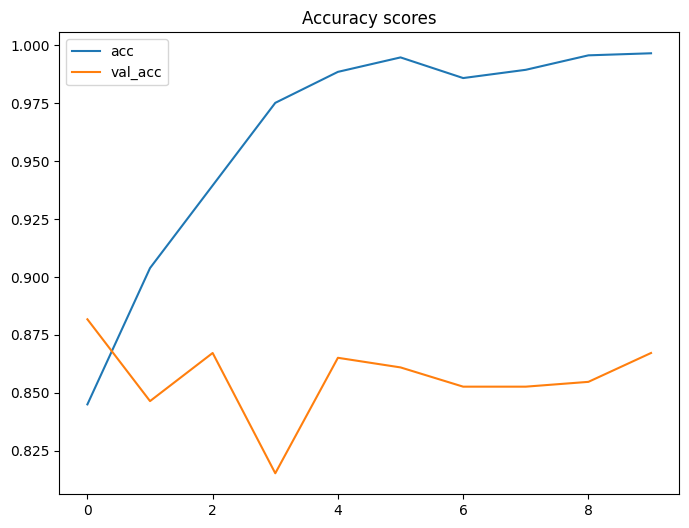

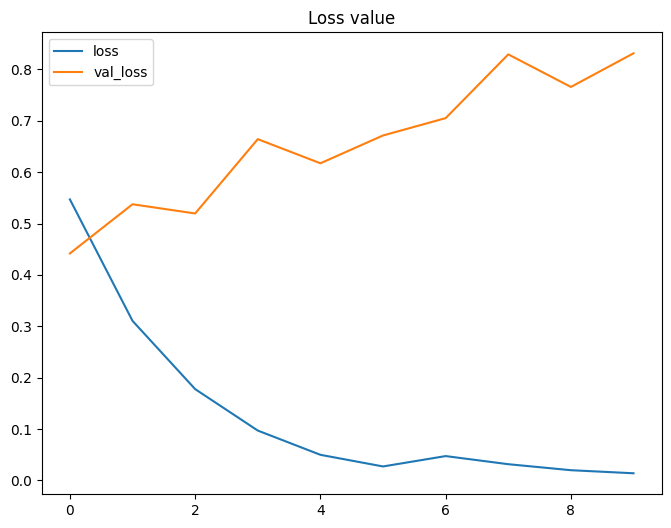

In [727]:
plt.figure(figsize=(8,6))
plt.title('Accuracy scores')
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.legend(['acc', 'val_acc'])
plt.show()
plt.figure(figsize=(8,6))
plt.title('Loss value')
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.legend(['loss', 'val_loss'])
plt.show()

In [728]:
model.evaluate(X_test, y_test) # Accuracy and Loss Scores of Validation sample

16/16 [==============================] - 1s 35ms/step - loss: 0.8315 - acc: 0.8672


[0.8314682841300964, 0.8672199249267578]

In [729]:
# Hog features of Model Prediction 
predictions = model.predict(X_test)
y_test = np.argmax(y_test, axis=1)
prediction = np.argmax(predictions, axis=1)
print(predictions[:21]) 

16/16 [==============================] - 1s 44ms/step
[[2.02261745e-07 9.99999762e-01 6.51937119e-16 9.02558028e-09]
 [1.91348896e-04 7.65836958e-05 9.99698400e-01 3.37104029e-05]
 [9.71333161e-02 9.00814593e-01 2.70945631e-04 1.78104802e-03]
 [1.27037065e-05 9.99874115e-01 1.42972567e-08 1.13087473e-04]
 [9.50294197e-01 1.94813162e-02 6.29695132e-04 2.95947865e-02]
 [1.50147400e-06 9.99995232e-01 5.18585999e-12 3.23913150e-06]
 [2.90885549e-02 1.35049731e-01 7.26461522e-08 8.35861623e-01]
 [1.42793811e-04 9.99783456e-01 1.25004966e-08 7.38216186e-05]
 [1.16079163e-05 9.99960542e-01 2.15442312e-12 2.78723783e-05]
 [5.60482363e-07 9.99997377e-01 3.77881726e-09 1.99726787e-06]
 [8.89715612e-01 3.65504175e-02 4.40273993e-03 6.93312138e-02]
 [1.43162551e-05 9.99869108e-01 3.39487087e-06 1.13164264e-04]
 [9.07873809e-01 8.45025629e-02 7.66176598e-08 7.62354210e-03]
 [5.49725701e-05 9.99944210e-01 1.08745443e-10 8.46956482e-07]
 [1.74727097e-06 9.99910831e-01 9.61831101e-11 8.73991885e-05]
 

In [730]:
#Classification Report of Model
from sklearn.metrics import classification_report
cm = classification_report(y_test, prediction)
print(cm)

              precision    recall  f1-score   support

           0       0.74      0.64      0.69        53
           1       0.87      0.95      0.91       312
           2       0.97      0.94      0.95        31
           3       0.89      0.67      0.77        86

    accuracy                           0.87       482
   macro avg       0.87      0.80      0.83       482
weighted avg       0.87      0.87      0.86       482



In [780]:
# Predicted Categories
le.inverse_transform(predictions)

array([['MODERATE'],
       ['NORMAL'],
       ['MODERATE'],
       ['MODERATE'],
       ['MILD'],
       ['MODERATE'],
       ['SEVERE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MILD'],
       ['MODERATE'],
       ['MILD'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MILD'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['NORMAL'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODERATE'],
       ['MODER

Text(70.72222222222221, 0.5, 'Actual values')

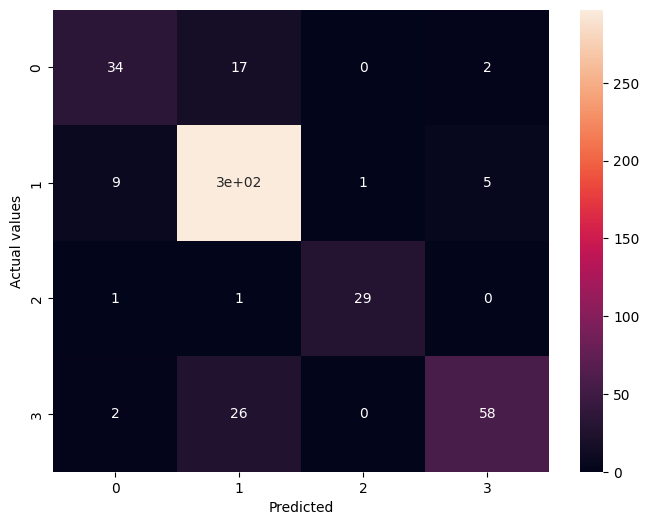

In [788]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, prediction)
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sn
plt.figure(figsize=(8,6))
sn.heatmap(cm, annot=True)
plt.xlabel('Predicted')
plt.ylabel('Actual values')

In [1]:
#Project: Pneumonia Classification using HOG and CNN
#Author: Ewa Stanley Chidozie
#email: emperorgreg24.02.99@gmail.com